In [7]:
#step 0: all the necessary stuff
# ============================
# Imports
# ============================
import os
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
import torch.optim as optim
from torchvision import transforms as T
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import numpy as np
import random
from PIL import Image, ImageOps


# ============================
# Dataset Classes
# ============================
class XBDMulticlassDataset(Dataset):
    def __init__(self, root_dir, transform_pre=None, transform_post=None,
                 image_size=(1024, 1024), tile_size=(256, 256), max_images=None):
        self.image_dir = os.path.join(root_dir, "images")
        self.mask_dir = os.path.join(root_dir, "masks")
        self.files = sorted([f for f in os.listdir(self.image_dir) if '_pre_disaster.png' in f])
        if max_images:
            self.files = self.files[:max_images]
        self.transform_pre = transform_pre
        self.transform_post = transform_post
        self.image_size = image_size
        self.tile_size = tile_size
        self.tiles_per_image = (image_size[0] // tile_size[0]) * (image_size[1] // tile_size[1])

    def __getitem__(self, idx, return_raw=False):
        pre_file = self.files[idx]
        post_file = pre_file.replace('pre', 'post')
        mask_file = post_file.replace('.png', '_rgb.png')
        pre_path = os.path.join(self.image_dir, pre_file)
        post_path = os.path.join(self.image_dir, post_file)
        mask_path = os.path.join(self.mask_dir, mask_file)

        pre_img_raw = Image.open(pre_path).convert("RGB").resize(self.image_size)
        post_img_raw = Image.open(post_path).convert("RGB").resize(self.image_size)
        mask_img_raw = Image.open(mask_path).convert("RGB").resize(self.image_size, Image.NEAREST)

        def optical_to_sar_like(img):
            img = img.convert('L')
            img = ImageOps.autocontrast(img, cutoff=2)
            return img

        def update_mask_multiclass(mask_rgb_img):
            mask_np = np.array(mask_rgb_img)
            label_mask = np.zeros(mask_np.shape[:2], dtype=np.uint8)
            color_to_label = {
                (0, 0, 0): 0, (0, 255, 255): 0, (0, 0, 255): 1,
                (255, 255, 0): 2, (255, 0, 0): 3, (211, 211, 211): 0
            }
            for rgb, label in color_to_label.items():
                mask = np.all(mask_np == rgb, axis=-1)
                label_mask[mask] = label
            return label_mask

        post_img_sar_raw = optical_to_sar_like(post_img_raw)
        if return_raw:
            mask_np = update_mask_multiclass(mask_img_raw)
            return pre_img_raw, post_img_sar_raw, mask_np

        pre_img = self.transform_pre(pre_img_raw) if self.transform_pre else pre_img_raw
        post_img_sar = self.transform_post(post_img_sar_raw) if self.transform_post else post_img_sar_raw

        input_tensor = torch.cat([pre_img, post_img_sar], dim=0)
        mask_tensor = torch.tensor(update_mask_multiclass(mask_img_raw), dtype=torch.long)

        return tile_tensor_and_mask(input_tensor, mask_tensor, self.tile_size)

    def __len__(self):
        return len(self.files)

    def get_tile_dataset(self):
        return TiledXBDDataset(self)

class TiledXBDDataset(Dataset):
    def __init__(self, parent_dataset):
        self.parent_dataset = parent_dataset
        self.tiles_per_image = parent_dataset.tiles_per_image

    def __getitem__(self, idx):
        image_idx = idx // self.tiles_per_image
        tile_idx = idx % self.tiles_per_image
        tiles_input, tiles_mask = self.parent_dataset[image_idx]
        return tiles_input[tile_idx], tiles_mask[tile_idx]

    def __len__(self):
        return len(self.parent_dataset) * self.tiles_per_image

class FilteredTileDataset(Dataset):
    def __init__(self, tiled_dataset, keep_zero_damage_prob=0.1):
        self.tiled_dataset = tiled_dataset
        self.filtered_indices = []
        for idx in range(len(tiled_dataset)):
            _, mask = tiled_dataset[idx]
            if mask.max() == 0:
                if random.random() < keep_zero_damage_prob:
                    self.filtered_indices.append(idx)
            else:
                self.filtered_indices.append(idx)

    def __len__(self):
        return len(self.filtered_indices)

    def __getitem__(self, idx):
        return self.tiled_dataset[self.filtered_indices[idx]]

# ============================
# Helper Functions
# ============================
def tile_tensor_and_mask(input_tensor, mask_tensor, tile_size=(256, 256)):
    C, H, W = input_tensor.shape
    th, tw = tile_size
    tiles_input, tiles_mask = [], []
    for i in range(0, H, th):
        for j in range(0, W, tw):
            tiles_input.append(input_tensor[:, i:i+th, j:j+tw])
            tiles_mask.append(mask_tensor[i:i+th, j:j+tw])
    return tiles_input, tiles_mask

# ============================
# Visualization
# ============================
def unnormalize(img_tensor, mean, std):
    for t, m, s in zip(img_tensor, mean, std):
        t.mul_(s).add_(m)
    return img_tensor

def visualize_predictions(inputs, masks, outputs, n=4):
    preds = torch.argmax(outputs, dim=1).cpu().numpy()
    masks = masks.cpu().numpy()
    cmap = mcolors.ListedColormap(['black', 'blue', 'yellow', 'red'])
    bounds = [0, 1, 2, 3, 4]
    norm = mcolors.BoundaryNorm(bounds, cmap.N)

    for i in range(min(n, inputs.shape[0])):
        fig, axs = plt.subplots(1, 3, figsize=(12, 4))
        pre_rgb = unnormalize(inputs[i][:3].clone(), [0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
        axs[0].imshow(np.transpose(torch.clamp(pre_rgb, 0, 1).cpu().numpy(), (1, 2, 0)))
        axs[0].set_title("Pre-disaster RGB")
        axs[0].axis('off')
        axs[1].imshow(inputs[i][3].cpu().numpy(), cmap='gray')
        axs[1].set_title("Post-disaster SAR")
        axs[1].axis('off')
        axs[2].imshow(preds[i], cmap=cmap, norm=norm)
        axs[2].set_title("Predicted")
        axs[2].axis('off')
        plt.show()
        plt.figure()
        plt.imshow(masks[i], cmap=cmap, norm=norm)
        plt.title("Ground Truth")
        plt.axis('off')
        plt.show()


In [5]:
#step 1: open the model
checkpoint_path = 'C:/Users/sweta/anaconda_projects/non-trivial/performance_bias/iteration_models/model_epoch8.pt'
checkpoint = torch.load(checkpoint_path)
print(checkpoint.keys())  # ['epoch', 'model_state_dict', 'optimizer_state_dict']
print(checkpoint['epoch'])  # 8
print(len(checkpoint['model_state_dict']))  # Number of parameter tensors
import torch
import torch.nn as nn
import torch.nn.functional as F

class UNetOriginal(nn.Module):
    def __init__(self, in_channels=4, out_classes=4):
        super().__init__()

        def conv_block(in_c, out_c):
            return nn.Sequential(
                nn.Conv2d(in_c, out_c, kernel_size=3, padding=1),
                nn.BatchNorm2d(out_c),
                nn.ReLU(inplace=True),
                nn.Conv2d(out_c, out_c, kernel_size=3, padding=1),
                nn.BatchNorm2d(out_c),
                nn.ReLU(inplace=True)
            )

        # Encoder
        self.enc1 = conv_block(in_channels, 64)
        self.enc2 = conv_block(64, 128)
        self.enc3 = conv_block(128, 256)
        self.enc4 = conv_block(256, 512)

        self.pool = nn.MaxPool2d(2)

        # Bottleneck
        self.bottleneck = conv_block(512, 1024)

        # Decoder
        self.up4 = nn.ConvTranspose2d(1024, 512, kernel_size=2, stride=2)
        self.dec4 = conv_block(1024, 512)

        self.up3 = nn.ConvTranspose2d(512, 256, kernel_size=2, stride=2)
        self.dec3 = conv_block(512, 256)

        self.up2 = nn.ConvTranspose2d(256, 128, kernel_size=2, stride=2)
        self.dec2 = conv_block(256, 128)

        self.up1 = nn.ConvTranspose2d(128, 64, kernel_size=2, stride=2)
        self.dec1 = conv_block(128, 64)

        # Output
        self.final = nn.Conv2d(64, out_classes, kernel_size=1)

    def forward(self, x):
        e1 = self.enc1(x)
        e2 = self.enc2(self.pool(e1))
        e3 = self.enc3(self.pool(e2))
        e4 = self.enc4(self.pool(e3))

        b = self.bottleneck(self.pool(e4))

        d4 = self.dec4(torch.cat([self.up4(b), e4], dim=1))
        d3 = self.dec3(torch.cat([self.up3(d4), e3], dim=1))
        d2 = self.dec2(torch.cat([self.up2(d3), e2], dim=1))
        d1 = self.dec1(torch.cat([self.up1(d2), e1], dim=1))

        return self.final(d1)

# ======================
# Load model from checkpoint
# ======================

model_path = 'C:/Users/sweta/anaconda_projects/non-trivial/performance_bias/iteration_models/model_epoch8.pt'

# Initialize model
model = UNetOriginal(in_channels=4, out_classes=4)

# Load the checkpoint dictionary
checkpoint = torch.load(model_path, map_location='cpu')

# Load only the model weights
model.load_state_dict(checkpoint['model_state_dict'])

# Set to evaluation mode
model.eval()

print(f"Model from epoch {checkpoint['epoch']} loaded successfully.")


C:\Users\sweta\AppData\Local\Temp\ipykernel_111752\290060960.py:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load(checkpoint_path)


dict_keys(['epoch', 'model_state_dict', 'optimizer_state_dict'])
8
136


C:\Users\sweta\AppData\Local\Temp\ipykernel_111752\290060960.py:77: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load(model_path, map_location='cpu')


Model from epoch 8 loaded successfully.


Dataset loaded with 2799 image pairs


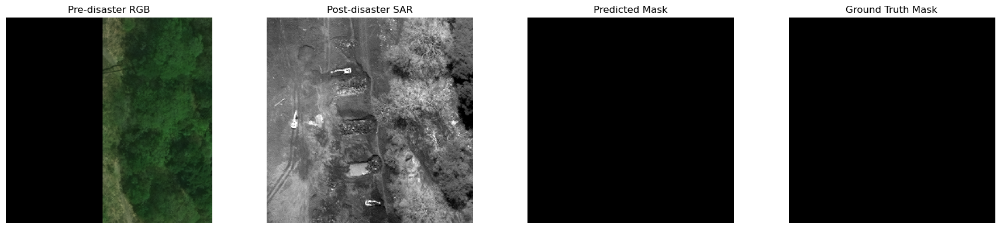

In [8]:
#step 1a. run inference on 1-image pair
from torchvision import transforms as T
from PIL import Image, ImageOps
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import numpy as np

# Transforms
transform_pre = T.Compose([
    T.ToTensor(),
    T.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])
transform_post = T.Compose([
    T.ToTensor(),
    T.Normalize(mean=[0.5], std=[0.5])
])

# Dataset (point to your full dataset directory)
data_root = r"C:\Users\sweta\.cache\kagglehub\datasets\qianlanzz\xbd-dataset\versions\1\xbd\tier1"

# Load dataset
dataset = XBDMulticlassDataset(
    data_root,
    transform_pre=transform_pre,
    transform_post=transform_post,
    image_size=(1024, 1024),
    tile_size=(256, 256),
)

print("Dataset loaded with", len(dataset), "image pairs")

# Choose the index of the image pair you want to test
image_index = 0

# Get the image tensors and mask tiles
tiles_input, tiles_mask = dataset[image_index]  # returns tiled tensors

# Flatten the list of tiles into a batch for model inference
batch_input = torch.stack(tiles_input)  # shape: (N, 4, 256, 256)

# Send to model
model.eval()
with torch.no_grad():
    outputs = model(batch_input)

# Get predicted class for each pixel
preds = torch.argmax(outputs, dim=1)  # shape: (N, 256, 256)

def visualize_tile_predictions(inputs, preds, masks, idx=0):
    cmap = mcolors.ListedColormap(['black', 'blue', 'yellow', 'red'])
    bounds = [0, 1, 2, 3, 4]
    norm = mcolors.BoundaryNorm(bounds, cmap.N)

    inp = inputs[idx]
    pred = preds[idx]
    mask = masks[idx]

    pre_rgb = inp[:3].clone()
    pre_rgb = pre_rgb * torch.tensor([0.229, 0.224, 0.225]).view(3, 1, 1)
    pre_rgb = pre_rgb + torch.tensor([0.485, 0.456, 0.406]).view(3, 1, 1)
    pre_rgb = torch.clamp(pre_rgb, 0, 1)

    sar_img = inp[3].cpu().numpy()

    fig, axs = plt.subplots(1, 4, figsize=(18, 4))
    axs[0].imshow(np.transpose(pre_rgb.cpu().numpy(), (1, 2, 0)))
    axs[0].set_title("Pre-disaster RGB")
    axs[0].axis('off')

    axs[1].imshow(sar_img, cmap='gray')
    axs[1].set_title("Post-disaster SAR")
    axs[1].axis('off')

    axs[2].imshow(pred.cpu().numpy(), cmap=cmap, norm=norm)
    axs[2].set_title("Predicted Mask")
    axs[2].axis('off')

    axs[3].imshow(mask.cpu().numpy(), cmap=cmap, norm=norm)
    axs[3].set_title("Ground Truth Mask")
    axs[3].axis('off')

    plt.tight_layout()
    plt.show()

# Visualize the first tile of the chosen image
visualize_tile_predictions(batch_input, preds, torch.stack(tiles_mask), idx=0)


C:\Users\sweta\AppData\Local\Temp\ipykernel_111752\662523531.py:54: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load(model_path, map_location='cpu')


Loaded model from epoch 8
Found 196 LIC image pairs

--- Inference on congo-volcano_00000000_pre_disaster.tif ---


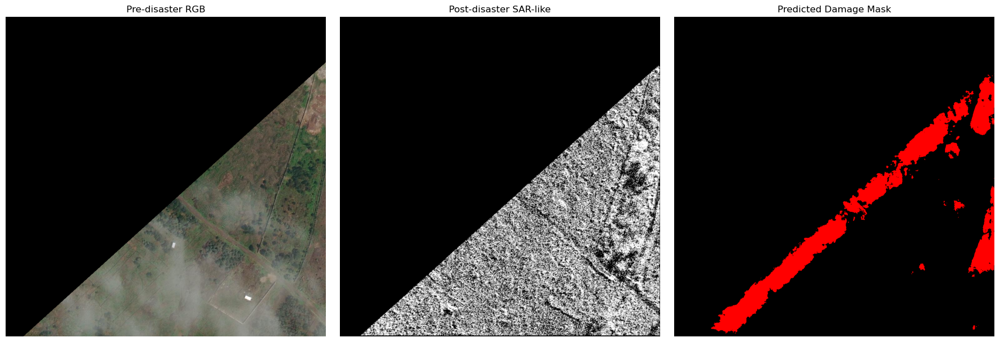

Class-wise % pixel distribution:
  Class 0: 968144 pixels (92.33%)
  Class 1: 0 pixels (0.00%)
  Class 2: 0 pixels (0.00%)
  Class 3: 80432 pixels (7.67%)

--- Inference on congo-volcano_00000001_pre_disaster.tif ---


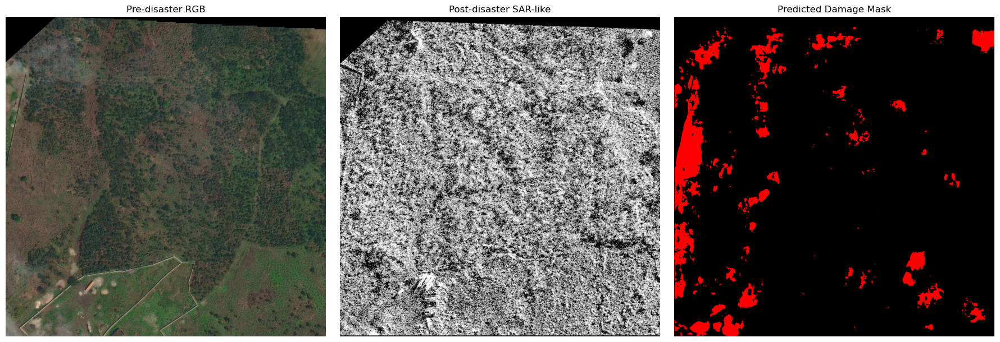

Class-wise % pixel distribution:
  Class 0: 969192 pixels (92.43%)
  Class 1: 0 pixels (0.00%)
  Class 2: 0 pixels (0.00%)
  Class 3: 79384 pixels (7.57%)

--- Inference on congo-volcano_00000002_pre_disaster.tif ---


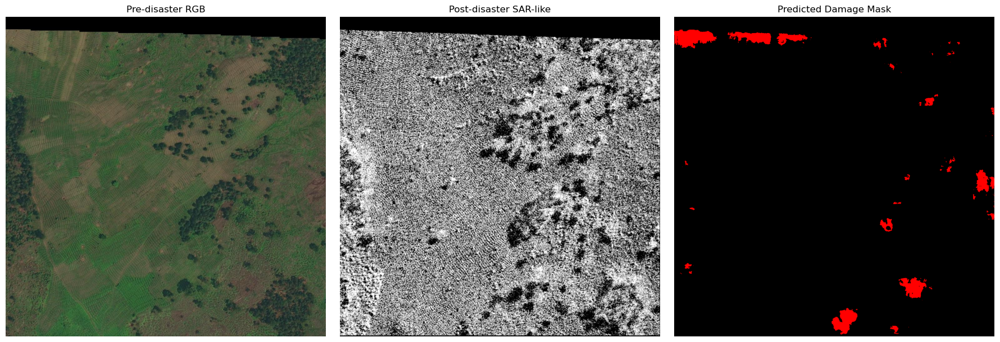

Class-wise % pixel distribution:
  Class 0: 1023484 pixels (97.61%)
  Class 1: 0 pixels (0.00%)
  Class 2: 0 pixels (0.00%)
  Class 3: 25092 pixels (2.39%)


In [9]:
#step 1b: run on BRIGHT image
import os
import torch
from torchvision import transforms as T
from PIL import Image, ImageOps
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import numpy as np
from collections import Counter

# === Load your trained model ===
class UNetOriginal(torch.nn.Module):
    def __init__(self, in_channels=4, out_classes=4):
        super().__init__()
        def conv_block(in_c, out_c):
            return torch.nn.Sequential(
                torch.nn.Conv2d(in_c, out_c, kernel_size=3, padding=1),
                torch.nn.BatchNorm2d(out_c),
                torch.nn.ReLU(inplace=True),
                torch.nn.Conv2d(out_c, out_c, kernel_size=3, padding=1),
                torch.nn.BatchNorm2d(out_c),
                torch.nn.ReLU(inplace=True)
            )
        self.enc1 = conv_block(in_channels, 64)
        self.enc2 = conv_block(64, 128)
        self.enc3 = conv_block(128, 256)
        self.enc4 = conv_block(256, 512)
        self.pool = torch.nn.MaxPool2d(2)
        self.bottleneck = conv_block(512, 1024)
        self.up4 = torch.nn.ConvTranspose2d(1024, 512, kernel_size=2, stride=2)
        self.dec4 = conv_block(1024, 512)
        self.up3 = torch.nn.ConvTranspose2d(512, 256, kernel_size=2, stride=2)
        self.dec3 = conv_block(512, 256)
        self.up2 = torch.nn.ConvTranspose2d(256, 128, kernel_size=2, stride=2)
        self.dec2 = conv_block(256, 128)
        self.up1 = torch.nn.ConvTranspose2d(128, 64, kernel_size=2, stride=2)
        self.dec1 = conv_block(128, 64)
        self.final = torch.nn.Conv2d(64, out_classes, kernel_size=1)

    def forward(self, x):
        e1 = self.enc1(x)
        e2 = self.enc2(self.pool(e1))
        e3 = self.enc3(self.pool(e2))
        e4 = self.enc4(self.pool(e3))
        b = self.bottleneck(self.pool(e4))
        d4 = self.dec4(torch.cat([self.up4(b), e4], dim=1))
        d3 = self.dec3(torch.cat([self.up3(d4), e3], dim=1))
        d2 = self.dec2(torch.cat([self.up2(d3), e2], dim=1))
        d1 = self.dec1(torch.cat([self.up1(d2), e1], dim=1))
        return self.final(d1)

model_path = r"C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\iteration_models\model_epoch8.pt"
model = UNetOriginal(in_channels=4, out_classes=4)
checkpoint = torch.load(model_path, map_location='cpu')
model.load_state_dict(checkpoint['model_state_dict'])
model.eval()
print(f"Loaded model from epoch {checkpoint['epoch']}")

# === Image Transforms ===
transform_pre = T.Compose([
    T.Resize((1024, 1024)),
    T.ToTensor(),
    T.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])
transform_post = T.Compose([
    T.Resize((1024, 1024)),
    T.Grayscale(),
    T.ToTensor(),
    T.Normalize(mean=[0.5], std=[0.5])
])

# === BRIGHT LIC Image Pair Loader ===
low_income = ['congo', 'haiti']
pre_event_dir = r"C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico"
post_event_dir = r"C:\Users\sweta\Downloads\post-event\post-event"

all_pre_files = os.listdir(pre_event_dir)
filtered_pre_files = [f for f in all_pre_files if any(c in f.lower() for c in low_income)]
expected_post_files = [f.replace('_pre_disaster', '_post_disaster') for f in filtered_pre_files]
all_post_files = os.listdir(post_event_dir)

pairs = [
    (os.path.join(pre_event_dir, pre), os.path.join(post_event_dir, post))
    for pre, post in zip(filtered_pre_files, expected_post_files)
    if post in all_post_files
]

print(f"Found {len(pairs)} LIC image pairs")

# === Inference and Visualization ===
def visualize_inference(pre_path, post_path):
    # Load and transform inputs
    pre_img = Image.open(pre_path).convert("RGB")
    post_img = Image.open(post_path).convert("RGB")
    post_img_sar = ImageOps.autocontrast(post_img.convert("L"), cutoff=2)

    pre_tensor = transform_pre(pre_img)
    post_tensor = transform_post(post_img_sar)

    input_tensor = torch.cat([pre_tensor, post_tensor], dim=0).unsqueeze(0)  # Shape (1, 4, 1024, 1024)

    with torch.no_grad():
        output = model(input_tensor)
        pred = torch.argmax(output, dim=1)[0].cpu().numpy()

    # === Visualization ===
    cmap = mcolors.ListedColormap(['black', 'blue', 'yellow', 'red'])
    bounds = [0, 1, 2, 3, 4]
    norm = mcolors.BoundaryNorm(bounds, cmap.N)

    pre_np = pre_tensor[:3].clone()
    pre_np = pre_np * torch.tensor([0.229, 0.224, 0.225]).view(3, 1, 1)
    pre_np = pre_np + torch.tensor([0.485, 0.456, 0.406]).view(3, 1, 1)
    pre_np = torch.clamp(pre_np, 0, 1).permute(1, 2, 0).numpy()

    fig, axs = plt.subplots(1, 3, figsize=(18, 6))
    axs[0].imshow(pre_np)
    axs[0].set_title("Pre-disaster RGB")
    axs[0].axis('off')

    axs[1].imshow(np.array(post_img_sar), cmap='gray')
    axs[1].set_title("Post-disaster SAR-like")
    axs[1].axis('off')

    axs[2].imshow(pred, cmap=cmap, norm=norm)
    axs[2].set_title("Predicted Damage Mask")
    axs[2].axis('off')

    plt.tight_layout()
    plt.show()

    # === Simple Statistical Trend ===
    flat = pred.flatten()
    counter = Counter(flat)
    total_pixels = flat.shape[0]
    print("Class-wise % pixel distribution:")
    for cls in range(4):
        pct = 100 * counter[cls] / total_pixels
        print(f"  Class {cls}: {counter[cls]} pixels ({pct:.2f}%)")

# === Run on a few samples ===
for i in range(min(3, len(pairs))):
    print(f"\n--- Inference on {pairs[i][0].split(os.sep)[-1]} ---")
    visualize_inference(*pairs[i])


In [ ]:
'''
import os
import random
from PIL import Image, ImageOps
import numpy as np
import torch
import torch.nn.functional as F
from torchvision import transforms as T
from scipy.ndimage import binary_opening, binary_closing
from tqdm import tqdm

# Set seed
random.seed(42)

# Paths
pre_event_dir = r"C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico"
post_event_dir = r"C:\Users\sweta\Downloads\post-event\post-event"
output_base = r"C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo"

# LIC filter
low_income = ['congo', 'haiti']

# Transform
transform_gray = T.Compose([
    T.Resize((256, 256)),
    T.ToTensor()
])

# Device
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Helpers
def clean_multiclass_mask(mask_np, min_region_size=20):
    cleaned_mask = np.zeros_like(mask_np)
    for cls in range(1, 4):
        binary = (mask_np == cls)
        binary = binary_opening(binary, structure=np.ones((3,3)))
        binary = binary_closing(binary, structure=np.ones((3,3)))
        cleaned_mask[binary] = cls
    return cleaned_mask

def SAR_damage_mask_multiclass_merged(pre_optical_img, post_sar_img):
    def optical_to_sar_like(img):
        img = img.convert('L')
        img = ImageOps.autocontrast(img, cutoff=2)
        return img

    pre_sar_like = optical_to_sar_like(pre_optical_img)
    post_sar = post_sar_img.convert('L')

    pre_tensor = transform_gray(pre_sar_like).to(device).squeeze(0)
    post_tensor = transform_gray(post_sar).to(device).squeeze(0)

    with torch.no_grad():
        diff = torch.abs(post_tensor - pre_tensor)
        diff_smoothed = F.avg_pool2d(diff.unsqueeze(0).unsqueeze(0), kernel_size=5, stride=1, padding=2).squeeze()

        diff_min, diff_max = diff_smoothed.min(), diff_smoothed.max()
        diff_norm = (diff_smoothed - diff_min) / (diff_max - diff_min + 1e-8)

        thresholds = [0.08, 0.22, 0.45]
        mask = torch.zeros_like(diff_norm, dtype=torch.long)
        mask = torch.where((diff_norm >= thresholds[0]) & (diff_norm < thresholds[1]), 1, mask)
        mask = torch.where((diff_norm >= thresholds[1]) & (diff_norm < thresholds[2]), 2, mask)
        mask = torch.where(diff_norm >= thresholds[2], 3, mask)

    mask_np = mask.cpu().numpy()
    cleaned = clean_multiclass_mask(mask_np)

    # DEBUG: Print mask class distribution
    print(f"[DEBUG] Mask class counts: {np.bincount(cleaned.flatten())}")
    return torch.from_numpy(cleaned).long()

# Filter LIC image pairs
print("[INFO] Filtering image pairs for LIC regions...")
all_pre_files = os.listdir(pre_event_dir)
filtered_pre_files = [f for f in all_pre_files if any(country in f.lower() for country in low_income)]
expected_post_files = [f.replace('_pre_disaster', '_post_disaster') for f in filtered_pre_files]
all_post_files = os.listdir(post_event_dir)

pairs = []
for pre, post in zip(filtered_pre_files, expected_post_files):
    if post in all_post_files:
        pre_path = os.path.join(pre_event_dir, pre)
        post_path = os.path.join(post_event_dir, post)
        pairs.append((pre_path, post_path))
        print(f"[DEBUG] Found pair: {os.path.basename(pre)} + {os.path.basename(post)}")
    else:
        print(f"[WARNING] Missing post-disaster file for {pre}")

print(f"[INFO] Total valid pairs found: {len(pairs)}")

# Split
random.shuffle(pairs)
split_idx = int(0.7 * len(pairs))
train_pairs = pairs[:split_idx]
test_pairs = pairs[split_idx:]

print(f"[INFO] Split into {len(train_pairs)} train and {len(test_pairs)} test pairs")

# Save Function
def save_triplets(pairs, split='train'):
    pre_out = os.path.join(output_base, split, 'pre')
    post_out = os.path.join(output_base, split, 'post')
    mask_out = os.path.join(output_base, split, 'mask')

    os.makedirs(pre_out, exist_ok=True)
    os.makedirs(post_out, exist_ok=True)
    os.makedirs(mask_out, exist_ok=True)

    for idx, (pre_path, post_path) in enumerate(tqdm(pairs, desc=f"[INFO] Saving {split} data")):
        try:
            print(f"[DEBUG] Loading pre: {pre_path}")
            print(f"[DEBUG] Loading post: {post_path}")
            pre_img = Image.open(pre_path).convert("RGB")
            post_img = Image.open(post_path)

            pre_resized = pre_img.resize((256, 256))
            post_resized = post_img.resize((256, 256))

            mask = SAR_damage_mask_multiclass_merged(pre_resized, post_resized)

            base_name = f"{split}_pair_{idx}"
            pre_file = os.path.join(pre_out, base_name + ".png")
            post_file = os.path.join(post_out, base_name + ".png")
            mask_file = os.path.join(mask_out, base_name + ".png")

            pre_resized.save(pre_file)
            print(f"[DEBUG] Saved pre to {pre_file}")
            post_resized.save(post_file)
            print(f"[DEBUG] Saved post to {post_file}")
            Image.fromarray(mask.cpu().numpy().astype(np.uint8)).save(mask_file)
            print(f"[DEBUG] Saved mask to {mask_file}")

        except Exception as e:
            print(f"[ERROR] Failed at {pre_path} and {post_path} -> {e}")

# Run save
save_triplets(train_pairs, split='train')
save_triplets(test_pairs, split='test')

print("[INFO] All data processed and saved.")


#Note: The goal is to have a tuple of (pre-disaster optical, post-disaster SAR, and ROUGH damage mask) for LICs in the BRIGHT dataset. this should be split into training and test test (70/30) split and be saved in C:\\Users\\sweta\\anaconda_projects\\non-trivial\\performance_bias\\LIC_pseudo\\(train/test)
'''

[INFO] Filtering image pairs for LIC regions...
[DEBUG] Found pair: congo-volcano_00000000_pre_disaster.tif + congo-volcano_00000000_post_disaster.tif
[DEBUG] Found pair: congo-volcano_00000001_pre_disaster.tif + congo-volcano_00000001_post_disaster.tif
[DEBUG] Found pair: congo-volcano_00000002_pre_disaster.tif + congo-volcano_00000002_post_disaster.tif
[DEBUG] Found pair: congo-volcano_00000003_pre_disaster.tif + congo-volcano_00000003_post_disaster.tif
[DEBUG] Found pair: congo-volcano_00000004_pre_disaster.tif + congo-volcano_00000004_post_disaster.tif
[DEBUG] Found pair: congo-volcano_00000005_pre_disaster.tif + congo-volcano_00000005_post_disaster.tif
[DEBUG] Found pair: congo-volcano_00000006_pre_disaster.tif + congo-volcano_00000006_post_disaster.tif
[DEBUG] Found pair: congo-volcano_00000007_pre_disaster.tif + congo-volcano_00000007_post_disaster.tif
[DEBUG] Found pair: congo-volcano_00000008_pre_disaster.tif + congo-volcano_00000008_post_disaster.tif
[DEBUG] Found pair: congo

[INFO] Saving train data:   0%|                                                                | 0/137 [00:00<?, ?it/s]

[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000109_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000109_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3070, Post tensor mean: 0.2668
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.2106
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2179


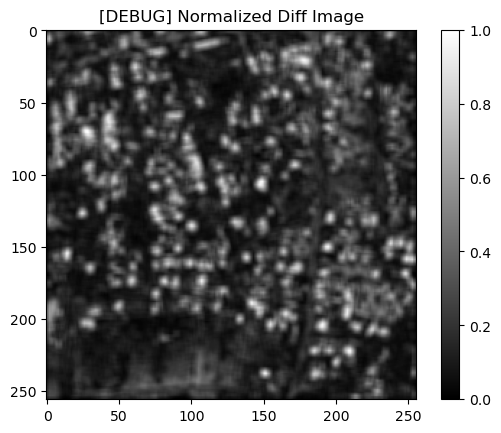

[INFO] Saving train data:   1%|▍                                                       | 1/137 [00:00<00:52,  2.59it/s]

[DEBUG] Mask class counts: [16793 29763 14345  4635]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_0.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_0.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_0.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000042_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000042_post_disaster.tif
[DEBUG] Pre tensor mean: 0.4880, Post tensor mean: 0.2254
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.3115
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.3143


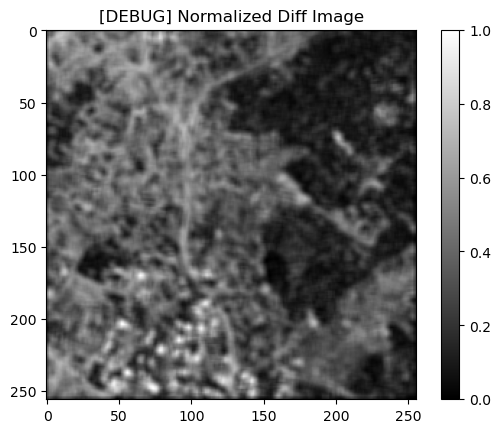

[INFO] Saving train data:   1%|▊                                                       | 2/137 [00:00<00:49,  2.72it/s]

[DEBUG] Mask class counts: [ 7005 16791 28684 13056]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_1.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_1.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_1.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000002_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000002_post_disaster.tif
[DEBUG] Pre tensor mean: 0.7498, Post tensor mean: 0.2254
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.5244
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.5824


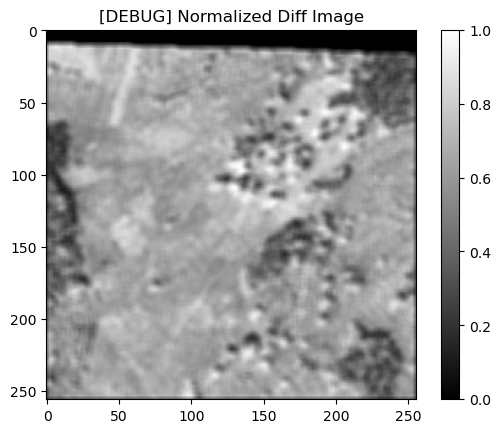

[INFO] Saving train data:   2%|█▏                                                      | 3/137 [00:01<01:25,  1.58it/s]

[DEBUG] Mask class counts: [ 4670   154  6551 54161]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_2.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_2.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_2.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000032_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000032_post_disaster.tif
[DEBUG] Pre tensor mean: 0.5109, Post tensor mean: 0.2883
[DEBUG] Diff stats -> min: 0.0000, max: 0.9843, mean: 0.3019
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.3092


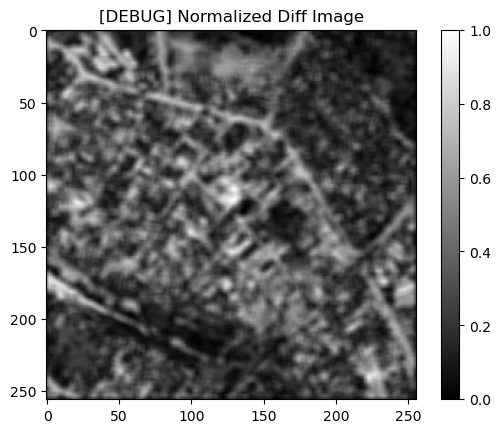

[INFO] Saving train data:   3%|█▋                                                      | 4/137 [00:02<01:09,  1.90it/s]

[DEBUG] Mask class counts: [ 8916 17905 25985 12730]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_3.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_3.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_3.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000113_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000113_post_disaster.tif
[DEBUG] Pre tensor mean: 0.2135, Post tensor mean: 0.2376
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.1967
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2006


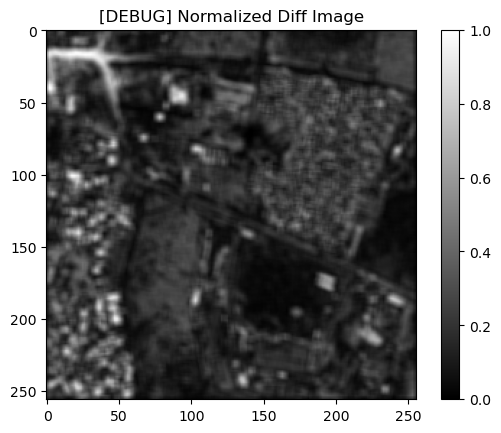

[INFO] Saving train data:   4%|██                                                      | 5/137 [00:02<01:02,  2.13it/s]

[DEBUG] Mask class counts: [13506 30889 18761  2380]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_4.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_4.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_4.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000012_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000012_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3936, Post tensor mean: 0.2461
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.1938
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2033


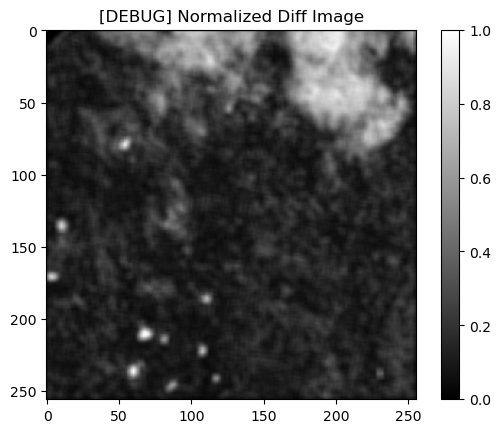

[INFO] Saving train data:   4%|██▍                                                     | 6/137 [00:02<00:57,  2.29it/s]

[DEBUG] Mask class counts: [ 6670 44645  7822  6399]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_5.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_5.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_5.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000079_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000079_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3184, Post tensor mean: 0.1957
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.2062
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.1961


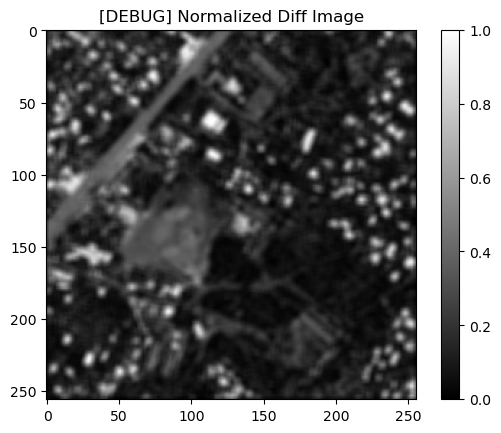

[INFO] Saving train data:   5%|██▊                                                     | 7/137 [00:03<00:52,  2.49it/s]

[DEBUG] Mask class counts: [22584 26964 11914  4074]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_6.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_6.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_6.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000013_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000013_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3777, Post tensor mean: 0.2588
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.2093
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.1904


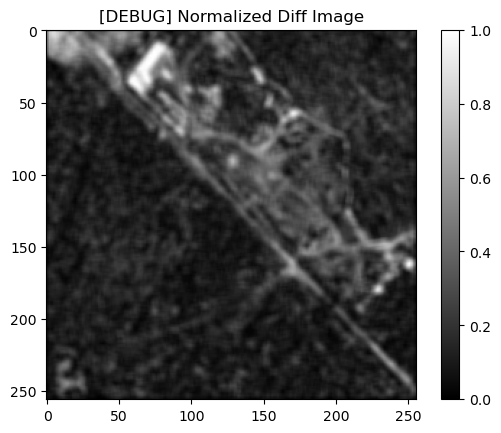

[INFO] Saving train data:   6%|███▎                                                    | 8/137 [00:03<00:47,  2.72it/s]

[DEBUG] Mask class counts: [ 9539 40225 12248  3524]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_7.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_7.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_7.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000090_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000090_post_disaster.tif
[DEBUG] Pre tensor mean: 0.2774, Post tensor mean: 0.0900
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.1884
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.1959


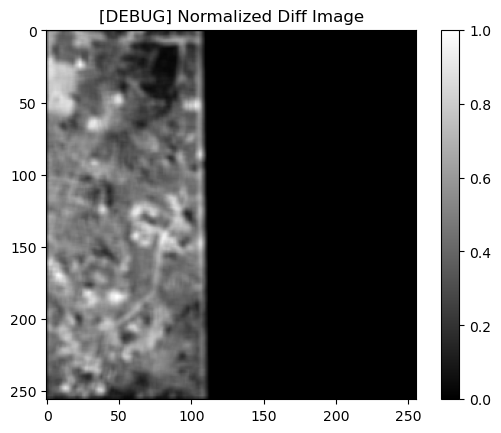

[INFO] Saving train data:   7%|███▋                                                    | 9/137 [00:03<00:43,  2.94it/s]

[DEBUG] Mask class counts: [39183  1224 10834 14295]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_8.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_8.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_8.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000069_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000069_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3064, Post tensor mean: 0.2029
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.2013
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2010


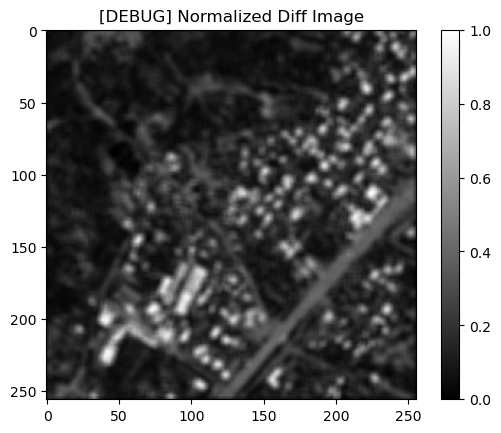

[INFO] Saving train data:   7%|████                                                   | 10/137 [00:04<00:42,  2.97it/s]

[DEBUG] Mask class counts: [16742 31496 13147  4151]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_9.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_9.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_9.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000003_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000003_post_disaster.tif
[DEBUG] Pre tensor mean: 0.7037, Post tensor mean: 0.2104
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.4933
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.5383


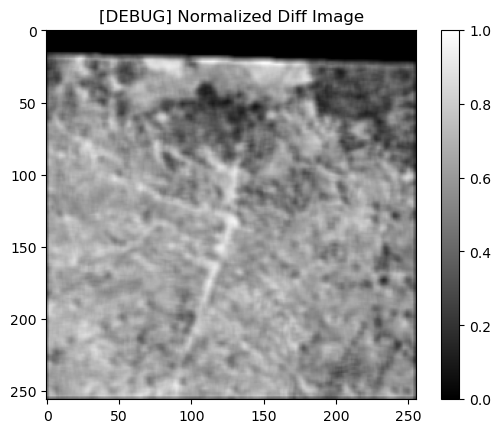

[INFO] Saving train data:   8%|████▍                                                  | 11/137 [00:04<00:40,  3.10it/s]

[DEBUG] Mask class counts: [ 6770   504  7838 50424]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_10.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_10.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_10.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000061_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000061_post_disaster.tif
[DEBUG] Pre tensor mean: 0.1923, Post tensor mean: 0.1549
[DEBUG] Diff stats -> min: 0.0000, max: 0.9608, mean: 0.1284
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.1483


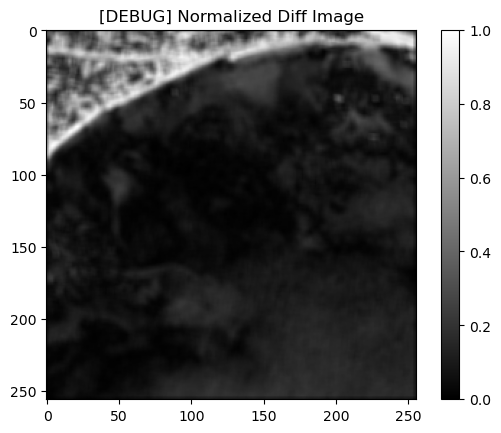

[INFO] Saving train data:   9%|████▊                                                  | 12/137 [00:04<00:39,  3.19it/s]

[DEBUG] Mask class counts: [29549 27372  3337  5278]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_11.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_11.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_11.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000030_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000030_post_disaster.tif
[DEBUG] Pre tensor mean: 0.5304, Post tensor mean: 0.2478
[DEBUG] Diff stats -> min: 0.0000, max: 0.9804, mean: 0.3216
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.3607


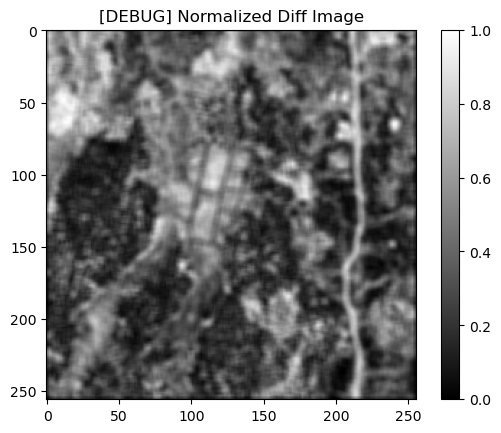

[INFO] Saving train data:   9%|█████▏                                                 | 13/137 [00:04<00:39,  3.13it/s]

[DEBUG] Mask class counts: [ 6352 14950 25043 19191]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_12.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_12.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_12.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000041_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000041_post_disaster.tif
[DEBUG] Pre tensor mean: 0.4053, Post tensor mean: 0.2808
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.2707
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2772


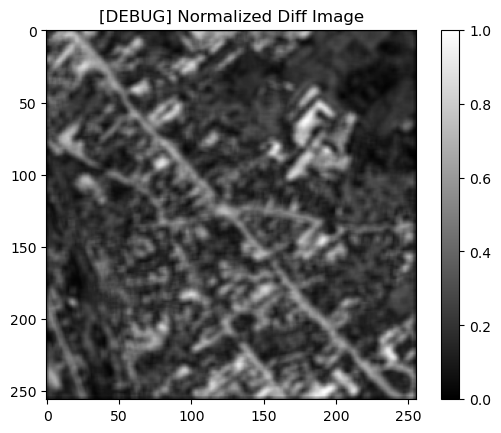

[INFO] Saving train data:  10%|█████▌                                                 | 14/137 [00:05<00:37,  3.27it/s]

[DEBUG] Mask class counts: [ 8285 24602 24270  8379]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_13.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_13.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_13.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000045_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000045_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3387, Post tensor mean: 0.3207
[DEBUG] Diff stats -> min: 0.0000, max: 0.9922, mean: 0.1775
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.1794


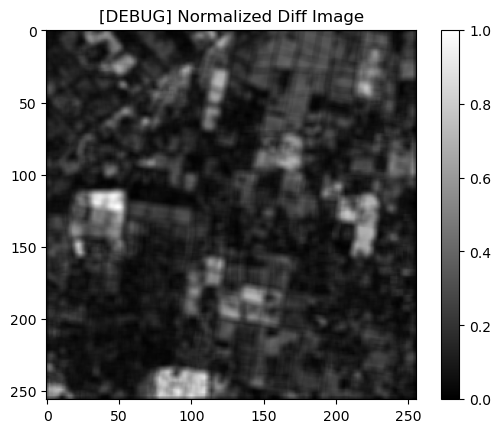

[INFO] Saving train data:  11%|██████                                                 | 15/137 [00:05<00:36,  3.32it/s]

[DEBUG] Mask class counts: [17291 32575 12586  3084]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_14.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_14.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_14.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000015_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000015_post_disaster.tif
[DEBUG] Pre tensor mean: 0.5860, Post tensor mean: 0.2083
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.3968
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.4079


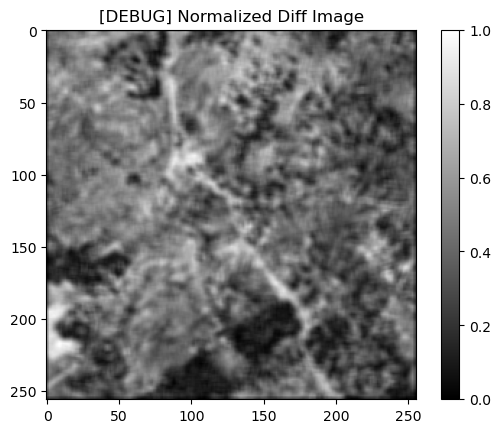

[INFO] Saving train data:  12%|██████▍                                                | 16/137 [00:05<00:37,  3.25it/s]

[DEBUG] Mask class counts: [ 4409  6474 29221 25432]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_15.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_15.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_15.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000035_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000035_post_disaster.tif
[DEBUG] Pre tensor mean: 0.2719, Post tensor mean: 0.3111
[DEBUG] Diff stats -> min: 0.0000, max: 0.9961, mean: 0.2101
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2129


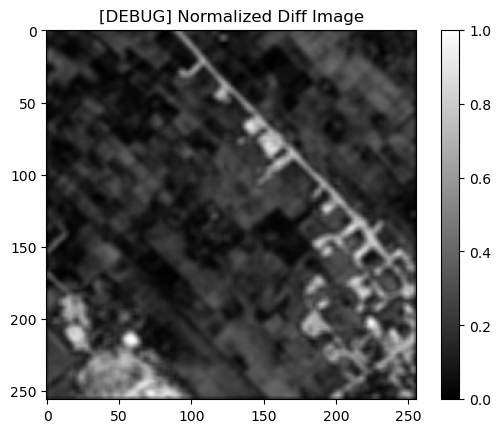

[INFO] Saving train data:  12%|██████▊                                                | 17/137 [00:06<00:36,  3.31it/s]

[DEBUG] Mask class counts: [14211 29432 17023  4870]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_16.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_16.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_16.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000036_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000036_post_disaster.tif
[DEBUG] Pre tensor mean: 0.2774, Post tensor mean: 0.1003
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.1804
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2032


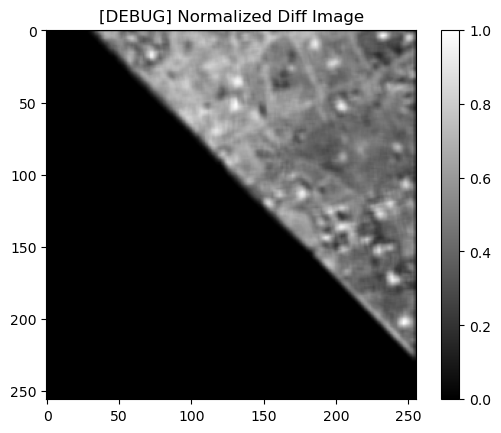

[INFO] Saving train data:  13%|███████▏                                               | 18/137 [00:06<00:34,  3.41it/s]

[DEBUG] Mask class counts: [41271     9  7455 16801]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_17.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_17.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_17.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000010_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000010_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3631, Post tensor mean: 0.1997
[DEBUG] Diff stats -> min: 0.0000, max: 0.9569, mean: 0.1875
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2119


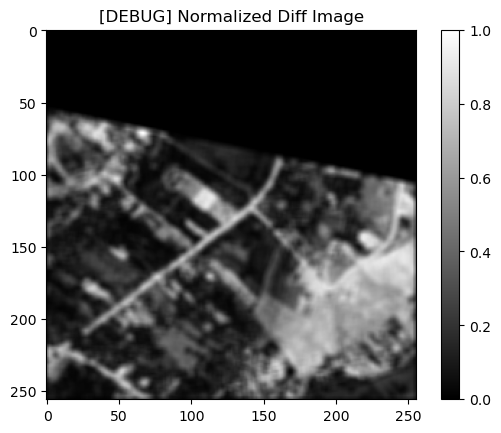

[INFO] Saving train data:  14%|███████▋                                               | 19/137 [00:06<00:33,  3.48it/s]

[DEBUG] Mask class counts: [30376 14231  9318 11611]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_18.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_18.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_18.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000044_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000044_post_disaster.tif
[DEBUG] Pre tensor mean: 0.5201, Post tensor mean: 0.2386
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.3051
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.3093


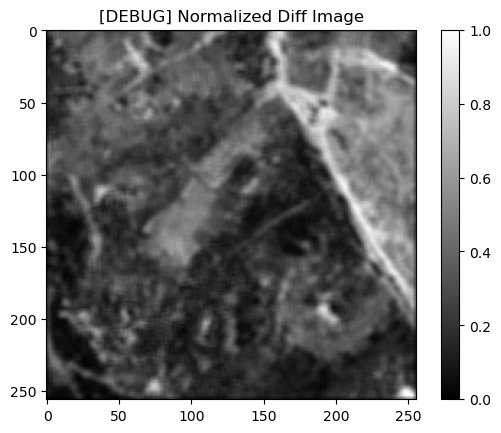

[INFO] Saving train data:  15%|████████                                               | 20/137 [00:06<00:34,  3.34it/s]

[DEBUG] Mask class counts: [ 5900 19494 27512 12630]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_19.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_19.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_19.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000005_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000005_post_disaster.tif
[DEBUG] Pre tensor mean: 0.4807, Post tensor mean: 0.1811
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.3003
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.3148


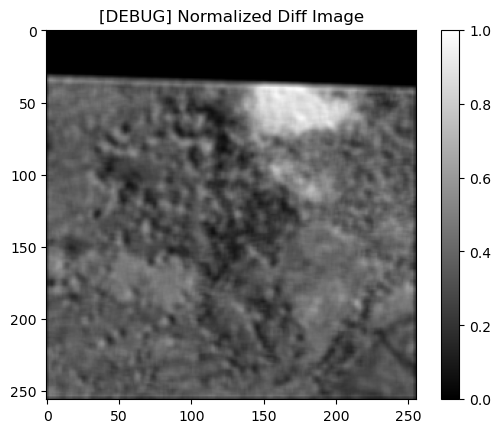

[INFO] Saving train data:  15%|████████▍                                              | 21/137 [00:07<00:34,  3.33it/s]

[DEBUG] Mask class counts: [11012  3397 43468  7659]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_20.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_20.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_20.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000053_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000053_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3025, Post tensor mean: 0.2177
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.1571
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.1397


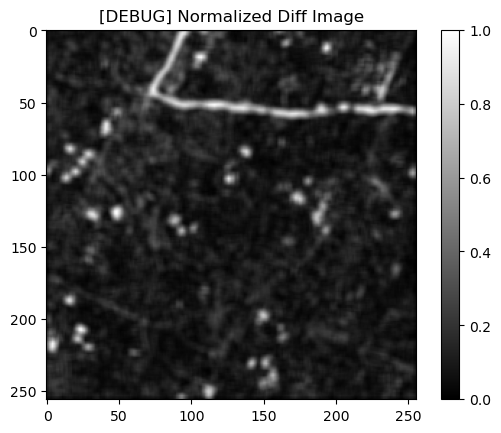

[INFO] Saving train data:  16%|████████▊                                              | 22/137 [00:07<00:35,  3.24it/s]

[DEBUG] Mask class counts: [23535 36776  3042  2183]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_21.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_21.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_21.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000084_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000084_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3248, Post tensor mean: 0.2606
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.2218
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2091


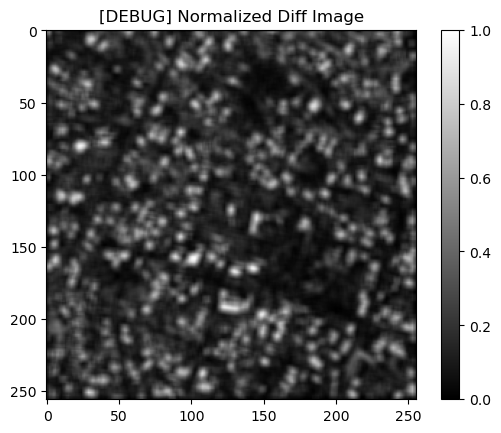

[INFO] Saving train data:  17%|█████████▏                                             | 23/137 [00:07<00:34,  3.29it/s]

[DEBUG] Mask class counts: [19728 28978 13230  3600]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_22.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_22.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_22.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000080_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000080_post_disaster.tif
[DEBUG] Pre tensor mean: 0.2679, Post tensor mean: 0.2113
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.1564
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.1555


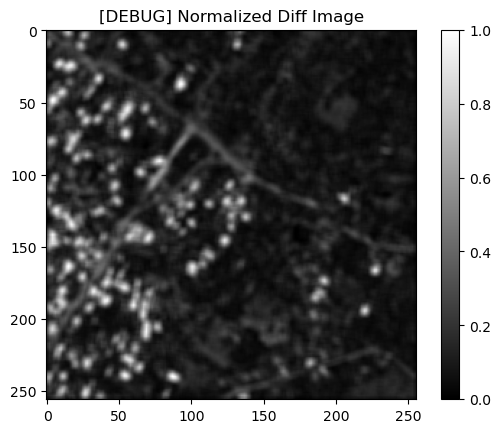

[INFO] Saving train data:  18%|█████████▋                                             | 24/137 [00:08<00:34,  3.31it/s]

[DEBUG] Mask class counts: [27277 30234  4832  3193]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_23.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_23.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_23.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000064_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000064_post_disaster.tif
[DEBUG] Pre tensor mean: 0.2383, Post tensor mean: 0.2360
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.1332
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.1308


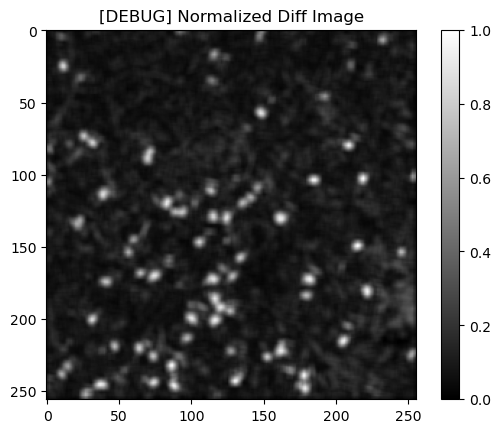

[INFO] Saving train data:  18%|██████████                                             | 25/137 [00:08<00:34,  3.25it/s]

[DEBUG] Mask class counts: [24824 36802  2164  1746]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_24.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_24.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_24.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000073_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000073_post_disaster.tif
[DEBUG] Pre tensor mean: 0.2288, Post tensor mean: 0.2347
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.1609
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.1789


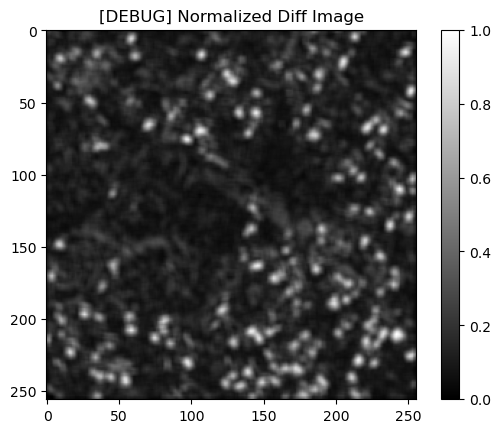

[INFO] Saving train data:  19%|██████████▍                                            | 26/137 [00:08<00:38,  2.86it/s]

[DEBUG] Mask class counts: [13064 42614  6965  2893]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_25.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_25.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_25.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000037_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000037_post_disaster.tif
[DEBUG] Pre tensor mean: 0.2652, Post tensor mean: 0.2439
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.1508
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.1585


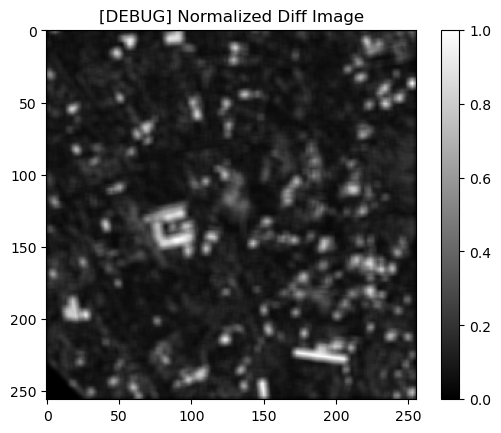

[INFO] Saving train data:  20%|██████████▊                                            | 27/137 [00:09<00:37,  2.89it/s]

[DEBUG] Mask class counts: [18896 38814  5189  2637]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_26.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_26.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_26.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000002_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000002_post_disaster.tif
[DEBUG] Pre tensor mean: 0.2221, Post tensor mean: 0.1384
[DEBUG] Diff stats -> min: 0.0000, max: 0.9608, mean: 0.1136
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.1212


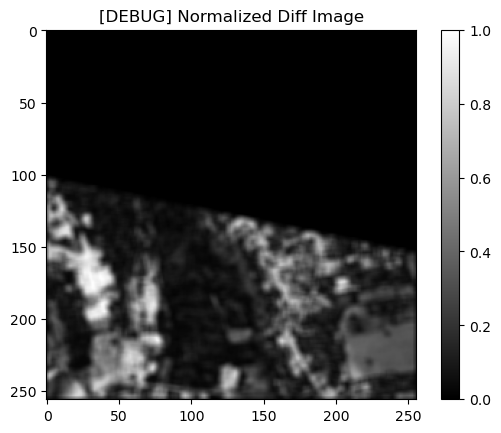

[INFO] Saving train data:  20%|███████████▏                                           | 28/137 [00:09<00:36,  2.97it/s]

[DEBUG] Mask class counts: [43036 10573  7229  4698]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_27.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_27.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_27.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000118_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000118_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3182, Post tensor mean: 0.2228
[DEBUG] Diff stats -> min: 0.0000, max: 0.9961, mean: 0.1694
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.1910


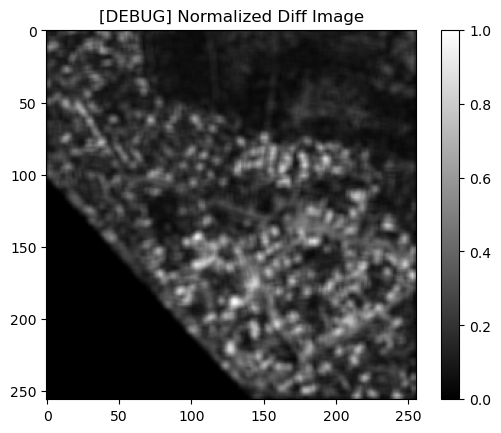

[INFO] Saving train data:  21%|███████████▋                                           | 29/137 [00:09<00:35,  3.04it/s]

[DEBUG] Mask class counts: [21135 24107 15982  4312]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_28.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_28.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_28.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000078_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000078_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3135, Post tensor mean: 0.2029
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.2041
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.1956


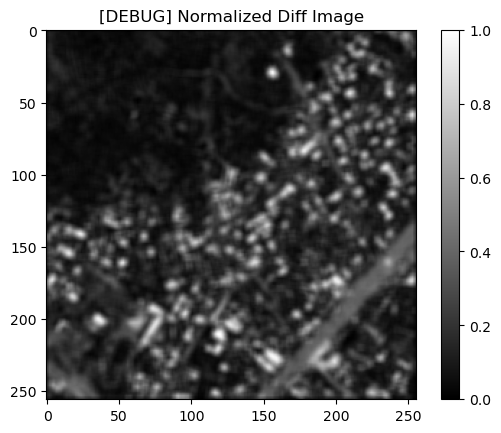

[INFO] Saving train data:  22%|████████████                                           | 30/137 [00:10<00:41,  2.58it/s]

[DEBUG] Mask class counts: [22682 26376 12389  4089]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_29.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_29.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_29.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000036_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000036_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3168, Post tensor mean: 0.2943
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.1942
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2022


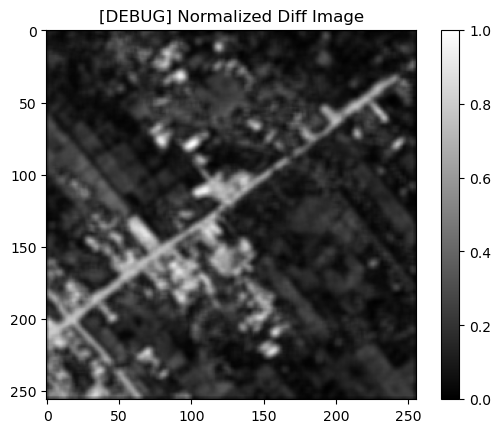

[INFO] Saving train data:  23%|████████████▍                                          | 31/137 [00:10<00:39,  2.67it/s]

[DEBUG] Mask class counts: [17332 31871 10552  5781]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_30.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_30.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_30.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000066_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000066_post_disaster.tif
[DEBUG] Pre tensor mean: 0.2789, Post tensor mean: 0.2379
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.1529
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.1493


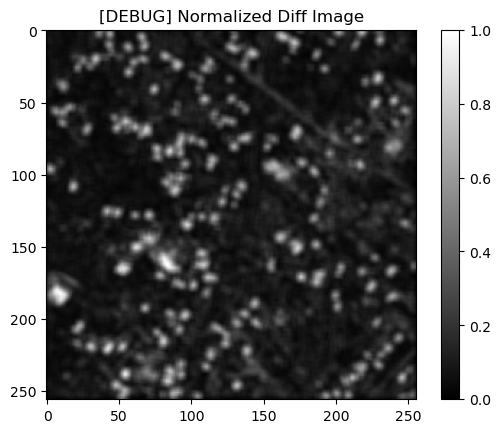

[INFO] Saving train data:  23%|████████████▊                                          | 32/137 [00:11<00:39,  2.68it/s]

[DEBUG] Mask class counts: [31171 28207  3729  2429]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_31.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_31.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_31.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000003_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000003_post_disaster.tif
[DEBUG] Pre tensor mean: 0.2478, Post tensor mean: 0.0961
[DEBUG] Diff stats -> min: 0.0000, max: 0.8863, mean: 0.1520
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2117


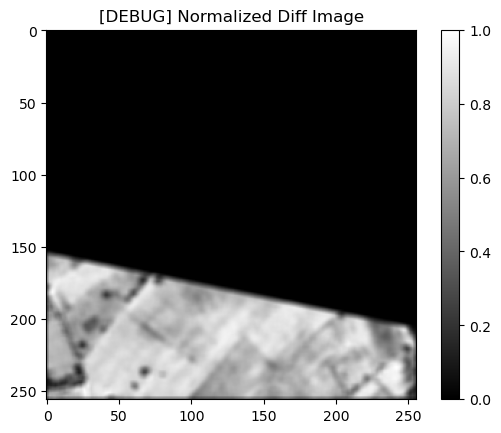

[INFO] Saving train data:  24%|█████████████▏                                         | 33/137 [00:11<00:36,  2.82it/s]

[DEBUG] Mask class counts: [47183    35   495 17823]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_32.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_32.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_32.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000048_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000048_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3898, Post tensor mean: 0.3050
[DEBUG] Diff stats -> min: 0.0000, max: 0.9765, mean: 0.2109
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2424


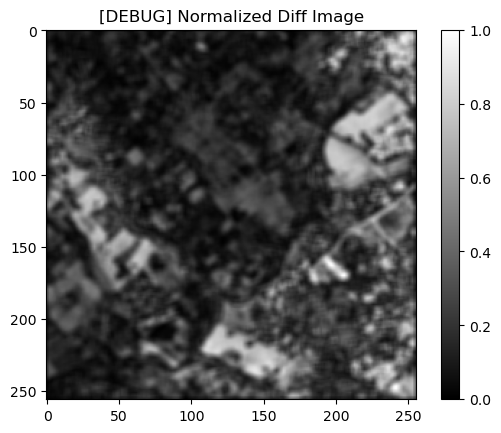

[INFO] Saving train data:  25%|█████████████▋                                         | 34/137 [00:11<00:39,  2.60it/s]

[DEBUG] Mask class counts: [12908 26694 17974  7960]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_33.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_33.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_33.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000032_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000032_post_disaster.tif
[DEBUG] Pre tensor mean: 0.4462, Post tensor mean: 0.1309
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.3348
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.3322


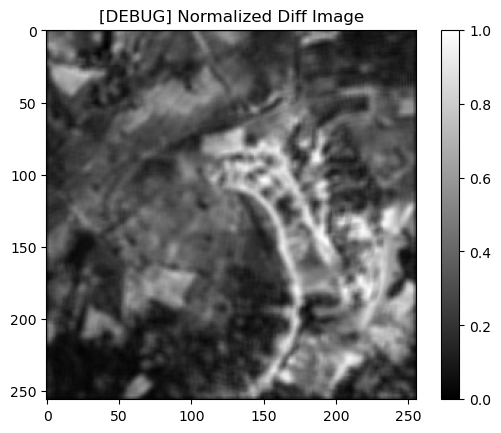

[INFO] Saving train data:  26%|██████████████                                         | 35/137 [00:12<00:38,  2.67it/s]

[DEBUG] Mask class counts: [ 6218 16653 27231 15434]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_34.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_34.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_34.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000052_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000052_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3555, Post tensor mean: 0.2188
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.1937
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.1767


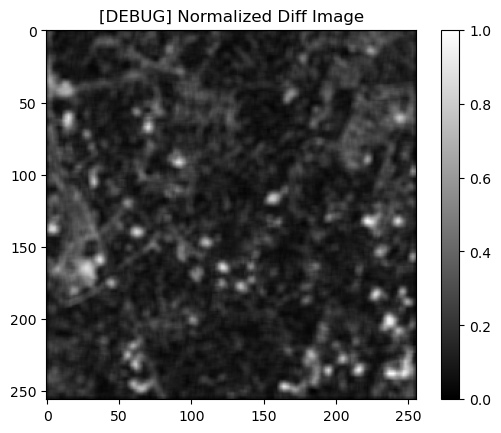

[INFO] Saving train data:  26%|██████████████▍                                        | 36/137 [00:12<00:40,  2.49it/s]

[DEBUG] Mask class counts: [11551 40310 11816  1859]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_35.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_35.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_35.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000067_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000067_post_disaster.tif
[DEBUG] Pre tensor mean: 0.1951, Post tensor mean: 0.1482
[DEBUG] Diff stats -> min: 0.0000, max: 0.9765, mean: 0.1289
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.1504


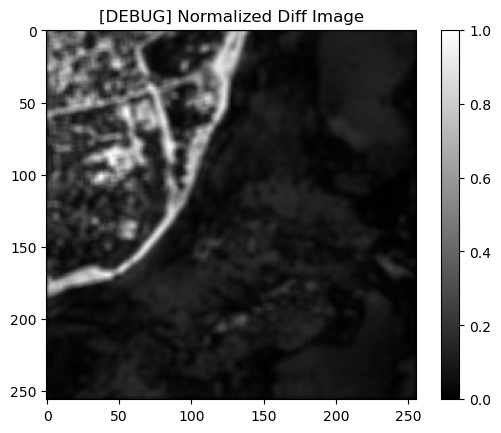

[INFO] Saving train data:  27%|██████████████▊                                        | 37/137 [00:13<00:38,  2.62it/s]

[DEBUG] Mask class counts: [29896 26565  3990  5085]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_36.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_36.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_36.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000019_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000019_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3178, Post tensor mean: 0.2946
[DEBUG] Diff stats -> min: 0.0000, max: 0.9804, mean: 0.1782
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.1772


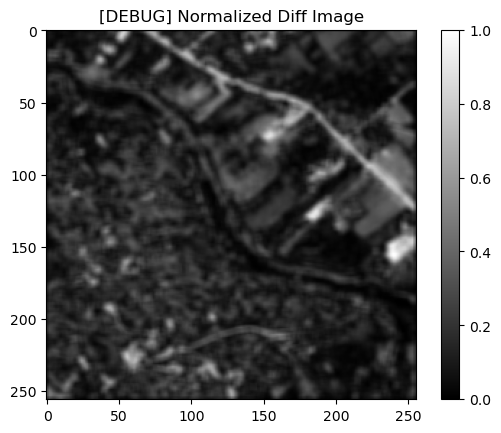

[INFO] Saving train data:  28%|███████████████▎                                       | 38/137 [00:13<00:35,  2.80it/s]

[DEBUG] Mask class counts: [16534 34423 12337  2242]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_37.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_37.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_37.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000010_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000010_post_disaster.tif
[DEBUG] Pre tensor mean: 0.1396, Post tensor mean: 0.0613
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.0816
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.0824


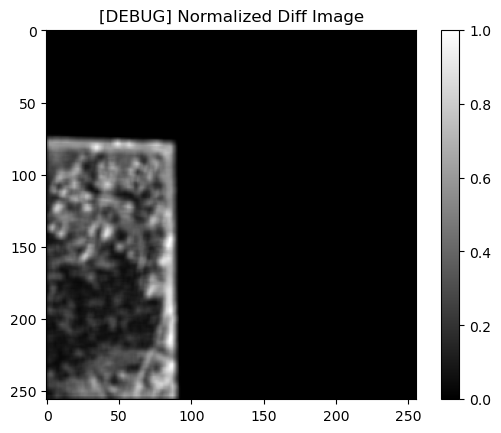

[INFO] Saving train data:  28%|███████████████▋                                       | 39/137 [00:13<00:32,  2.98it/s]

[DEBUG] Mask class counts: [51564  4515  5265  4192]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_38.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_38.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_38.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000060_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000060_post_disaster.tif
[DEBUG] Pre tensor mean: 0.1931, Post tensor mean: 0.0779
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.1201
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.1201


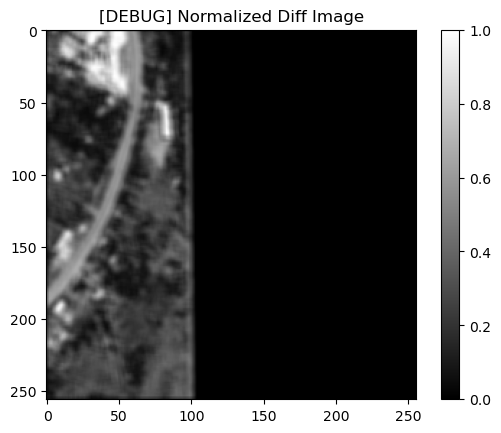

[INFO] Saving train data:  29%|████████████████                                       | 40/137 [00:13<00:31,  3.04it/s]

[DEBUG] Mask class counts: [41569  8024 11428  4515]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_39.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_39.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_39.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000106_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000106_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3243, Post tensor mean: 0.1861
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.2030
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2159


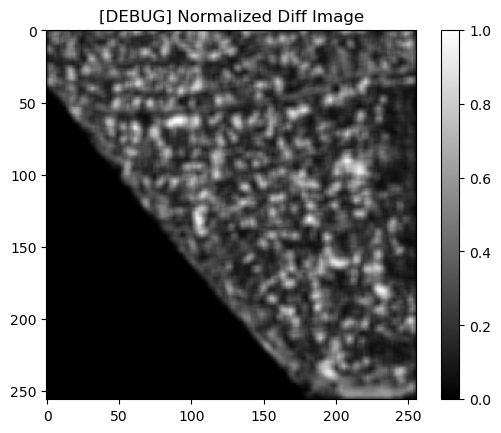

[INFO] Saving train data:  30%|████████████████▍                                      | 41/137 [00:14<00:30,  3.17it/s]

[DEBUG] Mask class counts: [25371 12879 20606  6680]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_40.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_40.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_40.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000047_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000047_post_disaster.tif
[DEBUG] Pre tensor mean: 0.4331, Post tensor mean: 0.1544
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.3356
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.3295


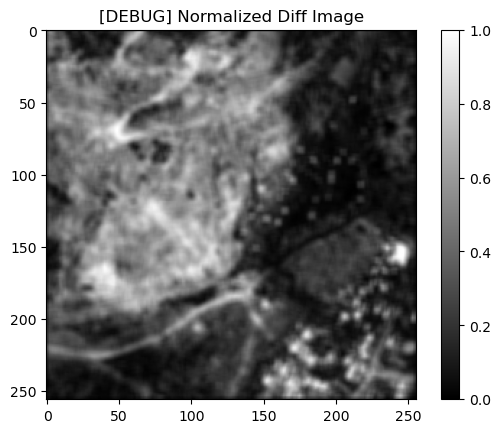

[INFO] Saving train data:  31%|████████████████▊                                      | 42/137 [00:14<00:29,  3.22it/s]

[DEBUG] Mask class counts: [11467 16218 16916 20935]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_41.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_41.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_41.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000115_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000115_post_disaster.tif
[DEBUG] Pre tensor mean: 0.2617, Post tensor mean: 0.2557
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.1475
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.1558


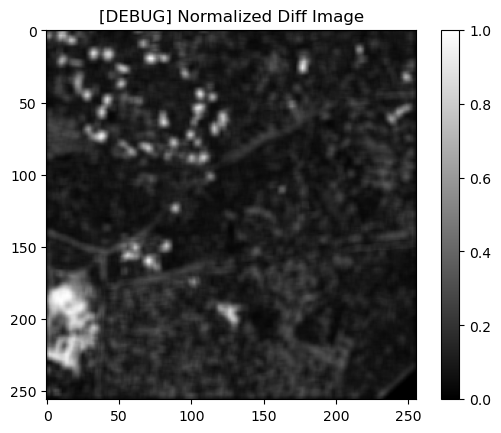

[INFO] Saving train data:  31%|█████████████████▎                                     | 43/137 [00:14<00:29,  3.19it/s]

[DEBUG] Mask class counts: [15526 43054  4602  2354]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_42.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_42.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_42.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000102_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000102_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3594, Post tensor mean: 0.2446
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.2467
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2314


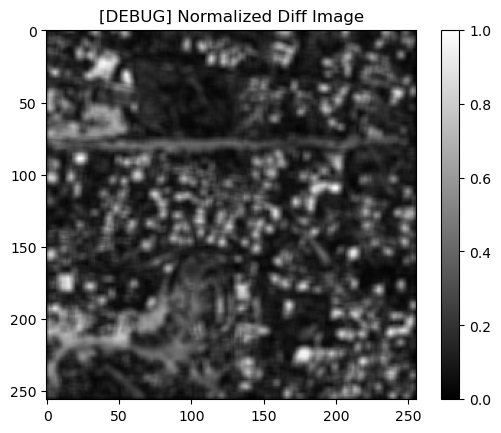

[INFO] Saving train data:  32%|█████████████████▋                                     | 44/137 [00:15<00:29,  3.17it/s]

[DEBUG] Mask class counts: [16488 27237 15959  5852]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_43.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_43.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_43.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000068_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000068_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3865, Post tensor mean: 0.2686
[DEBUG] Diff stats -> min: 0.0000, max: 0.9529, mean: 0.2371
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2563


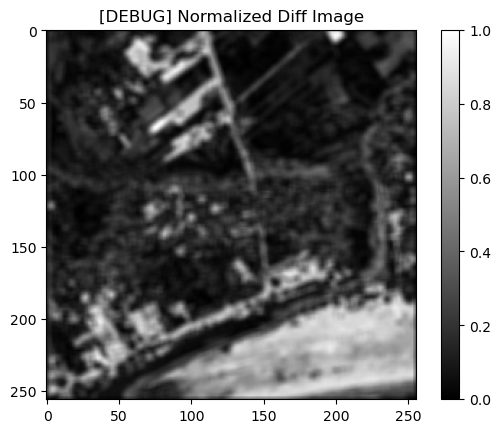

[INFO] Saving train data:  33%|██████████████████                                     | 45/137 [00:15<00:28,  3.21it/s]

[DEBUG] Mask class counts: [19298 25053  8878 12307]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_44.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_44.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_44.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000004_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000004_post_disaster.tif
[DEBUG] Pre tensor mean: 0.4541, Post tensor mean: 0.2922
[DEBUG] Diff stats -> min: 0.0000, max: 0.9451, mean: 0.2314
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2652


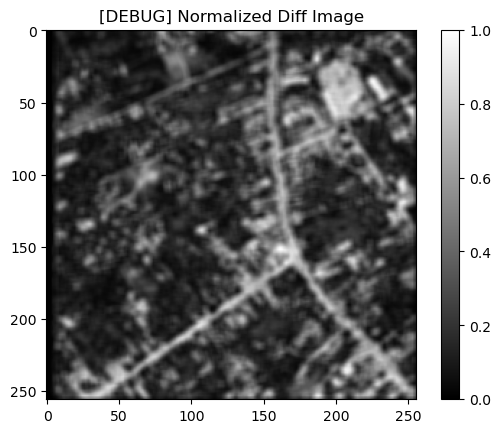

[INFO] Saving train data:  34%|██████████████████▍                                    | 46/137 [00:15<00:30,  2.99it/s]

[DEBUG] Mask class counts: [11028 28339 16101 10068]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_45.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_45.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_45.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000017_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000017_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3274, Post tensor mean: 0.2852
[DEBUG] Diff stats -> min: 0.0000, max: 0.9961, mean: 0.2053
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2044


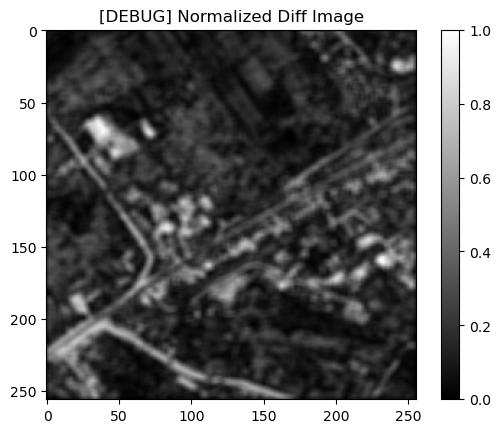

[INFO] Saving train data:  34%|██████████████████▊                                    | 47/137 [00:16<00:33,  2.71it/s]

[DEBUG] Mask class counts: [14336 32404 14643  4153]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_46.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_46.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_46.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000100_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000100_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3865, Post tensor mean: 0.2573
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.2533
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2675


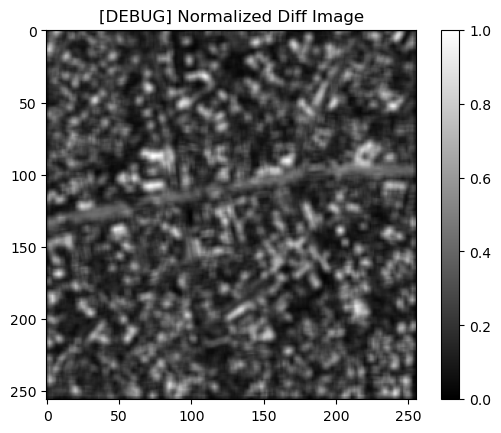

[INFO] Saving train data:  35%|███████████████████▎                                   | 48/137 [00:16<00:35,  2.53it/s]

[DEBUG] Mask class counts: [12793 22665 24011  6067]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_47.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_47.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_47.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000029_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000029_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3893, Post tensor mean: 0.2956
[DEBUG] Diff stats -> min: 0.0000, max: 0.9569, mean: 0.1933
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2511


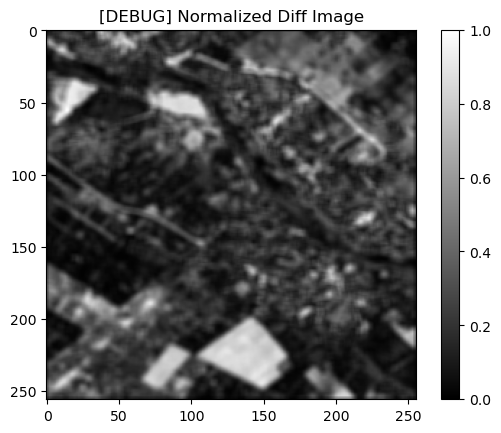

[INFO] Saving train data:  36%|███████████████████▋                                   | 49/137 [00:17<00:33,  2.60it/s]

[DEBUG] Mask class counts: [13478 24539 20026  7493]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_48.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_48.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_48.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000061_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000061_post_disaster.tif
[DEBUG] Pre tensor mean: 0.2153, Post tensor mean: 0.1080
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.1231
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.1321


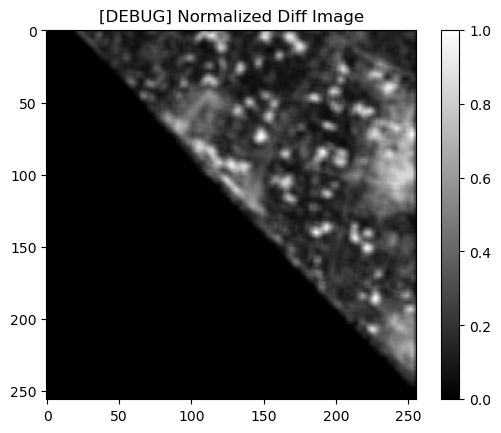

[INFO] Saving train data:  36%|████████████████████                                   | 50/137 [00:17<00:33,  2.63it/s]

[DEBUG] Mask class counts: [39502 12058  8892  5084]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_49.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_49.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_49.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000000_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000000_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3020, Post tensor mean: 0.0974
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.2047
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2336


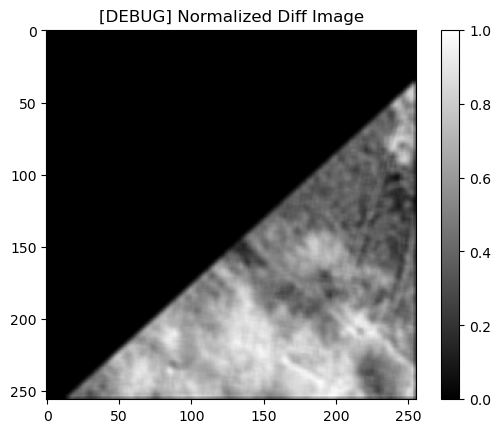

[INFO] Saving train data:  37%|████████████████████▍                                  | 51/137 [00:17<00:31,  2.77it/s]

[DEBUG] Mask class counts: [39916   241  7469 17910]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_50.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_50.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_50.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000065_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000065_post_disaster.tif
[DEBUG] Pre tensor mean: 0.4233, Post tensor mean: 0.2643
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.2523
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2877


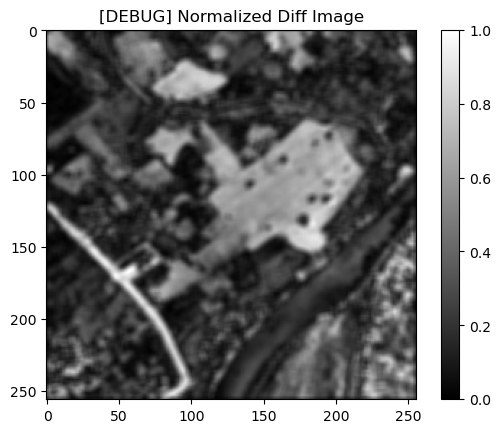

[INFO] Saving train data:  38%|████████████████████▉                                  | 52/137 [00:18<00:29,  2.86it/s]

[DEBUG] Mask class counts: [ 9939 24362 18435 12800]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_51.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_51.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_51.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000016_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000016_post_disaster.tif
[DEBUG] Pre tensor mean: 0.4978, Post tensor mean: 0.2156
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.3059
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2867


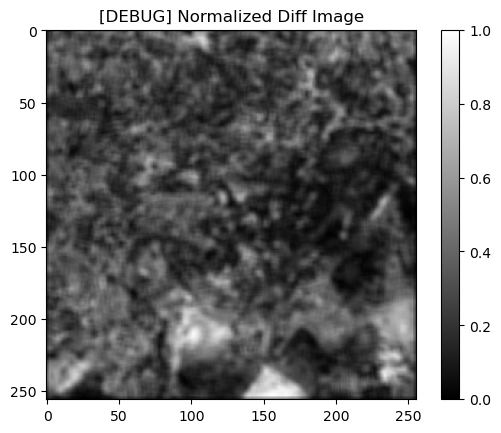

[INFO] Saving train data:  39%|█████████████████████▎                                 | 53/137 [00:18<00:29,  2.81it/s]

[DEBUG] Mask class counts: [ 6229 18752 33992  6563]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_52.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_52.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_52.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000025_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000025_post_disaster.tif
[DEBUG] Pre tensor mean: 0.4436, Post tensor mean: 0.2729
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.3046
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.3028


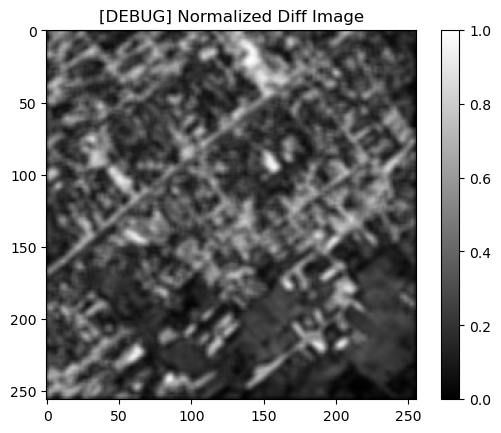

[INFO] Saving train data:  39%|█████████████████████▋                                 | 54/137 [00:18<00:28,  2.92it/s]

[DEBUG] Mask class counts: [ 8935 19380 26019 11202]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_53.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_53.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_53.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000101_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000101_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3955, Post tensor mean: 0.2328
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.2678
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2697


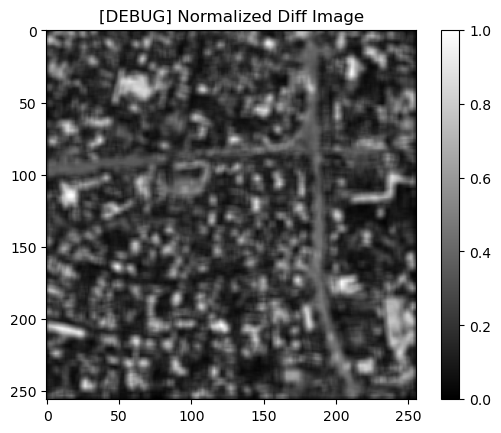

[INFO] Saving train data:  40%|██████████████████████                                 | 55/137 [00:19<00:27,  2.98it/s]

[DEBUG] Mask class counts: [11255 24077 23388  6816]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_54.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_54.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_54.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000110_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000110_post_disaster.tif
[DEBUG] Pre tensor mean: 0.2570, Post tensor mean: 0.2589
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.1774
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.1800


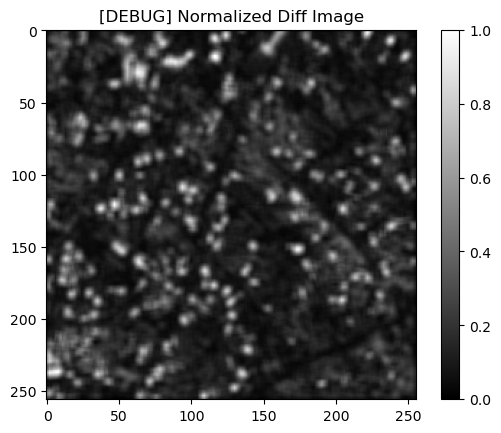

[INFO] Saving train data:  41%|██████████████████████▍                                | 56/137 [00:19<00:26,  3.04it/s]

[DEBUG] Mask class counts: [20557 33583  8404  2992]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_55.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_55.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_55.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000069_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000069_post_disaster.tif
[DEBUG] Pre tensor mean: 0.4041, Post tensor mean: 0.2497
[DEBUG] Diff stats -> min: 0.0000, max: 0.9725, mean: 0.2632
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2732


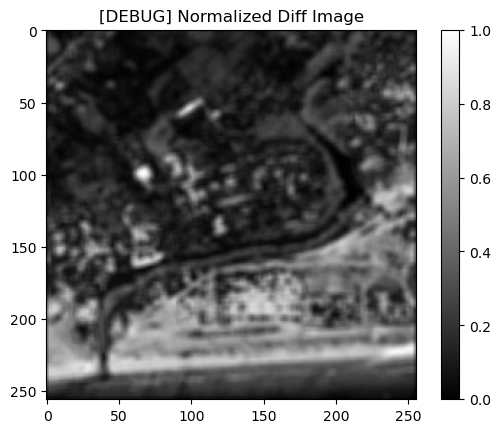

[INFO] Saving train data:  42%|██████████████████████▉                                | 57/137 [00:19<00:25,  3.18it/s]

[DEBUG] Mask class counts: [12110 24719 15515 13192]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_56.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_56.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_56.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000030_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000030_post_disaster.tif
[DEBUG] Pre tensor mean: 0.2743, Post tensor mean: 0.3135
[DEBUG] Diff stats -> min: 0.0000, max: 0.9294, mean: 0.1891
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2207


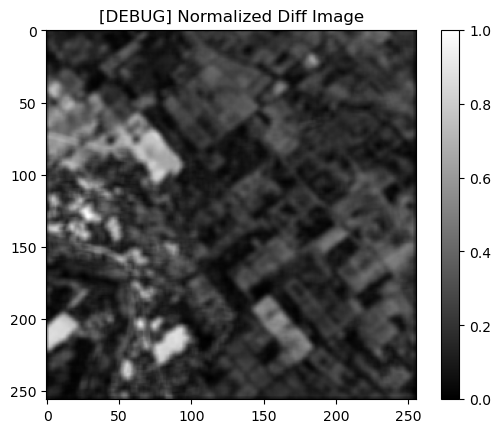

[INFO] Saving train data:  42%|███████████████████████▎                               | 58/137 [00:20<00:24,  3.25it/s]

[DEBUG] Mask class counts: [10307 30986 19745  4498]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_57.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_57.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_57.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000009_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000009_post_disaster.tif
[DEBUG] Pre tensor mean: 0.4224, Post tensor mean: 0.2638
[DEBUG] Diff stats -> min: 0.0000, max: 0.9922, mean: 0.1859
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.1915


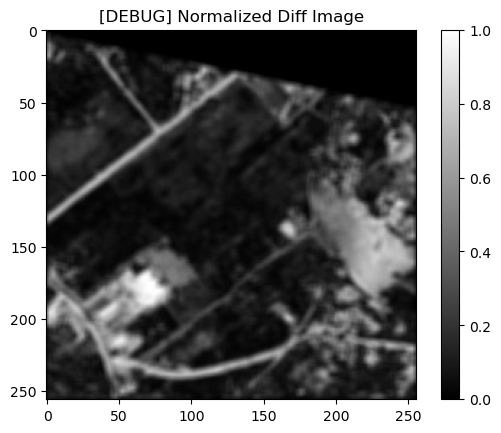

[INFO] Saving train data:  43%|███████████████████████▋                               | 59/137 [00:20<00:23,  3.30it/s]

[DEBUG] Mask class counts: [27326 21284  9003  7923]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_58.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_58.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_58.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000038_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000038_post_disaster.tif
[DEBUG] Pre tensor mean: 0.2425, Post tensor mean: 0.2427
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.1694
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.1621


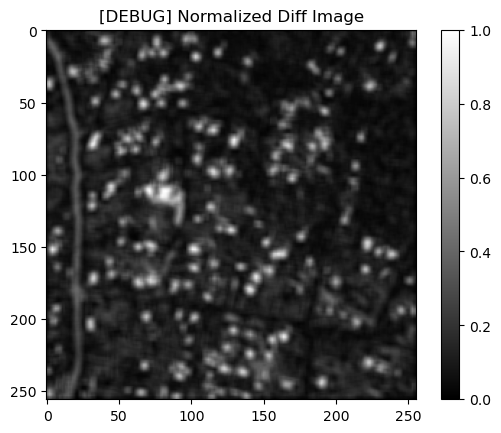

[INFO] Saving train data:  44%|████████████████████████                               | 60/137 [00:20<00:22,  3.35it/s]

[DEBUG] Mask class counts: [24327 32411  6370  2428]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_59.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_59.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_59.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000122_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000122_post_disaster.tif
[DEBUG] Pre tensor mean: 0.1270, Post tensor mean: 0.0641
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.0693
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.0746


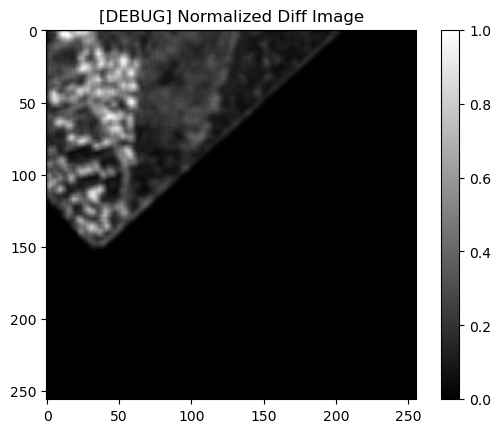

[INFO] Saving train data:  45%|████████████████████████▍                              | 61/137 [00:20<00:22,  3.44it/s]

[DEBUG] Mask class counts: [49661  7545  5508  2822]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_60.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_60.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_60.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000043_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000043_post_disaster.tif
[DEBUG] Pre tensor mean: 0.4963, Post tensor mean: 0.2436
[DEBUG] Diff stats -> min: 0.0000, max: 0.9804, mean: 0.2893
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.3379


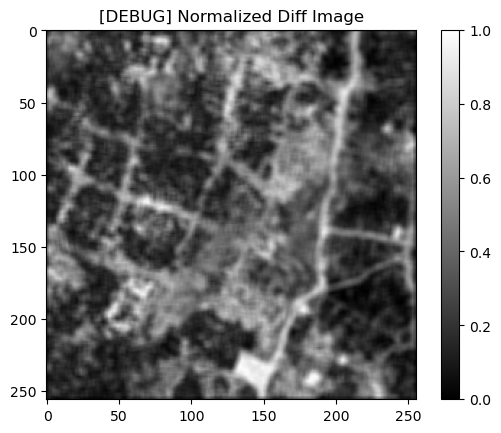

[INFO] Saving train data:  45%|████████████████████████▉                              | 62/137 [00:21<00:23,  3.22it/s]

[DEBUG] Mask class counts: [ 7169 17734 23301 17332]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_61.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_61.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_61.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000034_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000034_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3571, Post tensor mean: 0.2897
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.2474
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2478


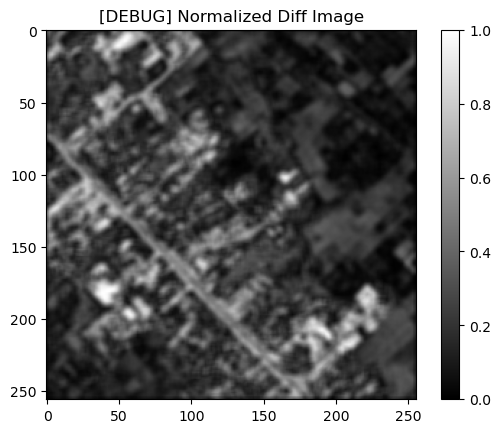

[INFO] Saving train data:  46%|█████████████████████████▎                             | 63/137 [00:21<00:22,  3.33it/s]

[DEBUG] Mask class counts: [12297 25484 19812  7943]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_62.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_62.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_62.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000111_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000111_post_disaster.tif
[DEBUG] Pre tensor mean: 0.2481, Post tensor mean: 0.1197
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.1358
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.1427


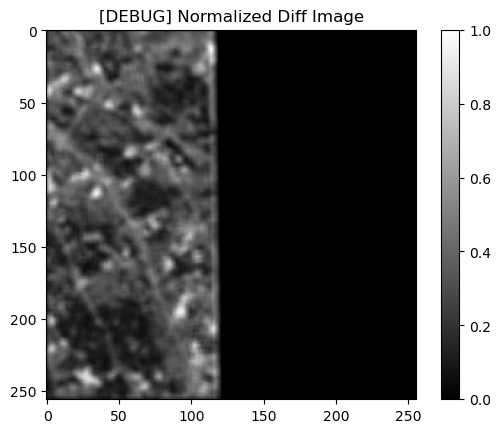

[INFO] Saving train data:  47%|█████████████████████████▋                             | 64/137 [00:21<00:21,  3.43it/s]

[DEBUG] Mask class counts: [37051  7401 17576  3508]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_63.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_63.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_63.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000019_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000019_post_disaster.tif
[DEBUG] Pre tensor mean: 0.4853, Post tensor mean: 0.1944
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.3224
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.3324


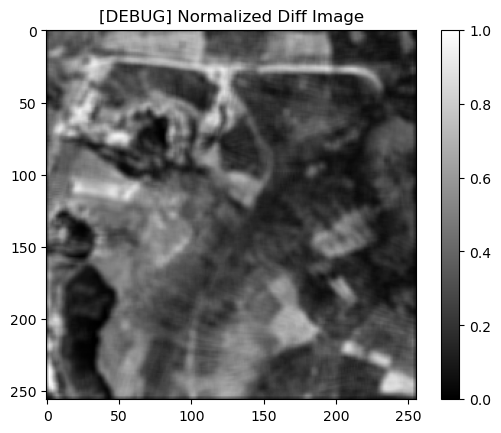

[INFO] Saving train data:  47%|██████████████████████████                             | 65/137 [00:22<00:21,  3.28it/s]

[DEBUG] Mask class counts: [ 6120 16911 25733 16772]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_64.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_64.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_64.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000014_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000014_post_disaster.tif
[DEBUG] Pre tensor mean: 0.4759, Post tensor mean: 0.2418
[DEBUG] Diff stats -> min: 0.0000, max: 0.9961, mean: 0.2809
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.3089


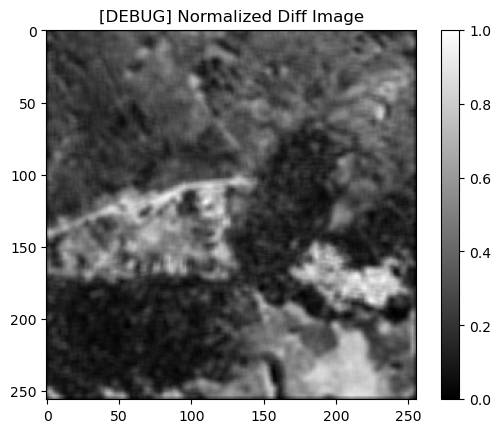

[INFO] Saving train data:  48%|██████████████████████████▍                            | 66/137 [00:22<00:23,  3.05it/s]

[DEBUG] Mask class counts: [ 7132 19385 26640 12379]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_65.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_65.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_65.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000051_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000051_post_disaster.tif
[DEBUG] Pre tensor mean: 0.5452, Post tensor mean: 0.3192
[DEBUG] Diff stats -> min: 0.0000, max: 0.9961, mean: 0.3181
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.3035


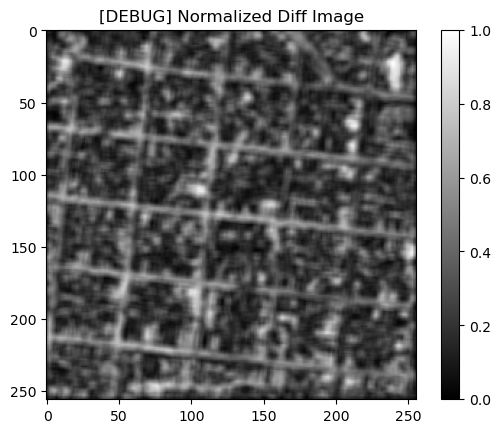

[INFO] Saving train data:  49%|██████████████████████████▉                            | 67/137 [00:22<00:21,  3.19it/s]

[DEBUG] Mask class counts: [ 9296 18604 27338 10298]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_66.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_66.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_66.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000015_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000015_post_disaster.tif
[DEBUG] Pre tensor mean: 0.4859, Post tensor mean: 0.2697
[DEBUG] Diff stats -> min: 0.0000, max: 0.9804, mean: 0.3133
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.3416


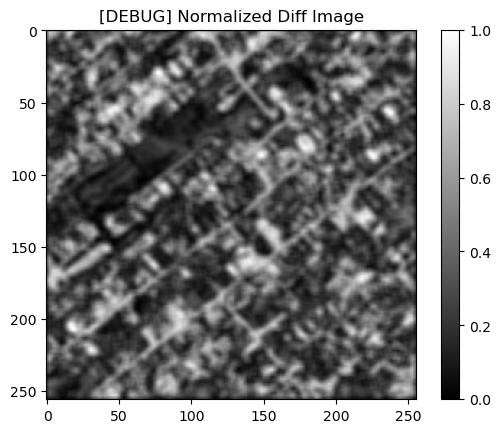

[INFO] Saving train data:  50%|███████████████████████████▎                           | 68/137 [00:23<00:35,  1.94it/s]

[DEBUG] Mask class counts: [10797 15119 23377 16243]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_67.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_67.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_67.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000103_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000103_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3322, Post tensor mean: 0.2570
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.2154
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2000


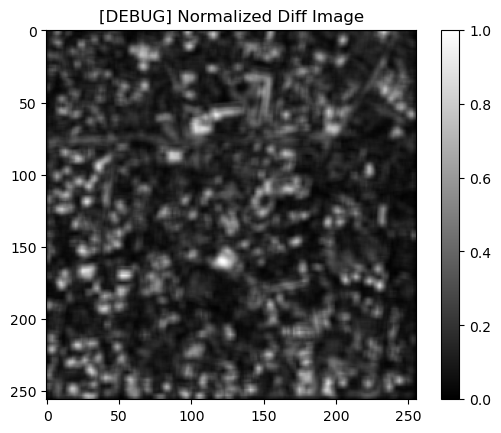

[INFO] Saving train data:  50%|███████████████████████████▋                           | 69/137 [00:24<00:30,  2.21it/s]

[DEBUG] Mask class counts: [17331 31178 13683  3344]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_68.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_68.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_68.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000065_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000065_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3791, Post tensor mean: 0.2278
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.1868
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.1704


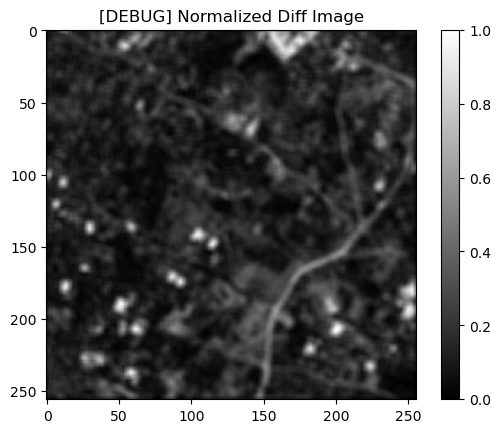

[INFO] Saving train data:  51%|████████████████████████████                           | 70/137 [00:24<00:27,  2.47it/s]

[DEBUG] Mask class counts: [16068 36884 10615  1969]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_69.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_69.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_69.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000046_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000046_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3227, Post tensor mean: 0.1914
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.1573
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.1706


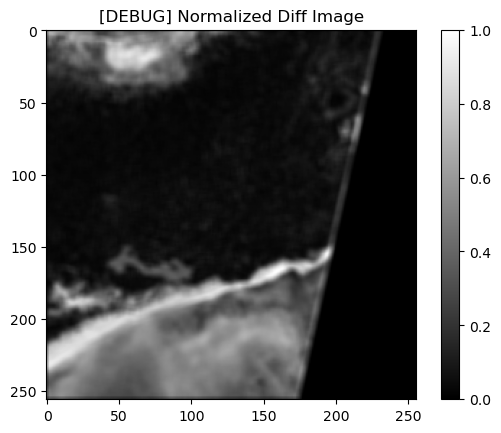

[INFO] Saving train data:  52%|████████████████████████████▌                          | 71/137 [00:24<00:24,  2.71it/s]

[DEBUG] Mask class counts: [41783  5589  8661  9503]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_70.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_70.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_70.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000104_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000104_post_disaster.tif
[DEBUG] Pre tensor mean: 0.2784, Post tensor mean: 0.2601
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.1944
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2011


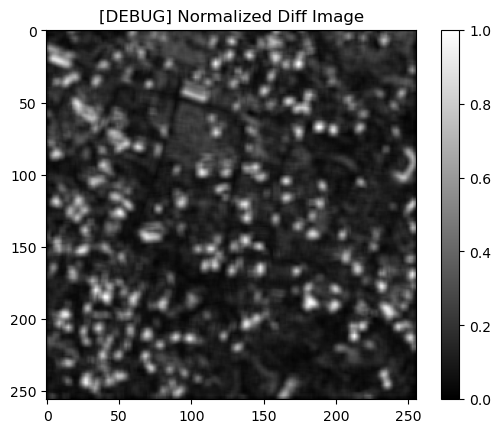

[INFO] Saving train data:  53%|████████████████████████████▉                          | 72/137 [00:24<00:22,  2.89it/s]

[DEBUG] Mask class counts: [18611 33263  9096  4566]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_71.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_71.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_71.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000046_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000046_post_disaster.tif
[DEBUG] Pre tensor mean: 0.5020, Post tensor mean: 0.2114
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.3272
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.3230


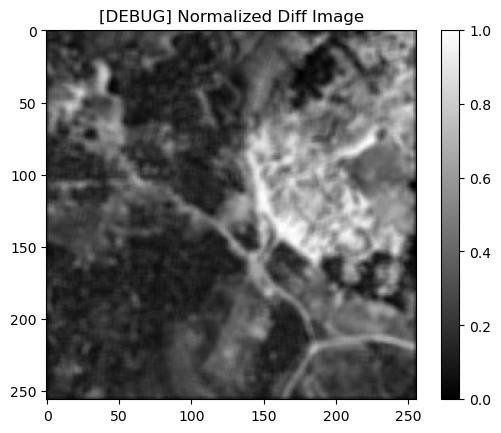

[INFO] Saving train data:  53%|█████████████████████████████▎                         | 73/137 [00:25<00:21,  3.04it/s]

[DEBUG] Mask class counts: [ 4182 23858 22135 15361]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_72.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_72.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_72.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000095_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000095_post_disaster.tif
[DEBUG] Pre tensor mean: 0.2975, Post tensor mean: 0.2409
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.1969
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.1830


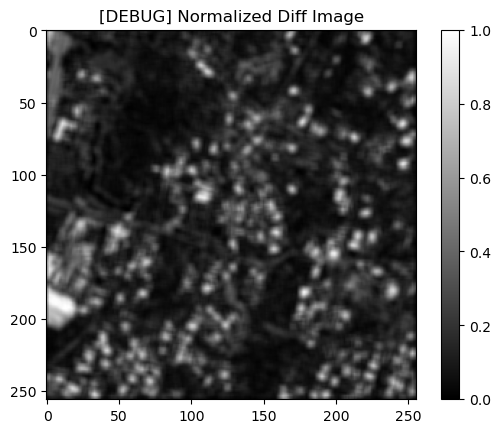

[INFO] Saving train data:  54%|█████████████████████████████▋                         | 74/137 [00:25<00:19,  3.18it/s]

[DEBUG] Mask class counts: [23439 28233 10324  3540]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_73.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_73.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_73.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000076_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000076_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3039, Post tensor mean: 0.2456
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.1852
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.1930


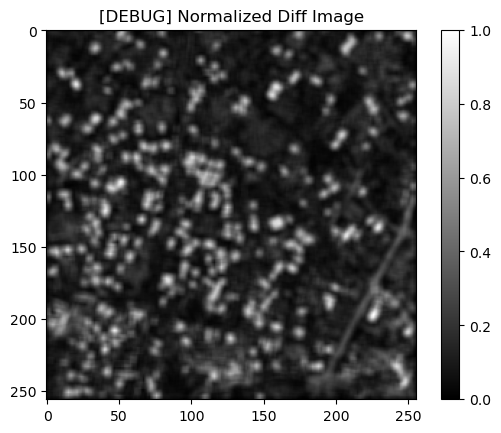

[INFO] Saving train data:  55%|██████████████████████████████                         | 75/137 [00:25<00:19,  3.23it/s]

[DEBUG] Mask class counts: [22691 31170  7477  4198]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_74.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_74.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_74.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000054_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000054_post_disaster.tif
[DEBUG] Pre tensor mean: 0.2926, Post tensor mean: 0.2330
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.1513
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.1418


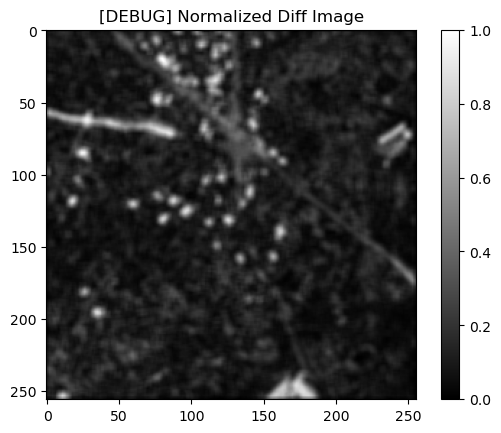

[INFO] Saving train data:  55%|██████████████████████████████▌                        | 76/137 [00:26<00:18,  3.33it/s]

[DEBUG] Mask class counts: [21590 38189  3837  1920]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_75.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_75.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_75.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000013_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000013_post_disaster.tif
[DEBUG] Pre tensor mean: 0.4661, Post tensor mean: 0.2689
[DEBUG] Diff stats -> min: 0.0000, max: 0.9725, mean: 0.2468
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2655


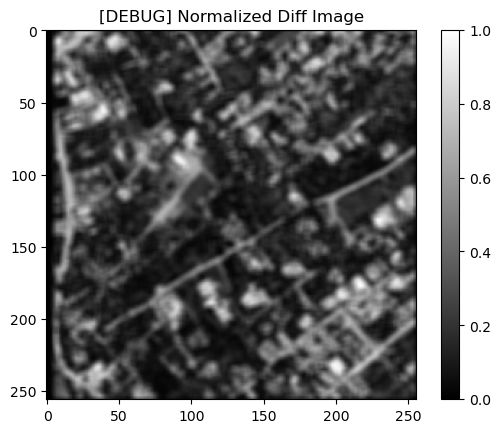

[INFO] Saving train data:  56%|██████████████████████████████▉                        | 77/137 [00:26<00:17,  3.40it/s]

[DEBUG] Mask class counts: [13980 24625 16725 10206]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_76.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_76.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_76.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000001_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000001_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3311, Post tensor mean: 0.2112
[DEBUG] Diff stats -> min: 0.0000, max: 0.9451, mean: 0.1720
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.1915


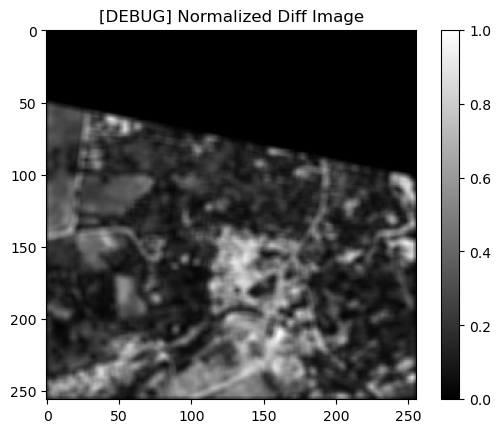

[INFO] Saving train data:  57%|███████████████████████████████▎                       | 78/137 [00:26<00:17,  3.40it/s]

[DEBUG] Mask class counts: [25935 19033 12904  7664]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_77.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_77.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_77.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000044_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000044_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3081, Post tensor mean: 0.3119
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.2306
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2217


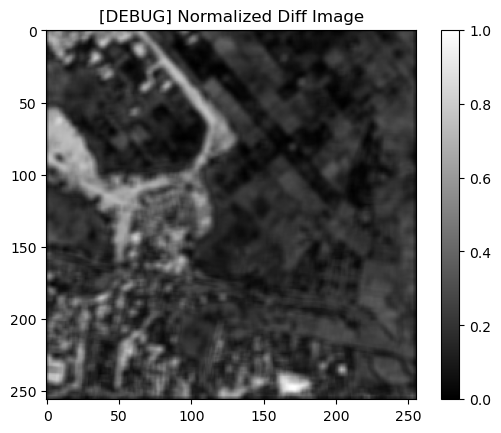

[INFO] Saving train data:  58%|███████████████████████████████▋                       | 79/137 [00:26<00:16,  3.45it/s]

[DEBUG] Mask class counts: [10468 33332 16486  5250]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_78.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_78.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_78.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000105_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000105_post_disaster.tif
[DEBUG] Pre tensor mean: 0.1851, Post tensor mean: 0.1141
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.0873
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.0939


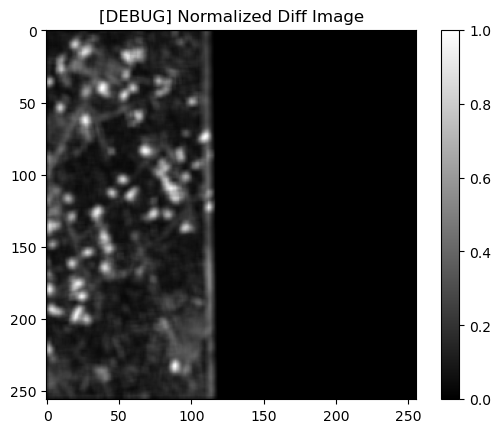

[INFO] Saving train data:  58%|████████████████████████████████                       | 80/137 [00:27<00:16,  3.54it/s]

[DEBUG] Mask class counts: [42443 15619  5559  1915]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_79.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_79.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_79.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000112_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000112_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3306, Post tensor mean: 0.1898
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.2130
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2379


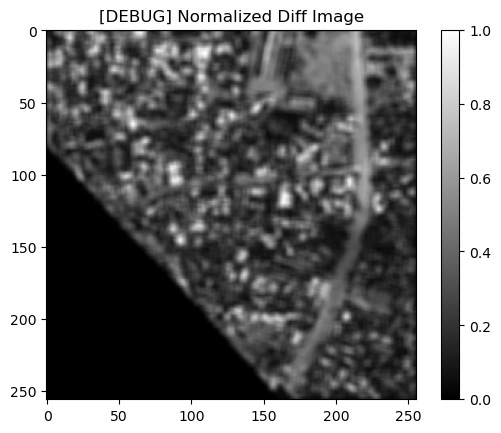

[INFO] Saving train data:  59%|████████████████████████████████▌                      | 81/137 [00:27<00:16,  3.36it/s]

[DEBUG] Mask class counts: [20369 15238 21620  8309]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_80.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_80.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_80.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000047_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000047_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3275, Post tensor mean: 0.2749
[DEBUG] Diff stats -> min: 0.0000, max: 0.9961, mean: 0.1727
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.1847


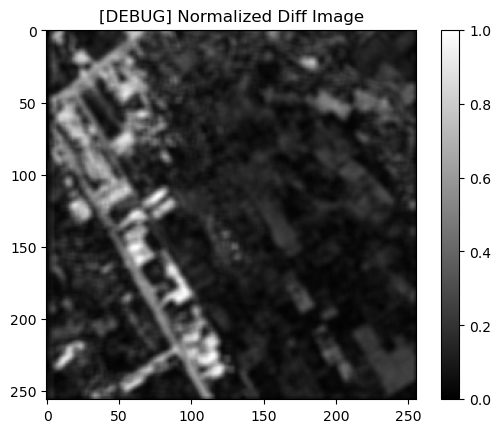

[INFO] Saving train data:  60%|████████████████████████████████▉                      | 82/137 [00:27<00:16,  3.40it/s]

[DEBUG] Mask class counts: [20431 31870  7507  5728]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_81.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_81.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_81.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000033_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000033_post_disaster.tif
[DEBUG] Pre tensor mean: 0.4833, Post tensor mean: 0.1822
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.3290
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.3375


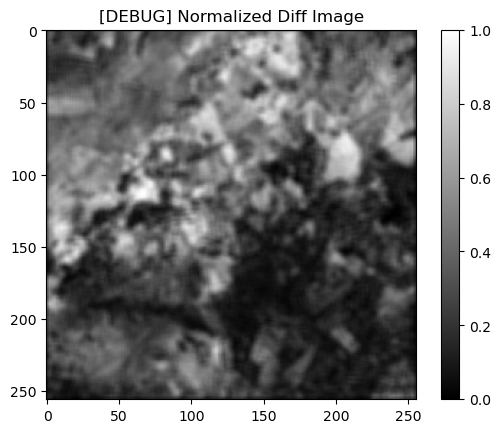

[INFO] Saving train data:  61%|█████████████████████████████████▎                     | 83/137 [00:28<00:15,  3.40it/s]

[DEBUG] Mask class counts: [ 6458 17094 24029 17955]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_82.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_82.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_82.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000018_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000018_post_disaster.tif
[DEBUG] Pre tensor mean: 0.5271, Post tensor mean: 0.2137
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.3338
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.3160


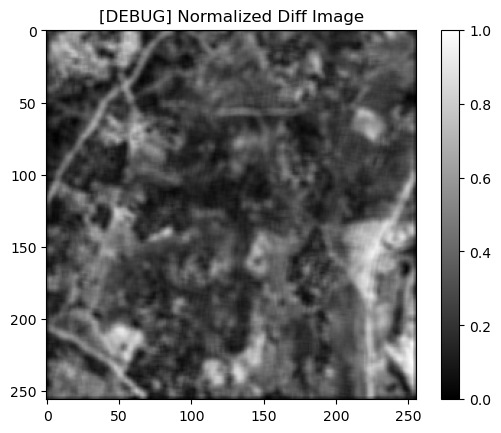

[INFO] Saving train data:  61%|█████████████████████████████████▋                     | 84/137 [00:28<00:15,  3.33it/s]

[DEBUG] Mask class counts: [ 4993 17478 32051 11014]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_83.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_83.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_83.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000024_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000024_post_disaster.tif
[DEBUG] Pre tensor mean: 0.4665, Post tensor mean: 0.2810
[DEBUG] Diff stats -> min: 0.0000, max: 0.9882, mean: 0.2930
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.3102


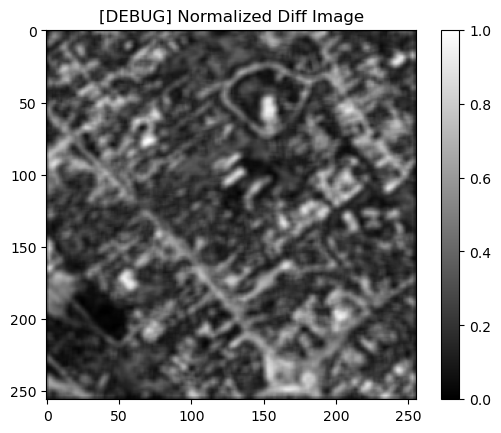

[INFO] Saving train data:  62%|██████████████████████████████████                     | 85/137 [00:28<00:15,  3.40it/s]

[DEBUG] Mask class counts: [ 8995 18405 26355 11781]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_84.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_84.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_84.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000121_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000121_post_disaster.tif
[DEBUG] Pre tensor mean: 0.0615, Post tensor mean: 0.0279
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.0416
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.0454


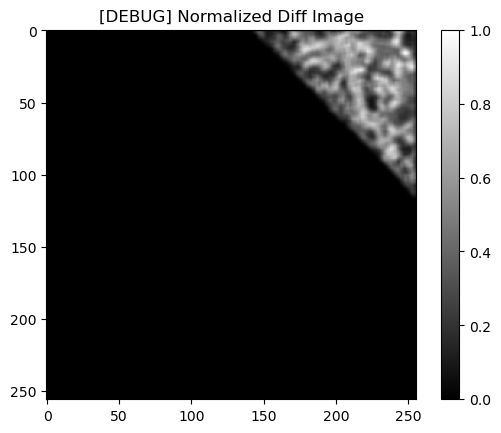

[INFO] Saving train data:  63%|██████████████████████████████████▌                    | 86/137 [00:29<00:14,  3.56it/s]

[DEBUG] Mask class counts: [59952   333  2022  3229]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_85.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_85.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_85.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000049_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000049_post_disaster.tif
[DEBUG] Pre tensor mean: 0.4501, Post tensor mean: 0.2761
[DEBUG] Diff stats -> min: 0.0000, max: 0.9922, mean: 0.2870
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2786


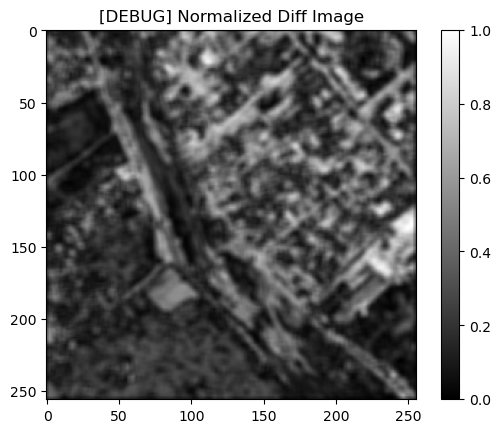

[INFO] Saving train data:  64%|██████████████████████████████████▉                    | 87/137 [00:29<00:14,  3.52it/s]

[DEBUG] Mask class counts: [10123 23352 22280  9781]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_86.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_86.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_86.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000063_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000063_post_disaster.tif
[DEBUG] Pre tensor mean: 0.1968, Post tensor mean: 0.2237
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.1440
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.1406


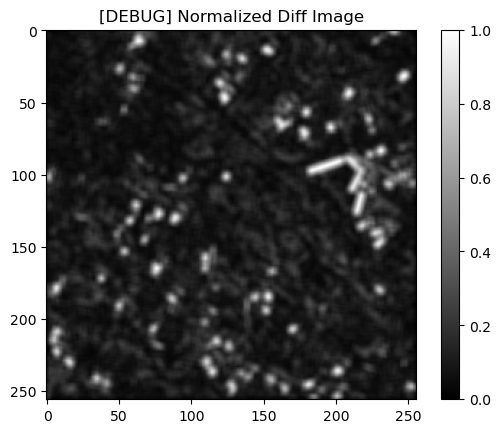

[INFO] Saving train data:  64%|███████████████████████████████████▎                   | 88/137 [00:29<00:14,  3.49it/s]

[DEBUG] Mask class counts: [25473 35028  2743  2292]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_87.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_87.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_87.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000083_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000083_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3190, Post tensor mean: 0.2589
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.2156
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2397


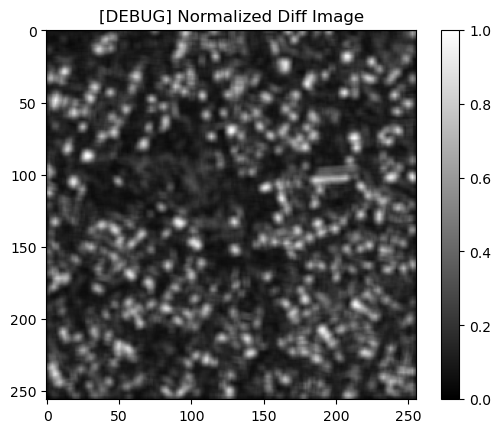

[INFO] Saving train data:  65%|███████████████████████████████████▋                   | 89/137 [00:29<00:13,  3.46it/s]

[DEBUG] Mask class counts: [12164 32749 14649  5974]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_88.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_88.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_88.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000063_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000063_post_disaster.tif
[DEBUG] Pre tensor mean: 0.2986, Post tensor mean: 0.2881
[DEBUG] Diff stats -> min: 0.0000, max: 0.9765, mean: 0.1826
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.1875


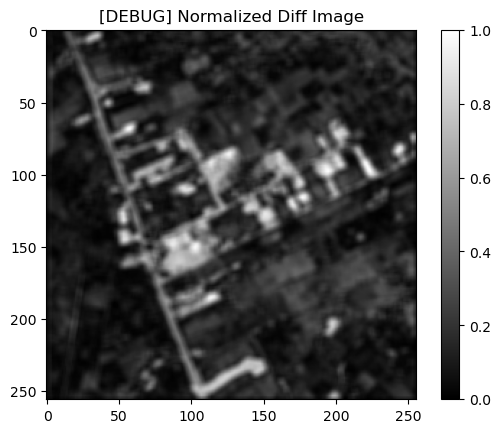

[INFO] Saving train data:  66%|████████████████████████████████████▏                  | 90/137 [00:30<00:13,  3.43it/s]

[DEBUG] Mask class counts: [19639 31348  9693  4856]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_89.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_89.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_89.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000022_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000022_post_disaster.tif
[DEBUG] Pre tensor mean: 0.5134, Post tensor mean: 0.2710
[DEBUG] Diff stats -> min: 0.0000, max: 0.9804, mean: 0.2888
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.3048


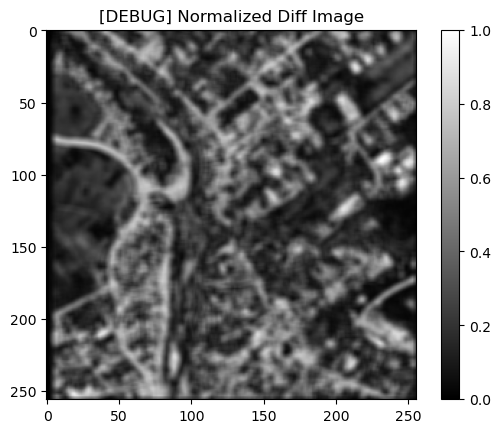

[INFO] Saving train data:  66%|████████████████████████████████████▌                  | 91/137 [00:30<00:13,  3.51it/s]

[DEBUG] Mask class counts: [11208 19053 21923 13352]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_90.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_90.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_90.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000072_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000072_post_disaster.tif
[DEBUG] Pre tensor mean: 0.2432, Post tensor mean: 0.1141
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.1399
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.1490


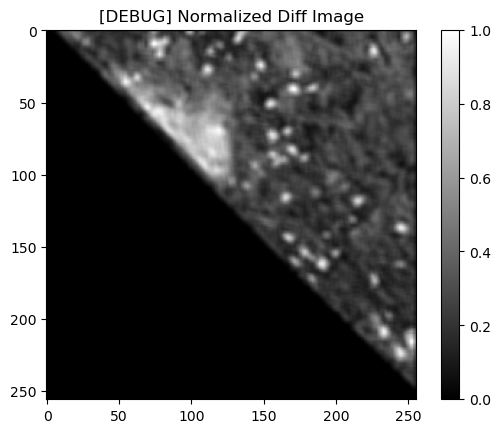

[INFO] Saving train data:  67%|████████████████████████████████████▉                  | 92/137 [00:30<00:12,  3.56it/s]

[DEBUG] Mask class counts: [36908  8278 16020  4330]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_91.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_91.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_91.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000027_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000027_post_disaster.tif
[DEBUG] Pre tensor mean: 0.5490, Post tensor mean: 0.2261
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.3495
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.3450


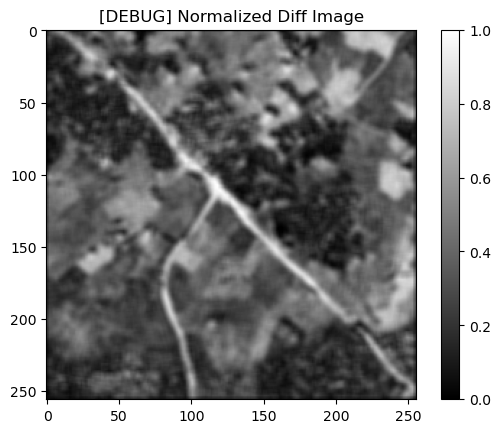

[INFO] Saving train data:  68%|█████████████████████████████████████▎                 | 93/137 [00:31<00:12,  3.45it/s]

[DEBUG] Mask class counts: [ 4466 14669 31201 15200]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_92.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_92.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_92.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000058_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000058_post_disaster.tif
[DEBUG] Pre tensor mean: 0.4825, Post tensor mean: 0.2826
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.2944
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.3087


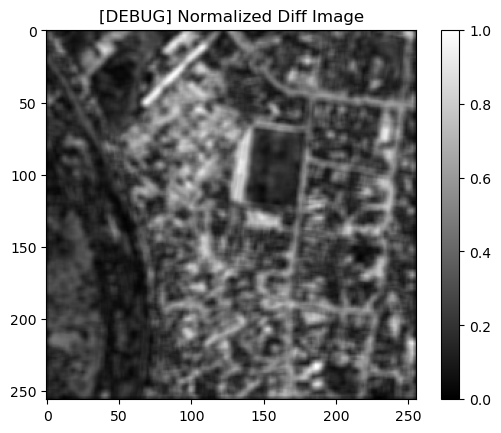

[INFO] Saving train data:  69%|█████████████████████████████████████▋                 | 94/137 [00:31<00:12,  3.48it/s]

[DEBUG] Mask class counts: [ 8085 18973 26135 12343]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_93.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_93.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_93.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000039_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000039_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3011, Post tensor mean: 0.2793
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.1724
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.1851


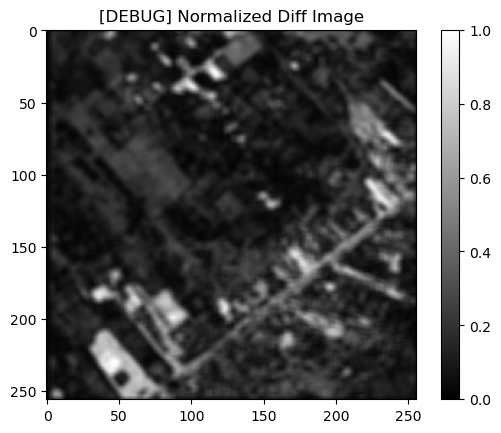

[INFO] Saving train data:  69%|██████████████████████████████████████▏                | 95/137 [00:31<00:12,  3.44it/s]

[DEBUG] Mask class counts: [17922 33350 10059  4205]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_94.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_94.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_94.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000051_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000051_post_disaster.tif
[DEBUG] Pre tensor mean: 0.2464, Post tensor mean: 0.2300
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.1495
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.1364


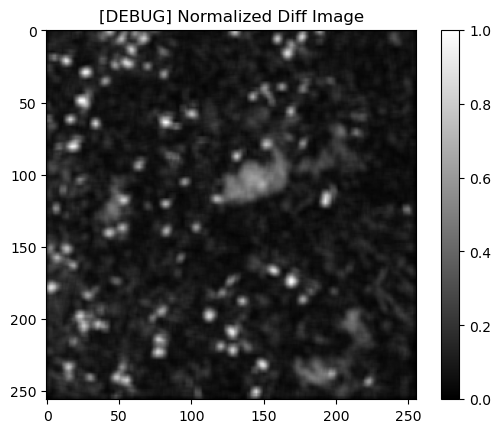

[INFO] Saving train data:  70%|██████████████████████████████████████▌                | 96/137 [00:31<00:12,  3.27it/s]

[DEBUG] Mask class counts: [27859 31518  4293  1866]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_95.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_95.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_95.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000072_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000072_post_disaster.tif
[DEBUG] Pre tensor mean: 0.1616, Post tensor mean: 0.0697
[DEBUG] Diff stats -> min: 0.0000, max: 0.8784, mean: 0.0922
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.1148


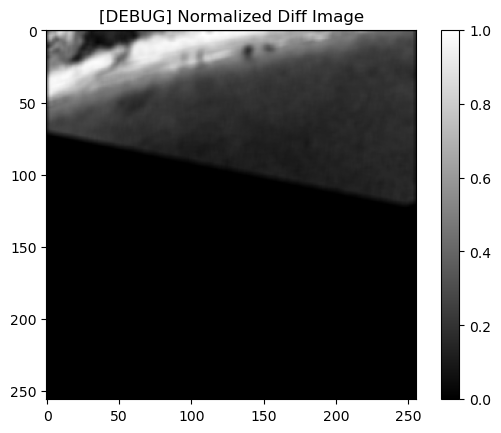

[INFO] Saving train data:  71%|██████████████████████████████████████▉                | 97/137 [00:32<00:12,  3.31it/s]

[DEBUG] Mask class counts: [41695 13698  5204  4939]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_96.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_96.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_96.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000004_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000004_post_disaster.tif
[DEBUG] Pre tensor mean: 0.7171, Post tensor mean: 0.1893
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.5278
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.6001


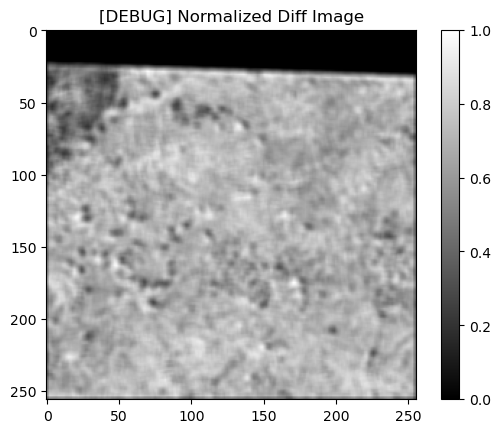

[INFO] Saving train data:  72%|███████████████████████████████████████▎               | 98/137 [00:32<00:11,  3.25it/s]

[DEBUG] Mask class counts: [ 8124     0  1735 55677]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_97.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_97.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_97.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000029_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000029_post_disaster.tif
[DEBUG] Pre tensor mean: 0.5105, Post tensor mean: 0.1884
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.3422
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.3265


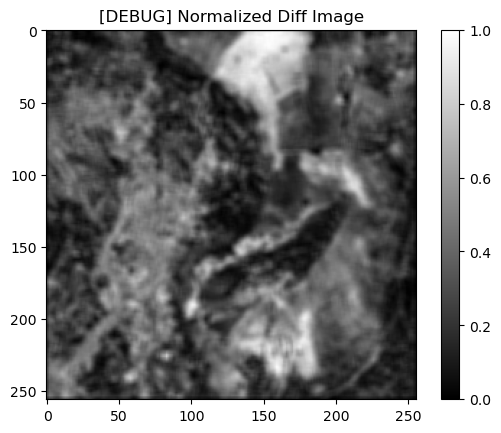

[INFO] Saving train data:  72%|███████████████████████████████████████▋               | 99/137 [00:32<00:12,  3.14it/s]

[DEBUG] Mask class counts: [ 5828 16920 28180 14608]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_98.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_98.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_98.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000057_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000057_post_disaster.tif
[DEBUG] Pre tensor mean: 0.4300, Post tensor mean: 0.2838
[DEBUG] Diff stats -> min: 0.0000, max: 0.9098, mean: 0.2607
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.3106


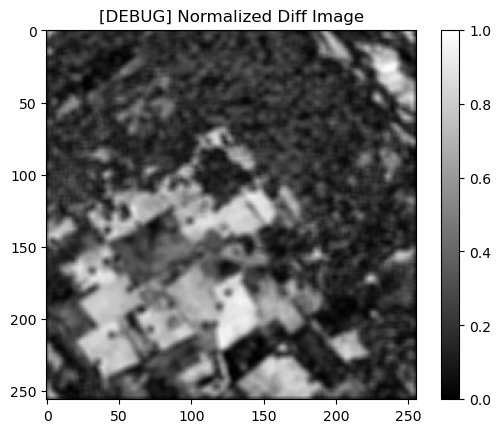

[INFO] Saving train data:  73%|███████████████████████████████████████▍              | 100/137 [00:33<00:11,  3.15it/s]

[DEBUG] Mask class counts: [ 9092 25200 16618 14626]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_99.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_99.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_99.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000099_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000099_post_disaster.tif
[DEBUG] Pre tensor mean: 0.2801, Post tensor mean: 0.1337
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.1818
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2031


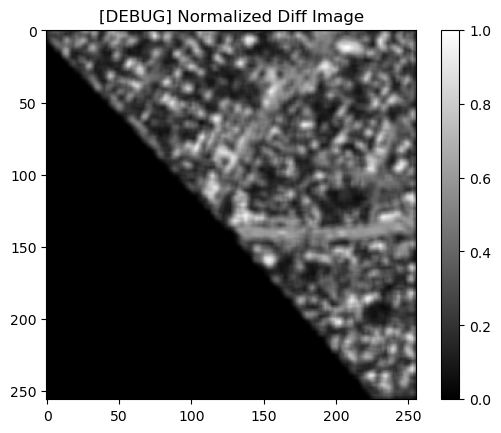

[INFO] Saving train data:  74%|███████████████████████████████████████▊              | 101/137 [00:33<00:11,  3.16it/s]

[DEBUG] Mask class counts: [33819  6161 15684  9872]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_100.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_100.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_100.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000098_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000098_post_disaster.tif
[DEBUG] Pre tensor mean: 0.1684, Post tensor mean: 0.1119
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.0843
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.0837


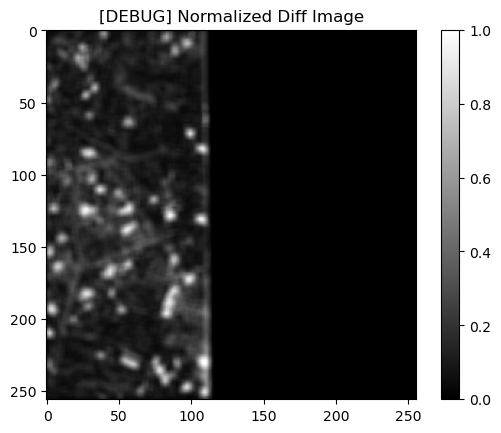

[INFO] Saving train data:  74%|████████████████████████████████████████▏             | 102/137 [00:33<00:11,  3.11it/s]

[DEBUG] Mask class counts: [42761 17066  4090  1619]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_101.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_101.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_101.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000005_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000005_post_disaster.tif
[DEBUG] Pre tensor mean: 0.4804, Post tensor mean: 0.2692
[DEBUG] Diff stats -> min: 0.0000, max: 0.9725, mean: 0.2981
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.3121


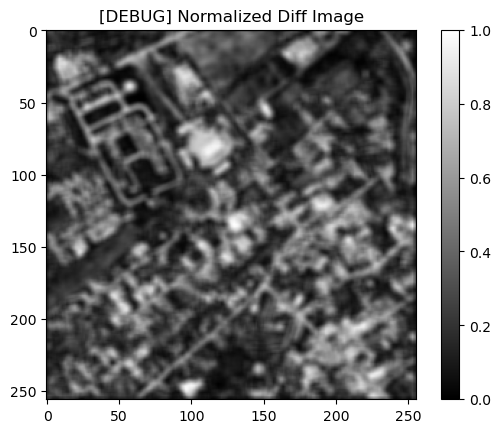

[INFO] Saving train data:  75%|████████████████████████████████████████▌             | 103/137 [00:34<00:10,  3.10it/s]

[DEBUG] Mask class counts: [11274 18661 22305 13296]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_102.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_102.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_102.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000120_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000120_post_disaster.tif
[DEBUG] Pre tensor mean: 0.2289, Post tensor mean: 0.0919
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.1394
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.1554


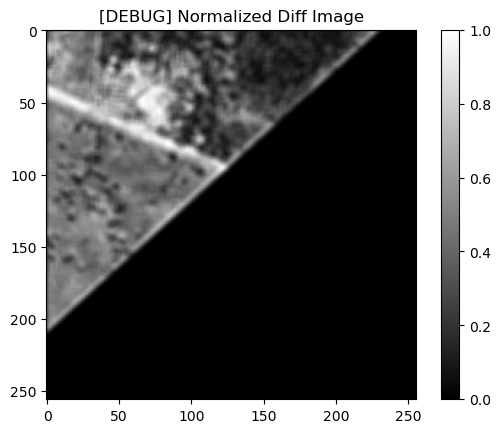

[INFO] Saving train data:  76%|████████████████████████████████████████▉             | 104/137 [00:34<00:10,  3.20it/s]

[DEBUG] Mask class counts: [43107  3838  8534 10057]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_103.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_103.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_103.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000071_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000071_post_disaster.tif
[DEBUG] Pre tensor mean: 0.2679, Post tensor mean: 0.1022
[DEBUG] Diff stats -> min: 0.0000, max: 0.9882, mean: 0.1698
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.1896


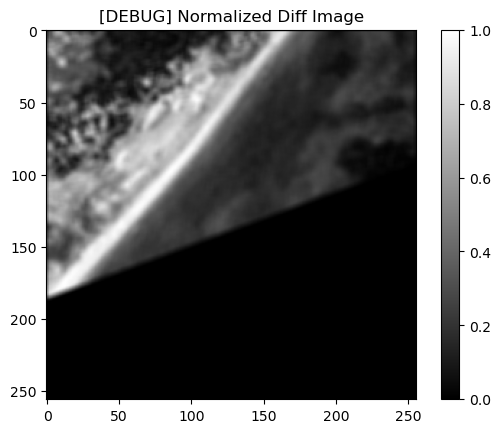

[INFO] Saving train data:  77%|█████████████████████████████████████████▍            | 105/137 [00:34<00:09,  3.28it/s]

[DEBUG] Mask class counts: [32872 13233  9080 10351]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_104.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_104.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_104.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000008_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000008_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3572, Post tensor mean: 0.2739
[DEBUG] Diff stats -> min: 0.0000, max: 0.9804, mean: 0.2078
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2181


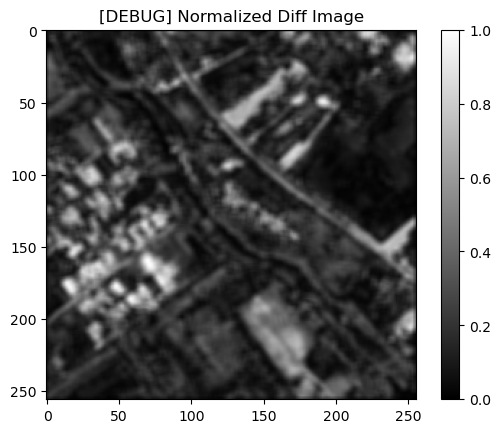

[INFO] Saving train data:  77%|█████████████████████████████████████████▊            | 106/137 [00:35<00:09,  3.34it/s]

[DEBUG] Mask class counts: [14658 30783 13612  6483]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_105.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_105.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_105.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000060_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000060_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3694, Post tensor mean: 0.2102
[DEBUG] Diff stats -> min: 0.0000, max: 0.9961, mean: 0.2295
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2349


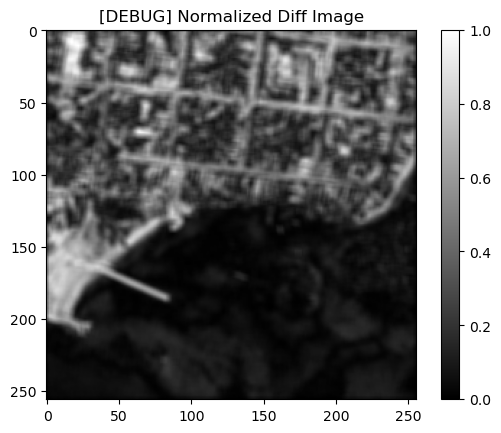

[INFO] Saving train data:  78%|██████████████████████████████████████████▏           | 107/137 [00:35<00:08,  3.35it/s]

[DEBUG] Mask class counts: [25320 14897 14379 10940]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_106.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_106.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_106.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000007_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000007_post_disaster.tif
[DEBUG] Pre tensor mean: 0.4368, Post tensor mean: 0.3026
[DEBUG] Diff stats -> min: 0.0000, max: 0.9765, mean: 0.2311
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2544


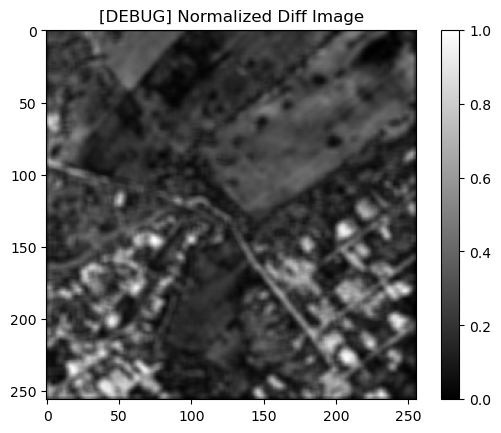

[INFO] Saving train data:  79%|██████████████████████████████████████████▌           | 108/137 [00:35<00:08,  3.33it/s]

[DEBUG] Mask class counts: [ 8986 26096 24929  5525]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_107.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_107.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_107.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000000_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000000_post_disaster.tif
[DEBUG] Pre tensor mean: 0.4129, Post tensor mean: 0.2643
[DEBUG] Diff stats -> min: 0.0000, max: 0.9255, mean: 0.2043
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2328


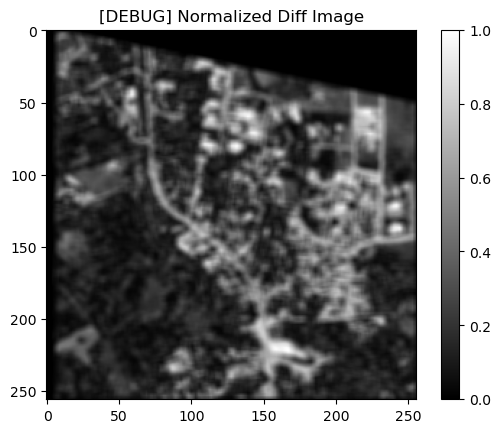

[INFO] Saving train data:  80%|██████████████████████████████████████████▉           | 109/137 [00:35<00:08,  3.41it/s]

[DEBUG] Mask class counts: [16825 24497 14936  9278]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_108.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_108.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_108.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000048_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000048_post_disaster.tif
[DEBUG] Pre tensor mean: 0.1901, Post tensor mean: 0.0665
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.1264
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.1250


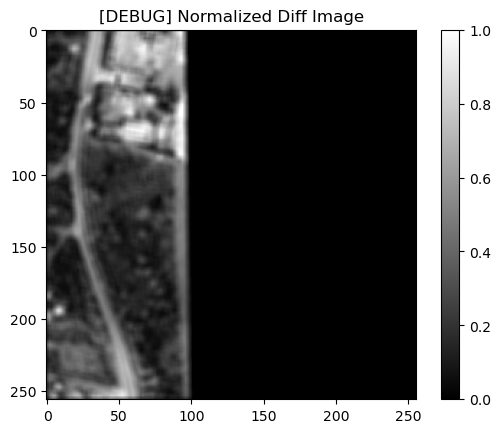

[INFO] Saving train data:  80%|███████████████████████████████████████████▎          | 110/137 [00:36<00:07,  3.51it/s]

[DEBUG] Mask class counts: [42869  8854  7848  5965]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_109.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_109.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_109.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000011_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000011_post_disaster.tif
[DEBUG] Pre tensor mean: 0.2417, Post tensor mean: 0.1442
[DEBUG] Diff stats -> min: 0.0000, max: 0.9686, mean: 0.1232
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.1470


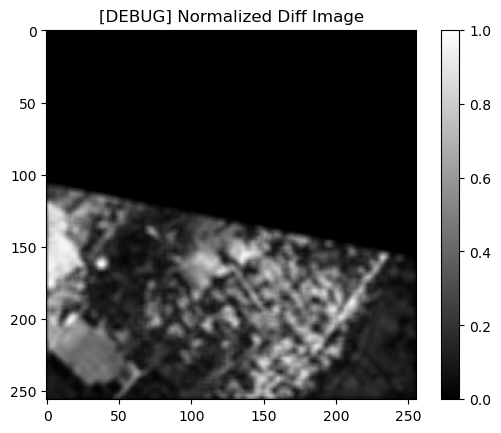

[INFO] Saving train data:  81%|███████████████████████████████████████████▊          | 111/137 [00:36<00:07,  3.56it/s]

[DEBUG] Mask class counts: [39307 11127  8046  7056]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_110.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_110.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_110.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000012_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000012_post_disaster.tif
[DEBUG] Pre tensor mean: 0.1687, Post tensor mean: 0.0801
[DEBUG] Diff stats -> min: 0.0000, max: 0.9255, mean: 0.0991
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.1171


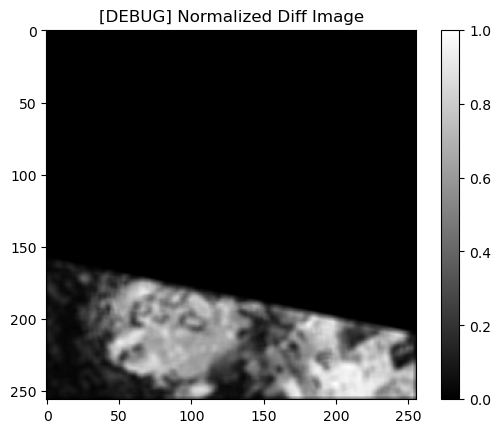

[INFO] Saving train data:  82%|████████████████████████████████████████████▏         | 112/137 [00:36<00:06,  3.69it/s]

[DEBUG] Mask class counts: [50979  2870  3025  8662]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_111.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_111.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_111.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000023_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000023_post_disaster.tif
[DEBUG] Pre tensor mean: 0.5183, Post tensor mean: 0.2737
[DEBUG] Diff stats -> min: 0.0000, max: 0.9843, mean: 0.3065
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.3192


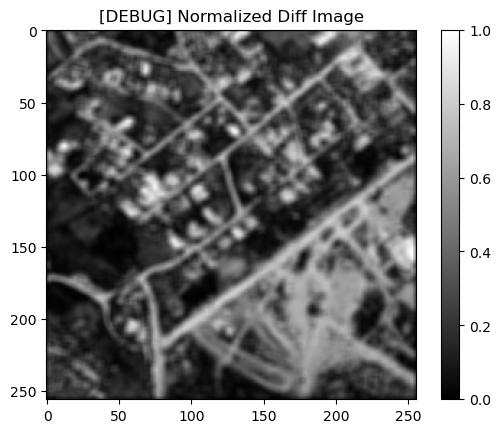

[INFO] Saving train data:  82%|████████████████████████████████████████████▌         | 113/137 [00:37<00:06,  3.68it/s]

[DEBUG] Mask class counts: [14154 16246 17957 17179]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_112.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_112.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_112.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000053_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000053_post_disaster.tif
[DEBUG] Pre tensor mean: 0.4652, Post tensor mean: 0.3248
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.2839
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2808


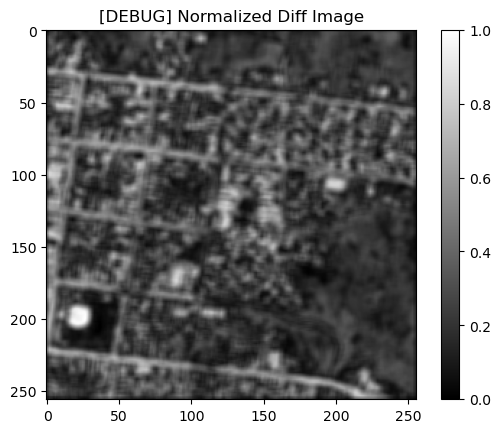

[INFO] Saving train data:  83%|████████████████████████████████████████████▉         | 114/137 [00:37<00:06,  3.65it/s]

[DEBUG] Mask class counts: [ 6533 22517 29018  7468]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_113.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_113.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_113.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000068_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000068_post_disaster.tif
[DEBUG] Pre tensor mean: 0.4388, Post tensor mean: 0.2084
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.2502
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2574


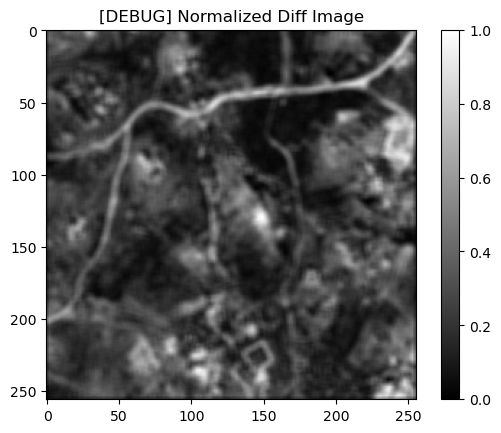

[INFO] Saving train data:  84%|█████████████████████████████████████████████▎        | 115/137 [00:37<00:06,  3.32it/s]

[DEBUG] Mask class counts: [ 9564 23214 26258  6500]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_114.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_114.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_114.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000021_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000021_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3277, Post tensor mean: 0.2442
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.2039
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.1988


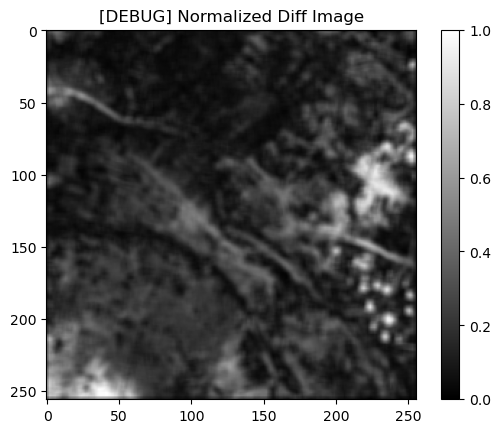

[INFO] Saving train data:  85%|█████████████████████████████████████████████▋        | 116/137 [00:38<00:06,  3.01it/s]

[DEBUG] Mask class counts: [12997 33212 15816  3511]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_115.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_115.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_115.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000081_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000081_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3085, Post tensor mean: 0.0910
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.2177
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2273


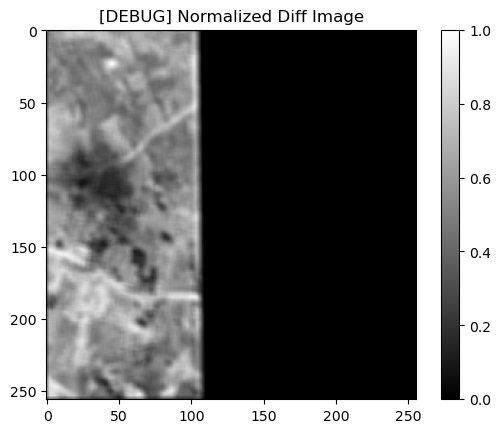

[INFO] Saving train data:  85%|██████████████████████████████████████████████        | 117/137 [00:38<00:06,  3.01it/s]

[DEBUG] Mask class counts: [39326   574  4644 20992]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_116.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_116.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_116.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000077_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000077_post_disaster.tif
[DEBUG] Pre tensor mean: 0.2915, Post tensor mean: 0.2437
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.2054
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2062


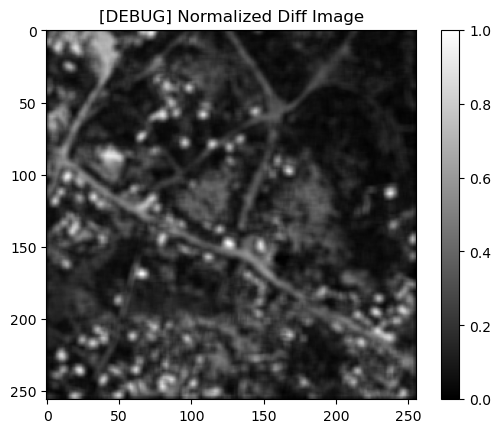

[INFO] Saving train data:  86%|██████████████████████████████████████████████▌       | 118/137 [00:38<00:06,  3.02it/s]

[DEBUG] Mask class counts: [18502 26535 16400  4099]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_117.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_117.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_117.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000009_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000009_post_disaster.tif
[DEBUG] Pre tensor mean: 0.5034, Post tensor mean: 0.1783
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.3254
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.3247


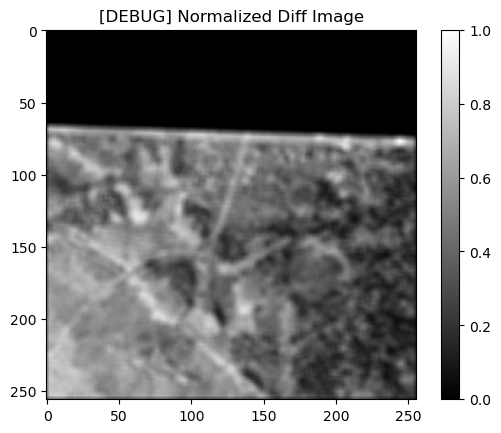

[INFO] Saving train data:  87%|██████████████████████████████████████████████▉       | 119/137 [00:39<00:05,  3.05it/s]

[DEBUG] Mask class counts: [19743  4449 17455 23889]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_118.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_118.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_118.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000082_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000082_post_disaster.tif
[DEBUG] Pre tensor mean: 0.2121, Post tensor mean: 0.0977
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.1263
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.1352


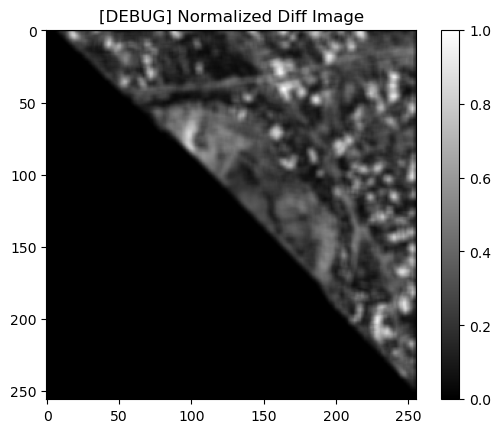

[INFO] Saving train data:  88%|███████████████████████████████████████████████▎      | 120/137 [00:39<00:05,  3.05it/s]

[DEBUG] Mask class counts: [38830  8652 14495  3559]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_119.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_119.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_119.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000038_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000038_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3665, Post tensor mean: 0.2848
[DEBUG] Diff stats -> min: 0.0000, max: 0.9608, mean: 0.1669
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.1993


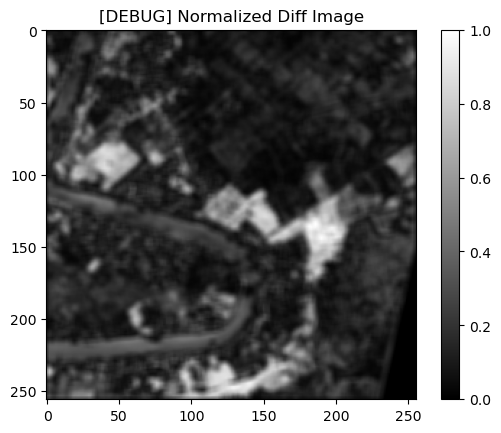

[INFO] Saving train data:  88%|███████████████████████████████████████████████▋      | 121/137 [00:39<00:05,  3.12it/s]

[DEBUG] Mask class counts: [14647 34300 11380  5209]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_120.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_120.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_120.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000119_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000119_post_disaster.tif
[DEBUG] Pre tensor mean: 0.4139, Post tensor mean: 0.2454
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.1968
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2005


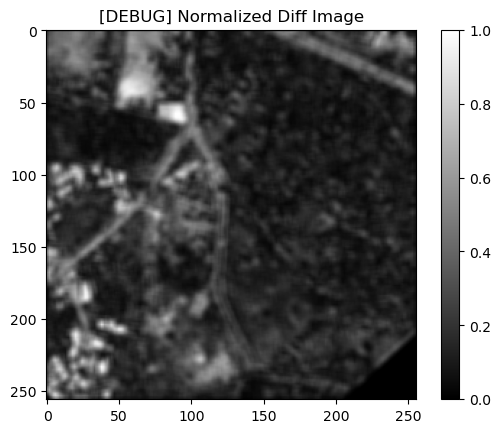

[INFO] Saving train data:  89%|████████████████████████████████████████████████      | 122/137 [00:40<00:04,  3.08it/s]

[DEBUG] Mask class counts: [10533 36997 13348  4658]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_121.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_121.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_121.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000089_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000089_post_disaster.tif
[DEBUG] Pre tensor mean: 0.2292, Post tensor mean: 0.2284
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.1671
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.1676


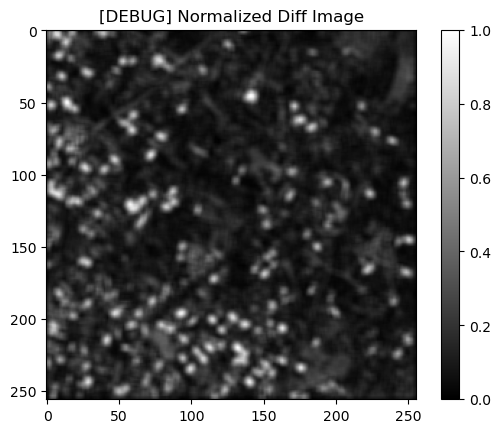

[INFO] Saving train data:  90%|████████████████████████████████████████████████▍     | 123/137 [00:40<00:04,  3.01it/s]

[DEBUG] Mask class counts: [21369 34902  6663  2602]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_122.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_122.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_122.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000034_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000034_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3854, Post tensor mean: 0.1514
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.2983
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.3007


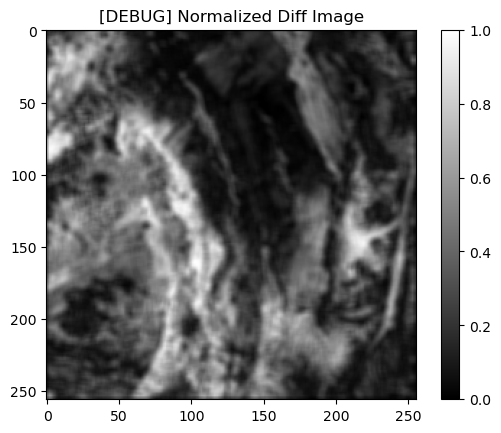

[INFO] Saving train data:  91%|████████████████████████████████████████████████▉     | 124/137 [00:40<00:04,  2.98it/s]

[DEBUG] Mask class counts: [11896 18749 19451 15440]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_123.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_123.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_123.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000085_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000085_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3491, Post tensor mean: 0.2522
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.2070
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2139


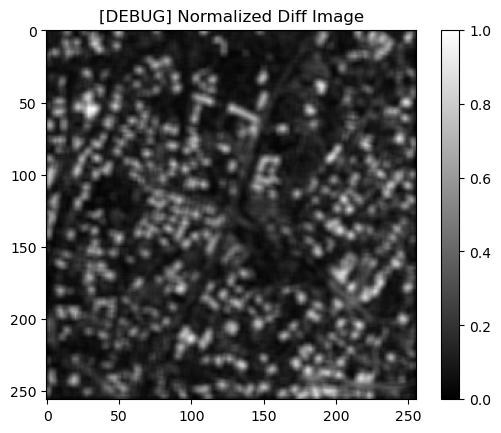

[INFO] Saving train data:  91%|█████████████████████████████████████████████████▎    | 125/137 [00:41<00:04,  2.93it/s]

[DEBUG] Mask class counts: [22414 27244 11130  4748]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_124.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_124.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_124.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000033_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000033_post_disaster.tif
[DEBUG] Pre tensor mean: 0.4427, Post tensor mean: 0.2747
[DEBUG] Diff stats -> min: 0.0000, max: 0.9961, mean: 0.3003
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.3067


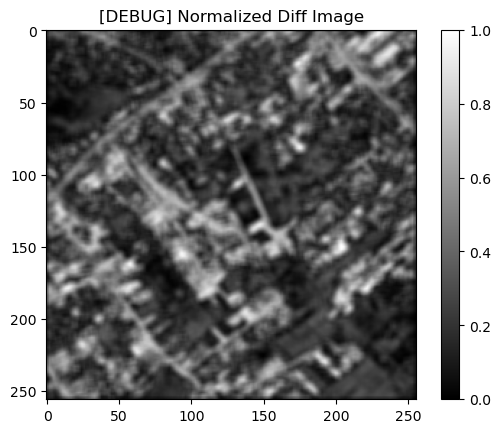

[INFO] Saving train data:  92%|█████████████████████████████████████████████████▋    | 126/137 [00:41<00:03,  2.99it/s]

[DEBUG] Mask class counts: [ 8623 20159 24164 12590]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_125.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_125.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_125.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000045_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000045_post_disaster.tif
[DEBUG] Pre tensor mean: 0.5099, Post tensor mean: 0.2002
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.3443
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.3330


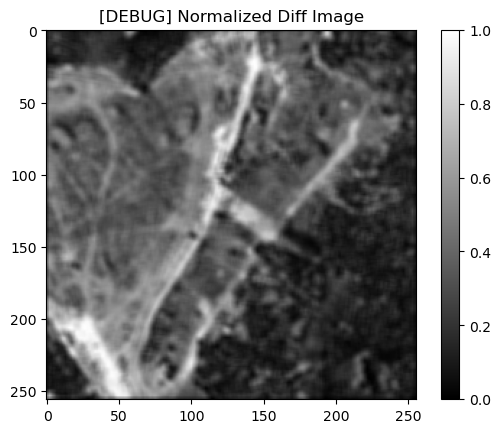

[INFO] Saving train data:  93%|██████████████████████████████████████████████████    | 127/137 [00:41<00:03,  3.00it/s]

[DEBUG] Mask class counts: [ 4652 18433 26487 15964]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_126.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_126.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_126.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000094_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000094_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3539, Post tensor mean: 0.2243
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.2446
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2406


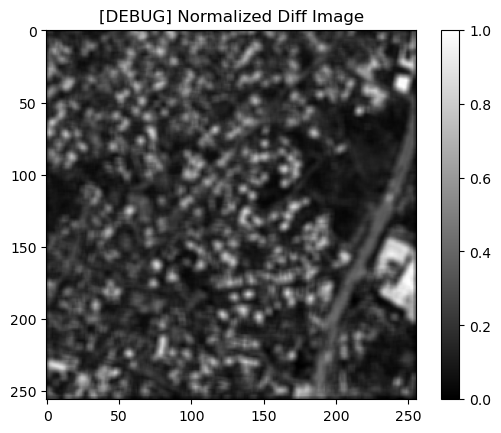

[INFO] Saving train data:  93%|██████████████████████████████████████████████████▍   | 128/137 [00:42<00:03,  2.80it/s]

[DEBUG] Mask class counts: [13306 28379 18681  5170]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_127.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_127.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_127.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000041_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000041_post_disaster.tif
[DEBUG] Pre tensor mean: 0.4732, Post tensor mean: 0.2043
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.2873
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2834


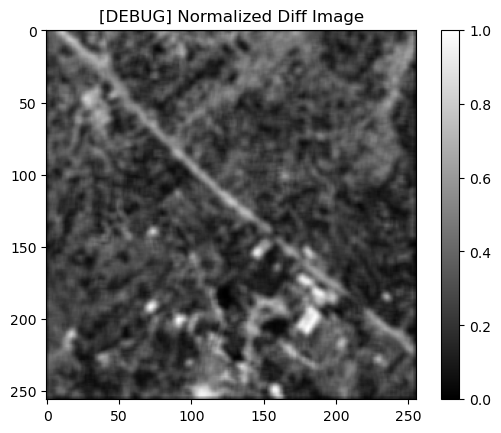

[INFO] Saving train data:  94%|██████████████████████████████████████████████████▊   | 129/137 [00:42<00:02,  2.87it/s]

[DEBUG] Mask class counts: [ 5192 19957 33795  6592]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_128.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_128.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_128.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000093_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000093_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3746, Post tensor mean: 0.2603
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.2289
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2434


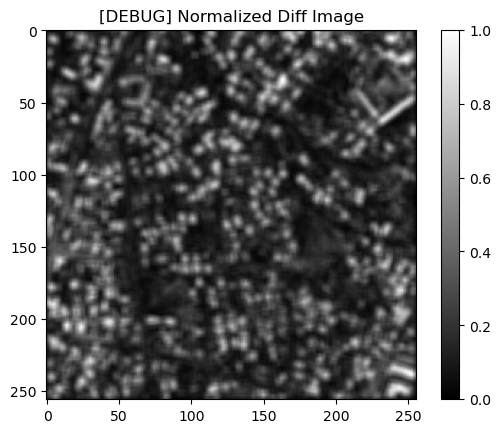

[INFO] Saving train data:  95%|███████████████████████████████████████████████████▏  | 130/137 [00:42<00:02,  2.91it/s]

[DEBUG] Mask class counts: [15939 27286 16503  5808]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_129.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_129.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_129.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000116_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000116_post_disaster.tif
[DEBUG] Pre tensor mean: 0.2317, Post tensor mean: 0.0897
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.1430
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.1532


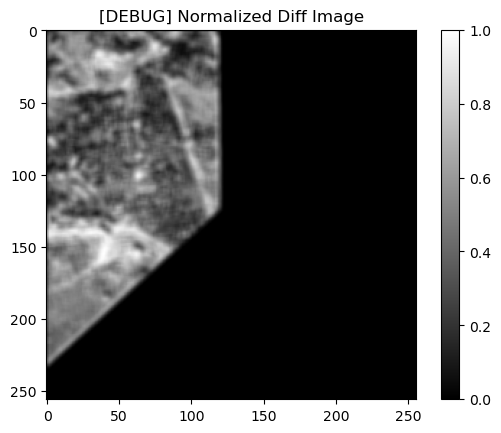

[INFO] Saving train data:  96%|███████████████████████████████████████████████████▋  | 131/137 [00:43<00:02,  2.98it/s]

[DEBUG] Mask class counts: [45315   971  8545 10705]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_130.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_130.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_130.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000037_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000037_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3973, Post tensor mean: 0.3018
[DEBUG] Diff stats -> min: 0.0000, max: 0.9725, mean: 0.2138
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2702


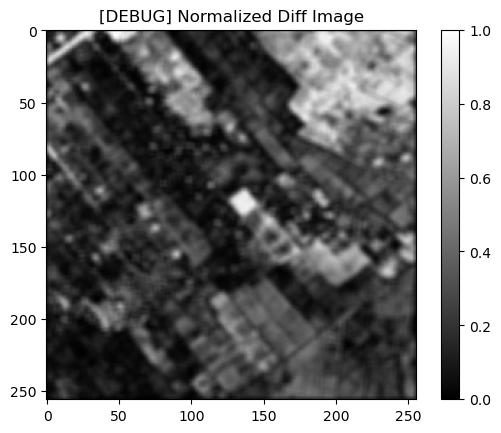

[INFO] Saving train data:  96%|████████████████████████████████████████████████████  | 132/137 [00:44<00:02,  1.85it/s]

[DEBUG] Mask class counts: [13116 21953 20078 10389]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_131.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_131.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_131.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000052_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000052_post_disaster.tif
[DEBUG] Pre tensor mean: 0.5469, Post tensor mean: 0.3188
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.3156
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.3146


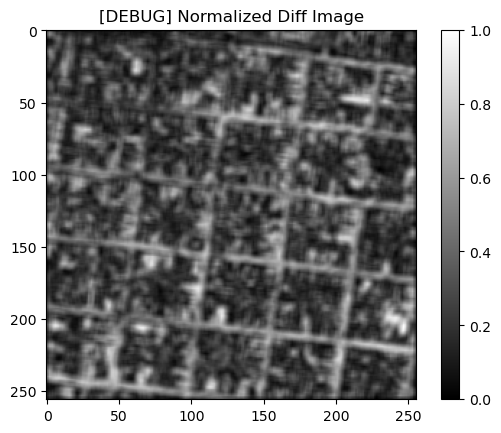

[INFO] Saving train data:  97%|████████████████████████████████████████████████████▍ | 133/137 [00:44<00:01,  2.15it/s]

[DEBUG] Mask class counts: [ 9625 17440 26671 11800]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_132.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_132.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_132.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000025_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000025_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3653, Post tensor mean: 0.2303
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.1958
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.1849


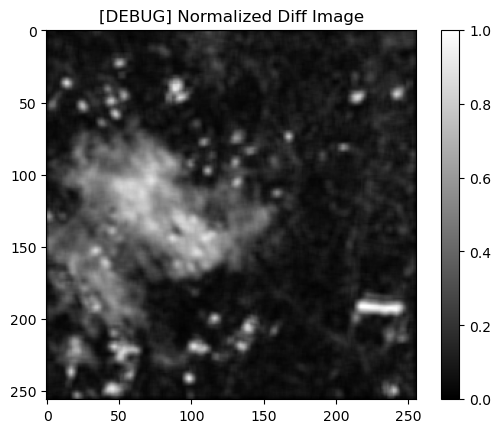

[INFO] Saving train data:  98%|████████████████████████████████████████████████████▊ | 134/137 [00:44<00:01,  2.34it/s]

[DEBUG] Mask class counts: [24269 25703  9136  6428]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_133.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_133.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_133.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000054_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000054_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3202, Post tensor mean: 0.2361
[DEBUG] Diff stats -> min: 0.0000, max: 0.9843, mean: 0.1977
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2219


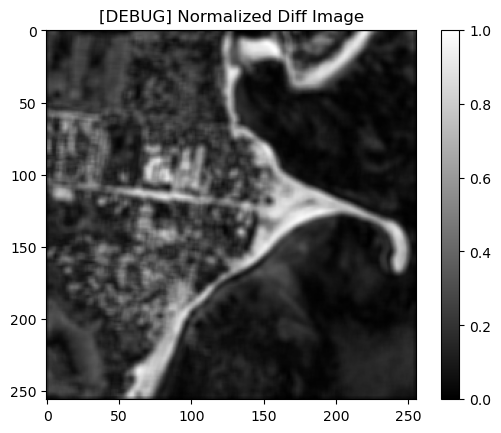

[INFO] Saving train data:  99%|█████████████████████████████████████████████████████▏| 135/137 [00:45<00:00,  2.57it/s]

[DEBUG] Mask class counts: [20188 23819 13580  7949]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_134.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_134.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_134.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000021_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000021_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3454, Post tensor mean: 0.2999
[DEBUG] Diff stats -> min: 0.0000, max: 0.9373, mean: 0.2723
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.3238


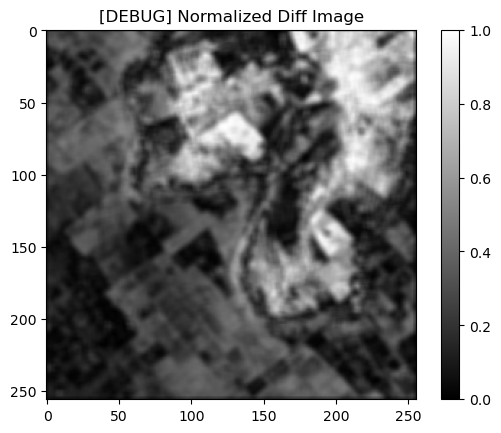

[INFO] Saving train data:  99%|█████████████████████████████████████████████████████▌| 136/137 [00:45<00:00,  2.74it/s]

[DEBUG] Mask class counts: [ 8601 18122 24406 14407]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_135.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_135.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_135.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000074_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000074_post_disaster.tif
[DEBUG] Pre tensor mean: 0.2418, Post tensor mean: 0.2540
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.1887
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.1853


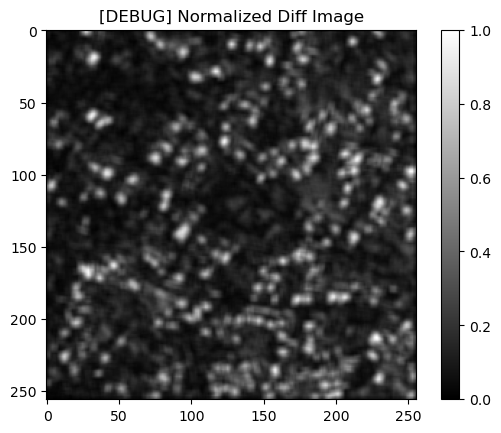

[INFO] Saving train data: 100%|██████████████████████████████████████████████████████| 137/137 [00:45<00:00,  3.00it/s]


[DEBUG] Mask class counts: [21593 31599  8913  3431]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\pre\train_pair_136.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\post\train_pair_136.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train\mask\train_pair_136.png


[INFO] Saving test data:   0%|                                                                  | 0/59 [00:00<?, ?it/s]

[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000058_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000058_post_disaster.tif
[DEBUG] Pre tensor mean: 0.4590, Post tensor mean: 0.2257
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.2598
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2535


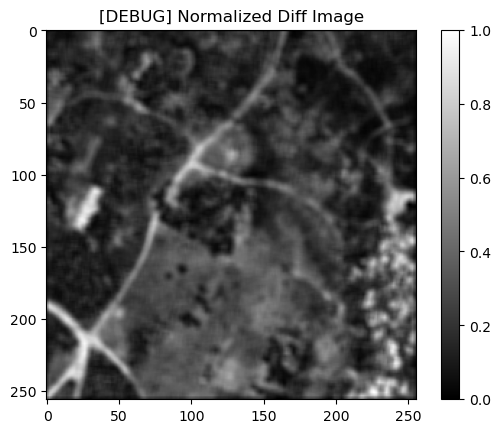

[INFO] Saving test data:   2%|▉                                                         | 1/59 [00:00<00:19,  2.99it/s]

[DEBUG] Mask class counts: [ 7181 26607 26337  5411]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\pre\test_pair_0.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\post\test_pair_0.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\mask\test_pair_0.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000026_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000026_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3637, Post tensor mean: 0.2822
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.2525
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2567


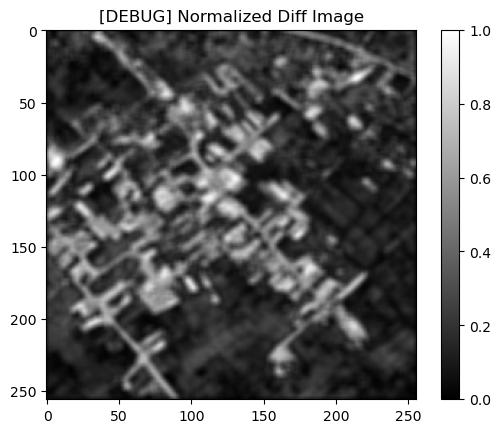

[INFO] Saving test data:   3%|█▉                                                        | 2/59 [00:00<00:17,  3.22it/s]

[DEBUG] Mask class counts: [13242 28486 13948  9860]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\pre\test_pair_1.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\post\test_pair_1.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\mask\test_pair_1.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000017_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000017_post_disaster.tif
[DEBUG] Pre tensor mean: 0.5257, Post tensor mean: 0.2371
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.3100
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.3750


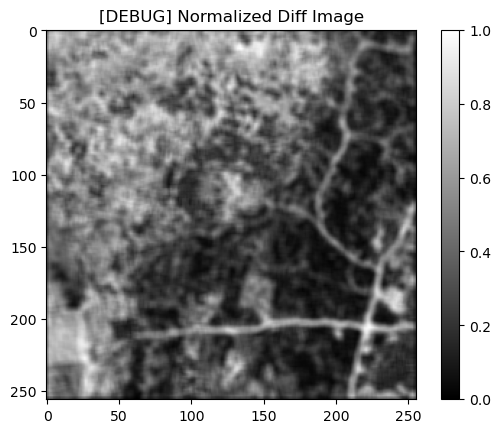

[INFO] Saving test data:   5%|██▉                                                       | 3/59 [00:01<00:19,  2.93it/s]

[DEBUG] Mask class counts: [ 7488 14469 19942 23637]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\pre\test_pair_2.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\post\test_pair_2.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\mask\test_pair_2.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000049_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000049_post_disaster.tif
[DEBUG] Pre tensor mean: 0.1959, Post tensor mean: 0.0922
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.1142
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.1166


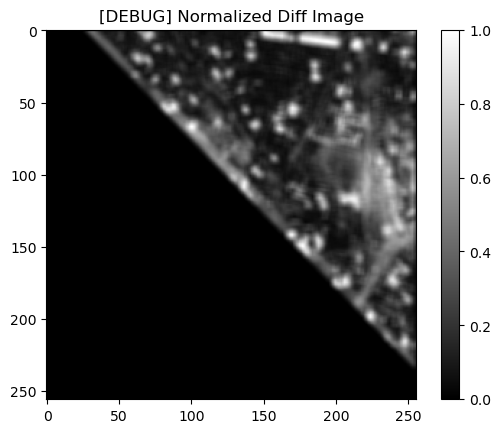

[INFO] Saving test data:   7%|███▉                                                      | 4/59 [00:01<00:18,  3.04it/s]

[DEBUG] Mask class counts: [43519 10247  7019  4751]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\pre\test_pair_3.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\post\test_pair_3.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\mask\test_pair_3.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000092_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000092_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3780, Post tensor mean: 0.2539
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.2470
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2593


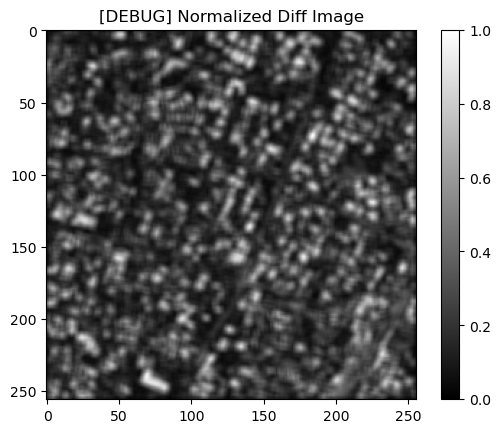

[INFO] Saving test data:   8%|████▉                                                     | 5/59 [00:01<00:17,  3.03it/s]

[DEBUG] Mask class counts: [13722 25125 20336  6353]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\pre\test_pair_4.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\post\test_pair_4.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\mask\test_pair_4.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000075_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000075_post_disaster.tif
[DEBUG] Pre tensor mean: 0.2445, Post tensor mean: 0.2422
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.1472
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.1470


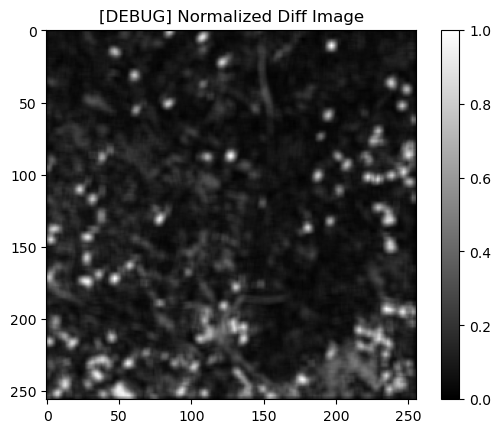

[INFO] Saving test data:  10%|█████▉                                                    | 6/59 [00:02<00:18,  2.89it/s]

[DEBUG] Mask class counts: [28895 29216  4817  2608]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\pre\test_pair_5.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\post\test_pair_5.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\mask\test_pair_5.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000018_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000018_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3840, Post tensor mean: 0.2823
[DEBUG] Diff stats -> min: 0.0000, max: 0.9922, mean: 0.1948
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2051


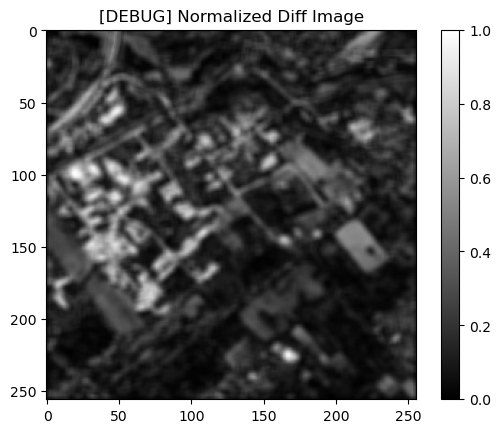

[INFO] Saving test data:  12%|██████▉                                                   | 7/59 [00:02<00:18,  2.88it/s]

[DEBUG] Mask class counts: [18157 28268 13823  5288]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\pre\test_pair_6.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\post\test_pair_6.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\mask\test_pair_6.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000020_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000020_post_disaster.tif
[DEBUG] Pre tensor mean: 0.4300, Post tensor mean: 0.2081
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.2894
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.3047


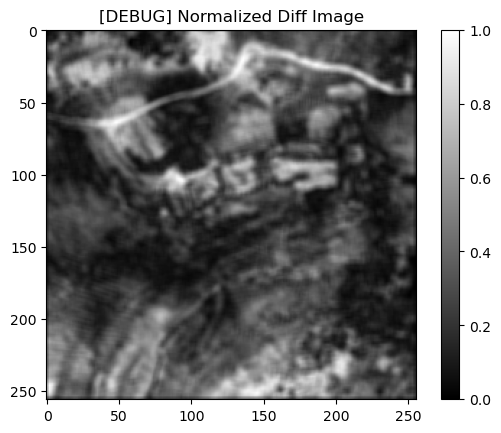

[INFO] Saving test data:  14%|███████▊                                                  | 8/59 [00:02<00:18,  2.75it/s]

[DEBUG] Mask class counts: [ 6457 20038 26478 12563]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\pre\test_pair_7.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\post\test_pair_7.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\mask\test_pair_7.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000096_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000096_post_disaster.tif
[DEBUG] Pre tensor mean: 0.2812, Post tensor mean: 0.2563
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.2055
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.1907


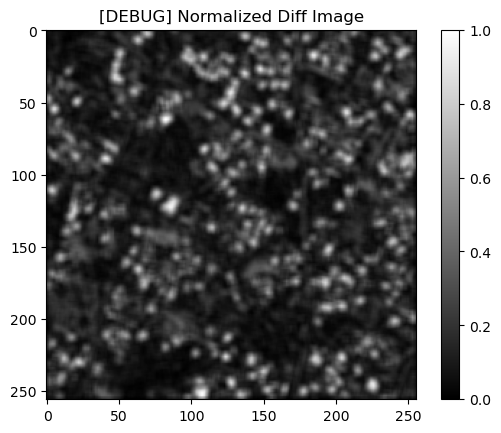

[INFO] Saving test data:  15%|████████▊                                                 | 9/59 [00:03<00:18,  2.72it/s]

[DEBUG] Mask class counts: [21653 29836 10740  3307]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\pre\test_pair_8.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\post\test_pair_8.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\mask\test_pair_8.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000031_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000031_post_disaster.tif
[DEBUG] Pre tensor mean: 0.5322, Post tensor mean: 0.2242
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.3249
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.3432


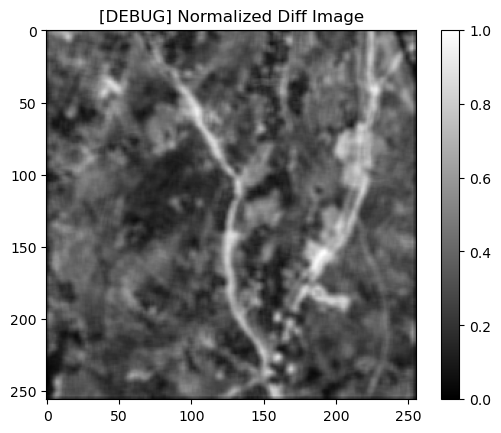

[INFO] Saving test data:  17%|█████████▋                                               | 10/59 [00:03<00:19,  2.57it/s]

[DEBUG] Mask class counts: [ 3383  9838 41398 10917]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\pre\test_pair_9.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\post\test_pair_9.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\mask\test_pair_9.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000014_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000014_post_disaster.tif
[DEBUG] Pre tensor mean: 0.4331, Post tensor mean: 0.2770
[DEBUG] Diff stats -> min: 0.0000, max: 0.9804, mean: 0.2793
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.3022


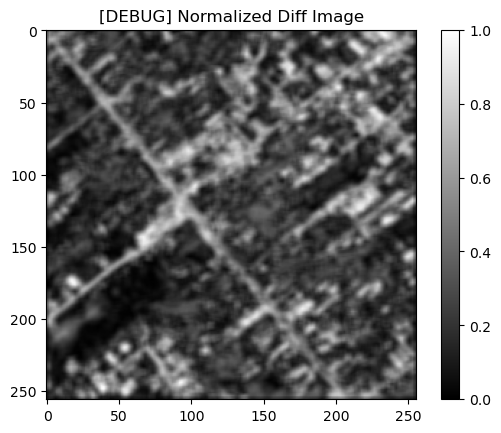

[INFO] Saving test data:  19%|██████████▋                                              | 11/59 [00:03<00:18,  2.62it/s]

[DEBUG] Mask class counts: [11687 19393 21702 12754]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\pre\test_pair_10.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\post\test_pair_10.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\mask\test_pair_10.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000117_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000117_post_disaster.tif
[DEBUG] Pre tensor mean: 0.0460, Post tensor mean: 0.0198
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.0331
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.0346


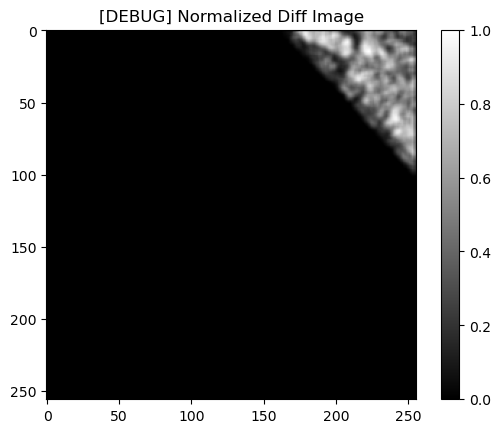

[INFO] Saving test data:  20%|███████████▌                                             | 12/59 [00:04<00:17,  2.70it/s]

[DEBUG] Mask class counts: [61531   325  1058  2622]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\pre\test_pair_11.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\post\test_pair_11.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\mask\test_pair_11.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000011_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000011_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3360, Post tensor mean: 0.1231
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.2133
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2238


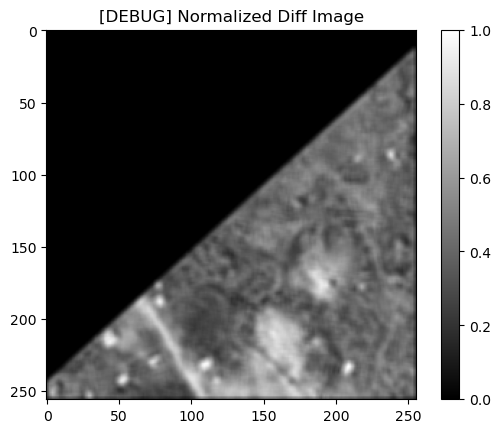

[INFO] Saving test data:  22%|████████████▌                                            | 13/59 [00:04<00:17,  2.58it/s]

[DEBUG] Mask class counts: [34313     0 19037 12186]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\pre\test_pair_12.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\post\test_pair_12.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\mask\test_pair_12.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000067_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000067_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3113, Post tensor mean: 0.2152
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.1558
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.1421


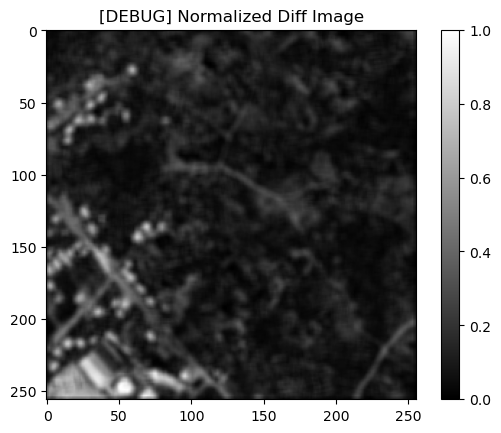

[INFO] Saving test data:  24%|█████████████▌                                           | 14/59 [00:05<00:16,  2.68it/s]

[DEBUG] Mask class counts: [24781 33000  5511  2244]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\pre\test_pair_13.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\post\test_pair_13.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\mask\test_pair_13.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000088_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000088_post_disaster.tif
[DEBUG] Pre tensor mean: 0.2831, Post tensor mean: 0.2335
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.1928
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.1908


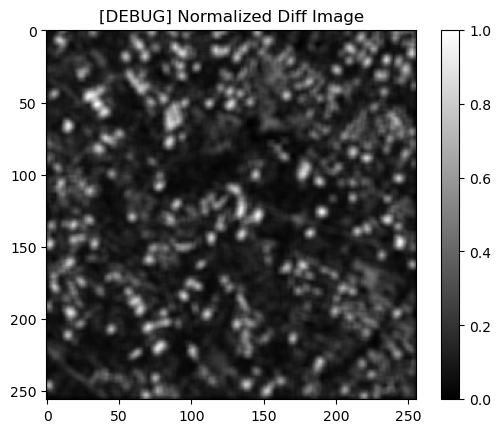

[INFO] Saving test data:  25%|██████████████▍                                          | 15/59 [00:05<00:16,  2.68it/s]

[DEBUG] Mask class counts: [21896 30372  9739  3529]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\pre\test_pair_14.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\post\test_pair_14.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\mask\test_pair_14.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000091_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000091_post_disaster.tif
[DEBUG] Pre tensor mean: 0.2270, Post tensor mean: 0.1341
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.1365
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.1540


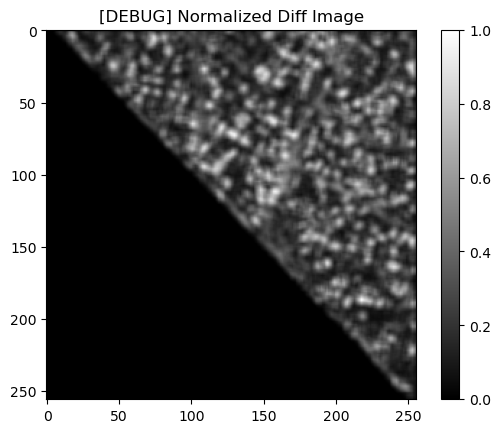

[INFO] Saving test data:  27%|███████████████▍                                         | 16/59 [00:05<00:15,  2.80it/s]

[DEBUG] Mask class counts: [38513  8986 12984  5053]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\pre\test_pair_15.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\post\test_pair_15.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\mask\test_pair_15.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000024_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000024_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3048, Post tensor mean: 0.2514
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.1869
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.1812


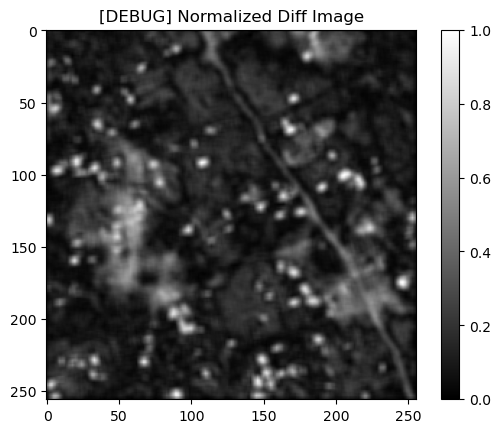

[INFO] Saving test data:  29%|████████████████▍                                        | 17/59 [00:06<00:14,  2.85it/s]

[DEBUG] Mask class counts: [18677 32846 10635  3378]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\pre\test_pair_16.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\post\test_pair_16.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\mask\test_pair_16.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000097_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000097_post_disaster.tif
[DEBUG] Pre tensor mean: 0.2512, Post tensor mean: 0.2501
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.1978
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2009


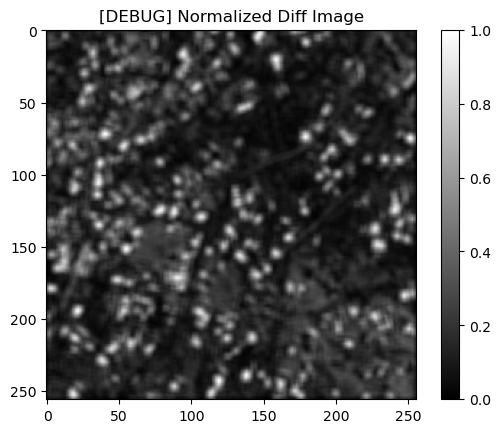

[INFO] Saving test data:  31%|█████████████████▍                                       | 18/59 [00:06<00:14,  2.84it/s]

[DEBUG] Mask class counts: [18691 30685 12491  3669]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\pre\test_pair_17.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\post\test_pair_17.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\mask\test_pair_17.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000056_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000056_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3733, Post tensor mean: 0.2885
[DEBUG] Diff stats -> min: 0.0000, max: 0.9922, mean: 0.1879
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.1998


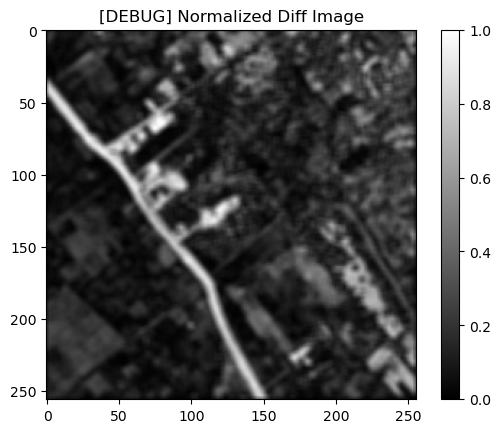

[INFO] Saving test data:  32%|██████████████████▎                                      | 19/59 [00:06<00:13,  2.96it/s]

[DEBUG] Mask class counts: [18584 30302 11387  5263]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\pre\test_pair_18.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\post\test_pair_18.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\mask\test_pair_18.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000064_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000064_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3476, Post tensor mean: 0.2924
[DEBUG] Diff stats -> min: 0.0000, max: 0.9765, mean: 0.1865
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.1969


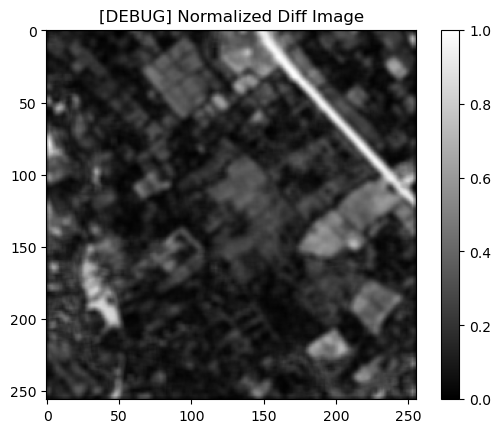

[INFO] Saving test data:  34%|███████████████████▎                                     | 20/59 [00:07<00:12,  3.03it/s]

[DEBUG] Mask class counts: [16578 29729 15106  4123]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\pre\test_pair_19.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\post\test_pair_19.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\mask\test_pair_19.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000086_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000086_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3224, Post tensor mean: 0.2280
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.2124
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2229


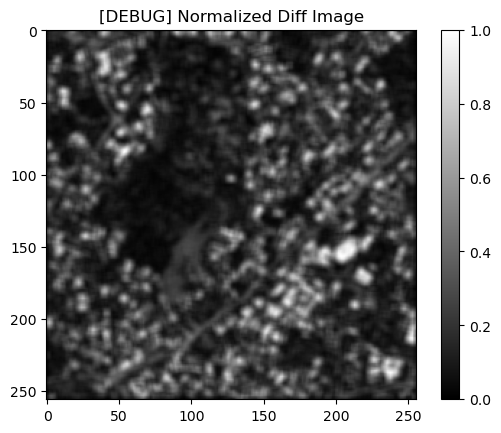

[INFO] Saving test data:  36%|████████████████████▎                                    | 21/59 [00:07<00:12,  2.96it/s]

[DEBUG] Mask class counts: [18054 26296 16271  4915]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\pre\test_pair_20.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\post\test_pair_20.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\mask\test_pair_20.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000055_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000055_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3165, Post tensor mean: 0.2798
[DEBUG] Diff stats -> min: 0.0000, max: 0.9843, mean: 0.1563
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.1609


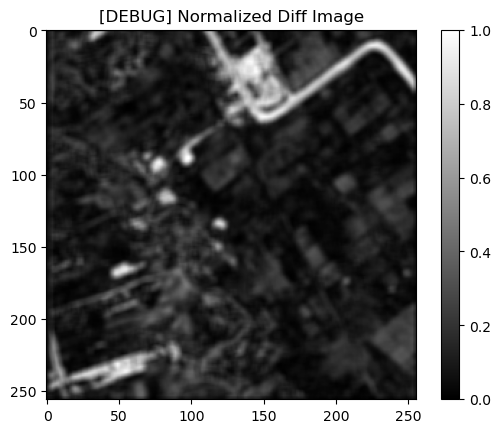

[INFO] Saving test data:  37%|█████████████████████▎                                   | 22/59 [00:07<00:12,  3.08it/s]

[DEBUG] Mask class counts: [23492 31136  7334  3574]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\pre\test_pair_21.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\post\test_pair_21.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\mask\test_pair_21.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000039_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000039_post_disaster.tif
[DEBUG] Pre tensor mean: 0.2117, Post tensor mean: 0.2411
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.1353
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.1248


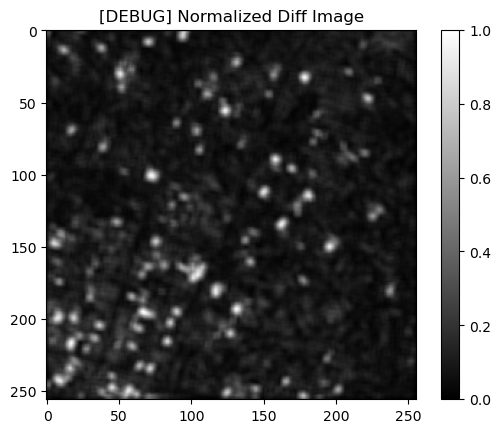

[INFO] Saving test data:  39%|██████████████████████▏                                  | 23/59 [00:08<00:11,  3.08it/s]

[DEBUG] Mask class counts: [30935 30472  2631  1498]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\pre\test_pair_22.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\post\test_pair_22.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\mask\test_pair_22.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000042_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000042_post_disaster.tif
[DEBUG] Pre tensor mean: 0.4652, Post tensor mean: 0.2841
[DEBUG] Diff stats -> min: 0.0000, max: 0.9961, mean: 0.2959
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.3127


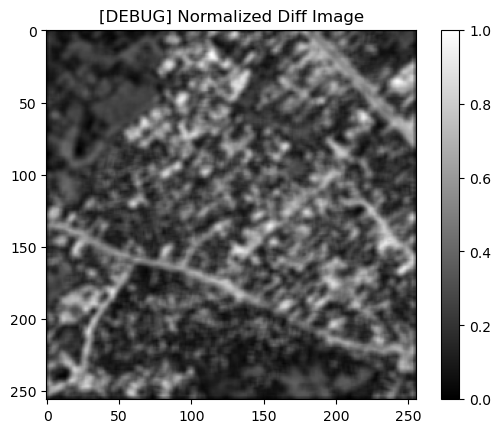

[INFO] Saving test data:  41%|███████████████████████▏                                 | 24/59 [00:08<00:11,  3.09it/s]

[DEBUG] Mask class counts: [ 8056 17979 27279 12222]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\pre\test_pair_23.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\post\test_pair_23.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\mask\test_pair_23.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000087_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000087_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3111, Post tensor mean: 0.2217
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.2144
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2060


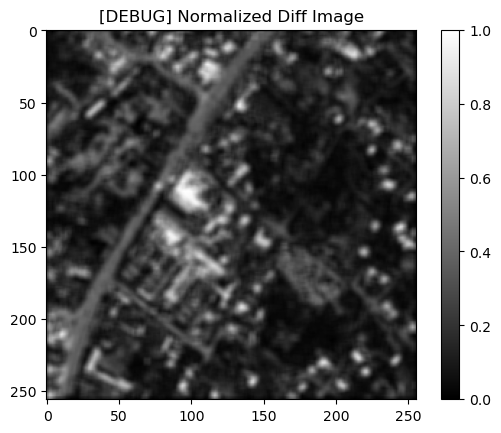

[INFO] Saving test data:  42%|████████████████████████▏                                | 25/59 [00:08<00:11,  2.89it/s]

[DEBUG] Mask class counts: [17881 27534 16049  4072]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\pre\test_pair_24.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\post\test_pair_24.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\mask\test_pair_24.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000059_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000059_post_disaster.tif
[DEBUG] Pre tensor mean: 0.4932, Post tensor mean: 0.2640
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.3088
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.3203


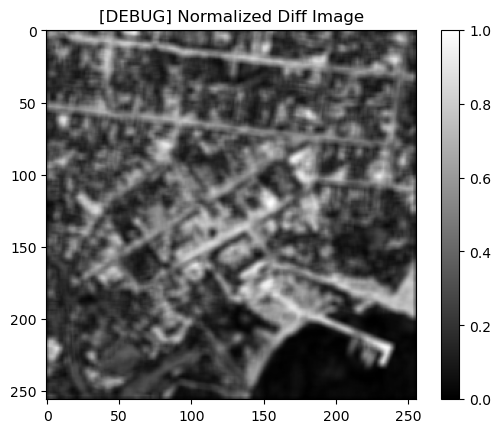

[INFO] Saving test data:  44%|█████████████████████████                                | 26/59 [00:09<00:12,  2.70it/s]

[DEBUG] Mask class counts: [12081 14641 23461 15353]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\pre\test_pair_25.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\post\test_pair_25.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\mask\test_pair_25.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000040_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000040_post_disaster.tif
[DEBUG] Pre tensor mean: 0.4091, Post tensor mean: 0.2197
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.2346
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2411


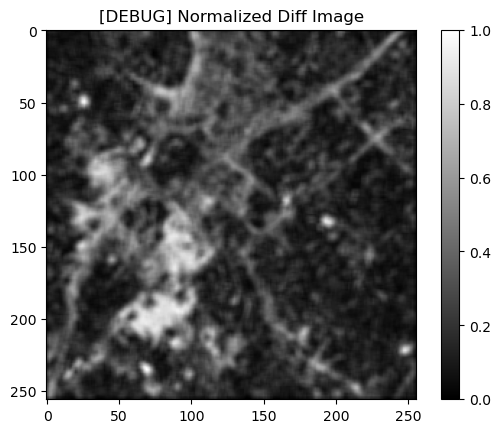

[INFO] Saving test data:  46%|██████████████████████████                               | 27/59 [00:09<00:11,  2.79it/s]

[DEBUG] Mask class counts: [ 8160 31493 19107  6776]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\pre\test_pair_26.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\post\test_pair_26.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\mask\test_pair_26.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000001_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000001_post_disaster.tif
[DEBUG] Pre tensor mean: 0.6316, Post tensor mean: 0.2548
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.3770
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.4353


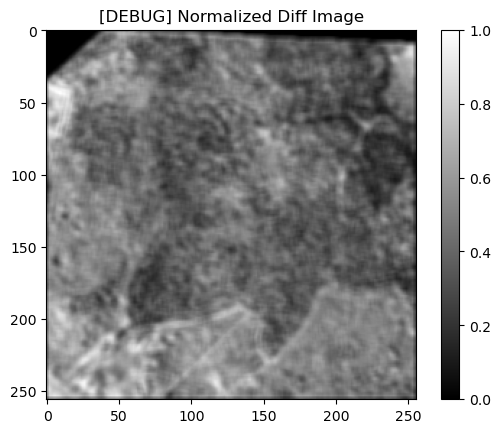

[INFO] Saving test data:  47%|███████████████████████████                              | 28/59 [00:09<00:10,  2.87it/s]

[DEBUG] Mask class counts: [ 4010  1470 31052 29004]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\pre\test_pair_27.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\post\test_pair_27.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\mask\test_pair_27.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000071_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000071_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3085, Post tensor mean: 0.0828
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.2260
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2371


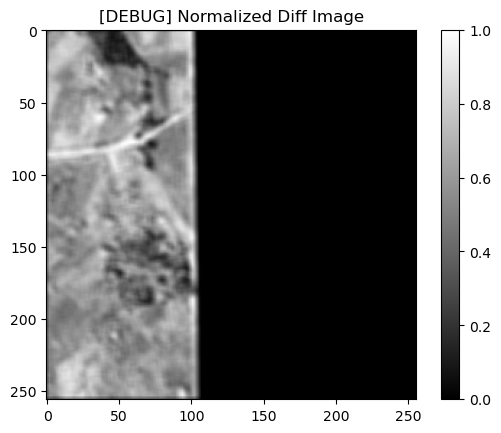

[INFO] Saving test data:  49%|████████████████████████████                             | 29/59 [00:10<00:10,  2.89it/s]

[DEBUG] Mask class counts: [40124   459  2325 22628]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\pre\test_pair_28.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\post\test_pair_28.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\mask\test_pair_28.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000027_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000027_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3435, Post tensor mean: 0.2900
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.1749
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.1738


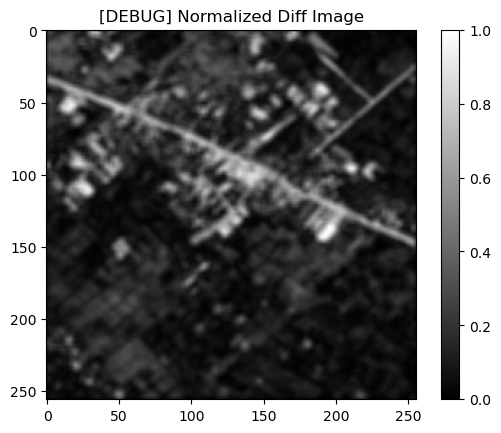

[INFO] Saving test data:  51%|████████████████████████████▉                            | 30/59 [00:10<00:09,  3.01it/s]

[DEBUG] Mask class counts: [25153 26655  9548  4180]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\pre\test_pair_29.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\post\test_pair_29.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\mask\test_pair_29.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000114_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000114_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3543, Post tensor mean: 0.2394
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.2326
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2404


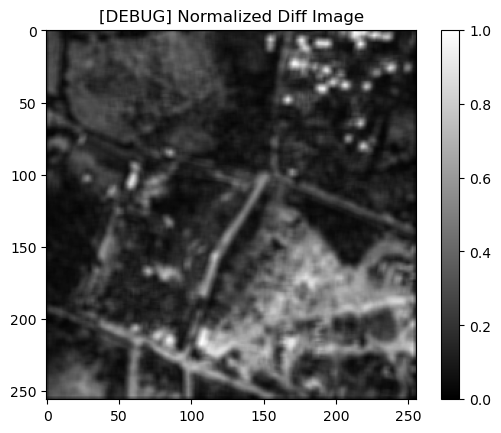

[INFO] Saving test data:  53%|█████████████████████████████▉                           | 31/59 [00:10<00:09,  2.99it/s]

[DEBUG] Mask class counts: [13530 26938 16493  8575]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\pre\test_pair_30.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\post\test_pair_30.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\mask\test_pair_30.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000056_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000056_post_disaster.tif
[DEBUG] Pre tensor mean: 0.5565, Post tensor mean: 0.2288
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.3463
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.3757


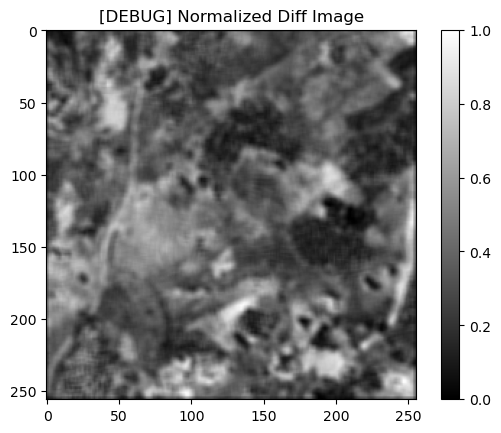

[INFO] Saving test data:  54%|██████████████████████████████▉                          | 32/59 [00:11<00:09,  2.88it/s]

[DEBUG] Mask class counts: [ 3653  8835 34614 18434]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\pre\test_pair_31.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\post\test_pair_31.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\mask\test_pair_31.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000107_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000107_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3666, Post tensor mean: 0.2160
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.2420
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2396


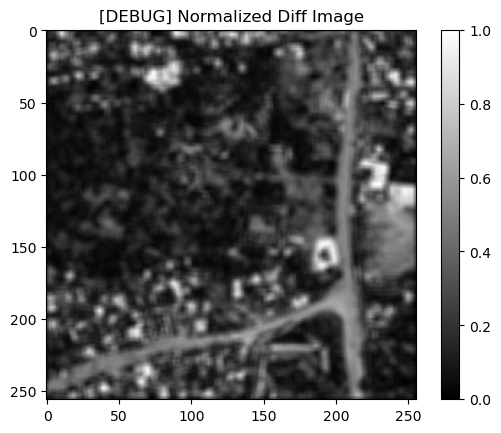

[INFO] Saving test data:  56%|███████████████████████████████▉                         | 33/59 [00:11<00:08,  2.92it/s]

[DEBUG] Mask class counts: [15668 24426 17745  7697]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\pre\test_pair_32.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\post\test_pair_32.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\mask\test_pair_32.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000062_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000062_post_disaster.tif
[DEBUG] Pre tensor mean: 0.1440, Post tensor mean: 0.1425
[DEBUG] Diff stats -> min: 0.0000, max: 0.9882, mean: 0.1106
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.1215


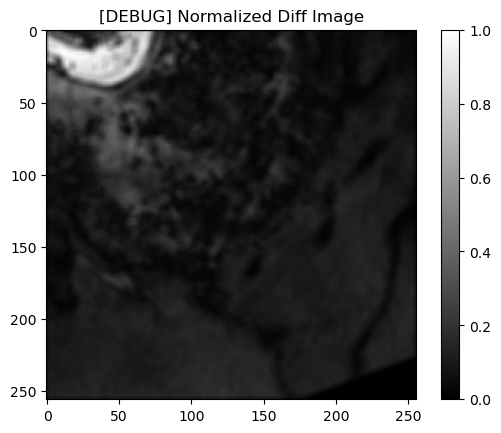

[INFO] Saving test data:  58%|████████████████████████████████▊                        | 34/59 [00:11<00:08,  2.96it/s]

[DEBUG] Mask class counts: [23935 36895  2993  1713]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\pre\test_pair_33.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\post\test_pair_33.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\mask\test_pair_33.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000043_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000043_post_disaster.tif
[DEBUG] Pre tensor mean: 0.4459, Post tensor mean: 0.2836
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.3091
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2989


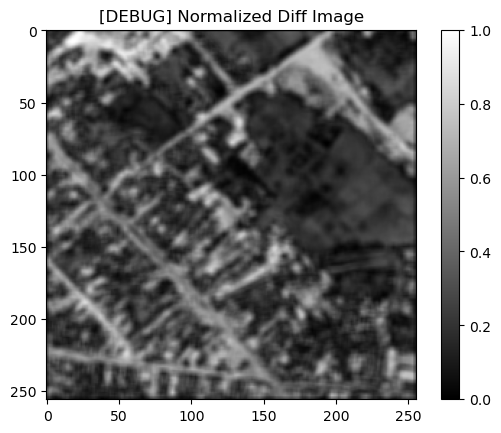

[INFO] Saving test data:  59%|█████████████████████████████████▊                       | 35/59 [00:12<00:07,  3.02it/s]

[DEBUG] Mask class counts: [ 8004 22974 22349 12209]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\pre\test_pair_34.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\post\test_pair_34.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\mask\test_pair_34.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000050_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000050_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3174, Post tensor mean: 0.2299
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.1922
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.1990


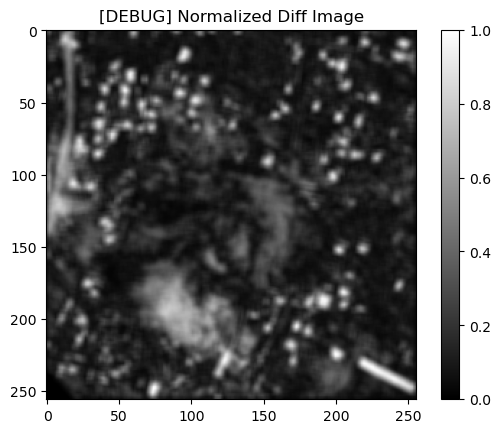

[INFO] Saving test data:  61%|██████████████████████████████████▊                      | 36/59 [00:12<00:07,  2.99it/s]

[DEBUG] Mask class counts: [15909 33654 10963  5010]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\pre\test_pair_35.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\post\test_pair_35.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\mask\test_pair_35.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000020_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000020_post_disaster.tif
[DEBUG] Pre tensor mean: 0.2735, Post tensor mean: 0.3330
[DEBUG] Diff stats -> min: 0.0000, max: 0.9529, mean: 0.2054
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2416


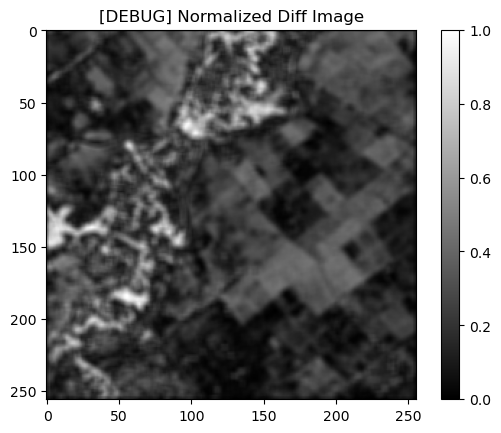

[INFO] Saving test data:  63%|███████████████████████████████████▋                     | 37/59 [00:12<00:07,  3.02it/s]

[DEBUG] Mask class counts: [ 9547 24559 27625  3805]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\pre\test_pair_36.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\post\test_pair_36.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\mask\test_pair_36.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000070_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000070_post_disaster.tif
[DEBUG] Pre tensor mean: 0.4867, Post tensor mean: 0.2102
[DEBUG] Diff stats -> min: 0.0000, max: 0.9882, mean: 0.2837
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.3045


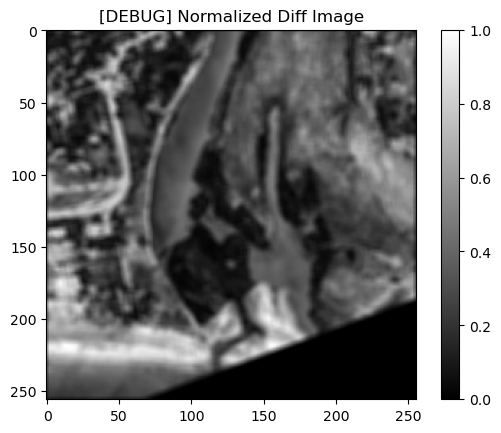

[INFO] Saving test data:  64%|████████████████████████████████████▋                    | 38/59 [00:13<00:06,  3.05it/s]

[DEBUG] Mask class counts: [14095 11459 26673 13309]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\pre\test_pair_37.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\post\test_pair_37.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\mask\test_pair_37.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000031_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000031_post_disaster.tif
[DEBUG] Pre tensor mean: 0.4540, Post tensor mean: 0.2702
[DEBUG] Diff stats -> min: 0.0000, max: 0.9843, mean: 0.2707
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2897


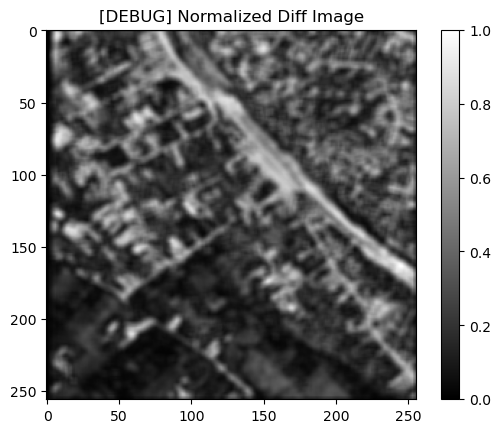

[INFO] Saving test data:  66%|█████████████████████████████████████▋                   | 39/59 [00:13<00:06,  3.09it/s]

[DEBUG] Mask class counts: [11579 21427 20817 11713]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\pre\test_pair_38.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\post\test_pair_38.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\mask\test_pair_38.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000006_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000006_post_disaster.tif
[DEBUG] Pre tensor mean: 0.4447, Post tensor mean: 0.2788
[DEBUG] Diff stats -> min: 0.0000, max: 0.9725, mean: 0.2715
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2781


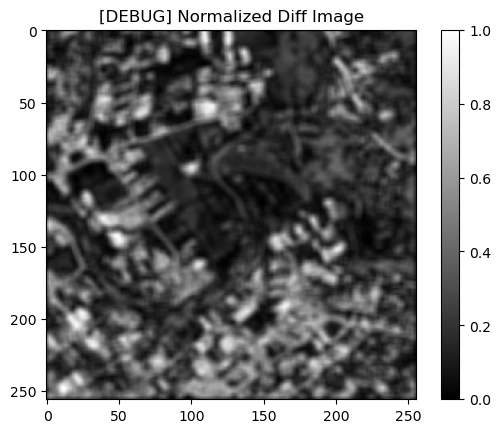

[INFO] Saving test data:  68%|██████████████████████████████████████▋                  | 40/59 [00:13<00:06,  3.04it/s]

[DEBUG] Mask class counts: [13422 22843 18042 11229]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\pre\test_pair_39.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\post\test_pair_39.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\mask\test_pair_39.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000059_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000059_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3085, Post tensor mean: 0.2134
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.2120
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2061


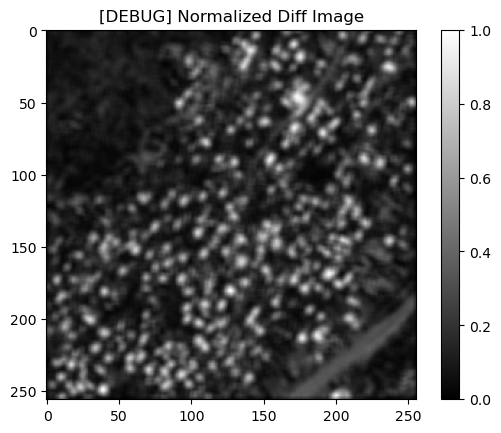

[INFO] Saving test data:  69%|███████████████████████████████████████▌                 | 41/59 [00:14<00:06,  2.99it/s]

[DEBUG] Mask class counts: [19431 30236 11554  4315]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\pre\test_pair_40.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\post\test_pair_40.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\mask\test_pair_40.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000055_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000055_post_disaster.tif
[DEBUG] Pre tensor mean: 0.2511, Post tensor mean: 0.2306
[DEBUG] Diff stats -> min: 0.0000, max: 0.9804, mean: 0.1208
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.1301


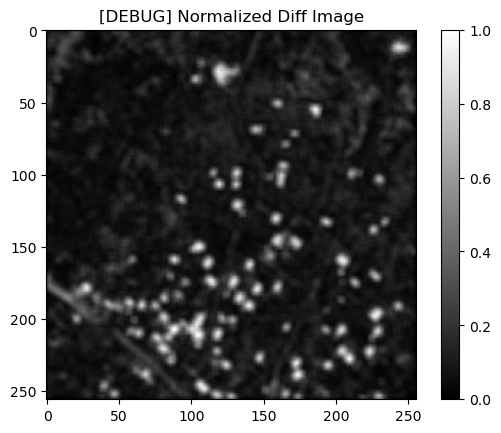

[INFO] Saving test data:  71%|████████████████████████████████████████▌                | 42/59 [00:14<00:05,  2.97it/s]

[DEBUG] Mask class counts: [32182 29212  1960  2182]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\pre\test_pair_41.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\post\test_pair_41.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\mask\test_pair_41.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000023_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000023_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3424, Post tensor mean: 0.1496
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.1947
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2114


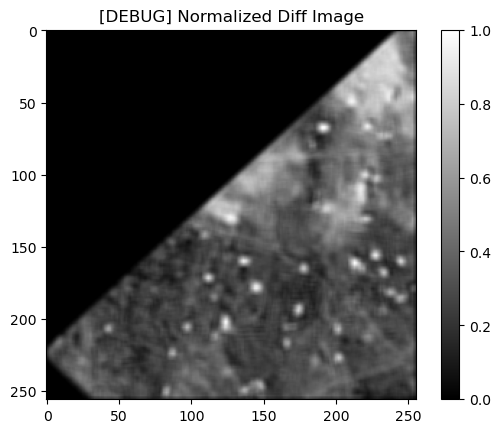

[INFO] Saving test data:  73%|█████████████████████████████████████████▌               | 43/59 [00:14<00:05,  2.95it/s]

[DEBUG] Mask class counts: [29193  3760 24574  8009]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\pre\test_pair_42.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\post\test_pair_42.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\mask\test_pair_42.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000007_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000007_post_disaster.tif
[DEBUG] Pre tensor mean: 0.5489, Post tensor mean: 0.1880
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.3610
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.3643


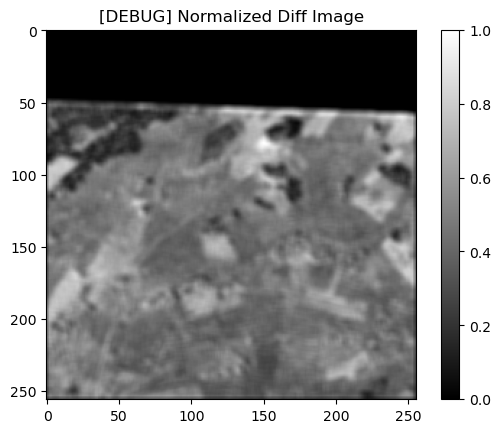

[INFO] Saving test data:  75%|██████████████████████████████████████████▌              | 44/59 [00:15<00:05,  2.96it/s]

[DEBUG] Mask class counts: [15891  1235 22926 25484]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\pre\test_pair_43.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\post\test_pair_43.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\mask\test_pair_43.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000008_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000008_post_disaster.tif
[DEBUG] Pre tensor mean: 0.4866, Post tensor mean: 0.1861
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.3030
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.3288


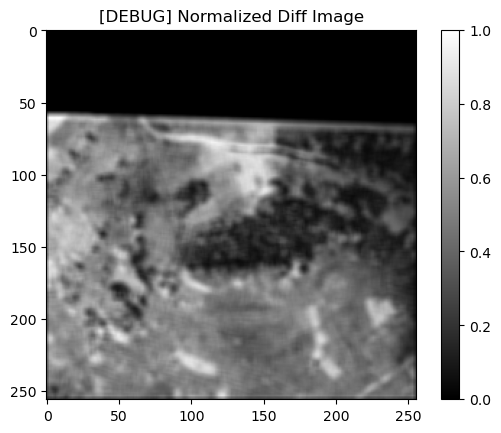

[INFO] Saving test data:  76%|███████████████████████████████████████████▍             | 45/59 [00:15<00:04,  2.98it/s]

[DEBUG] Mask class counts: [18437  7217 15124 24758]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\pre\test_pair_44.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\post\test_pair_44.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\mask\test_pair_44.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000108_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000108_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3435, Post tensor mean: 0.2457
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.2229
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2089


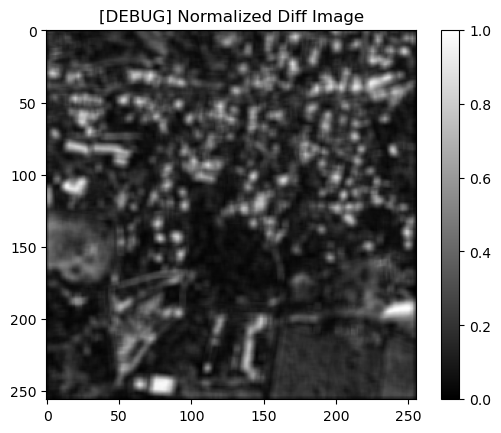

[INFO] Saving test data:  78%|████████████████████████████████████████████▍            | 46/59 [00:15<00:04,  2.93it/s]

[DEBUG] Mask class counts: [17767 30136 13097  4536]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\pre\test_pair_45.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\post\test_pair_45.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\mask\test_pair_45.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000028_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000028_post_disaster.tif
[DEBUG] Pre tensor mean: 0.4067, Post tensor mean: 0.2877
[DEBUG] Diff stats -> min: 0.0000, max: 0.9961, mean: 0.1938
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.1889


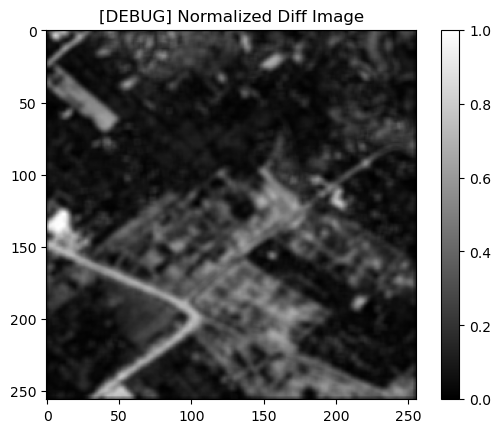

[INFO] Saving test data:  80%|█████████████████████████████████████████████▍           | 47/59 [00:16<00:03,  3.01it/s]

[DEBUG] Mask class counts: [23887 21867 15093  4689]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\pre\test_pair_46.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\post\test_pair_46.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\mask\test_pair_46.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000022_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000022_post_disaster.tif
[DEBUG] Pre tensor mean: 0.1598, Post tensor mean: 0.0734
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.0969
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.0988


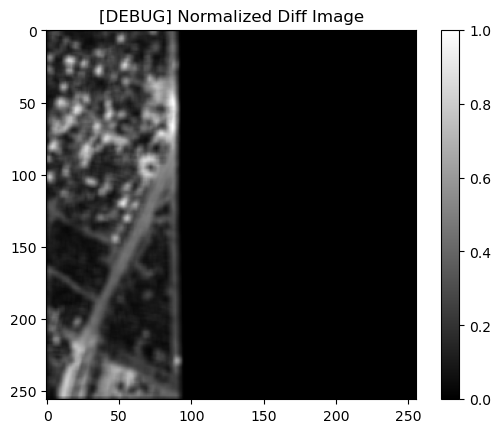

[INFO] Saving test data:  81%|██████████████████████████████████████████████▎          | 48/59 [00:16<00:03,  3.02it/s]

[DEBUG] Mask class counts: [45896  8258  7970  3412]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\pre\test_pair_47.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\post\test_pair_47.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\mask\test_pair_47.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000016_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000016_post_disaster.tif
[DEBUG] Pre tensor mean: 0.4080, Post tensor mean: 0.2710
[DEBUG] Diff stats -> min: 0.0000, max: 0.9882, mean: 0.2830
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.3039


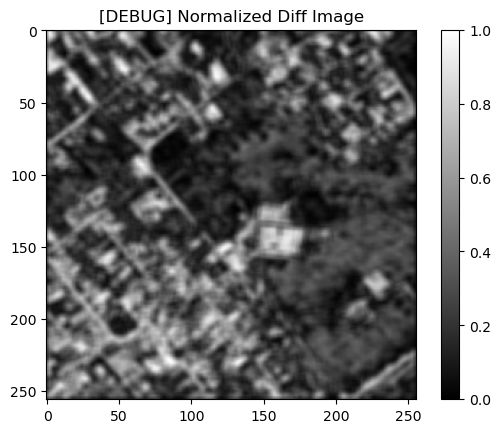

[INFO] Saving test data:  83%|███████████████████████████████████████████████▎         | 49/59 [00:16<00:03,  3.06it/s]

[DEBUG] Mask class counts: [11072 19487 22212 12765]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\pre\test_pair_48.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\post\test_pair_48.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\mask\test_pair_48.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000050_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000050_post_disaster.tif
[DEBUG] Pre tensor mean: 0.4588, Post tensor mean: 0.2809
[DEBUG] Diff stats -> min: 0.0000, max: 0.9961, mean: 0.2926
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.3034


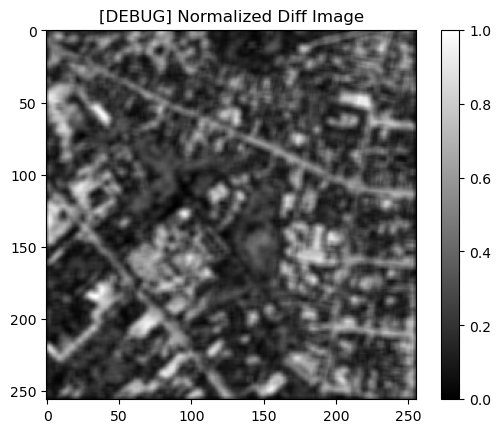

[INFO] Saving test data:  85%|████████████████████████████████████████████████▎        | 50/59 [00:17<00:02,  3.10it/s]

[DEBUG] Mask class counts: [10163 20545 22986 11842]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\pre\test_pair_49.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\post\test_pair_49.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\mask\test_pair_49.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000026_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000026_post_disaster.tif
[DEBUG] Pre tensor mean: 0.4948, Post tensor mean: 0.2480
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.2812
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2733


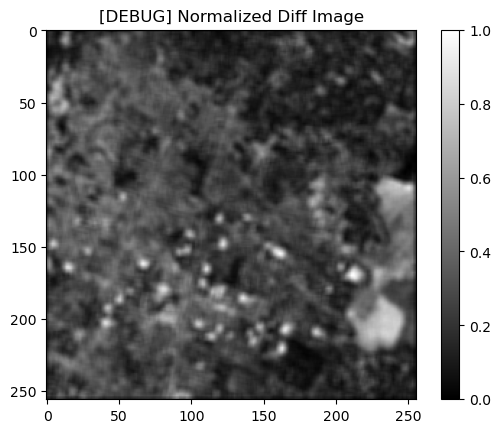

[INFO] Saving test data:  86%|█████████████████████████████████████████████████▎       | 51/59 [00:17<00:02,  2.99it/s]

[DEBUG] Mask class counts: [ 4814 21333 34418  4971]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\pre\test_pair_50.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\post\test_pair_50.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\mask\test_pair_50.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000035_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000035_post_disaster.tif
[DEBUG] Pre tensor mean: 0.1806, Post tensor mean: 0.0642
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.1231
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.1263


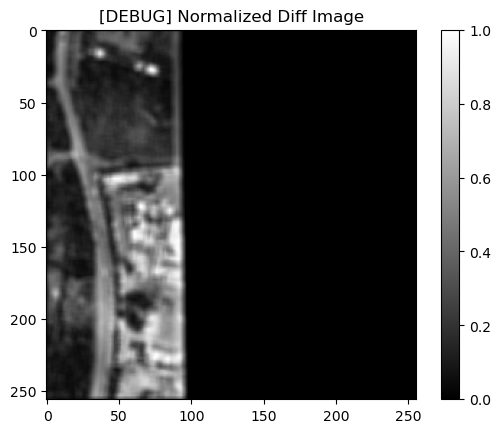

[INFO] Saving test data:  88%|██████████████████████████████████████████████████▏      | 52/59 [00:17<00:02,  3.03it/s]

[DEBUG] Mask class counts: [44204  7784  6298  7250]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\pre\test_pair_51.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\post\test_pair_51.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\mask\test_pair_51.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000057_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000057_post_disaster.tif
[DEBUG] Pre tensor mean: 0.5102, Post tensor mean: 0.2151
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.3202
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.3134


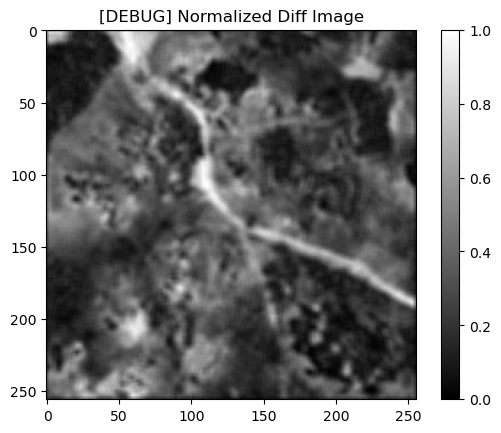

[INFO] Saving test data:  90%|███████████████████████████████████████████████████▏     | 53/59 [00:18<00:02,  2.84it/s]

[DEBUG] Mask class counts: [ 5213 18929 29177 12217]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\pre\test_pair_52.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\post\test_pair_52.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\mask\test_pair_52.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000062_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000062_post_disaster.tif
[DEBUG] Pre tensor mean: 0.2090, Post tensor mean: 0.2312
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.1545
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.1575


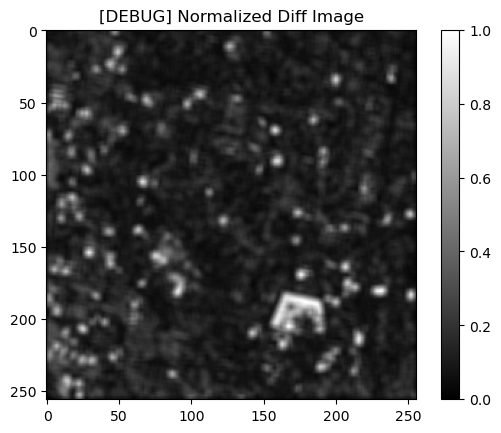

[INFO] Saving test data:  92%|████████████████████████████████████████████████████▏    | 54/59 [00:18<00:01,  2.64it/s]

[DEBUG] Mask class counts: [13863 44640  4976  2057]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\pre\test_pair_53.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\post\test_pair_53.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\mask\test_pair_53.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000070_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000070_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3083, Post tensor mean: 0.1995
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.1965
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2058


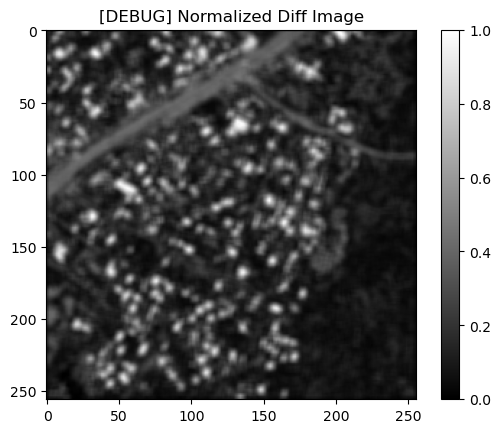

[INFO] Saving test data:  93%|█████████████████████████████████████████████████████▏   | 55/59 [00:19<00:01,  2.64it/s]

[DEBUG] Mask class counts: [19054 29735 12653  4094]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\pre\test_pair_54.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\post\test_pair_54.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\mask\test_pair_54.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000066_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000066_post_disaster.tif
[DEBUG] Pre tensor mean: 0.4432, Post tensor mean: 0.2713
[DEBUG] Diff stats -> min: 0.0000, max: 0.9922, mean: 0.2708
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.3123


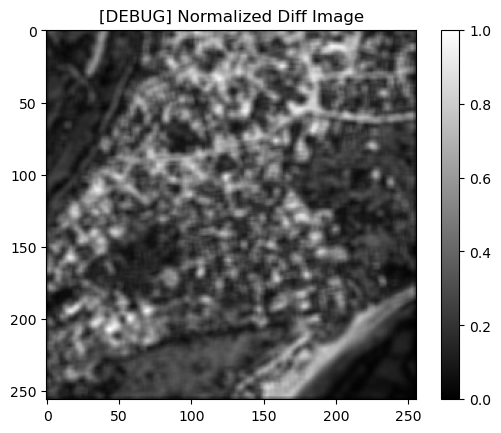

[INFO] Saving test data:  95%|██████████████████████████████████████████████████████   | 56/59 [00:19<00:01,  2.64it/s]

[DEBUG] Mask class counts: [ 8405 18073 25790 13268]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\pre\test_pair_55.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\post\test_pair_55.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\mask\test_pair_55.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000006_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000006_post_disaster.tif
[DEBUG] Pre tensor mean: 0.6200, Post tensor mean: 0.1915
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.4284
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.4600


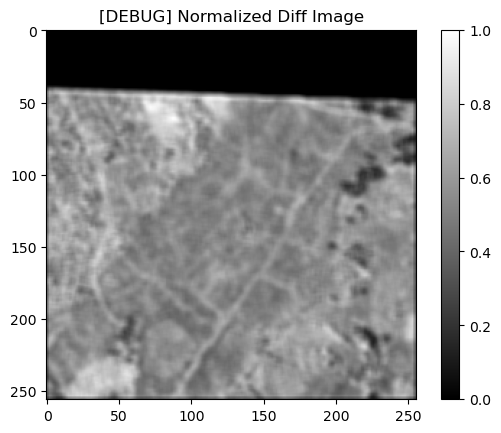

[INFO] Saving test data:  97%|███████████████████████████████████████████████████████  | 57/59 [00:19<00:00,  2.63it/s]

[DEBUG] Mask class counts: [13022   103  2887 49524]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\pre\test_pair_56.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\post\test_pair_56.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\mask\test_pair_56.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\congo-volcano_00000028_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\congo-volcano_00000028_post_disaster.tif
[DEBUG] Pre tensor mean: 0.5776, Post tensor mean: 0.2053
[DEBUG] Diff stats -> min: 0.0000, max: 1.0000, mean: 0.3933
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.4515


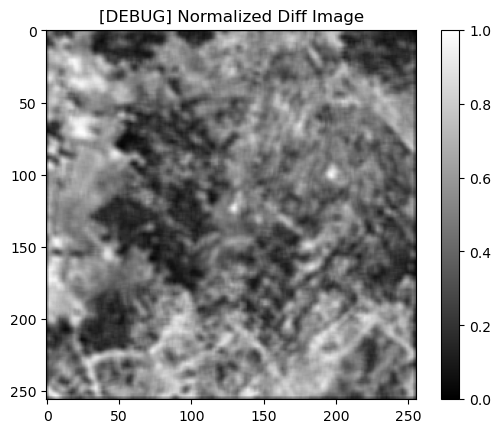

[INFO] Saving test data:  98%|████████████████████████████████████████████████████████ | 58/59 [00:20<00:00,  2.52it/s]

[DEBUG] Mask class counts: [ 3753  6570 21845 33368]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\pre\test_pair_57.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\post\test_pair_57.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\mask\test_pair_57.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\haiti-earthquake_00000040_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\haiti-earthquake_00000040_post_disaster.tif
[DEBUG] Pre tensor mean: 0.3856, Post tensor mean: 0.2962
[DEBUG] Diff stats -> min: 0.0000, max: 0.9725, mean: 0.2277
[DEBUG] Normalized diff stats -> min: 0.0000, max: 1.0000, mean: 0.2567


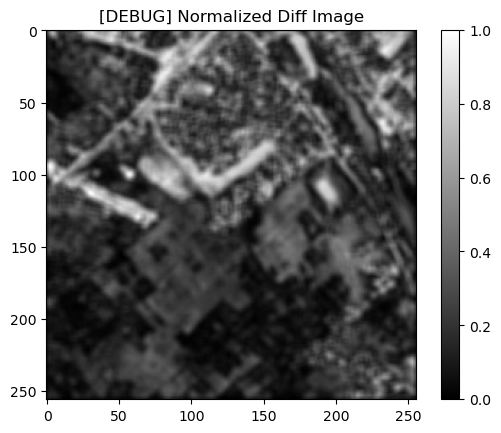

[INFO] Saving test data: 100%|█████████████████████████████████████████████████████████| 59/59 [00:20<00:00,  2.87it/s]

[DEBUG] Mask class counts: [13354 21714 22616  7852]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\pre\test_pair_58.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\post\test_pair_58.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\test\mask\test_pair_58.png
[INFO] All data processed and saved.


In [17]:
#step 2: Create the pseudoBRIGHT dataset (split into HIC MIC and LIC). This one is just LIC
# Get all pre-post pairs
#step 2: Create the pseudoBRIGHT dataset (split into HIC MIC and LIC). This one is just LIC
# Get all pre-post pairs
import os
import random
from PIL import Image, ImageOps
import numpy as np
import torch
import torch.nn.functional as F
from torchvision import transforms as T
from scipy.ndimage import binary_opening, binary_closing
from tqdm import tqdm
import matplotlib.pyplot as plt

# Set seed
random.seed(42)

# Paths
pre_event_dir = r"C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico"
post_event_dir = r"C:\Users\sweta\Downloads\post-event\post-event"
output_base = r"C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo"

# LIC filter
low_income = ['congo', 'haiti']

# Transform
def transform_gray():
    return T.Compose([
        T.Resize((256, 256)),
        T.ToTensor()
    ])

# Device
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Helpers
def clean_multiclass_mask(mask_np, min_region_size=20):
    cleaned_mask = np.zeros_like(mask_np)
    for cls in range(1, 4):
        binary = (mask_np == cls)
        binary = binary_opening(binary, structure=np.ones((3,3)))
        binary = binary_closing(binary, structure=np.ones((3,3)))
        cleaned_mask[binary] = cls
    return cleaned_mask

def SAR_damage_mask_multiclass_merged(pre_optical_img, post_sar_img):
    def optical_to_sar_like(img):
        img = img.convert('L')
        img = ImageOps.autocontrast(img, cutoff=2)
        return img

    pre_sar_like = optical_to_sar_like(pre_optical_img)
    post_sar = post_sar_img.convert('L')

    pre_tensor = transform_gray()(pre_sar_like).to(device).squeeze(0)
    post_tensor = transform_gray()(post_sar).to(device).squeeze(0)

    print(f"[DEBUG] Pre tensor mean: {pre_tensor.mean().item():.4f}, Post tensor mean: {post_tensor.mean().item():.4f}")

    with torch.no_grad():
        diff = torch.abs(post_tensor - pre_tensor)
        print(f"[DEBUG] Diff stats -> min: {diff.min().item():.4f}, max: {diff.max().item():.4f}, mean: {diff.mean().item():.4f}")

        diff_smoothed = F.avg_pool2d(diff.unsqueeze(0).unsqueeze(0), kernel_size=5, stride=1, padding=2).squeeze()

        diff_min, diff_max = diff_smoothed.min(), diff_smoothed.max()
        diff_norm = (diff_smoothed - diff_min) / (diff_max - diff_min + 1e-8)
        print(f"[DEBUG] Normalized diff stats -> min: {diff_norm.min().item():.4f}, max: {diff_norm.max().item():.4f}, mean: {diff_norm.mean().item():.4f}")

        # Optional visualization of diff_norm
        plt.imshow(diff_norm.cpu().numpy(), cmap='gray')
        plt.title("[DEBUG] Normalized Diff Image")
        plt.colorbar()
        plt.show()

        thresholds = [0.08, 0.22, 0.45]
        mask = torch.zeros_like(diff_norm, dtype=torch.long)
        mask = torch.where((diff_norm >= thresholds[0]) & (diff_norm < thresholds[1]), 1, mask)
        mask = torch.where((diff_norm >= thresholds[1]) & (diff_norm < thresholds[2]), 2, mask)
        mask = torch.where(diff_norm >= thresholds[2], 3, mask)

    mask_np = mask.cpu().numpy()
    cleaned = clean_multiclass_mask(mask_np)

    print(f"[DEBUG] Mask class counts: {np.bincount(cleaned.flatten())}")
    return torch.from_numpy(cleaned).long()

# Filter LIC image pairs
print("[INFO] Filtering image pairs for LIC regions...")
all_pre_files = os.listdir(pre_event_dir)
filtered_pre_files = [f for f in all_pre_files if any(country in f.lower() for country in low_income)]
expected_post_files = [f.replace('_pre_disaster', '_post_disaster') for f in filtered_pre_files]
all_post_files = os.listdir(post_event_dir)

pairs = []
for pre, post in zip(filtered_pre_files, expected_post_files):
    if post in all_post_files:
        pre_path = os.path.join(pre_event_dir, pre)
        post_path = os.path.join(post_event_dir, post)
        pairs.append((pre_path, post_path))
        print(f"[DEBUG] Found pair: {os.path.basename(pre)} + {os.path.basename(post)}")
    else:
        print(f"[WARNING] Missing post-disaster file for {pre}")

print(f"[INFO] Total valid pairs found: {len(pairs)}")

# Split
random.shuffle(pairs)
split_idx = int(0.7 * len(pairs))
train_pairs = pairs[:split_idx]
test_pairs = pairs[split_idx:]

print(f"[INFO] Split into {len(train_pairs)} train and {len(test_pairs)} test pairs")

# Save Function
def save_triplets(pairs, split='train'):
    pre_out = os.path.join(output_base, split, 'pre')
    post_out = os.path.join(output_base, split, 'post')
    mask_out = os.path.join(output_base, split, 'mask')

    os.makedirs(pre_out, exist_ok=True)
    os.makedirs(post_out, exist_ok=True)
    os.makedirs(mask_out, exist_ok=True)

    for idx, (pre_path, post_path) in enumerate(tqdm(pairs, desc=f"[INFO] Saving {split} data")):
        try:
            print(f"[DEBUG] Loading pre: {pre_path}")
            print(f"[DEBUG] Loading post: {post_path}")
            pre_img = Image.open(pre_path).convert("RGB")
            post_img = Image.open(post_path)

            pre_resized = pre_img.resize((256, 256))
            post_resized = post_img.resize((256, 256))

            mask = SAR_damage_mask_multiclass_merged(pre_resized, post_resized)

            base_name = f"{split}_pair_{idx}"
            pre_file = os.path.join(pre_out, base_name + ".png")
            post_file = os.path.join(post_out, base_name + ".png")
            mask_file = os.path.join(mask_out, base_name + ".png")

            pre_resized.save(pre_file)
            print(f"[DEBUG] Saved pre to {pre_file}")
            post_resized.save(post_file)
            print(f"[DEBUG] Saved post to {post_file}")
            Image.fromarray(mask.cpu().numpy().astype(np.uint8)).save(mask_file)
            print(f"[DEBUG] Saved mask to {mask_file}")

        except Exception as e:
            print(f"[ERROR] Failed at {pre_path} and {post_path} -> {e}")

# Run save
save_triplets(train_pairs, split='train')
save_triplets(test_pairs, split='test')

print("[INFO] All data processed and saved.")


In [13]:
#step 2: Create the pseudoBRIGHT dataset (split into HIC MIC and LIC). This one is just MIC
# Get all pre-post pairs
import os
import random
from PIL import Image, ImageOps
import numpy as np
import torch
import torch.nn.functional as F
from torchvision import transforms as T
from scipy.ndimage import binary_opening, binary_closing
from tqdm import tqdm

# Set seed
random.seed(42)

# Paths
pre_event_dir = r"C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico"
post_event_dir = r"C:\Users\sweta\Downloads\post-event\post-event"
output_base = r"C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo"

# MIC filter
mid_income = ['turkey', 'lebanon', 'libya', 'morocco']

# Transform
transform_gray = T.Compose([
    T.Resize((256, 256)),
    T.ToTensor()
])

# Device
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Helpers
def clean_multiclass_mask(mask_np, min_region_size=20):
    cleaned_mask = np.zeros_like(mask_np)
    for cls in range(1, 4):
        binary = (mask_np == cls)
        binary = binary_opening(binary, structure=np.ones((3,3)))
        binary = binary_closing(binary, structure=np.ones((3,3)))
        cleaned_mask[binary] = cls
    return cleaned_mask

def SAR_damage_mask_multiclass_merged(pre_optical_img, post_sar_img):
    def optical_to_sar_like(img):
        img = img.convert('L')
        img = ImageOps.autocontrast(img, cutoff=2)
        return img

    pre_sar_like = optical_to_sar_like(pre_optical_img)
    post_sar = post_sar_img.convert('L')

    pre_tensor = transform_gray(pre_sar_like).to(device).squeeze(0)
    post_tensor = transform_gray(post_sar).to(device).squeeze(0)

    with torch.no_grad():
        diff = torch.abs(post_tensor - pre_tensor)
        diff_smoothed = F.avg_pool2d(diff.unsqueeze(0).unsqueeze(0), kernel_size=5, stride=1, padding=2).squeeze()

        diff_min, diff_max = diff_smoothed.min(), diff_smoothed.max()
        diff_norm = (diff_smoothed - diff_min) / (diff_max - diff_min + 1e-8)

        thresholds = [0.08, 0.22, 0.45]
        mask = torch.zeros_like(diff_norm, dtype=torch.long)
        mask = torch.where((diff_norm >= thresholds[0]) & (diff_norm < thresholds[1]), 1, mask)
        mask = torch.where((diff_norm >= thresholds[1]) & (diff_norm < thresholds[2]), 2, mask)
        mask = torch.where(diff_norm >= thresholds[2], 3, mask)

    mask_np = mask.cpu().numpy()
    cleaned = clean_multiclass_mask(mask_np)

    # DEBUG: Print mask class distribution
    print(f"[DEBUG] Mask class counts: {np.bincount(cleaned.flatten())}")
    return torch.from_numpy(cleaned).long()

# Filter MIC image pairs
print("[INFO] Filtering image pairs for MIC regions...")
all_pre_files = os.listdir(pre_event_dir)
filtered_pre_files = [f for f in all_pre_files if any(country in f.lower() for country in mid_income)]
expected_post_files = [f.replace('_pre_disaster', '_post_disaster') for f in filtered_pre_files]
all_post_files = os.listdir(post_event_dir)

pairs = []
for pre, post in zip(filtered_pre_files, expected_post_files):
    if post in all_post_files:
        pre_path = os.path.join(pre_event_dir, pre)
        post_path = os.path.join(post_event_dir, post)
        pairs.append((pre_path, post_path))
        print(f"[DEBUG] Found pair: {os.path.basename(pre)} + {os.path.basename(post)}")
    else:
        print(f"[WARNING] Missing post-disaster file for {pre}")

print(f"[INFO] Total valid pairs found: {len(pairs)}")

# Split
random.shuffle(pairs)
split_idx = int(0.7 * len(pairs))
train_pairs = pairs[:split_idx]
test_pairs = pairs[split_idx:]

print(f"[INFO] Split into {len(train_pairs)} train and {len(test_pairs)} test pairs")

# Save Function
def save_triplets(pairs, split='train'):
    pre_out = os.path.join(output_base, split, 'pre')
    post_out = os.path.join(output_base, split, 'post')
    mask_out = os.path.join(output_base, split, 'mask')

    os.makedirs(pre_out, exist_ok=True)
    os.makedirs(post_out, exist_ok=True)
    os.makedirs(mask_out, exist_ok=True)

    for idx, (pre_path, post_path) in enumerate(tqdm(pairs, desc=f"[INFO] Saving {split} data")):
        try:
            print(f"[DEBUG] Loading pre: {pre_path}")
            print(f"[DEBUG] Loading post: {post_path}")
            pre_img = Image.open(pre_path).convert("RGB")
            post_img = Image.open(post_path).convert("RGB")

            pre_resized = pre_img.resize((256, 256))
            post_resized = post_img.resize((256, 256))

            mask = SAR_damage_mask_multiclass_merged(pre_resized, post_resized)

            base_name = f"{split}_pair_{idx}"
            pre_file = os.path.join(pre_out, base_name + ".png")
            post_file = os.path.join(post_out, base_name + ".png")
            mask_file = os.path.join(mask_out, base_name + ".png")

            pre_resized.save(pre_file)
            print(f"[DEBUG] Saved pre to {pre_file}")
            post_resized.save(post_file)
            print(f"[DEBUG] Saved post to {post_file}")
            Image.fromarray(mask.cpu().numpy().astype(np.uint8)).save(mask_file)
            print(f"[DEBUG] Saved mask to {mask_file}")

        except Exception as e:
            print(f"[ERROR] Failed at {pre_path} and {post_path} -> {e}")

# Run save
save_triplets(train_pairs, split='train')
save_triplets(test_pairs, split='test')

print("[INFO] All data processed and saved.")


#Note: The goal is to have a tuple of (pre-disaster optical, post-disaster SAR, and ROUGH damage mask) for LICs in the BRIGHT dataset. this should be split into training and test test (70/30) split and be saved in C:\\Users\\sweta\\anaconda_projects\\non-trivial\\performance_bias\\MIC_pseudo\\(train/test)

[INFO] Filtering image pairs for MIC regions...
[DEBUG] Found pair: libya-flood_00000000_pre_disaster.tif + libya-flood_00000000_post_disaster.tif
[DEBUG] Found pair: libya-flood_00000001_pre_disaster.tif + libya-flood_00000001_post_disaster.tif
[DEBUG] Found pair: libya-flood_00000002_pre_disaster.tif + libya-flood_00000002_post_disaster.tif
[DEBUG] Found pair: libya-flood_00000003_pre_disaster.tif + libya-flood_00000003_post_disaster.tif
[DEBUG] Found pair: libya-flood_00000004_pre_disaster.tif + libya-flood_00000004_post_disaster.tif
[DEBUG] Found pair: libya-flood_00000005_pre_disaster.tif + libya-flood_00000005_post_disaster.tif
[DEBUG] Found pair: libya-flood_00000006_pre_disaster.tif + libya-flood_00000006_post_disaster.tif
[DEBUG] Found pair: libya-flood_00000007_pre_disaster.tif + libya-flood_00000007_post_disaster.tif
[DEBUG] Found pair: libya-flood_00000008_pre_disaster.tif + libya-flood_00000008_post_disaster.tif
[DEBUG] Found pair: libya-flood_00000009_pre_disaster.tif + l

[INFO] Saving train data:   0%|                                                               | 0/1263 [00:00<?, ?it/s]

[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000217_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000217_post_disaster.tif


[INFO] Saving train data:   0%|                                                       | 1/1263 [00:00<03:50,  5.46it/s]

[DEBUG] Mask class counts: [40830  6877  8996  8833]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_0.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_0.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_0.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000426_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000426_post_disaster.tif
[DEBUG] Mask class counts: [12410 27056 16809  9261]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1.png


[INFO] Saving train data:   0%|▏                                                      | 3/1263 [00:00<03:46,  5.55it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000293_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000293_post_disaster.tif
[DEBUG] Mask class counts: [15594 17319 20542 12081]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_2.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_2.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_2.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar

[INFO] Saving train data:   0%|▏                                                      | 4/1263 [00:00<03:39,  5.73it/s]

[DEBUG] Mask class counts: [ 6441 16509 19212 23374]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_3.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_3.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_3.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000537_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000537_post_disaster.tif
[DEBUG] Mask class counts: [12763 13172 22337 17264]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_4.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_4.png


[INFO] Saving train data:   0%|▎                                                      | 6/1263 [00:01<03:50,  5.44it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_4.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000472_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000472_post_disaster.tif
[DEBUG] Mask class counts: [ 6056 21699 24217 13564]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_5.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_5.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_5.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000339_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\

[INFO] Saving train data:   1%|▎                                                      | 8/1263 [00:01<03:38,  5.75it/s]

[DEBUG] Mask class counts: [ 6402 20207 28159 10768]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_6.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_6.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_6.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000764_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000764_post_disaster.tif
[DEBUG] Mask class counts: [12112 18796 20191 14437]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_7.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_7.png
[DEBUG] Saved mask to C:\Users\sw

[INFO] Saving train data:   1%|▍                                                      | 9/1263 [00:01<03:40,  5.68it/s]

[DEBUG] Mask class counts: [ 9924 13841 28529 13242]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_8.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_8.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_8.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000978_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000978_post_disaster.tif
[DEBUG] Mask class counts: [16946 25641 15107  7842]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_9.png


[INFO] Saving train data:   1%|▍                                                     | 11/1263 [00:01<03:39,  5.71it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_9.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_9.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000876_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000876_post_disaster.tif
[DEBUG] Mask class counts: [ 8761 19254 20242 17279]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_10.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_10.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_10.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myan

[INFO] Saving train data:   1%|▌                                                     | 13/1263 [00:02<03:32,  5.88it/s]

[DEBUG] Mask class counts: [ 7968 21297 17983 18288]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_11.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_11.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_11.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000812_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000812_post_disaster.tif
[DEBUG] Mask class counts: [13193 24935 16362 11046]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_12.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_12.png
[DEBUG] Saved mask to C:\Use

[INFO] Saving train data:   1%|▌                                                     | 14/1263 [00:02<03:36,  5.78it/s]

[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000131_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000131_post_disaster.tif
[DEBUG] Mask class counts: [ 9602 11129 32288 12517]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_13.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_13.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_13.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000068_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000068_post_disaster.tif


[INFO] Saving train data:   1%|▋                                                     | 16/1263 [00:02<03:12,  6.48it/s]

[DEBUG] Mask class counts: [32267     0     0 33269]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_14.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_14.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_14.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000579_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000579_post_disaster.tif
[DEBUG] Mask class counts: [54328  1916  3730  5562]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_15.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_15.png
[DEBUG] Saved mask to C:\Use

[INFO] Saving train data:   1%|▋                                                     | 17/1263 [00:02<03:15,  6.37it/s]

[DEBUG] Mask class counts: [ 9270 34056 16133  6077]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_16.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_16.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_16.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000448_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000448_post_disaster.tif
[DEBUG] Mask class counts: [ 9372 18658 17155 20351]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_17.png


[INFO] Saving train data:   1%|▊                                                     | 18/1263 [00:03<03:25,  6.07it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_17.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_17.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000714_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000714_post_disaster.tif
[DEBUG] Mask class counts: [12036 20870 16056 16574]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_18.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_18.png


[INFO] Saving train data:   2%|▊                                                     | 20/1263 [00:03<03:47,  5.47it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_18.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000058_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000058_post_disaster.tif
[DEBUG] Mask class counts: [ 9924  9813 27820 17979]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_19.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_19.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_19.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000542_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-eve

[INFO] Saving train data:   2%|▉                                                     | 21/1263 [00:03<03:43,  5.55it/s]

[DEBUG] Mask class counts: [38361  4940 16260  5975]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_20.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_20.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_20.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000895_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000895_post_disaster.tif
[DEBUG] Mask class counts: [ 7837 19396 22650 15653]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_21.png


[INFO] Saving train data:   2%|▉                                                     | 22/1263 [00:03<03:50,  5.39it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_21.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_21.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000484_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000484_post_disaster.tif
[DEBUG] Mask class counts: [56262   507  1912  6855]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_22.png


[INFO] Saving train data:   2%|█                                                     | 24/1263 [00:04<03:59,  5.18it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_22.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_22.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00001046_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00001046_post_disaster.tif
[DEBUG] Mask class counts: [15088 21286 16976 12186]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_23.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_23.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_23.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_my

[INFO] Saving train data:   2%|█                                                     | 25/1263 [00:04<04:59,  4.13it/s]

[DEBUG] Mask class counts: [ 8337 16098 23254 17847]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_24.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_24.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_24.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00001003_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00001003_post_disaster.tif


[INFO] Saving train data:   2%|█                                                     | 26/1263 [00:04<05:01,  4.11it/s]

[DEBUG] Mask class counts: [12066 22871 19625 10974]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_25.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_25.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_25.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000569_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000569_post_disaster.tif


[INFO] Saving train data:   2%|█▏                                                    | 27/1263 [00:05<04:47,  4.30it/s]

[DEBUG] Mask class counts: [ 9278 18967 24142 13149]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_26.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_26.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_26.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000013_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000013_post_disaster.tif
[DEBUG] Mask class counts: [ 4857 13836 33874 12969]


[INFO] Saving train data:   2%|█▏                                                    | 29/1263 [00:05<04:09,  4.94it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_27.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_27.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_27.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000260_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000260_post_disaster.tif
[DEBUG] Mask class counts: [ 7560 32433 21199  4344]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_28.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_28.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_

[INFO] Saving train data:   2%|█▎                                                    | 30/1263 [00:05<04:02,  5.08it/s]

[DEBUG] Mask class counts: [15839  7049 20636 22012]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_29.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_29.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_29.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00001113_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00001113_post_disaster.tif
[DEBUG] Mask class counts: [ 7628 26933 18610 12365]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_30.png


[INFO] Saving train data:   2%|█▎                                                    | 31/1263 [00:05<03:59,  5.14it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_30.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_30.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000297_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000297_post_disaster.tif
[DEBUG] Mask class counts: [10371 12287 23644 19234]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_31.png


[INFO] Saving train data:   3%|█▍                                                    | 33/1263 [00:06<03:57,  5.17it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_31.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_31.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000101_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000101_post_disaster.tif
[DEBUG] Mask class counts: [10086  9855 29379 16216]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_32.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_32.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_32.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_my

[INFO] Saving train data:   3%|█▍                                                    | 34/1263 [00:06<03:48,  5.37it/s]

[DEBUG] Mask class counts: [14772 11107  8915 30742]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_33.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_33.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_33.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000508_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000508_post_disaster.tif
[DEBUG] Mask class counts: [ 5684 17499 26869 15484]


[INFO] Saving train data:   3%|█▍                                                    | 35/1263 [00:06<03:51,  5.30it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_34.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_34.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_34.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000539_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000539_post_disaster.tif
[DEBUG] Mask class counts: [12246 14348 22536 16406]


[INFO] Saving train data:   3%|█▌                                                    | 36/1263 [00:06<03:57,  5.17it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_35.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_35.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_35.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000924_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000924_post_disaster.tif
[DEBUG] Mask class counts: [ 5905  8482 32223 18926]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_36.png


[INFO] Saving train data:   3%|█▌                                                    | 38/1263 [00:07<03:51,  5.29it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_36.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_36.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000674_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000674_post_disaster.tif
[DEBUG] Mask class counts: [10903 11653 19118 23862]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_37.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_37.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_37.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_my

[INFO] Saving train data:   3%|█▋                                                    | 40/1263 [00:07<03:28,  5.85it/s]

[DEBUG] Mask class counts: [54928   862  3251  6495]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_38.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_38.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_38.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000042_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000042_post_disaster.tif
[DEBUG] Mask class counts: [ 9235 13399 22415 20487]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_39.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_39.png
[DEBUG] Saved mask to C:\Users\sweta\ana

[INFO] Saving train data:   3%|█▊                                                    | 42/1263 [00:07<03:29,  5.82it/s]

[DEBUG] Mask class counts: [10319  7545 18284 29388]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_40.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_40.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_40.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000150_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000150_post_disaster.tif
[DEBUG] Mask class counts: [ 9169 18420 27548 10399]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_41.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_41.png
[DEBUG] Saved mask to C:\U

[INFO] Saving train data:   3%|█▉                                                    | 44/1263 [00:08<03:15,  6.23it/s]

[DEBUG] Mask class counts: [ 8790 23476 23724  9546]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_42.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_42.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_42.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000401_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000401_post_disaster.tif
[DEBUG] Mask class counts: [34247  3103 12413 15773]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_43.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_43.png
[DEBUG] Saved mask to C:\U

[INFO] Saving train data:   4%|█▉                                                    | 45/1263 [00:08<03:23,  5.98it/s]

[DEBUG] Mask class counts: [ 7691 30977 13572 13296]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_44.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_44.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_44.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000141_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000141_post_disaster.tif
[DEBUG] Mask class counts: [16056 25324 15490  8666]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_45.png


[INFO] Saving train data:   4%|██                                                    | 47/1263 [00:08<03:20,  6.07it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_45.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_45.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000836_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000836_post_disaster.tif
[DEBUG] Mask class counts: [12364 28469 16351  8352]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_46.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_46.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_46.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_my

[INFO] Saving train data:   4%|██                                                    | 49/1263 [00:08<03:12,  6.30it/s]

[DEBUG] Mask class counts: [ 8696 38747 14302  3791]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_47.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_47.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_47.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000159_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000159_post_disaster.tif
[DEBUG] Mask class counts: [ 8068 12511 22572 22385]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_48.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_48.png
[DEBUG] Saved mask to C:\Use

[INFO] Saving train data:   4%|██▏                                                   | 51/1263 [00:09<03:12,  6.29it/s]

[DEBUG] Mask class counts: [ 7271 14101 29452 14712]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_49.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_49.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_49.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00001111_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00001111_post_disaster.tif
[DEBUG] Mask class counts: [34934  6756 14585  9261]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_50.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_50.png
[DEBUG] Saved mask to C:\Use

[INFO] Saving train data:   4%|██▏                                                   | 52/1263 [00:09<03:18,  6.09it/s]

[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000271_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000271_post_disaster.tif
[DEBUG] Mask class counts: [12754 18142 20288 14352]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_51.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_51.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_51.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000975_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000975_post_disaster.tif


[INFO] Saving train data:   4%|██▎                                                   | 54/1263 [00:09<03:10,  6.36it/s]

[DEBUG] Mask class counts: [11872 23969 21534  8161]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_52.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_52.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_52.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000324_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000324_post_disaster.tif
[DEBUG] Mask class counts: [47797  3253  6994  7492]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_53.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_53.png
[DEBUG] Saved mask to C:\Use

[INFO] Saving train data:   4%|██▍                                                   | 56/1263 [00:10<03:09,  6.36it/s]

[DEBUG] Mask class counts: [35628    39  7150 22719]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_54.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_54.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_54.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000685_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000685_post_disaster.tif
[DEBUG] Mask class counts: [30567 12331 15567  7071]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_55.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_55.png
[DEBUG] Saved mask to C:\Use

[INFO] Saving train data:   5%|██▍                                                   | 58/1263 [00:10<03:16,  6.14it/s]

[DEBUG] Mask class counts: [ 7118 18773 18925 20720]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_56.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_56.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_56.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000193_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000193_post_disaster.tif
[DEBUG] Mask class counts: [ 7499 16888 26117 15032]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_57.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_57.png
[DEBUG] Saved mask to C:\Use

[INFO] Saving train data:   5%|██▌                                                   | 60/1263 [00:10<03:13,  6.23it/s]

[DEBUG] Mask class counts: [14051 31604  9837 10044]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_58.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_58.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_58.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000313_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000313_post_disaster.tif
[DEBUG] Mask class counts: [30286 10246 13403 11601]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_59.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_59.png
[DEBUG] Saved mask to C:\Use

[INFO] Saving train data:   5%|██▌                                                   | 61/1263 [00:10<03:17,  6.09it/s]

[DEBUG] Mask class counts: [ 4936 20258 20850 19492]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_60.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_60.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_60.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000006_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000006_post_disaster.tif
[DEBUG] Mask class counts: [17442 12823 20051 15220]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_61.png


[INFO] Saving train data:   5%|██▋                                                   | 63/1263 [00:11<03:07,  6.42it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_61.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_61.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000522_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000522_post_disaster.tif
[DEBUG] Mask class counts: [52121  2203  3986  7226]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_62.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_62.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_62.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_my

[INFO] Saving train data:   5%|██▋                                                   | 64/1263 [00:11<03:08,  6.36it/s]

[DEBUG] Mask class counts: [10329 14392 21659 19156]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_63.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_63.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_63.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000540_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000540_post_disaster.tif
[DEBUG] Mask class counts: [ 8546 13062 26280 17648]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_64.png


[INFO] Saving train data:   5%|██▊                                                   | 66/1263 [00:11<03:22,  5.92it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_64.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_64.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000977_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000977_post_disaster.tif
[DEBUG] Mask class counts: [ 9771 23176 18695 13894]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_65.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_65.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_65.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_my

[INFO] Saving train data:   5%|██▉                                                   | 68/1263 [00:12<03:27,  5.75it/s]

[DEBUG] Mask class counts: [61156   269  1246  2865]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_66.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_66.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_66.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000089_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000089_post_disaster.tif
[DEBUG] Mask class counts: [ 6820 36716 17796  4204]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_67.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_67.png
[DEBUG] Saved mask to C:\U

[INFO] Saving train data:   5%|██▉                                                   | 69/1263 [00:12<03:30,  5.67it/s]

[DEBUG] Mask class counts: [ 2999  7137 17126 38274]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_68.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_68.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_68.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000421_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000421_post_disaster.tif
[DEBUG] Mask class counts: [16951 23439 19189  5957]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_69.png


[INFO] Saving train data:   6%|███                                                   | 71/1263 [00:12<03:25,  5.80it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_69.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_69.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000387_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000387_post_disaster.tif
[DEBUG] Mask class counts: [ 9882  9453 17868 28333]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_70.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_70.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_70.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_my

[INFO] Saving train data:   6%|███                                                   | 72/1263 [00:12<03:22,  5.88it/s]

[DEBUG] Mask class counts: [ 8030 10105 23859 23542]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_71.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_71.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_71.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000687_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000687_post_disaster.tif
[DEBUG] Mask class counts: [14489 20955 15322 14770]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_72.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_72.png


[INFO] Saving train data:   6%|███▏                                                  | 74/1263 [00:13<03:15,  6.08it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_72.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000018_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000018_post_disaster.tif
[DEBUG] Mask class counts: [10962 23835 21911  8828]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_73.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_73.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_73.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000363_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-even

[INFO] Saving train data:   6%|███▏                                                  | 76/1263 [00:13<03:02,  6.50it/s]

[DEBUG] Mask class counts: [44735   728  3214 16859]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_74.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_74.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_74.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000112_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000112_post_disaster.tif
[DEBUG] Mask class counts: [13868 35825 11121  4722]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_75.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_75.png
[DEBUG] Saved mask to C:\Users\sweta\ana

[INFO] Saving train data:   6%|███▎                                                  | 77/1263 [00:13<03:05,  6.41it/s]

[DEBUG] Mask class counts: [31639  5135 14131 14631]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_76.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_76.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_76.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000326_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000326_post_disaster.tif
[DEBUG] Mask class counts: [ 6931 35603 15964  7038]


[INFO] Saving train data:   6%|███▍                                                  | 79/1263 [00:13<03:16,  6.02it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_77.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_77.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_77.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000091_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000091_post_disaster.tif
[DEBUG] Mask class counts: [ 8133  9421 23152 24830]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_78.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_78.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseud

[INFO] Saving train data:   6%|███▍                                                  | 80/1263 [00:14<03:37,  5.43it/s]

[DEBUG] Mask class counts: [ 5041 14068 16499 29928]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_79.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_79.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_79.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000353_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000353_post_disaster.tif


[INFO] Saving train data:   6%|███▍                                                  | 81/1263 [00:14<06:03,  3.26it/s]

[DEBUG] Mask class counts: [ 5279 21901 26142 12214]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_80.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_80.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_80.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000908_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000908_post_disaster.tif


[INFO] Saving train data:   6%|███▌                                                  | 82/1263 [00:14<05:34,  3.53it/s]

[DEBUG] Mask class counts: [12496 15527 19175 18338]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_81.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_81.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_81.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000508_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000508_post_disaster.tif


[INFO] Saving train data:   7%|███▌                                                  | 83/1263 [00:15<05:10,  3.79it/s]

[DEBUG] Mask class counts: [15227 10170 10876 29263]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_82.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_82.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_82.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000096_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000096_post_disaster.tif
[DEBUG] Mask class counts: [12421 18295 15508 19312]


[INFO] Saving train data:   7%|███▌                                                  | 84/1263 [00:15<04:47,  4.10it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_83.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_83.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_83.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000437_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000437_post_disaster.tif
[DEBUG] Mask class counts: [16019 25225 13145 11147]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_84.png


[INFO] Saving train data:   7%|███▋                                                  | 86/1263 [00:15<04:12,  4.67it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_84.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_84.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000071_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000071_post_disaster.tif
[DEBUG] Mask class counts: [ 7268 14261 23361 20646]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_85.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_85.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_85.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_my

[INFO] Saving train data:   7%|███▋                                                  | 87/1263 [00:15<03:54,  5.01it/s]

[DEBUG] Mask class counts: [10065 19364 20143 15964]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_86.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_86.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_86.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000247_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000247_post_disaster.tif
[DEBUG] Mask class counts: [ 7875 14847 22758 20056]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_87.png


[INFO] Saving train data:   7%|███▊                                                  | 89/1263 [00:16<03:33,  5.49it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_87.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_87.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000129_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000129_post_disaster.tif
[DEBUG] Mask class counts: [ 8514 28303 22388  6331]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_88.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_88.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_88.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_

[INFO] Saving train data:   7%|███▉                                                  | 91/1263 [00:16<03:26,  5.68it/s]

[DEBUG] Mask class counts: [16600 19911 14242 14783]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_89.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_89.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_89.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000763_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000763_post_disaster.tif
[DEBUG] Mask class counts: [12788 19338 19508 13902]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_90.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_90.png
[DEBUG] Saved mask to C:\Use

[INFO] Saving train data:   7%|███▉                                                  | 93/1263 [00:16<03:16,  5.94it/s]

[DEBUG] Mask class counts: [31117  4168 10521 19730]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_91.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_91.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_91.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000045_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000045_post_disaster.tif
[DEBUG] Mask class counts: [ 7249  7835 21386 29066]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_92.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_92.png
[DEBUG] Saved mask to C:\Users\sweta\ana

[INFO] Saving train data:   7%|████                                                  | 94/1263 [00:17<03:18,  5.88it/s]

[DEBUG] Mask class counts: [10983 32218 16887  5448]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_93.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_93.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_93.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000913_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000913_post_disaster.tif


[INFO] Saving train data:   8%|████                                                  | 96/1263 [00:17<03:16,  5.94it/s]

[DEBUG] Mask class counts: [ 8033 13215 28267 16021]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_94.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_94.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_94.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000298_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000298_post_disaster.tif
[DEBUG] Mask class counts: [50012  3258  7539  4727]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_95.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_95.png
[DEBUG] Saved mask to C:\Use

[INFO] Saving train data:   8%|████▏                                                 | 97/1263 [00:17<03:09,  6.15it/s]

[DEBUG] Mask class counts: [29859 19301  6159 10217]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_96.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_96.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_96.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000661_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000661_post_disaster.tif
[DEBUG] Mask class counts: [ 8923 11791 17633 27189]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_97.png


[INFO] Saving train data:   8%|████▏                                                 | 99/1263 [00:17<03:18,  5.88it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_97.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_97.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000219_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000219_post_disaster.tif
[DEBUG] Mask class counts: [13352 19543 16557 16084]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_98.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_98.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_98.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_my

[INFO] Saving train data:   8%|████▏                                                | 101/1263 [00:18<03:16,  5.91it/s]

[DEBUG] Mask class counts: [ 7214 22990 21917 13415]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_99.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_99.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_99.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000605_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000605_post_disaster.tif
[DEBUG] Mask class counts: [ 8919 25970 24332  6315]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_100.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_100.png
[DEBUG] Saved mask to C:\U

[INFO] Saving train data:   8%|████▎                                                | 103/1263 [00:18<03:01,  6.39it/s]

[DEBUG] Mask class counts: [41756  4901  9581  9298]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_101.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_101.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_101.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000001_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000001_post_disaster.tif
[DEBUG] Mask class counts: [39050  1537  4013 20936]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_102.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_102.png
[DEBUG] Saved mask to

[INFO] Saving train data:   8%|████▎                                                | 104/1263 [00:18<03:09,  6.12it/s]

[DEBUG] Mask class counts: [ 7433  7919 27690 22494]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_103.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_103.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_103.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000048_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000048_post_disaster.tif
[DEBUG] Mask class counts: [18000 11279 22846 13411]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_104.png


[INFO] Saving train data:   8%|████▍                                                | 106/1263 [00:19<03:10,  6.06it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_104.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_104.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000378_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000378_post_disaster.tif
[DEBUG] Mask class counts: [11597 16680 18806 18453]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_105.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_105.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_105.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukrai

[INFO] Saving train data:   8%|████▍                                                | 107/1263 [00:19<03:04,  6.28it/s]

[DEBUG] Mask class counts: [43038  1923  7251 13324]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_106.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_106.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_106.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000712_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000712_post_disaster.tif
[DEBUG] Mask class counts: [12121 17890 18000 17525]


[INFO] Saving train data:   9%|████▌                                                | 109/1263 [00:19<03:19,  5.77it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_107.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_107.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_107.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000843_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000843_post_disaster.tif
[DEBUG] Mask class counts: [27455  9567 14194 14320]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_108.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_108.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performan

[INFO] Saving train data:   9%|████▋                                                | 111/1263 [00:19<03:17,  5.82it/s]

[DEBUG] Mask class counts: [23119 12772 21188  8457]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_109.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_109.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_109.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000849_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000849_post_disaster.tif
[DEBUG] Mask class counts: [14166 23934 16543 10893]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_110.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_110.png
[DEBUG] Saved mask to C

[INFO] Saving train data:   9%|████▋                                                | 112/1263 [00:20<03:18,  5.79it/s]

[DEBUG] Mask class counts: [ 9565 17724 31986  6261]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_111.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_111.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_111.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000257_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000257_post_disaster.tif
[DEBUG] Mask class counts: [54191  1659  5123  4563]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_112.png


[INFO] Saving train data:   9%|████▊                                                | 114/1263 [00:20<03:20,  5.73it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_112.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_112.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000944_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000944_post_disaster.tif
[DEBUG] Mask class counts: [11157 23793 18973 11613]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_113.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_113.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_113.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukrai

[INFO] Saving train data:   9%|████▊                                                | 115/1263 [00:20<03:21,  5.69it/s]

[DEBUG] Mask class counts: [10669 32226 17935  4706]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_114.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_114.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_114.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000994_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000994_post_disaster.tif
[DEBUG] Mask class counts: [13412 15441 19298 17385]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_115.png


[INFO] Saving train data:   9%|████▉                                                | 117/1263 [00:20<03:21,  5.69it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_115.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_115.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000116_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000116_post_disaster.tif
[DEBUG] Mask class counts: [ 9957 12986 31345 11248]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_116.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_116.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_116.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukrai

[INFO] Saving train data:   9%|████▉                                                | 119/1263 [00:21<03:19,  5.74it/s]

[DEBUG] Mask class counts: [ 7388 27328 25891  4929]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_117.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_117.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_117.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000233_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000233_post_disaster.tif
[DEBUG] Mask class counts: [34264  5808 10615 14849]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_118.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_118.png
[DEBUG] Saved mask to

[INFO] Saving train data:  10%|█████                                                | 120/1263 [00:21<03:10,  6.00it/s]

[DEBUG] Mask class counts: [ 7585 22390 27979  7582]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_119.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_119.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_119.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000032_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000032_post_disaster.tif
[DEBUG] Mask class counts: [ 9517 30586 18134  7299]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_120.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_120.png


[INFO] Saving train data:  10%|█████                                                | 121/1263 [00:21<03:13,  5.91it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_120.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000456_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000456_post_disaster.tif


[INFO] Saving train data:  10%|█████                                                | 122/1263 [00:21<04:30,  4.23it/s]

[DEBUG] Mask class counts: [ 4391  8562 27177 25406]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_121.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_121.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_121.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000350_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000350_post_disaster.tif


[INFO] Saving train data:  10%|█████▏                                               | 123/1263 [00:22<04:35,  4.14it/s]

[DEBUG] Mask class counts: [22640 35639  3843  3414]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_122.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_122.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_122.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00001094_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00001094_post_disaster.tif
[DEBUG] Mask class counts: [21143 10132 18296 15965]


[INFO] Saving train data:  10%|█████▏                                               | 124/1263 [00:22<04:15,  4.46it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_123.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_123.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_123.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000063_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000063_post_disaster.tif
[DEBUG] Mask class counts: [10585 25854 17564 11533]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_124.png


[INFO] Saving train data:  10%|█████▎                                               | 126/1263 [00:22<03:56,  4.80it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_124.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_124.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000709_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000709_post_disaster.tif
[DEBUG] Mask class counts: [13843 23680 17821 10192]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_125.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_125.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_125.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukrai

[INFO] Saving train data:  10%|█████▎                                               | 128/1263 [00:23<03:26,  5.51it/s]

[DEBUG] Mask class counts: [ 9676 14427 21456 19977]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_126.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_126.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_126.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000099_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000099_post_disaster.tif
[DEBUG] Mask class counts: [ 8454 19493 19769 17820]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_127.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_127.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  10%|█████▍                                               | 130/1263 [00:23<03:03,  6.17it/s]

[DEBUG] Mask class counts: [14291 19449 18997 12799]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_128.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_128.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_128.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000075_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000075_post_disaster.tif
[DEBUG] Mask class counts: [49979  5995  6337  3225]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_129.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_129.png
[DEBUG] Saved mask to

[INFO] Saving train data:  10%|█████▍                                               | 131/1263 [00:23<03:07,  6.02it/s]

[DEBUG] Mask class counts: [ 6731 22571 24122 12112]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_130.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_130.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_130.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000285_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000285_post_disaster.tif
[DEBUG] Mask class counts: [19458 19232 10262 16584]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_131.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_131.png


[INFO] Saving train data:  11%|█████▌                                               | 133/1263 [00:23<03:01,  6.23it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_131.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000060_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000060_post_disaster.tif
[DEBUG] Mask class counts: [ 6969 15185 23431 19951]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_132.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_132.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_132.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000524_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey

[INFO] Saving train data:  11%|█████▋                                               | 135/1263 [00:24<03:08,  5.99it/s]

[DEBUG] Mask class counts: [10258 10147 22763 22368]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_133.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_133.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_133.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000840_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000840_post_disaster.tif
[DEBUG] Mask class counts: [11464 29733 13063 11276]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_134.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_134.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  11%|█████▋                                               | 137/1263 [00:24<03:04,  6.09it/s]

[DEBUG] Mask class counts: [ 7311 25609 20151 12465]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_135.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_135.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_135.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000258_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000258_post_disaster.tif
[DEBUG] Mask class counts: [12242 26274 21076  5944]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_136.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_136.png
[DEBUG] Saved mask to

[INFO] Saving train data:  11%|█████▊                                               | 139/1263 [00:24<03:01,  6.18it/s]

[DEBUG] Mask class counts: [12996 17801 16413 18326]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_137.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_137.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_137.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000254_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000254_post_disaster.tif
[DEBUG] Mask class counts: [ 6665 26237 22016 10618]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_138.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_138.png
[DEBUG] Saved mask to

[INFO] Saving train data:  11%|█████▊                                               | 140/1263 [00:25<03:13,  5.81it/s]

[DEBUG] Mask class counts: [11620  9436 25869 18611]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_139.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_139.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_139.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000186_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000186_post_disaster.tif
[DEBUG] Mask class counts: [10572 27002 20733  7229]


[INFO] Saving train data:  11%|█████▉                                               | 142/1263 [00:25<03:13,  5.79it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_140.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_140.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_140.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000225_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000225_post_disaster.tif
[DEBUG] Mask class counts: [14251 17784 20547 12954]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_141.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_141.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performan

[INFO] Saving train data:  11%|██████                                               | 144/1263 [00:25<03:07,  5.96it/s]

[DEBUG] Mask class counts: [11909 13280 19823 20524]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_142.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_142.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_142.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000633_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000633_post_disaster.tif
[DEBUG] Mask class counts: [10620 18821 24397 11698]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_143.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_143.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  12%|██████▏                                              | 146/1263 [00:26<02:58,  6.27it/s]

[DEBUG] Mask class counts: [10382 19428 21333 14393]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_144.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_144.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_144.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000086_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000086_post_disaster.tif
[DEBUG] Mask class counts: [ 9649 26838 18320 10729]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_145.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_145.png
[DEBUG] Saved mask to C:\Users\swet

[INFO] Saving train data:  12%|██████▏                                              | 148/1263 [00:26<03:30,  5.30it/s]

[DEBUG] Mask class counts: [12282 24378 21534  7342]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_146.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_146.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_146.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00001100_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00001100_post_disaster.tif
[DEBUG] Mask class counts: [13246 27258 17331  7701]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_147.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_147.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  12%|██████▎                                              | 149/1263 [00:26<03:22,  5.50it/s]

[DEBUG] Mask class counts: [ 6356 33744 18580  6856]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_148.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_148.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_148.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000057_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000057_post_disaster.tif
[DEBUG] Mask class counts: [25134 24984  6213  9205]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_149.png


[INFO] Saving train data:  12%|██████▎                                              | 151/1263 [00:27<03:08,  5.90it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_149.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_149.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000187_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000187_post_disaster.tif
[DEBUG] Mask class counts: [36429 10826  9864  8417]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_150.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_150.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_150.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukrai

[INFO] Saving train data:  12%|██████▍                                              | 153/1263 [00:27<02:58,  6.21it/s]

[DEBUG] Mask class counts: [27979  3557 24987  9013]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_151.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_151.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_151.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000549_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000549_post_disaster.tif
[DEBUG] Mask class counts: [54098  2316  2786  6336]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_152.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_152.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  12%|██████▌                                              | 155/1263 [00:27<02:57,  6.23it/s]

[DEBUG] Mask class counts: [17025  8100 18523 21888]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_153.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_153.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_153.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000027_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000027_post_disaster.tif
[DEBUG] Mask class counts: [20069 10186 26661  8620]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_154.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_154.png
[DEBUG] Saved mask to C:\Users\swet

[INFO] Saving train data:  12%|██████▌                                              | 157/1263 [00:28<03:03,  6.03it/s]

[DEBUG] Mask class counts: [ 5567 30182 21282  8505]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_155.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_155.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_155.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000237_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000237_post_disaster.tif
[DEBUG] Mask class counts: [ 8222 21168 23173 12973]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_156.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_156.png
[DEBUG] Saved mask to

[INFO] Saving train data:  13%|██████▋                                              | 159/1263 [00:28<03:01,  6.09it/s]

[DEBUG] Mask class counts: [ 6567 37242 15023  6704]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_157.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_157.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_157.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00001034_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00001034_post_disaster.tif
[DEBUG] Mask class counts: [12238 28243 12504 12551]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_158.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_158.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  13%|██████▊                                              | 161/1263 [00:28<02:54,  6.31it/s]

[DEBUG] Mask class counts: [14553 16177 17299 17507]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_159.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_159.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_159.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000178_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000178_post_disaster.tif
[DEBUG] Mask class counts: [38228  4992 13577  8739]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_160.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_160.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  13%|██████▊                                              | 163/1263 [00:28<02:50,  6.46it/s]

[DEBUG] Mask class counts: [11990 14286 18240 21020]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_161.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_161.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_161.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000005_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000005_post_disaster.tif
[DEBUG] Mask class counts: [ 6534  7697 18904 32401]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_162.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_162.png
[DEBUG] Saved mask to C:\Users\swet

[INFO] Saving train data:  13%|██████▉                                              | 165/1263 [00:29<02:57,  6.20it/s]

[DEBUG] Mask class counts: [ 9713 35887 12792  7144]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_163.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_163.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_163.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000051_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000051_post_disaster.tif
[DEBUG] Mask class counts: [10497 29953 13805 11281]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_164.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_164.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  13%|██████▉                                              | 166/1263 [00:29<03:02,  6.02it/s]

[DEBUG] Mask class counts: [14789 22338 16460 11949]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_165.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_165.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_165.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000101_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000101_post_disaster.tif
[DEBUG] Mask class counts: [ 4385  7651 28397 25103]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_166.png


[INFO] Saving train data:  13%|███████                                              | 168/1263 [00:29<02:58,  6.12it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_166.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_166.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00001033_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00001033_post_disaster.tif
[DEBUG] Mask class counts: [14313 21929 17853 11441]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_167.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_167.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_167.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukrai

[INFO] Saving train data:  13%|███████                                              | 169/1263 [00:29<03:01,  6.04it/s]

[DEBUG] Mask class counts: [10941 17039 18608 18948]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_168.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_168.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_168.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000462_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000462_post_disaster.tif
[DEBUG] Mask class counts: [16640 26570 16134  6192]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_169.png


[INFO] Saving train data:  14%|███████▏                                             | 171/1263 [00:30<03:06,  5.85it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_169.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_169.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000704_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000704_post_disaster.tif
[DEBUG] Mask class counts: [11386 22611 17532 14007]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_170.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_170.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_170.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukrai

[INFO] Saving train data:  14%|███████▎                                             | 173/1263 [00:30<03:00,  6.03it/s]

[DEBUG] Mask class counts: [17095 31857 10464  6120]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_171.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_171.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_171.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000302_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000302_post_disaster.tif
[DEBUG] Mask class counts: [ 8691 19294 25557 11994]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_172.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_172.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  14%|███████▎                                             | 174/1263 [00:30<02:59,  6.06it/s]

[DEBUG] Mask class counts: [19106 26144  8288 11998]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_173.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_173.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_173.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000399_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000399_post_disaster.tif
[DEBUG] Mask class counts: [13677 17740 14452 19667]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_174.png


[INFO] Saving train data:  14%|███████▍                                             | 176/1263 [00:31<03:08,  5.77it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_174.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_174.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000771_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000771_post_disaster.tif
[DEBUG] Mask class counts: [ 7566  8789 32911 16270]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_175.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_175.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_175.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukrai

[INFO] Saving train data:  14%|███████▍                                             | 178/1263 [00:31<02:58,  6.08it/s]

[DEBUG] Mask class counts: [11159  7918 31360 15099]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_176.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_176.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_176.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000762_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000762_post_disaster.tif
[DEBUG] Mask class counts: [12626 21800 13782 17328]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_177.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_177.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  14%|███████▌                                             | 180/1263 [00:31<02:49,  6.40it/s]

[DEBUG] Mask class counts: [17022 17994 13698 16822]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_178.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_178.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_178.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000018_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000018_post_disaster.tif
[DEBUG] Mask class counts: [26912  6851 10701 21072]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_179.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_179.png
[DEBUG] Saved mask to C:\Users\swet

[INFO] Saving train data:  14%|███████▋                                             | 182/1263 [00:32<02:55,  6.16it/s]

[DEBUG] Mask class counts: [10829 22879 15014 16814]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_180.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_180.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_180.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000414_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000414_post_disaster.tif
[DEBUG] Mask class counts: [12373 15906 18247 19010]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_181.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_181.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  15%|███████▋                                             | 184/1263 [00:32<02:52,  6.24it/s]

[DEBUG] Mask class counts: [ 9056 25189 21449  9842]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_182.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_182.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_182.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000394_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000394_post_disaster.tif
[DEBUG] Mask class counts: [12652 22380 19535 10969]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_183.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_183.png
[DEBUG] Saved mask to

[INFO] Saving train data:  15%|███████▊                                             | 186/1263 [00:32<02:53,  6.20it/s]

[DEBUG] Mask class counts: [10861  9698 19634 25343]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_184.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_184.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_184.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000960_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000960_post_disaster.tif
[DEBUG] Mask class counts: [16944 21352 15732 11508]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_185.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_185.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  15%|███████▉                                             | 188/1263 [00:33<02:53,  6.21it/s]

[DEBUG] Mask class counts: [ 7057 24973 24300  9206]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_186.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_186.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_186.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000114_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000114_post_disaster.tif
[DEBUG] Mask class counts: [ 8002  8682 25486 23366]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_187.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_187.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  15%|███████▉                                             | 190/1263 [00:33<02:59,  5.97it/s]

[DEBUG] Mask class counts: [23715  8895 10928 21998]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_188.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_188.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_188.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000527_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000527_post_disaster.tif
[DEBUG] Mask class counts: [ 5586 15347 28163 16440]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_189.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_189.png
[DEBUG] Saved mask to

[INFO] Saving train data:  15%|████████                                             | 191/1263 [00:33<03:00,  5.93it/s]

[DEBUG] Mask class counts: [13071 15512 20273 16680]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_190.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_190.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_190.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000113_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000113_post_disaster.tif
[DEBUG] Mask class counts: [ 8275 17639 27497 12125]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_191.png


[INFO] Saving train data:  15%|████████                                             | 193/1263 [00:33<02:46,  6.42it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_191.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_191.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000304_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000304_post_disaster.tif
[DEBUG] Mask class counts: [53442  1144  4035  6915]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_192.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_192.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_192.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukr

[INFO] Saving train data:  15%|████████▏                                            | 194/1263 [00:34<02:54,  6.11it/s]

[DEBUG] Mask class counts: [ 8439 30037 19872  7188]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_193.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_193.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_193.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000307_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000307_post_disaster.tif
[DEBUG] Mask class counts: [12711 22017 17954 12854]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_194.png


[INFO] Saving train data:  16%|████████▏                                            | 196/1263 [00:34<03:09,  5.64it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_194.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_194.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000270_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000270_post_disaster.tif
[DEBUG] Mask class counts: [ 8483 28776 17027 11250]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_195.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_195.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_195.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukr

[INFO] Saving train data:  16%|████████▎                                            | 198/1263 [00:34<02:59,  5.93it/s]

[DEBUG] Mask class counts: [15066 23529 17956  8985]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_196.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_196.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_196.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000982_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000982_post_disaster.tif
[DEBUG] Mask class counts: [42724  4743  7638 10431]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_197.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_197.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  16%|████████▍                                            | 200/1263 [00:35<03:00,  5.88it/s]

[DEBUG] Mask class counts: [33900 11255  9615 10766]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_198.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_198.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_198.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000257_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000257_post_disaster.tif
[DEBUG] Mask class counts: [10933 19703 19836 15064]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_199.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_199.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  16%|████████▍                                            | 201/1263 [00:35<03:08,  5.64it/s]

[DEBUG] Mask class counts: [ 5518 26999 24077  8942]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_200.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_200.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_200.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000919_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000919_post_disaster.tif


[INFO] Saving train data:  16%|████████▍                                            | 202/1263 [00:35<03:20,  5.30it/s]

[DEBUG] Mask class counts: [11065 21555 17390 15526]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_201.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_201.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_201.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000874_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000874_post_disaster.tif
[DEBUG] Mask class counts: [ 5397 24402 25637 10100]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_202.png


[INFO] Saving train data:  16%|████████▌                                            | 204/1263 [00:35<03:24,  5.17it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_202.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_202.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000275_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000275_post_disaster.tif
[DEBUG] Mask class counts: [ 6081 14347 28588 16520]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_203.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_203.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_203.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukr

[INFO] Saving train data:  16%|████████▌                                            | 205/1263 [00:36<03:23,  5.19it/s]

[DEBUG] Mask class counts: [15846 25062 12236 12392]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_204.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_204.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_204.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000029_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000029_post_disaster.tif
[DEBUG] Mask class counts: [ 4659 34709 20922  5246]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_205.png


[INFO] Saving train data:  16%|████████▋                                            | 207/1263 [00:36<03:18,  5.32it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_205.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_205.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000353_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000353_post_disaster.tif
[DEBUG] Mask class counts: [11149  5588 18045 30754]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_206.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_206.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_206.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukrai

[INFO] Saving train data:  16%|████████▋                                            | 208/1263 [00:36<03:31,  4.99it/s]

[DEBUG] Mask class counts: [12891 11169 19299 22177]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_207.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_207.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_207.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000499_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000499_post_disaster.tif
[DEBUG] Mask class counts: [21416  1384  9633 33103]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_208.png


[INFO] Saving train data:  17%|████████▊                                            | 210/1263 [00:37<03:22,  5.20it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_208.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_208.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000646_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000646_post_disaster.tif
[DEBUG] Mask class counts: [14482 15907 22365 12782]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_209.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_209.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_209.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukrai

[INFO] Saving train data:  17%|████████▊                                            | 211/1263 [00:37<03:20,  5.24it/s]

[DEBUG] Mask class counts: [15474 10398 18391 21273]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_210.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_210.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_210.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000329_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000329_post_disaster.tif
[DEBUG] Mask class counts: [ 5506 12027 23753 24250]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_211.png


[INFO] Saving train data:  17%|████████▉                                            | 213/1263 [00:37<03:10,  5.50it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_211.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_211.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000929_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000929_post_disaster.tif
[DEBUG] Mask class counts: [12829 26106 17487  9114]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_212.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_212.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_212.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukrai

[INFO] Saving train data:  17%|████████▉                                            | 214/1263 [00:37<03:08,  5.57it/s]

[DEBUG] Mask class counts: [ 6243 32101 15923 11269]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_213.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_213.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_213.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000794_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000794_post_disaster.tif
[DEBUG] Mask class counts: [14874 18855 18552 13255]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_214.png


[INFO] Saving train data:  17%|█████████                                            | 216/1263 [00:38<03:05,  5.63it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_214.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_214.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000235_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000235_post_disaster.tif
[DEBUG] Mask class counts: [10952 26786 20263  7535]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_215.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_215.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_215.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukr

[INFO] Saving train data:  17%|█████████▏                                           | 218/1263 [00:38<02:41,  6.46it/s]

[DEBUG] Mask class counts: [47294  2579  7858  7805]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_216.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_216.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_216.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000028_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000028_post_disaster.tif
[DEBUG] Mask class counts: [32035  3769 11768 17964]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_217.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_217.png
[DEBUG] Saved mask to C:\Users\swet

[INFO] Saving train data:  17%|█████████▏                                           | 220/1263 [00:38<02:39,  6.54it/s]

[DEBUG] Mask class counts: [48003   522  6450 10561]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_218.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_218.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_218.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00001055_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00001055_post_disaster.tif
[DEBUG] Mask class counts: [12085 24582 19104  9765]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_219.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_219.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  17%|█████████▎                                           | 221/1263 [00:38<02:43,  6.39it/s]

[DEBUG] Mask class counts: [14973 21741 18801 10021]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_220.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_220.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_220.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000452_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000452_post_disaster.tif
[DEBUG] Mask class counts: [11092 15629 19231 19584]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_221.png


[INFO] Saving train data:  18%|█████████▎                                           | 222/1263 [00:39<02:44,  6.33it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_221.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_221.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000368_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000368_post_disaster.tif
[DEBUG] Mask class counts: [ 6130 17379 17903 24124]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_222.png


[INFO] Saving train data:  18%|█████████▍                                           | 224/1263 [00:39<02:52,  6.02it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_222.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_222.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000311_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000311_post_disaster.tif
[DEBUG] Mask class counts: [11220 17053 20298 16965]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_223.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_223.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_223.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukrai

[INFO] Saving train data:  18%|█████████▍                                           | 226/1263 [00:39<02:52,  6.00it/s]

[DEBUG] Mask class counts: [ 7715 29657 21152  7012]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_224.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_224.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_224.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000391_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000391_post_disaster.tif
[DEBUG] Mask class counts: [ 7679 27994 16735 13128]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_225.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_225.png
[DEBUG] Saved mask to

[INFO] Saving train data:  18%|█████████▌                                           | 228/1263 [00:40<02:47,  6.19it/s]

[DEBUG] Mask class counts: [ 7071 18348 24840 15277]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_226.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_226.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_226.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000767_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000767_post_disaster.tif
[DEBUG] Mask class counts: [13573 22155 17028 12780]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_227.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_227.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  18%|█████████▌                                           | 229/1263 [00:40<02:50,  6.08it/s]

[DEBUG] Mask class counts: [ 7809 23464 18913 15350]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_228.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_228.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_228.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000128_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000128_post_disaster.tif


[INFO] Saving train data:  18%|█████████▋                                           | 230/1263 [00:40<03:05,  5.58it/s]

[DEBUG] Mask class counts: [ 9255 20472 21602 14207]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_229.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_229.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_229.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000777_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000777_post_disaster.tif
[DEBUG] Mask class counts: [14999 19879 17240 13418]


[INFO] Saving train data:  18%|█████████▋                                           | 232/1263 [00:40<03:00,  5.72it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_230.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_230.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_230.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000323_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000323_post_disaster.tif
[DEBUG] Mask class counts: [ 9154 23395 16645 16342]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_231.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_231.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performan

[INFO] Saving train data:  19%|█████████▊                                           | 234/1263 [00:41<02:43,  6.30it/s]

[DEBUG] Mask class counts: [10723 14729 21816 18268]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_232.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_232.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_232.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000020_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000020_post_disaster.tif
[DEBUG] Mask class counts: [ 9044 15604 20398 20490]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_233.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_233.png
[DEBUG] Saved mask to C:\Users\swet

[INFO] Saving train data:  19%|█████████▊                                           | 235/1263 [00:41<02:44,  6.25it/s]

[DEBUG] Mask class counts: [ 8533 17390 23866 15747]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_234.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_234.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_234.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000541_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000541_post_disaster.tif
[DEBUG] Mask class counts: [ 4546 15839 25856 19295]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_235.png


[INFO] Saving train data:  19%|█████████▉                                           | 237/1263 [00:41<02:41,  6.34it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_235.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_235.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000653_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000653_post_disaster.tif
[DEBUG] Mask class counts: [39035  2279  7777 16445]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_236.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_236.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_236.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukrai

[INFO] Saving train data:  19%|█████████▉                                           | 238/1263 [00:41<02:40,  6.37it/s]

[DEBUG] Mask class counts: [18625  8073 24534 14304]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_237.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_237.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_237.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000225_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000225_post_disaster.tif
[DEBUG] Mask class counts: [ 4710 14458 40462  5906]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_238.png


[INFO] Saving train data:  19%|██████████                                           | 240/1263 [00:42<02:53,  5.89it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_238.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_238.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000904_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000904_post_disaster.tif
[DEBUG] Mask class counts: [11224 31068 14469  8775]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_239.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_239.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_239.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukrai

[INFO] Saving train data:  19%|██████████▏                                          | 242/1263 [00:42<02:46,  6.11it/s]

[DEBUG] Mask class counts: [11595 15271 23054 15616]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_240.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_240.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_240.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000290_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000290_post_disaster.tif
[DEBUG] Mask class counts: [10834 22199 21987 10516]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_241.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_241.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  19%|██████████▏                                          | 244/1263 [00:42<02:43,  6.23it/s]

[DEBUG] Mask class counts: [11192  6883 17769 29692]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_242.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_242.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_242.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000573_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000573_post_disaster.tif
[DEBUG] Mask class counts: [ 9003 20289 24913 11331]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_243.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_243.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  19%|██████████▎                                          | 246/1263 [00:43<02:37,  6.44it/s]

[DEBUG] Mask class counts: [36688  7703 11462  9683]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_244.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_244.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_244.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000109_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000109_post_disaster.tif
[DEBUG] Mask class counts: [11031 13277 27242 13986]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_245.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_245.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  20%|██████████▍                                          | 248/1263 [00:43<02:40,  6.34it/s]

[DEBUG] Mask class counts: [10857 22861 17837 13981]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_246.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_246.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_246.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000162_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000162_post_disaster.tif
[DEBUG] Mask class counts: [22124  6860 13612 22940]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_247.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_247.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  20%|██████████▍                                          | 249/1263 [00:43<02:43,  6.21it/s]

[DEBUG] Mask class counts: [12453 13291 20521 19271]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_248.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_248.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_248.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000760_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000760_post_disaster.tif
[DEBUG] Mask class counts: [11490 27024 15192 11830]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_249.png


[INFO] Saving train data:  20%|██████████▌                                          | 251/1263 [00:43<02:43,  6.17it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_249.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_249.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000512_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000512_post_disaster.tif
[DEBUG] Mask class counts: [32908  2529 17267 12832]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_250.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_250.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_250.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukrai

[INFO] Saving train data:  20%|██████████▌                                          | 252/1263 [00:44<02:49,  5.96it/s]

[DEBUG] Mask class counts: [ 5078  4041 16247 40170]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_251.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_251.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_251.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000194_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000194_post_disaster.tif


[INFO] Saving train data:  20%|██████████▋                                          | 254/1263 [00:44<02:56,  5.73it/s]

[DEBUG] Mask class counts: [42961  7214  8646  6715]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_252.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_252.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_252.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000196_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000196_post_disaster.tif
[DEBUG] Mask class counts: [ 7520 16621 16400 24995]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_253.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_253.png
[DEBUG] Saved mask to

[INFO] Saving train data:  20%|██████████▋                                          | 255/1263 [00:44<02:56,  5.71it/s]

[DEBUG] Mask class counts: [12518 12663 16760 23595]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_254.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_254.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_254.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000039_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000039_post_disaster.tif
[DEBUG] Mask class counts: [29002 27899  5426  3209]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_255.png


[INFO] Saving train data:  20%|██████████▊                                          | 257/1263 [00:44<02:50,  5.89it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_255.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_255.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000264_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000264_post_disaster.tif
[DEBUG] Mask class counts: [35242 11444 10257  8593]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_256.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_256.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_256.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukrai

[INFO] Saving train data:  20%|██████████▊                                          | 258/1263 [00:45<02:56,  5.71it/s]

[DEBUG] Mask class counts: [12075 23114 18446 11901]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_257.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_257.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_257.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000231_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000231_post_disaster.tif
[DEBUG] Mask class counts: [ 6317 14271 25761 19187]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_258.png


[INFO] Saving train data:  21%|██████████▉                                          | 260/1263 [00:45<03:01,  5.54it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_258.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_258.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000623_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000623_post_disaster.tif
[DEBUG] Mask class counts: [11661 16947 24117 12811]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_259.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_259.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_259.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukrai

[INFO] Saving train data:  21%|██████████▉                                          | 261/1263 [00:45<03:00,  5.54it/s]

[DEBUG] Mask class counts: [14727 22974 20250  7585]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_260.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_260.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_260.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000310_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000310_post_disaster.tif
[DEBUG] Mask class counts: [11646 13456 21920 18514]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_261.png


[INFO] Saving train data:  21%|███████████                                          | 263/1263 [00:45<02:50,  5.85it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_261.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_261.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000122_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000122_post_disaster.tif
[DEBUG] Mask class counts: [ 7254 16630 32998  8654]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_262.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_262.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_262.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukrai

[INFO] Saving train data:  21%|███████████                                          | 264/1263 [00:46<02:54,  5.73it/s]

[DEBUG] Mask class counts: [14846 24235 18644  7811]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_263.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_263.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_263.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000564_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000564_post_disaster.tif
[DEBUG] Mask class counts: [27912 11272 13554 12798]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_264.png


[INFO] Saving train data:  21%|███████████▏                                         | 266/1263 [00:46<02:44,  6.04it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_264.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_264.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000987_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000987_post_disaster.tif
[DEBUG] Mask class counts: [43751  6531  7221  8033]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_265.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_265.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_265.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukrai

[INFO] Saving train data:  21%|███████████▏                                         | 268/1263 [00:46<02:43,  6.07it/s]

[DEBUG] Mask class counts: [13516 21689 20253 10078]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_266.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_266.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_266.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000808_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000808_post_disaster.tif
[DEBUG] Mask class counts: [16336 20552 15336 13312]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_267.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_267.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  21%|███████████▎                                         | 269/1263 [00:46<02:45,  6.00it/s]

[DEBUG] Mask class counts: [ 9973 29956 17727  7880]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_268.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_268.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_268.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000398_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000398_post_disaster.tif
[DEBUG] Mask class counts: [12834 13816 16736 22150]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_269.png


[INFO] Saving train data:  21%|███████████▎                                         | 271/1263 [00:47<02:47,  5.93it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_269.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_269.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000911_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000911_post_disaster.tif
[DEBUG] Mask class counts: [21249 18231 13753 12303]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_270.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_270.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_270.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukrai

[INFO] Saving train data:  22%|███████████▍                                         | 273/1263 [00:47<02:37,  6.27it/s]

[DEBUG] Mask class counts: [52755  3588  6528  2665]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_271.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_271.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_271.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000263_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000263_post_disaster.tif
[DEBUG] Mask class counts: [ 6828 45821  7938  4949]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_272.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_272.png
[DEBUG] Saved mask to

[INFO] Saving train data:  22%|███████████▌                                         | 275/1263 [00:47<02:29,  6.60it/s]

[DEBUG] Mask class counts: [ 6121  5703  7801 45911]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_273.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_273.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_273.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000115_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000115_post_disaster.tif
[DEBUG] Mask class counts: [ 7065 25302 20198 12971]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_274.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_274.png
[DEBUG] Saved mask to C:\Users\swet

[INFO] Saving train data:  22%|███████████▌                                         | 277/1263 [00:48<02:34,  6.36it/s]

[DEBUG] Mask class counts: [17480 21187 13470 13399]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_275.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_275.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_275.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000483_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000483_post_disaster.tif
[DEBUG] Mask class counts: [10592 17042 20540 17362]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_276.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_276.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  22%|███████████▋                                         | 279/1263 [00:48<02:34,  6.39it/s]

[DEBUG] Mask class counts: [12557 11389 22021 19569]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_277.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_277.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_277.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000584_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000584_post_disaster.tif
[DEBUG] Mask class counts: [10141 18464 21645 15286]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_278.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_278.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  22%|███████████▊                                         | 281/1263 [00:48<02:31,  6.48it/s]

[DEBUG] Mask class counts: [10128 36480 10037  8891]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_279.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_279.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_279.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000996_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000996_post_disaster.tif
[DEBUG] Mask class counts: [36449  3022 20404  5661]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_280.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_280.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  22%|███████████▉                                         | 283/1263 [00:49<02:34,  6.36it/s]

[DEBUG] Mask class counts: [ 8770 22623 21171 12972]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_281.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_281.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_281.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000497_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000497_post_disaster.tif
[DEBUG] Mask class counts: [55760   234  2260  7282]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_282.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_282.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  23%|███████████▉                                         | 285/1263 [00:49<02:34,  6.32it/s]

[DEBUG] Mask class counts: [ 7074 17460 25406 15596]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_283.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_283.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_283.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000135_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000135_post_disaster.tif
[DEBUG] Mask class counts: [ 6931 27713 25059  5833]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_284.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_284.png
[DEBUG] Saved mask to

[INFO] Saving train data:  23%|████████████                                         | 287/1263 [00:49<02:30,  6.50it/s]

[DEBUG] Mask class counts: [55413     0     0 10123]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_285.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_285.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_285.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000056_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000056_post_disaster.tif
[DEBUG] Mask class counts: [14431 28104 15992  7009]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_286.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_286.png
[DEBUG] Saved mask to

[INFO] Saving train data:  23%|████████████▏                                        | 289/1263 [00:50<02:31,  6.43it/s]

[DEBUG] Mask class counts: [ 5992 21639 26079 11826]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_287.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_287.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_287.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000185_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000185_post_disaster.tif
[DEBUG] Mask class counts: [ 5322 24749 22504 12961]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_288.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_288.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  23%|████████████▏                                        | 291/1263 [00:50<02:34,  6.29it/s]

[DEBUG] Mask class counts: [28105 10437 15803 11191]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_289.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_289.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_289.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000165_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000165_post_disaster.tif
[DEBUG] Mask class counts: [ 9747 15892 27679 12218]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_290.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_290.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  23%|████████████▎                                        | 293/1263 [00:50<02:33,  6.33it/s]

[DEBUG] Mask class counts: [57579  1719  2556  3682]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_291.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_291.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_291.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000626_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000626_post_disaster.tif
[DEBUG] Mask class counts: [10464 14068 24985 16019]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_292.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_292.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  23%|████████████▎                                        | 294/1263 [00:50<02:34,  6.28it/s]

[DEBUG] Mask class counts: [10817 15378 21431 17910]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_293.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_293.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_293.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000276_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000276_post_disaster.tif
[DEBUG] Mask class counts: [ 6758 16096 26598 16084]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_294.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_294.png


[INFO] Saving train data:  23%|████████████▍                                        | 296/1263 [00:51<02:41,  6.00it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_294.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000172_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000172_post_disaster.tif
[DEBUG] Mask class counts: [ 8555 14557 28349 14075]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_295.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_295.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_295.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000367_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\po

[INFO] Saving train data:  24%|████████████▍                                        | 297/1263 [00:51<02:52,  5.61it/s]

[DEBUG] Mask class counts: [ 4025 12367 14233 34911]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_296.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_296.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_296.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000783_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000783_post_disaster.tif
[DEBUG] Mask class counts: [13988 22901 15539 13108]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_297.png


[INFO] Saving train data:  24%|████████████▌                                        | 299/1263 [00:51<02:48,  5.72it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_297.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_297.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000732_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000732_post_disaster.tif
[DEBUG] Mask class counts: [14118 17759 18304 15355]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_298.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_298.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_298.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukrai

[INFO] Saving train data:  24%|████████████▌                                        | 300/1263 [00:51<02:42,  5.93it/s]

[DEBUG] Mask class counts: [43798  5096  6558 10084]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_299.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_299.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_299.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000887_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000887_post_disaster.tif
[DEBUG] Mask class counts: [14893 20161 14181 16301]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_300.png


[INFO] Saving train data:  24%|████████████▋                                        | 302/1263 [00:52<02:47,  5.73it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_300.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_300.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000995_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000995_post_disaster.tif
[DEBUG] Mask class counts: [22888  7956 19703 14989]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_301.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_301.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_301.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukrai

[INFO] Saving train data:  24%|████████████▋                                        | 303/1263 [00:52<02:45,  5.81it/s]

[DEBUG] Mask class counts: [12952 23009 17885 11690]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_302.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_302.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_302.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000548_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000548_post_disaster.tif
[DEBUG] Mask class counts: [ 7995 14948 29512 13081]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_303.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_303.png


[INFO] Saving train data:  24%|████████████▊                                        | 305/1263 [00:52<02:43,  5.86it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_303.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000852_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000852_post_disaster.tif
[DEBUG] Mask class counts: [ 8197 16905 23648 16786]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_304.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_304.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_304.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000298_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post

[INFO] Saving train data:  24%|████████████▊                                        | 306/1263 [00:52<02:47,  5.71it/s]

[DEBUG] Mask class counts: [10736 29252 16419  9129]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_305.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_305.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_305.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000677_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000677_post_disaster.tif
[DEBUG] Mask class counts: [41444  4336  7615 12141]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_306.png


[INFO] Saving train data:  24%|████████████▉                                        | 308/1263 [00:53<02:46,  5.75it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_306.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_306.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000631_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000631_post_disaster.tif
[DEBUG] Mask class counts: [ 9448 24457 21926  9705]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_307.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_307.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_307.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukrai

[INFO] Saving train data:  24%|████████████▉                                        | 309/1263 [00:53<02:43,  5.82it/s]

[DEBUG] Mask class counts: [11209 20405 23770 10152]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_308.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_308.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_308.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000519_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000519_post_disaster.tif


[INFO] Saving train data:  25%|█████████████                                        | 310/1263 [00:53<02:55,  5.42it/s]

[DEBUG] Mask class counts: [12447 13069 14398 25622]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_309.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_309.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_309.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000948_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000948_post_disaster.tif
[DEBUG] Mask class counts: [ 6929 27452 19722 11433]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_310.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_310.png


[INFO] Saving train data:  25%|█████████████                                        | 312/1263 [00:54<02:54,  5.46it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_310.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000270_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000270_post_disaster.tif
[DEBUG] Mask class counts: [14131 19570 19522 12313]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_311.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_311.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_311.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000211_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-

[INFO] Saving train data:  25%|█████████████▏                                       | 314/1263 [00:54<02:46,  5.68it/s]

[DEBUG] Mask class counts: [13742 17119 19851 14824]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_312.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_312.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_312.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000156_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000156_post_disaster.tif
[DEBUG] Mask class counts: [ 9030 15882 29923 10701]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_313.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_313.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  25%|█████████████▏                                       | 315/1263 [00:54<02:42,  5.83it/s]

[DEBUG] Mask class counts: [15536 20641 17267 12092]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_314.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_314.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_314.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000306_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000306_post_disaster.tif
[DEBUG] Mask class counts: [12059 16503 22892 14082]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_315.png


[INFO] Saving train data:  25%|█████████████▎                                       | 317/1263 [00:54<02:40,  5.91it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_315.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_315.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000703_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000703_post_disaster.tif
[DEBUG] Mask class counts: [12639 26247 13543 13107]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_316.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_316.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_316.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukrai

[INFO] Saving train data:  25%|█████████████▎                                       | 318/1263 [00:55<02:38,  5.96it/s]

[DEBUG] Mask class counts: [10893 13388 18547 22708]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_317.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_317.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_317.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000523_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000523_post_disaster.tif
[DEBUG] Mask class counts: [27628  8676 11952 17280]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_318.png


[INFO] Saving train data:  25%|█████████████▍                                       | 320/1263 [00:55<02:36,  6.03it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_318.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_318.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000087_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000087_post_disaster.tif
[DEBUG] Mask class counts: [ 5647 20049 24674 15166]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_319.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_319.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_319.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukr

[INFO] Saving train data:  25%|█████████████▌                                       | 322/1263 [00:55<02:33,  6.14it/s]

[DEBUG] Mask class counts: [17752 29637  9713  8434]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_320.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_320.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_320.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000583_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000583_post_disaster.tif
[DEBUG] Mask class counts: [17204 15736 16983 15613]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_321.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_321.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  26%|█████████████▌                                       | 323/1263 [00:55<02:33,  6.11it/s]

[DEBUG] Mask class counts: [ 9242 16914 24370 15010]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_322.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_322.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_322.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00001025_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00001025_post_disaster.tif
[DEBUG] Mask class counts: [14880 22041 17612 11003]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_323.png


[INFO] Saving train data:  26%|█████████████▋                                       | 325/1263 [00:56<02:31,  6.19it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_323.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_323.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00001048_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00001048_post_disaster.tif
[DEBUG] Mask class counts: [30400 12296 10721 12119]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_324.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_324.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_324.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukrai

[INFO] Saving train data:  26%|█████████████▋                                       | 327/1263 [00:56<02:28,  6.32it/s]

[DEBUG] Mask class counts: [38024  6678  7054 13780]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_325.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_325.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_325.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00001087_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00001087_post_disaster.tif
[DEBUG] Mask class counts: [14290 20734 16790 13722]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_326.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_326.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  26%|█████████████▊                                       | 329/1263 [00:56<02:24,  6.45it/s]

[DEBUG] Mask class counts: [24829 18119 16592  5996]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_327.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_327.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_327.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000641_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000641_post_disaster.tif
[DEBUG] Mask class counts: [11653  9924 20219 23740]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_328.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_328.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  26%|█████████████▊                                       | 330/1263 [00:56<02:25,  6.42it/s]

[DEBUG] Mask class counts: [13813 18516 18828 14379]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_329.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_329.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_329.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000629_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000629_post_disaster.tif
[DEBUG] Mask class counts: [ 7450 19021 27845 11220]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_330.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_330.png


[INFO] Saving train data:  26%|█████████████▉                                       | 332/1263 [00:57<02:28,  6.29it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_330.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000939_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000939_post_disaster.tif
[DEBUG] Mask class counts: [ 8081 21125 27476  8854]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_331.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_331.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_331.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000504_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post

[INFO] Saving train data:  26%|██████████████                                       | 334/1263 [00:57<02:19,  6.66it/s]

[DEBUG] Mask class counts: [51940     0   332 13264]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_332.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_332.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_332.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000273_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000273_post_disaster.tif
[DEBUG] Mask class counts: [31216  9228 14789 10303]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_333.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_333.png
[DEBUG] Saved mask to

[INFO] Saving train data:  27%|██████████████                                       | 336/1263 [00:57<02:21,  6.55it/s]

[DEBUG] Mask class counts: [12561 21730 17918 13327]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_334.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_334.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_334.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000042_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000042_post_disaster.tif
[DEBUG] Mask class counts: [23414 18338 18435  5349]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_335.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_335.png
[DEBUG] Saved mask to

[INFO] Saving train data:  27%|██████████████▏                                      | 338/1263 [00:58<02:26,  6.30it/s]

[DEBUG] Mask class counts: [11788 19400 21116 13232]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_336.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_336.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_336.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000104_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000104_post_disaster.tif
[DEBUG] Mask class counts: [ 7687 11116 37790  8943]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_337.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_337.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  27%|██████████████▏                                      | 339/1263 [00:58<02:26,  6.31it/s]

[DEBUG] Mask class counts: [ 5187 11972 27594 20783]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_338.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_338.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_338.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000195_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000195_post_disaster.tif
[DEBUG] Mask class counts: [ 7147 20586 18861 18942]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_339.png


[INFO] Saving train data:  27%|██████████████▎                                      | 341/1263 [00:58<02:24,  6.39it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_339.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_339.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000360_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000360_post_disaster.tif
[DEBUG] Mask class counts: [35283  3875  8913 17465]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_340.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_340.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_340.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukrai

[INFO] Saving train data:  27%|██████████████▍                                      | 343/1263 [00:59<02:27,  6.25it/s]

[DEBUG] Mask class counts: [ 9172 33802 15002  7560]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_341.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_341.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_341.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000148_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000148_post_disaster.tif
[DEBUG] Mask class counts: [ 9836 12557 27791 15352]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_342.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_342.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  27%|██████████████▍                                      | 345/1263 [00:59<02:30,  6.11it/s]

[DEBUG] Mask class counts: [14799 19934 17033 13770]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_343.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_343.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_343.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000110_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000110_post_disaster.tif
[DEBUG] Mask class counts: [ 9813 14139 23709 17875]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_344.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_344.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  27%|██████████████▌                                      | 346/1263 [00:59<02:29,  6.12it/s]

[DEBUG] Mask class counts: [12658 24052 17972 10854]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_345.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_345.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_345.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00001050_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00001050_post_disaster.tif
[DEBUG] Mask class counts: [15185 25323 15064  9964]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_346.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_346.png


[INFO] Saving train data:  28%|██████████████▌                                      | 348/1263 [00:59<02:29,  6.12it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_346.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00001110_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00001110_post_disaster.tif
[DEBUG] Mask class counts: [48034  6006  8051  3445]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_347.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_347.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_347.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000818_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-

[INFO] Saving train data:  28%|██████████████▋                                      | 350/1263 [01:00<02:22,  6.41it/s]

[DEBUG] Mask class counts: [53072  2268  6719  3477]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_348.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_348.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_348.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000127_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000127_post_disaster.tif
[DEBUG] Mask class counts: [12872 15401 26687 10576]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_349.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_349.png
[DEBUG] Saved mask to

[INFO] Saving train data:  28%|██████████████▋                                      | 351/1263 [01:00<02:23,  6.35it/s]

[DEBUG] Mask class counts: [ 9131 23193 19918 13294]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_350.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_350.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_350.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000582_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000582_post_disaster.tif
[DEBUG] Mask class counts: [12900 15703 20711 16222]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_351.png


[INFO] Saving train data:  28%|██████████████▊                                      | 353/1263 [01:00<02:29,  6.07it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_351.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_351.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000409_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000409_post_disaster.tif
[DEBUG] Mask class counts: [10108 26527 15557 13344]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_352.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_352.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_352.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukr

[INFO] Saving train data:  28%|██████████████▉                                      | 355/1263 [01:00<02:26,  6.20it/s]

[DEBUG] Mask class counts: [ 9450 11123 31284 13679]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_353.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_353.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_353.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00001021_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00001021_post_disaster.tif
[DEBUG] Mask class counts: [15594 21938 12507 15497]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_354.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_354.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  28%|██████████████▉                                      | 357/1263 [01:01<02:28,  6.10it/s]

[DEBUG] Mask class counts: [ 6548 13625 25588 19775]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_355.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_355.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_355.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000534_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000534_post_disaster.tif
[DEBUG] Mask class counts: [ 7328 12230 28218 17760]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_356.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_356.png
[DEBUG] Saved mask to

[INFO] Saving train data:  28%|███████████████                                      | 359/1263 [01:01<02:27,  6.12it/s]

[DEBUG] Mask class counts: [12699 17325 20499 15013]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_357.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_357.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_357.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000398_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000398_post_disaster.tif
[DEBUG] Mask class counts: [ 4238 13391 29385 18522]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_358.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_358.png
[DEBUG] Saved mask to

[INFO] Saving train data:  29%|███████████████▏                                     | 361/1263 [01:01<02:23,  6.29it/s]

[DEBUG] Mask class counts: [19918 29564  9789  6265]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_359.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_359.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_359.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000062_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000062_post_disaster.tif
[DEBUG] Mask class counts: [26222 13177 15113 11024]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_360.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_360.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  29%|███████████████▏                                     | 363/1263 [01:02<02:19,  6.45it/s]

[DEBUG] Mask class counts: [11622 18694 20402 14818]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_361.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_361.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_361.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000136_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000136_post_disaster.tif
[DEBUG] Mask class counts: [54246   975  5816  4499]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_362.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_362.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  29%|███████████████▎                                     | 365/1263 [01:02<02:20,  6.38it/s]

[DEBUG] Mask class counts: [ 9644 27841 18268  9783]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_363.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_363.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_363.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000269_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000269_post_disaster.tif
[DEBUG] Mask class counts: [13658 17286 21086 13506]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_364.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_364.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  29%|███████████████▍                                     | 367/1263 [01:02<02:16,  6.59it/s]

[DEBUG] Mask class counts: [48403  2477  3114 11542]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_365.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_365.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_365.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000188_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000188_post_disaster.tif
[DEBUG] Mask class counts: [11982 13056 22458 18040]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_366.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_366.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  29%|███████████████▍                                     | 368/1263 [01:03<02:21,  6.31it/s]

[DEBUG] Mask class counts: [ 7248  6342 21832 30114]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_367.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_367.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_367.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000881_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000881_post_disaster.tif
[DEBUG] Mask class counts: [ 5907  9207 42506  7916]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_368.png


[INFO] Saving train data:  29%|███████████████▌                                     | 370/1263 [01:03<02:21,  6.32it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_368.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_368.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000700_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000700_post_disaster.tif
[DEBUG] Mask class counts: [13909 17792 18373 15462]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_369.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_369.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_369.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukrai

[INFO] Saving train data:  29%|███████████████▌                                     | 371/1263 [01:03<02:20,  6.33it/s]

[DEBUG] Mask class counts: [ 8145 19306 20675 17410]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_370.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_370.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_370.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000119_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000119_post_disaster.tif
[DEBUG] Mask class counts: [24859 25792 11253  3632]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_371.png


[INFO] Saving train data:  30%|███████████████▋                                     | 373/1263 [01:03<02:26,  6.07it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_371.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_371.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000361_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000361_post_disaster.tif
[DEBUG] Mask class counts: [61305     0     0  4231]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_372.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_372.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_372.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukr

[INFO] Saving train data:  30%|███████████████▋                                     | 375/1263 [01:04<02:22,  6.24it/s]

[DEBUG] Mask class counts: [10304 21474 21329 12429]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_373.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_373.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_373.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000145_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000145_post_disaster.tif
[DEBUG] Mask class counts: [18763 24550 13355  8868]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_374.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_374.png
[DEBUG] Saved mask to

[INFO] Saving train data:  30%|███████████████▊                                     | 377/1263 [01:04<02:25,  6.09it/s]

[DEBUG] Mask class counts: [ 4727 37969 17894  4946]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_375.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_375.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_375.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000867_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000867_post_disaster.tif
[DEBUG] Mask class counts: [ 4286 37662 15483  8105]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_376.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_376.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  30%|███████████████▉                                     | 379/1263 [01:04<02:27,  5.98it/s]

[DEBUG] Mask class counts: [10138 14652 24566 16180]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_377.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_377.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_377.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000935_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000935_post_disaster.tif
[DEBUG] Mask class counts: [20784 16709  7571 20472]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_378.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_378.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  30%|███████████████▉                                     | 381/1263 [01:05<02:22,  6.18it/s]

[DEBUG] Mask class counts: [12764 16565 20045 16162]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_379.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_379.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_379.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000043_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000043_post_disaster.tif
[DEBUG] Mask class counts: [ 6677 14830 34713  9316]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_380.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_380.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  30%|████████████████                                     | 382/1263 [01:05<02:23,  6.16it/s]

[DEBUG] Mask class counts: [10003 16633 18028 20872]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_381.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_381.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_381.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000291_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000291_post_disaster.tif
[DEBUG] Mask class counts: [12904 22452 19874 10306]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_382.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_382.png


[INFO] Saving train data:  30%|████████████████                                     | 384/1263 [01:05<02:23,  6.14it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_382.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000559_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000559_post_disaster.tif
[DEBUG] Mask class counts: [ 5430 17621 31143 11342]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_383.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_383.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_383.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000534_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-

[INFO] Saving train data:  30%|████████████████▏                                    | 385/1263 [01:05<02:19,  6.31it/s]

[DEBUG] Mask class counts: [26073  9896 16034 13533]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_384.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_384.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_384.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000726_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000726_post_disaster.tif
[DEBUG] Mask class counts: [ 3713  4366 16270 41187]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_385.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_385.png


[INFO] Saving train data:  31%|████████████████▏                                    | 387/1263 [01:06<02:21,  6.21it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_385.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000067_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000067_post_disaster.tif
[DEBUG] Mask class counts: [ 3627   528 43753 17628]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_386.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_386.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_386.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00001077_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey

[INFO] Saving train data:  31%|████████████████▎                                    | 388/1263 [01:06<02:23,  6.12it/s]

[DEBUG] Mask class counts: [18668 27386 11741  7741]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_387.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_387.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_387.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000275_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000275_post_disaster.tif
[DEBUG] Mask class counts: [14034 18967 22086 10449]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_388.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_388.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  31%|████████████████▎                                    | 390/1263 [01:06<02:20,  6.20it/s]

[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000586_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000586_post_disaster.tif
[DEBUG] Mask class counts: [ 8469 22105 25376  9586]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_389.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_389.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_389.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000089_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000089_post_disaster.tif


[INFO] Saving train data:  31%|████████████████▍                                    | 392/1263 [01:06<02:15,  6.44it/s]

[DEBUG] Mask class counts: [ 8481 16454 20800 19801]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_390.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_390.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_390.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000004_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000004_post_disaster.tif
[DEBUG] Mask class counts: [ 6884 20638 24375 13639]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_391.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_391.png
[DEBUG] Saved mask to

[INFO] Saving train data:  31%|████████████████▍                                    | 393/1263 [01:07<02:20,  6.20it/s]

[DEBUG] Mask class counts: [12892 17302 22878 12464]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_392.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_392.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_392.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000207_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000207_post_disaster.tif
[DEBUG] Mask class counts: [12292 21358 17770 14116]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_393.png


[INFO] Saving train data:  31%|████████████████▌                                    | 395/1263 [01:07<02:16,  6.36it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_393.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_393.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000074_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000074_post_disaster.tif
[DEBUG] Mask class counts: [ 8273 13738 22056 21469]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_394.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_394.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_394.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_m

[INFO] Saving train data:  31%|████████████████▌                                    | 396/1263 [01:07<02:20,  6.15it/s]

[DEBUG] Mask class counts: [16545 11707 24459 12825]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_395.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_395.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_395.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000045_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000045_post_disaster.tif
[DEBUG] Mask class counts: [10723 10955 20236 23622]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_396.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_396.png


[INFO] Saving train data:  32%|████████████████▋                                    | 398/1263 [01:07<02:28,  5.83it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_396.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00001059_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00001059_post_disaster.tif
[DEBUG] Mask class counts: [17930 16343 14979 16284]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_397.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_397.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_397.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000451_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post

[INFO] Saving train data:  32%|████████████████▊                                    | 400/1263 [01:08<02:27,  5.84it/s]

[DEBUG] Mask class counts: [ 6067 15930 24439 19100]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_398.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_398.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_398.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000272_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000272_post_disaster.tif
[DEBUG] Mask class counts: [ 6026 18755 21840 18915]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_399.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_399.png
[DEBUG] Saved mask to

[INFO] Saving train data:  32%|████████████████▊                                    | 401/1263 [01:08<02:28,  5.80it/s]

[DEBUG] Mask class counts: [ 9849 25007 17318 13362]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_400.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_400.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_400.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000365_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000365_post_disaster.tif
[DEBUG] Mask class counts: [11721 15795 18823 19197]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_401.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_401.png


[INFO] Saving train data:  32%|████████████████▉                                    | 403/1263 [01:08<02:31,  5.69it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_401.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000811_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000811_post_disaster.tif
[DEBUG] Mask class counts: [12665 22275 16951 13645]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_402.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_402.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_402.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000599_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-

[INFO] Saving train data:  32%|████████████████▉                                    | 404/1263 [01:08<02:28,  5.77it/s]

[DEBUG] Mask class counts: [11482 17615 21545 14894]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_403.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_403.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_403.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000394_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000394_post_disaster.tif
[DEBUG] Mask class counts: [14976 16865 16418 17277]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_404.png


[INFO] Saving train data:  32%|█████████████████                                    | 406/1263 [01:09<02:31,  5.64it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_404.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_404.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000253_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000253_post_disaster.tif
[DEBUG] Mask class counts: [16132 19493 19636 10275]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_405.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_405.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_405.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukrai

[INFO] Saving train data:  32%|█████████████████                                    | 407/1263 [01:09<02:32,  5.60it/s]

[DEBUG] Mask class counts: [ 9254 24838 21292 10152]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_406.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_406.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_406.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000035_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000035_post_disaster.tif
[DEBUG] Mask class counts: [ 7364 11874 24507 21791]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_407.png


[INFO] Saving train data:  32%|█████████████████▏                                   | 409/1263 [01:09<02:32,  5.61it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_407.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_407.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000223_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000223_post_disaster.tif
[DEBUG] Mask class counts: [13899 17560 21101 12976]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_408.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_408.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_408.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukrai

[INFO] Saving train data:  33%|█████████████████▏                                   | 411/1263 [01:10<02:28,  5.72it/s]

[DEBUG] Mask class counts: [12276 21118 18611 13531]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_409.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_409.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_409.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000289_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000289_post_disaster.tif
[DEBUG] Mask class counts: [11638 21342 19229 13327]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_410.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_410.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  33%|█████████████████▎                                   | 412/1263 [01:10<02:26,  5.82it/s]

[DEBUG] Mask class counts: [10790 30152 13713 10881]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_411.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_411.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_411.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000229_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000229_post_disaster.tif
[DEBUG] Mask class counts: [10838 16402 20123 18173]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_412.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_412.png


[INFO] Saving train data:  33%|█████████████████▎                                   | 414/1263 [01:10<02:21,  6.01it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_412.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000151_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000151_post_disaster.tif
[DEBUG] Mask class counts: [12727 16232 23510 13067]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_413.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_413.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_413.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000278_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post

[INFO] Saving train data:  33%|█████████████████▍                                   | 416/1263 [01:10<02:13,  6.37it/s]

[DEBUG] Mask class counts: [43980  7003  7538  7015]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_414.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_414.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_414.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000354_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000354_post_disaster.tif
[DEBUG] Mask class counts: [15471  6143 18052 25870]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_415.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_415.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  33%|█████████████████▍                                   | 417/1263 [01:11<02:15,  6.26it/s]

[DEBUG] Mask class counts: [ 8273 20244 24645 12374]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_416.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_416.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_416.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000595_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000595_post_disaster.tif
[DEBUG] Mask class counts: [11607 13747 25557 14625]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_417.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_417.png


[INFO] Saving train data:  33%|█████████████████▌                                   | 419/1263 [01:11<02:20,  6.03it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_417.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000953_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000953_post_disaster.tif
[DEBUG] Mask class counts: [ 8722 31102 16574  9138]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_418.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_418.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_418.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000544_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-

[INFO] Saving train data:  33%|█████████████████▋                                   | 421/1263 [01:11<02:12,  6.34it/s]

[DEBUG] Mask class counts: [11688 14470 21388 17990]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_419.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_419.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_419.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000108_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000108_post_disaster.tif
[DEBUG] Mask class counts: [ 8665 34592 19532  2747]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_420.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_420.png
[DEBUG] Saved mask to C:\Users\swet

[INFO] Saving train data:  33%|█████████████████▊                                   | 423/1263 [01:12<02:14,  6.25it/s]

[DEBUG] Mask class counts: [14098 18554 18461 14423]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_421.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_421.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_421.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000858_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000858_post_disaster.tif
[DEBUG] Mask class counts: [13996 23344 16306 11890]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_422.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_422.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  34%|█████████████████▊                                   | 424/1263 [01:12<02:13,  6.26it/s]

[DEBUG] Mask class counts: [ 8472 15958 31334  9772]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_423.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_423.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_423.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000190_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000190_post_disaster.tif
[DEBUG] Mask class counts: [11275 23914 17092 13255]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_424.png


[INFO] Saving train data:  34%|█████████████████▉                                   | 426/1263 [01:12<02:13,  6.29it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_424.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_424.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000062_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000062_post_disaster.tif
[DEBUG] Mask class counts: [11388 13503 18430 22215]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_425.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_425.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_425.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_m

[INFO] Saving train data:  34%|█████████████████▉                                   | 428/1263 [01:12<02:09,  6.47it/s]

[DEBUG] Mask class counts: [ 5533 15869 28509 15625]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_426.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_426.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_426.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000357_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000357_post_disaster.tif
[DEBUG] Mask class counts: [26497  4961 15897 18181]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_427.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_427.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  34%|██████████████████                                   | 430/1263 [01:13<02:06,  6.59it/s]

[DEBUG] Mask class counts: [10735  9252 11108 34441]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_428.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_428.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_428.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000031_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000031_post_disaster.tif
[DEBUG] Mask class counts: [ 7699 11524 19288 27025]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_429.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_429.png
[DEBUG] Saved mask to C:\Users\swet

[INFO] Saving train data:  34%|██████████████████                                   | 431/1263 [01:13<02:08,  6.47it/s]

[DEBUG] Mask class counts: [13565 11961 19697 20313]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_430.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_430.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_430.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000570_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000570_post_disaster.tif
[DEBUG] Mask class counts: [10023 15710 27088 12715]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_431.png


[INFO] Saving train data:  34%|██████████████████▏                                  | 433/1263 [01:13<02:11,  6.33it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_431.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_431.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000435_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000435_post_disaster.tif
[DEBUG] Mask class counts: [10191 12958 21104 21283]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_432.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_432.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_432.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukrai

[INFO] Saving train data:  34%|██████████████████▏                                  | 434/1263 [01:13<02:14,  6.16it/s]

[DEBUG] Mask class counts: [11492 27921 15114 11009]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_433.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_433.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_433.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000227_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000227_post_disaster.tif
[DEBUG] Mask class counts: [ 6671 38192 15548  5125]


[INFO] Saving train data:  35%|██████████████████▎                                  | 436/1263 [01:14<02:19,  5.95it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_434.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_434.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_434.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000370_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000370_post_disaster.tif
[DEBUG] Mask class counts: [11870 14016 20514 19136]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_435.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_435.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performan

[INFO] Saving train data:  35%|██████████████████▍                                  | 438/1263 [01:14<02:20,  5.89it/s]

[DEBUG] Mask class counts: [46163  7617  7569  4187]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_436.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_436.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_436.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000740_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000740_post_disaster.tif
[DEBUG] Mask class counts: [ 8034 11094 16626 29782]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_437.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_437.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  35%|██████████████████▍                                  | 440/1263 [01:14<02:16,  6.05it/s]

[DEBUG] Mask class counts: [ 9967 16926 21194 17449]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_438.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_438.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_438.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00001068_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00001068_post_disaster.tif
[DEBUG] Mask class counts: [ 9814 25198 15231 15293]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_439.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_439.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  35%|██████████████████▌                                  | 442/1263 [01:15<02:07,  6.45it/s]

[DEBUG] Mask class counts: [ 8589 23611 21671 11665]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_440.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_440.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_440.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000111_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000111_post_disaster.tif
[DEBUG] Mask class counts: [ 6510 33942 13213 11871]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_441.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_441.png
[DEBUG] Saved mask to C:\Users\swet

[INFO] Saving train data:  35%|██████████████████▌                                  | 443/1263 [01:15<02:08,  6.38it/s]

[DEBUG] Mask class counts: [ 9069 17042 23657 15768]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_442.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_442.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_442.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000449_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000449_post_disaster.tif


[INFO] Saving train data:  35%|██████████████████▋                                  | 444/1263 [01:15<02:20,  5.83it/s]

[DEBUG] Mask class counts: [ 6787 19285 27569 11895]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_443.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_443.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_443.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000713_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000713_post_disaster.tif
[DEBUG] Mask class counts: [28556  6743 10631 19606]


[INFO] Saving train data:  35%|██████████████████▋                                  | 446/1263 [01:15<02:18,  5.90it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_444.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_444.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_444.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000558_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000558_post_disaster.tif
[DEBUG] Mask class counts: [10286 11856 20379 23015]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_445.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_445.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performan

[INFO] Saving train data:  35%|██████████████████▊                                  | 448/1263 [01:16<02:13,  6.12it/s]

[DEBUG] Mask class counts: [ 7979 20858 28981  7718]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_446.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_446.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_446.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000191_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000191_post_disaster.tif
[DEBUG] Mask class counts: [ 9400 15357 21084 19695]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_447.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_447.png
[DEBUG] Saved mask to

[INFO] Saving train data:  36%|██████████████████▊                                  | 449/1263 [01:16<02:17,  5.93it/s]

[DEBUG] Mask class counts: [ 2640   986 13749 48161]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_448.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_448.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_448.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000533_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000533_post_disaster.tif
[DEBUG] Mask class counts: [13944 18013 17669 15910]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_449.png


[INFO] Saving train data:  36%|██████████████████▉                                  | 451/1263 [01:16<02:11,  6.16it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_449.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_449.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000810_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000810_post_disaster.tif
[DEBUG] Mask class counts: [13681 20772 16611 14472]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_450.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_450.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_450.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukrai

[INFO] Saving train data:  36%|███████████████████                                  | 453/1263 [01:17<02:10,  6.23it/s]

[DEBUG] Mask class counts: [12742 12324 15381 25089]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_451.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_451.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_451.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000878_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000878_post_disaster.tif
[DEBUG] Mask class counts: [10454 12122 16799 26161]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_452.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_452.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  36%|███████████████████                                  | 455/1263 [01:17<02:09,  6.23it/s]

[DEBUG] Mask class counts: [13257 13727 16168 22384]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_453.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_453.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_453.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000701_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000701_post_disaster.tif
[DEBUG] Mask class counts: [32744 13341 10045  9406]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_454.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_454.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  36%|███████████████████▏                                 | 457/1263 [01:17<02:11,  6.15it/s]

[DEBUG] Mask class counts: [10666 16870 19836 18164]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_455.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_455.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_455.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000177_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000177_post_disaster.tif
[DEBUG] Mask class counts: [23658 12004 18612 11262]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_456.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_456.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  36%|███████████████████▎                                 | 459/1263 [01:17<02:10,  6.15it/s]

[DEBUG] Mask class counts: [ 6860 21340 31766  5570]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_457.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_457.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_457.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000152_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000152_post_disaster.tif
[DEBUG] Mask class counts: [ 6907 21827 27636  9166]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_458.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_458.png
[DEBUG] Saved mask to

[INFO] Saving train data:  37%|███████████████████▎                                 | 461/1263 [01:18<02:07,  6.29it/s]

[DEBUG] Mask class counts: [11151 19751 19200 15434]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_459.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_459.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_459.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000742_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000742_post_disaster.tif
[DEBUG] Mask class counts: [16547  8333 13238 27418]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_460.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_460.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  37%|███████████████████▍                                 | 463/1263 [01:18<02:06,  6.31it/s]

[DEBUG] Mask class counts: [11514 13695 21160 19167]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_461.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_461.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_461.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000258_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000258_post_disaster.tif
[DEBUG] Mask class counts: [16534 19603 16731 12668]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_462.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_462.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  37%|███████████████████▌                                 | 465/1263 [01:18<02:10,  6.13it/s]

[DEBUG] Mask class counts: [12248 23551 13847 15890]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_463.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_463.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_463.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000244_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000244_post_disaster.tif
[DEBUG] Mask class counts: [14064 19367 18244 13861]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_464.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_464.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  37%|███████████████████▌                                 | 467/1263 [01:19<01:58,  6.72it/s]

[DEBUG] Mask class counts: [54091   623  3980  6842]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_465.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_465.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_465.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00001006_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00001006_post_disaster.tif
[DEBUG] Mask class counts: [15570 29201 10177 10588]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_466.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_466.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  37%|███████████████████▋                                 | 469/1263 [01:19<02:02,  6.49it/s]

[DEBUG] Mask class counts: [35851 10131  5288 14266]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_467.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_467.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_467.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000008_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000008_post_disaster.tif
[DEBUG] Mask class counts: [11604 27825  9283 16824]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_468.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_468.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  37%|███████████████████▋                                 | 470/1263 [01:19<02:07,  6.23it/s]

[DEBUG] Mask class counts: [ 8626 15756 21699 19455]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_469.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_469.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_469.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000470_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000470_post_disaster.tif
[DEBUG] Mask class counts: [ 9614 16603 20521 18798]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_470.png


[INFO] Saving train data:  37%|███████████████████▊                                 | 472/1263 [01:20<02:07,  6.20it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_470.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_470.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000128_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000128_post_disaster.tif
[DEBUG] Mask class counts: [ 5798 32290 24002  3446]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_471.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_471.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_471.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukr

[INFO] Saving train data:  38%|███████████████████▉                                 | 474/1263 [01:20<02:05,  6.27it/s]

[DEBUG] Mask class counts: [15395 19098 15499 15544]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_472.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_472.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_472.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000645_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000645_post_disaster.tif
[DEBUG] Mask class counts: [ 7179 16956 27129 14272]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_473.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_473.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  38%|███████████████████▉                                 | 476/1263 [01:20<02:05,  6.26it/s]

[DEBUG] Mask class counts: [13973 25082 18974  7507]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_474.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_474.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_474.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000614_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000614_post_disaster.tif
[DEBUG] Mask class counts: [10638 15553 25578 13767]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_475.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_475.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  38%|████████████████████                                 | 478/1263 [01:20<02:06,  6.20it/s]

[DEBUG] Mask class counts: [57179   336  3299  4722]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_476.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_476.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_476.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00001065_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00001065_post_disaster.tif
[DEBUG] Mask class counts: [12825 19873 17718 15120]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_477.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_477.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  38%|████████████████████                                 | 479/1263 [01:21<02:15,  5.78it/s]

[DEBUG] Mask class counts: [ 6555 22506 21463 15012]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_478.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_478.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_478.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000643_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000643_post_disaster.tif
[DEBUG] Mask class counts: [ 9255 13386 25699 17196]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_479.png


[INFO] Saving train data:  38%|████████████████████▏                                | 481/1263 [01:21<02:12,  5.92it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_479.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_479.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000234_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000234_post_disaster.tif
[DEBUG] Mask class counts: [ 5372 25397 25307  9460]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_480.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_480.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_480.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukr

[INFO] Saving train data:  38%|████████████████████▎                                | 483/1263 [01:21<02:05,  6.20it/s]

[DEBUG] Mask class counts: [10706 15373 22913 16544]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_481.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_481.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_481.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000531_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000531_post_disaster.tif
[DEBUG] Mask class counts: [14435  6078 20003 25020]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_482.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_482.png
[DEBUG] Saved mask to

[INFO] Saving train data:  38%|████████████████████▎                                | 484/1263 [01:21<02:05,  6.23it/s]

[DEBUG] Mask class counts: [14675 21760 14907 14194]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_483.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_483.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_483.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000861_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000861_post_disaster.tif
[DEBUG] Mask class counts: [25325  7584 25257  7370]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_484.png


[INFO] Saving train data:  38%|████████████████████▍                                | 486/1263 [01:22<02:12,  5.86it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_484.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_484.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000032_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000032_post_disaster.tif
[DEBUG] Mask class counts: [ 7851  9626 21171 26888]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_485.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_485.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_485.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_m

[INFO] Saving train data:  39%|████████████████████▍                                | 488/1263 [01:22<02:01,  6.36it/s]

[DEBUG] Mask class counts: [18970 16806 15828 13932]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_486.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_486.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_486.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000113_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000113_post_disaster.tif
[DEBUG] Mask class counts: [ 7209 20151 20179 17997]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_487.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_487.png
[DEBUG] Saved mask to C:\Users\swet

[INFO] Saving train data:  39%|████████████████████▌                                | 490/1263 [01:22<01:59,  6.46it/s]

[DEBUG] Mask class counts: [16152 20254 15902 13228]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_488.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_488.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_488.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000841_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000841_post_disaster.tif
[DEBUG] Mask class counts: [42864  8503  6813  7356]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_489.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_489.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  39%|████████████████████▋                                | 492/1263 [01:23<02:01,  6.37it/s]

[DEBUG] Mask class counts: [13191 14342 16613 21390]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_490.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_490.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_490.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000796_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000796_post_disaster.tif
[DEBUG] Mask class counts: [15049 21964 16462 12061]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_491.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_491.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  39%|████████████████████▋                                | 493/1263 [01:23<02:03,  6.23it/s]

[DEBUG] Mask class counts: [12661 13301 22318 17256]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_492.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_492.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_492.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000450_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000450_post_disaster.tif
[DEBUG] Mask class counts: [ 9525 18692 23304 14015]


[INFO] Saving train data:  39%|████████████████████▋                                | 494/1263 [01:23<02:15,  5.67it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_493.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_493.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_493.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000761_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000761_post_disaster.tif
[DEBUG] Mask class counts: [14068 18598 17344 15526]


[INFO] Saving train data:  39%|████████████████████▊                                | 496/1263 [01:24<02:18,  5.54it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_494.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_494.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_494.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000221_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000221_post_disaster.tif
[DEBUG] Mask class counts: [14223 17012 19181 15120]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_495.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_495.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performan

[INFO] Saving train data:  39%|████████████████████▊                                | 497/1263 [01:24<02:13,  5.75it/s]

[DEBUG] Mask class counts: [34476  5970 14870 10220]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_496.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_496.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_496.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000757_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000757_post_disaster.tif
[DEBUG] Mask class counts: [45447  5933  9065  5091]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_497.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_497.png


[INFO] Saving train data:  40%|████████████████████▉                                | 499/1263 [01:24<02:18,  5.50it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_497.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000221_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000221_post_disaster.tif
[DEBUG] Mask class counts: [13858 37920  9975  3783]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_498.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_498.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_498.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000040_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\pos

[INFO] Saving train data:  40%|████████████████████▉                                | 500/1263 [01:24<02:21,  5.41it/s]

[DEBUG] Mask class counts: [15210 27722  8666 13938]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_499.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_499.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_499.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000066_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000066_post_disaster.tif
[DEBUG] Mask class counts: [ 9172 17104 22224 17036]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_500.png


[INFO] Saving train data:  40%|█████████████████████                                | 502/1263 [01:25<02:20,  5.43it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_500.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_500.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000070_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000070_post_disaster.tif
[DEBUG] Mask class counts: [24168 32727  4484  4157]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_501.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_501.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_501.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukrai

[INFO] Saving train data:  40%|█████████████████████                                | 503/1263 [01:25<02:16,  5.58it/s]

[DEBUG] Mask class counts: [15090 20269 19044 11133]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_502.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_502.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_502.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000284_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000284_post_disaster.tif
[DEBUG] Mask class counts: [10699 18001 21231 15605]


[INFO] Saving train data:  40%|█████████████████████▏                               | 504/1263 [01:25<02:20,  5.41it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_503.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_503.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_503.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000560_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000560_post_disaster.tif
[DEBUG] Mask class counts: [ 8890 28088 23906  4652]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_504.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_504.png


[INFO] Saving train data:  40%|█████████████████████▏                               | 506/1263 [01:25<02:16,  5.53it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_504.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000734_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000734_post_disaster.tif
[DEBUG] Mask class counts: [12496 22224 18626 12190]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_505.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_505.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_505.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000921_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-

[INFO] Saving train data:  40%|█████████████████████▎                               | 507/1263 [01:26<02:15,  5.59it/s]

[DEBUG] Mask class counts: [10234 22883 18541 13878]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_506.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_506.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_506.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000220_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000220_post_disaster.tif
[DEBUG] Mask class counts: [13865 21516 17129 13026]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_507.png


[INFO] Saving train data:  40%|█████████████████████▎                               | 509/1263 [01:26<02:13,  5.64it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_507.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_507.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00001047_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00001047_post_disaster.tif
[DEBUG] Mask class counts: [17046 21943 19049  7498]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_508.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_508.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_508.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukrai

[INFO] Saving train data:  40%|█████████████████████▍                               | 511/1263 [01:26<02:05,  6.01it/s]

[DEBUG] Mask class counts: [37550     9  1400 26577]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_509.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_509.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_509.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000528_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000528_post_disaster.tif
[DEBUG] Mask class counts: [ 9145 19362 25209 11820]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_510.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_510.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  41%|█████████████████████▌                               | 513/1263 [01:26<01:58,  6.34it/s]

[DEBUG] Mask class counts: [14785 22326 11321 17104]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_511.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_511.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_511.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000002_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000002_post_disaster.tif
[DEBUG] Mask class counts: [ 5878 12966 30796 15896]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_512.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_512.png
[DEBUG] Saved mask to

[INFO] Saving train data:  41%|█████████████████████▌                               | 515/1263 [01:27<01:56,  6.43it/s]

[DEBUG] Mask class counts: [52905  1900  3917  6814]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_513.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_513.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_513.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000259_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000259_post_disaster.tif
[DEBUG] Mask class counts: [14614 18916 18573 13433]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_514.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_514.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  41%|█████████████████████▋                               | 517/1263 [01:27<01:54,  6.51it/s]

[DEBUG] Mask class counts: [19114 11228 28565  6629]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_515.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_515.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_515.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000512_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000512_post_disaster.tif
[DEBUG] Mask class counts: [ 6596 21429 24194 13317]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_516.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_516.png
[DEBUG] Saved mask to

[INFO] Saving train data:  41%|█████████████████████▋                               | 518/1263 [01:27<02:02,  6.09it/s]

[DEBUG] Mask class counts: [ 9783 18490 18748 18515]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_517.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_517.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_517.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000367_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000367_post_disaster.tif
[DEBUG] Mask class counts: [15302 15036 16478 18720]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_518.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_518.png


[INFO] Saving train data:  41%|█████████████████████▊                               | 520/1263 [01:28<02:02,  6.09it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_518.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000809_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000809_post_disaster.tif
[DEBUG] Mask class counts: [16268 20176 17121 11971]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_519.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_519.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_519.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000020_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post

[INFO] Saving train data:  41%|█████████████████████▉                               | 522/1263 [01:28<01:49,  6.75it/s]

[DEBUG] Mask class counts: [43105  7930 10365  4136]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_520.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_520.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_520.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000077_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000077_post_disaster.tif
[DEBUG] Mask class counts: [ 8287  9804 22177 25268]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_521.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_521.png
[DEBUG] Saved mask to C:\Users\swet

[INFO] Saving train data:  41%|█████████████████████▉                               | 524/1263 [01:28<01:51,  6.60it/s]

[DEBUG] Mask class counts: [ 8402 15722 31104 10308]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_522.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_522.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_522.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000129_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000129_post_disaster.tif
[DEBUG] Mask class counts: [ 7923 12882 26436 18295]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_523.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_523.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  42%|██████████████████████                               | 526/1263 [01:29<01:54,  6.41it/s]

[DEBUG] Mask class counts: [13077 17833 23554 11072]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_524.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_524.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_524.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00001053_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00001053_post_disaster.tif
[DEBUG] Mask class counts: [12978 22243 18932 11383]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_525.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_525.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  42%|██████████████████████▏                              | 528/1263 [01:29<01:49,  6.68it/s]

[DEBUG] Mask class counts: [12086 29606 15742  8102]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_526.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_526.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_526.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000139_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000139_post_disaster.tif
[DEBUG] Mask class counts: [41001 11515  6519  6501]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_527.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_527.png
[DEBUG] Saved mask to

[INFO] Saving train data:  42%|██████████████████████▏                              | 530/1263 [01:29<01:53,  6.48it/s]

[DEBUG] Mask class counts: [ 7757 28833 20023  8923]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_528.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_528.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_528.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000002_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000002_post_disaster.tif
[DEBUG] Mask class counts: [15399  4223 32800 13114]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_529.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_529.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  42%|██████████████████████▎                              | 532/1263 [01:29<02:01,  6.03it/s]

[DEBUG] Mask class counts: [10551 26340 22863  5782]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_530.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_530.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_530.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000250_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000250_post_disaster.tif
[DEBUG] Mask class counts: [ 6351 28145 25173  5867]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_531.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_531.png
[DEBUG] Saved mask to

[INFO] Saving train data:  42%|██████████████████████▍                              | 534/1263 [01:30<01:56,  6.24it/s]

[DEBUG] Mask class counts: [55988  1286  2822  5440]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_532.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_532.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_532.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000081_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000081_post_disaster.tif
[DEBUG] Mask class counts: [11390 18517 22535 13094]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_533.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_533.png
[DEBUG] Saved mask to

[INFO] Saving train data:  42%|██████████████████████▍                              | 536/1263 [01:30<01:55,  6.28it/s]

[DEBUG] Mask class counts: [61854   269   528  2885]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_534.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_534.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_534.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000853_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000853_post_disaster.tif
[DEBUG] Mask class counts: [11876 29525 14182  9953]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_535.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_535.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  43%|██████████████████████▌                              | 538/1263 [01:30<01:52,  6.45it/s]

[DEBUG] Mask class counts: [18925 22556 15210  8845]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_536.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_536.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_536.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000671_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000671_post_disaster.tif
[DEBUG] Mask class counts: [12249 10046 19555 23686]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_537.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_537.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  43%|██████████████████████▌                              | 539/1263 [01:31<01:52,  6.45it/s]

[DEBUG] Mask class counts: [12252 12434 20135 20715]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_538.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_538.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_538.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00001042_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00001042_post_disaster.tif
[DEBUG] Mask class counts: [15498 20276 17250 12512]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_539.png


[INFO] Saving train data:  43%|██████████████████████▋                              | 541/1263 [01:31<01:55,  6.25it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_539.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_539.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000249_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000249_post_disaster.tif
[DEBUG] Mask class counts: [ 8176 14191 34893  8276]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_540.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_540.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_540.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukr

[INFO] Saving train data:  43%|██████████████████████▊                              | 543/1263 [01:31<01:52,  6.41it/s]

[DEBUG] Mask class counts: [ 7967  7737 21073 28759]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_541.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_541.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_541.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000789_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000789_post_disaster.tif
[DEBUG] Mask class counts: [10716 19052 18217 17551]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_542.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_542.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  43%|██████████████████████▊                              | 544/1263 [01:31<01:52,  6.37it/s]

[DEBUG] Mask class counts: [ 7446 41482 10911  5697]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_543.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_543.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_543.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000100_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000100_post_disaster.tif
[DEBUG] Mask class counts: [11404 12217 24888 17027]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_544.png


[INFO] Saving train data:  43%|██████████████████████▉                              | 546/1263 [01:32<01:55,  6.23it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_544.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_544.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000099_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000099_post_disaster.tif
[DEBUG] Mask class counts: [ 7661 28492 16263 13120]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_545.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_545.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_545.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_m

[INFO] Saving train data:  43%|██████████████████████▉                              | 547/1263 [01:32<01:56,  6.15it/s]

[DEBUG] Mask class counts: [13524 14935 17770 19307]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_546.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_546.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_546.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000954_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000954_post_disaster.tif
[DEBUG] Mask class counts: [37019 22276  4018  2223]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_547.png


[INFO] Saving train data:  43%|███████████████████████                              | 549/1263 [01:32<01:59,  5.97it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_547.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_547.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000070_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000070_post_disaster.tif
[DEBUG] Mask class counts: [ 6904 37720 14606  6306]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_548.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_548.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_548.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukr

[INFO] Saving train data:  44%|███████████████████████                              | 550/1263 [01:32<02:03,  5.77it/s]

[DEBUG] Mask class counts: [21425 15900 20144  8067]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_549.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_549.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_549.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000274_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000274_post_disaster.tif
[DEBUG] Mask class counts: [14571 18305 19852 12808]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_550.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_550.png


[INFO] Saving train data:  44%|███████████████████████▏                             | 552/1263 [01:33<01:59,  5.95it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_550.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000111_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000111_post_disaster.tif
[DEBUG] Mask class counts: [ 5376 22949 23151 14060]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_551.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_551.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_551.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000169_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\po

[INFO] Saving train data:  44%|███████████████████████▏                             | 554/1263 [01:33<01:59,  5.95it/s]

[DEBUG] Mask class counts: [ 8113 12602 34498 10323]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_552.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_552.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_552.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000612_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000612_post_disaster.tif
[DEBUG] Mask class counts: [ 9050 19676 26795 10015]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_553.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_553.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  44%|███████████████████████▎                             | 556/1263 [01:33<01:50,  6.41it/s]

[DEBUG] Mask class counts: [27421 12333 12472 13310]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_554.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_554.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_554.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000008_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000008_post_disaster.tif
[DEBUG] Mask class counts: [ 7955 15772 23416 18393]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_555.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_555.png
[DEBUG] Saved mask to C:\Users\swet

[INFO] Saving train data:  44%|███████████████████████▍                             | 558/1263 [01:34<01:47,  6.56it/s]

[DEBUG] Mask class counts: [ 5829 25168 29761  4778]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_556.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_556.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_556.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000281_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000281_post_disaster.tif
[DEBUG] Mask class counts: [53546  1107  5122  5761]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_557.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_557.png
[DEBUG] Saved mask to

[INFO] Saving train data:  44%|███████████████████████▍                             | 559/1263 [01:34<01:42,  6.88it/s]

[DEBUG] Mask class counts: [ 9679 10973 22209 22675]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_558.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_558.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_558.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000436_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000436_post_disaster.tif
[DEBUG] Mask class counts: [12183 22572 22599  8182]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_559.png


[INFO] Saving train data:  44%|███████████████████████▌                             | 561/1263 [01:34<01:54,  6.12it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_559.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_559.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000500_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000500_post_disaster.tif
[DEBUG] Mask class counts: [18047  5345  7245 34899]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_560.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_560.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_560.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukrai

[INFO] Saving train data:  45%|███████████████████████▋                             | 563/1263 [01:34<01:58,  5.90it/s]

[DEBUG] Mask class counts: [ 7099 37621 15548  5268]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_561.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_561.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_561.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000524_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000524_post_disaster.tif
[DEBUG] Mask class counts: [ 4820  8967 20244 31505]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_562.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_562.png
[DEBUG] Saved mask to

[INFO] Saving train data:  45%|███████████████████████▋                             | 565/1263 [01:35<01:48,  6.43it/s]

[DEBUG] Mask class counts: [16638 19939 19671  9288]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_563.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_563.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_563.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000109_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000109_post_disaster.tif
[DEBUG] Mask class counts: [18026 20235 23234  4041]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_564.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_564.png
[DEBUG] Saved mask to C:\Users\swet

[INFO] Saving train data:  45%|███████████████████████▊                             | 566/1263 [01:35<01:50,  6.32it/s]

[DEBUG] Mask class counts: [10818 13166 23283 18269]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_565.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_565.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_565.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00001041_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00001041_post_disaster.tif
[DEBUG] Mask class counts: [13547 24616 16667 10706]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_566.png


[INFO] Saving train data:  45%|███████████████████████▊                             | 568/1263 [01:35<01:53,  6.14it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_566.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_566.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000079_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000079_post_disaster.tif
[DEBUG] Mask class counts: [ 5817 20054 17514 22151]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_567.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_567.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_567.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukr

[INFO] Saving train data:  45%|███████████████████████▉                             | 570/1263 [01:36<01:55,  6.02it/s]

[DEBUG] Mask class counts: [14306 19501 19433 12296]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_568.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_568.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_568.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000795_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000795_post_disaster.tif
[DEBUG] Mask class counts: [14625 19619 15500 15792]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_569.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_569.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  45%|███████████████████████▉                             | 571/1263 [01:36<01:59,  5.78it/s]

[DEBUG] Mask class counts: [ 5890 12012 28488 19146]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_570.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_570.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_570.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000310_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000310_post_disaster.tif
[DEBUG] Mask class counts: [ 6916 34128 14211 10281]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_571.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_571.png


[INFO] Saving train data:  45%|████████████████████████                             | 573/1263 [01:36<02:02,  5.65it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_571.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000759_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000759_post_disaster.tif
[DEBUG] Mask class counts: [15024 23405 16172 10935]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_572.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_572.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_572.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000999_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-

[INFO] Saving train data:  46%|████████████████████████▏                            | 575/1263 [01:36<01:55,  5.98it/s]

[DEBUG] Mask class counts: [ 8530 40174  9569  7263]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_573.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_573.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_573.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000979_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000979_post_disaster.tif
[DEBUG] Mask class counts: [ 4850  6408 35289 18989]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_574.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_574.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  46%|████████████████████████▏                            | 577/1263 [01:37<01:55,  5.95it/s]

[DEBUG] Mask class counts: [43435  5462  9143  7496]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_575.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_575.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_575.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000890_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000890_post_disaster.tif
[DEBUG] Mask class counts: [ 7447 15681 24433 17975]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_576.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_576.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  46%|████████████████████████▎                            | 579/1263 [01:37<01:54,  5.98it/s]

[DEBUG] Mask class counts: [10292 13413 25886 15945]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_577.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_577.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_577.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000554_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000554_post_disaster.tif
[DEBUG] Mask class counts: [ 9051 13438 22501 20546]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_578.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_578.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  46%|████████████████████████▍                            | 581/1263 [01:37<01:47,  6.34it/s]

[DEBUG] Mask class counts: [15956 17432 15460 16688]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_579.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_579.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_579.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000009_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000009_post_disaster.tif
[DEBUG] Mask class counts: [26995 30841  2684  5016]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_580.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_580.png
[DEBUG] Saved mask to C:\Users\swet

[INFO] Saving train data:  46%|████████████████████████▍                            | 583/1263 [01:38<01:53,  6.00it/s]

[DEBUG] Mask class counts: [10841 12155 10341 32199]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_581.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_581.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_581.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000346_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000346_post_disaster.tif
[DEBUG] Mask class counts: [ 9750 38129 13217  4440]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_582.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_582.png
[DEBUG] Saved mask to

[INFO] Saving train data:  46%|████████████████████████▌                            | 585/1263 [01:38<01:54,  5.92it/s]

[DEBUG] Mask class counts: [10057 18568 25056 11855]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_583.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_583.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_583.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000009_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000009_post_disaster.tif
[DEBUG] Mask class counts: [ 6636 26430 14706 17764]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_584.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_584.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  46%|████████████████████████▋                            | 587/1263 [01:38<01:51,  6.05it/s]

[DEBUG] Mask class counts: [ 9666 16407 23819 15644]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_585.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_585.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_585.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00001015_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00001015_post_disaster.tif
[DEBUG] Mask class counts: [16203 20971 17819 10543]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_586.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_586.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  47%|████████████████████████▋                            | 589/1263 [01:39<01:48,  6.22it/s]

[DEBUG] Mask class counts: [13345 19664 15375 17152]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_587.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_587.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_587.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000891_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000891_post_disaster.tif
[DEBUG] Mask class counts: [ 6984 10157 35803 12592]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_588.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_588.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  47%|████████████████████████▊                            | 591/1263 [01:39<01:43,  6.48it/s]

[DEBUG] Mask class counts: [20576 13627 18447 12886]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_589.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_589.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_589.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000080_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000080_post_disaster.tif
[DEBUG] Mask class counts: [ 8811 12682 22021 22022]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_590.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_590.png
[DEBUG] Saved mask to C:\Users\swet

[INFO] Saving train data:  47%|████████████████████████▊                            | 592/1263 [01:39<01:55,  5.80it/s]

[DEBUG] Mask class counts: [10257 24400 12773 18106]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_591.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_591.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_591.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000050_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000050_post_disaster.tif
[DEBUG] Mask class counts: [ 9864 25209 16900 13563]


[INFO] Saving train data:  47%|████████████████████████▉                            | 593/1263 [01:39<01:58,  5.64it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_592.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_592.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_592.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000060_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000060_post_disaster.tif
[DEBUG] Mask class counts: [ 9794 24007 23498  8237]


[INFO] Saving train data:  47%|████████████████████████▉                            | 594/1263 [01:40<02:06,  5.29it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_593.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_593.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_593.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000455_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000455_post_disaster.tif
[DEBUG] Mask class counts: [ 8159 10867 27530 18980]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_594.png


[INFO] Saving train data:  47%|█████████████████████████                            | 596/1263 [01:40<02:09,  5.17it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_594.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_594.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000098_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000098_post_disaster.tif
[DEBUG] Mask class counts: [11932 14926 21332 17346]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_595.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_595.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_595.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukrai

[INFO] Saving train data:  47%|█████████████████████████                            | 597/1263 [01:40<02:04,  5.35it/s]

[DEBUG] Mask class counts: [12301 18913 19855 14467]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_596.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_596.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_596.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000126_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000126_post_disaster.tif
[DEBUG] Mask class counts: [ 8473 16875 30636  9552]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_597.png


[INFO] Saving train data:  47%|█████████████████████████▏                           | 599/1263 [01:41<02:02,  5.44it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_597.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_597.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000509_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000509_post_disaster.tif
[DEBUG] Mask class counts: [13667 10129 16871 24869]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_598.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_598.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_598.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukrai

[INFO] Saving train data:  48%|█████████████████████████▏                           | 600/1263 [01:41<02:02,  5.43it/s]

[DEBUG] Mask class counts: [ 8203 33413 16474  7446]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_599.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_599.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_599.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000259_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000259_post_disaster.tif
[DEBUG] Mask class counts: [ 7843 27774 25355  4564]


[INFO] Saving train data:  48%|█████████████████████████▎                           | 602/1263 [01:41<02:02,  5.38it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_600.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_600.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_600.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000615_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000615_post_disaster.tif
[DEBUG] Mask class counts: [ 8556 22742 25793  8445]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_601.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_601.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performan

[INFO] Saving train data:  48%|█████████████████████████▎                           | 604/1263 [01:42<01:52,  5.88it/s]

[DEBUG] Mask class counts: [ 6871 27615 14652 16398]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_602.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_602.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_602.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000057_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000057_post_disaster.tif
[DEBUG] Mask class counts: [ 8460 16273 19777 21026]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_603.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_603.png
[DEBUG] Saved mask to C:\Users\swet

[INFO] Saving train data:  48%|█████████████████████████▍                           | 605/1263 [01:42<01:52,  5.85it/s]

[DEBUG] Mask class counts: [ 6201 11879 31292 16164]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_604.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_604.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_604.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000047_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000047_post_disaster.tif
[DEBUG] Mask class counts: [ 8892 12754 21556 22334]


[INFO] Saving train data:  48%|█████████████████████████▍                           | 607/1263 [01:42<01:54,  5.72it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_605.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_605.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_605.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000022_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000022_post_disaster.tif
[DEBUG] Mask class counts: [ 9310  8892 24563 22771]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_606.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_606.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performan

[INFO] Saving train data:  48%|█████████████████████████▌                           | 609/1263 [01:42<01:49,  5.99it/s]

[DEBUG] Mask class counts: [26079 23110  9871  6476]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_607.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_607.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_607.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000046_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000046_post_disaster.tif
[DEBUG] Mask class counts: [ 7932 13858 14058 29688]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_608.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_608.png
[DEBUG] Saved mask to

[INFO] Saving train data:  48%|█████████████████████████▌                           | 610/1263 [01:43<01:47,  6.05it/s]

[DEBUG] Mask class counts: [ 9828 24989 21751  8968]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_609.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_609.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_609.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00001022_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00001022_post_disaster.tif
[DEBUG] Mask class counts: [15996 33991  7350  8199]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_610.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_610.png


[INFO] Saving train data:  48%|█████████████████████████▋                           | 612/1263 [01:43<01:41,  6.44it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_610.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000100_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000100_post_disaster.tif
[DEBUG] Mask class counts: [ 8822 27087 19954  9673]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_611.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_611.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_611.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000320_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\moroc

[INFO] Saving train data:  49%|█████████████████████████▊                           | 614/1263 [01:43<01:40,  6.46it/s]

[DEBUG] Mask class counts: [ 4623 28617 20032 12264]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_612.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_612.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_612.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000092_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000092_post_disaster.tif
[DEBUG] Mask class counts: [ 8389 12556 23475 21116]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_613.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_613.png
[DEBUG] Saved mask to C:\Users\swet

[INFO] Saving train data:  49%|█████████████████████████▊                           | 615/1263 [01:43<01:46,  6.11it/s]

[DEBUG] Mask class counts: [12616 15878 18759 18283]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_614.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_614.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_614.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000316_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000316_post_disaster.tif


[INFO] Saving train data:  49%|█████████████████████████▉                           | 617/1263 [01:44<01:50,  5.87it/s]

[DEBUG] Mask class counts: [ 4733 29522 22237  9044]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_615.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_615.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_615.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000116_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000116_post_disaster.tif
[DEBUG] Mask class counts: [29099 27689  6765  1983]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_616.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_616.png
[DEBUG] Saved mask to

[INFO] Saving train data:  49%|█████████████████████████▉                           | 619/1263 [01:44<01:36,  6.64it/s]

[DEBUG] Mask class counts: [18998  7730 12540 26268]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_617.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_617.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_617.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000036_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000036_post_disaster.tif
[DEBUG] Mask class counts: [11491 25695 17477 10873]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_618.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_618.png
[DEBUG] Saved mask to C:\Users\swet

[INFO] Saving train data:  49%|██████████████████████████                           | 621/1263 [01:44<01:41,  6.31it/s]

[DEBUG] Mask class counts: [ 7649 14247 31596 12044]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_619.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_619.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_619.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000325_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000325_post_disaster.tif
[DEBUG] Mask class counts: [29945 16083 10691  8817]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_620.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_620.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  49%|██████████████████████████▏                          | 623/1263 [01:45<01:36,  6.61it/s]

[DEBUG] Mask class counts: [56398  1220  2898  5020]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_621.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_621.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_621.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000181_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000181_post_disaster.tif
[DEBUG] Mask class counts: [33231 15093  7037 10175]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_622.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_622.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  49%|██████████████████████████▏                          | 625/1263 [01:45<01:42,  6.22it/s]

[DEBUG] Mask class counts: [12754 21482 20188 11112]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_623.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_623.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_623.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000212_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000212_post_disaster.tif
[DEBUG] Mask class counts: [ 6470 13075 26700 19291]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_624.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_624.png
[DEBUG] Saved mask to

[INFO] Saving train data:  50%|██████████████████████████▎                          | 626/1263 [01:45<01:48,  5.84it/s]

[DEBUG] Mask class counts: [ 8918  8641 34007 13970]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_625.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_625.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_625.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00001080_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00001080_post_disaster.tif
[DEBUG] Mask class counts: [12320 20002 24429  8785]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_626.png


[INFO] Saving train data:  50%|██████████████████████████▎                          | 628/1263 [01:45<01:46,  5.96it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_626.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_626.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000222_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000222_post_disaster.tif
[DEBUG] Mask class counts: [ 9060 26741 23705  6030]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_627.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_627.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_627.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukr

[INFO] Saving train data:  50%|██████████████████████████▍                          | 630/1263 [01:46<01:43,  6.13it/s]

[DEBUG] Mask class counts: [14387 16756 15813 18580]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_628.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_628.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_628.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000218_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000218_post_disaster.tif
[DEBUG] Mask class counts: [ 7604 20452 20024 17456]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_629.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_629.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  50%|██████████████████████████▍                          | 631/1263 [01:46<01:44,  6.07it/s]

[DEBUG] Mask class counts: [20266 14427 13140 17703]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_630.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_630.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_630.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000724_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000724_post_disaster.tif
[DEBUG] Mask class counts: [11180 18484 12577 23295]


[INFO] Saving train data:  50%|██████████████████████████▌                          | 633/1263 [01:46<01:43,  6.12it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_631.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_631.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_631.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000295_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000295_post_disaster.tif
[DEBUG] Mask class counts: [59074   149  1705  4608]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_632.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_632.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\perform

[INFO] Saving train data:  50%|██████████████████████████▋                          | 635/1263 [01:47<01:36,  6.48it/s]

[DEBUG] Mask class counts: [ 8064 23928 16517 17027]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_633.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_633.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_633.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000015_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000015_post_disaster.tif
[DEBUG] Mask class counts: [ 9304 13478 25475 17279]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_634.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_634.png
[DEBUG] Saved mask to C:\Users\swet

[INFO] Saving train data:  50%|██████████████████████████▋                          | 637/1263 [01:47<01:41,  6.20it/s]

[DEBUG] Mask class counts: [ 5266 10665 41336  8269]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_635.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_635.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_635.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000970_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000970_post_disaster.tif
[DEBUG] Mask class counts: [14964 23677 13049 13846]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_636.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_636.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  51%|██████████████████████████▊                          | 639/1263 [01:47<01:45,  5.89it/s]

[DEBUG] Mask class counts: [ 6424 10777 24742 23593]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_637.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_637.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_637.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000326_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000326_post_disaster.tif
[DEBUG] Mask class counts: [ 8547 17343 10240 29406]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_638.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_638.png
[DEBUG] Saved mask to

[INFO] Saving train data:  51%|██████████████████████████▉                          | 641/1263 [01:48<01:40,  6.18it/s]

[DEBUG] Mask class counts: [36730  7569 14759  6478]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_639.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_639.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_639.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000215_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000215_post_disaster.tif
[DEBUG] Mask class counts: [ 9247 20546 21168 14575]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_640.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_640.png
[DEBUG] Saved mask to

[INFO] Saving train data:  51%|██████████████████████████▉                          | 642/1263 [01:48<01:48,  5.70it/s]

[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000480_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000480_post_disaster.tif
[DEBUG] Mask class counts: [ 4625 12694 33817 14400]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_641.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_641.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_641.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000662_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000662_post_disaster.tif


[INFO] Saving train data:  51%|███████████████████████████                          | 644/1263 [01:48<01:43,  6.00it/s]

[DEBUG] Mask class counts: [ 7667 17979 22666 17224]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_642.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_642.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_642.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00001081_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00001081_post_disaster.tif
[DEBUG] Mask class counts: [11533 17500 24660 11843]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_643.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_643.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  51%|███████████████████████████                          | 646/1263 [01:48<01:40,  6.13it/s]

[DEBUG] Mask class counts: [ 6653 18821 29462 10600]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_644.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_644.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_644.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000059_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000059_post_disaster.tif
[DEBUG] Mask class counts: [10936 11024 25819 17757]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_645.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_645.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  51%|███████████████████████████▏                         | 648/1263 [01:49<01:39,  6.20it/s]

[DEBUG] Mask class counts: [ 8622 27104 22484  7326]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_646.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_646.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_646.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000597_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000597_post_disaster.tif
[DEBUG] Mask class counts: [13399 15154 23065 13918]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_647.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_647.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  51%|███████████████████████████▎                         | 650/1263 [01:49<01:31,  6.74it/s]

[DEBUG] Mask class counts: [60820   384  1873  2459]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_648.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_648.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_648.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000510_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000510_post_disaster.tif
[DEBUG] Mask class counts: [53657   599  3299  7981]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_649.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_649.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  52%|███████████████████████████▎                         | 652/1263 [01:49<01:31,  6.66it/s]

[DEBUG] Mask class counts: [ 7017 12098 18552 27869]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_650.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_650.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_650.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000044_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000044_post_disaster.tif
[DEBUG] Mask class counts: [ 7052  9713 20444 28327]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_651.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_651.png
[DEBUG] Saved mask to C:\Users\swet

[INFO] Saving train data:  52%|███████████████████████████▍                         | 654/1263 [01:50<01:39,  6.12it/s]

[DEBUG] Mask class counts: [31037  4919  9828 19752]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_652.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_652.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_652.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000197_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000197_post_disaster.tif
[DEBUG] Mask class counts: [13258 24151 17984 10143]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_653.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_653.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  52%|███████████████████████████▌                         | 656/1263 [01:50<01:37,  6.22it/s]

[DEBUG] Mask class counts: [11241 28574 17907  7814]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_654.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_654.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_654.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000465_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000465_post_disaster.tif
[DEBUG] Mask class counts: [12122  6067 23330 24017]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_655.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_655.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  52%|███████████████████████████▌                         | 657/1263 [01:50<01:40,  6.04it/s]

[DEBUG] Mask class counts: [21556 20440 13937  9603]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_656.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_656.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_656.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000820_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000820_post_disaster.tif
[DEBUG] Mask class counts: [10326 21181 19129 14900]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_657.png


[INFO] Saving train data:  52%|███████████████████████████▋                         | 659/1263 [01:50<01:44,  5.75it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_657.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_657.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000205_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000205_post_disaster.tif
[DEBUG] Mask class counts: [ 7007 24646 18885 14998]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_658.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_658.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_658.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukr

[INFO] Saving train data:  52%|███████████████████████████▋                         | 660/1263 [01:51<01:41,  5.91it/s]

[DEBUG] Mask class counts: [ 8235 18667 28556 10078]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_659.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_659.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_659.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000262_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000262_post_disaster.tif
[DEBUG] Mask class counts: [10689 43147  7789  3911]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_660.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_660.png


[INFO] Saving train data:  52%|███████████████████████████▊                         | 662/1263 [01:51<01:41,  5.94it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_660.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000463_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000463_post_disaster.tif
[DEBUG] Mask class counts: [13433  4373 15120 32610]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_661.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_661.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_661.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000111_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-

[INFO] Saving train data:  52%|███████████████████████████▊                         | 663/1263 [01:51<01:39,  6.00it/s]

[DEBUG] Mask class counts: [11527 14239 22246 17524]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_662.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_662.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_662.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000780_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000780_post_disaster.tif
[DEBUG] Mask class counts: [17324 21618 15103 11491]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_663.png


[INFO] Saving train data:  53%|███████████████████████████▉                         | 665/1263 [01:51<01:39,  6.00it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_663.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_663.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000229_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000229_post_disaster.tif
[DEBUG] Mask class counts: [ 6510 13496 27530 18000]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_664.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_664.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_664.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukr

[INFO] Saving train data:  53%|███████████████████████████▉                         | 666/1263 [01:52<01:37,  6.10it/s]

[DEBUG] Mask class counts: [15446 16908 14323 18859]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_665.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_665.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_665.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000427_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000427_post_disaster.tif
[DEBUG] Mask class counts: [ 8271 21228 19346 16691]


[INFO] Saving train data:  53%|███████████████████████████▉                         | 667/1263 [01:52<01:43,  5.77it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_666.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_666.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_666.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00001107_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00001107_post_disaster.tif
[DEBUG] Mask class counts: [16556 27089 14132  7759]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_667.png


[INFO] Saving train data:  53%|████████████████████████████                         | 669/1263 [01:52<01:42,  5.81it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_667.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_667.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000322_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000322_post_disaster.tif
[DEBUG] Mask class counts: [10964 29146 17269  8157]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_668.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_668.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_668.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukrai

[INFO] Saving train data:  53%|████████████████████████████                         | 670/1263 [01:52<01:36,  6.17it/s]

[DEBUG] Mask class counts: [49735  3910  3704  8187]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_669.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_669.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_669.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000469_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000469_post_disaster.tif
[DEBUG] Mask class counts: [ 6848 11496 24445 22747]


[INFO] Saving train data:  53%|████████████████████████████▏                        | 672/1263 [01:53<01:50,  5.34it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_670.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_670.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_670.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000333_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000333_post_disaster.tif
[DEBUG] Mask class counts: [ 4466 16701 35023  9346]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_671.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_671.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performan

[INFO] Saving train data:  53%|████████████████████████████▎                        | 674/1263 [01:53<01:42,  5.77it/s]

[DEBUG] Mask class counts: [ 7615 18606 27617 11698]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_672.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_672.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_672.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000144_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000144_post_disaster.tif
[DEBUG] Mask class counts: [ 6859 14592 20201 23884]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_673.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_673.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  54%|████████████████████████████▎                        | 676/1263 [01:53<01:39,  5.89it/s]

[DEBUG] Mask class counts: [11742 19351 24473  9970]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_674.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_674.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_674.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000030_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000030_post_disaster.tif
[DEBUG] Mask class counts: [12102 35233 10397  7804]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_675.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_675.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  54%|████████████████████████████▍                        | 678/1263 [01:54<01:39,  5.87it/s]

[DEBUG] Mask class counts: [ 3934 20393 30724 10485]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_676.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_676.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_676.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000482_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000482_post_disaster.tif
[DEBUG] Mask class counts: [10554 12073 23001 19908]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_677.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_677.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  54%|████████████████████████████▍                        | 679/1263 [01:54<01:37,  5.96it/s]

[DEBUG] Mask class counts: [ 9048 21573 22480 12435]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_678.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_678.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_678.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000314_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000314_post_disaster.tif
[DEBUG] Mask class counts: [10628 19986 22073 12849]


[INFO] Saving train data:  54%|████████████████████████████▌                        | 681/1263 [01:54<01:36,  6.06it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_679.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_679.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_679.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000071_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000071_post_disaster.tif
[DEBUG] Mask class counts: [ 9859 17108 23860 14709]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_680.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_680.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_

[INFO] Saving train data:  54%|████████████████████████████▌                        | 682/1263 [01:54<01:37,  5.94it/s]

[DEBUG] Mask class counts: [ 6685  9262 27215 22374]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_681.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_681.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_681.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000396_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000396_post_disaster.tif
[DEBUG] Mask class counts: [ 3840  8695 21232 31769]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_682.png


[INFO] Saving train data:  54%|████████████████████████████▋                        | 684/1263 [01:55<01:34,  6.11it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_682.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_682.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00001020_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00001020_post_disaster.tif
[DEBUG] Mask class counts: [16040 29607  9780 10109]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_683.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_683.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_683.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukrai

[INFO] Saving train data:  54%|████████████████████████████▊                        | 686/1263 [01:55<01:33,  6.16it/s]

[DEBUG] Mask class counts: [14676 23174 15710 11976]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_684.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_684.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_684.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00001058_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00001058_post_disaster.tif
[DEBUG] Mask class counts: [42398  7039  9472  6627]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_685.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_685.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  54%|████████████████████████████▊                        | 687/1263 [01:55<01:38,  5.86it/s]

[DEBUG] Mask class counts: [14816 19212 20507 11001]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_686.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_686.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_686.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000300_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000300_post_disaster.tif
[DEBUG] Mask class counts: [11254 20373 20313 13596]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_687.png


[INFO] Saving train data:  55%|████████████████████████████▉                        | 689/1263 [01:56<01:37,  5.86it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_687.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_687.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000343_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000343_post_disaster.tif
[DEBUG] Mask class counts: [53826   169  5640  5901]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_688.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_688.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_688.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukr

[INFO] Saving train data:  55%|████████████████████████████▉                        | 690/1263 [01:56<01:38,  5.81it/s]

[DEBUG] Mask class counts: [13864 22718 19821  9133]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_689.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_689.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_689.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000359_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000359_post_disaster.tif
[DEBUG] Mask class counts: [12748 17939 25845  9004]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_690.png


[INFO] Saving train data:  55%|████████████████████████████▉                        | 691/1263 [01:56<01:40,  5.70it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_690.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_690.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000370_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000370_post_disaster.tif
[DEBUG] Mask class counts: [ 7118 31853 16825  9740]


[INFO] Saving train data:  55%|█████████████████████████████                        | 693/1263 [01:56<01:45,  5.40it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_691.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_691.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_691.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000301_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000301_post_disaster.tif
[DEBUG] Mask class counts: [ 6667 28831 23181  6857]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_692.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_692.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\perform

[INFO] Saving train data:  55%|█████████████████████████████                        | 694/1263 [01:57<01:43,  5.49it/s]

[DEBUG] Mask class counts: [ 5738 17513 26453 15832]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_693.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_693.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_693.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000567_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000567_post_disaster.tif
[DEBUG] Mask class counts: [11838 12681 19659 21358]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_694.png


[INFO] Saving train data:  55%|█████████████████████████████▏                       | 696/1263 [01:57<01:47,  5.29it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_694.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_694.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000149_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000149_post_disaster.tif
[DEBUG] Mask class counts: [ 7441 15892 25242 16961]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_695.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_695.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_695.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukrai

[INFO] Saving train data:  55%|█████████████████████████████▏                       | 697/1263 [01:57<01:42,  5.52it/s]

[DEBUG] Mask class counts: [31494  3050 10150 20842]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_696.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_696.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_696.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000033_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000033_post_disaster.tif
[DEBUG] Mask class counts: [ 5951 36547 16441  6597]


[INFO] Saving train data:  55%|█████████████████████████████▎                       | 699/1263 [01:57<01:43,  5.44it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_697.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_697.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_697.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000864_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000864_post_disaster.tif
[DEBUG] Mask class counts: [ 4872  5589 43388 11687]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_698.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_698.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performan

[INFO] Saving train data:  56%|█████████████████████████████▍                       | 701/1263 [01:58<01:43,  5.42it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_699.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000348_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000348_post_disaster.tif
[DEBUG] Mask class counts: [ 6506 18597 26675 13758]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_700.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_700.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_700.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000467_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\pos

[INFO] Saving train data:  56%|█████████████████████████████▍                       | 702/1263 [01:58<01:41,  5.54it/s]

[DEBUG] Mask class counts: [13073 16751 18462 17250]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_701.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_701.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_701.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000502_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000502_post_disaster.tif
[DEBUG] Mask class counts: [14822  6126 22799 21789]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_702.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_702.png


[INFO] Saving train data:  56%|█████████████████████████████▌                       | 704/1263 [01:58<01:35,  5.83it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_702.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000292_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000292_post_disaster.tif
[DEBUG] Mask class counts: [11424 22140 21453 10519]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_703.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_703.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_703.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000293_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post

[INFO] Saving train data:  56%|█████████████████████████████▋                       | 706/1263 [01:59<01:31,  6.09it/s]

[DEBUG] Mask class counts: [ 6717 19513 28409 10897]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_704.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_704.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_704.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000451_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000451_post_disaster.tif
[DEBUG] Mask class counts: [ 9665 10416 19111 26344]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_705.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_705.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  56%|█████████████████████████████▋                       | 708/1263 [01:59<01:29,  6.20it/s]

[DEBUG] Mask class counts: [ 6473  6823 37165 15075]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_706.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_706.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_706.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000440_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000440_post_disaster.tif
[DEBUG] Mask class counts: [ 7476 19071 27664 11325]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_707.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_707.png
[DEBUG] Saved mask to

[INFO] Saving train data:  56%|█████████████████████████████▊                       | 710/1263 [01:59<01:27,  6.31it/s]

[DEBUG] Mask class counts: [13138 11483 19105 21810]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_708.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_708.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_708.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000038_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000038_post_disaster.tif
[DEBUG] Mask class counts: [ 7749 25453 18073 14261]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_709.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_709.png
[DEBUG] Saved mask to

[INFO] Saving train data:  56%|█████████████████████████████▉                       | 712/1263 [02:00<01:26,  6.35it/s]

[DEBUG] Mask class counts: [ 9957 11150 14641 29788]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_710.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_710.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_710.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000499_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000499_post_disaster.tif
[DEBUG] Mask class counts: [ 7937 16097 27408 14094]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_711.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_711.png
[DEBUG] Saved mask to

[INFO] Saving train data:  56%|█████████████████████████████▉                       | 713/1263 [02:00<01:29,  6.13it/s]

[DEBUG] Mask class counts: [10418 23937 21709  9472]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_712.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_712.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_712.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000330_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000330_post_disaster.tif
[DEBUG] Mask class counts: [ 7800 22827 25144  9765]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_713.png


[INFO] Saving train data:  57%|██████████████████████████████                       | 715/1263 [02:00<01:35,  5.73it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_713.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_713.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000754_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000754_post_disaster.tif
[DEBUG] Mask class counts: [ 7017 12117 22006 24396]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_714.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_714.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_714.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukrai

[INFO] Saving train data:  57%|██████████████████████████████                       | 717/1263 [02:00<01:28,  6.15it/s]

[DEBUG] Mask class counts: [ 6373 29096 21269  8798]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_715.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_715.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_715.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000024_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000024_post_disaster.tif
[DEBUG] Mask class counts: [34668  7753 12262 10853]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_716.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_716.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  57%|██████████████████████████████▏                      | 718/1263 [02:01<01:26,  6.28it/s]

[DEBUG] Mask class counts: [11305 33315  9926 10990]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_717.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_717.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_717.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000170_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000170_post_disaster.tif
[DEBUG] Mask class counts: [ 9240 27087 23077  6132]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_718.png


[INFO] Saving train data:  57%|██████████████████████████████▏                      | 720/1263 [02:01<01:28,  6.17it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_718.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_718.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000010_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000010_post_disaster.tif
[DEBUG] Mask class counts: [12362 24415 20410  8349]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_719.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_719.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_719.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukr

[INFO] Saving train data:  57%|██████████████████████████████▎                      | 722/1263 [02:01<01:27,  6.21it/s]

[DEBUG] Mask class counts: [ 9885 11007 20760 23884]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_720.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_720.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_720.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000968_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000968_post_disaster.tif
[DEBUG] Mask class counts: [19441 13148 22822 10125]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_721.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_721.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  57%|██████████████████████████████▍                      | 724/1263 [02:02<01:25,  6.28it/s]

[DEBUG] Mask class counts: [52877  3158  3222  6279]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_722.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_722.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_722.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000945_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000945_post_disaster.tif
[DEBUG] Mask class counts: [10701 18399 19117 17319]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_723.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_723.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  57%|██████████████████████████████▍                      | 726/1263 [02:02<01:24,  6.38it/s]

[DEBUG] Mask class counts: [11230 20339 21470 12497]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_724.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_724.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_724.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000736_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000736_post_disaster.tif
[DEBUG] Mask class counts: [11228 25662 12573 16073]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_725.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_725.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  58%|██████████████████████████████▌                      | 728/1263 [02:02<01:23,  6.41it/s]

[DEBUG] Mask class counts: [10238 13505 17560 24233]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_726.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_726.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_726.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000563_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000563_post_disaster.tif
[DEBUG] Mask class counts: [ 8038 20811 27041  9646]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_727.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_727.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  58%|██████████████████████████████▋                      | 730/1263 [02:02<01:20,  6.58it/s]

[DEBUG] Mask class counts: [44569  1457  9580  9930]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_728.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_728.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_728.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00001091_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00001091_post_disaster.tif
[DEBUG] Mask class counts: [14351 25535 12806 12844]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_729.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_729.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  58%|██████████████████████████████▋                      | 731/1263 [02:03<01:23,  6.40it/s]

[DEBUG] Mask class counts: [ 6326 39166 15268  4776]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_730.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_730.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_730.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000335_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000335_post_disaster.tif
[DEBUG] Mask class counts: [30316 15656 14810  4754]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_731.png


[INFO] Saving train data:  58%|██████████████████████████████▊                      | 733/1263 [02:03<01:25,  6.22it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_731.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_731.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000670_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000670_post_disaster.tif
[DEBUG] Mask class counts: [13782 15713 19797 16244]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_732.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_732.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_732.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukrai

[INFO] Saving train data:  58%|██████████████████████████████▊                      | 734/1263 [02:03<01:24,  6.23it/s]

[DEBUG] Mask class counts: [10985 16704 20089 17758]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_733.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_733.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_733.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000431_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000431_post_disaster.tif
[DEBUG] Mask class counts: [ 7267 19859 30265  8145]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_734.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_734.png


[INFO] Saving train data:  58%|██████████████████████████████▉                      | 736/1263 [02:03<01:27,  5.99it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_734.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000549_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000549_post_disaster.tif
[DEBUG] Mask class counts: [ 8307 24297 20294 12638]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_735.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_735.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_735.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000902_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\pos

[INFO] Saving train data:  58%|██████████████████████████████▉                      | 738/1263 [02:04<01:26,  6.09it/s]

[DEBUG] Mask class counts: [ 4000 13257 36842 11437]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_736.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_736.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_736.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000402_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000402_post_disaster.tif
[DEBUG] Mask class counts: [47638   195  5001 12702]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_737.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_737.png
[DEBUG] Saved mask to

[INFO] Saving train data:  59%|███████████████████████████████                      | 740/1263 [02:04<01:26,  6.02it/s]

[DEBUG] Mask class counts: [46086  4889  3840 10721]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_738.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_738.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_738.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000893_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000893_post_disaster.tif
[DEBUG] Mask class counts: [ 7042 19557 27723 11214]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_739.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_739.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  59%|███████████████████████████████▏                     | 742/1263 [02:04<01:27,  5.98it/s]

[DEBUG] Mask class counts: [10860 32259 15784  6633]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_740.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_740.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_740.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000212_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000212_post_disaster.tif
[DEBUG] Mask class counts: [13642 18772 21773 11349]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_741.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_741.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  59%|███████████████████████████████▏                     | 744/1263 [02:05<01:27,  5.92it/s]

[DEBUG] Mask class counts: [13776 19134 16023 16603]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_742.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_742.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_742.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000566_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000566_post_disaster.tif
[DEBUG] Mask class counts: [12535 20356 20488 12157]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_743.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_743.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  59%|███████████████████████████████▎                     | 745/1263 [02:05<01:27,  5.94it/s]

[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000341_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000341_post_disaster.tif
[DEBUG] Mask class counts: [12016 18120 17104 18296]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_744.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_744.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_744.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000037_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000037_post_disaster.tif


[INFO] Saving train data:  59%|███████████████████████████████▎                     | 746/1263 [02:05<01:25,  6.03it/s]

[DEBUG] Mask class counts: [14222 10075 16622 24617]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_745.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_745.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_745.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000276_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000276_post_disaster.tif
[DEBUG] Mask class counts: [15013 18335 18711 13477]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_746.png


[INFO] Saving train data:  59%|███████████████████████████████▍                     | 748/1263 [02:05<01:26,  5.98it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_746.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_746.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000690_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000690_post_disaster.tif
[DEBUG] Mask class counts: [12781 19762 18288 14705]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_747.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_747.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_747.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukrai

[INFO] Saving train data:  59%|███████████████████████████████▍                     | 750/1263 [02:06<01:24,  6.07it/s]

[DEBUG] Mask class counts: [ 8213 19736 25035 12552]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_748.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_748.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_748.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000422_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000422_post_disaster.tif
[DEBUG] Mask class counts: [12822 14066 22079 16569]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_749.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_749.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  59%|███████████████████████████████▌                     | 751/1263 [02:06<01:27,  5.84it/s]

[DEBUG] Mask class counts: [ 6441 20248 17725 21122]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_750.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_750.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_750.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000019_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000019_post_disaster.tif
[DEBUG] Mask class counts: [12480 20115 13825 19116]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_751.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_751.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  60%|███████████████████████████████▌                     | 753/1263 [02:06<01:26,  5.93it/s]

[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000297_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000297_post_disaster.tif
[DEBUG] Mask class counts: [ 5665 17027 28196 14648]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_752.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_752.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_752.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000773_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000773_post_disaster.tif


[INFO] Saving train data:  60%|███████████████████████████████▋                     | 754/1263 [02:07<01:23,  6.06it/s]

[DEBUG] Mask class counts: [14973 19072 17210 14281]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_753.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_753.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_753.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000743_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000743_post_disaster.tif
[DEBUG] Mask class counts: [12364 21435 17524 14213]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_754.png


[INFO] Saving train data:  60%|███████████████████████████████▋                     | 756/1263 [02:07<01:21,  6.23it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_754.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_754.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000107_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000107_post_disaster.tif
[DEBUG] Mask class counts: [ 9513 20696 22718 12609]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_755.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_755.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_755.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_m

[INFO] Saving train data:  60%|███████████████████████████████▊                     | 757/1263 [02:07<01:27,  5.76it/s]

[DEBUG] Mask class counts: [13168 13732 23330 15306]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_756.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_756.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_756.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000204_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000204_post_disaster.tif
[DEBUG] Mask class counts: [11061 24990 19525  9960]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_757.png


[INFO] Saving train data:  60%|███████████████████████████████▊                     | 759/1263 [02:07<01:24,  5.98it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_757.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_757.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000217_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000217_post_disaster.tif
[DEBUG] Mask class counts: [61969   232   577  2758]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_758.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_758.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_758.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukr

[INFO] Saving train data:  60%|███████████████████████████████▉                     | 760/1263 [02:08<01:23,  6.03it/s]

[DEBUG] Mask class counts: [10077 16744 29047  9668]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_759.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_759.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_759.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000542_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000542_post_disaster.tif
[DEBUG] Mask class counts: [10717 17929 24417 12473]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_760.png


[INFO] Saving train data:  60%|███████████████████████████████▉                     | 762/1263 [02:08<01:25,  5.85it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_760.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_760.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000081_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000081_post_disaster.tif
[DEBUG] Mask class counts: [ 9230 18173 21213 16920]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_761.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_761.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_761.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukrai

[INFO] Saving train data:  60%|████████████████████████████████                     | 764/1263 [02:08<01:19,  6.31it/s]

[DEBUG] Mask class counts: [20880  9861 19263 15532]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_762.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_762.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_762.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000205_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000205_post_disaster.tif
[DEBUG] Mask class counts: [39447  9121  7438  9530]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_763.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_763.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  61%|████████████████████████████████▏                    | 766/1263 [02:08<01:19,  6.29it/s]

[DEBUG] Mask class counts: [ 6685 21234 18914 18703]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_764.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_764.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_764.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000380_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000380_post_disaster.tif
[DEBUG] Mask class counts: [13478 17442 18524 16092]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_765.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_765.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  61%|████████████████████████████████▏                    | 767/1263 [02:09<01:20,  6.15it/s]

[DEBUG] Mask class counts: [ 5797 20509 19394 19836]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_766.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_766.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_766.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000061_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000061_post_disaster.tif
[DEBUG] Mask class counts: [ 4444 11336 32878 16878]


[INFO] Saving train data:  61%|████████████████████████████████▎                    | 769/1263 [02:09<01:21,  6.08it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_767.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_767.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_767.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000160_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000160_post_disaster.tif
[DEBUG] Mask class counts: [38392 11515 11415  4214]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_768.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_768.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\perform

[INFO] Saving train data:  61%|████████████████████████████████▎                    | 771/1263 [02:09<01:15,  6.49it/s]

[DEBUG] Mask class counts: [59310     6  2491  3729]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_769.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_769.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_769.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000543_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000543_post_disaster.tif
[DEBUG] Mask class counts: [59410   121  1403  4602]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_770.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_770.png
[DEBUG] Saved mask to

[INFO] Saving train data:  61%|████████████████████████████████▍                    | 772/1263 [02:09<01:19,  6.18it/s]

[DEBUG] Mask class counts: [ 6495 24260 22336 12445]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_771.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_771.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_771.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000208_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000208_post_disaster.tif
[DEBUG] Mask class counts: [13177 19393 17453 15513]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_772.png


[INFO] Saving train data:  61%|████████████████████████████████▍                    | 774/1263 [02:10<01:18,  6.21it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_772.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_772.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000055_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000055_post_disaster.tif
[DEBUG] Mask class counts: [ 5651 36432 17160  6293]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_773.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_773.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_773.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukr

[INFO] Saving train data:  61%|████████████████████████████████▌                    | 775/1263 [02:10<01:18,  6.25it/s]

[DEBUG] Mask class counts: [ 8108 15978 21856 19594]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_774.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_774.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_774.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000386_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000386_post_disaster.tif


[INFO] Saving train data:  62%|████████████████████████████████▌                    | 777/1263 [02:11<01:56,  4.16it/s]

[DEBUG] Mask class counts: [12599 11297 18444 23196]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_775.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_775.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_775.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000203_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000203_post_disaster.tif
[DEBUG] Mask class counts: [10233 17540 19719 18044]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_776.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_776.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  62%|████████████████████████████████▋                    | 778/1263 [02:11<01:42,  4.72it/s]

[DEBUG] Mask class counts: [39344  4279  5321 16592]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_777.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_777.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_777.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000423_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000423_post_disaster.tif
[DEBUG] Mask class counts: [11026 12609 23557 18344]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_778.png


[INFO] Saving train data:  62%|████████████████████████████████▋                    | 780/1263 [02:11<01:31,  5.27it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_778.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_778.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000021_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000021_post_disaster.tif
[DEBUG] Mask class counts: [11237 16900 19459 17940]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_779.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_779.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_779.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_m

[INFO] Saving train data:  62%|████████████████████████████████▊                    | 781/1263 [02:11<01:31,  5.24it/s]

[DEBUG] Mask class counts: [14118 24088 17207 10123]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_780.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_780.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_780.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000465_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000465_post_disaster.tif
[DEBUG] Mask class counts: [10425 24851 14537 15723]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_781.png


[INFO] Saving train data:  62%|████████████████████████████████▊                    | 783/1263 [02:12<01:27,  5.50it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_781.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_781.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000566_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000566_post_disaster.tif
[DEBUG] Mask class counts: [60654   415  2103  2364]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_782.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_782.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_782.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukr

[INFO] Saving train data:  62%|████████████████████████████████▉                    | 784/1263 [02:12<01:30,  5.28it/s]

[DEBUG] Mask class counts: [10279  3757 16164 35336]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_783.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_783.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_783.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00001038_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00001038_post_disaster.tif
[DEBUG] Mask class counts: [14470 25443 16581  9042]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_784.png


[INFO] Saving train data:  62%|████████████████████████████████▉                    | 785/1263 [02:12<01:33,  5.10it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_784.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_784.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000026_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000026_post_disaster.tif
[DEBUG] Mask class counts: [12388  9249 13109 30790]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_785.png


[INFO] Saving train data:  62%|█████████████████████████████████                    | 787/1263 [02:12<01:30,  5.25it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_785.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_785.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000132_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000132_post_disaster.tif
[DEBUG] Mask class counts: [ 8350 24106 23762  9318]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_786.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_786.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_786.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukr

[INFO] Saving train data:  62%|█████████████████████████████████                    | 788/1263 [02:13<01:27,  5.43it/s]

[DEBUG] Mask class counts: [ 7319 25506 22430 10281]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_787.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_787.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_787.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000650_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000650_post_disaster.tif
[DEBUG] Mask class counts: [10244 17999 23763 13530]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_788.png


[INFO] Saving train data:  63%|█████████████████████████████████▏                   | 790/1263 [02:13<01:28,  5.33it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_788.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_788.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000061_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000061_post_disaster.tif
[DEBUG] Mask class counts: [ 8070 10888 30932 15646]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_789.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_789.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_789.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukrai

[INFO] Saving train data:  63%|█████████████████████████████████▏                   | 792/1263 [02:13<01:23,  5.65it/s]

[DEBUG] Mask class counts: [ 9386 27548 12337 16265]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_790.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_790.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_790.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000441_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000441_post_disaster.tif
[DEBUG] Mask class counts: [ 9807 19749 21699 14281]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_791.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_791.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  63%|█████████████████████████████████▎                   | 793/1263 [02:14<01:28,  5.34it/s]

[DEBUG] Mask class counts: [ 7795  9348 25262 23131]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_792.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_792.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_792.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000390_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000390_post_disaster.tif
[DEBUG] Mask class counts: [13422 14642 18876 18596]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_793.png


[INFO] Saving train data:  63%|█████████████████████████████████▎                   | 795/1263 [02:14<01:26,  5.42it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_793.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_793.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000532_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000532_post_disaster.tif
[DEBUG] Mask class counts: [11609 14862 21284 17781]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_794.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_794.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_794.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukrai

[INFO] Saving train data:  63%|█████████████████████████████████▍                   | 797/1263 [02:14<01:22,  5.63it/s]

[DEBUG] Mask class counts: [ 5892  6993 26516 26135]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_795.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_795.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_795.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00001005_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00001005_post_disaster.tif
[DEBUG] Mask class counts: [ 8019 24452 24333  8732]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_796.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_796.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  63%|█████████████████████████████████▍                   | 798/1263 [02:14<01:26,  5.40it/s]

[DEBUG] Mask class counts: [ 8458 20904 23037 13137]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_797.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_797.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_797.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000154_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000154_post_disaster.tif
[DEBUG] Mask class counts: [ 9426 26300 21151  8659]


[INFO] Saving train data:  63%|█████████████████████████████████▌                   | 800/1263 [02:15<01:21,  5.71it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_798.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_798.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_798.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000288_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000288_post_disaster.tif
[DEBUG] Mask class counts: [49302  1071  3088 12075]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_799.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_799.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\perform

[INFO] Saving train data:  63%|█████████████████████████████████▌                   | 801/1263 [02:15<01:17,  5.95it/s]

[DEBUG] Mask class counts: [14099 14718 19753 16966]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_800.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_800.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_800.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000195_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000195_post_disaster.tif
[DEBUG] Mask class counts: [37344 10938  8919  8335]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_801.png


[INFO] Saving train data:  64%|█████████████████████████████████▋                   | 803/1263 [02:15<01:14,  6.14it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_801.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_801.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000652_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000652_post_disaster.tif
[DEBUG] Mask class counts: [15588 13800 21175 14973]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_802.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_802.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_802.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukrai

[INFO] Saving train data:  64%|█████████████████████████████████▊                   | 805/1263 [02:16<01:15,  6.05it/s]

[DEBUG] Mask class counts: [11760 13687 22030 18059]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_803.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_803.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_803.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000445_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000445_post_disaster.tif
[DEBUG] Mask class counts: [18857 24374 10124 12181]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_804.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_804.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  64%|█████████████████████████████████▊                   | 807/1263 [02:16<01:13,  6.21it/s]

[DEBUG] Mask class counts: [ 9897 15507 19606 20526]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_805.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_805.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_805.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000146_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000146_post_disaster.tif
[DEBUG] Mask class counts: [ 9029 12453 26384 17670]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_806.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_806.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  64%|█████████████████████████████████▉                   | 808/1263 [02:16<01:12,  6.28it/s]

[DEBUG] Mask class counts: [14784 21139 14564 15049]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_807.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_807.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_807.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000075_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000075_post_disaster.tif
[DEBUG] Mask class counts: [ 9756 16140 28202 11438]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_808.png


[INFO] Saving train data:  64%|█████████████████████████████████▉                   | 810/1263 [02:16<01:17,  5.87it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_808.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_808.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000485_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000485_post_disaster.tif
[DEBUG] Mask class counts: [ 4174  7848 31306 22208]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_809.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_809.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_809.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukr

[INFO] Saving train data:  64%|██████████████████████████████████                   | 812/1263 [02:17<01:14,  6.02it/s]

[DEBUG] Mask class counts: [ 9734 30726 13776 11300]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_810.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_810.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_810.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000045_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000045_post_disaster.tif
[DEBUG] Mask class counts: [ 6841 19045 17907 21743]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_811.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_811.png
[DEBUG] Saved mask to

[INFO] Saving train data:  64%|██████████████████████████████████                   | 813/1263 [02:17<01:13,  6.10it/s]

[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000884_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000884_post_disaster.tif
[DEBUG] Mask class counts: [ 5520 20715 30375  8926]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_812.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_812.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_812.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000640_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000640_post_disaster.tif


[INFO] Saving train data:  65%|██████████████████████████████████▏                  | 815/1263 [02:17<01:11,  6.25it/s]

[DEBUG] Mask class counts: [37700  5975  8851 13010]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_813.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_813.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_813.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000837_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000837_post_disaster.tif
[DEBUG] Mask class counts: [12689 24051 14614 14182]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_814.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_814.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  65%|██████████████████████████████████▎                  | 817/1263 [02:18<01:11,  6.27it/s]

[DEBUG] Mask class counts: [18490 24767 12922  9357]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_815.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_815.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_815.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000226_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000226_post_disaster.tif
[DEBUG] Mask class counts: [14083 15933 18165 17355]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_816.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_816.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  65%|██████████████████████████████████▎                  | 819/1263 [02:18<01:14,  5.99it/s]

[DEBUG] Mask class counts: [11951 14249 18873 20463]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_817.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_817.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_817.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000106_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000106_post_disaster.tif
[DEBUG] Mask class counts: [ 6083 26992 24993  7468]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_818.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_818.png
[DEBUG] Saved mask to

[INFO] Saving train data:  65%|██████████████████████████████████▍                  | 820/1263 [02:18<01:12,  6.11it/s]

[DEBUG] Mask class counts: [31861  4791  9348 19536]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_819.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_819.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_819.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000752_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000752_post_disaster.tif
[DEBUG] Mask class counts: [10138 20809 21663 12926]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_820.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_820.png


[INFO] Saving train data:  65%|██████████████████████████████████▍                  | 822/1263 [02:18<01:13,  6.02it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_820.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000382_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000382_post_disaster.tif
[DEBUG] Mask class counts: [12684 14952 19046 18854]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_821.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_821.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_821.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000078_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post

[INFO] Saving train data:  65%|██████████████████████████████████▌                  | 824/1263 [02:19<01:12,  6.08it/s]

[DEBUG] Mask class counts: [ 4839 11763 26202 22732]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_822.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_822.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_822.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000132_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000132_post_disaster.tif
[DEBUG] Mask class counts: [11300  9662 29071 15503]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_823.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_823.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  65%|██████████████████████████████████▋                  | 826/1263 [02:19<01:11,  6.13it/s]

[DEBUG] Mask class counts: [12979 22556 17075 12926]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_824.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_824.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_824.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000603_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000603_post_disaster.tif
[DEBUG] Mask class counts: [10043 26235 21521  7737]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_825.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_825.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  66%|██████████████████████████████████▋                  | 828/1263 [02:19<01:10,  6.14it/s]

[DEBUG] Mask class counts: [ 7780 14141 29124 14491]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_826.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_826.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_826.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000715_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000715_post_disaster.tif
[DEBUG] Mask class counts: [12805 22735 13839 16157]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_827.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_827.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  66%|██████████████████████████████████▊                  | 830/1263 [02:20<01:09,  6.21it/s]

[DEBUG] Mask class counts: [12517 24147 17616 11256]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_828.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_828.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_828.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000164_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000164_post_disaster.tif
[DEBUG] Mask class counts: [27079 12526 17509  8422]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_829.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_829.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  66%|██████████████████████████████████▉                  | 832/1263 [02:20<01:08,  6.32it/s]

[DEBUG] Mask class counts: [ 5413 36214 20856  3053]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_830.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_830.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_830.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000012_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000012_post_disaster.tif
[DEBUG] Mask class counts: [ 9618  9532 19914 26472]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_831.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_831.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  66%|██████████████████████████████████▉                  | 833/1263 [02:20<01:04,  6.65it/s]

[DEBUG] Mask class counts: [ 7023 17710 28837 11966]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_832.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_832.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_832.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000485_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000485_post_disaster.tif
[DEBUG] Mask class counts: [ 4538  4243 15498 41257]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_833.png


[INFO] Saving train data:  66%|██████████████████████████████████▉                  | 834/1263 [02:20<01:05,  6.50it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_833.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_833.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000273_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000273_post_disaster.tif
[DEBUG] Mask class counts: [12308 21349 21223 10656]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_834.png


[INFO] Saving train data:  66%|███████████████████████████████████                  | 836/1263 [02:21<01:12,  5.86it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_834.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_834.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000706_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000706_post_disaster.tif
[DEBUG] Mask class counts: [13480 16932 15289 19835]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_835.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_835.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_835.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukrai

[INFO] Saving train data:  66%|███████████████████████████████████▏                 | 838/1263 [02:21<01:09,  6.08it/s]

[DEBUG] Mask class counts: [10477 22283 16809 15967]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_836.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_836.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_836.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000171_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000171_post_disaster.tif
[DEBUG] Mask class counts: [ 7624 23152 24846  9914]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_837.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_837.png
[DEBUG] Saved mask to

[INFO] Saving train data:  66%|███████████████████████████████████▏                 | 839/1263 [02:21<01:09,  6.14it/s]

[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000113_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000113_post_disaster.tif
[DEBUG] Mask class counts: [ 7700 27467 23860  6509]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_838.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_838.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_838.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000033_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000033_post_disaster.tif


[INFO] Saving train data:  67%|███████████████████████████████████▏                 | 840/1263 [02:21<01:09,  6.07it/s]

[DEBUG] Mask class counts: [ 8899 11120 22198 23319]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_839.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_839.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_839.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000174_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000174_post_disaster.tif
[DEBUG] Mask class counts: [ 6447 33866 16360  8863]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_840.png


[INFO] Saving train data:  67%|███████████████████████████████████▎                 | 842/1263 [02:22<01:10,  6.01it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_840.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_840.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00001099_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00001099_post_disaster.tif
[DEBUG] Mask class counts: [11475 26973 14130 12958]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_841.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_841.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_841.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukrai

[INFO] Saving train data:  67%|███████████████████████████████████▍                 | 844/1263 [02:22<01:10,  5.94it/s]

[DEBUG] Mask class counts: [10517 33052 18067  3900]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_842.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_842.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_842.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000014_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000014_post_disaster.tif
[DEBUG] Mask class counts: [11077 25158 21772  7529]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_843.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_843.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  67%|███████████████████████████████████▍                 | 845/1263 [02:22<01:11,  5.86it/s]

[DEBUG] Mask class counts: [ 5285 22498 25922 11831]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_844.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_844.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_844.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000720_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000720_post_disaster.tif
[DEBUG] Mask class counts: [13530 19825 16350 15831]


[INFO] Saving train data:  67%|███████████████████████████████████▌                 | 847/1263 [02:23<01:08,  6.07it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_845.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_845.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_845.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000002_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000002_post_disaster.tif
[DEBUG] Mask class counts: [ 8505 23926  7190 25915]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_846.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_846.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_

[INFO] Saving train data:  67%|███████████████████████████████████▋                 | 849/1263 [02:23<01:05,  6.27it/s]

[DEBUG] Mask class counts: [15050 22899 16716 10871]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_847.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_847.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_847.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000076_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000076_post_disaster.tif
[DEBUG] Mask class counts: [ 7256  8847 22337 27096]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_848.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_848.png
[DEBUG] Saved mask to C:\Users\swet

[INFO] Saving train data:  67%|███████████████████████████████████▋                 | 850/1263 [02:23<01:08,  6.07it/s]

[DEBUG] Mask class counts: [10022 26376 26055  3083]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_849.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_849.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_849.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000337_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000337_post_disaster.tif


[INFO] Saving train data:  67%|███████████████████████████████████▋                 | 851/1263 [02:23<01:11,  5.75it/s]

[DEBUG] Mask class counts: [ 5104 19986 32825  7621]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_850.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_850.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_850.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000765_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000765_post_disaster.tif
[DEBUG] Mask class counts: [13375 21381 18527 12253]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_851.png


[INFO] Saving train data:  68%|███████████████████████████████████▊                 | 853/1263 [02:24<01:08,  5.97it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_851.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_851.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000036_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000036_post_disaster.tif
[DEBUG] Mask class counts: [ 9013 25434 21196  9893]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_852.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_852.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_852.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukr

[INFO] Saving train data:  68%|███████████████████████████████████▉                 | 855/1263 [02:24<01:05,  6.25it/s]

[DEBUG] Mask class counts: [38403 14115  9591  3427]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_853.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_853.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_853.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000557_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000557_post_disaster.tif
[DEBUG] Mask class counts: [ 9107 17765 26819 11845]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_854.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_854.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  68%|███████████████████████████████████▉                 | 857/1263 [02:24<01:04,  6.31it/s]

[DEBUG] Mask class counts: [12951 25016 15369 12200]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_855.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_855.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_855.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000351_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000351_post_disaster.tif
[DEBUG] Mask class counts: [32149   424  8809 24154]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_856.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_856.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  68%|████████████████████████████████████                 | 858/1263 [02:24<01:08,  5.93it/s]

[DEBUG] Mask class counts: [ 8625 22141 17624 17146]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_857.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_857.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_857.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000833_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000833_post_disaster.tif
[DEBUG] Mask class counts: [10310 21221 19936 14069]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_858.png


[INFO] Saving train data:  68%|████████████████████████████████████                 | 860/1263 [02:25<01:11,  5.66it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_858.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_858.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000946_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000946_post_disaster.tif
[DEBUG] Mask class counts: [22926 29167  5659  7784]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_859.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_859.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_859.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukrai

[INFO] Saving train data:  68%|████████████████████████████████████▏                | 862/1263 [02:25<01:04,  6.21it/s]

[DEBUG] Mask class counts: [13162 25967 16205 10202]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_860.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_860.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_860.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000066_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000066_post_disaster.tif
[DEBUG] Mask class counts: [13164 25756  9033 17583]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_861.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_861.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  68%|████████████████████████████████████▎                | 864/1263 [02:25<01:03,  6.24it/s]

[DEBUG] Mask class counts: [16050 23057 18133  8296]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_862.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_862.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_862.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00001096_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00001096_post_disaster.tif
[DEBUG] Mask class counts: [17154 23565 14760 10057]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_863.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_863.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  68%|████████████████████████████████████▎                | 865/1263 [02:26<01:07,  5.88it/s]

[DEBUG] Mask class counts: [ 9327 11298 17410 27501]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_864.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_864.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_864.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000458_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000458_post_disaster.tif
[DEBUG] Mask class counts: [ 7970 23742 20836 12988]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_865.png


[INFO] Saving train data:  69%|████████████████████████████████████▍                | 867/1263 [02:26<01:06,  5.96it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_865.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_865.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000385_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000385_post_disaster.tif
[DEBUG] Mask class counts: [13549 13267 16848 21872]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_866.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_866.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_866.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukrai

[INFO] Saving train data:  69%|████████████████████████████████████▍                | 869/1263 [02:26<01:03,  6.21it/s]

[DEBUG] Mask class counts: [38764 16667  6331  3774]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_867.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_867.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_867.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000478_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000478_post_disaster.tif
[DEBUG] Mask class counts: [ 3611  6627 32539 22759]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_868.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_868.png
[DEBUG] Saved mask to

[INFO] Saving train data:  69%|████████████████████████████████████▌                | 871/1263 [02:26<01:02,  6.22it/s]

[DEBUG] Mask class counts: [38157 13437  7512  6430]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_869.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_869.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_869.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000329_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000329_post_disaster.tif
[DEBUG] Mask class counts: [19536 16788 21862  7350]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_870.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_870.png
[DEBUG] Saved mask to

[INFO] Saving train data:  69%|████████████████████████████████████▋                | 873/1263 [02:27<01:01,  6.33it/s]

[DEBUG] Mask class counts: [ 7172 34044 15131  9189]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_871.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_871.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_871.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000568_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000568_post_disaster.tif
[DEBUG] Mask class counts: [12066 16295 17985 19190]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_872.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_872.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  69%|████████████████████████████████████▋                | 874/1263 [02:27<01:02,  6.23it/s]

[DEBUG] Mask class counts: [ 9785 20013 26609  9129]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_873.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_873.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_873.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000103_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000103_post_disaster.tif


[INFO] Saving train data:  69%|████████████████████████████████████▋                | 875/1263 [02:27<01:09,  5.57it/s]

[DEBUG] Mask class counts: [ 9743 14641 31452  9700]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_874.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_874.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_874.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000107_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000107_post_disaster.tif


[INFO] Saving train data:  69%|████████████████████████████████████▊                | 876/1263 [02:27<01:16,  5.08it/s]

[DEBUG] Mask class counts: [ 7932 31525 17513  8566]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_875.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_875.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_875.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000552_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000552_post_disaster.tif
[DEBUG] Mask class counts: [ 8704 17357 22537 16938]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_876.png


[INFO] Saving train data:  70%|████████████████████████████████████▊                | 878/1263 [02:28<01:10,  5.43it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_876.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_876.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000118_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000118_post_disaster.tif
[DEBUG] Mask class counts: [ 9802 13384 33898  8452]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_877.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_877.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_877.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukrai

[INFO] Saving train data:  70%|████████████████████████████████████▉                | 879/1263 [02:28<01:10,  5.43it/s]

[DEBUG] Mask class counts: [11384 25166 19940  9046]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_878.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_878.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_878.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000496_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000496_post_disaster.tif
[DEBUG] Mask class counts: [ 9688 13819 18588 23441]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_879.png


[INFO] Saving train data:  70%|████████████████████████████████████▉                | 881/1263 [02:28<01:11,  5.36it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_879.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_879.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000302_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000302_post_disaster.tif
[DEBUG] Mask class counts: [ 6399 25902 24867  8368]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_880.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_880.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_880.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukr

[INFO] Saving train data:  70%|█████████████████████████████████████                | 882/1263 [02:28<01:09,  5.49it/s]

[DEBUG] Mask class counts: [12326  4792 25553 22865]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_881.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_881.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_881.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000336_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000336_post_disaster.tif


[INFO] Saving train data:  70%|█████████████████████████████████████                | 884/1263 [02:29<01:07,  5.63it/s]

[DEBUG] Mask class counts: [ 7067 26891 24937  6641]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_882.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_882.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_882.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000121_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000121_post_disaster.tif
[DEBUG] Mask class counts: [11785 12558 16734 24459]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_883.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_883.png
[DEBUG] Saved mask to C:\Users\swet

[INFO] Saving train data:  70%|█████████████████████████████████████▏               | 886/1263 [02:29<01:07,  5.59it/s]

[DEBUG] Mask class counts: [ 7449 20215 27534 10338]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_884.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_884.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_884.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000430_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000430_post_disaster.tif
[DEBUG] Mask class counts: [10718 16360 20759 17699]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_885.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_885.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  70%|█████████████████████████████████████▏               | 887/1263 [02:29<01:06,  5.69it/s]

[DEBUG] Mask class counts: [ 8579 21585 22636 12736]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_886.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_886.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_886.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000452_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000452_post_disaster.tif


[INFO] Saving train data:  70%|█████████████████████████████████████▎               | 888/1263 [02:30<01:10,  5.36it/s]

[DEBUG] Mask class counts: [ 3641 13877 38920  9098]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_887.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_887.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_887.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000139_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000139_post_disaster.tif
[DEBUG] Mask class counts: [11059 14683 24283 15511]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_888.png


[INFO] Saving train data:  70%|█████████████████████████████████████▎               | 889/1263 [02:30<01:08,  5.45it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_888.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_888.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000028_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000028_post_disaster.tif
[DEBUG] Mask class counts: [ 8681 35474 13981  7400]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_889.png


[INFO] Saving train data:  71%|█████████████████████████████████████▍               | 891/1263 [02:30<01:08,  5.43it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_889.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_889.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000366_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000366_post_disaster.tif
[DEBUG] Mask class counts: [12929 13788 18568 20251]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_890.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_890.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_890.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukrai

[INFO] Saving train data:  71%|█████████████████████████████████████▍               | 893/1263 [02:30<01:02,  5.90it/s]

[DEBUG] Mask class counts: [12444 24135 12987 15970]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_891.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_891.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_891.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000668_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000668_post_disaster.tif
[DEBUG] Mask class counts: [ 7751 10520 22175 25090]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_892.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_892.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  71%|█████████████████████████████████████▌               | 895/1263 [02:31<00:57,  6.39it/s]

[DEBUG] Mask class counts: [53327  2860  4584  4765]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_893.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_893.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_893.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000466_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000466_post_disaster.tif
[DEBUG] Mask class counts: [34172  1192  8276 21896]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_894.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_894.png
[DEBUG] Saved mask to

[INFO] Saving train data:  71%|█████████████████████████████████████▌               | 896/1263 [02:31<00:54,  6.73it/s]

[DEBUG] Mask class counts: [11330 18320 16688 19198]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_895.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_895.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_895.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000379_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000379_post_disaster.tif
[DEBUG] Mask class counts: [10424 11985 16067 27060]


[INFO] Saving train data:  71%|█████████████████████████████████████▋               | 897/1263 [02:31<00:59,  6.20it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_896.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_896.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_896.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000286_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000286_post_disaster.tif
[DEBUG] Mask class counts: [ 5919 32716 19520  7381]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_897.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_897.png


[INFO] Saving train data:  71%|█████████████████████████████████████▋               | 899/1263 [02:31<00:57,  6.29it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_897.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000066_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000066_post_disaster.tif
[DEBUG] Mask class counts: [24465 24910  7523  8638]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_898.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_898.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_898.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000814_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey

[INFO] Saving train data:  71%|█████████████████████████████████████▊               | 901/1263 [02:32<00:56,  6.40it/s]

[DEBUG] Mask class counts: [13877 22597 16993 12069]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_899.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_899.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_899.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00001085_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00001085_post_disaster.tif
[DEBUG] Mask class counts: [34885  7022 10602 13027]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_900.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_900.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  71%|█████████████████████████████████████▊               | 902/1263 [02:32<00:56,  6.37it/s]

[DEBUG] Mask class counts: [11860 15957 19794 17925]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_901.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_901.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_901.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00001105_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00001105_post_disaster.tif


[INFO] Saving train data:  72%|█████████████████████████████████████▉               | 904/1263 [02:32<00:59,  5.99it/s]

[DEBUG] Mask class counts: [17330 26904 10147 11155]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_902.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_902.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_902.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000383_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000383_post_disaster.tif
[DEBUG] Mask class counts: [13071 17227 17099 18139]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_903.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_903.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  72%|█████████████████████████████████████▉               | 905/1263 [02:32<00:58,  6.07it/s]

[DEBUG] Mask class counts: [16963 12546 13781 22246]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_904.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_904.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_904.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000064_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000064_post_disaster.tif
[DEBUG] Mask class counts: [ 8440 19499 18325 19272]


[INFO] Saving train data:  72%|██████████████████████████████████████               | 907/1263 [02:33<00:59,  5.98it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_905.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_905.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_905.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000320_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000320_post_disaster.tif
[DEBUG] Mask class counts: [10752 15393 24431 14960]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_906.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_906.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performan

[INFO] Saving train data:  72%|██████████████████████████████████████▏              | 909/1263 [02:33<00:57,  6.19it/s]

[DEBUG] Mask class counts: [13889 10281 15244 26122]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_907.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_907.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_907.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000894_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000894_post_disaster.tif
[DEBUG] Mask class counts: [ 8913 28229 17110 11284]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_908.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_908.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  72%|██████████████████████████████████████▏              | 910/1263 [02:33<00:57,  6.10it/s]

[DEBUG] Mask class counts: [12931 12836 15874 23895]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_909.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_909.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_909.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000167_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000167_post_disaster.tif
[DEBUG] Mask class counts: [ 9230 21679 24499 10128]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_910.png


[INFO] Saving train data:  72%|██████████████████████████████████████▎              | 912/1263 [02:34<01:00,  5.78it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_910.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_910.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000901_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000901_post_disaster.tif
[DEBUG] Mask class counts: [ 5805  8563 16052 35116]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_911.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_911.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_911.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukrai

[INFO] Saving train data:  72%|██████████████████████████████████████▎              | 913/1263 [02:34<00:57,  6.07it/s]

[DEBUG] Mask class counts: [34603 12942  9168  8823]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_912.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_912.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_912.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000565_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000565_post_disaster.tif
[DEBUG] Mask class counts: [13857 15206 19421 17052]


[INFO] Saving train data:  72%|██████████████████████████████████████▍              | 915/1263 [02:34<00:56,  6.13it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_913.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_913.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_913.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000105_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000105_post_disaster.tif
[DEBUG] Mask class counts: [49439   144   849 15104]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_914.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_914.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_

[INFO] Saving train data:  73%|██████████████████████████████████████▍              | 917/1263 [02:34<00:56,  6.16it/s]

[DEBUG] Mask class counts: [12443 14419 23624 15050]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_915.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_915.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_915.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000079_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000079_post_disaster.tif
[DEBUG] Mask class counts: [10054 21202 22000 12280]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_916.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_916.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  73%|██████████████████████████████████████▌              | 919/1263 [02:35<00:55,  6.24it/s]

[DEBUG] Mask class counts: [13201 24427 14854 13054]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_917.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_917.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_917.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000529_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000529_post_disaster.tif
[DEBUG] Mask class counts: [ 8347 10159 24622 22408]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_918.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_918.png
[DEBUG] Saved mask to

[INFO] Saving train data:  73%|██████████████████████████████████████▌              | 920/1263 [02:35<00:56,  6.04it/s]

[DEBUG] Mask class counts: [16116 21021 18183 10216]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_919.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_919.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_919.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000696_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000696_post_disaster.tif
[DEBUG] Mask class counts: [12597 14940 17297 20702]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_920.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_920.png


[INFO] Saving train data:  73%|██████████████████████████████████████▋              | 922/1263 [02:35<00:58,  5.79it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_920.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000175_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000175_post_disaster.tif
[DEBUG] Mask class counts: [ 8426 24941 18759 13410]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_921.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_921.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_921.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000476_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\pos

[INFO] Saving train data:  73%|██████████████████████████████████████▊              | 924/1263 [02:36<00:57,  5.90it/s]

[DEBUG] Mask class counts: [13810 16015 14052 21659]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_922.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_922.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_922.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000460_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000460_post_disaster.tif
[DEBUG] Mask class counts: [10077  5280 14564 35615]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_923.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_923.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  73%|██████████████████████████████████████▊              | 925/1263 [02:36<00:55,  6.10it/s]

[DEBUG] Mask class counts: [12194 19615 16428 17299]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_924.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_924.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_924.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000156_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000156_post_disaster.tif
[DEBUG] Mask class counts: [ 5735 22421 22720 14660]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_925.png


[INFO] Saving train data:  73%|██████████████████████████████████████▉              | 927/1263 [02:36<00:55,  6.04it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_925.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_925.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000005_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000005_post_disaster.tif
[DEBUG] Mask class counts: [17630 20802 15678 11426]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_926.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_926.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_926.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukr

[INFO] Saving train data:  73%|██████████████████████████████████████▉              | 928/1263 [02:36<00:59,  5.66it/s]

[DEBUG] Mask class counts: [12944 14564 22370 15658]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_927.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_927.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_927.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000816_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000816_post_disaster.tif
[DEBUG] Mask class counts: [11373 17436 19284 17443]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_928.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_928.png


[INFO] Saving train data:  74%|███████████████████████████████████████              | 930/1263 [02:37<01:01,  5.43it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_928.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000934_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000934_post_disaster.tif
[DEBUG] Mask class counts: [ 7253 20460 20942 16881]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_929.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_929.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_929.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000185_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post

[INFO] Saving train data:  74%|███████████████████████████████████████              | 931/1263 [02:37<01:01,  5.37it/s]

[DEBUG] Mask class counts: [14079 27041 13238 11178]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_930.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_930.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_930.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000059_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000059_post_disaster.tif
[DEBUG] Mask class counts: [12250 12228 27645 13413]


[INFO] Saving train data:  74%|███████████████████████████████████████▏             | 933/1263 [02:37<00:58,  5.60it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_931.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_931.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_931.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000245_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000245_post_disaster.tif
[DEBUG] Mask class counts: [ 5949 21368 27745 10474]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_932.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_932.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\perform

[INFO] Saving train data:  74%|███████████████████████████████████████▏             | 934/1263 [02:37<01:04,  5.12it/s]

[DEBUG] Mask class counts: [ 7007 24514 24352  9663]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_933.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_933.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_933.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00001016_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00001016_post_disaster.tif
[DEBUG] Mask class counts: [13054 20260 20932 11290]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_934.png


[INFO] Saving train data:  74%|███████████████████████████████████████▎             | 936/1263 [02:38<00:59,  5.51it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_934.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_934.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000819_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000819_post_disaster.tif
[DEBUG] Mask class counts: [28067 10547 12282 14640]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_935.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_935.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_935.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukrai

[INFO] Saving train data:  74%|███████████████████████████████████████▎             | 937/1263 [02:38<00:58,  5.53it/s]

[DEBUG] Mask class counts: [11830 10320 16938 26448]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_936.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_936.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_936.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000409_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000409_post_disaster.tif
[DEBUG] Mask class counts: [12259 15846 19223 18208]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_937.png


[INFO] Saving train data:  74%|███████████████████████████████████████▎             | 938/1263 [02:38<00:58,  5.59it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_937.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_937.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000165_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000165_post_disaster.tif
[DEBUG] Mask class counts: [12899 27570 20383  4684]


[INFO] Saving train data:  74%|███████████████████████████████████████▍             | 940/1263 [02:38<00:58,  5.50it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_938.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_938.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_938.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000788_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000788_post_disaster.tif
[DEBUG] Mask class counts: [37689 11427  7035  9385]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_939.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_939.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performan

[INFO] Saving train data:  75%|███████████████████████████████████████▌             | 942/1263 [02:39<00:54,  5.89it/s]

[DEBUG] Mask class counts: [12340  8733 25891 18572]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_940.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_940.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_940.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00001030_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00001030_post_disaster.tif
[DEBUG] Mask class counts: [12009 19893 16786 16848]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_941.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_941.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  75%|███████████████████████████████████████▌             | 943/1263 [02:39<00:56,  5.64it/s]

[DEBUG] Mask class counts: [ 9548 18071 23764 14153]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_942.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_942.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_942.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000744_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000744_post_disaster.tif
[DEBUG] Mask class counts: [12850 21923 16179 14584]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_943.png


[INFO] Saving train data:  75%|███████████████████████████████████████▋             | 945/1263 [02:39<00:54,  5.80it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_943.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_943.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000972_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000972_post_disaster.tif
[DEBUG] Mask class counts: [10332 16185 23538 15481]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_944.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_944.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_944.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukrai

[INFO] Saving train data:  75%|███████████████████████████████████████▋             | 947/1263 [02:40<00:53,  5.91it/s]

[DEBUG] Mask class counts: [ 7751 21767 20210 15808]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_945.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_945.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_945.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000862_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000862_post_disaster.tif
[DEBUG] Mask class counts: [20495   861 17265 26915]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_946.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_946.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  75%|███████████████████████████████████████▊             | 949/1263 [02:40<00:51,  6.09it/s]

[DEBUG] Mask class counts: [11730 14401 18571 20834]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_947.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_947.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_947.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000072_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000072_post_disaster.tif
[DEBUG] Mask class counts: [ 6750 36962 14799  7025]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_948.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_948.png
[DEBUG] Saved mask to

[INFO] Saving train data:  75%|███████████████████████████████████████▊             | 950/1263 [02:40<00:50,  6.19it/s]

[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000880_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000880_post_disaster.tif
[DEBUG] Mask class counts: [ 5603  6949 45069  7915]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_949.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_949.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_949.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000015_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000015_post_disaster.tif


[INFO] Saving train data:  75%|███████████████████████████████████████▉             | 951/1263 [02:40<00:49,  6.27it/s]

[DEBUG] Mask class counts: [ 9156 21537 24389 10454]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_950.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_950.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_950.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000089_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000089_post_disaster.tif
[DEBUG] Mask class counts: [ 9805 10304 32886 12541]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_951.png


[INFO] Saving train data:  75%|███████████████████████████████████████▉             | 953/1263 [02:41<00:49,  6.29it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_951.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_951.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000989_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000989_post_disaster.tif
[DEBUG] Mask class counts: [40481  6398 10367  8290]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_952.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_952.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_952.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukrai

[INFO] Saving train data:  76%|████████████████████████████████████████             | 955/1263 [02:41<00:44,  6.95it/s]

[DEBUG] Mask class counts: [ 8966  8922 20231 27417]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_953.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_953.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_953.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000122_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000122_post_disaster.tif
[DEBUG] Mask class counts: [50453     0   989 14094]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_954.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_954.png
[DEBUG] Saved mask to C:\Users\swet

[INFO] Saving train data:  76%|████████████████████████████████████████▏            | 957/1263 [02:41<00:45,  6.71it/s]

[DEBUG] Mask class counts: [13367 30373 14033  7763]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_955.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_955.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_955.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000073_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000073_post_disaster.tif
[DEBUG] Mask class counts: [ 5962 41318 11971  6285]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_956.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_956.png
[DEBUG] Saved mask to

[INFO] Saving train data:  76%|████████████████████████████████████████▏            | 958/1263 [02:41<00:45,  6.65it/s]

[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000047_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000047_post_disaster.tif
[DEBUG] Mask class counts: [11766  9662 25401 18707]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_957.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_957.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_957.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000123_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000123_post_disaster.tif


[INFO] Saving train data:  76%|████████████████████████████████████████▎            | 960/1263 [02:42<00:44,  6.84it/s]

[DEBUG] Mask class counts: [54959   178  1356  9043]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_958.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_958.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_958.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000571_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000571_post_disaster.tif
[DEBUG] Mask class counts: [10020 25245 23128  7143]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_959.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_959.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  76%|████████████████████████████████████████▎            | 962/1263 [02:42<00:44,  6.70it/s]

[DEBUG] Mask class counts: [25062 12232 15214 13028]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_960.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_960.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_960.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000286_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000286_post_disaster.tif
[DEBUG] Mask class counts: [11979 21261 20877 11419]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_961.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_961.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  76%|████████████████████████████████████████▍            | 963/1263 [02:42<00:45,  6.57it/s]

[DEBUG] Mask class counts: [19112 18594 17376 10454]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_962.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_962.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_962.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000340_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000340_post_disaster.tif
[DEBUG] Mask class counts: [11303 14887 24885 14461]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_963.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_963.png


[INFO] Saving train data:  76%|████████████████████████████████████████▍            | 965/1263 [02:42<00:47,  6.33it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_963.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000591_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000591_post_disaster.tif
[DEBUG] Mask class counts: [11738 24591 20932  8275]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_964.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_964.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_964.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000572_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-

[INFO] Saving train data:  77%|████████████████████████████████████████▌            | 967/1263 [02:43<00:46,  6.30it/s]

[DEBUG] Mask class counts: [ 9040 20848 22726 12922]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_965.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_965.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_965.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000689_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000689_post_disaster.tif
[DEBUG] Mask class counts: [ 7733 19467 17176 21160]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_966.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_966.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  77%|████████████████████████████████████████▋            | 969/1263 [02:43<00:46,  6.31it/s]

[DEBUG] Mask class counts: [40326  1336 13825 10049]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_967.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_967.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_967.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000072_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000072_post_disaster.tif
[DEBUG] Mask class counts: [ 9205  5929 27280 23122]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_968.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_968.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  77%|████████████████████████████████████████▋            | 971/1263 [02:43<00:49,  5.86it/s]

[DEBUG] Mask class counts: [45294  2502 10913  6827]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_969.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_969.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_969.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000228_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000228_post_disaster.tif
[DEBUG] Mask class counts: [ 5417 17194 27758 15167]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_970.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_970.png
[DEBUG] Saved mask to

[INFO] Saving train data:  77%|████████████████████████████████████████▊            | 973/1263 [02:44<00:48,  5.96it/s]

[DEBUG] Mask class counts: [38928  1999 13594 11015]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_971.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_971.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_971.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000657_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000657_post_disaster.tif
[DEBUG] Mask class counts: [ 8715 15639 25582 15600]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_972.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_972.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  77%|████████████████████████████████████████▊            | 974/1263 [02:44<00:51,  5.57it/s]

[DEBUG] Mask class counts: [12755 19744 21078 11959]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_973.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_973.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_973.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000253_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000253_post_disaster.tif
[DEBUG] Mask class counts: [ 7093 34406 12092 11945]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_974.png


[INFO] Saving train data:  77%|████████████████████████████████████████▉            | 976/1263 [02:44<00:52,  5.42it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_974.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_974.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000471_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000471_post_disaster.tif
[DEBUG] Mask class counts: [ 6540  9557 20347 29092]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_975.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_975.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_975.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukr

[INFO] Saving train data:  77%|████████████████████████████████████████▉            | 977/1263 [02:45<00:51,  5.53it/s]

[DEBUG] Mask class counts: [ 8781 25678 22526  8551]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_976.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_976.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_976.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000553_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000553_post_disaster.tif
[DEBUG] Mask class counts: [ 9474 19852 24551 11659]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_977.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_977.png


[INFO] Saving train data:  78%|█████████████████████████████████████████            | 979/1263 [02:45<00:50,  5.58it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_977.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000125_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000125_post_disaster.tif
[DEBUG] Mask class counts: [ 9260 19073 27629  9574]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_978.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_978.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_978.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000017_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\pos

[INFO] Saving train data:  78%|█████████████████████████████████████████            | 980/1263 [02:45<00:52,  5.38it/s]

[DEBUG] Mask class counts: [10590 20895 24627  9424]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_979.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_979.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_979.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000290_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000290_post_disaster.tif
[DEBUG] Mask class counts: [ 9288 28797 15192 12259]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_980.png


[INFO] Saving train data:  78%|█████████████████████████████████████████▏           | 981/1263 [02:45<00:53,  5.29it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_980.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_980.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000102_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000102_post_disaster.tif
[DEBUG] Mask class counts: [ 6710 16987 19513 22326]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_981.png


[INFO] Saving train data:  78%|█████████████████████████████████████████▎           | 983/1263 [02:46<00:52,  5.31it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_981.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_981.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000848_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000848_post_disaster.tif
[DEBUG] Mask class counts: [10141 28593 14072 12730]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_982.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_982.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_982.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukrai

[INFO] Saving train data:  78%|█████████████████████████████████████████▎           | 985/1263 [02:46<00:49,  5.57it/s]

[DEBUG] Mask class counts: [26553  1975  9771 27237]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_983.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_983.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_983.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000017_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000017_post_disaster.tif
[DEBUG] Mask class counts: [21610 27262  4368 12296]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_984.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_984.png
[DEBUG] Saved mask to C:\Users\swet

[INFO] Saving train data:  78%|█████████████████████████████████████████▍           | 987/1263 [02:46<00:46,  5.92it/s]

[DEBUG] Mask class counts: [ 7931  9748 38948  8909]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_985.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_985.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_985.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000334_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000334_post_disaster.tif
[DEBUG] Mask class counts: [ 8862 16176 20120 20378]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_986.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_986.png
[DEBUG] Saved mask to

[INFO] Saving train data:  78%|█████████████████████████████████████████▌           | 989/1263 [02:47<00:45,  6.06it/s]

[DEBUG] Mask class counts: [11300 15930 18587 19719]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_987.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_987.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_987.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000037_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000037_post_disaster.tif
[DEBUG] Mask class counts: [10009 13070 24071 18386]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_988.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_988.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  78%|█████████████████████████████████████████▌           | 990/1263 [02:47<00:45,  5.99it/s]

[DEBUG] Mask class counts: [ 7030 34926 20279  3301]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_989.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_989.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_989.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000835_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000835_post_disaster.tif
[DEBUG] Mask class counts: [12468 24762 16600 11706]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_990.png


[INFO] Saving train data:  79%|█████████████████████████████████████████▋           | 992/1263 [02:47<00:44,  6.15it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_990.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_990.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000576_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000576_post_disaster.tif
[DEBUG] Mask class counts: [ 9796 25469 22643  7628]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_991.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_991.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_991.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukrai

[INFO] Saving train data:  79%|█████████████████████████████████████████▋           | 993/1263 [02:47<00:44,  6.10it/s]

[DEBUG] Mask class counts: [15619 18583 18548 12786]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_992.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_992.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_992.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000332_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000332_post_disaster.tif
[DEBUG] Mask class counts: [ 6629 28200 21676  9031]


[INFO] Saving train data:  79%|█████████████████████████████████████████▊           | 995/1263 [02:48<00:46,  5.77it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_993.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_993.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_993.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000444_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000444_post_disaster.tif
[DEBUG] Mask class counts: [10797 14467 20028 20244]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_994.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_994.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\perform

[INFO] Saving train data:  79%|█████████████████████████████████████████▊           | 997/1263 [02:48<00:43,  6.12it/s]

[DEBUG] Mask class counts: [17924 13752 18007 15853]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_995.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_995.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_995.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000719_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000719_post_disaster.tif
[DEBUG] Mask class counts: [15237 22471 18552  9276]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_996.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_996.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  79%|█████████████████████████████████████████▉           | 999/1263 [02:48<00:40,  6.45it/s]

[DEBUG] Mask class counts: [ 9927 11887 25298 18424]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_997.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_997.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_997.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000362_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000362_post_disaster.tif
[DEBUG] Mask class counts: [42531  3091  6247 13667]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_998.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_998.png
[DEBUG] Saved mask to C

[INFO] Saving train data:  79%|█████████████████████████████████████████▏          | 1001/1263 [02:49<00:39,  6.60it/s]

[DEBUG] Mask class counts: [ 9623 25513 19719 10681]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_999.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_999.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_999.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000071_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000071_post_disaster.tif
[DEBUG] Mask class counts: [ 6518 32188 20503  6327]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1000.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1000.png
[DEBUG] Saved mask 

[INFO] Saving train data:  79%|█████████████████████████████████████████▎          | 1003/1263 [02:49<00:40,  6.43it/s]

[DEBUG] Mask class counts: [14788 15857 19816 15075]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1001.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1001.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1001.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000405_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000405_post_disaster.tif
[DEBUG] Mask class counts: [ 3739 14608 33664 13525]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1002.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1002.png
[DEBUG] Saved ma

[INFO] Saving train data:  80%|█████████████████████████████████████████▍          | 1005/1263 [02:49<00:39,  6.48it/s]

[DEBUG] Mask class counts: [27319 20389  7381 10447]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1003.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1003.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1003.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000400_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000400_post_disaster.tif
[DEBUG] Mask class counts: [17785  5968 20335 21448]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1004.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1004.png
[DEBUG] Saved mask

[INFO] Saving train data:  80%|█████████████████████████████████████████▍          | 1007/1263 [02:49<00:39,  6.47it/s]

[DEBUG] Mask class counts: [ 6145 22476 26193 10722]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1005.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1005.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1005.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000318_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000318_post_disaster.tif
[DEBUG] Mask class counts: [ 7277 20040 24301 13918]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1006.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1006.png
[DEBUG] Saved mask

[INFO] Saving train data:  80%|█████████████████████████████████████████▌          | 1008/1263 [02:50<00:39,  6.44it/s]

[DEBUG] Mask class counts: [12769 26070 11527 15170]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1007.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1007.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1007.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000486_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000486_post_disaster.tif
[DEBUG] Mask class counts: [39590  2984  6327 16635]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1008.png


[INFO] Saving train data:  80%|█████████████████████████████████████████▌          | 1009/1263 [02:50<00:40,  6.32it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1008.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1008.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000210_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000210_post_disaster.tif
[DEBUG] Mask class counts: [13891 16737 20876 14032]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1009.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1009.png


[INFO] Saving train data:  80%|█████████████████████████████████████████▌          | 1010/1263 [02:50<00:43,  5.85it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1009.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000162_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000162_post_disaster.tif
[DEBUG] Mask class counts: [ 9848 28409 19832  7447]


[INFO] Saving train data:  80%|█████████████████████████████████████████▌          | 1011/1263 [02:50<00:48,  5.16it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1010.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1010.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1010.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000224_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000224_post_disaster.tif
[DEBUG] Mask class counts: [ 8556 22338 20678 13964]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1011.png


[INFO] Saving train data:  80%|█████████████████████████████████████████▋          | 1013/1263 [02:51<00:45,  5.50it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1011.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1011.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000140_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000140_post_disaster.tif
[DEBUG] Mask class counts: [12439 16796 23177 13124]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1012.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1012.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1012.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_w

[INFO] Saving train data:  80%|█████████████████████████████████████████▊          | 1015/1263 [02:51<00:42,  5.80it/s]

[DEBUG] Mask class counts: [16072 22938 14887 11639]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1013.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1013.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1013.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000239_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000239_post_disaster.tif
[DEBUG] Mask class counts: [ 5749 28686 25464  5637]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1014.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1014.png
[DEBUG] Saved ma

[INFO] Saving train data:  81%|█████████████████████████████████████████▊          | 1017/1263 [02:51<00:40,  6.08it/s]

[DEBUG] Mask class counts: [13321 22704 20774  8737]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1015.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1015.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1015.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000920_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000920_post_disaster.tif
[DEBUG] Mask class counts: [ 6518 16969 25577 16472]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1016.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1016.png
[DEBUG] Saved mask

[INFO] Saving train data:  81%|█████████████████████████████████████████▉          | 1019/1263 [02:52<00:38,  6.27it/s]

[DEBUG] Mask class counts: [25726 10034 19898  9878]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1017.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1017.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1017.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00001004_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00001004_post_disaster.tif
[DEBUG] Mask class counts: [10014 27397 14125 14000]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1018.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1018.png
[DEBUG] Saved mask

[INFO] Saving train data:  81%|██████████████████████████████████████████          | 1021/1263 [02:52<00:37,  6.45it/s]

[DEBUG] Mask class counts: [52760  2284  6882  3610]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1019.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1019.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1019.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000388_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000388_post_disaster.tif
[DEBUG] Mask class counts: [20193  9421 16024 19898]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1020.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1020.png
[DEBUG] Saved mask

[INFO] Saving train data:  81%|██████████████████████████████████████████          | 1022/1263 [02:52<00:36,  6.64it/s]

[DEBUG] Mask class counts: [ 7102  8901 25834 23699]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1021.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1021.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1021.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000220_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000220_post_disaster.tif
[DEBUG] Mask class counts: [10704 23422 21580  9830]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1022.png


[INFO] Saving train data:  81%|██████████████████████████████████████████▏         | 1024/1263 [02:52<00:37,  6.31it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1022.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1022.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000401_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000401_post_disaster.tif
[DEBUG] Mask class counts: [10281 13408 21015 20832]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1023.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1023.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1023.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_

[INFO] Saving train data:  81%|██████████████████████████████████████████▏         | 1025/1263 [02:52<00:38,  6.16it/s]

[DEBUG] Mask class counts: [ 8852 10405 17883 28396]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1024.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1024.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1024.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000638_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000638_post_disaster.tif
[DEBUG] Mask class counts: [12401  6318 15543 31274]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1025.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1025.png


[INFO] Saving train data:  81%|██████████████████████████████████████████▎         | 1027/1263 [02:53<00:38,  6.18it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1025.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000232_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000232_post_disaster.tif
[DEBUG] Mask class counts: [11420 17433 18041 18642]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1026.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1026.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1026.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000592_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\p

[INFO] Saving train data:  81%|██████████████████████████████████████████▎         | 1029/1263 [02:53<00:37,  6.26it/s]

[DEBUG] Mask class counts: [11140 21933 18234 14229]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1027.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1027.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1027.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000053_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000053_post_disaster.tif
[DEBUG] Mask class counts: [ 5877 31903 21876  5880]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1028.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1028.png
[DEBUG] Saved ma

[INFO] Saving train data:  82%|██████████████████████████████████████████▍         | 1030/1263 [02:53<00:40,  5.75it/s]

[DEBUG] Mask class counts: [ 9467 21227 29593  5249]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1029.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1029.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1029.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000536_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000536_post_disaster.tif


[INFO] Saving train data:  82%|██████████████████████████████████████████▍         | 1032/1263 [02:54<00:52,  4.44it/s]

[DEBUG] Mask class counts: [ 5927 19053 23266 17290]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1030.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1030.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1030.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000425_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000425_post_disaster.tif
[DEBUG] Mask class counts: [12901 20245 15441 16949]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1031.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1031.png
[DEBUG] Saved ma

[INFO] Saving train data:  82%|██████████████████████████████████████████▌         | 1033/1263 [02:54<00:47,  4.83it/s]

[DEBUG] Mask class counts: [13857 13835 15828 22016]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1032.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1032.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1032.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000723_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000723_post_disaster.tif
[DEBUG] Mask class counts: [ 9929 27228 13984 14395]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1033.png


[INFO] Saving train data:  82%|██████████████████████████████████████████▌         | 1035/1263 [02:54<00:42,  5.36it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1033.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1033.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000299_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000299_post_disaster.tif
[DEBUG] Mask class counts: [27817  8644 15799 13276]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1034.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1034.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1034.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_

[INFO] Saving train data:  82%|██████████████████████████████████████████▋         | 1036/1263 [02:55<00:40,  5.56it/s]

[DEBUG] Mask class counts: [ 4348 19605 30952 10631]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1035.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1035.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1035.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000756_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000756_post_disaster.tif
[DEBUG] Mask class counts: [15872 18925 16169 14570]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1036.png


[INFO] Saving train data:  82%|██████████████████████████████████████████▋         | 1038/1263 [02:55<00:39,  5.70it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1036.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1036.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000200_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000200_post_disaster.tif
[DEBUG] Mask class counts: [12120 21397 20712 11307]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1037.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1037.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1037.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_

[INFO] Saving train data:  82%|██████████████████████████████████████████▊         | 1040/1263 [02:55<00:39,  5.66it/s]

[DEBUG] Mask class counts: [ 6756 21933 26110 10737]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1038.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1038.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1038.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000250_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000250_post_disaster.tif
[DEBUG] Mask class counts: [13710 20521 17107 14198]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1039.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1039.png
[DEBUG] Saved mask

[INFO] Saving train data:  82%|██████████████████████████████████████████▊         | 1041/1263 [02:55<00:38,  5.75it/s]

[DEBUG] Mask class counts: [11899 21175 25251  7211]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1040.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1040.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1040.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000196_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000196_post_disaster.tif
[DEBUG] Mask class counts: [12447 17889 19457 15743]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1041.png


[INFO] Saving train data:  83%|██████████████████████████████████████████▉         | 1043/1263 [02:56<00:37,  5.80it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1041.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1041.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000092_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000092_post_disaster.tif
[DEBUG] Mask class counts: [ 4388 43538 12582  5028]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1042.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1042.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1042.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_w

[INFO] Saving train data:  83%|███████████████████████████████████████████         | 1045/1263 [02:56<00:34,  6.39it/s]

[DEBUG] Mask class counts: [48448  3209  5960  7919]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1043.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1043.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1043.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000850_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000850_post_disaster.tif
[DEBUG] Mask class counts: [54916  2528  4145  3947]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1044.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1044.png
[DEBUG] Saved mask

[INFO] Saving train data:  83%|███████████████████████████████████████████         | 1047/1263 [02:56<00:33,  6.50it/s]

[DEBUG] Mask class counts: [10313 14536 19402 21285]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1045.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1045.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1045.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000007_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000007_post_disaster.tif
[DEBUG] Mask class counts: [13590 30669 12831  8446]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1046.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1046.png
[DEBUG] Saved mask

[INFO] Saving train data:  83%|███████████████████████████████████████████▏        | 1048/1263 [02:57<00:33,  6.44it/s]

[DEBUG] Mask class counts: [14829 20248 16901 13558]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1047.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1047.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1047.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000886_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000886_post_disaster.tif
[DEBUG] Mask class counts: [ 5515 25023 21398 13600]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1048.png


[INFO] Saving train data:  83%|███████████████████████████████████████████▏        | 1050/1263 [02:57<00:32,  6.65it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1048.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1048.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00001023_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00001023_post_disaster.tif
[DEBUG] Mask class counts: [57100  1267  3474  3695]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1049.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1049.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1049.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_

[INFO] Saving train data:  83%|███████████████████████████████████████████▎        | 1052/1263 [02:57<00:33,  6.23it/s]

[DEBUG] Mask class counts: [16951 20562 13104 14919]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1050.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1050.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1050.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000020_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000020_post_disaster.tif
[DEBUG] Mask class counts: [10062 18705 19782 16987]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1051.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1051.png
[DEBUG] Saved mask

[INFO] Saving train data:  83%|███████████████████████████████████████████▍        | 1054/1263 [02:57<00:31,  6.56it/s]

[DEBUG] Mask class counts: [12909  3337 16531 32759]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1052.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1052.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1052.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000857_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000857_post_disaster.tif
[DEBUG] Mask class counts: [26946 15507 14787  8296]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1053.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1053.png
[DEBUG] Saved mask

[INFO] Saving train data:  84%|███████████████████████████████████████████▍        | 1056/1263 [02:58<00:32,  6.36it/s]

[DEBUG] Mask class counts: [11148 24865 21367  8156]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1054.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1054.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1054.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000084_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000084_post_disaster.tif
[DEBUG] Mask class counts: [14188 23796 17222 10330]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1055.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1055.png
[DEBUG] Saved ma

[INFO] Saving train data:  84%|███████████████████████████████████████████▌        | 1057/1263 [02:58<00:32,  6.33it/s]

[DEBUG] Mask class counts: [13356 24863 16266 11051]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1056.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1056.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1056.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000031_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000031_post_disaster.tif
[DEBUG] Mask class counts: [ 9345 20008 20677 15506]


[INFO] Saving train data:  84%|███████████████████████████████████████████▌        | 1059/1263 [02:58<00:33,  6.08it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1057.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1057.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1057.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000282_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000282_post_disaster.tif
[DEBUG] Mask class counts: [31642  3288 13719 16887]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1058.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1058.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\pe

[INFO] Saving train data:  84%|███████████████████████████████████████████▋        | 1061/1263 [02:59<00:31,  6.44it/s]

[DEBUG] Mask class counts: [13145 15745 26331 10315]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1059.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1059.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1059.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000077_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000077_post_disaster.tif
[DEBUG] Mask class counts: [43178  6998  7764  7596]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1060.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1060.png
[DEBUG] Saved mask

[INFO] Saving train data:  84%|███████████████████████████████████████████▊        | 1063/1263 [02:59<00:30,  6.62it/s]

[DEBUG] Mask class counts: [ 4426 21380 32437  7293]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1061.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1061.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1061.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000052_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000052_post_disaster.tif
[DEBUG] Mask class counts: [17127     0     0 48409]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1062.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1062.png
[DEBUG] Saved mask to C:\Users

[INFO] Saving train data:  84%|███████████████████████████████████████████▊        | 1064/1263 [02:59<00:31,  6.22it/s]

[DEBUG] Mask class counts: [ 7610 41928 10562  5436]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1063.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1063.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1063.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000513_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000513_post_disaster.tif


[INFO] Saving train data:  84%|███████████████████████████████████████████▉        | 1066/1263 [03:00<00:34,  5.68it/s]

[DEBUG] Mask class counts: [ 6476  7556 19038 32466]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1064.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1064.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1064.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000211_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000211_post_disaster.tif
[DEBUG] Mask class counts: [ 5126 19790 24805 15815]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1065.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1065.png
[DEBUG] Saved ma

[INFO] Saving train data:  84%|███████████████████████████████████████████▉        | 1067/1263 [03:00<00:34,  5.68it/s]

[DEBUG] Mask class counts: [11422 17986 19022 17106]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1066.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1066.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1066.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000219_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000219_post_disaster.tif
[DEBUG] Mask class counts: [11016 20931 16621 16968]


[INFO] Saving train data:  85%|███████████████████████████████████████████▉        | 1068/1263 [03:00<00:36,  5.32it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1067.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1067.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1067.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000064_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000064_post_disaster.tif
[DEBUG] Mask class counts: [ 9800 17897 22598 15241]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1068.png


[INFO] Saving train data:  85%|████████████████████████████████████████████        | 1070/1263 [03:00<00:35,  5.38it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1068.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1068.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000400_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000400_post_disaster.tif
[DEBUG] Mask class counts: [18330 20655 18050  8501]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1069.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1069.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1069.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_w

[INFO] Saving train data:  85%|████████████████████████████████████████████        | 1071/1263 [03:00<00:34,  5.53it/s]

[DEBUG] Mask class counts: [10092 15155 20610 19679]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1070.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1070.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1070.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000322_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000322_post_disaster.tif
[DEBUG] Mask class counts: [ 8091 21416 21707 14322]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1071.png


[INFO] Saving train data:  85%|████████████████████████████████████████████▏       | 1073/1263 [03:01<00:33,  5.63it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1071.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1071.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000937_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000937_post_disaster.tif
[DEBUG] Mask class counts: [ 7115  9076 29760 19585]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1072.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1072.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1072.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_

[INFO] Saving train data:  85%|████████████████████████████████████████████▎       | 1075/1263 [03:01<00:33,  5.54it/s]

[DEBUG] Mask class counts: [11248 15980 20163 18145]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1073.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1073.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1073.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000134_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000134_post_disaster.tif
[DEBUG] Mask class counts: [ 5889 29072 21171  9404]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1074.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1074.png
[DEBUG] Saved ma

[INFO] Saving train data:  85%|████████████████████████████████████████████▎       | 1077/1263 [03:02<00:33,  5.50it/s]

[DEBUG] Mask class counts: [14869 17398 18817 14452]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1075.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1075.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1075.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000454_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000454_post_disaster.tif
[DEBUG] Mask class counts: [10953 20159 17898 16526]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1076.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1076.png
[DEBUG] Saved mask

[INFO] Saving train data:  85%|████████████████████████████████████████████▍       | 1078/1263 [03:02<00:31,  5.85it/s]

[DEBUG] Mask class counts: [36510  7214 11244 10568]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1077.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1077.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1077.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000604_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000604_post_disaster.tif
[DEBUG] Mask class counts: [10486 25712 19494  9844]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1078.png


[INFO] Saving train data:  86%|████████████████████████████████████████████▍       | 1080/1263 [03:02<00:33,  5.48it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1078.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1078.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000473_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000473_post_disaster.tif
[DEBUG] Mask class counts: [ 7885 11749 18905 26997]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1079.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1079.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1079.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_

[INFO] Saving train data:  86%|████████████████████████████████████████████▌       | 1082/1263 [03:02<00:28,  6.39it/s]

[DEBUG] Mask class counts: [ 7902 12901 20963 23770]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1080.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1080.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1080.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000082_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000082_post_disaster.tif
[DEBUG] Mask class counts: [22440 23536 12985  6575]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1081.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1081.png
[DEBUG] Saved mask to C:\Users

[INFO] Saving train data:  86%|████████████████████████████████████████████▌       | 1083/1263 [03:02<00:28,  6.31it/s]

[DEBUG] Mask class counts: [12230 25812 14945 12549]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1082.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1082.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1082.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000335_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000335_post_disaster.tif
[DEBUG] Mask class counts: [ 8298 31606 17799  7833]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1083.png


[INFO] Saving train data:  86%|████████████████████████████████████████████▋       | 1085/1263 [03:03<00:28,  6.23it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1083.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1083.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000602_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000602_post_disaster.tif
[DEBUG] Mask class counts: [ 7337 21481 26727  9991]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1084.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1084.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1084.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_

[INFO] Saving train data:  86%|████████████████████████████████████████████▊       | 1087/1263 [03:03<00:25,  6.90it/s]

[DEBUG] Mask class counts: [ 5656 12705 25659 21516]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1085.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1085.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1085.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000997_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000997_post_disaster.tif
[DEBUG] Mask class counts: [51834  3707  4771  5224]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1086.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1086.png
[DEBUG] Saved mask

[INFO] Saving train data:  86%|████████████████████████████████████████████▊       | 1089/1263 [03:03<00:26,  6.62it/s]

[DEBUG] Mask class counts: [11679 21489 21263 11105]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1087.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1087.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1087.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000728_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000728_post_disaster.tif
[DEBUG] Mask class counts: [37331 13590  8272  6343]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1088.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1088.png
[DEBUG] Saved mask

[INFO] Saving train data:  86%|████████████████████████████████████████████▉       | 1091/1263 [03:04<00:26,  6.55it/s]

[DEBUG] Mask class counts: [ 8667 33598 12660 10611]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1089.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1089.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1089.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000172_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000172_post_disaster.tif
[DEBUG] Mask class counts: [38564  6264 10941  9767]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1090.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1090.png
[DEBUG] Saved mask

[INFO] Saving train data:  86%|████████████████████████████████████████████▉       | 1092/1263 [03:04<00:26,  6.51it/s]

[DEBUG] Mask class counts: [13306 22015 20794  9421]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1091.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1091.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1091.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000588_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000588_post_disaster.tif
[DEBUG] Mask class counts: [10146 23200 23147  9043]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1092.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1092.png


[INFO] Saving train data:  87%|█████████████████████████████████████████████       | 1094/1263 [03:04<00:26,  6.43it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1092.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000000_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000000_post_disaster.tif
[DEBUG] Mask class counts: [13624  1430 30728 19754]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1093.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1093.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1093.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000545_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\

[INFO] Saving train data:  87%|█████████████████████████████████████████████       | 1096/1263 [03:05<00:27,  6.10it/s]

[DEBUG] Mask class counts: [ 9779 14784 25217 15756]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1094.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1094.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1094.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000768_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000768_post_disaster.tif
[DEBUG] Mask class counts: [11010 23731 16375 14420]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1095.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1095.png
[DEBUG] Saved mask

[INFO] Saving train data:  87%|█████████████████████████████████████████████▏      | 1097/1263 [03:05<00:27,  6.04it/s]

[DEBUG] Mask class counts: [36604  7851 13511  7570]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1096.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1096.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1096.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000546_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000546_post_disaster.tif
[DEBUG] Mask class counts: [ 5516 13016 27774 19230]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1097.png


[INFO] Saving train data:  87%|█████████████████████████████████████████████▏      | 1099/1263 [03:05<00:28,  5.77it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1097.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1097.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000543_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000543_post_disaster.tif
[DEBUG] Mask class counts: [ 7894 15292 25427 16923]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1098.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1098.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1098.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_

[INFO] Saving train data:  87%|█████████████████████████████████████████████▎      | 1101/1263 [03:05<00:26,  6.11it/s]

[DEBUG] Mask class counts: [ 5079 31217 20730  8510]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1099.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1099.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1099.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000492_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000492_post_disaster.tif
[DEBUG] Mask class counts: [17903 15865 11391 20377]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1100.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1100.png
[DEBUG] Saved mask

[INFO] Saving train data:  87%|█████████████████████████████████████████████▎      | 1102/1263 [03:06<00:25,  6.20it/s]

[DEBUG] Mask class counts: [ 6586 11298 27304 20348]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1101.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1101.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1101.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000254_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000254_post_disaster.tif
[DEBUG] Mask class counts: [14193 17619 19204 14520]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1102.png


[INFO] Saving train data:  87%|█████████████████████████████████████████████▍      | 1104/1263 [03:06<00:26,  6.09it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1102.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1102.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000153_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000153_post_disaster.tif
[DEBUG] Mask class counts: [ 7100 13525 25922 18989]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1103.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1103.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1103.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_w

[INFO] Saving train data:  88%|█████████████████████████████████████████████▌      | 1106/1263 [03:06<00:25,  6.14it/s]

[DEBUG] Mask class counts: [26000  7785 23878  7873]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1104.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1104.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1104.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000047_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000047_post_disaster.tif
[DEBUG] Mask class counts: [11905 26355 15806 11470]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1105.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1105.png
[DEBUG] Saved ma

[INFO] Saving train data:  88%|█████████████████████████████████████████████▌      | 1108/1263 [03:06<00:24,  6.21it/s]

[DEBUG] Mask class counts: [11013 12568 23033 18922]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1106.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1106.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1106.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000115_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000115_post_disaster.tif
[DEBUG] Mask class counts: [10810 11123 26176 17427]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1107.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1107.png
[DEBUG] Saved mask

[INFO] Saving train data:  88%|█████████████████████████████████████████████▋      | 1110/1263 [03:07<00:24,  6.16it/s]

[DEBUG] Mask class counts: [ 6798 14025 36461  8252]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1108.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1108.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1108.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00001011_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00001011_post_disaster.tif
[DEBUG] Mask class counts: [12134 11947 18039 23416]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1109.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1109.png
[DEBUG] Saved mask

[INFO] Saving train data:  88%|█████████████████████████████████████████████▋      | 1111/1263 [03:07<00:24,  6.26it/s]

[DEBUG] Mask class counts: [ 9792 19461 27020  9263]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1110.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1110.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1110.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000266_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000266_post_disaster.tif
[DEBUG] Mask class counts: [12835 13845 21843 17013]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1111.png


[INFO] Saving train data:  88%|█████████████████████████████████████████████▊      | 1113/1263 [03:07<00:24,  6.01it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1111.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1111.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000932_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000932_post_disaster.tif
[DEBUG] Mask class counts: [ 7784 15091 25031 17630]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1112.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1112.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1112.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_

[INFO] Saving train data:  88%|█████████████████████████████████████████████▉      | 1115/1263 [03:08<00:23,  6.22it/s]

[DEBUG] Mask class counts: [48860  2259  8430  5987]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1113.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1113.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1113.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000564_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000564_post_disaster.tif
[DEBUG] Mask class counts: [25097 12830 15066 12543]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1114.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1114.png
[DEBUG] Saved ma

[INFO] Saving train data:  88%|█████████████████████████████████████████████▉      | 1117/1263 [03:08<00:22,  6.56it/s]

[DEBUG] Mask class counts: [ 9758 10918 35750  9110]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1115.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1115.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1115.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000059_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000059_post_disaster.tif
[DEBUG] Mask class counts: [ 9098 12668 22773 20997]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1116.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1116.png
[DEBUG] Saved mask to C:\Users

[INFO] Saving train data:  89%|██████████████████████████████████████████████      | 1118/1263 [03:08<00:22,  6.38it/s]

[DEBUG] Mask class counts: [12551 22748 19644 10593]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1117.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1117.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1117.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000201_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000201_post_disaster.tif
[DEBUG] Mask class counts: [14285 18673 18955 13623]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1118.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1118.png


[INFO] Saving train data:  89%|██████████████████████████████████████████████      | 1120/1263 [03:08<00:23,  6.05it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1118.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000434_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000434_post_disaster.tif
[DEBUG] Mask class counts: [10111  8696 30364 16365]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1119.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1119.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1119.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000963_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event

[INFO] Saving train data:  89%|██████████████████████████████████████████████▏     | 1122/1263 [03:09<00:23,  5.93it/s]

[DEBUG] Mask class counts: [10714 29021 20121  5680]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1120.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1120.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1120.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000308_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000308_post_disaster.tif
[DEBUG] Mask class counts: [16306 27178 13721  8331]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1121.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1121.png
[DEBUG] Saved mask

[INFO] Saving train data:  89%|██████████████████████████████████████████████▏     | 1123/1263 [03:09<00:23,  6.08it/s]

[DEBUG] Mask class counts: [12476 26060 14821 12179]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1122.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1122.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1122.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000427_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000427_post_disaster.tif
[DEBUG] Mask class counts: [13037 16413 17846 18240]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1123.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1123.png


[INFO] Saving train data:  89%|██████████████████████████████████████████████▎     | 1125/1263 [03:09<00:22,  6.03it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1123.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000562_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000562_post_disaster.tif
[DEBUG] Mask class counts: [ 7674 18127 26414 13321]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1124.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1124.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1124.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000727_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\p

[INFO] Saving train data:  89%|██████████████████████████████████████████████▍     | 1127/1263 [03:10<00:22,  6.09it/s]

[DEBUG] Mask class counts: [26612  5763 10102 23059]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1125.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1125.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1125.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000107_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000107_post_disaster.tif
[DEBUG] Mask class counts: [16591 13438 21220 14287]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1126.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1126.png
[DEBUG] Saved mask

[INFO] Saving train data:  89%|██████████████████████████████████████████████▍     | 1128/1263 [03:10<00:22,  6.12it/s]

[DEBUG] Mask class counts: [ 7007 21039 28095  9395]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1127.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1127.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1127.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000029_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000029_post_disaster.tif
[DEBUG] Mask class counts: [13566 22041 19494 10435]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1128.png


[INFO] Saving train data:  89%|██████████████████████████████████████████████▌     | 1130/1263 [03:10<00:20,  6.38it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1128.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1128.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000012_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000012_post_disaster.tif
[DEBUG] Mask class counts: [12582 13523 17699 21732]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1129.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1129.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1129.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myan

[INFO] Saving train data:  90%|██████████████████████████████████████████████▌     | 1131/1263 [03:10<00:21,  6.11it/s]

[DEBUG] Mask class counts: [13307 23214 17535 11480]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1130.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1130.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1130.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000088_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000088_post_disaster.tif
[DEBUG] Mask class counts: [ 9502 12457 32332 11245]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1131.png


[INFO] Saving train data:  90%|██████████████████████████████████████████████▋     | 1133/1263 [03:11<00:20,  6.46it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1131.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1131.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000040_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000040_post_disaster.tif
[DEBUG] Mask class counts: [41730     0     0 23806]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1132.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1132.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1132.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myan

[INFO] Saving train data:  90%|██████████████████████████████████████████████▋     | 1134/1263 [03:11<00:20,  6.32it/s]

[DEBUG] Mask class counts: [10356 11759 33458  9963]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1133.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1133.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1133.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000169_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000169_post_disaster.tif
[DEBUG] Mask class counts: [ 9480 17119 31172  7765]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1134.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1134.png


[INFO] Saving train data:  90%|██████████████████████████████████████████████▊     | 1136/1263 [03:11<00:20,  6.27it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1134.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000299_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000299_post_disaster.tif
[DEBUG] Mask class counts: [ 6510 28583 20219 10224]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1135.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1135.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1135.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000003_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-even

[INFO] Saving train data:  90%|██████████████████████████████████████████████▊     | 1137/1263 [03:11<00:20,  6.30it/s]

[DEBUG] Mask class counts: [ 6916 21686 28557  8377]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1136.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1136.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1136.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000160_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000160_post_disaster.tif
[DEBUG] Mask class counts: [10443  7982 21414 25697]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1137.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1137.png


[INFO] Saving train data:  90%|██████████████████████████████████████████████▉     | 1139/1263 [03:12<00:19,  6.24it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1137.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000263_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000263_post_disaster.tif
[DEBUG] Mask class counts: [10265 25485 19030 10756]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1138.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1138.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1138.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000420_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\p

[INFO] Saving train data:  90%|██████████████████████████████████████████████▉     | 1141/1263 [03:12<00:20,  5.98it/s]

[DEBUG] Mask class counts: [13089 13216 19252 19979]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1139.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1139.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1139.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000553_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000553_post_disaster.tif
[DEBUG] Mask class counts: [ 6497 17922 25993 15124]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1140.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1140.png
[DEBUG] Saved ma

[INFO] Saving train data:  90%|███████████████████████████████████████████████     | 1142/1263 [03:12<00:19,  6.06it/s]

[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000143_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000143_post_disaster.tif
[DEBUG] Mask class counts: [ 9440 23403 23329  9364]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1141.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1141.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1141.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000158_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000158_post_disaster.tif


[INFO] Saving train data:  90%|███████████████████████████████████████████████     | 1143/1263 [03:12<00:19,  6.14it/s]

[DEBUG] Mask class counts: [ 9299 14179 24189 17869]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1142.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1142.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1142.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000854_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000854_post_disaster.tif
[DEBUG] Mask class counts: [12993 26664 13463 12416]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1143.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1143.png


[INFO] Saving train data:  91%|███████████████████████████████████████████████▏    | 1145/1263 [03:13<00:19,  6.02it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1143.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000831_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000831_post_disaster.tif
[DEBUG] Mask class counts: [54738  3165  2545  5088]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1144.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1144.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1144.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000188_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\

[INFO] Saving train data:  91%|███████████████████████████████████████████████▏    | 1146/1263 [03:13<00:19,  5.98it/s]

[DEBUG] Mask class counts: [ 9443 25994 19308 10791]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1145.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1145.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1145.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000093_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000093_post_disaster.tif
[DEBUG] Mask class counts: [ 8612 20482 23483 12959]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1146.png


[INFO] Saving train data:  91%|███████████████████████████████████████████████▎    | 1148/1263 [03:13<00:19,  5.86it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1146.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1146.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000349_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000349_post_disaster.tif
[DEBUG] Mask class counts: [ 8143 19955 27739  9699]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1147.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1147.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1147.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_w

[INFO] Saving train data:  91%|███████████████████████████████████████████████▎    | 1149/1263 [03:13<00:19,  5.91it/s]

[DEBUG] Mask class counts: [13424 29254 17477  5381]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1148.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1148.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1148.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000962_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000962_post_disaster.tif
[DEBUG] Mask class counts: [ 9028 24687 20259 11562]


[INFO] Saving train data:  91%|███████████████████████████████████████████████▎    | 1150/1263 [03:13<00:20,  5.62it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1149.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1149.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1149.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000041_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000041_post_disaster.tif
[DEBUG] Mask class counts: [ 5535 34592 20374  5035]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1150.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1150.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\pe

[INFO] Saving train data:  91%|███████████████████████████████████████████████▍    | 1152/1263 [03:14<00:20,  5.52it/s]

[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000415_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000415_post_disaster.tif
[DEBUG] Mask class counts: [13392 15795 21496 14853]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1151.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1151.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1151.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000530_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000530_post_disaster.tif


[INFO] Saving train data:  91%|███████████████████████████████████████████████▌    | 1154/1263 [03:14<00:18,  5.88it/s]

[DEBUG] Mask class counts: [ 7022 15257 29035 14222]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1152.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1152.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1152.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000563_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000563_post_disaster.tif
[DEBUG] Mask class counts: [53413  3406  3755  4962]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1153.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1153.png
[DEBUG] Saved ma

[INFO] Saving train data:  91%|███████████████████████████████████████████████▌    | 1155/1263 [03:14<00:18,  5.89it/s]

[DEBUG] Mask class counts: [ 6185 19860 24003 15488]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1154.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1154.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1154.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000356_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000356_post_disaster.tif
[DEBUG] Mask class counts: [10931 32019 14666  7920]


[INFO] Saving train data:  92%|███████████████████████████████████████████████▋    | 1157/1263 [03:15<00:18,  5.68it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1155.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1155.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1155.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000461_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000461_post_disaster.tif
[DEBUG] Mask class counts: [ 8607 28509 23270  5150]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1156.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1156.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\pe

[INFO] Saving train data:  92%|███████████████████████████████████████████████▋    | 1158/1263 [03:15<00:18,  5.70it/s]

[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000034_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000034_post_disaster.tif
[DEBUG] Mask class counts: [ 7997 19394 15341 22804]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1157.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1157.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1157.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000209_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000209_post_disaster.tif


[INFO] Saving train data:  92%|███████████████████████████████████████████████▊    | 1160/1263 [03:15<00:19,  5.42it/s]

[DEBUG] Mask class counts: [13556 18524 18676 14780]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1158.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1158.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1158.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000438_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000438_post_disaster.tif
[DEBUG] Mask class counts: [17404 27992 14896  5244]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1159.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1159.png
[DEBUG] Saved ma

[INFO] Saving train data:  92%|███████████████████████████████████████████████▊    | 1161/1263 [03:15<00:19,  5.18it/s]

[DEBUG] Mask class counts: [ 3702 15703 26644 19487]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1160.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1160.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1160.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000301_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000301_post_disaster.tif
[DEBUG] Mask class counts: [12424 20344 19842 12926]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1161.png


[INFO] Saving train data:  92%|███████████████████████████████████████████████▉    | 1163/1263 [03:16<00:18,  5.48it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1161.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1161.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000376_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000376_post_disaster.tif
[DEBUG] Mask class counts: [20774  5725 16824 22213]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1162.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1162.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1162.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_

[INFO] Saving train data:  92%|███████████████████████████████████████████████▉    | 1164/1263 [03:16<00:18,  5.39it/s]

[DEBUG] Mask class counts: [ 8741 19854 17676 19265]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1163.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1163.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1163.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000382_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000382_post_disaster.tif
[DEBUG] Mask class counts: [ 8538 21855 25636  9507]


[INFO] Saving train data:  92%|███████████████████████████████████████████████▉    | 1165/1263 [03:16<00:18,  5.21it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1164.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1164.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1164.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000406_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000406_post_disaster.tif
[DEBUG] Mask class counts: [ 4341 22920 30950  7325]


[INFO] Saving train data:  92%|████████████████████████████████████████████████    | 1167/1263 [03:17<00:17,  5.47it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1165.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1165.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1165.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000230_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000230_post_disaster.tif
[DEBUG] Mask class counts: [39430  7627 11162  7317]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1166.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1166.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\perf

[INFO] Saving train data:  92%|████████████████████████████████████████████████    | 1168/1263 [03:17<00:17,  5.29it/s]

[DEBUG] Mask class counts: [ 8993 14266 26125 16152]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1167.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1167.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1167.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000201_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000201_post_disaster.tif


[INFO] Saving train data:  93%|████████████████████████████████████████████████▏   | 1169/1263 [03:17<00:18,  5.05it/s]

[DEBUG] Mask class counts: [18906 21443 12544 12643]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1168.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1168.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1168.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000222_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000222_post_disaster.tif
[DEBUG] Mask class counts: [14594 19330 19623 11989]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1169.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1169.png


[INFO] Saving train data:  93%|████████████████████████████████████████████████▏   | 1170/1263 [03:17<00:17,  5.27it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1169.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000538_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000538_post_disaster.tif
[DEBUG] Mask class counts: [12431 14252 18789 20064]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1170.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1170.png


[INFO] Saving train data:  93%|████████████████████████████████████████████████▎   | 1172/1263 [03:18<00:17,  5.23it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1170.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000182_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000182_post_disaster.tif
[DEBUG] Mask class counts: [11563 35982  6768 11223]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1171.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1171.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1171.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000342_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\p

[INFO] Saving train data:  93%|████████████████████████████████████████████████▎   | 1173/1263 [03:18<00:17,  5.06it/s]

[DEBUG] Mask class counts: [31683    70 10330 23453]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1172.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1172.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1172.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000215_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000215_post_disaster.tif
[DEBUG] Mask class counts: [ 9911 20096 20906 14623]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1173.png


[INFO] Saving train data:  93%|████████████████████████████████████████████████▍   | 1175/1263 [03:18<00:16,  5.24it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1173.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1173.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000525_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000525_post_disaster.tif
[DEBUG] Mask class counts: [ 7972 28073 23073  6418]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1174.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1174.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1174.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_w

[INFO] Saving train data:  93%|████████████████████████████████████████████████▍   | 1176/1263 [03:18<00:15,  5.51it/s]

[DEBUG] Mask class counts: [11024 18970 18734 16808]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1175.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1175.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1175.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000747_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000747_post_disaster.tif
[DEBUG] Mask class counts: [13684 17601 18648 15603]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1176.png


[INFO] Saving train data:  93%|████████████████████████████████████████████████▌   | 1178/1263 [03:19<00:15,  5.67it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1176.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1176.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000493_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000493_post_disaster.tif
[DEBUG] Mask class counts: [27302 13792  7403 17039]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1177.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1177.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1177.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_

[INFO] Saving train data:  93%|████████████████████████████████████████████████▌   | 1180/1263 [03:19<00:13,  5.99it/s]

[DEBUG] Mask class counts: [ 6984 17468 22769 18315]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1178.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1178.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1178.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000243_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000243_post_disaster.tif
[DEBUG] Mask class counts: [12771 18629 18618 15518]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1179.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1179.png
[DEBUG] Saved mask

[INFO] Saving train data:  94%|████████████████████████████████████████████████▌   | 1181/1263 [03:19<00:14,  5.62it/s]

[DEBUG] Mask class counts: [ 9117 19717 22832 13870]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1180.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1180.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1180.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000386_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000386_post_disaster.tif
[DEBUG] Mask class counts: [10172 21767 17595 16002]


[INFO] Saving train data:  94%|████████████████████████████████████████████████▋   | 1183/1263 [03:19<00:14,  5.67it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1181.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1181.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1181.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000450_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000450_post_disaster.tif
[DEBUG] Mask class counts: [11352 17687 20847 15650]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1182.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1182.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\perf

[INFO] Saving train data:  94%|████████████████████████████████████████████████▊   | 1185/1263 [03:20<00:13,  5.96it/s]

[DEBUG] Mask class counts: [14799 22462 16559 11716]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1183.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1183.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1183.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000260_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000260_post_disaster.tif
[DEBUG] Mask class counts: [15077 16600 19057 14802]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1184.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1184.png
[DEBUG] Saved mask

[INFO] Saving train data:  94%|████████████████████████████████████████████████▊   | 1186/1263 [03:20<00:13,  5.90it/s]

[DEBUG] Mask class counts: [10465 14132 21856 19083]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1185.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1185.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1185.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000236_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000236_post_disaster.tif
[DEBUG] Mask class counts: [10032 23850 22287  9367]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1186.png


[INFO] Saving train data:  94%|████████████████████████████████████████████████▉   | 1188/1263 [03:20<00:12,  5.95it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1186.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1186.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000324_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000324_post_disaster.tif
[DEBUG] Mask class counts: [ 5905 39761 13101  6769]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1187.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1187.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1187.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_w

[INFO] Saving train data:  94%|████████████████████████████████████████████████▉   | 1190/1263 [03:21<00:11,  6.37it/s]

[DEBUG] Mask class counts: [52744  1749  5518  5525]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1188.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1188.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1188.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000094_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000094_post_disaster.tif
[DEBUG] Mask class counts: [ 4855 35479 18037  7165]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1189.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1189.png
[DEBUG] Saved ma

[INFO] Saving train data:  94%|█████████████████████████████████████████████████   | 1191/1263 [03:21<00:10,  6.58it/s]

[DEBUG] Mask class counts: [11614 10635 15615 27672]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1190.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1190.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1190.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000178_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000178_post_disaster.tif
[DEBUG] Mask class counts: [10305 25750 23661  5820]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1191.png


[INFO] Saving train data:  94%|█████████████████████████████████████████████████   | 1192/1263 [03:21<00:11,  6.30it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1191.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1191.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000375_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000375_post_disaster.tif
[DEBUG] Mask class counts: [ 5115 23042 29367  8012]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1192.png


[INFO] Saving train data:  95%|█████████████████████████████████████████████████▏  | 1194/1263 [03:21<00:11,  5.96it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1192.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1192.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000915_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000915_post_disaster.tif
[DEBUG] Mask class counts: [12501 26549 16926  9560]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1193.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1193.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1193.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_

[INFO] Saving train data:  95%|█████████████████████████████████████████████████▏  | 1195/1263 [03:21<00:11,  6.00it/s]

[DEBUG] Mask class counts: [10275 26344 19992  8925]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1194.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1194.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1194.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000095_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000095_post_disaster.tif
[DEBUG] Mask class counts: [10809 17408 21331 15988]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1195.png


[INFO] Saving train data:  95%|█████████████████████████████████████████████████▎  | 1197/1263 [03:22<00:11,  5.82it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1195.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1195.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000274_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000274_post_disaster.tif
[DEBUG] Mask class counts: [ 6147 39769 15475  4145]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1196.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1196.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1196.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_w

[INFO] Saving train data:  95%|█████████████████████████████████████████████████▎  | 1198/1263 [03:22<00:10,  5.96it/s]

[DEBUG] Mask class counts: [ 7301  7145 19122 31968]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1197.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1197.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1197.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000157_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000157_post_disaster.tif
[DEBUG] Mask class counts: [ 9244 16060 23948 16284]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1198.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1198.png


[INFO] Saving train data:  95%|█████████████████████████████████████████████████▍  | 1200/1263 [03:22<00:10,  6.01it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1198.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000241_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000241_post_disaster.tif
[DEBUG] Mask class counts: [13114 19151 20167 13104]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1199.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1199.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1199.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000025_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\

[INFO] Saving train data:  95%|█████████████████████████████████████████████████▍  | 1202/1263 [03:23<00:10,  5.87it/s]

[DEBUG] Mask class counts: [ 6277 28347 23968  6944]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1200.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1200.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1200.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000879_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000879_post_disaster.tif
[DEBUG] Mask class counts: [14819 14987 14537 21193]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1201.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1201.png
[DEBUG] Saved mask

[INFO] Saving train data:  95%|█████████████████████████████████████████████████▌  | 1204/1263 [03:23<00:09,  6.20it/s]

[DEBUG] Mask class counts: [31923  5696 16606 11311]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1202.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1202.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1202.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000094_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000094_post_disaster.tif
[DEBUG] Mask class counts: [ 6370  9667 28238 21261]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1203.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1203.png
[DEBUG] Saved mask to C:\Users

[INFO] Saving train data:  95%|█████████████████████████████████████████████████▋  | 1206/1263 [03:23<00:09,  6.01it/s]

[DEBUG] Mask class counts: [10633 16591 24282 14030]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1204.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1204.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1204.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000177_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000177_post_disaster.tif
[DEBUG] Mask class counts: [ 8474 24406 22431 10225]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1205.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1205.png
[DEBUG] Saved ma

[INFO] Saving train data:  96%|█████████████████████████████████████████████████▋  | 1207/1263 [03:23<00:09,  5.87it/s]

[DEBUG] Mask class counts: [14559 14528 20930 15519]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1206.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1206.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1206.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000907_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000907_post_disaster.tif
[DEBUG] Mask class counts: [11403 22269 14714 17150]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1207.png


[INFO] Saving train data:  96%|█████████████████████████████████████████████████▊  | 1209/1263 [03:24<00:09,  5.56it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1207.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1207.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000511_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000511_post_disaster.tif
[DEBUG] Mask class counts: [ 9376 34823 17854  3483]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1208.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1208.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1208.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_w

[INFO] Saving train data:  96%|█████████████████████████████████████████████████▊  | 1210/1263 [03:24<00:09,  5.76it/s]

[DEBUG] Mask class counts: [ 7824 36590 11431  9691]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1209.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1209.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1209.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000922_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000922_post_disaster.tif
[DEBUG] Mask class counts: [11682 20296 21160 12398]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1210.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1210.png


[INFO] Saving train data:  96%|█████████████████████████████████████████████████▉  | 1212/1263 [03:24<00:08,  5.92it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1210.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000562_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000562_post_disaster.tif
[DEBUG] Mask class counts: [13692 21150 11921 18773]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1211.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1211.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1211.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000364_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event

[INFO] Saving train data:  96%|█████████████████████████████████████████████████▉  | 1214/1263 [03:25<00:08,  5.91it/s]

[DEBUG] Mask class counts: [22221  5708 15681 21926]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1212.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1212.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1212.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000457_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000457_post_disaster.tif
[DEBUG] Mask class counts: [ 3959  7811 31091 22675]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1213.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1213.png
[DEBUG] Saved ma

[INFO] Saving train data:  96%|██████████████████████████████████████████████████  | 1215/1263 [03:25<00:07,  6.04it/s]

[DEBUG] Mask class counts: [10241 19424 19963 15908]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1214.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1214.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1214.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000223_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000223_post_disaster.tif
[DEBUG] Mask class counts: [10192 29177 18515  7652]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1215.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1215.png


[INFO] Saving train data:  96%|██████████████████████████████████████████████████  | 1217/1263 [03:25<00:07,  6.13it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1215.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000278_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000278_post_disaster.tif
[DEBUG] Mask class counts: [15349 18308 19483 12396]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1216.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1216.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1216.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000355_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\p

[INFO] Saving train data:  97%|██████████████████████████████████████████████████▏ | 1219/1263 [03:25<00:07,  6.25it/s]

[DEBUG] Mask class counts: [20267  8017 16237 21015]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1217.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1217.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1217.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000776_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000776_post_disaster.tif
[DEBUG] Mask class counts: [16137 21834 13891 13674]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1218.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1218.png
[DEBUG] Saved mask

[INFO] Saving train data:  97%|██████████████████████████████████████████████████▎ | 1221/1263 [03:26<00:06,  6.27it/s]

[DEBUG] Mask class counts: [14014 16798 20128 14596]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1219.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1219.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1219.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000649_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000649_post_disaster.tif
[DEBUG] Mask class counts: [10683 13295 25263 16295]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1220.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1220.png
[DEBUG] Saved mask

[INFO] Saving train data:  97%|██████████████████████████████████████████████████▎ | 1223/1263 [03:26<00:06,  6.29it/s]

[DEBUG] Mask class counts: [11794 18027 21349 14366]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1221.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1221.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1221.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000535_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000535_post_disaster.tif
[DEBUG] Mask class counts: [ 6295 12763 25487 20991]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1222.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1222.png
[DEBUG] Saved ma

[INFO] Saving train data:  97%|██████████████████████████████████████████████████▍ | 1225/1263 [03:26<00:06,  6.12it/s]

[DEBUG] Mask class counts: [ 9093  9275 16196 30972]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1223.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1223.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1223.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000635_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000635_post_disaster.tif
[DEBUG] Mask class counts: [ 9772 14678 23673 17413]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1224.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1224.png
[DEBUG] Saved mask

[INFO] Saving train data:  97%|██████████████████████████████████████████████████▍ | 1226/1263 [03:27<00:05,  6.21it/s]

[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000628_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000628_post_disaster.tif
[DEBUG] Mask class counts: [ 9932 14718 24236 16650]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1225.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1225.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1225.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000463_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000463_post_disaster.tif


[INFO] Saving train data:  97%|██████████████████████████████████████████████████▌ | 1227/1263 [03:27<00:05,  6.08it/s]

[DEBUG] Mask class counts: [16250 26491 15022  7773]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1226.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1226.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1226.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000498_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000498_post_disaster.tif
[DEBUG] Mask class counts: [ 5753 12005 27654 20124]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1227.png


[INFO] Saving train data:  97%|██████████████████████████████████████████████████▌ | 1229/1263 [03:27<00:05,  6.44it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1227.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1227.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000000_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000000_post_disaster.tif
[DEBUG] Mask class counts: [30668    44  6560 28264]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1228.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1228.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1228.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myan

[INFO] Saving train data:  97%|██████████████████████████████████████████████████▋ | 1231/1263 [03:27<00:05,  6.35it/s]

[DEBUG] Mask class counts: [10829 15964 19134 19609]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1229.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1229.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1229.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000140_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000140_post_disaster.tif
[DEBUG] Mask class counts: [12663 15773 25308 11792]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1230.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1230.png
[DEBUG] Saved mask

[INFO] Saving train data:  98%|██████████████████████████████████████████████████▋ | 1232/1263 [03:28<00:04,  6.20it/s]

[DEBUG] Mask class counts: [15193 38190  6632  5521]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1231.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1231.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1231.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000474_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000474_post_disaster.tif
[DEBUG] Mask class counts: [ 6188  6205 18131 35012]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1232.png


[INFO] Saving train data:  98%|██████████████████████████████████████████████████▊ | 1234/1263 [03:28<00:04,  6.25it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1232.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1232.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000232_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000232_post_disaster.tif
[DEBUG] Mask class counts: [15170 19072 26536  4758]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1233.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1233.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1233.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_w

[INFO] Saving train data:  98%|██████████████████████████████████████████████████▉ | 1236/1263 [03:28<00:04,  6.37it/s]

[DEBUG] Mask class counts: [18374 13451 16881 16830]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1234.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1234.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1234.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000170_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000170_post_disaster.tif
[DEBUG] Mask class counts: [ 9532 15134 25909 14961]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1235.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1235.png
[DEBUG] Saved mask

[INFO] Saving train data:  98%|██████████████████████████████████████████████████▉ | 1238/1263 [03:29<00:03,  6.35it/s]

[DEBUG] Mask class counts: [ 7967 15412 18617 23540]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1236.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1236.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1236.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000136_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000136_post_disaster.tif
[DEBUG] Mask class counts: [ 7918 28327 22125  7166]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1237.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1237.png
[DEBUG] Saved ma

[INFO] Saving train data:  98%|███████████████████████████████████████████████████ | 1239/1263 [03:29<00:03,  6.33it/s]

[DEBUG] Mask class counts: [11016 18006 21484 15030]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1238.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1238.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1238.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000481_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000481_post_disaster.tif
[DEBUG] Mask class counts: [ 8518 13131 30029 13858]


[INFO] Saving train data:  98%|███████████████████████████████████████████████████ | 1241/1263 [03:29<00:03,  6.06it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1239.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1239.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1239.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000805_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000805_post_disaster.tif
[DEBUG] Mask class counts: [14928 14771 15533 20304]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1240.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1240.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\perf

[INFO] Saving train data:  98%|███████████████████████████████████████████████████▏| 1243/1263 [03:29<00:03,  6.00it/s]

[DEBUG] Mask class counts: [12513 12639 20292 20092]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1241.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1241.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1241.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000145_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000145_post_disaster.tif
[DEBUG] Mask class counts: [ 7355  9510 26667 22004]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1242.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1242.png
[DEBUG] Saved mask

[INFO] Saving train data:  99%|███████████████████████████████████████████████████▎| 1245/1263 [03:30<00:02,  6.39it/s]

[DEBUG] Mask class counts: [ 6041 17127 23728 18640]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1243.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1243.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1243.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000347_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000347_post_disaster.tif
[DEBUG] Mask class counts: [41136  1950 17000  5450]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1244.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1244.png
[DEBUG] Saved mask

[INFO] Saving train data:  99%|███████████████████████████████████████████████████▎| 1247/1263 [03:30<00:02,  6.33it/s]

[DEBUG] Mask class counts: [ 8099 13576 25945 17916]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1245.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1245.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1245.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00001051_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00001051_post_disaster.tif
[DEBUG] Mask class counts: [13123 24110 18066 10237]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1246.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1246.png
[DEBUG] Saved mask

[INFO] Saving train data:  99%|███████████████████████████████████████████████████▍| 1249/1263 [03:30<00:02,  6.13it/s]

[DEBUG] Mask class counts: [11719 23789 17480 12548]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1247.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1247.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1247.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000969_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000969_post_disaster.tif
[DEBUG] Mask class counts: [ 8292 26530 15991 14723]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1248.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1248.png
[DEBUG] Saved mask

[INFO] Saving train data:  99%|███████████████████████████████████████████████████▍| 1250/1263 [03:30<00:02,  6.15it/s]

[DEBUG] Mask class counts: [ 5804 28976 21594  9162]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1249.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1249.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1249.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000192_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000192_post_disaster.tif
[DEBUG] Mask class counts: [10894 18788 17952 17902]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1250.png


[INFO] Saving train data:  99%|███████████████████████████████████████████████████▌| 1252/1263 [03:31<00:01,  6.03it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1250.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1250.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000054_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000054_post_disaster.tif
[DEBUG] Mask class counts: [16137 25987  8085 15327]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1251.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1251.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1251.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_

[INFO] Saving train data:  99%|███████████████████████████████████████████████████▌| 1253/1263 [03:31<00:01,  6.07it/s]

[DEBUG] Mask class counts: [ 8960 24194 22017 10365]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1252.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1252.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1252.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000411_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000411_post_disaster.tif
[DEBUG] Mask class counts: [10652 10123 20633 24128]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1253.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1253.png


[INFO] Saving train data:  99%|███████████████████████████████████████████████████▋| 1255/1263 [03:31<00:01,  5.90it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1253.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000373_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000373_post_disaster.tif
[DEBUG] Mask class counts: [14894 13805 14284 22553]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1254.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1254.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1254.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000003_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-ev

[INFO] Saving train data:  99%|███████████████████████████████████████████████████▋| 1256/1263 [03:31<00:01,  6.23it/s]

[DEBUG] Mask class counts: [27737 11088  5772 20939]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1255.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1255.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1255.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000574_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000574_post_disaster.tif
[DEBUG] Mask class counts: [ 7594 20406 28185  9351]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1256.png


[INFO] Saving train data: 100%|███████████████████████████████████████████████████▊| 1258/1263 [03:32<00:00,  6.00it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1256.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1256.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000656_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000656_post_disaster.tif
[DEBUG] Mask class counts: [ 8518 17867 26927 12224]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1257.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1257.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1257.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_

[INFO] Saving train data: 100%|███████████████████████████████████████████████████▊| 1259/1263 [03:32<00:00,  5.75it/s]

[DEBUG] Mask class counts: [ 7705 17522 26818 13491]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1258.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1258.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1258.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000799_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000799_post_disaster.tif
[DEBUG] Mask class counts: [13691 24599 15188 12058]


[INFO] Saving train data: 100%|███████████████████████████████████████████████████▉| 1260/1263 [03:32<00:00,  5.50it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1259.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1259.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1259.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000826_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000826_post_disaster.tif


[INFO] Saving train data: 100%|███████████████████████████████████████████████████▉| 1261/1263 [03:32<00:00,  5.10it/s]

[DEBUG] Mask class counts: [12139 24479 15176 13742]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1260.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1260.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1260.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000947_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000947_post_disaster.tif
[DEBUG] Mask class counts: [ 3857 20662 24952 16065]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1261.png


[INFO] Saving train data: 100%|████████████████████████████████████████████████████| 1263/1263 [03:33<00:00,  5.04it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1261.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1261.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000585_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000585_post_disaster.tif
[DEBUG] Mask class counts: [13645 17842 21063 12986]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\pre\train_pair_1262.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\post\train_pair_1262.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train\mask\train_pair_1262.png


[INFO] Saving test data:   0%|                                                         | 1/542 [00:00<01:40,  5.41it/s]

[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000356_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000356_post_disaster.tif
[DEBUG] Mask class counts: [24196  5644 15670 20026]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_0.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_0.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_0.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000550_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000550_post_disaster.tif


[INFO] Saving test data:   0%|▏                                                        | 2/542 [00:00<01:39,  5.42it/s]

[DEBUG] Mask class counts: [41935  4413  8212 10976]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_1.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_1.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_1.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000202_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000202_post_disaster.tif
[DEBUG] Mask class counts: [10231 18553 20343 16409]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_2.png


[INFO] Saving test data:   1%|▎                                                        | 3/542 [00:00<01:43,  5.22it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_2.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_2.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000753_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000753_post_disaster.tif


[INFO] Saving test data:   1%|▍                                                        | 4/542 [00:00<02:02,  4.38it/s]

[DEBUG] Mask class counts: [ 3545 11949 32625 17417]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_3.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_3.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_3.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000016_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000016_post_disaster.tif


[INFO] Saving test data:   1%|▌                                                        | 5/542 [00:01<01:57,  4.58it/s]

[DEBUG] Mask class counts: [ 9977 29204 12354 14001]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_4.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_4.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_4.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000198_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000198_post_disaster.tif


[INFO] Saving test data:   1%|▋                                                        | 6/542 [00:01<01:57,  4.58it/s]

[DEBUG] Mask class counts: [12845 19699 20373 12619]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_5.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_5.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_5.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000949_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000949_post_disaster.tif
[DEBUG] Mask class counts: [10687 24752 20268  9829]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_6.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_6.png
[DEBUG] Saved mask to C:\Users\sweta\anacon

[INFO] Saving test data:   1%|▊                                                        | 8/542 [00:01<01:46,  5.00it/s]

[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000098_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000098_post_disaster.tif
[DEBUG] Mask class counts: [17420 21296 17671  9149]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_7.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_7.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_7.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000078_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000078_post_disaster.tif


[INFO] Saving test data:   2%|█                                                       | 10/542 [00:01<01:34,  5.63it/s]

[DEBUG] Mask class counts: [ 8318 10240 21077 25901]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_8.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_8.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_8.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000698_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000698_post_disaster.tif
[DEBUG] Mask class counts: [13792 16537 17964 17243]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_9.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_9.png
[DEBUG] Saved mask to C:\Users\sweta\anacon

[INFO] Saving test data:   2%|█▏                                                      | 11/542 [00:02<01:36,  5.50it/s]

[DEBUG] Mask class counts: [23617   428  5330 36161]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_10.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_10.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_10.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000918_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000918_post_disaster.tif
[DEBUG] Mask class counts: [10318 19001 18126 18091]


[INFO] Saving test data:   2%|█▎                                                      | 13/542 [00:02<01:36,  5.47it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_11.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_11.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_11.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000868_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000868_post_disaster.tif
[DEBUG] Mask class counts: [ 9064 26378 19637 10457]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_12.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_12.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pse

[INFO] Saving test data:   3%|█▌                                                      | 15/542 [00:02<01:25,  6.16it/s]

[DEBUG] Mask class counts: [11382 20941 16195 17018]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_13.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_13.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_13.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000056_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000056_post_disaster.tif
[DEBUG] Mask class counts: [ 7596 21818 19836 16286]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_14.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_14.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_proj

[INFO] Saving test data:   3%|█▊                                                      | 17/542 [00:03<01:26,  6.06it/s]

[DEBUG] Mask class counts: [ 6305 16796 24340 18095]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_15.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_15.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_15.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000798_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000798_post_disaster.tif
[DEBUG] Mask class counts: [15375 23183 14759 12219]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_16.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_16.png
[DEBUG] Saved mask to C:\Users\sweta\a

[INFO] Saving test data:   4%|█▉                                                      | 19/542 [00:03<01:23,  6.25it/s]

[DEBUG] Mask class counts: [ 8904 16536 28818 11278]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_17.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_17.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_17.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00001056_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00001056_post_disaster.tif
[DEBUG] Mask class counts: [ 9476 20108 21634 14318]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_18.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_18.png
[DEBUG] Saved mask to C:\Users\sweta\a

[INFO] Saving test data:   4%|██                                                      | 20/542 [00:03<01:23,  6.27it/s]

[DEBUG] Mask class counts: [10351 29093 16431  9661]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_19.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_19.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_19.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000447_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000447_post_disaster.tif
[DEBUG] Mask class counts: [ 9806 24066 17124 14540]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_20.png


[INFO] Saving test data:   4%|██▎                                                     | 22/542 [00:03<01:28,  5.87it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_20.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_20.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00001039_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00001039_post_disaster.tif
[DEBUG] Mask class counts: [14317 19924 20591 10704]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_21.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_21.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_21.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexi

[INFO] Saving test data:   4%|██▍                                                     | 23/542 [00:04<01:27,  5.91it/s]

[DEBUG] Mask class counts: [14603 19929 16357 14647]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_22.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_22.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_22.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000548_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000548_post_disaster.tif
[DEBUG] Mask class counts: [ 7431 27749 17063 13293]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_23.png


[INFO] Saving test data:   5%|██▌                                                     | 25/542 [00:04<01:27,  5.89it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_23.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_23.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000125_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000125_post_disaster.tif
[DEBUG] Mask class counts: [10560 14339 24561 16076]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_24.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_24.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_24.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexi

[INFO] Saving test data:   5%|██▊                                                     | 27/542 [00:04<01:22,  6.27it/s]

[DEBUG] Mask class counts: [ 8731 35108 14773  6924]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_25.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_25.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_25.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000048_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000048_post_disaster.tif
[DEBUG] Mask class counts: [ 7340 17488 20660 20048]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_26.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_26.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_proj

[INFO] Saving test data:   5%|██▉                                                     | 29/542 [00:05<01:20,  6.38it/s]

[DEBUG] Mask class counts: [12434 27608 18889  6605]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_27.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_27.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_27.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00001036_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00001036_post_disaster.tif
[DEBUG] Mask class counts: [45275  5611  8352  6298]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_28.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_28.png
[DEBUG] Saved mask to C:\Users\sweta\a

[INFO] Saving test data:   6%|███                                                     | 30/542 [00:05<01:22,  6.22it/s]

[DEBUG] Mask class counts: [ 9195 21837 19293 15211]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_29.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_29.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_29.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000025_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000025_post_disaster.tif
[DEBUG] Mask class counts: [ 8336 19534 21019 16647]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_30.png


[INFO] Saving test data:   6%|███▎                                                    | 32/542 [00:05<01:22,  6.22it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_30.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_30.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000251_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000251_post_disaster.tif
[DEBUG] Mask class counts: [12493 19170 20369 13504]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_31.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_31.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_31.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexi

[INFO] Saving test data:   6%|███▌                                                    | 34/542 [00:05<01:21,  6.25it/s]

[DEBUG] Mask class counts: [59157   633   840  4906]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_32.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_32.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_32.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000331_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000331_post_disaster.tif
[DEBUG] Mask class counts: [ 6120 21197 24214 14005]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_33.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_33.png
[DEBUG] Saved mask to C:\Users\sweta

[INFO] Saving test data:   7%|███▋                                                    | 36/542 [00:06<01:17,  6.50it/s]

[DEBUG] Mask class counts: [11566 20547 21554 11869]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_34.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_34.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_34.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000079_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000079_post_disaster.tif
[DEBUG] Mask class counts: [11586 11303 16960 25687]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_35.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_35.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_proj

[INFO] Saving test data:   7%|███▊                                                    | 37/542 [00:06<01:21,  6.22it/s]

[DEBUG] Mask class counts: [31010  7047 16214 11265]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_36.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_36.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_36.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000097_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000097_post_disaster.tif
[DEBUG] Mask class counts: [ 7873 20298 25102 12263]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_37.png


[INFO] Saving test data:   7%|████                                                    | 39/542 [00:06<01:22,  6.10it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_37.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_37.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00001074_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00001074_post_disaster.tif
[DEBUG] Mask class counts: [13270 25611 16452 10203]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_38.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_38.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_38.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexi

[INFO] Saving test data:   7%|████▏                                                   | 40/542 [00:06<01:21,  6.13it/s]

[DEBUG] Mask class counts: [ 7903 18909 25360 13364]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_39.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_39.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_39.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000384_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000384_post_disaster.tif
[DEBUG] Mask class counts: [ 5403 40328 14895  4910]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_40.png


[INFO] Saving test data:   8%|████▎                                                   | 42/542 [00:07<01:24,  5.95it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_40.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_40.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000152_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000152_post_disaster.tif
[DEBUG] Mask class counts: [ 9727 17403 22603 15803]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_41.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_41.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_41.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexi

[INFO] Saving test data:   8%|████▍                                                   | 43/542 [00:07<01:24,  5.91it/s]

[DEBUG] Mask class counts: [ 7495 19537 20205 18299]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_42.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_42.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_42.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000243_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000243_post_disaster.tif
[DEBUG] Mask class counts: [ 7961 17162 27020 13393]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_43.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_43.png


[INFO] Saving test data:   8%|████▋                                                   | 45/542 [00:07<01:18,  6.36it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_43.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000050_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000050_post_disaster.tif
[DEBUG] Mask class counts: [ 9824 23365 20477 11870]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_44.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_44.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_44.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000153_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_

[INFO] Saving test data:   8%|████▊                                                   | 46/542 [00:07<01:18,  6.34it/s]

[DEBUG] Mask class counts: [ 9991 15612 25915 14018]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_45.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_45.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_45.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000238_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000238_post_disaster.tif
[DEBUG] Mask class counts: [ 7865 12536 32270 12865]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_46.png


[INFO] Saving test data:   9%|████▉                                                   | 48/542 [00:08<01:23,  5.94it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_46.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_46.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000208_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000208_post_disaster.tif
[DEBUG] Mask class counts: [11089 30925 15634  7888]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_47.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_47.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_47.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_me

[INFO] Saving test data:   9%|█████                                                   | 49/542 [00:08<01:22,  5.97it/s]

[DEBUG] Mask class counts: [14554 23215 15500 12267]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_48.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_48.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_48.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000192_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000192_post_disaster.tif
[DEBUG] Mask class counts: [10573 10507 18599 25857]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_49.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_49.png


[INFO] Saving test data:   9%|█████▎                                                  | 51/542 [00:08<01:17,  6.36it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_49.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000580_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000580_post_disaster.tif
[DEBUG] Mask class counts: [39808  4059  6249 15420]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_50.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_50.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_50.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000985_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey

[INFO] Saving test data:  10%|█████▍                                                  | 53/542 [00:09<01:18,  6.27it/s]

[DEBUG] Mask class counts: [18540 10748 21225 15023]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_51.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_51.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_51.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000455_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000455_post_disaster.tif
[DEBUG] Mask class counts: [12206 16242 17412 19676]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_52.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_52.png
[DEBUG] Saved mask to C:\Users\sweta\a

[INFO] Saving test data:  10%|█████▋                                                  | 55/542 [00:09<01:18,  6.21it/s]

[DEBUG] Mask class counts: [10889  9162 23215 22270]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_53.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_53.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_53.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000086_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000086_post_disaster.tif
[DEBUG] Mask class counts: [ 8754 14177 21241 21364]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_54.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_54.png
[DEBUG] Saved mask to C:\Users\sweta

[INFO] Saving test data:  11%|█████▉                                                  | 57/542 [00:09<01:17,  6.23it/s]

[DEBUG] Mask class counts: [14067 21426 17246 12797]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_55.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_55.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_55.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000306_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000306_post_disaster.tif
[DEBUG] Mask class counts: [12255 18412 13440 21429]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_56.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_56.png
[DEBUG] Saved mask to C:\Users\sweta

[INFO] Saving test data:  11%|█████▉                                                  | 58/542 [00:09<01:18,  6.19it/s]

[DEBUG] Mask class counts: [13956 26544 10534 14502]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_57.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_57.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_57.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000730_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000730_post_disaster.tif
[DEBUG] Mask class counts: [14324 24186 15890 11136]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_58.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_58.png


[INFO] Saving test data:  11%|██████▏                                                 | 60/542 [00:10<01:17,  6.19it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_58.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000055_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000055_post_disaster.tif
[DEBUG] Mask class counts: [11223 20451 21009 12853]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_59.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_59.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_59.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000507_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\moroc

[INFO] Saving test data:  11%|██████▍                                                 | 62/542 [00:10<01:12,  6.61it/s]

[DEBUG] Mask class counts: [ 4394 14441 18904 27797]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_60.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_60.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_60.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000085_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000085_post_disaster.tif
[DEBUG] Mask class counts: [ 6482 27635 26405  5014]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_61.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_61.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_proj

[INFO] Saving test data:  12%|██████▌                                                 | 63/542 [00:10<01:12,  6.60it/s]

[DEBUG] Mask class counts: [14896 37358  8781  4501]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_62.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_62.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_62.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000189_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000189_post_disaster.tif
[DEBUG] Mask class counts: [ 8244 14498 30236 12558]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_63.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_63.png


[INFO] Saving test data:  12%|██████▋                                                 | 65/542 [00:10<01:15,  6.28it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_63.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000179_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000179_post_disaster.tif
[DEBUG] Mask class counts: [ 5923 15064 29512 15037]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_64.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_64.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_64.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000440_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turk

[INFO] Saving test data:  12%|██████▊                                                 | 66/542 [00:11<01:18,  6.08it/s]

[DEBUG] Mask class counts: [11704 13913 19740 20179]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_65.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_65.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_65.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000501_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000501_post_disaster.tif
[DEBUG] Mask class counts: [15510  2658 11230 36138]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_66.png


[INFO] Saving test data:  13%|███████                                                 | 68/542 [00:11<01:18,  6.06it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_66.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_66.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000693_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000693_post_disaster.tif
[DEBUG] Mask class counts: [11592 26608 14182 13154]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_67.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_67.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_67.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexi

[INFO] Saving test data:  13%|███████▏                                                | 69/542 [00:11<01:15,  6.29it/s]

[DEBUG] Mask class counts: [ 9667 14158 20459 21252]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_68.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_68.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_68.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000426_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000426_post_disaster.tif
[DEBUG] Mask class counts: [13158 15072 17490 19816]


[INFO] Saving test data:  13%|███████▎                                                | 71/542 [00:11<01:14,  6.29it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_69.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_69.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_69.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000181_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000181_post_disaster.tif
[DEBUG] Mask class counts: [46664  2408  8621  7843]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_70.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_70.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_p

[INFO] Saving test data:  13%|███████▌                                                | 73/542 [00:12<01:18,  5.99it/s]

[DEBUG] Mask class counts: [16429 20561 15427 13119]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_71.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_71.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_71.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000897_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000897_post_disaster.tif
[DEBUG] Mask class counts: [ 9304 30204 14722 11306]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_72.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_72.png
[DEBUG] Saved mask to C:\Users\sweta\a

[INFO] Saving test data:  14%|███████▋                                                | 75/542 [00:12<01:19,  5.84it/s]

[DEBUG] Mask class counts: [15588 16135 15507 18306]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_73.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_73.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_73.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000457_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000457_post_disaster.tif
[DEBUG] Mask class counts: [11353 16525 21930 15728]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_74.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_74.png
[DEBUG] Saved mask to C:\Users\sweta\a

[INFO] Saving test data:  14%|███████▉                                                | 77/542 [00:12<01:16,  6.05it/s]

[DEBUG] Mask class counts: [10284 23249 13764 18239]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_75.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_75.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_75.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000438_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000438_post_disaster.tif
[DEBUG] Mask class counts: [13121 14636 18184 19595]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_76.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_76.png
[DEBUG] Saved mask to C:\Users\sweta\a

[INFO] Saving test data:  14%|████████                                                | 78/542 [00:13<01:16,  6.10it/s]

[DEBUG] Mask class counts: [14491 19908 17903 13234]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_77.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_77.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_77.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000906_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000906_post_disaster.tif


[INFO] Saving test data:  15%|████████▏                                               | 79/542 [00:13<01:54,  4.03it/s]

[DEBUG] Mask class counts: [11682 25175 15796 12883]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_78.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_78.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_78.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000412_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000412_post_disaster.tif
[DEBUG] Mask class counts: [ 7176 30925 20498  6937]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_79.png


[INFO] Saving test data:  15%|████████▎                                               | 81/542 [00:13<01:39,  4.62it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_79.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_79.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000613_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000613_post_disaster.tif
[DEBUG] Mask class counts: [10391 18048 23868 13229]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_80.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_80.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_80.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexi

[INFO] Saving test data:  15%|████████▍                                               | 82/542 [00:14<01:34,  4.85it/s]

[DEBUG] Mask class counts: [11975 19261 18130 16170]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_81.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_81.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_81.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000559_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000559_post_disaster.tif
[DEBUG] Mask class counts: [39002  7928  7529 11077]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_82.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_82.png


[INFO] Saving test data:  15%|████████▋                                               | 84/542 [00:14<01:23,  5.47it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_82.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000007_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000007_post_disaster.tif
[DEBUG] Mask class counts: [ 8397  9092 22270 25777]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_83.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_83.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_83.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000090_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000090_pos

[INFO] Saving test data:  16%|████████▊                                               | 85/542 [00:14<01:23,  5.48it/s]

[DEBUG] Mask class counts: [ 8478 10514 22029 24515]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_84.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_84.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_84.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000442_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000442_post_disaster.tif
[DEBUG] Mask class counts: [14666 26360 19127  5383]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_85.png


[INFO] Saving test data:  16%|████████▉                                               | 87/542 [00:14<01:23,  5.42it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_85.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_85.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000815_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000815_post_disaster.tif
[DEBUG] Mask class counts: [12040 22031 19078 12387]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_86.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_86.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_86.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexi

[INFO] Saving test data:  16%|█████████                                               | 88/542 [00:15<01:24,  5.38it/s]

[DEBUG] Mask class counts: [10588 18129 20983 15836]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_87.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_87.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_87.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00001064_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00001064_post_disaster.tif
[DEBUG] Mask class counts: [11420 26532 17105 10479]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_88.png


[INFO] Saving test data:  17%|█████████▎                                              | 90/542 [00:15<01:18,  5.75it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_88.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_88.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000104_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000104_post_disaster.tif
[DEBUG] Mask class counts: [22440  3900 18232 20964]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_89.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_89.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_89.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-ea

[INFO] Saving test data:  17%|█████████▍                                              | 91/542 [00:15<01:18,  5.75it/s]

[DEBUG] Mask class counts: [12896 29404 16299  6937]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_90.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_90.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_90.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000899_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000899_post_disaster.tif


[INFO] Saving test data:  17%|█████████▌                                              | 92/542 [00:15<01:26,  5.23it/s]

[DEBUG] Mask class counts: [ 4742 12430 37946 10418]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_91.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_91.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_91.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000344_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000344_post_disaster.tif
[DEBUG] Mask class counts: [ 4028 14642 33560 13306]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_92.png


[INFO] Saving test data:  17%|█████████▌                                              | 93/542 [00:16<01:25,  5.26it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_92.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_92.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000416_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000416_post_disaster.tif
[DEBUG] Mask class counts: [10216 21091 17994 16235]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_93.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_93.png


[INFO] Saving test data:  18%|█████████▊                                              | 95/542 [00:16<01:24,  5.28it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_93.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000607_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000607_post_disaster.tif
[DEBUG] Mask class counts: [12724 17568 21308 13936]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_94.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_94.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_94.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000292_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\moroc

[INFO] Saving test data:  18%|█████████▉                                              | 96/542 [00:16<01:29,  5.01it/s]

[DEBUG] Mask class counts: [ 7512 16304 25666 16054]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_95.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_95.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_95.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000011_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000011_post_disaster.tif
[DEBUG] Mask class counts: [22873 32299  6991  3373]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_96.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_96.png


[INFO] Saving test data:  18%|██████████▏                                             | 98/542 [00:17<01:21,  5.44it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_96.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000307_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000307_post_disaster.tif
[DEBUG] Mask class counts: [ 7042  9219 16009 33266]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_97.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_97.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_97.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000547_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turk

[INFO] Saving test data:  18%|██████████▏                                             | 99/542 [00:17<01:17,  5.70it/s]

[DEBUG] Mask class counts: [ 9987 19094 25723 10732]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_98.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_98.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_98.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000453_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000453_post_disaster.tif
[DEBUG] Mask class counts: [ 4772 15932 28150 16682]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_99.png


[INFO] Saving test data:  19%|██████████▏                                            | 101/542 [00:17<01:17,  5.71it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_99.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_99.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000433_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000433_post_disaster.tif
[DEBUG] Mask class counts: [ 5972 40917 13908  4739]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_100.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_100.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_100.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar

[INFO] Saving test data:  19%|██████████▍                                            | 103/542 [00:17<01:15,  5.85it/s]

[DEBUG] Mask class counts: [14757 23862 16755 10162]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_101.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_101.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_101.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000941_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000941_post_disaster.tif
[DEBUG] Mask class counts: [10658 22267 21838 10773]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_102.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_102.png
[DEBUG] Saved mask to C:\Users\sw

[INFO] Saving test data:  19%|██████████▋                                            | 105/542 [00:18<01:09,  6.26it/s]

[DEBUG] Mask class counts: [39332 10866  6792  8546]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_103.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_103.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_103.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000112_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000112_post_disaster.tif
[DEBUG] Mask class counts: [ 6325 27760 19846 11605]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_104.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_104.png
[DEBUG] Saved mask to C:\Users\

[INFO] Saving test data:  20%|██████████▊                                            | 107/542 [00:18<01:09,  6.28it/s]

[DEBUG] Mask class counts: [11035 19261 22503 12737]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_105.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_105.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_105.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000151_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000151_post_disaster.tif
[DEBUG] Mask class counts: [ 7358 17586 26011 14581]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_106.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_106.png
[DEBUG] Saved mask to C:\Users\

[INFO] Saving test data:  20%|███████████                                            | 109/542 [00:18<01:09,  6.27it/s]

[DEBUG] Mask class counts: [ 5257 26771 22346 11162]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_107.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_107.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_107.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000667_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000667_post_disaster.tif
[DEBUG] Mask class counts: [10137 16277 16653 22469]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_108.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_108.png
[DEBUG] Saved mask to C:\Users\sw

[INFO] Saving test data:  20%|███████████▏                                           | 110/542 [00:19<01:11,  6.02it/s]

[DEBUG] Mask class counts: [ 9598 18592 20156 17190]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_109.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_109.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_109.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000444_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000444_post_disaster.tif
[DEBUG] Mask class counts: [11693 16387 17541 19915]


[INFO] Saving test data:  21%|███████████▎                                           | 112/542 [00:19<01:13,  5.86it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_110.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_110.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_110.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000676_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000676_post_disaster.tif
[DEBUG] Mask class counts: [17005  7342 13216 27973]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_111.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_111.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MI

[INFO] Saving test data:  21%|███████████▌                                           | 114/542 [00:19<01:07,  6.35it/s]

[DEBUG] Mask class counts: [11272 18170 19975 16119]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_112.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_112.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_112.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000943_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000943_post_disaster.tif
[DEBUG] Mask class counts: [12581 29002 16351  7602]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_113.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_113.png
[DEBUG] Saved mask to C:\Users\sw

[INFO] Saving test data:  21%|███████████▊                                           | 116/542 [00:19<01:07,  6.29it/s]

[DEBUG] Mask class counts: [12112 15823 23823 13778]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_114.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_114.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_114.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000561_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000561_post_disaster.tif
[DEBUG] Mask class counts: [ 9875 19772 23668 12221]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_115.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_115.png
[DEBUG] Saved mask to C:\Users\sw

[INFO] Saving test data:  22%|███████████▊                                           | 117/542 [00:20<01:09,  6.13it/s]

[DEBUG] Mask class counts: [ 7581 20109 24938 12908]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_116.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_116.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_116.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000421_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000421_post_disaster.tif
[DEBUG] Mask class counts: [11884 14500 21277 17875]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_117.png


[INFO] Saving test data:  22%|████████████                                           | 119/542 [00:20<01:08,  6.19it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_117.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_117.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000860_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000860_post_disaster.tif
[DEBUG] Mask class counts: [29087  4539 19689 12221]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_118.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_118.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_118.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar

[INFO] Saving test data:  22%|████████████▏                                          | 120/542 [00:20<01:07,  6.23it/s]

[DEBUG] Mask class counts: [ 9640 15187 26410 14299]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_119.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_119.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_119.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000459_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000459_post_disaster.tif
[DEBUG] Mask class counts: [ 6328 10307 30163 18738]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_120.png


[INFO] Saving test data:  23%|████████████▍                                          | 122/542 [00:20<01:09,  6.03it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_120.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_120.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000065_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000065_post_disaster.tif
[DEBUG] Mask class counts: [13331 18782 18028 15395]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_121.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_121.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_121.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar

[INFO] Saving test data:  23%|████████████▌                                          | 124/542 [00:21<01:09,  6.01it/s]

[DEBUG] Mask class counts: [ 8302 18675 30152  8407]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_122.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_122.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_122.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000741_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000741_post_disaster.tif
[DEBUG] Mask class counts: [ 7801 11656 17167 28912]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_123.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_123.png
[DEBUG] Saved mask to C:\Users\sw

[INFO] Saving test data:  23%|████████████▊                                          | 126/542 [00:21<01:07,  6.17it/s]

[DEBUG] Mask class counts: [48364  2946  4718  9508]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_124.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_124.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_124.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000147_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000147_post_disaster.tif
[DEBUG] Mask class counts: [14636 22483 19630  8787]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_125.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_125.png
[DEBUG] Saved mask to C:\Users\

[INFO] Saving test data:  24%|████████████▉                                          | 128/542 [00:21<01:12,  5.73it/s]

[DEBUG] Mask class counts: [14497 17292 17644 16103]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_126.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_126.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_126.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000345_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000345_post_disaster.tif
[DEBUG] Mask class counts: [ 6447 19948 28175 10966]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_127.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_127.png
[DEBUG] Saved mask to C:\Users\sw

[INFO] Saving test data:  24%|█████████████▏                                         | 130/542 [00:22<01:08,  6.05it/s]

[DEBUG] Mask class counts: [ 4564 29662 13003 18307]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_128.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_128.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_128.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000410_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000410_post_disaster.tif
[DEBUG] Mask class counts: [12033 12039 20090 21374]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_129.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_129.png
[DEBUG] Saved mask to C:\Users\sw

[INFO] Saving test data:  24%|█████████████▎                                         | 131/542 [00:22<01:10,  5.83it/s]

[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000026_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000026_post_disaster.tif
[DEBUG] Mask class counts: [ 7367 29605 19434  9130]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_130.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_130.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_130.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000080_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000080_post_disaster.tif


[INFO] Saving test data:  25%|█████████████▍                                         | 133/542 [00:22<01:09,  5.92it/s]

[DEBUG] Mask class counts: [15586 29013 13020  7917]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_131.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_131.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_131.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000462_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000462_post_disaster.tif
[DEBUG] Mask class counts: [11849  9025 16775 27887]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_132.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_132.png
[DEBUG] Saved mask to C:\Users\sw

[INFO] Saving test data:  25%|█████████████▋                                         | 135/542 [00:23<01:06,  6.08it/s]

[DEBUG] Mask class counts: [ 7779 22799 23688 11270]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_133.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_133.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_133.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000247_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000247_post_disaster.tif
[DEBUG] Mask class counts: [46138  4380  6642  8376]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_134.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_134.png
[DEBUG] Saved mask to C:\Users\sw

[INFO] Saving test data:  25%|█████████████▊                                         | 136/542 [00:23<01:03,  6.38it/s]

[DEBUG] Mask class counts: [ 9741 20133 17242 18420]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_135.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_135.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_135.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000024_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000024_post_disaster.tif
[DEBUG] Mask class counts: [ 6392 24160 19676 15308]


[INFO] Saving test data:  25%|█████████████▉                                         | 137/542 [00:23<01:06,  6.07it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_136.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_136.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_136.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000722_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000722_post_disaster.tif
[DEBUG] Mask class counts: [12866 23354 10189 19127]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_137.png


[INFO] Saving test data:  26%|██████████████                                         | 139/542 [00:23<01:06,  6.02it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_137.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_137.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000245_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000245_post_disaster.tif
[DEBUG] Mask class counts: [ 9413 17687 22415 16021]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_138.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_138.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_138.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar

[INFO] Saving test data:  26%|██████████████▎                                        | 141/542 [00:24<01:05,  6.14it/s]

[DEBUG] Mask class counts: [ 4308  7127 26641 27460]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_139.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_139.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_139.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000630_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000630_post_disaster.tif
[DEBUG] Mask class counts: [ 9716 22446 23713  9661]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_140.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_140.png
[DEBUG] Saved mask to C:\Users\sw

[INFO] Saving test data:  26%|██████████████▌                                        | 143/542 [00:24<01:04,  6.17it/s]

[DEBUG] Mask class counts: [48613  5583  5647  5693]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_141.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_141.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_141.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000144_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000144_post_disaster.tif
[DEBUG] Mask class counts: [15991 19222 14051 16272]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_142.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_142.png
[DEBUG] Saved mask to C:\Users\

[INFO] Saving test data:  27%|██████████████▋                                        | 145/542 [00:24<01:03,  6.21it/s]

[DEBUG] Mask class counts: [ 6199  3930 28137 27270]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_143.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_143.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_143.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000885_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000885_post_disaster.tif
[DEBUG] Mask class counts: [10619 13215 30363 11339]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_144.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_144.png
[DEBUG] Saved mask to C:\Users\sw

[INFO] Saving test data:  27%|██████████████▊                                        | 146/542 [00:24<01:07,  5.85it/s]

[DEBUG] Mask class counts: [ 7357 16557 18954 22668]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_145.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_145.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_145.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000519_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000519_post_disaster.tif
[DEBUG] Mask class counts: [38578  5540 11570  9848]


[INFO] Saving test data:  27%|███████████████                                        | 148/542 [00:25<01:06,  5.94it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_146.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_146.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_146.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000680_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000680_post_disaster.tif
[DEBUG] Mask class counts: [35356  9965 11270  8945]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_147.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_147.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MI

[INFO] Saving test data:  27%|███████████████                                        | 149/542 [00:25<01:08,  5.70it/s]

[DEBUG] Mask class counts: [ 9654  4712 23079 28091]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_148.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_148.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_148.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000410_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000410_post_disaster.tif
[DEBUG] Mask class counts: [10304 17392 23351 14489]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_149.png


[INFO] Saving test data:  28%|███████████████▎                                       | 151/542 [00:25<01:08,  5.73it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_149.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_149.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000523_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000523_post_disaster.tif
[DEBUG] Mask class counts: [ 7278 20571 21741 15946]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_150.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_150.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_150.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanm

[INFO] Saving test data:  28%|███████████████▌                                       | 153/542 [00:26<01:04,  6.01it/s]

[DEBUG] Mask class counts: [12010 13310 19672 20544]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_151.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_151.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_151.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000466_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000466_post_disaster.tif
[DEBUG] Mask class counts: [11965 17172 18208 18191]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_152.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_152.png
[DEBUG] Saved mask to C:\Users\sw

[INFO] Saving test data:  29%|███████████████▋                                       | 155/542 [00:26<01:02,  6.21it/s]

[DEBUG] Mask class counts: [18264 23948 14542  8782]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_153.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_153.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_153.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000655_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000655_post_disaster.tif
[DEBUG] Mask class counts: [11929 12214 20313 21080]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_154.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_154.png
[DEBUG] Saved mask to C:\Users\sw

[INFO] Saving test data:  29%|███████████████▊                                       | 156/542 [00:26<01:01,  6.26it/s]

[DEBUG] Mask class counts: [12038 17516 25085 10897]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_155.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_155.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_155.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000043_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000043_post_disaster.tif
[DEBUG] Mask class counts: [ 8225 23096 24619  9596]


[INFO] Saving test data:  29%|████████████████                                       | 158/542 [00:27<01:04,  5.92it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_156.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_156.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_156.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000577_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000577_post_disaster.tif
[DEBUG] Mask class counts: [10273 17852 26154 11257]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_157.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_157.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MI

[INFO] Saving test data:  30%|████████████████▏                                      | 160/542 [00:27<01:00,  6.32it/s]

[DEBUG] Mask class counts: [ 6709 14944 30492 13391]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_158.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_158.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_158.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000526_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000526_post_disaster.tif
[DEBUG] Mask class counts: [13043 18662 19434 14397]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_159.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_159.png
[DEBUG] Saved mask to C:\Users\sw

[INFO] Saving test data:  30%|████████████████▎                                      | 161/542 [00:27<01:03,  5.96it/s]

[DEBUG] Mask class counts: [18264 12943 12179 22150]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_160.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_160.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_160.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000380_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000380_post_disaster.tif
[DEBUG] Mask class counts: [21207 10013 26068  8248]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_161.png


[INFO] Saving test data:  30%|████████████████▌                                      | 163/542 [00:27<01:07,  5.61it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_161.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_161.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000475_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000475_post_disaster.tif
[DEBUG] Mask class counts: [ 7250  7749 18645 31892]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_162.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_162.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_162.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar

[INFO] Saving test data:  30%|████████████████▋                                      | 164/542 [00:28<01:06,  5.66it/s]

[DEBUG] Mask class counts: [25295 28436  5365  6440]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_163.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_163.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_163.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000135_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000135_post_disaster.tif
[DEBUG] Mask class counts: [ 9340 20205 31649  4342]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_164.png


[INFO] Saving test data:  30%|████████████████▋                                      | 165/542 [00:28<01:04,  5.84it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_164.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_164.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000357_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000357_post_disaster.tif
[DEBUG] Mask class counts: [10281 18540 22345 14370]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_165.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_165.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_165.png


[INFO] Saving test data:  31%|████████████████▉                                      | 167/542 [00:28<01:05,  5.71it/s]

[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000691_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000691_post_disaster.tif
[DEBUG] Mask class counts: [12853 14237 15781 22665]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_166.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_166.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_166.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000015_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000015_post_disaster.tif


[INFO] Saving test data:  31%|█████████████████▏                                     | 169/542 [00:28<01:02,  6.00it/s]

[DEBUG] Mask class counts: [ 8879 25616 20304 10737]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_167.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_167.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_167.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000527_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000527_post_disaster.tif
[DEBUG] Mask class counts: [ 9616 17074 23626 15220]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_168.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_168.png
[DEBUG] Saved mask to C:\Users\sw

[INFO] Saving test data:  32%|█████████████████▎                                     | 171/542 [00:29<01:00,  6.18it/s]

[DEBUG] Mask class counts: [ 9577 23323 18936 13700]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_169.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_169.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_169.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000256_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000256_post_disaster.tif
[DEBUG] Mask class counts: [ 5845 15003 36509  8179]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_170.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_170.png
[DEBUG] Saved mask to C:\Users\

[INFO] Saving test data:  32%|█████████████████▌                                     | 173/542 [00:29<01:03,  5.84it/s]

[DEBUG] Mask class counts: [ 5886 38811 14525  6314]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_171.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_171.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_171.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000349_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000349_post_disaster.tif
[DEBUG] Mask class counts: [ 4630 35362 17938  7606]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_172.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_172.png
[DEBUG] Saved mask to C:\Users\sw

[INFO] Saving test data:  32%|█████████████████▋                                     | 174/542 [00:29<00:58,  6.33it/s]

[DEBUG] Mask class counts: [12774  6022 26867 19873]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_173.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_173.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_173.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000198_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000198_post_disaster.tif
[DEBUG] Mask class counts: [ 9055 25867 22504  8110]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_174.png


[INFO] Saving test data:  32%|█████████████████▊                                     | 176/542 [00:30<00:59,  6.18it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_174.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_174.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000396_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000396_post_disaster.tif
[DEBUG] Mask class counts: [14867 15716 16585 18368]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_175.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_175.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_175.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar

[INFO] Saving test data:  33%|█████████████████▉                                     | 177/542 [00:30<01:05,  5.55it/s]

[DEBUG] Mask class counts: [ 4103 13216 21359 26858]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_176.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_176.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_176.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000285_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000285_post_disaster.tif
[DEBUG] Mask class counts: [10546 22261 17034 15695]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_177.png


[INFO] Saving test data:  33%|██████████████████▏                                    | 179/542 [00:30<01:05,  5.51it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_177.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_177.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000505_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000505_post_disaster.tif
[DEBUG] Mask class counts: [13319  9061 11685 31471]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_178.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_178.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_178.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar

[INFO] Saving test data:  33%|██████████████████▎                                    | 181/542 [00:30<00:55,  6.47it/s]

[DEBUG] Mask class counts: [ 8656 17237 19386 20257]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_179.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_179.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_179.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000117_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000117_post_disaster.tif
[DEBUG] Mask class counts: [56153     0     0  9383]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_180.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_180.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda

[INFO] Saving test data:  34%|██████████████████▍                                    | 182/542 [00:31<01:03,  5.63it/s]

[DEBUG] Mask class counts: [ 6425 15843 28649 14619]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_181.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_181.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_181.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000806_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000806_post_disaster.tif
[DEBUG] Mask class counts: [17016 16987 15983 15550]


[INFO] Saving test data:  34%|██████████████████▋                                    | 184/542 [00:31<01:04,  5.56it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_182.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_182.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_182.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000419_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000419_post_disaster.tif
[DEBUG] Mask class counts: [12328 14130 15941 23137]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_183.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_183.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MI

[INFO] Saving test data:  34%|██████████████████▊                                    | 185/542 [00:31<01:06,  5.37it/s]

[DEBUG] Mask class counts: [17197  7621 14469 26249]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_184.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_184.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_184.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000119_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000119_post_disaster.tif
[DEBUG] Mask class counts: [11522  7795 28353 17866]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_185.png


[INFO] Saving test data:  35%|██████████████████▉                                    | 187/542 [00:32<01:06,  5.35it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_185.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_185.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000321_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000321_post_disaster.tif
[DEBUG] Mask class counts: [ 7477 33880 16537  7642]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_186.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_186.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_186.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanm

[INFO] Saving test data:  35%|███████████████████▏                                   | 189/542 [00:32<01:09,  5.07it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_187.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_187.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000264_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000264_post_disaster.tif
[DEBUG] Mask class counts: [ 6190 22748 21148 15450]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_188.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_188.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_188.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanm

[INFO] Saving test data:  35%|███████████████████▎                                   | 190/542 [00:32<01:07,  5.23it/s]

[DEBUG] Mask class counts: [ 6791 35511 16467  6767]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_189.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_189.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_189.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000305_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000305_post_disaster.tif
[DEBUG] Mask class counts: [12850 20075 19268 13343]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_190.png


[INFO] Saving test data:  35%|███████████████████▍                                   | 192/542 [00:32<01:01,  5.69it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_190.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_190.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000664_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000664_post_disaster.tif
[DEBUG] Mask class counts: [48550  1986  3383 11617]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_191.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_191.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_191.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar

[INFO] Saving test data:  36%|███████████████████▋                                   | 194/542 [00:33<01:00,  5.73it/s]

[DEBUG] Mask class counts: [ 9754  9612 13409 32761]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_192.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_192.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_192.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000735_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000735_post_disaster.tif
[DEBUG] Mask class counts: [14217 21375 17875 12069]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_193.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_193.png
[DEBUG] Saved mask to C:\Users\sw

[INFO] Saving test data:  36%|███████████████████▊                                   | 195/542 [00:33<00:59,  5.82it/s]

[DEBUG] Mask class counts: [ 9511  6208 20795 29022]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_194.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_194.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_194.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000460_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000460_post_disaster.tif
[DEBUG] Mask class counts: [ 7330 16669 26931 14606]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_195.png


[INFO] Saving test data:  36%|███████████████████▉                                   | 197/542 [00:33<00:59,  5.82it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_195.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_195.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000240_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000240_post_disaster.tif
[DEBUG] Mask class counts: [14179 17844 20206 13307]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_196.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_196.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_196.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar

[INFO] Saving test data:  37%|████████████████████▏                                  | 199/542 [00:34<00:57,  5.93it/s]

[DEBUG] Mask class counts: [ 7784 16322 16409 25021]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_197.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_197.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_197.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000108_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000108_post_disaster.tif
[DEBUG] Mask class counts: [18149 11478 18372 17537]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_198.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_198.png
[DEBUG] Saved mask to C:\Users\sw

[INFO] Saving test data:  37%|████████████████████▎                                  | 200/542 [00:34<00:54,  6.32it/s]

[DEBUG] Mask class counts: [15702  1168 14943 33723]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_199.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_199.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_199.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000085_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000085_post_disaster.tif
[DEBUG] Mask class counts: [ 7597  9435 25283 23221]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_200.png


[INFO] Saving test data:  37%|████████████████████▍                                  | 202/542 [00:34<00:56,  5.97it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_200.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_200.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000213_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000213_post_disaster.tif
[DEBUG] Mask class counts: [ 6992 18600 25163 14781]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_201.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_201.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_201.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanm

[INFO] Saving test data:  38%|████████████████████▋                                  | 204/542 [00:34<00:53,  6.33it/s]

[DEBUG] Mask class counts: [54675  1810  3776  5275]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_202.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_202.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_202.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000990_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000990_post_disaster.tif
[DEBUG] Mask class counts: [13332 22050 16283 13871]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_203.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_203.png
[DEBUG] Saved mask to C:\Users\sw

[INFO] Saving test data:  38%|████████████████████▉                                  | 206/542 [00:35<00:54,  6.16it/s]

[DEBUG] Mask class counts: [10502 42561  6013  6460]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_204.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_204.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_204.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000294_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000294_post_disaster.tif
[DEBUG] Mask class counts: [15609 14434 21511 13982]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_205.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_205.png
[DEBUG] Saved mask to C:\Users\sw

[INFO] Saving test data:  38%|█████████████████████                                  | 208/542 [00:35<00:55,  6.05it/s]

[DEBUG] Mask class counts: [26795 12439 14299 12003]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_206.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_206.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_206.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000141_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000141_post_disaster.tif
[DEBUG] Mask class counts: [10144 12159 25190 18043]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_207.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_207.png
[DEBUG] Saved mask to C:\Users\sw

[INFO] Saving test data:  39%|█████████████████████▏                                 | 209/542 [00:35<00:53,  6.19it/s]

[DEBUG] Mask class counts: [10050 22437 15901 17148]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_208.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_208.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_208.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000360_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000360_post_disaster.tif
[DEBUG] Mask class counts: [12529 18718 22150 12139]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_209.png


[INFO] Saving test data:  39%|█████████████████████▍                                 | 211/542 [00:36<00:56,  5.88it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_209.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_209.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00001095_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00001095_post_disaster.tif
[DEBUG] Mask class counts: [17422 22765 14579 10770]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_210.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_210.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_210.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar

[INFO] Saving test data:  39%|█████████████████████▌                                 | 213/542 [00:36<00:52,  6.30it/s]

[DEBUG] Mask class counts: [ 9584  9822 18634 27496]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_211.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_211.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_211.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000416_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000416_post_disaster.tif
[DEBUG] Mask class counts: [12999 14281 22634 15622]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_212.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_212.png
[DEBUG] Saved mask to C:\Users\sw

[INFO] Saving test data:  40%|█████████████████████▊                                 | 215/542 [00:36<00:51,  6.38it/s]

[DEBUG] Mask class counts: [ 7917 23006 26909  7704]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_213.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_213.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_213.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000103_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000103_post_disaster.tif
[DEBUG] Mask class counts: [ 8310  9670 27827 19729]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_214.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_214.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda

[INFO] Saving test data:  40%|██████████████████████                                 | 217/542 [00:37<00:49,  6.50it/s]

[DEBUG] Mask class counts: [61570     6   706  3254]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_215.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_215.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_215.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000436_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000436_post_disaster.tif
[DEBUG] Mask class counts: [15454 10619 21026 18437]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_216.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_216.png
[DEBUG] Saved mask to C:\Users\sw

[INFO] Saving test data:  40%|██████████████████████▏                                | 219/542 [00:37<00:49,  6.47it/s]

[DEBUG] Mask class counts: [42515  7075  8002  7944]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_217.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_217.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_217.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000030_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000030_post_disaster.tif
[DEBUG] Mask class counts: [33389  7872 17399  6876]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_218.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_218.png
[DEBUG] Saved mask to C:\Users\

[INFO] Saving test data:  41%|██████████████████████▍                                | 221/542 [00:37<00:51,  6.20it/s]

[DEBUG] Mask class counts: [ 5083 29718 18861 11874]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_219.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_219.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_219.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000256_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000256_post_disaster.tif
[DEBUG] Mask class counts: [13164 14042 20930 17400]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_220.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_220.png
[DEBUG] Saved mask to C:\Users\sw

[INFO] Saving test data:  41%|██████████████████████▌                                | 222/542 [00:37<00:52,  6.11it/s]

[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000973_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000973_post_disaster.tif
[DEBUG] Mask class counts: [ 5952  2456 35613 21515]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_221.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_221.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_221.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000251_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000251_post_disaster.tif


[INFO] Saving test data:  41%|██████████████████████▋                                | 224/542 [00:38<00:51,  6.22it/s]

[DEBUG] Mask class counts: [ 8618 31086 21738  4094]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_222.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_222.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_222.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000950_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000950_post_disaster.tif
[DEBUG] Mask class counts: [12167 22242 20660 10467]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_223.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_223.png
[DEBUG] Saved mask to C:\Users\sw

[INFO] Saving test data:  42%|██████████████████████▊                                | 225/542 [00:38<00:51,  6.10it/s]

[DEBUG] Mask class counts: [15246 26610 19070  4610]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_224.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_224.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_224.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000227_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000227_post_disaster.tif
[DEBUG] Mask class counts: [11431 19487 23313 11305]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_225.png


[INFO] Saving test data:  42%|███████████████████████                                | 227/542 [00:38<00:52,  6.05it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_225.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_225.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00001052_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00001052_post_disaster.tif
[DEBUG] Mask class counts: [12237 25114 17933 10252]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_226.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_226.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_226.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar

[INFO] Saving test data:  42%|███████████████████████▏                               | 229/542 [00:39<00:50,  6.19it/s]

[DEBUG] Mask class counts: [12679 24609 16894 11354]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_227.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_227.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_227.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000268_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000268_post_disaster.tif
[DEBUG] Mask class counts: [ 9516 30329 15745  9946]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_228.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_228.png
[DEBUG] Saved mask to C:\Users\

[INFO] Saving test data:  42%|███████████████████████▎                               | 230/542 [00:39<00:51,  6.10it/s]

[DEBUG] Mask class counts: [ 9078 20979 19741 15738]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_229.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_229.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_229.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000099_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000099_post_disaster.tif


[INFO] Saving test data:  43%|███████████████████████▍                               | 231/542 [00:39<00:56,  5.54it/s]

[DEBUG] Mask class counts: [10180 16646 22523 16187]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_230.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_230.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_230.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000003_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000003_post_disaster.tif
[DEBUG] Mask class counts: [26238   998 28299 10001]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_231.png


[INFO] Saving test data:  43%|███████████████████████▋                               | 233/542 [00:39<00:53,  5.78it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_231.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_231.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000800_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000800_post_disaster.tif
[DEBUG] Mask class counts: [11940 26594 16734 10268]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_232.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_232.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_232.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar

[INFO] Saving test data:  43%|███████████████████████▊                               | 235/542 [00:40<00:50,  6.11it/s]

[DEBUG] Mask class counts: [11633 11418 29560 12925]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_233.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_233.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_233.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000000_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000000_post_disaster.tif
[DEBUG] Mask class counts: [31915  2886  8230 22505]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_234.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_234.png
[DEBUG] Saved mask to C:\Users\

[INFO] Saving test data:  44%|███████████████████████▉                               | 236/542 [00:40<00:49,  6.15it/s]

[DEBUG] Mask class counts: [14311  7820 18093 25312]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_235.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_235.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_235.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000632_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000632_post_disaster.tif
[DEBUG] Mask class counts: [ 8965 21270 23627 11674]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_236.png


[INFO] Saving test data:  44%|████████████████████████▏                              | 238/542 [00:40<00:50,  5.99it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_236.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_236.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000647_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000647_post_disaster.tif
[DEBUG] Mask class counts: [11908 16380 23712 13536]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_237.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_237.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_237.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar

[INFO] Saving test data:  44%|████████████████████████▎                              | 240/542 [00:40<00:45,  6.70it/s]

[DEBUG] Mask class counts: [14895 18827 15472 16342]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_238.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_238.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_238.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000110_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000110_post_disaster.tif
[DEBUG] Mask class counts: [39187  2033 13293 11023]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_239.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_239.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda

[INFO] Saving test data:  45%|████████████████████████▌                              | 242/542 [00:41<00:45,  6.64it/s]

[DEBUG] Mask class counts: [46062  7414  8421  3639]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_240.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_240.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_240.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000265_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000265_post_disaster.tif
[DEBUG] Mask class counts: [28443  8849 13338 14906]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_241.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_241.png
[DEBUG] Saved mask to C:\Users\sw

[INFO] Saving test data:  45%|████████████████████████▊                              | 244/542 [00:41<00:46,  6.40it/s]

[DEBUG] Mask class counts: [ 7657 14263 25676 17940]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_242.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_242.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_242.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000176_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000176_post_disaster.tif
[DEBUG] Mask class counts: [10297 12672 27605 14962]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_243.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_243.png
[DEBUG] Saved mask to C:\Users\sw

[INFO] Saving test data:  45%|████████████████████████▊                              | 245/542 [00:41<00:46,  6.36it/s]

[DEBUG] Mask class counts: [ 9909 14537 20369 20721]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_244.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_244.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_244.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000191_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000191_post_disaster.tif
[DEBUG] Mask class counts: [13292 15099 19068 18077]


[INFO] Saving test data:  46%|█████████████████████████                              | 247/542 [00:41<00:50,  5.83it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_245.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_245.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_245.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000658_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000658_post_disaster.tif
[DEBUG] Mask class counts: [10560 17793 23266 13917]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_246.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_246.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MI

[INFO] Saving test data:  46%|█████████████████████████▎                             | 249/542 [00:42<00:49,  5.88it/s]

[DEBUG] Mask class counts: [14534 24403 16028 10571]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_247.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_247.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_247.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000069_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000069_post_disaster.tif
[DEBUG] Mask class counts: [ 5810 38310 16276  5140]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_248.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_248.png
[DEBUG] Saved mask to C:\Users\

[INFO] Saving test data:  46%|█████████████████████████▎                             | 250/542 [00:42<00:48,  6.04it/s]

[DEBUG] Mask class counts: [ 5800 16947 29583 13206]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_249.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_249.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_249.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000142_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000142_post_disaster.tif
[DEBUG] Mask class counts: [10057 17323 24272 13884]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_250.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_250.png


[INFO] Saving test data:  46%|█████████████████████████▌                             | 252/542 [00:42<00:47,  6.07it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_250.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00001102_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00001102_post_disaster.tif
[DEBUG] Mask class counts: [31211  7486 17681  9158]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_251.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_251.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_251.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000373_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\m

[INFO] Saving test data:  47%|█████████████████████████▊                             | 254/542 [00:43<00:48,  5.96it/s]

[DEBUG] Mask class counts: [13032 18063 21482 12959]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_252.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_252.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_252.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000277_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000277_post_disaster.tif
[DEBUG] Mask class counts: [13910 19003 21492 11131]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_253.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_253.png
[DEBUG] Saved mask to C:\Users\sw

[INFO] Saving test data:  47%|█████████████████████████▉                             | 255/542 [00:43<00:47,  5.99it/s]

[DEBUG] Mask class counts: [ 8595 16668 21746 18527]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_254.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_254.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_254.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000478_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000478_post_disaster.tif
[DEBUG] Mask class counts: [14343 14616 17047 19530]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_255.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_255.png


[INFO] Saving test data:  47%|██████████████████████████                             | 257/542 [00:43<00:48,  5.92it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_255.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000790_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000790_post_disaster.tif
[DEBUG] Mask class counts: [10880 22590 13553 18513]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_256.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_256.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_256.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000146_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\m

[INFO] Saving test data:  48%|██████████████████████████▏                            | 258/542 [00:43<00:47,  5.95it/s]

[DEBUG] Mask class counts: [17208 15943 15096 17289]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_257.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_257.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_257.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000871_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000871_post_disaster.tif
[DEBUG] Mask class counts: [ 7221  1922 32253 24140]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_258.png


[INFO] Saving test data:  48%|██████████████████████████▍                            | 260/542 [00:44<00:45,  6.22it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_258.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_258.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000314_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000314_post_disaster.tif
[DEBUG] Mask class counts: [28727  3346  6729 26734]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_259.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_259.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_259.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanm

[INFO] Saving test data:  48%|██████████████████████████▌                            | 262/542 [00:44<00:44,  6.31it/s]

[DEBUG] Mask class counts: [11132 20225 21040 13139]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_260.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_260.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_260.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000679_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000679_post_disaster.tif
[DEBUG] Mask class counts: [28013  4903  5950 26670]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_261.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_261.png
[DEBUG] Saved mask to C:\Users\sw

[INFO] Saving test data:  49%|██████████████████████████▋                            | 263/542 [00:44<00:46,  5.95it/s]

[DEBUG] Mask class counts: [22825 12513 22434  7764]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_262.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_262.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_262.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000363_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000363_post_disaster.tif
[DEBUG] Mask class counts: [ 4150 12422 40061  8903]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_263.png


[INFO] Saving test data:  49%|██████████████████████████▉                            | 265/542 [00:44<00:45,  6.08it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_263.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_263.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000361_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000361_post_disaster.tif
[DEBUG] Mask class counts: [40015  4943  7998 12580]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_264.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_264.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_264.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar

[INFO] Saving test data:  49%|███████████████████████████                            | 267/542 [00:45<00:43,  6.29it/s]

[DEBUG] Mask class counts: [13754 23542 15904 12336]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_265.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_265.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_265.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000552_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000552_post_disaster.tif
[DEBUG] Mask class counts: [50397   659  7142  7338]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_266.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_266.png
[DEBUG] Saved mask to C:\Users\

[INFO] Saving test data:  50%|███████████████████████████▎                           | 269/542 [00:45<00:42,  6.38it/s]

[DEBUG] Mask class counts: [ 7360 21188 22893 14095]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_267.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_267.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_267.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000014_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000014_post_disaster.tif
[DEBUG] Mask class counts: [ 8503 21724 22266 13043]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_268.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_268.png
[DEBUG] Saved mask to C:\Users\

[INFO] Saving test data:  50%|███████████████████████████▌                           | 271/542 [00:45<00:39,  6.89it/s]

[DEBUG] Mask class counts: [48552   288  2537 14159]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_269.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_269.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_269.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000120_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000120_post_disaster.tif
[DEBUG] Mask class counts: [12661 23233 13755 15887]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_270.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_270.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda

[INFO] Saving test data:  50%|███████████████████████████▌                           | 272/542 [00:46<00:40,  6.62it/s]

[DEBUG] Mask class counts: [ 9641 16637 26065 13193]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_271.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_271.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_271.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000758_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000758_post_disaster.tif


[INFO] Saving test data:  50%|███████████████████████████▋                           | 273/542 [00:46<00:44,  6.03it/s]

[DEBUG] Mask class counts: [38492 10032  8397  8615]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_272.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_272.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_272.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000021_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000021_post_disaster.tif
[DEBUG] Mask class counts: [ 6202 22847 25800 10687]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_273.png


[INFO] Saving test data:  51%|███████████████████████████▉                           | 275/542 [00:46<00:43,  6.17it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_273.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_273.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000014_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000014_post_disaster.tif
[DEBUG] Mask class counts: [ 7540 11356 25539 21101]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_274.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_274.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_274.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turk

[INFO] Saving test data:  51%|████████████████████████████                           | 276/542 [00:46<00:43,  6.10it/s]

[DEBUG] Mask class counts: [11294 31729 12770  9743]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_275.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_275.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_275.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000514_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000514_post_disaster.tif
[DEBUG] Mask class counts: [ 6923 13741 22613 22259]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_276.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_276.png


[INFO] Saving test data:  51%|████████████████████████████▏                          | 278/542 [00:47<00:46,  5.63it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_276.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000347_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000347_post_disaster.tif
[DEBUG] Mask class counts: [ 8516 27153 20197  9670]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_277.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_277.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_277.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000443_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\

[INFO] Saving test data:  52%|████████████████████████████▍                          | 280/542 [00:47<00:46,  5.59it/s]

[DEBUG] Mask class counts: [11217 13320 17351 23648]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_278.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_278.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_278.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000513_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000513_post_disaster.tif
[DEBUG] Mask class counts: [ 8201  3557 14120 39658]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_279.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_279.png
[DEBUG] Saved mask to C:\Users\sw

[INFO] Saving test data:  52%|████████████████████████████▌                          | 281/542 [00:47<00:43,  5.93it/s]

[DEBUG] Mask class counts: [ 7443 12020 22150 23923]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_280.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_280.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_280.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000001_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000001_post_disaster.tif
[DEBUG] Mask class counts: [ 4062  6610 27261 27603]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_281.png


[INFO] Saving test data:  52%|████████████████████████████▋                          | 283/542 [00:47<00:47,  5.48it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_281.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_281.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000007_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000007_post_disaster.tif
[DEBUG] Mask class counts: [ 6225 23012 23497 12802]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_282.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_282.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_282.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanm

[INFO] Saving test data:  52%|████████████████████████████▊                          | 284/542 [00:48<00:46,  5.57it/s]

[DEBUG] Mask class counts: [ 9413 28344 19624  8155]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_283.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_283.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_283.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000383_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000383_post_disaster.tif


[INFO] Saving test data:  53%|████████████████████████████▉                          | 285/542 [00:48<00:51,  4.97it/s]

[DEBUG] Mask class counts: [10808 30590 20296  3842]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_284.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_284.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_284.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000123_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000123_post_disaster.tif
[DEBUG] Mask class counts: [18170 24290 15376  7700]


[INFO] Saving test data:  53%|█████████████████████████████                          | 286/542 [00:48<00:50,  5.03it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_285.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_285.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_285.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000233_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000233_post_disaster.tif
[DEBUG] Mask class counts: [12084 15225 20462 17765]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_286.png


[INFO] Saving test data:  53%|█████████████████████████████▏                         | 288/542 [00:48<00:48,  5.25it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_286.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_286.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000368_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000368_post_disaster.tif
[DEBUG] Mask class counts: [12386 14748 20177 18225]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_287.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_287.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_287.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar

[INFO] Saving test data:  54%|█████████████████████████████▍                         | 290/542 [00:49<00:44,  5.69it/s]

[DEBUG] Mask class counts: [11325 19523 20463 14225]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_288.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_288.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_288.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000073_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000073_post_disaster.tif
[DEBUG] Mask class counts: [ 9914  9671 33509 12442]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_289.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_289.png
[DEBUG] Saved mask to C:\Users\sw

[INFO] Saving test data:  54%|█████████████████████████████▌                         | 291/542 [00:49<00:43,  5.75it/s]

[DEBUG] Mask class counts: [14189 22204 15582 13561]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_290.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_290.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_290.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000684_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000684_post_disaster.tif
[DEBUG] Mask class counts: [11743 16614 15810 21369]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_291.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_291.png


[INFO] Saving test data:  54%|█████████████████████████████▋                         | 293/542 [00:49<00:41,  5.97it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_291.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000965_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000965_post_disaster.tif
[DEBUG] Mask class counts: [25470 22212  8440  9414]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_292.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_292.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_292.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000514_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\m

[INFO] Saving test data:  54%|█████████████████████████████▉                         | 295/542 [00:50<00:39,  6.24it/s]

[DEBUG] Mask class counts: [ 9156  9317 21740 25323]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_293.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_293.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_293.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000769_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000769_post_disaster.tif
[DEBUG] Mask class counts: [11391 24936 17666 11543]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_294.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_294.png
[DEBUG] Saved mask to C:\Users\sw

[INFO] Saving test data:  55%|██████████████████████████████                         | 296/542 [00:50<00:40,  6.10it/s]

[DEBUG] Mask class counts: [ 4012 21450 19308 20766]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_295.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_295.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_295.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000721_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000721_post_disaster.tif
[DEBUG] Mask class counts: [14853 19411 19094 12178]


[INFO] Saving test data:  55%|██████████████████████████████▏                        | 298/542 [00:50<00:40,  5.96it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_296.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_296.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_296.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00001054_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00001054_post_disaster.tif
[DEBUG] Mask class counts: [11968 19589 20161 13818]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_297.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_297.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MI

[INFO] Saving test data:  55%|██████████████████████████████▍                        | 300/542 [00:50<00:39,  6.19it/s]

[DEBUG] Mask class counts: [43265  8092  5955  8224]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_298.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_298.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_298.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000905_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000905_post_disaster.tif
[DEBUG] Mask class counts: [10169 34398 14070  6899]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_299.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_299.png
[DEBUG] Saved mask to C:\Users\sw

[INFO] Saving test data:  56%|██████████████████████████████▌                        | 301/542 [00:51<00:39,  6.16it/s]

[DEBUG] Mask class counts: [ 7368 37022 16888  4258]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_300.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_300.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_300.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000175_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000175_post_disaster.tif
[DEBUG] Mask class counts: [ 9337 17071 29900  9228]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_301.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_301.png


[INFO] Saving test data:  56%|██████████████████████████████▋                        | 303/542 [00:51<00:38,  6.27it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_301.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000551_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000551_post_disaster.tif
[DEBUG] Mask class counts: [10980 14998 24277 15281]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_302.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_302.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_302.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000389_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\tu

[INFO] Saving test data:  56%|██████████████████████████████▉                        | 305/542 [00:51<00:37,  6.37it/s]

[DEBUG] Mask class counts: [11431 15983 17041 21081]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_303.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_303.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_303.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000976_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000976_post_disaster.tif
[DEBUG] Mask class counts: [21947 24662 13225  5702]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_304.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_304.png
[DEBUG] Saved mask to C:\Users\sw

[INFO] Saving test data:  56%|███████████████████████████████                        | 306/542 [00:51<00:37,  6.27it/s]

[DEBUG] Mask class counts: [ 6621 14352 27762 16801]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_305.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_305.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_305.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000434_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000434_post_disaster.tif
[DEBUG] Mask class counts: [ 8984 13712 18688 24152]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_306.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_306.png


[INFO] Saving test data:  57%|███████████████████████████████▎                       | 308/542 [00:52<00:36,  6.45it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_306.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000282_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000282_post_disaster.tif
[DEBUG] Mask class counts: [51424  4288  4319  5505]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_307.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_307.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_307.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000660_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\tu

[INFO] Saving test data:  57%|███████████████████████████████▍                       | 310/542 [00:52<00:34,  6.69it/s]

[DEBUG] Mask class counts: [11814 13682 21376 18664]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_308.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_308.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_308.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000138_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000138_post_disaster.tif
[DEBUG] Mask class counts: [52853  1089  6283  5311]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_309.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_309.png
[DEBUG] Saved mask to C:\Users\

[INFO] Saving test data:  57%|███████████████████████████████▌                       | 311/542 [00:52<00:34,  6.63it/s]

[DEBUG] Mask class counts: [ 6135 29385 18927 11089]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_310.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_310.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_310.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000877_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000877_post_disaster.tif
[DEBUG] Mask class counts: [12856 17090 17881 17709]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_311.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_311.png


[INFO] Saving test data:  58%|███████████████████████████████▊                       | 313/542 [00:52<00:36,  6.31it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_311.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000399_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000399_post_disaster.tif
[DEBUG] Mask class counts: [12433 15021 16527 21555]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_312.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_312.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_312.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000866_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\tu

[INFO] Saving test data:  58%|███████████████████████████████▊                       | 314/542 [00:53<00:37,  6.13it/s]

[DEBUG] Mask class counts: [25909 26966  7743  4918]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_313.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_313.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_313.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000017_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000017_post_disaster.tif
[DEBUG] Mask class counts: [ 8223 27596 19122 10595]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_314.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_314.png


[INFO] Saving test data:  58%|████████████████████████████████                       | 316/542 [00:53<00:36,  6.24it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_314.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000304_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000304_post_disaster.tif
[DEBUG] Mask class counts: [11717 15493 20420 17906]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_315.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_315.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_315.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000807_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\tu

[INFO] Saving test data:  58%|████████████████████████████████▏                      | 317/542 [00:53<00:38,  5.88it/s]

[DEBUG] Mask class counts: [13954 23172 16361 12049]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_316.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_316.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_316.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000051_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000051_post_disaster.tif
[DEBUG] Mask class counts: [ 9785 30313 14909 10529]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_317.png


[INFO] Saving test data:  59%|████████████████████████████████▎                      | 319/542 [00:53<00:36,  6.05it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_317.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_317.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00001049_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00001049_post_disaster.tif
[DEBUG] Mask class counts: [15291 18474 14707 17064]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_318.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_318.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_318.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar

[INFO] Saving test data:  59%|████████████████████████████████▍                      | 320/542 [00:54<00:35,  6.26it/s]

[DEBUG] Mask class counts: [30834  8645 11829 14228]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_319.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_319.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_319.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000369_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000369_post_disaster.tif
[DEBUG] Mask class counts: [10069 25393 24123  5951]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_320.png


[INFO] Saving test data:  59%|████████████████████████████████▋                      | 322/542 [00:54<00:35,  6.18it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_320.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_320.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000118_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000118_post_disaster.tif
[DEBUG] Mask class counts: [33499   501 12464 19072]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_321.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_321.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_321.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\moro

[INFO] Saving test data:  60%|████████████████████████████████▉                      | 324/542 [00:54<00:35,  6.06it/s]

[DEBUG] Mask class counts: [ 7458 23040 20777 14261]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_322.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_322.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_322.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000505_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000505_post_disaster.tif
[DEBUG] Mask class counts: [44662  2746  7108 11020]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_323.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_323.png
[DEBUG] Saved mask to C:\Users\

[INFO] Saving test data:  60%|█████████████████████████████████                      | 326/542 [00:55<00:35,  6.08it/s]

[DEBUG] Mask class counts: [13305 28190  9735 14306]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_324.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_324.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_324.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000105_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000105_post_disaster.tif
[DEBUG] Mask class counts: [10250 27851 23266  4169]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_325.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_325.png
[DEBUG] Saved mask to C:\Users\

[INFO] Saving test data:  60%|█████████████████████████████████▏                     | 327/542 [00:55<00:33,  6.36it/s]

[DEBUG] Mask class counts: [ 6439     0     0 59097]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_326.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_326.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_326.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000309_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000309_post_disaster.tif
[DEBUG] Mask class counts: [ 8901 36235  9975 10425]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_327.png


[INFO] Saving test data:  61%|█████████████████████████████████▍                     | 329/542 [00:55<00:35,  5.96it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_327.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_327.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000539_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000539_post_disaster.tif
[DEBUG] Mask class counts: [ 8123 21488 25157 10768]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_328.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_328.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_328.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanm

[INFO] Saving test data:  61%|█████████████████████████████████▌                     | 331/542 [00:55<00:32,  6.56it/s]

[DEBUG] Mask class counts: [25150  5445 12215 22726]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_329.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_329.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_329.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000001_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000001_post_disaster.tif
[DEBUG] Mask class counts: [19504  5854 33891  6287]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_330.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_330.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda

[INFO] Saving test data:  61%|█████████████████████████████████▋                     | 332/542 [00:56<00:32,  6.53it/s]

[DEBUG] Mask class counts: [13168 15630 16132 20606]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_331.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_331.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_331.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000903_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000903_post_disaster.tif
[DEBUG] Mask class counts: [ 6614 35905 18365  4652]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_332.png


[INFO] Saving test data:  62%|█████████████████████████████████▉                     | 334/542 [00:56<00:34,  6.10it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_332.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_332.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000413_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000413_post_disaster.tif
[DEBUG] Mask class counts: [12933 16050 20891 15662]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_333.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_333.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_333.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar

[INFO] Saving test data:  62%|██████████████████████████████████                     | 336/542 [00:56<00:33,  6.08it/s]

[DEBUG] Mask class counts: [ 9446 31502 16778  7810]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_334.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_334.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_334.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000870_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000870_post_disaster.tif
[DEBUG] Mask class counts: [17484 17096 11819 19137]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_335.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_335.png
[DEBUG] Saved mask to C:\Users\sw

[INFO] Saving test data:  62%|██████████████████████████████████▏                    | 337/542 [00:56<00:33,  6.16it/s]

[DEBUG] Mask class counts: [ 9824 14220 30243 11249]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_336.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_336.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_336.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000955_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000955_post_disaster.tif
[DEBUG] Mask class counts: [16137 29137 10753  9509]


[INFO] Saving test data:  63%|██████████████████████████████████▍                    | 339/542 [00:57<00:34,  5.90it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_337.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_337.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_337.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00001088_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00001088_post_disaster.tif
[DEBUG] Mask class counts: [14492 22745 15400 12899]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_338.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_338.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MI

[INFO] Saving test data:  63%|██████████████████████████████████▌                    | 340/542 [00:57<00:35,  5.72it/s]

[DEBUG] Mask class counts: [14684 19583 19127 12142]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_339.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_339.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_339.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000917_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000917_post_disaster.tif
[DEBUG] Mask class counts: [12322 27106 19288  6820]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_340.png


[INFO] Saving test data:  63%|██████████████████████████████████▋                    | 342/542 [00:57<00:36,  5.50it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_340.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_340.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000617_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000617_post_disaster.tif
[DEBUG] Mask class counts: [10883 23190 21739  9724]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_341.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_341.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_341.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar

[INFO] Saving test data:  63%|██████████████████████████████████▉                    | 344/542 [00:58<00:35,  5.65it/s]

[DEBUG] Mask class counts: [54589   469  2695  7783]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_342.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_342.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_342.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000589_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000589_post_disaster.tif
[DEBUG] Mask class counts: [ 9497 21960 25060  9019]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_343.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_343.png
[DEBUG] Saved mask to C:\Users\sw

[INFO] Saving test data:  64%|███████████████████████████████████                    | 346/542 [00:58<00:31,  6.16it/s]

[DEBUG] Mask class counts: [ 4502 37789 15090  8155]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_344.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_344.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_344.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000348_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000348_post_disaster.tif
[DEBUG] Mask class counts: [32454  1341 14455 17286]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_345.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_345.png
[DEBUG] Saved mask to C:\Users\sw

[INFO] Saving test data:  64%|███████████████████████████████████▎                   | 348/542 [00:58<00:33,  5.84it/s]

[DEBUG] Mask class counts: [ 6249 43855  9433  5999]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_346.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_346.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_346.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000869_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000869_post_disaster.tif
[DEBUG] Mask class counts: [14022 15574 17313 18627]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_347.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_347.png
[DEBUG] Saved mask to C:\Users\sw

[INFO] Saving test data:  64%|███████████████████████████████████▍                   | 349/542 [00:59<00:32,  5.89it/s]

[DEBUG] Mask class counts: [44633  2242 13652  5009]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_348.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_348.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_348.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000415_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000415_post_disaster.tif
[DEBUG] Mask class counts: [26016 23268 12200  4052]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_349.png


[INFO] Saving test data:  65%|███████████████████████████████████▌                   | 350/542 [00:59<00:34,  5.60it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_349.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_349.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000782_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000782_post_disaster.tif
[DEBUG] Mask class counts: [15431 20465 16456 13184]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_350.png


[INFO] Saving test data:  65%|███████████████████████████████████▌                   | 351/542 [00:59<00:36,  5.30it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_350.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_350.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000787_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000787_post_disaster.tif
[DEBUG] Mask class counts: [44479  5243  4605 11209]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_351.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_351.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_351.png


[INFO] Saving test data:  65%|███████████████████████████████████▊                   | 353/542 [00:59<00:37,  5.06it/s]

[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000006_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000006_post_disaster.tif
[DEBUG] Mask class counts: [ 6885  8734 18479 31438]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_352.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_352.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_352.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000238_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000238_post_disaster.tif


[INFO] Saving test data:  65%|███████████████████████████████████▉                   | 354/542 [00:59<00:35,  5.31it/s]

[DEBUG] Mask class counts: [13195 16851 22296 13194]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_353.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_353.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_353.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000199_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000199_post_disaster.tif
[DEBUG] Mask class counts: [ 7089 23424 22905 12118]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_354.png


[INFO] Saving test data:  66%|████████████████████████████████████▏                  | 356/542 [01:00<00:34,  5.38it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_354.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_354.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000199_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000199_post_disaster.tif
[DEBUG] Mask class counts: [12242 20659 19971 12664]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_355.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_355.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_355.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar

[INFO] Saving test data:  66%|████████████████████████████████████▏                  | 357/542 [01:00<00:33,  5.52it/s]

[DEBUG] Mask class counts: [ 7473  9575 26287 22201]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_356.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_356.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_356.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00001112_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00001112_post_disaster.tif
[DEBUG] Mask class counts: [20723 17490 16640 10683]


[INFO] Saving test data:  66%|████████████████████████████████████▍                  | 359/542 [01:00<00:32,  5.67it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_357.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_357.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_357.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00001071_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00001071_post_disaster.tif
[DEBUG] Mask class counts: [13026 19681 22116 10713]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_358.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_358.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MI

[INFO] Saving test data:  67%|████████████████████████████████████▋                  | 361/542 [01:01<00:30,  5.84it/s]

[DEBUG] Mask class counts: [10852 17845 22083 14756]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_359.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_359.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_359.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000883_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000883_post_disaster.tif
[DEBUG] Mask class counts: [10636  4551 12623 37726]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_360.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_360.png
[DEBUG] Saved mask to C:\Users\sw

[INFO] Saving test data:  67%|████████████████████████████████████▊                  | 363/542 [01:01<00:29,  6.00it/s]

[DEBUG] Mask class counts: [21927 23804 10588  9217]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_361.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_361.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_361.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000846_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000846_post_disaster.tif
[DEBUG] Mask class counts: [11831 21717 16998 14990]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_362.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_362.png
[DEBUG] Saved mask to C:\Users\sw

[INFO] Saving test data:  67%|█████████████████████████████████████                  | 365/542 [01:01<00:28,  6.16it/s]

[DEBUG] Mask class counts: [14231 15237 17404 18664]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_363.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_363.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_363.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000705_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000705_post_disaster.tif
[DEBUG] Mask class counts: [14154 20913 16690 13779]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_364.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_364.png
[DEBUG] Saved mask to C:\Users\sw

[INFO] Saving test data:  68%|█████████████████████████████████████▏                 | 366/542 [01:02<00:30,  5.73it/s]

[DEBUG] Mask class counts: [ 6880 37555 15013  6088]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_365.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_365.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_365.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000785_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000785_post_disaster.tif


[INFO] Saving test data:  68%|█████████████████████████████████████▎                 | 368/542 [01:02<00:32,  5.39it/s]

[DEBUG] Mask class counts: [ 7637 18465 24111 15323]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_366.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_366.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_366.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000951_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000951_post_disaster.tif
[DEBUG] Mask class counts: [10954 18945 19199 16438]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_367.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_367.png
[DEBUG] Saved mask to C:\Users\sw

[INFO] Saving test data:  68%|█████████████████████████████████████▍                 | 369/542 [01:02<00:29,  5.77it/s]

[DEBUG] Mask class counts: [ 8477  9345 20897 26817]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_368.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_368.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_368.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000442_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000442_post_disaster.tif


[INFO] Saving test data:  68%|█████████████████████████████████████▌                 | 370/542 [01:02<00:31,  5.44it/s]

[DEBUG] Mask class counts: [10444 16443 19478 19171]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_369.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_369.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_369.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000390_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000390_post_disaster.tif
[DEBUG] Mask class counts: [ 8583 27636 19680  9637]


[INFO] Saving test data:  69%|█████████████████████████████████████▋                 | 372/542 [01:03<00:30,  5.52it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_370.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_370.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_370.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000392_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000392_post_disaster.tif
[DEBUG] Mask class counts: [11255 16254 21170 16857]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_371.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_371.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MI

[INFO] Saving test data:  69%|█████████████████████████████████████▊                 | 373/542 [01:03<00:29,  5.65it/s]

[DEBUG] Mask class counts: [13768 16110 18318 17340]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_372.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_372.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_372.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000529_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000529_post_disaster.tif
[DEBUG] Mask class counts: [ 8825 14175 29152 13384]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_373.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_373.png


[INFO] Saving test data:  69%|█████████████████████████████████████▉                 | 374/542 [01:03<00:29,  5.78it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_373.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000090_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000090_post_disaster.tif
[DEBUG] Mask class counts: [12100  7489 29693 16254]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_374.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_374.png


[INFO] Saving test data:  69%|██████████████████████████████████████                 | 375/542 [01:03<00:30,  5.50it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_374.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000097_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000097_post_disaster.tif


[INFO] Saving test data:  70%|██████████████████████████████████████▎                | 377/542 [01:04<00:30,  5.34it/s]

[DEBUG] Mask class counts: [ 9185 14349 23858 18144]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_375.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_375.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_375.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000006_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000006_post_disaster.tif
[DEBUG] Mask class counts: [32297  3418 10548 19273]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_376.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_376.png
[DEBUG] Saved mask to C:\Users\

[INFO] Saving test data:  70%|██████████████████████████████████████▍                | 379/542 [01:04<00:29,  5.53it/s]

[DEBUG] Mask class counts: [ 9286 12095 21584 22571]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_377.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_377.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_377.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00001098_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00001098_post_disaster.tif
[DEBUG] Mask class counts: [13799 18871 18483 14383]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_378.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_378.png
[DEBUG] Saved mask to C:\Users\sw

[INFO] Saving test data:  70%|██████████████████████████████████████▌                | 380/542 [01:04<00:28,  5.62it/s]

[DEBUG] Mask class counts: [37075 10012  8237 10212]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_379.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_379.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_379.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000931_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000931_post_disaster.tif
[DEBUG] Mask class counts: [10283 18601 20718 15934]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_380.png


[INFO] Saving test data:  70%|██████████████████████████████████████▊                | 382/542 [01:05<00:30,  5.25it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_380.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_380.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000203_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000203_post_disaster.tif
[DEBUG] Mask class counts: [ 9677 26816 19508  9535]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_381.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_381.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_381.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanm

[INFO] Saving test data:  71%|██████████████████████████████████████▊                | 383/542 [01:05<00:30,  5.28it/s]

[DEBUG] Mask class counts: [27104 10199 14836 13397]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_382.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_382.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_382.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000189_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000189_post_disaster.tif


[INFO] Saving test data:  71%|██████████████████████████████████████▉                | 384/542 [01:05<00:31,  5.07it/s]

[DEBUG] Mask class counts: [ 8861 21540 24709 10426]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_383.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_383.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_383.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000100_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000100_post_disaster.tif


[INFO] Saving test data:  71%|███████████████████████████████████████                | 385/542 [01:05<00:32,  4.87it/s]

[DEBUG] Mask class counts: [13389 18073 25806  8268]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_384.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_384.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_384.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000096_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000096_post_disaster.tif
[DEBUG] Mask class counts: [ 7967  4974 16817 35778]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_385.png


[INFO] Saving test data:  71%|███████████████████████████████████████▎               | 387/542 [01:05<00:27,  5.54it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_385.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_385.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000856_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000856_post_disaster.tif
[DEBUG] Mask class counts: [55475  1777  3522  4762]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_386.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_386.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_386.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar

[INFO] Saving test data:  72%|███████████████████████████████████████▎               | 388/542 [01:06<00:28,  5.36it/s]

[DEBUG] Mask class counts: [14241 23682 19650  7963]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_387.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_387.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_387.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000319_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000319_post_disaster.tif
[DEBUG] Mask class counts: [11506 23360 19138 11532]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_388.png


[INFO] Saving test data:  72%|███████████████████████████████████████▌               | 390/542 [01:06<00:27,  5.45it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_388.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_388.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000352_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000352_post_disaster.tif
[DEBUG] Mask class counts: [24294  6320 15236 19686]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_389.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_389.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_389.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar

[INFO] Saving test data:  72%|███████████████████████████████████████▋               | 391/542 [01:06<00:27,  5.56it/s]

[DEBUG] Mask class counts: [ 8092 19609 26466 11369]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_390.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_390.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_390.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00001001_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00001001_post_disaster.tif
[DEBUG] Mask class counts: [15029 20534 15899 14074]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_391.png


[INFO] Saving test data:  73%|███████████████████████████████████████▉               | 393/542 [01:07<00:27,  5.48it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_391.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_391.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000050_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000050_post_disaster.tif
[DEBUG] Mask class counts: [10665 14756 22644 17471]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_392.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_392.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_392.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar

[INFO] Saving test data:  73%|███████████████████████████████████████▉               | 394/542 [01:07<00:27,  5.45it/s]

[DEBUG] Mask class counts: [10048 14939 23653 16896]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_393.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_393.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_393.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000504_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000504_post_disaster.tif


[INFO] Saving test data:  73%|████████████████████████████████████████               | 395/542 [01:07<00:29,  5.04it/s]

[DEBUG] Mask class counts: [ 5142  4270 14644 41480]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_394.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_394.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_394.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000186_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000186_post_disaster.tif


[INFO] Saving test data:  73%|████████████████████████████████████████▏              | 396/542 [01:07<00:29,  4.96it/s]

[DEBUG] Mask class counts: [38768  3026 15319  8423]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_395.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_395.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_395.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000506_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000506_post_disaster.tif
[DEBUG] Mask class counts: [22514  5139  9403 28480]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_396.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_396.png


[INFO] Saving test data:  73%|████████████████████████████████████████▍              | 398/542 [01:08<00:28,  4.98it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_396.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000838_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000838_post_disaster.tif
[DEBUG] Mask class counts: [12122 22877 16541 13996]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_397.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_397.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_397.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000414_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\m

[INFO] Saving test data:  74%|████████████████████████████████████████▌              | 400/542 [01:08<00:26,  5.39it/s]

[DEBUG] Mask class counts: [15968 33537 11903  4128]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_398.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_398.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_398.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000412_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000412_post_disaster.tif
[DEBUG] Mask class counts: [15883  5758 17256 26639]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_399.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_399.png
[DEBUG] Saved mask to C:\Users\sw

[INFO] Saving test data:  74%|████████████████████████████████████████▋              | 401/542 [01:08<00:24,  5.67it/s]

[DEBUG] Mask class counts: [14522 19316 19007 12691]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_400.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_400.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_400.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000834_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000834_post_disaster.tif


[INFO] Saving test data:  74%|████████████████████████████████████████▉              | 403/542 [01:08<00:24,  5.60it/s]

[DEBUG] Mask class counts: [13073 20557 19278 12628]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_401.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_401.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_401.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000381_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000381_post_disaster.tif
[DEBUG] Mask class counts: [20049  1757 25477 18253]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_402.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_402.png
[DEBUG] Saved mask to C:\Users\

[INFO] Saving test data:  75%|████████████████████████████████████████▉              | 404/542 [01:09<00:24,  5.58it/s]

[DEBUG] Mask class counts: [14028 29134 11114 11260]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_403.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_403.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_403.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000418_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000418_post_disaster.tif
[DEBUG] Mask class counts: [ 4692  9196 23441 28207]


[INFO] Saving test data:  75%|█████████████████████████████████████████▏             | 406/542 [01:09<00:23,  5.67it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_404.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_404.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_404.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000168_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000168_post_disaster.tif
[DEBUG] Mask class counts: [ 9709 25897 24083  5847]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_405.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_405.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\

[INFO] Saving test data:  75%|█████████████████████████████████████████▍             | 408/542 [01:09<00:22,  5.99it/s]

[DEBUG] Mask class counts: [10740 17334 21494 15968]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_406.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_406.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_406.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000625_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000625_post_disaster.tif
[DEBUG] Mask class counts: [14105  9818 18126 23487]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_407.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_407.png
[DEBUG] Saved mask to C:\Users\sw

[INFO] Saving test data:  75%|█████████████████████████████████████████▌             | 409/542 [01:09<00:21,  6.12it/s]

[DEBUG] Mask class counts: [ 9123 12932 35853  7628]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_408.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_408.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_408.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000331_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000331_post_disaster.tif
[DEBUG] Mask class counts: [ 6020 25282 26007  8227]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_409.png


[INFO] Saving test data:  76%|█████████████████████████████████████████▋             | 411/542 [01:10<00:21,  6.10it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_409.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_409.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000651_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000651_post_disaster.tif
[DEBUG] Mask class counts: [ 9329 12702 24004 19501]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_410.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_410.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_410.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar

[INFO] Saving test data:  76%|█████████████████████████████████████████▉             | 413/542 [01:10<00:20,  6.35it/s]

[DEBUG] Mask class counts: [ 6742 25597 24568  8629]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_411.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_411.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_411.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000520_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000520_post_disaster.tif
[DEBUG] Mask class counts: [31426  8574 16890  8646]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_412.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_412.png
[DEBUG] Saved mask to C:\Users\

[INFO] Saving test data:  77%|██████████████████████████████████████████             | 415/542 [01:10<00:19,  6.43it/s]

[DEBUG] Mask class counts: [15613 17833 16996 15094]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_413.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_413.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_413.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000470_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000470_post_disaster.tif
[DEBUG] Mask class counts: [ 8132 11236 21488 24680]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_414.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_414.png
[DEBUG] Saved mask to C:\Users\sw

[INFO] Saving test data:  77%|██████████████████████████████████████████▏            | 416/542 [01:11<00:19,  6.48it/s]

[DEBUG] Mask class counts: [ 7641 32465 16870  8560]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_415.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_415.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_415.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000011_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000011_post_disaster.tif
[DEBUG] Mask class counts: [11830 22049 20906 10751]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_416.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_416.png


[INFO] Saving test data:  77%|██████████████████████████████████████████▍            | 418/542 [01:11<00:20,  6.17it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_416.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000424_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000424_post_disaster.tif
[DEBUG] Mask class counts: [35349 10337  9432 10418]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_417.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_417.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_417.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000130_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\

[INFO] Saving test data:  77%|██████████████████████████████████████████▌            | 420/542 [01:11<00:19,  6.34it/s]

[DEBUG] Mask class counts: [ 8030 11652 29101 16753]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_418.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_418.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_418.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000522_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000522_post_disaster.tif
[DEBUG] Mask class counts: [ 7300 19263 23606 15367]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_419.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_419.png
[DEBUG] Saved mask to C:\Users\

[INFO] Saving test data:  78%|██████████████████████████████████████████▋            | 421/542 [01:11<00:20,  5.95it/s]

[DEBUG] Mask class counts: [15397 28406 12845  8888]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_420.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_420.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_420.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00001097_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00001097_post_disaster.tif
[DEBUG] Mask class counts: [12329 22019 17885 13303]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_421.png


[INFO] Saving test data:  78%|██████████████████████████████████████████▉            | 423/542 [01:12<00:19,  6.03it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_421.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_421.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000992_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000992_post_disaster.tif
[DEBUG] Mask class counts: [15427 19110 13282 17717]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_422.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_422.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_422.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar

[INFO] Saving test data:  78%|███████████████████████████████████████████▏           | 425/542 [01:12<00:17,  6.51it/s]

[DEBUG] Mask class counts: [10267  8951 23194 23124]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_423.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_423.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_423.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000114_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000114_post_disaster.tif
[DEBUG] Mask class counts: [13803 30948 12473  8312]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_424.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_424.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda

[INFO] Saving test data:  79%|███████████████████████████████████████████▎           | 427/542 [01:12<00:18,  6.31it/s]

[DEBUG] Mask class counts: [10430 21175 19023 14908]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_425.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_425.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_425.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000882_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000882_post_disaster.tif
[DEBUG] Mask class counts: [ 6306 26919 20835 11476]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_426.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_426.png
[DEBUG] Saved mask to C:\Users\sw

[INFO] Saving test data:  79%|███████████████████████████████████████████▍           | 428/542 [01:13<00:18,  6.19it/s]

[DEBUG] Mask class counts: [ 5138 14322 30662 15414]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_427.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_427.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_427.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000711_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000711_post_disaster.tif
[DEBUG] Mask class counts: [12955 23314 19324  9943]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_428.png


[INFO] Saving test data:  79%|███████████████████████████████████████████▋           | 430/542 [01:13<00:18,  6.06it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_428.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_428.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000325_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000325_post_disaster.tif
[DEBUG] Mask class counts: [ 5783 33196 17536  9021]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_429.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_429.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_429.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanm

[INFO] Saving test data:  80%|███████████████████████████████████████████▋           | 431/542 [01:13<00:18,  6.15it/s]

[DEBUG] Mask class counts: [13120 16101 20288 16027]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_430.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_430.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_430.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000718_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000718_post_disaster.tif
[DEBUG] Mask class counts: [12532 20947 17803 14254]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_431.png


[INFO] Saving test data:  80%|███████████████████████████████████████████▉           | 433/542 [01:13<00:17,  6.08it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_431.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_431.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000619_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000619_post_disaster.tif
[DEBUG] Mask class counts: [12676 21853 22093  8914]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_432.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_432.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_432.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar

[INFO] Saving test data:  80%|████████████████████████████████████████████           | 434/542 [01:14<00:17,  6.07it/s]

[DEBUG] Mask class counts: [ 7631 24978 18871 14056]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_433.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_433.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_433.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000086_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000086_post_disaster.tif
[DEBUG] Mask class counts: [10623  8347 26175 20391]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_434.png


[INFO] Saving test data:  80%|████████████████████████████████████████████▏          | 436/542 [01:14<00:17,  5.95it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_434.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_434.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000255_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000255_post_disaster.tif
[DEBUG] Mask class counts: [11907 18741 22890 11998]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_435.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_435.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_435.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar

[INFO] Saving test data:  81%|████████████████████████████████████████████▎          | 437/542 [01:14<00:17,  6.05it/s]

[DEBUG] Mask class counts: [ 7768 22696 29268  5804]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_436.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_436.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_436.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00001108_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00001108_post_disaster.tif
[DEBUG] Mask class counts: [11851 34129 13640  5916]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_437.png


[INFO] Saving test data:  81%|████████████████████████████████████████████▌          | 439/542 [01:14<00:17,  6.01it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_437.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_437.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000802_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000802_post_disaster.tif
[DEBUG] Mask class counts: [18372 19837 14680 12647]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_438.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_438.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_438.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar

[INFO] Saving test data:  81%|████████████████████████████████████████████▊          | 441/542 [01:15<00:16,  6.15it/s]

[DEBUG] Mask class counts: [12522 13743 15243 24028]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_439.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_439.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_439.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000226_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000226_post_disaster.tif
[DEBUG] Mask class counts: [ 5960 27045 24122  8409]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_440.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_440.png
[DEBUG] Saved mask to C:\Users\

[INFO] Saving test data:  82%|████████████████████████████████████████████▉          | 443/542 [01:15<00:15,  6.47it/s]

[DEBUG] Mask class counts: [51675  2371  3206  8284]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_441.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_441.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_441.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000556_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000556_post_disaster.tif
[DEBUG] Mask class counts: [ 8385 19401 25108 12642]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_442.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_442.png
[DEBUG] Saved mask to C:\Users\sw

[INFO] Saving test data:  82%|█████████████████████████████████████████████▏         | 445/542 [01:15<00:15,  6.37it/s]

[DEBUG] Mask class counts: [ 5518 19845 20725 19448]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_443.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_443.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_443.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000636_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000636_post_disaster.tif
[DEBUG] Mask class counts: [ 9578 10825 20089 25044]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_444.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_444.png
[DEBUG] Saved mask to C:\Users\sw

[INFO] Saving test data:  82%|█████████████████████████████████████████████▎         | 447/542 [01:16<00:15,  6.17it/s]

[DEBUG] Mask class counts: [13425 17993 18526 15592]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_445.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_445.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_445.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000746_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000746_post_disaster.tif
[DEBUG] Mask class counts: [17631 20592 13366 13947]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_446.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_446.png
[DEBUG] Saved mask to C:\Users\sw

[INFO] Saving test data:  83%|█████████████████████████████████████████████▌         | 449/542 [01:16<00:15,  6.09it/s]

[DEBUG] Mask class counts: [11958 17405 23966 12207]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_447.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_447.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_447.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000681_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000681_post_disaster.tif
[DEBUG] Mask class counts: [32523 11677  8128 13208]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_448.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_448.png
[DEBUG] Saved mask to C:\Users\sw

[INFO] Saving test data:  83%|█████████████████████████████████████████████▊         | 451/542 [01:16<00:13,  6.57it/s]

[DEBUG] Mask class counts: [15446 16388 14488 19214]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_449.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_449.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_449.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000036_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000036_post_disaster.tif
[DEBUG] Mask class counts: [51154  2932  5686  5764]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_450.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_450.png
[DEBUG] Saved mask to C:\Users\sw

[INFO] Saving test data:  84%|█████████████████████████████████████████████▉         | 453/542 [01:17<00:13,  6.50it/s]

[DEBUG] Mask class counts: [ 8683 41355  9240  6258]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_451.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_451.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_451.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000209_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000209_post_disaster.tif
[DEBUG] Mask class counts: [ 9205  8397 19990 27944]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_452.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_452.png
[DEBUG] Saved mask to C:\Users\

[INFO] Saving test data:  84%|██████████████████████████████████████████████         | 454/542 [01:17<00:13,  6.43it/s]

[DEBUG] Mask class counts: [ 7411 15730 31502 10893]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_453.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_453.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_453.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00001017_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00001017_post_disaster.tif
[DEBUG] Mask class counts: [16176 12931 12539 23890]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_454.png


[INFO] Saving test data:  84%|██████████████████████████████████████████████▎        | 456/542 [01:17<00:13,  6.38it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_454.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_454.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000610_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000610_post_disaster.tif
[DEBUG] Mask class counts: [38310  4891 10482 11853]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_455.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_455.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_455.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar

[INFO] Saving test data:  84%|██████████████████████████████████████████████▎        | 457/542 [01:17<00:13,  6.08it/s]

[DEBUG] Mask class counts: [14761 16599 18881 15295]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_456.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_456.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_456.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00001070_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00001070_post_disaster.tif


[INFO] Saving test data:  85%|██████████████████████████████████████████████▍        | 458/542 [01:17<00:14,  5.62it/s]

[DEBUG] Mask class counts: [13563 21934 18937 11102]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_457.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_457.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_457.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00001063_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00001063_post_disaster.tif
[DEBUG] Mask class counts: [13917 21484 15526 14609]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_458.png


[INFO] Saving test data:  85%|██████████████████████████████████████████████▋        | 460/542 [01:18<00:15,  5.28it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_458.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_458.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000082_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000082_post_disaster.tif
[DEBUG] Mask class counts: [10710 28072 21215  5539]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_459.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_459.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_459.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanm

[INFO] Saving test data:  85%|██████████████████████████████████████████████▊        | 461/542 [01:18<00:15,  5.35it/s]

[DEBUG] Mask class counts: [34080  8234 13048 10174]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_460.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_460.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_460.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000039_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000039_post_disaster.tif


[INFO] Saving test data:  85%|██████████████████████████████████████████████▉        | 462/542 [01:18<00:15,  5.05it/s]

[DEBUG] Mask class counts: [ 5332 28606 18129 13469]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_461.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_461.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_461.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000468_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000468_post_disaster.tif


[INFO] Saving test data:  85%|██████████████████████████████████████████████▉        | 463/542 [01:18<00:16,  4.92it/s]

[DEBUG] Mask class counts: [14801 16097 17326 17312]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_462.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_462.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_462.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000892_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000892_post_disaster.tif
[DEBUG] Mask class counts: [ 5902  3710 22532 33392]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_463.png


[INFO] Saving test data:  86%|███████████████████████████████████████████████▏       | 465/542 [01:19<00:14,  5.14it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_463.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_463.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000342_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000342_post_disaster.tif
[DEBUG] Mask class counts: [ 9098 19585 20377 16476]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_464.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_464.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_464.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanm

[INFO] Saving test data:  86%|███████████████████████████████████████████████▎       | 466/542 [01:19<00:14,  5.09it/s]

[DEBUG] Mask class counts: [21881  6947 12516 24192]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_465.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_465.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_465.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000093_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000093_post_disaster.tif
[DEBUG] Mask class counts: [ 8969  8899 24242 23426]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_466.png


[INFO] Saving test data:  86%|███████████████████████████████████████████████▍       | 467/542 [01:19<00:14,  5.10it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_466.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_466.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000018_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000018_post_disaster.tif
[DEBUG] Mask class counts: [ 6739 37973 11652  9172]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_467.png


[INFO] Saving test data:  86%|███████████████████████████████████████████████▍       | 468/542 [01:19<00:14,  5.08it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_467.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_467.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000751_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000751_post_disaster.tif
[DEBUG] Mask class counts: [16061 20376 15735 13364]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_468.png


[INFO] Saving test data:  87%|███████████████████████████████████████████████▌       | 469/542 [01:20<00:15,  4.80it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_468.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_468.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000269_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000269_post_disaster.tif
[DEBUG] Mask class counts: [11691 31966 15224  6655]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_469.png


[INFO] Saving test data:  87%|███████████████████████████████████████████████▊       | 471/542 [01:20<00:14,  4.84it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_469.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_469.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000491_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000491_post_disaster.tif
[DEBUG] Mask class counts: [ 9521 12934 20790 22291]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_470.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_470.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_470.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar

[INFO] Saving test data:  87%|███████████████████████████████████████████████▉       | 472/542 [01:20<00:14,  4.88it/s]

[DEBUG] Mask class counts: [10797 15276 18981 20482]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_471.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_471.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_471.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000575_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000575_post_disaster.tif


[INFO] Saving test data:  87%|███████████████████████████████████████████████▉       | 473/542 [01:21<00:14,  4.83it/s]

[DEBUG] Mask class counts: [ 9944 26752 22794  6046]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_472.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_472.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_472.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000596_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000596_post_disaster.tif
[DEBUG] Mask class counts: [11359 18128 22681 13368]


[INFO] Saving test data:  87%|████████████████████████████████████████████████       | 474/542 [01:21<00:14,  4.76it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_473.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_473.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_473.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00001007_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00001007_post_disaster.tif
[DEBUG] Mask class counts: [10779 27013 14036 13708]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_474.png


[INFO] Saving test data:  88%|████████████████████████████████████████████████▏      | 475/542 [01:21<00:13,  4.83it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_474.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_474.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000476_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000476_post_disaster.tif
[DEBUG] Mask class counts: [ 5337 15612 28901 15686]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_475.png


[INFO] Saving test data:  88%|████████████████████████████████████████████████▎      | 476/542 [01:21<00:14,  4.69it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_475.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_475.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000439_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000439_post_disaster.tif
[DEBUG] Mask class counts: [12388 24670 17529 10949]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_476.png


[INFO] Saving test data:  88%|████████████████████████████████████████████████▍      | 477/542 [01:21<00:13,  4.74it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_476.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_476.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000037_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000037_post_disaster.tif


[INFO] Saving test data:  88%|████████████████████████████████████████████████▌      | 478/542 [01:22<00:15,  4.23it/s]

[DEBUG] Mask class counts: [ 7240 24015 21793 12488]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_477.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_477.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_477.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000084_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000084_post_disaster.tif


[INFO] Saving test data:  88%|████████████████████████████████████████████████▌      | 479/542 [01:22<00:15,  4.16it/s]

[DEBUG] Mask class counts: [ 5405  8722 23705 27704]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_478.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_478.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_478.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000131_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000131_post_disaster.tif
[DEBUG] Mask class counts: [ 7591 18299 30848  8798]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_479.png


[INFO] Saving test data:  89%|████████████████████████████████████████████████▊      | 481/542 [01:22<00:13,  4.63it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_479.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_479.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000407_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000407_post_disaster.tif
[DEBUG] Mask class counts: [12105 13283 19311 20837]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_480.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_480.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_480.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar

[INFO] Saving test data:  89%|████████████████████████████████████████████████▉      | 482/542 [01:23<00:13,  4.53it/s]

[DEBUG] Mask class counts: [14687 19138 17356 14355]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_481.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_481.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_481.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000803_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000803_post_disaster.tif
[DEBUG] Mask class counts: [28170  9347 11984 16035]


[INFO] Saving test data:  89%|█████████████████████████████████████████████████      | 484/542 [01:23<00:11,  5.03it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_482.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_482.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_482.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000088_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000088_post_disaster.tif
[DEBUG] Mask class counts: [ 7699 26536 18021 13280]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_483.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_483.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\tes

[INFO] Saving test data:  89%|█████████████████████████████████████████████████▏     | 485/542 [01:23<00:11,  4.94it/s]

[DEBUG] Mask class counts: [14178 15484 21941 13933]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_484.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_484.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_484.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000417_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000417_post_disaster.tif
[DEBUG] Mask class counts: [ 8727 22103 21012 13694]


[INFO] Saving test data:  90%|█████████████████████████████████████████████████▎     | 486/542 [01:23<00:11,  4.85it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_485.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_485.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_485.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000545_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000545_post_disaster.tif


[INFO] Saving test data:  90%|█████████████████████████████████████████████████▌     | 488/542 [01:24<00:11,  4.54it/s]

[DEBUG] Mask class counts: [ 8949 14856 22470 19261]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_486.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_486.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_486.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000013_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000013_post_disaster.tif
[DEBUG] Mask class counts: [18645 15224 18116 13551]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_487.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_487.png
[DEBUG] Saved mask to C:\Users\sw

[INFO] Saving test data:  90%|█████████████████████████████████████████████████▌     | 489/542 [01:24<00:10,  4.94it/s]

[DEBUG] Mask class counts: [13794 15669 15685 20388]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_488.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_488.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_488.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000044_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000044_post_disaster.tif
[DEBUG] Mask class counts: [ 9021 11032 31007 14476]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_489.png


[INFO] Saving test data:  91%|█████████████████████████████████████████████████▊     | 491/542 [01:24<00:09,  5.26it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_489.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_489.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000074_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000074_post_disaster.tif
[DEBUG] Mask class counts: [ 8723 30421 21876  4516]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_490.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_490.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_490.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanm

[INFO] Saving test data:  91%|█████████████████████████████████████████████████▉     | 492/542 [01:25<00:09,  5.19it/s]

[DEBUG] Mask class counts: [10011 11701 30323 13501]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_491.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_491.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_491.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000065_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000065_post_disaster.tif


[INFO] Saving test data:  91%|██████████████████████████████████████████████████     | 493/542 [01:25<00:10,  4.81it/s]

[DEBUG] Mask class counts: [ 9007 20628 20378 15523]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_492.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_492.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_492.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00001104_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00001104_post_disaster.tif


[INFO] Saving test data:  91%|██████████████████████████████████████████████████▏    | 494/542 [01:25<00:10,  4.77it/s]

[DEBUG] Mask class counts: [12032 30335 12667 10502]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_493.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_493.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_493.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000565_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000565_post_disaster.tif


[INFO] Saving test data:  91%|██████████████████████████████████████████████████▏    | 495/542 [01:25<00:09,  4.74it/s]

[DEBUG] Mask class counts: [22529 20600 15124  7283]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_494.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_494.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_494.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000872_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000872_post_disaster.tif
[DEBUG] Mask class counts: [ 4499 14412 35310 11315]


[INFO] Saving test data:  92%|██████████████████████████████████████████████████▎    | 496/542 [01:25<00:09,  4.90it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_495.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_495.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_495.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000316_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000316_post_disaster.tif


[INFO] Saving test data:  92%|██████████████████████████████████████████████████▍    | 497/542 [01:26<00:09,  4.72it/s]

[DEBUG] Mask class counts: [ 4365 13947 28361 18863]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_496.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_496.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_496.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000194_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000194_post_disaster.tif


[INFO] Saving test data:  92%|██████████████████████████████████████████████████▌    | 498/542 [01:26<00:09,  4.76it/s]

[DEBUG] Mask class counts: [ 8835 24502 23577  8622]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_497.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_497.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_497.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00001079_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00001079_post_disaster.tif


[INFO] Saving test data:  92%|██████████████████████████████████████████████████▋    | 499/542 [01:26<00:09,  4.61it/s]

[DEBUG] Mask class counts: [13621 20110 16581 15224]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_498.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_498.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_498.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000005_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000005_post_disaster.tif


[INFO] Saving test data:  92%|██████████████████████████████████████████████████▋    | 500/542 [01:26<00:08,  4.72it/s]

[DEBUG] Mask class counts: [48069  2873  7556  7038]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_499.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_499.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_499.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000174_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000174_post_disaster.tif
[DEBUG] Mask class counts: [40875  3731 11215  9715]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_500.png


[INFO] Saving test data:  92%|██████████████████████████████████████████████████▊    | 501/542 [01:26<00:08,  4.89it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_500.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_500.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000738_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000738_post_disaster.tif
[DEBUG] Mask class counts: [ 9295 23441 15898 16902]


[INFO] Saving test data:  93%|██████████████████████████████████████████████████▉    | 502/542 [01:27<00:08,  4.63it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_501.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_501.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_501.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000202_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000202_post_disaster.tif


[INFO] Saving test data:  93%|███████████████████████████████████████████████████    | 503/542 [01:27<00:08,  4.42it/s]

[DEBUG] Mask class counts: [ 7838 25584 23484  8630]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_502.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_502.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_502.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000959_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000959_post_disaster.tif


[INFO] Saving test data:  93%|███████████████████████████████████████████████████▏   | 504/542 [01:27<00:08,  4.45it/s]

[DEBUG] Mask class counts: [ 6401 34925 14236  9974]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_503.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_503.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_503.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000863_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000863_post_disaster.tif
[DEBUG] Mask class counts: [12181  1040 15615 36700]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_504.png


[INFO] Saving test data:  93%|███████████████████████████████████████████████████▎   | 506/542 [01:28<00:07,  4.89it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_504.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_504.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000013_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000013_post_disaster.tif
[DEBUG] Mask class counts: [11262 14023 19242 21009]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_505.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_505.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_505.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turk

[INFO] Saving test data:  94%|███████████████████████████████████████████████████▌   | 508/542 [01:28<00:06,  5.11it/s]

[DEBUG] Mask class counts: [16864 14717 18663 15292]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_506.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_506.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_506.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000445_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000445_post_disaster.tif
[DEBUG] Mask class counts: [57588     0  1275  6673]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_507.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_507.png
[DEBUG] Saved mask to C:\Users\

[INFO] Saving test data:  94%|███████████████████████████████████████████████████▋   | 509/542 [01:28<00:06,  5.35it/s]

[DEBUG] Mask class counts: [ 9542 14509 22720 18765]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_508.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_508.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_508.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000228_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000228_post_disaster.tif


[INFO] Saving test data:  94%|███████████████████████████████████████████████████▊   | 510/542 [01:28<00:06,  5.10it/s]

[DEBUG] Mask class counts: [13444 14812 18359 18921]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_509.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_509.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_509.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000327_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000327_post_disaster.tif


[INFO] Saving test data:  94%|███████████████████████████████████████████████████▉   | 512/542 [01:29<00:05,  5.38it/s]

[DEBUG] Mask class counts: [41837   839 17113  5747]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_510.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_510.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_510.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000168_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000168_post_disaster.tif
[DEBUG] Mask class counts: [11198 20494 25673  8171]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_511.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_511.png
[DEBUG] Saved mask to C:\Users\sw

[INFO] Saving test data:  95%|████████████████████████████████████████████████████▏  | 514/542 [01:29<00:04,  5.76it/s]

[DEBUG] Mask class counts: [22796  7825 25184  9731]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_512.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_512.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_512.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000745_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000745_post_disaster.tif
[DEBUG] Mask class counts: [17301 19050 16392 12793]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_513.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_513.png
[DEBUG] Saved mask to C:\Users\sw

[INFO] Saving test data:  95%|████████████████████████████████████████████████████▎  | 516/542 [01:29<00:04,  6.06it/s]

[DEBUG] Mask class counts: [47187  2842  3491 12016]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_514.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_514.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_514.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000775_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000775_post_disaster.tif
[DEBUG] Mask class counts: [14259 18743 16962 15572]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_515.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_515.png
[DEBUG] Saved mask to C:\Users\sw

[INFO] Saving test data:  96%|████████████████████████████████████████████████████▌  | 518/542 [01:30<00:03,  6.38it/s]

[DEBUG] Mask class counts: [34937  1603  2580 26416]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_516.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_516.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_516.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000458_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000458_post_disaster.tif
[DEBUG] Mask class counts: [10323  9429 22318 23466]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_517.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_517.png
[DEBUG] Saved mask to C:\Users\sw

[INFO] Saving test data:  96%|████████████████████████████████████████████████████▊  | 520/542 [01:30<00:03,  6.70it/s]

[DEBUG] Mask class counts: [42083  1208  9855 12390]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_518.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_518.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_518.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000541_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000541_post_disaster.tif
[DEBUG] Mask class counts: [ 8663 15967 25317 15589]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_519.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_519.png
[DEBUG] Saved mask to C:\Users\sw

[INFO] Saving test data:  96%|████████████████████████████████████████████████████▊  | 521/542 [01:30<00:03,  6.28it/s]

[DEBUG] Mask class counts: [26928 21017 12609  4982]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_520.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_520.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_520.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000352_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000352_post_disaster.tif
[DEBUG] Mask class counts: [ 7955 31382 19849  6350]


[INFO] Saving test data:  96%|█████████████████████████████████████████████████████  | 523/542 [01:30<00:03,  5.80it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_521.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_521.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_521.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000323_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000323_post_disaster.tif
[DEBUG] Mask class counts: [ 7866 32912 15018  9740]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_522.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_522.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\

[INFO] Saving test data:  97%|█████████████████████████████████████████████████████▎ | 525/542 [01:31<00:02,  6.27it/s]

[DEBUG] Mask class counts: [26829 24453  6272  7982]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_523.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_523.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_523.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000061_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000061_post_disaster.tif
[DEBUG] Mask class counts: [11844 14347 17864 21481]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_524.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_524.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda

[INFO] Saving test data:  97%|█████████████████████████████████████████████████████▍ | 526/542 [01:31<00:02,  6.38it/s]

[DEBUG] Mask class counts: [13700 16059 28068  7709]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_525.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_525.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_525.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000173_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000173_post_disaster.tif
[DEBUG] Mask class counts: [53029  1832  4321  6354]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_526.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_526.png
[DEBUG] Saved mask to C:\Users\sw

[INFO] Saving test data:  97%|█████████████████████████████████████████████████████▌ | 528/542 [01:31<00:02,  6.25it/s]

[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000518_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000518_post_disaster.tif
[DEBUG] Mask class counts: [ 9888 12321 23704 19623]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_527.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_527.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_527.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000054_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000054_post_disaster.tif


[INFO] Saving test data:  98%|█████████████████████████████████████████████████████▋ | 529/542 [01:31<00:02,  6.16it/s]

[DEBUG] Mask class counts: [ 6481 35607 18792  4656]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_528.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_528.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_528.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000425_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000425_post_disaster.tif
[DEBUG] Mask class counts: [12456 13013 21808 18259]


[INFO] Saving test data:  98%|█████████████████████████████████████████████████████▊ | 530/542 [01:32<00:02,  5.79it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_529.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_529.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_529.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000825_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000825_post_disaster.tif


[INFO] Saving test data:  98%|█████████████████████████████████████████████████████▉ | 531/542 [01:32<00:02,  5.29it/s]

[DEBUG] Mask class counts: [12581 27104 13324 12527]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_530.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_530.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_530.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000694_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000694_post_disaster.tif


[INFO] Saving test data:  98%|█████████████████████████████████████████████████████▉ | 532/542 [01:32<00:02,  4.78it/s]

[DEBUG] Mask class counts: [12750 22580 15158 15048]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_531.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_531.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_531.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000085_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000085_post_disaster.tif
[DEBUG] Mask class counts: [14864 22861 17590 10221]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_532.png


[INFO] Saving test data:  99%|██████████████████████████████████████████████████████▏| 534/542 [01:32<00:01,  5.43it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_532.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_532.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000817_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000817_post_disaster.tif
[DEBUG] Mask class counts: [43764  5589  3534 12649]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_533.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_533.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_533.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar

[INFO] Saving test data:  99%|██████████████████████████████████████████████████████▎| 535/542 [01:33<00:01,  5.47it/s]

[DEBUG] Mask class counts: [ 7830 33430 19837  4439]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_534.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_534.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_534.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000333_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000333_post_disaster.tif
[DEBUG] Mask class counts: [ 8059 35723 16566  5188]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_535.png


[INFO] Saving test data:  99%|██████████████████████████████████████████████████████▍| 537/542 [01:33<00:00,  5.43it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_535.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_535.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000377_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000377_post_disaster.tif
[DEBUG] Mask class counts: [15469 23779 14823 11465]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_536.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_536.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_536.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanm

[INFO] Saving test data:  99%|██████████████████████████████████████████████████████▌| 538/542 [01:33<00:00,  5.46it/s]

[DEBUG] Mask class counts: [11725 28235 16235  9341]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_537.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_537.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_537.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\turkey-earthquake_00000827_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\turkey-earthquake_00000827_post_disaster.tif


[INFO] Saving test data:  99%|██████████████████████████████████████████████████████▋| 539/542 [01:33<00:00,  5.01it/s]

[DEBUG] Mask class counts: [14299 24287 14122 12828]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_538.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_538.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_538.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\libya-flood_00000051_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\libya-flood_00000051_post_disaster.tif
[DEBUG] Mask class counts: [20545 17365 15386 12240]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_539.png


[INFO] Saving test data: 100%|██████████████████████████████████████████████████████▉| 541/542 [01:34<00:00,  5.00it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_539.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_539.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\morocco-earthquake_00000104_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\morocco-earthquake_00000104_post_disaster.tif
[DEBUG] Mask class counts: [ 7407 22752 27886  7491]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_540.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_540.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_540.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanm

[INFO] Saving test data: 100%|███████████████████████████████████████████████████████| 542/542 [01:34<00:00,  5.74it/s]

[DEBUG] Mask class counts: [12894 21381 20330 10931]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\pre\test_pair_541.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\post\test_pair_541.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\test\mask\test_pair_541.png
[INFO] All data processed and saved.


In [14]:
#step 2: Create the pseudoBRIGHT dataset (split into HIC MIC and LIC). This one is just HIC
# Get all pre-post pairs
import os
import random
from PIL import Image, ImageOps
import numpy as np
import torch
import torch.nn.functional as F
from torchvision import transforms as T
from scipy.ndimage import binary_opening, binary_closing
from tqdm import tqdm

# Set seed
random.seed(42)

# Paths
pre_event_dir = r"C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico"
post_event_dir = r"C:\Users\sweta\Downloads\post-event\post-event"
output_base = r"C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo"

# LIC filter
high_income = ['hawaii', 'la_palma', 'marhsall', 'noto']

# Transform
transform_gray = T.Compose([
    T.Resize((256, 256)),
    T.ToTensor()
])

# Device
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Helpers
def clean_multiclass_mask(mask_np, min_region_size=20):
    cleaned_mask = np.zeros_like(mask_np)
    for cls in range(1, 4):
        binary = (mask_np == cls)
        binary = binary_opening(binary, structure=np.ones((3,3)))
        binary = binary_closing(binary, structure=np.ones((3,3)))
        cleaned_mask[binary] = cls
    return cleaned_mask

def SAR_damage_mask_multiclass_merged(pre_optical_img, post_sar_img):
    def optical_to_sar_like(img):
        img = img.convert('L')
        img = ImageOps.autocontrast(img, cutoff=2)
        return img

    pre_sar_like = optical_to_sar_like(pre_optical_img)
    post_sar = post_sar_img.convert('L')

    pre_tensor = transform_gray(pre_sar_like).to(device).squeeze(0)
    post_tensor = transform_gray(post_sar).to(device).squeeze(0)

    with torch.no_grad():
        diff = torch.abs(post_tensor - pre_tensor)
        diff_smoothed = F.avg_pool2d(diff.unsqueeze(0).unsqueeze(0), kernel_size=5, stride=1, padding=2).squeeze()

        diff_min, diff_max = diff_smoothed.min(), diff_smoothed.max()
        diff_norm = (diff_smoothed - diff_min) / (diff_max - diff_min + 1e-8)

        thresholds = [0.08, 0.22, 0.45]
        mask = torch.zeros_like(diff_norm, dtype=torch.long)
        mask = torch.where((diff_norm >= thresholds[0]) & (diff_norm < thresholds[1]), 1, mask)
        mask = torch.where((diff_norm >= thresholds[1]) & (diff_norm < thresholds[2]), 2, mask)
        mask = torch.where(diff_norm >= thresholds[2], 3, mask)

    mask_np = mask.cpu().numpy()
    cleaned = clean_multiclass_mask(mask_np)

    # DEBUG: Print mask class distribution
    print(f"[DEBUG] Mask class counts: {np.bincount(cleaned.flatten())}")
    return torch.from_numpy(cleaned).long()

# Filter MIC image pairs
print("[INFO] Filtering image pairs for HIC regions...")
all_pre_files = os.listdir(pre_event_dir)
filtered_pre_files = [f for f in all_pre_files if any(country in f.lower() for country in high_income)]
expected_post_files = [f.replace('_pre_disaster', '_post_disaster') for f in filtered_pre_files]
all_post_files = os.listdir(post_event_dir)

pairs = []
for pre, post in zip(filtered_pre_files, expected_post_files):
    if post in all_post_files:
        pre_path = os.path.join(pre_event_dir, pre)
        post_path = os.path.join(post_event_dir, post)
        pairs.append((pre_path, post_path))
        print(f"[DEBUG] Found pair: {os.path.basename(pre)} + {os.path.basename(post)}")
    else:
        print(f"[WARNING] Missing post-disaster file for {pre}")

print(f"[INFO] Total valid pairs found: {len(pairs)}")

# Split
random.shuffle(pairs)
split_idx = int(0.7 * len(pairs))
train_pairs = pairs[:split_idx]
test_pairs = pairs[split_idx:]

print(f"[INFO] Split into {len(train_pairs)} train and {len(test_pairs)} test pairs")

# Save Function
def save_triplets(pairs, split='train'):
    pre_out = os.path.join(output_base, split, 'pre')
    post_out = os.path.join(output_base, split, 'post')
    mask_out = os.path.join(output_base, split, 'mask')

    os.makedirs(pre_out, exist_ok=True)
    os.makedirs(post_out, exist_ok=True)
    os.makedirs(mask_out, exist_ok=True)

    for idx, (pre_path, post_path) in enumerate(tqdm(pairs, desc=f"[INFO] Saving {split} data")):
        try:
            print(f"[DEBUG] Loading pre: {pre_path}")
            print(f"[DEBUG] Loading post: {post_path}")
            pre_img = Image.open(pre_path).convert("RGB")
            post_img = Image.open(post_path).convert("RGB")

            pre_resized = pre_img.resize((256, 256))
            post_resized = post_img.resize((256, 256))

            mask = SAR_damage_mask_multiclass_merged(pre_resized, post_resized)

            base_name = f"{split}_pair_{idx}"
            pre_file = os.path.join(pre_out, base_name + ".png")
            post_file = os.path.join(post_out, base_name + ".png")
            mask_file = os.path.join(mask_out, base_name + ".png")

            pre_resized.save(pre_file)
            print(f"[DEBUG] Saved pre to {pre_file}")
            post_resized.save(post_file)
            print(f"[DEBUG] Saved post to {post_file}")
            Image.fromarray(mask.cpu().numpy().astype(np.uint8)).save(mask_file)
            print(f"[DEBUG] Saved mask to {mask_file}")

        except Exception as e:
            print(f"[ERROR] Failed at {pre_path} and {post_path} -> {e}")

# Run save
save_triplets(train_pairs, split='train')
save_triplets(test_pairs, split='test')

print("[INFO] All data processed and saved.")


#Note: The goal is to have a tuple of (pre-disaster optical, post-disaster SAR, and ROUGH damage mask) for LICs in the BRIGHT dataset. this should be split into training and test test (70/30) split and be saved in C:\\Users\\sweta\\anaconda_projects\\non-trivial\\performance_bias\\MIC_pseudo\\(train/test)

[INFO] Filtering image pairs for HIC regions...
[DEBUG] Found pair: hawaii-wildfire_00000000_pre_disaster.tif + hawaii-wildfire_00000000_post_disaster.tif
[DEBUG] Found pair: hawaii-wildfire_00000001_pre_disaster.tif + hawaii-wildfire_00000001_post_disaster.tif
[DEBUG] Found pair: hawaii-wildfire_00000002_pre_disaster.tif + hawaii-wildfire_00000002_post_disaster.tif
[DEBUG] Found pair: hawaii-wildfire_00000003_pre_disaster.tif + hawaii-wildfire_00000003_post_disaster.tif
[DEBUG] Found pair: hawaii-wildfire_00000004_pre_disaster.tif + hawaii-wildfire_00000004_post_disaster.tif
[DEBUG] Found pair: hawaii-wildfire_00000005_pre_disaster.tif + hawaii-wildfire_00000005_post_disaster.tif
[DEBUG] Found pair: hawaii-wildfire_00000006_pre_disaster.tif + hawaii-wildfire_00000006_post_disaster.tif
[DEBUG] Found pair: hawaii-wildfire_00000007_pre_disaster.tif + hawaii-wildfire_00000007_post_disaster.tif
[DEBUG] Found pair: hawaii-wildfire_00000008_pre_disaster.tif + hawaii-wildfire_00000008_post_di

[INFO] Saving train data:   0%|                                                                | 0/753 [00:00<?, ?it/s]

[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000516_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000516_post_disaster.tif


[INFO] Saving train data:   0%|                                                        | 1/753 [00:00<02:17,  5.46it/s]

[DEBUG] Mask class counts: [ 8946 35425 18870  2295]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_0.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_0.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_0.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000026_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000026_post_disaster.tif
[DEBUG] Mask class counts: [10287 40434 10861  3954]


[INFO] Saving train data:   0%|▏                                                       | 3/753 [00:00<02:07,  5.86it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_1.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_1.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_1.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000299_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000299_post_disaster.tif
[DEBUG] Mask class counts: [ 6045 24879 19208 15404]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_2.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_2.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_

[INFO] Saving train data:   1%|▎                                                       | 4/753 [00:00<02:08,  5.83it/s]

[DEBUG] Mask class counts: [13361 40659  9197  2319]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_3.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_3.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_3.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000643_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000643_post_disaster.tif
[DEBUG] Mask class counts: [11897 41986  9592  2061]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_4.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_4.png


[INFO] Saving train data:   1%|▍                                                       | 6/753 [00:01<02:05,  5.94it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_4.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000042_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000042_post_disaster.tif
[DEBUG] Mask class counts: [10903 27523 23334  3776]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_5.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_5.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_5.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000819_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_pa

[INFO] Saving train data:   1%|▌                                                       | 7/753 [00:01<02:03,  6.05it/s]

[DEBUG] Mask class counts: [35033     0  6294 24209]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_6.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_6.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_6.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000599_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000599_post_disaster.tif
[DEBUG] Mask class counts: [10877 37609 14879  2171]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_7.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_7.png
[DEBUG] Saved mask to C:\Users\swet

[INFO] Saving train data:   1%|▋                                                       | 9/753 [00:01<02:07,  5.85it/s]

[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000451_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000451_post_disaster.tif
[DEBUG] Mask class counts: [ 8663 27900 18367 10606]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_8.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_8.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_8.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000773_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000773_post_disaster.tif


[INFO] Saving train data:   1%|▋                                                      | 10/753 [00:01<02:03,  6.01it/s]

[DEBUG] Mask class counts: [ 6956  2690 27067 28823]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_9.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_9.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_9.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000856_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000856_post_disaster.tif
[DEBUG] Mask class counts: [ 4836 14105 39299  7296]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_10.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_10.png


[INFO] Saving train data:   2%|▉                                                      | 12/753 [00:02<02:03,  6.00it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_10.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000121_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000121_post_disaster.tif
[DEBUG] Mask class counts: [ 7555 22598 33147  2236]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_11.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_11.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_11.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000782_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\l

[INFO] Saving train data:   2%|▉                                                      | 13/753 [00:02<02:08,  5.75it/s]

[DEBUG] Mask class counts: [ 9386 44915  9431  1804]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_12.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_12.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_12.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000033_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000033_post_disaster.tif
[DEBUG] Mask class counts: [ 6193 18923 27538 12882]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_13.png


[INFO] Saving train data:   2%|█                                                      | 15/753 [00:02<02:12,  5.56it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_13.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_13.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000644_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000644_post_disaster.tif
[DEBUG] Mask class counts: [ 6554 10528 33053 15401]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_14.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_14.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_14.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myan

[INFO] Saving train data:   2%|█▏                                                     | 17/753 [00:02<02:06,  5.84it/s]

[DEBUG] Mask class counts: [ 5514  6471 34585 18966]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_15.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_15.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_15.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000720_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000720_post_disaster.tif
[DEBUG] Mask class counts: [ 5622 18783 36301  4830]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_16.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_16.png
[DEBUG] Saved mask to C:\Users

[INFO] Saving train data:   3%|█▍                                                     | 19/753 [00:03<02:03,  5.94it/s]

[DEBUG] Mask class counts: [ 6917 13900 41197  3522]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_17.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_17.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_17.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\hawaii-wildfire_00000050_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\hawaii-wildfire_00000050_post_disaster.tif
[DEBUG] Mask class counts: [10728 25037 22211  7560]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_18.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_18.png
[DEBUG] Saved mask to C:\Users\s

[INFO] Saving train data:   3%|█▍                                                     | 20/753 [00:03<02:01,  6.02it/s]

[DEBUG] Mask class counts: [ 5745 24994 21186 13611]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_19.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_19.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_19.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000573_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000573_post_disaster.tif
[DEBUG] Mask class counts: [ 7889 43108 12986  1553]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_20.png


[INFO] Saving train data:   3%|█▌                                                     | 21/753 [00:03<02:06,  5.80it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_20.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_20.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000521_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000521_post_disaster.tif
[DEBUG] Mask class counts: [10388 39876 13930  1342]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_21.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_21.png


[INFO] Saving train data:   3%|█▋                                                     | 23/753 [00:03<02:13,  5.47it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_21.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000441_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000441_post_disaster.tif
[DEBUG] Mask class counts: [ 9977 13562 30790 11207]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_22.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_22.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_22.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000471_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\l

[INFO] Saving train data:   3%|█▊                                                     | 24/753 [00:04<02:15,  5.38it/s]

[DEBUG] Mask class counts: [10936 11769 29763 13068]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_23.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_23.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_23.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000084_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000084_post_disaster.tif
[DEBUG] Mask class counts: [19457 28670 14199  3210]


[INFO] Saving train data:   3%|█▊                                                     | 25/753 [00:04<02:16,  5.34it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_24.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_24.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_24.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000014_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000014_post_disaster.tif
[DEBUG] Mask class counts: [14863 35240  9809  5624]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_25.png


[INFO] Saving train data:   4%|█▉                                                     | 27/753 [00:04<02:11,  5.51it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_25.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_25.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000259_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000259_post_disaster.tif
[DEBUG] Mask class counts: [ 7598 27385 25755  4798]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_26.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_26.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_26.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myan

[INFO] Saving train data:   4%|██                                                     | 29/753 [00:05<02:04,  5.82it/s]

[DEBUG] Mask class counts: [ 4682  5811 18877 36166]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_27.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_27.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_27.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000390_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000390_post_disaster.tif
[DEBUG] Mask class counts: [10189 33389 11997  9961]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_28.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_28.png
[DEBUG] Saved mask to C:\Users

[INFO] Saving train data:   4%|██▏                                                    | 30/753 [00:05<02:04,  5.80it/s]

[DEBUG] Mask class counts: [10604 36969 15068  2895]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_29.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_29.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_29.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000579_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000579_post_disaster.tif
[DEBUG] Mask class counts: [ 7972 23219 19587 14758]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_30.png


[INFO] Saving train data:   4%|██▎                                                    | 32/753 [00:05<01:56,  6.16it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_30.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_30.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000032_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\noto-earthquake_00000032_post_disaster.tif
[DEBUG] Mask class counts: [45245  4559     6 15726]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_31.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_31.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_31.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanma

[INFO] Saving train data:   4%|██▍                                                    | 33/753 [00:05<01:59,  6.02it/s]

[DEBUG] Mask class counts: [ 8272 47851  6464  2949]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_32.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_32.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_32.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000060_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\noto-earthquake_00000060_post_disaster.tif


[INFO] Saving train data:   5%|██▍                                                    | 34/753 [00:05<02:24,  4.97it/s]

[DEBUG] Mask class counts: [ 6115 14991 22122 22308]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_33.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_33.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_33.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000617_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000617_post_disaster.tif
[DEBUG] Mask class counts: [11169 23752 25608  5007]


[INFO] Saving train data:   5%|██▋                                                    | 36/753 [00:06<02:17,  5.21it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_34.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_34.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_34.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000318_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000318_post_disaster.tif
[DEBUG] Mask class counts: [13048 31293 18516  2679]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_35.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_35.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias

[INFO] Saving train data:   5%|██▊                                                    | 38/753 [00:06<02:04,  5.76it/s]

[DEBUG] Mask class counts: [10418 26876 22237  6005]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_36.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_36.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_36.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000011_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\noto-earthquake_00000011_post_disaster.tif
[DEBUG] Mask class counts: [51857 10274   454  2951]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_37.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_37.png
[DEBUG] Saved mask to C:\Users\s

[INFO] Saving train data:   5%|██▊                                                    | 39/753 [00:06<02:01,  5.88it/s]

[DEBUG] Mask class counts: [ 8246 22806 27167  7317]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_38.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_38.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_38.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\hawaii-wildfire_00000027_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\hawaii-wildfire_00000027_post_disaster.tif
[DEBUG] Mask class counts: [ 6137 27671 22404  9324]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_39.png


[INFO] Saving train data:   5%|██▉                                                    | 41/753 [00:07<02:04,  5.73it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_39.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_39.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000336_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000336_post_disaster.tif
[DEBUG] Mask class counts: [ 7182 27528 20488 10338]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_40.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_40.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_40.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myan

[INFO] Saving train data:   6%|███                                                    | 42/753 [00:07<02:03,  5.75it/s]

[DEBUG] Mask class counts: [16575 32276 12780  3905]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_41.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_41.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_41.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000092_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000092_post_disaster.tif
[DEBUG] Mask class counts: [10216 44478  9243  1599]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_42.png


[INFO] Saving train data:   6%|███▏                                                   | 44/753 [00:07<02:06,  5.63it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_42.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_42.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000155_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000155_post_disaster.tif
[DEBUG] Mask class counts: [ 6382 16629 37907  4618]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_43.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_43.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_43.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myan

[INFO] Saving train data:   6%|███▎                                                   | 46/753 [00:08<01:59,  5.91it/s]

[DEBUG] Mask class counts: [ 9826 11106 27446 17158]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_44.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_44.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_44.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000891_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000891_post_disaster.tif
[DEBUG] Mask class counts: [47877  1068  8710  7881]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_45.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_45.png
[DEBUG] Saved mask to C:\Users

[INFO] Saving train data:   6%|███▍                                                   | 47/753 [00:08<02:01,  5.79it/s]

[DEBUG] Mask class counts: [ 6391 39922 16179  3044]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_46.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_46.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_46.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000756_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000756_post_disaster.tif
[DEBUG] Mask class counts: [10366 25833 22688  6649]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_47.png


[INFO] Saving train data:   7%|███▌                                                   | 49/753 [00:08<02:01,  5.78it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_47.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_47.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000322_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000322_post_disaster.tif
[DEBUG] Mask class counts: [ 6412 30521 25839  2764]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_48.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_48.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_48.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myan

[INFO] Saving train data:   7%|███▋                                                   | 50/753 [00:08<02:07,  5.50it/s]

[DEBUG] Mask class counts: [ 6735 41870 15031  1900]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_49.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_49.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_49.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000864_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000864_post_disaster.tif
[DEBUG] Mask class counts: [ 4984 28808 18274 13470]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_50.png


[INFO] Saving train data:   7%|███▊                                                   | 52/753 [00:09<02:02,  5.73it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_50.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_50.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000198_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000198_post_disaster.tif
[DEBUG] Mask class counts: [ 6068 29511 27214  2743]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_51.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_51.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_51.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myan

[INFO] Saving train data:   7%|███▉                                                   | 54/753 [00:09<02:00,  5.82it/s]

[DEBUG] Mask class counts: [12197 29057 18202  6080]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_52.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_52.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_52.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000222_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000222_post_disaster.tif
[DEBUG] Mask class counts: [ 7997 14812 23022 19705]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_53.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_53.png
[DEBUG] Saved mask to C:\Users

[INFO] Saving train data:   7%|████                                                   | 56/753 [00:09<01:59,  5.82it/s]

[DEBUG] Mask class counts: [10539 33761 15621  5615]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_54.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_54.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_54.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000176_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000176_post_disaster.tif
[DEBUG] Mask class counts: [ 7920 26382 23073  8161]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_55.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_55.png
[DEBUG] Saved mask to C:\Users

[INFO] Saving train data:   8%|████▏                                                  | 57/753 [00:09<01:58,  5.87it/s]

[DEBUG] Mask class counts: [13733 15637 24561 11605]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_56.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_56.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_56.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000905_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000905_post_disaster.tif
[DEBUG] Mask class counts: [10822  8004 31255 15455]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_57.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_57.png


[INFO] Saving train data:   8%|████▎                                                  | 59/753 [00:10<01:53,  6.11it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_57.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000378_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000378_post_disaster.tif
[DEBUG] Mask class counts: [39469  8273  5421 12373]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_58.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_58.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_58.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000396_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\l

[INFO] Saving train data:   8%|████▍                                                  | 61/753 [00:10<01:54,  6.02it/s]

[DEBUG] Mask class counts: [ 8459 40748 12402  3927]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_59.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_59.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_59.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000061_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\noto-earthquake_00000061_post_disaster.tif
[DEBUG] Mask class counts: [ 8177 34833 18040  4486]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_60.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_60.png
[DEBUG] Saved mask to C:\Users\s

[INFO] Saving train data:   8%|████▌                                                  | 63/753 [00:10<01:44,  6.63it/s]

[DEBUG] Mask class counts: [ 8187 14975 28664 13710]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_61.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_61.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_61.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000070_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\noto-earthquake_00000070_post_disaster.tif
[DEBUG] Mask class counts: [ 6032  4495  1045 53964]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_62.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_62.png
[DEBUG] Saved mask to C:\Users\s

[INFO] Saving train data:   8%|████▋                                                  | 64/753 [00:11<01:58,  5.81it/s]

[DEBUG] Mask class counts: [ 4387  5723 28321 27105]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_63.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_63.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_63.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000692_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000692_post_disaster.tif


[INFO] Saving train data:   9%|████▊                                                  | 66/753 [00:11<02:05,  5.47it/s]

[DEBUG] Mask class counts: [45137   857 16392  3150]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_64.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_64.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_64.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000389_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000389_post_disaster.tif
[DEBUG] Mask class counts: [10166 30893 21655  2822]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_65.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_65.png
[DEBUG] Saved mask to C:\Users

[INFO] Saving train data:   9%|████▉                                                  | 67/753 [00:11<02:07,  5.39it/s]

[DEBUG] Mask class counts: [ 9093 46475  8718  1250]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_66.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_66.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_66.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000272_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000272_post_disaster.tif


[INFO] Saving train data:   9%|████▉                                                  | 68/753 [00:11<02:14,  5.10it/s]

[DEBUG] Mask class counts: [ 6120 18624 39165  1627]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_67.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_67.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_67.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000563_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000563_post_disaster.tif
[DEBUG] Mask class counts: [ 7945 10404 36340 10847]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_68.png


[INFO] Saving train data:   9%|█████                                                  | 70/753 [00:12<02:11,  5.21it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_68.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_68.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\hawaii-wildfire_00000005_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\hawaii-wildfire_00000005_post_disaster.tif
[DEBUG] Mask class counts: [ 7385 13900 30663 13588]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_69.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_69.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_69.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanma

[INFO] Saving train data:   9%|█████▏                                                 | 71/753 [00:12<02:10,  5.21it/s]

[DEBUG] Mask class counts: [14700 34380 13580  2876]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_70.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_70.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_70.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000689_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000689_post_disaster.tif


[INFO] Saving train data:  10%|█████▎                                                 | 72/753 [00:12<02:18,  4.91it/s]

[DEBUG] Mask class counts: [ 5767 12880 34240 12649]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_71.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_71.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_71.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000685_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000685_post_disaster.tif


[INFO] Saving train data:  10%|█████▎                                                 | 73/753 [00:12<02:23,  4.75it/s]

[DEBUG] Mask class counts: [ 6064 34487 22169  2816]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_72.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_72.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_72.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000874_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000874_post_disaster.tif
[DEBUG] Mask class counts: [12926 10563 33742  8305]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_73.png


[INFO] Saving train data:  10%|█████▍                                                 | 75/753 [00:13<02:09,  5.23it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_73.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_73.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000088_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000088_post_disaster.tif
[DEBUG] Mask class counts: [10154 24784 26024  4574]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_74.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_74.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_74.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myan

[INFO] Saving train data:  10%|█████▌                                                 | 76/753 [00:13<02:07,  5.31it/s]

[DEBUG] Mask class counts: [ 5987 34237 22476  2836]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_75.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_75.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_75.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000662_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000662_post_disaster.tif
[DEBUG] Mask class counts: [ 9235 29304 21884  5113]


[INFO] Saving train data:  10%|█████▌                                                 | 77/753 [00:13<02:10,  5.19it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_76.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_76.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_76.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000079_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000079_post_disaster.tif
[DEBUG] Mask class counts: [ 6199 18146 35336  5855]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_77.png


[INFO] Saving train data:  10%|█████▊                                                 | 79/753 [00:14<02:07,  5.30it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_77.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_77.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000135_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000135_post_disaster.tif
[DEBUG] Mask class counts: [10372 36487 13191  5486]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_78.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_78.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_78.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myan

[INFO] Saving train data:  11%|█████▉                                                 | 81/753 [00:14<01:54,  5.88it/s]

[DEBUG] Mask class counts: [ 7877  4633     0 53026]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_79.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_79.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_79.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000338_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000338_post_disaster.tif
[DEBUG] Mask class counts: [ 6165  3674 30204 25493]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_80.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_80.png
[DEBUG] Saved mask to C:\Users

[INFO] Saving train data:  11%|█████▉                                                 | 82/753 [00:14<01:57,  5.69it/s]

[DEBUG] Mask class counts: [ 4874 12176 46931  1555]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_81.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_81.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_81.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000095_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000095_post_disaster.tif
[DEBUG] Mask class counts: [ 7665 44135 10911  2825]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_82.png


[INFO] Saving train data:  11%|██████▏                                                | 84/753 [00:14<01:48,  6.14it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_82.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_82.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000046_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\noto-earthquake_00000046_post_disaster.tif
[DEBUG] Mask class counts: [ 6945 24464 21718 12409]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_83.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_83.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_83.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanma

[INFO] Saving train data:  11%|██████▏                                                | 85/753 [00:15<01:49,  6.12it/s]

[DEBUG] Mask class counts: [11022 40252 12578  1684]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_84.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_84.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_84.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000377_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000377_post_disaster.tif
[DEBUG] Mask class counts: [29853  3662 12039 19982]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_85.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_85.png


[INFO] Saving train data:  12%|██████▎                                                | 87/753 [00:15<01:49,  6.08it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_85.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000758_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000758_post_disaster.tif
[DEBUG] Mask class counts: [ 3815  5121 25316 31284]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_86.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_86.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_86.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000216_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\l

[INFO] Saving train data:  12%|██████▍                                                | 88/753 [00:15<01:53,  5.88it/s]

[DEBUG] Mask class counts: [20581 31209 11805  1941]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_87.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_87.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_87.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000082_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000082_post_disaster.tif


[INFO] Saving train data:  12%|██████▌                                                | 90/753 [00:15<01:58,  5.59it/s]

[DEBUG] Mask class counts: [ 7244 23755 32905  1632]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_88.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_88.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_88.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\hawaii-wildfire_00000034_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\hawaii-wildfire_00000034_post_disaster.tif
[DEBUG] Mask class counts: [ 5223 12778 36496 11039]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_89.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_89.png
[DEBUG] Saved mask to C:\Users\s

[INFO] Saving train data:  12%|██████▋                                                | 92/753 [00:16<01:55,  5.74it/s]

[DEBUG] Mask class counts: [ 6815 38078 18947  1696]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_90.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_90.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_90.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000654_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000654_post_disaster.tif
[DEBUG] Mask class counts: [ 8274 17245 27089 12928]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_91.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_91.png
[DEBUG] Saved mask to C:\Users

[INFO] Saving train data:  12%|██████▊                                                | 94/753 [00:16<01:49,  6.01it/s]

[DEBUG] Mask class counts: [ 8043 15459 35468  6566]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_92.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_92.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_92.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000236_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000236_post_disaster.tif
[DEBUG] Mask class counts: [ 9929 29004 24686  1917]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_93.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_93.png
[DEBUG] Saved mask to C:\Users

[INFO] Saving train data:  13%|███████                                                | 96/753 [00:16<01:45,  6.22it/s]

[DEBUG] Mask class counts: [ 7907 42257 12716  2656]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_94.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_94.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_94.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000716_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000716_post_disaster.tif
[DEBUG] Mask class counts: [ 6439 12547 44491  2059]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_95.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_95.png
[DEBUG] Saved mask to C:\Users

[INFO] Saving train data:  13%|███████▏                                               | 98/753 [00:17<01:49,  5.98it/s]

[DEBUG] Mask class counts: [ 5493 17103 35027  7913]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_96.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_96.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_96.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000784_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000784_post_disaster.tif
[DEBUG] Mask class counts: [10374 39275 14198  1689]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_97.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_97.png
[DEBUG] Saved mask to C:\Users

[INFO] Saving train data:  13%|███████▏                                              | 100/753 [00:17<01:47,  6.06it/s]

[DEBUG] Mask class counts: [ 7450 18107 31807  8172]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_98.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_98.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_98.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000444_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000444_post_disaster.tif
[DEBUG] Mask class counts: [ 8086   177 26717 30556]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_99.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_99.png
[DEBUG] Saved mask to C:\Users

[INFO] Saving train data:  14%|███████▎                                              | 102/753 [00:17<01:45,  6.14it/s]

[DEBUG] Mask class counts: [ 5213  3850 34921 21552]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_100.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_100.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_100.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000363_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000363_post_disaster.tif
[DEBUG] Mask class counts: [ 9919 42734 10810  2073]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_101.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_101.png
[DEBUG] Saved mask to C:\

[INFO] Saving train data:  14%|███████▍                                              | 103/753 [00:18<01:46,  6.12it/s]

[DEBUG] Mask class counts: [ 5555  7078 40222 12681]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_102.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_102.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_102.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000054_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000054_post_disaster.tif
[DEBUG] Mask class counts: [ 8282 42774 12226  2254]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_103.png


[INFO] Saving train data:  14%|███████▌                                              | 105/753 [00:18<01:49,  5.91it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_103.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_103.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000466_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000466_post_disaster.tif
[DEBUG] Mask class counts: [ 7032 15174 32068 11262]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_104.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_104.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_104.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine

[INFO] Saving train data:  14%|███████▌                                              | 106/753 [00:18<01:48,  5.97it/s]

[DEBUG] Mask class counts: [ 6827 34446 20915  3348]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_105.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_105.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_105.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000145_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000145_post_disaster.tif
[DEBUG] Mask class counts: [ 6603 16604 34448  7881]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_106.png


[INFO] Saving train data:  14%|███████▋                                              | 108/753 [00:18<01:44,  6.19it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_106.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_106.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000028_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\noto-earthquake_00000028_post_disaster.tif
[DEBUG] Mask class counts: [18609 28982  9582  8363]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_107.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_107.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_107.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_m

[INFO] Saving train data:  14%|███████▊                                              | 109/753 [00:19<01:44,  6.14it/s]

[DEBUG] Mask class counts: [ 5146 13015 29321 18054]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_108.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_108.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_108.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000553_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000553_post_disaster.tif
[DEBUG] Mask class counts: [ 5896 15537 29825 14278]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_109.png


[INFO] Saving train data:  15%|███████▉                                              | 111/753 [00:19<01:43,  6.22it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_109.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_109.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000805_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000805_post_disaster.tif
[DEBUG] Mask class counts: [60606   316  2018  2596]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_110.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_110.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_110.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine

[INFO] Saving train data:  15%|████████                                              | 113/753 [00:19<01:43,  6.19it/s]

[DEBUG] Mask class counts: [61512   146  1522  2356]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_111.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_111.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_111.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000686_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000686_post_disaster.tif
[DEBUG] Mask class counts: [ 5725 46861 10886  2064]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_112.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_112.png
[DEBUG] Saved mask to C:\

[INFO] Saving train data:  15%|████████▏                                             | 114/753 [00:19<01:42,  6.20it/s]

[DEBUG] Mask class counts: [14643 37779 10231  2883]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_113.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_113.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_113.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000146_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000146_post_disaster.tif
[DEBUG] Mask class counts: [ 5601 10101 34948 14886]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_114.png


[INFO] Saving train data:  15%|████████▎                                             | 116/753 [00:20<01:41,  6.27it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_114.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_114.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000916_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000916_post_disaster.tif
[DEBUG] Mask class counts: [ 4719  5504 18293 37020]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_115.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_115.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_115.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine

[INFO] Saving train data:  16%|████████▍                                             | 118/753 [00:20<01:43,  6.14it/s]

[DEBUG] Mask class counts: [ 6556 21479 34046  3455]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_116.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_116.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_116.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000463_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000463_post_disaster.tif
[DEBUG] Mask class counts: [ 5503 32567 21771  5695]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_117.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_117.png
[DEBUG] Saved mask to C:\

[INFO] Saving train data:  16%|████████▌                                             | 120/753 [00:20<01:39,  6.37it/s]

[DEBUG] Mask class counts: [ 4614 15690 35489  9743]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_118.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_118.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_118.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000792_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000792_post_disaster.tif
[DEBUG] Mask class counts: [15650  3384  6650 39852]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_119.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_119.png
[DEBUG] Saved mask to C:\

[INFO] Saving train data:  16%|████████▋                                             | 122/753 [00:21<01:41,  6.24it/s]

[DEBUG] Mask class counts: [14960 35340 12425  2811]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_120.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_120.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_120.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\hawaii-wildfire_00000022_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\hawaii-wildfire_00000022_post_disaster.tif
[DEBUG] Mask class counts: [ 8189 16057 25498 15792]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_121.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_121.png
[DEBUG] Saved mask to C:\Us

[INFO] Saving train data:  16%|████████▊                                             | 123/753 [00:21<01:45,  6.00it/s]

[DEBUG] Mask class counts: [ 6819  7905 25902 24910]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_122.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_122.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_122.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000289_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000289_post_disaster.tif
[DEBUG] Mask class counts: [ 5245 27490 26705  6096]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_123.png


[INFO] Saving train data:  17%|████████▉                                             | 125/753 [00:21<01:43,  6.07it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_123.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_123.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000260_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000260_post_disaster.tif
[DEBUG] Mask class counts: [ 6595 21697 28605  8639]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_124.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_124.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_124.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine

[INFO] Saving train data:  17%|█████████                                             | 126/753 [00:21<01:42,  6.10it/s]

[DEBUG] Mask class counts: [11970 41937  9546  2083]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_125.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_125.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_125.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\hawaii-wildfire_00000033_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\hawaii-wildfire_00000033_post_disaster.tif
[DEBUG] Mask class counts: [ 7382 22004 28142  8008]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_126.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_126.png
[DEBUG] Saved mask to C:\Us

[INFO] Saving train data:  17%|█████████▏                                            | 128/753 [00:22<01:48,  5.75it/s]

[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000217_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000217_post_disaster.tif
[DEBUG] Mask class counts: [ 8673 31343 22933  2587]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_127.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_127.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_127.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\hawaii-wildfire_00000053_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\hawaii-wildfire_00000053_post_disaster.tif


[INFO] Saving train data:  17%|█████████▎                                            | 129/753 [00:22<01:47,  5.79it/s]

[DEBUG] Mask class counts: [ 9129 18328 27416 10663]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_128.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_128.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_128.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000536_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000536_post_disaster.tif
[DEBUG] Mask class counts: [ 8663 16208 35851  4814]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_129.png


[INFO] Saving train data:  17%|█████████▍                                            | 131/753 [00:22<01:47,  5.76it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_129.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_129.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000263_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000263_post_disaster.tif
[DEBUG] Mask class counts: [ 7170 16291 19038 23037]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_130.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_130.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_130.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine

[INFO] Saving train data:  18%|█████████▍                                            | 132/753 [00:22<01:46,  5.84it/s]

[DEBUG] Mask class counts: [ 5743 16788 30640 12365]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_131.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_131.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_131.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000514_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000514_post_disaster.tif
[DEBUG] Mask class counts: [ 6358 37577 19833  1768]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_132.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_132.png


[INFO] Saving train data:  18%|█████████▌                                            | 134/753 [00:23<01:43,  6.00it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_132.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000011_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000011_post_disaster.tif
[DEBUG] Mask class counts: [10883 19244 22880 12529]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_133.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_133.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_133.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000048_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-eve

[INFO] Saving train data:  18%|█████████▋                                            | 135/753 [00:23<01:40,  6.14it/s]

[DEBUG] Mask class counts: [19378 18861 19026  8271]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_134.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_134.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_134.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000445_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000445_post_disaster.tif
[DEBUG] Mask class counts: [ 8066 14825 18019 24626]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_135.png


[INFO] Saving train data:  18%|█████████▊                                            | 137/753 [00:23<01:42,  6.03it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_135.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_135.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000032_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000032_post_disaster.tif
[DEBUG] Mask class counts: [ 9045 20451 16807 19233]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_136.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_136.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_136.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine

[INFO] Saving train data:  18%|█████████▉                                            | 139/753 [00:24<01:37,  6.31it/s]

[DEBUG] Mask class counts: [ 6056  7313 26066 26101]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_137.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_137.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_137.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000923_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000923_post_disaster.tif
[DEBUG] Mask class counts: [54093     0   682 10761]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_138.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_138.png
[DEBUG] Saved mask to C:\

[INFO] Saving train data:  19%|██████████                                            | 141/753 [00:24<01:38,  6.20it/s]

[DEBUG] Mask class counts: [ 4642 33597 22174  5123]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_139.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_139.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_139.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000130_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000130_post_disaster.tif
[DEBUG] Mask class counts: [ 8514 34511 20721  1790]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_140.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_140.png
[DEBUG] Saved mask to C:\

[INFO] Saving train data:  19%|██████████▏                                           | 142/753 [00:24<01:38,  6.19it/s]

[DEBUG] Mask class counts: [ 8846 18281 28470  9939]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_141.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_141.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_141.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000635_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000635_post_disaster.tif
[DEBUG] Mask class counts: [ 7406 23809 29146  5175]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_142.png


[INFO] Saving train data:  19%|██████████▎                                           | 144/753 [00:24<01:39,  6.14it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_142.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_142.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000008_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\noto-earthquake_00000008_post_disaster.tif
[DEBUG] Mask class counts: [ 8422 48294  5288  3532]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_143.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_143.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_143.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_m

[INFO] Saving train data:  19%|██████████▍                                           | 146/753 [00:25<01:37,  6.24it/s]

[DEBUG] Mask class counts: [ 5213 13633 41675  5015]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_144.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_144.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_144.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000330_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000330_post_disaster.tif
[DEBUG] Mask class counts: [ 7284 32793 18740  6719]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_145.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_145.png
[DEBUG] Saved mask to C:\

[INFO] Saving train data:  20%|██████████▌                                           | 147/753 [00:25<01:37,  6.23it/s]

[DEBUG] Mask class counts: [ 9435 22410 23884  9807]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_146.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_146.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_146.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\hawaii-wildfire_00000018_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\hawaii-wildfire_00000018_post_disaster.tif
[DEBUG] Mask class counts: [ 9580 28089 22066  5801]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_147.png


[INFO] Saving train data:  20%|██████████▋                                           | 149/753 [00:25<01:40,  6.02it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_147.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_147.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000099_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000099_post_disaster.tif
[DEBUG] Mask class counts: [16558 38470  6916  3592]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_148.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_148.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_148.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine

[INFO] Saving train data:  20%|██████████▊                                           | 150/753 [00:25<01:39,  6.06it/s]

[DEBUG] Mask class counts: [ 8808 22435 24958  9335]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_149.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_149.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_149.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\hawaii-wildfire_00000016_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\hawaii-wildfire_00000016_post_disaster.tif
[DEBUG] Mask class counts: [ 8195 18952 28087 10302]


[INFO] Saving train data:  20%|██████████▉                                           | 152/753 [00:26<01:41,  5.91it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_150.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_150.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_150.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\hawaii-wildfire_00000029_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\hawaii-wildfire_00000029_post_disaster.tif
[DEBUG] Mask class counts: [10716 18267 24873 11680]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_151.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_151.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_b

[INFO] Saving train data:  20%|██████████▉                                           | 153/753 [00:26<01:41,  5.90it/s]

[DEBUG] Mask class counts: [21414 27161 14251  2710]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_152.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_152.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_152.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000295_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000295_post_disaster.tif
[DEBUG] Mask class counts: [ 4417 24587 24328 12204]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_153.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_153.png
[DEBUG] Saved mask to C:\

[INFO] Saving train data:  21%|███████████                                           | 155/753 [00:26<01:39,  5.99it/s]

[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000409_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000409_post_disaster.tif
[DEBUG] Mask class counts: [ 8269 23373 26845  7049]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_154.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_154.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_154.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000067_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\noto-earthquake_00000067_post_disaster.tif


[INFO] Saving train data:  21%|███████████▏                                          | 156/753 [00:26<01:35,  6.27it/s]

[DEBUG] Mask class counts: [ 8188 20754 26272 10322]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_155.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_155.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_155.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000186_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000186_post_disaster.tif
[DEBUG] Mask class counts: [ 9250 22511 28056  5719]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_156.png


[INFO] Saving train data:  21%|███████████▎                                          | 157/753 [00:26<01:37,  6.10it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_156.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_156.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000316_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000316_post_disaster.tif
[DEBUG] Mask class counts: [13035 29841 18066  4594]


[INFO] Saving train data:  21%|███████████▎                                          | 158/753 [00:27<01:49,  5.43it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_157.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_157.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_157.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000429_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000429_post_disaster.tif
[DEBUG] Mask class counts: [ 7299 40531 14739  2967]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_158.png


[INFO] Saving train data:  21%|███████████▍                                          | 160/753 [00:27<01:50,  5.35it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_158.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_158.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000555_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000555_post_disaster.tif
[DEBUG] Mask class counts: [ 6642  9051 22801 27042]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_159.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_159.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_159.png


[INFO] Saving train data:  21%|███████████▌                                          | 161/753 [00:27<01:49,  5.42it/s]

[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000164_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000164_post_disaster.tif
[DEBUG] Mask class counts: [12480 33390 12339  7327]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_160.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_160.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_160.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000037_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\noto-earthquake_00000037_post_disaster.tif


[INFO] Saving train data:  22%|███████████▌                                          | 162/753 [00:27<01:47,  5.51it/s]

[DEBUG] Mask class counts: [ 9132 21597 25220  9587]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_161.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_161.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_161.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000391_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000391_post_disaster.tif


[INFO] Saving train data:  22%|███████████▋                                          | 163/753 [00:28<01:51,  5.28it/s]

[DEBUG] Mask class counts: [11615 38262 12985  2674]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_162.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_162.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_162.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000268_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000268_post_disaster.tif
[DEBUG] Mask class counts: [40794  1666  1958 21118]


[INFO] Saving train data:  22%|███████████▊                                          | 164/753 [00:28<01:53,  5.17it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_163.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_163.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_163.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000790_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000790_post_disaster.tif


[INFO] Saving train data:  22%|███████████▊                                          | 165/753 [00:28<02:29,  3.92it/s]

[DEBUG] Mask class counts: [27590   951 24799 12196]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_164.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_164.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_164.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000474_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000474_post_disaster.tif


[INFO] Saving train data:  22%|███████████▉                                          | 166/753 [00:29<02:42,  3.60it/s]

[DEBUG] Mask class counts: [ 9873     0  9454 46209]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_165.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_165.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_165.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000196_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000196_post_disaster.tif


[INFO] Saving train data:  22%|███████████▉                                          | 167/753 [00:29<02:25,  4.02it/s]

[DEBUG] Mask class counts: [ 5566 15641 41601  2728]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_166.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_166.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_166.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000619_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000619_post_disaster.tif
[DEBUG] Mask class counts: [ 5952 39193 18707  1684]


[INFO] Saving train data:  22%|████████████                                          | 168/753 [00:29<02:16,  4.29it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_167.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_167.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_167.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000148_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000148_post_disaster.tif
[DEBUG] Mask class counts: [13730 36413  9098  6295]


[INFO] Saving train data:  22%|████████████                                          | 169/753 [00:29<02:15,  4.32it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_168.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_168.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_168.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000830_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000830_post_disaster.tif
[DEBUG] Mask class counts: [10436 33017 18984  3099]


[INFO] Saving train data:  23%|████████████▏                                         | 170/753 [00:29<02:10,  4.46it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_169.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_169.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_169.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000859_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000859_post_disaster.tif
[DEBUG] Mask class counts: [19525 30127 10541  5343]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_170.png


[INFO] Saving train data:  23%|████████████▎                                         | 171/753 [00:30<02:02,  4.77it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_170.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_170.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000706_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000706_post_disaster.tif
[DEBUG] Mask class counts: [17833 37994  8280  1429]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_171.png


[INFO] Saving train data:  23%|████████████▍                                         | 173/753 [00:30<01:53,  5.10it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_171.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_171.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000062_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\noto-earthquake_00000062_post_disaster.tif
[DEBUG] Mask class counts: [18288 16959  2430 27859]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_172.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_172.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_172.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_m

[INFO] Saving train data:  23%|████████████▍                                         | 174/753 [00:30<01:51,  5.21it/s]

[DEBUG] Mask class counts: [ 8582 24599 18359 13996]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_173.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_173.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_173.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000740_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000740_post_disaster.tif
[DEBUG] Mask class counts: [ 6222 30914 26534  1866]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_174.png


[INFO] Saving train data:  23%|████████████▌                                         | 176/753 [00:30<01:47,  5.36it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_174.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_174.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000349_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000349_post_disaster.tif
[DEBUG] Mask class counts: [ 8353 30998 24221  1964]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_175.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_175.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_175.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine

[INFO] Saving train data:  24%|████████████▋                                         | 177/753 [00:31<01:47,  5.35it/s]

[DEBUG] Mask class counts: [ 6396 14004 42074  3062]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_176.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_176.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_176.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000027_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000027_post_disaster.tif


[INFO] Saving train data:  24%|████████████▊                                         | 178/753 [00:31<02:00,  4.76it/s]

[DEBUG] Mask class counts: [14097 38460 10032  2947]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_177.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_177.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_177.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000462_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000462_post_disaster.tif


[INFO] Saving train data:  24%|████████████▊                                         | 179/753 [00:31<02:00,  4.78it/s]

[DEBUG] Mask class counts: [10374 43535  9443  2184]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_178.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_178.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_178.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000524_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000524_post_disaster.tif
[DEBUG] Mask class counts: [ 6065 15696 30376 13399]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_179.png


[INFO] Saving train data:  24%|████████████▉                                         | 181/753 [00:32<01:50,  5.18it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_179.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_179.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000753_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000753_post_disaster.tif
[DEBUG] Mask class counts: [10624 15672 28282 10958]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_180.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_180.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_180.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine

[INFO] Saving train data:  24%|█████████████                                         | 182/753 [00:32<01:49,  5.20it/s]

[DEBUG] Mask class counts: [ 6671 35618 21142  2105]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_181.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_181.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_181.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000749_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000749_post_disaster.tif


[INFO] Saving train data:  24%|█████████████▏                                        | 184/753 [00:32<01:51,  5.12it/s]

[DEBUG] Mask class counts: [17256 31455 12491  4334]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_182.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_182.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_182.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000860_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000860_post_disaster.tif
[DEBUG] Mask class counts: [11085  8424 30882 15145]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_183.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_183.png
[DEBUG] Saved mask to C:\

[INFO] Saving train data:  25%|█████████████▎                                        | 185/753 [00:32<01:45,  5.41it/s]

[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000625_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000625_post_disaster.tif
[DEBUG] Mask class counts: [ 7441 43960 11570  2565]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_184.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_184.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_184.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000085_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000085_post_disaster.tif


[INFO] Saving train data:  25%|█████████████▍                                        | 187/753 [00:33<01:34,  6.02it/s]

[DEBUG] Mask class counts: [ 9645 33777 20163  1951]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_185.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_185.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_185.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000845_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000845_post_disaster.tif
[DEBUG] Mask class counts: [50287     0  1315 13934]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_186.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_186.png
[DEBUG] Saved mask to C:\

[INFO] Saving train data:  25%|█████████████▌                                        | 189/753 [00:33<01:32,  6.10it/s]

[DEBUG] Mask class counts: [ 4636  9285 32220 19395]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_187.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_187.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_187.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000769_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000769_post_disaster.tif
[DEBUG] Mask class counts: [ 7191 17760 26083 14502]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_188.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_188.png
[DEBUG] Saved mask to C:\

[INFO] Saving train data:  25%|█████████████▋                                        | 190/753 [00:33<01:33,  6.04it/s]

[DEBUG] Mask class counts: [ 6552 21893 30970  6121]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_189.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_189.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_189.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000804_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000804_post_disaster.tif
[DEBUG] Mask class counts: [ 5456 27919 25053  7108]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_190.png


[INFO] Saving train data:  25%|█████████████▊                                        | 192/753 [00:33<01:36,  5.79it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_190.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_190.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\hawaii-wildfire_00000047_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\hawaii-wildfire_00000047_post_disaster.tif
[DEBUG] Mask class counts: [ 6046 10306 13411 35773]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_191.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_191.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_191.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_m

[INFO] Saving train data:  26%|█████████████▊                                        | 193/753 [00:34<01:37,  5.76it/s]

[DEBUG] Mask class counts: [14862 39165  9227  2282]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_192.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_192.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_192.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000580_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000580_post_disaster.tif
[DEBUG] Mask class counts: [ 7246 21421 29441  7428]


[INFO] Saving train data:  26%|█████████████▉                                        | 195/753 [00:34<01:34,  5.93it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_193.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_193.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_193.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000858_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000858_post_disaster.tif
[DEBUG] Mask class counts: [57595   624  5141  2176]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_194.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_194.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance

[INFO] Saving train data:  26%|██████████████                                        | 196/753 [00:34<01:41,  5.47it/s]

[DEBUG] Mask class counts: [ 6673 23699 27843  7321]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_195.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_195.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_195.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000803_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000803_post_disaster.tif
[DEBUG] Mask class counts: [14116 39178 10981  1261]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_196.png


[INFO] Saving train data:  26%|██████████████▏                                       | 198/753 [00:35<01:39,  5.56it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_196.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_196.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\hawaii-wildfire_00000049_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\hawaii-wildfire_00000049_post_disaster.tif
[DEBUG] Mask class counts: [ 7609 19927 26036 11964]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_197.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_197.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_197.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_m

[INFO] Saving train data:  26%|██████████████▎                                       | 199/753 [00:35<01:40,  5.51it/s]

[DEBUG] Mask class counts: [12806 44128  5955  2647]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_198.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_198.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_198.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\hawaii-wildfire_00000030_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\hawaii-wildfire_00000030_post_disaster.tif
[DEBUG] Mask class counts: [ 8734 17594 24867 14341]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_199.png


[INFO] Saving train data:  27%|██████████████▍                                       | 201/753 [00:35<01:36,  5.74it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_199.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_199.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000668_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000668_post_disaster.tif
[DEBUG] Mask class counts: [ 6506  6417 30927 21686]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_200.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_200.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_200.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine

[INFO] Saving train data:  27%|██████████████▌                                       | 203/753 [00:35<01:30,  6.09it/s]

[DEBUG] Mask class counts: [ 9541 33029 20935  2031]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_201.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_201.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_201.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000066_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\noto-earthquake_00000066_post_disaster.tif
[DEBUG] Mask class counts: [ 6661 20207 25955 12713]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_202.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_202.png
[DEBUG] Saved mask to C:\Us

[INFO] Saving train data:  27%|██████████████▋                                       | 204/753 [00:36<01:30,  6.08it/s]

[DEBUG] Mask class counts: [ 5438 34222 20608  5268]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_203.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_203.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_203.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000051_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000051_post_disaster.tif
[DEBUG] Mask class counts: [ 9484 33579 19710  2763]


[INFO] Saving train data:  27%|██████████████▋                                       | 205/753 [00:36<01:36,  5.69it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_204.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_204.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_204.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000542_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000542_post_disaster.tif
[DEBUG] Mask class counts: [ 8472 35344 18748  2972]


[INFO] Saving train data:  27%|██████████████▊                                       | 206/753 [00:36<01:45,  5.20it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_205.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_205.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_205.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000530_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000530_post_disaster.tif


[INFO] Saving train data:  27%|██████████████▊                                       | 207/753 [00:36<02:13,  4.10it/s]

[DEBUG] Mask class counts: [12189  4096 26602 22649]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_206.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_206.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_206.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000546_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000546_post_disaster.tif
[DEBUG] Mask class counts: [ 9671 47753  6794  1318]


[INFO] Saving train data:  28%|██████████████▉                                       | 209/753 [00:37<01:54,  4.74it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_207.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_207.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_207.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000361_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000361_post_disaster.tif
[DEBUG] Mask class counts: [ 6230 43132 14458  1716]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_208.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_208.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance

[INFO] Saving train data:  28%|███████████████                                       | 210/753 [00:37<01:43,  5.24it/s]

[DEBUG] Mask class counts: [32043 18768  6994  7731]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_209.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_209.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_209.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000651_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000651_post_disaster.tif
[DEBUG] Mask class counts: [25064 14126 17835  8511]


[INFO] Saving train data:  28%|███████████████▏                                      | 211/753 [00:37<01:44,  5.19it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_210.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_210.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_210.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000042_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\noto-earthquake_00000042_post_disaster.tif
[DEBUG] Mask class counts: [20057 18752 18823  7904]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_211.png


[INFO] Saving train data:  28%|███████████████▏                                      | 212/753 [00:37<01:46,  5.06it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_211.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_211.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000637_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000637_post_disaster.tif
[DEBUG] Mask class counts: [ 9005 27849 17281 11401]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_212.png


[INFO] Saving train data:  28%|███████████████▎                                      | 213/753 [00:37<01:47,  5.00it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_212.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_212.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000574_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000574_post_disaster.tif
[DEBUG] Mask class counts: [ 9615 44774  9585  1562]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_213.png


[INFO] Saving train data:  28%|███████████████▎                                      | 214/753 [00:38<01:48,  4.96it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_213.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_213.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000166_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000166_post_disaster.tif
[DEBUG] Mask class counts: [16064 31760 10313  7399]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_214.png


[INFO] Saving train data:  29%|███████████████▍                                      | 215/753 [00:38<01:49,  4.91it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_214.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_214.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000903_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000903_post_disaster.tif
[DEBUG] Mask class counts: [24619    74 26782 14061]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_215.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_215.png


[INFO] Saving train data:  29%|███████████████▍                                      | 216/753 [00:38<01:51,  4.82it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_215.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000083_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000083_post_disaster.tif
[DEBUG] Mask class counts: [ 7875 26033 29955  1673]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_216.png


[INFO] Saving train data:  29%|███████████████▌                                      | 217/753 [00:38<01:56,  4.58it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_216.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_216.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000339_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000339_post_disaster.tif
[DEBUG] Mask class counts: [ 6779  8782 31923 18052]


[INFO] Saving train data:  29%|███████████████▋                                      | 218/753 [00:39<01:59,  4.49it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_217.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_217.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_217.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000586_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000586_post_disaster.tif
[DEBUG] Mask class counts: [49923  2532  6462  6619]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_218.png


[INFO] Saving train data:  29%|███████████████▋                                      | 219/753 [00:39<01:52,  4.74it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_218.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_218.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000398_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000398_post_disaster.tif


[INFO] Saving train data:  29%|███████████████▊                                      | 220/753 [00:39<02:07,  4.17it/s]

[DEBUG] Mask class counts: [ 9307 35758 18282  2189]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_219.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_219.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_219.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000679_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000679_post_disaster.tif


[INFO] Saving train data:  29%|███████████████▊                                      | 221/753 [00:39<02:08,  4.14it/s]

[DEBUG] Mask class counts: [ 4421 17221 40863  3031]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_220.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_220.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_220.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000038_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000038_post_disaster.tif


[INFO] Saving train data:  29%|███████████████▉                                      | 222/753 [00:39<02:05,  4.24it/s]

[DEBUG] Mask class counts: [12870 27557 21296  3813]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_221.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_221.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_221.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\hawaii-wildfire_00000056_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\hawaii-wildfire_00000056_post_disaster.tif


[INFO] Saving train data:  30%|███████████████▉                                      | 223/753 [00:40<02:05,  4.22it/s]

[DEBUG] Mask class counts: [ 4810   432  8343 51951]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_222.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_222.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_222.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000420_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000420_post_disaster.tif


[INFO] Saving train data:  30%|████████████████                                      | 224/753 [00:40<02:14,  3.93it/s]

[DEBUG] Mask class counts: [ 8783 34247 19553  2953]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_223.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_223.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_223.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000881_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000881_post_disaster.tif


[INFO] Saving train data:  30%|████████████████▏                                     | 225/753 [00:40<02:06,  4.19it/s]

[DEBUG] Mask class counts: [ 9355   162 40105 15914]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_224.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_224.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_224.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\hawaii-wildfire_00000004_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\hawaii-wildfire_00000004_post_disaster.tif
[DEBUG] Mask class counts: [ 6782 15014 15436 28304]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_225.png


[INFO] Saving train data:  30%|████████████████▏                                     | 226/753 [00:40<01:59,  4.41it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_225.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_225.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000137_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000137_post_disaster.tif
[DEBUG] Mask class counts: [13625 30990 15058  5863]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_226.png


[INFO] Saving train data:  30%|████████████████▎                                     | 227/753 [00:41<01:57,  4.47it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_226.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_226.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000815_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000815_post_disaster.tif
[DEBUG] Mask class counts: [ 6998 35262 18661  4615]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_227.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_227.png


[INFO] Saving train data:  30%|████████████████▍                                     | 229/753 [00:41<01:48,  4.82it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_227.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000582_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000582_post_disaster.tif
[DEBUG] Mask class counts: [10199 22251 23138  9948]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_228.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_228.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_228.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000588_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-eve

[INFO] Saving train data:  31%|████████████████▍                                     | 230/753 [00:41<01:42,  5.08it/s]

[DEBUG] Mask class counts: [57667     0    90  7779]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_229.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_229.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_229.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000838_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000838_post_disaster.tif


[INFO] Saving train data:  31%|████████████████▌                                     | 231/753 [00:41<01:50,  4.73it/s]

[DEBUG] Mask class counts: [ 5225 14895 29055 16361]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_230.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_230.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_230.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000056_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000056_post_disaster.tif


[INFO] Saving train data:  31%|████████████████▋                                     | 232/753 [00:42<01:58,  4.41it/s]

[DEBUG] Mask class counts: [ 8728 39126 14946  2736]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_231.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_231.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_231.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000111_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000111_post_disaster.tif


[INFO] Saving train data:  31%|████████████████▋                                     | 233/753 [00:42<02:02,  4.24it/s]

[DEBUG] Mask class counts: [ 9853 41327  8302  6054]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_232.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_232.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_232.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000358_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000358_post_disaster.tif
[DEBUG] Mask class counts: [ 8327 35419 19774  2016]


[INFO] Saving train data:  31%|████████████████▊                                     | 234/753 [00:42<01:56,  4.45it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_233.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_233.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_233.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000197_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000197_post_disaster.tif
[DEBUG] Mask class counts: [ 6247 34981 22138  2170]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_234.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_234.png


[INFO] Saving train data:  31%|████████████████▉                                     | 236/753 [00:43<01:47,  4.83it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_234.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000324_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000324_post_disaster.tif
[DEBUG] Mask class counts: [ 7049 37839 18249  2399]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_235.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_235.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_235.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000568_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-eve

[INFO] Saving train data:  31%|████████████████▉                                     | 237/753 [00:43<01:50,  4.66it/s]

[DEBUG] Mask class counts: [ 9684 19252 26888  9712]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_236.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_236.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_236.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000039_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000039_post_disaster.tif
[DEBUG] Mask class counts: [ 9042 31246 21825  3423]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_237.png


[INFO] Saving train data:  32%|█████████████████                                     | 238/753 [00:43<01:47,  4.79it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_237.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_237.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000119_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000119_post_disaster.tif
[DEBUG] Mask class counts: [12361 34119 16215  2841]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_238.png


[INFO] Saving train data:  32%|█████████████████▏                                    | 239/753 [00:43<01:46,  4.82it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_238.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_238.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000230_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000230_post_disaster.tif
[DEBUG] Mask class counts: [48202  2064  2176 13094]


[INFO] Saving train data:  32%|█████████████████▏                                    | 240/753 [00:43<01:50,  4.63it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_239.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_239.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_239.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000748_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000748_post_disaster.tif
[DEBUG] Mask class counts: [ 9069 37651 15523  3293]


[INFO] Saving train data:  32%|█████████████████▎                                    | 242/753 [00:44<01:44,  4.89it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_240.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_240.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_240.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000878_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000878_post_disaster.tif
[DEBUG] Mask class counts: [ 5667 28436 26896  4537]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_241.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_241.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance

[INFO] Saving train data:  32%|█████████████████▍                                    | 243/753 [00:44<01:44,  4.86it/s]

[DEBUG] Mask class counts: [ 6714 28199 25478  5145]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_242.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_242.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_242.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000417_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000417_post_disaster.tif
[DEBUG] Mask class counts: [ 6954 34440 21310  2832]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_243.png


[INFO] Saving train data:  32%|█████████████████▍                                    | 244/753 [00:44<01:43,  4.92it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_243.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_243.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000578_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000578_post_disaster.tif
[DEBUG] Mask class counts: [10562 36951 15892  2131]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_244.png


[INFO] Saving train data:  33%|█████████████████▌                                    | 245/753 [00:44<01:47,  4.72it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_244.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_244.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000771_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000771_post_disaster.tif
[DEBUG] Mask class counts: [51692    54  4097  9693]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_245.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_245.png


[INFO] Saving train data:  33%|█████████████████▋                                    | 246/753 [00:45<01:48,  4.68it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_245.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000191_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000191_post_disaster.tif
[DEBUG] Mask class counts: [50157  6243  5476  3660]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_246.png


[INFO] Saving train data:  33%|█████████████████▋                                    | 247/753 [00:45<01:50,  4.58it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_246.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_246.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000927_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000927_post_disaster.tif
[DEBUG] Mask class counts: [35136     9   740 29651]


[INFO] Saving train data:  33%|█████████████████▊                                    | 249/753 [00:45<01:45,  4.78it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_247.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_247.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_247.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000412_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000412_post_disaster.tif
[DEBUG] Mask class counts: [45259     0   147 20130]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_248.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_248.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance

[INFO] Saving train data:  33%|█████████████████▉                                    | 250/753 [00:46<01:50,  4.55it/s]

[DEBUG] Mask class counts: [14575 30902 16894  3165]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_249.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_249.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_249.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000007_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\noto-earthquake_00000007_post_disaster.tif


[INFO] Saving train data:  33%|██████████████████                                    | 251/753 [00:46<01:49,  4.59it/s]

[DEBUG] Mask class counts: [16958 39849     0  8729]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_250.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_250.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_250.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000802_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000802_post_disaster.tif


[INFO] Saving train data:  33%|██████████████████                                    | 252/753 [00:46<01:51,  4.47it/s]

[DEBUG] Mask class counts: [ 7554 27348 24674  5960]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_251.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_251.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_251.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000001_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000001_post_disaster.tif
[DEBUG] Mask class counts: [14445 34020 15279  1792]


[INFO] Saving train data:  34%|██████████████████▏                                   | 253/753 [00:46<01:51,  4.50it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_252.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_252.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_252.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000422_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000422_post_disaster.tif
[DEBUG] Mask class counts: [ 6235 21100 19572 18629]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_253.png


[INFO] Saving train data:  34%|██████████████████▎                                   | 255/753 [00:47<01:42,  4.88it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_253.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_253.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000473_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000473_post_disaster.tif
[DEBUG] Mask class counts: [22865  2522 13120 27029]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_254.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_254.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_254.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine

[INFO] Saving train data:  34%|██████████████████▎                                   | 256/753 [00:47<01:38,  5.04it/s]

[DEBUG] Mask class counts: [12440 39462 11188  2446]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_255.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_255.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_255.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000312_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000312_post_disaster.tif


[INFO] Saving train data:  34%|██████████████████▌                                   | 258/753 [00:47<01:33,  5.28it/s]

[DEBUG] Mask class counts: [15102 30752 17574  2108]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_256.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_256.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_256.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000285_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000285_post_disaster.tif
[DEBUG] Mask class counts: [ 8117 32497 23279  1643]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_257.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_257.png
[DEBUG] Saved mask to C:\

[INFO] Saving train data:  34%|██████████████████▌                                   | 259/753 [00:47<01:32,  5.33it/s]

[DEBUG] Mask class counts: [ 4698 14866 38973  6999]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_258.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_258.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_258.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000660_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000660_post_disaster.tif


[INFO] Saving train data:  35%|██████████████████▋                                   | 260/753 [00:48<01:39,  4.97it/s]

[DEBUG] Mask class counts: [ 6589 29553 26375  3019]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_259.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_259.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_259.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000483_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000483_post_disaster.tif


[INFO] Saving train data:  35%|██████████████████▋                                   | 261/753 [00:48<01:41,  4.85it/s]

[DEBUG] Mask class counts: [10062 32964 19277  3233]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_260.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_260.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_260.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000304_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000304_post_disaster.tif
[DEBUG] Mask class counts: [14273 20292 25072  5899]


[INFO] Saving train data:  35%|██████████████████▊                                   | 262/753 [00:48<01:42,  4.78it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_261.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_261.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_261.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000393_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000393_post_disaster.tif
[DEBUG] Mask class counts: [ 9384 37429 15705  3018]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_262.png


[INFO] Saving train data:  35%|██████████████████▉                                   | 264/753 [00:48<01:40,  4.87it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_262.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_262.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000709_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000709_post_disaster.tif
[DEBUG] Mask class counts: [ 7749 24116 23740  9931]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_263.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_263.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_263.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine

[INFO] Saving train data:  35%|███████████████████                                   | 265/753 [00:49<01:37,  4.98it/s]

[DEBUG] Mask class counts: [ 5773 20252 36828  2683]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_264.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_264.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_264.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000374_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000374_post_disaster.tif
[DEBUG] Mask class counts: [36772  4848 16900  7016]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_265.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_265.png


[INFO] Saving train data:  35%|███████████████████▏                                  | 267/753 [00:49<01:32,  5.27it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_265.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000928_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000928_post_disaster.tif
[DEBUG] Mask class counts: [34099     0  3165 28272]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_266.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_266.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_266.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\hawaii-wildfire_00000044_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-even

[INFO] Saving train data:  36%|███████████████████▏                                  | 268/753 [00:49<01:35,  5.06it/s]

[DEBUG] Mask class counts: [ 8078 41532 11574  4352]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_267.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_267.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_267.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000439_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000439_post_disaster.tif
[DEBUG] Mask class counts: [10193 11259 32040 12044]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_268.png


[INFO] Saving train data:  36%|███████████████████▎                                  | 269/753 [00:49<01:31,  5.26it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_268.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_268.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000567_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000567_post_disaster.tif


[INFO] Saving train data:  36%|███████████████████▎                                  | 270/753 [00:50<02:02,  3.95it/s]

[DEBUG] Mask class counts: [ 7738 20341 28089  9368]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_269.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_269.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_269.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000592_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000592_post_disaster.tif
[DEBUG] Mask class counts: [ 3237  5998 11914 44387]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_270.png


[INFO] Saving train data:  36%|███████████████████▌                                  | 272/753 [00:50<01:44,  4.61it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_270.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_270.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000309_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000309_post_disaster.tif
[DEBUG] Mask class counts: [ 3990 13043 45419  3084]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_271.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_271.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_271.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine

[INFO] Saving train data:  36%|███████████████████▌                                  | 273/753 [00:50<01:40,  4.76it/s]

[DEBUG] Mask class counts: [15889 11322 29241  9084]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_272.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_272.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_272.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000182_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000182_post_disaster.tif
[DEBUG] Mask class counts: [ 6275 31768 19080  8413]


[INFO] Saving train data:  37%|███████████████████▋                                  | 275/753 [00:51<01:32,  5.14it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_273.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_273.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_273.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000073_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000073_post_disaster.tif
[DEBUG] Mask class counts: [ 6707 25442 26135  7252]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_274.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_274.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance

[INFO] Saving train data:  37%|███████████████████▊                                  | 276/753 [00:51<01:27,  5.42it/s]

[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000623_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000623_post_disaster.tif
[DEBUG] Mask class counts: [11491 43714  7974  2357]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_275.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_275.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_275.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000407_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000407_post_disaster.tif


[INFO] Saving train data:  37%|███████████████████▉                                  | 278/753 [00:51<01:21,  5.79it/s]

[DEBUG] Mask class counts: [ 9478 11550 35037  9471]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_276.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_276.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_276.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000669_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000669_post_disaster.tif
[DEBUG] Mask class counts: [ 4609 11681 37674 11572]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_277.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_277.png
[DEBUG] Saved mask to C:\

[INFO] Saving train data:  37%|████████████████████                                  | 280/753 [00:51<01:20,  5.88it/s]

[DEBUG] Mask class counts: [10232  8636 29762 16906]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_278.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_278.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_278.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000809_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000809_post_disaster.tif
[DEBUG] Mask class counts: [ 8289 23796 25797  7654]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_279.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_279.png
[DEBUG] Saved mask to C:\

[INFO] Saving train data:  37%|████████████████████▏                                 | 281/753 [00:52<01:17,  6.08it/s]

[DEBUG] Mask class counts: [ 8217 24908 29833  2578]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_280.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_280.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_280.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000156_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000156_post_disaster.tif
[DEBUG] Mask class counts: [ 6576 15976 36353  6631]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_281.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_281.png


[INFO] Saving train data:  38%|████████████████████▎                                 | 283/753 [00:52<01:16,  6.13it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_281.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000457_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000457_post_disaster.tif
[DEBUG] Mask class counts: [ 8423 45644  9734  1735]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_282.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_282.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_282.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000605_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-eve

[INFO] Saving train data:  38%|████████████████████▍                                 | 285/753 [00:52<01:16,  6.11it/s]

[DEBUG] Mask class counts: [ 8359 40160 12394  4623]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_283.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_283.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_283.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000607_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000607_post_disaster.tif
[DEBUG] Mask class counts: [ 5949 20075 28009 11503]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_284.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_284.png
[DEBUG] Saved mask to C:\

[INFO] Saving train data:  38%|████████████████████▌                                 | 286/753 [00:52<01:18,  5.98it/s]

[DEBUG] Mask class counts: [ 9975 20832 26259  8470]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_285.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_285.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_285.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000109_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000109_post_disaster.tif
[DEBUG] Mask class counts: [13448 26192 15837 10059]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_286.png


[INFO] Saving train data:  38%|████████████████████▋                                 | 288/753 [00:53<01:18,  5.92it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_286.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_286.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000194_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000194_post_disaster.tif
[DEBUG] Mask class counts: [ 8038 20521 30843  6134]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_287.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_287.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_287.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine

[INFO] Saving train data:  38%|████████████████████▋                                 | 289/753 [00:53<01:22,  5.64it/s]

[DEBUG] Mask class counts: [17332 26834 16998  4372]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_288.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_288.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_288.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000048_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\noto-earthquake_00000048_post_disaster.tif
[DEBUG] Mask class counts: [ 7618 11144 27118 19656]


[INFO] Saving train data:  39%|████████████████████▊                                 | 290/753 [00:53<01:26,  5.35it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_289.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_289.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_289.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000496_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000496_post_disaster.tif
[DEBUG] Mask class counts: [ 5612 35254 20842  3828]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_290.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_290.png


[INFO] Saving train data:  39%|████████████████████▉                                 | 292/753 [00:54<01:30,  5.12it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_290.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000207_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000207_post_disaster.tif
[DEBUG] Mask class counts: [10569 32271 20166  2530]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_291.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_291.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_291.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000112_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-eve

[INFO] Saving train data:  39%|█████████████████████                                 | 294/753 [00:54<01:22,  5.58it/s]

[DEBUG] Mask class counts: [22623  8663 22547 11703]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_292.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_292.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_292.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000764_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000764_post_disaster.tif
[DEBUG] Mask class counts: [ 8676 34292 21352  1216]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_293.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_293.png
[DEBUG] Saved mask to C:\

[INFO] Saving train data:  39%|█████████████████████▏                                | 296/753 [00:54<01:13,  6.25it/s]

[DEBUG] Mask class counts: [ 5631 13903 20042 25960]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_294.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_294.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_294.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000068_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\noto-earthquake_00000068_post_disaster.tif
[DEBUG] Mask class counts: [ 6658 26655 21793 10430]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_295.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_295.png
[DEBUG] Saved mask to C:\Us

[INFO] Saving train data:  40%|█████████████████████▎                                | 298/753 [00:55<01:12,  6.29it/s]

[DEBUG] Mask class counts: [15004 32883 15527  2122]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_296.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_296.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_296.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000576_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000576_post_disaster.tif
[DEBUG] Mask class counts: [ 5720 44123 13692  2001]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_297.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_297.png
[DEBUG] Saved mask to C:\

[INFO] Saving train data:  40%|█████████████████████▌                                | 300/753 [00:55<01:09,  6.56it/s]

[DEBUG] Mask class counts: [51063     0  1318 13155]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_298.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_298.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_298.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\hawaii-wildfire_00000038_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\hawaii-wildfire_00000038_post_disaster.tif
[DEBUG] Mask class counts: [ 7541 16452 32166  9377]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_299.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_299.png
[DEBUG] Saved mask to C:\Us

[INFO] Saving train data:  40%|█████████████████████▌                                | 301/753 [00:55<01:09,  6.50it/s]

[DEBUG] Mask class counts: [32137  6039 18443  8917]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_300.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_300.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_300.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000825_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000825_post_disaster.tif
[DEBUG] Mask class counts: [ 5970 26698 28721  4147]


[INFO] Saving train data:  40%|█████████████████████▋                                | 302/753 [00:55<01:18,  5.75it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_301.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_301.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_301.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000127_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000127_post_disaster.tif
[DEBUG] Mask class counts: [12931 34662 11757  6186]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_302.png


[INFO] Saving train data:  40%|█████████████████████▋                                | 303/753 [00:55<01:19,  5.65it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_302.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_302.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000707_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000707_post_disaster.tif
[DEBUG] Mask class counts: [ 9252 29486 22679  4119]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_303.png


[INFO] Saving train data:  41%|█████████████████████▊                                | 305/753 [00:56<01:21,  5.53it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_303.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_303.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000020_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\noto-earthquake_00000020_post_disaster.tif
[DEBUG] Mask class counts: [ 4875 13796 28327 18538]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_304.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_304.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_304.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_m

[INFO] Saving train data:  41%|█████████████████████▉                                | 306/753 [00:56<01:20,  5.58it/s]

[DEBUG] Mask class counts: [ 5919 31007 24021  4589]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_305.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_305.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_305.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000231_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000231_post_disaster.tif
[DEBUG] Mask class counts: [ 6141 26384 29401  3610]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_306.png


[INFO] Saving train data:  41%|██████████████████████                                | 308/753 [00:56<01:19,  5.57it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_306.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_306.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000723_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000723_post_disaster.tif
[DEBUG] Mask class counts: [ 8568 40495 15235  1238]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_307.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_307.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_307.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine

[INFO] Saving train data:  41%|██████████████████████▏                               | 310/753 [00:57<01:15,  5.89it/s]

[DEBUG] Mask class counts: [58228     0     0  7308]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_308.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_308.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_308.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000931_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000931_post_disaster.tif
[DEBUG] Mask class counts: [32153 22884  5271  5228]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_309.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_309.png
[DEBUG] Saved mask to C:\

[INFO] Saving train data:  41%|██████████████████████▎                               | 312/753 [00:57<01:09,  6.37it/s]

[DEBUG] Mask class counts: [ 8673 26271 29046  1546]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_310.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_310.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_310.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000075_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\noto-earthquake_00000075_post_disaster.tif
[DEBUG] Mask class counts: [10978  8660  1042 44856]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_311.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_311.png
[DEBUG] Saved mask to C:\Us

[INFO] Saving train data:  42%|██████████████████████▍                               | 313/753 [00:57<01:14,  5.94it/s]

[DEBUG] Mask class counts: [ 6599 34966 21529  2442]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_312.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_312.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_312.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000020_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000020_post_disaster.tif
[DEBUG] Mask class counts: [ 7804 44647  9865  3220]


[INFO] Saving train data:  42%|██████████████████████▌                               | 314/753 [00:57<01:18,  5.57it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_313.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_313.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_313.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000123_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000123_post_disaster.tif


[INFO] Saving train data:  42%|██████████████████████▌                               | 315/753 [00:58<01:28,  4.96it/s]

[DEBUG] Mask class counts: [11562 33683 17536  2755]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_314.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_314.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_314.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000793_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000793_post_disaster.tif
[DEBUG] Mask class counts: [ 4568 21698 34848  4422]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_315.png


[INFO] Saving train data:  42%|██████████████████████▋                               | 317/753 [00:58<01:23,  5.19it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_315.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_315.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000337_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000337_post_disaster.tif
[DEBUG] Mask class counts: [ 6623 21290 21263 16360]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_316.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_316.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_316.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine

[INFO] Saving train data:  42%|██████████████████████▊                               | 318/753 [00:58<01:25,  5.09it/s]

[DEBUG] Mask class counts: [ 3724  5037 46337 10438]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_317.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_317.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_317.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000520_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000520_post_disaster.tif


[INFO] Saving train data:  42%|██████████████████████▉                               | 319/753 [00:58<01:28,  4.93it/s]

[DEBUG] Mask class counts: [ 6576 34477 21053  3430]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_318.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_318.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_318.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000656_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000656_post_disaster.tif


[INFO] Saving train data:  42%|██████████████████████▉                               | 320/753 [00:59<01:36,  4.49it/s]

[DEBUG] Mask class counts: [ 8911 16895 25598 14132]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_319.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_319.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_319.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000538_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000538_post_disaster.tif


[INFO] Saving train data:  43%|███████████████████████                               | 321/753 [00:59<01:40,  4.31it/s]

[DEBUG] Mask class counts: [12392 25159 24222  3763]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_320.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_320.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_320.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\hawaii-wildfire_00000064_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\hawaii-wildfire_00000064_post_disaster.tif


[INFO] Saving train data:  43%|███████████████████████                               | 322/753 [00:59<01:34,  4.56it/s]

[DEBUG] Mask class counts: [45256     0   103 20177]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_321.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_321.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_321.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000362_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000362_post_disaster.tif
[DEBUG] Mask class counts: [ 9823 47387  6812  1514]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_322.png


[INFO] Saving train data:  43%|███████████████████████▏                              | 323/753 [00:59<01:30,  4.76it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_322.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_322.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000395_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000395_post_disaster.tif
[DEBUG] Mask class counts: [ 8898 37190 17282  2166]


[INFO] Saving train data:  43%|███████████████████████▏                              | 324/753 [00:59<01:35,  4.48it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_323.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_323.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_323.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000019_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\noto-earthquake_00000019_post_disaster.tif
[DEBUG] Mask class counts: [ 7767 26988 29817   964]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_324.png


[INFO] Saving train data:  43%|███████████████████████▍                              | 326/753 [01:00<01:28,  4.81it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_324.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_324.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000434_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000434_post_disaster.tif
[DEBUG] Mask class counts: [ 5825 11689 35984 12038]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_325.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_325.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_325.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine

[INFO] Saving train data:  43%|███████████████████████▍                              | 327/753 [01:00<01:25,  5.01it/s]

[DEBUG] Mask class counts: [ 6140 22503 32702  4191]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_326.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_326.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_326.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000371_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000371_post_disaster.tif
[DEBUG] Mask class counts: [ 5814 24387 28963  6372]


[INFO] Saving train data:  44%|███████████████████████▌                              | 328/753 [01:00<01:23,  5.09it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_327.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_327.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_327.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000695_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000695_post_disaster.tif


[INFO] Saving train data:  44%|███████████████████████▌                              | 329/753 [01:00<01:27,  4.84it/s]

[DEBUG] Mask class counts: [ 5103  6191 51376  2866]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_328.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_328.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_328.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\hawaii-wildfire_00000020_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\hawaii-wildfire_00000020_post_disaster.tif


[INFO] Saving train data:  44%|███████████████████████▋                              | 330/753 [01:01<01:32,  4.58it/s]

[DEBUG] Mask class counts: [ 7905 12890 22769 21972]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_329.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_329.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_329.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\hawaii-wildfire_00000035_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\hawaii-wildfire_00000035_post_disaster.tif
[DEBUG] Mask class counts: [ 5989 40051 16246  3250]


[INFO] Saving train data:  44%|███████████████████████▊                              | 332/753 [01:01<01:23,  5.04it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_330.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_330.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_330.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000012_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\noto-earthquake_00000012_post_disaster.tif
[DEBUG] Mask class counts: [34881  5599     0 25056]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_331.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_331.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_b

[INFO] Saving train data:  44%|███████████████████████▉                              | 333/753 [01:01<01:22,  5.10it/s]

[DEBUG] Mask class counts: [35178 15993  6452  7913]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_332.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_332.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_332.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\hawaii-wildfire_00000026_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\hawaii-wildfire_00000026_post_disaster.tif
[DEBUG] Mask class counts: [ 8386 16805 24605 15740]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_333.png


[INFO] Saving train data:  44%|████████████████████████                              | 335/753 [01:02<01:18,  5.34it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_333.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_333.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000385_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000385_post_disaster.tif
[DEBUG] Mask class counts: [ 7953 19923 34338  3322]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_334.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_334.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_334.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine

[INFO] Saving train data:  45%|████████████████████████                              | 336/753 [01:02<01:16,  5.48it/s]

[DEBUG] Mask class counts: [11761 14658 29803  9314]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_335.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_335.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_335.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000837_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000837_post_disaster.tif


[INFO] Saving train data:  45%|████████████████████████▏                             | 337/753 [01:02<01:21,  5.11it/s]

[DEBUG] Mask class counts: [ 7063 14357 34957  9159]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_336.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_336.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_336.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000540_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000540_post_disaster.tif


[INFO] Saving train data:  45%|████████████████████████▎                             | 339/753 [01:02<01:16,  5.38it/s]

[DEBUG] Mask class counts: [ 8917 29953 20068  6598]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_337.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_337.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_337.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000064_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000064_post_disaster.tif
[DEBUG] Mask class counts: [10258 38793 12508  3977]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_338.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_338.png
[DEBUG] Saved mask to C:\

[INFO] Saving train data:  45%|████████████████████████▍                             | 340/753 [01:03<01:13,  5.63it/s]

[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000366_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000366_post_disaster.tif
[DEBUG] Mask class counts: [ 7654 15124 31669 11089]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_339.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_339.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_339.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000897_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000897_post_disaster.tif


[INFO] Saving train data:  45%|████████████████████████▍                             | 341/753 [01:03<01:20,  5.13it/s]

[DEBUG] Mask class counts: [11255 12745 23355 18181]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_340.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_340.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_340.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000384_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000384_post_disaster.tif
[DEBUG] Mask class counts: [ 6574 24477 32642  1843]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_341.png


[INFO] Saving train data:  46%|████████████████████████▌                             | 343/753 [01:03<01:15,  5.46it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_341.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_341.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000885_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000885_post_disaster.tif
[DEBUG] Mask class counts: [ 5322  6791 32442 20981]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_342.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_342.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_342.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine

[INFO] Saving train data:  46%|████████████████████████▋                             | 344/753 [01:03<01:14,  5.50it/s]

[DEBUG] Mask class counts: [ 6403 34521 22824  1788]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_343.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_343.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_343.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000167_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000167_post_disaster.tif
[DEBUG] Mask class counts: [ 7635 38852 16278  2771]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_344.png


[INFO] Saving train data:  46%|████████████████████████▋                             | 345/753 [01:04<01:13,  5.52it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_344.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_344.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000833_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000833_post_disaster.tif
[DEBUG] Mask class counts: [ 4257  8073 19137 34069]


[INFO] Saving train data:  46%|████████████████████████▊                             | 346/753 [01:04<01:18,  5.16it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_345.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_345.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_345.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000004_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\noto-earthquake_00000004_post_disaster.tif
[DEBUG] Mask class counts: [ 9131 36106 19330   969]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_346.png


[INFO] Saving train data:  46%|████████████████████████▉                             | 347/753 [01:04<01:17,  5.23it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_346.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_346.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000866_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000866_post_disaster.tif


[INFO] Saving train data:  46%|████████████████████████▉                             | 348/753 [01:04<01:25,  4.71it/s]

[DEBUG] Mask class counts: [ 5838 26559 27031  6108]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_347.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_347.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_347.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000640_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000640_post_disaster.tif
[DEBUG] Mask class counts: [ 7748 36638 19250  1900]


[INFO] Saving train data:  46%|█████████████████████████                             | 349/753 [01:04<01:26,  4.68it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_348.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_348.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_348.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000402_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000402_post_disaster.tif
[DEBUG] Mask class counts: [ 5616 25375 30523  4022]


[INFO] Saving train data:  46%|█████████████████████████                             | 350/753 [01:05<01:25,  4.69it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_349.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_349.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_349.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000880_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000880_post_disaster.tif


[INFO] Saving train data:  47%|█████████████████████████▏                            | 351/753 [01:05<01:26,  4.67it/s]

[DEBUG] Mask class counts: [32020  6652 20178  6686]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_350.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_350.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_350.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000171_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000171_post_disaster.tif
[DEBUG] Mask class counts: [ 9697 45033  8524  2282]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_351.png


[INFO] Saving train data:  47%|█████████████████████████▎                            | 353/753 [01:05<01:20,  4.99it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_351.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_351.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000650_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000650_post_disaster.tif
[DEBUG] Mask class counts: [ 6495 18315 24397 16329]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_352.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_352.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_352.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine

[INFO] Saving train data:  47%|█████████████████████████▍                            | 354/753 [01:05<01:18,  5.07it/s]

[DEBUG] Mask class counts: [ 7701 39852 16710  1273]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_353.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_353.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_353.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000910_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000910_post_disaster.tif
[DEBUG] Mask class counts: [ 7666  7086 30330 20454]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_354.png


[INFO] Saving train data:  47%|█████████████████████████▌                            | 356/753 [01:06<01:17,  5.13it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_354.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_354.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000550_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000550_post_disaster.tif
[DEBUG] Mask class counts: [ 7413 23780 30476  3867]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_355.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_355.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_355.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine

[INFO] Saving train data:  47%|█████████████████████████▌                            | 357/753 [01:06<01:20,  4.89it/s]

[DEBUG] Mask class counts: [ 5409 10346 28674 21107]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_356.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_356.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_356.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000930_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000930_post_disaster.tif
[DEBUG] Mask class counts: [34084 17442 11246  2764]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_357.png


[INFO] Saving train data:  48%|█████████████████████████▋                            | 359/753 [01:06<01:12,  5.47it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_357.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_357.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000009_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\noto-earthquake_00000009_post_disaster.tif
[DEBUG] Mask class counts: [ 6361 27731 26853  4591]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_358.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_358.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_358.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_m

[INFO] Saving train data:  48%|█████████████████████████▊                            | 360/753 [01:07<01:12,  5.42it/s]

[DEBUG] Mask class counts: [10846 28905 17588  8197]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_359.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_359.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_359.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000506_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000506_post_disaster.tif


[INFO] Saving train data:  48%|█████████████████████████▉                            | 362/753 [01:07<01:11,  5.48it/s]

[DEBUG] Mask class counts: [ 6808  4114 33409 21205]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_360.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_360.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_360.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000057_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\noto-earthquake_00000057_post_disaster.tif
[DEBUG] Mask class counts: [ 7697 14293 26216 17330]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_361.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_361.png
[DEBUG] Saved mask to C:\Us

[INFO] Saving train data:  48%|██████████████████████████                            | 363/753 [01:07<01:12,  5.37it/s]

[DEBUG] Mask class counts: [ 6110 11485 36228 11713]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_362.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_362.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_362.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000052_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\noto-earthquake_00000052_post_disaster.tif
[DEBUG] Mask class counts: [ 4961 18608 26071 15896]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_363.png


[INFO] Saving train data:  48%|██████████████████████████▏                           | 365/753 [01:07<01:11,  5.39it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_363.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_363.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000766_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000766_post_disaster.tif
[DEBUG] Mask class counts: [11753 44154  8401  1228]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_364.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_364.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_364.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine

[INFO] Saving train data:  49%|██████████████████████████▏                           | 366/753 [01:08<01:12,  5.33it/s]

[DEBUG] Mask class counts: [10099 42486  9891  3060]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_365.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_365.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_365.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000019_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000019_post_disaster.tif
[DEBUG] Mask class counts: [10308 40855 11306  3067]


[INFO] Saving train data:  49%|██████████████████████████▍                           | 368/753 [01:08<01:11,  5.37it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_366.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_366.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_366.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000142_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000142_post_disaster.tif
[DEBUG] Mask class counts: [ 8830 41304 12557  2845]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_367.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_367.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance

[INFO] Saving train data:  49%|██████████████████████████▍                           | 369/753 [01:08<01:10,  5.42it/s]

[DEBUG] Mask class counts: [ 5526  5322 29092 25596]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_368.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_368.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_368.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000277_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000277_post_disaster.tif
[DEBUG] Mask class counts: [ 9682 28686 19797  7371]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_369.png


[INFO] Saving train data:  49%|██████████████████████████▌                           | 371/753 [01:09<01:07,  5.70it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_369.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_369.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000107_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000107_post_disaster.tif
[DEBUG] Mask class counts: [ 7659  8797 34645 14435]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_370.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_370.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_370.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine

[INFO] Saving train data:  50%|██████████████████████████▋                           | 373/753 [01:09<01:03,  5.97it/s]

[DEBUG] Mask class counts: [ 8699 11096 40948  4793]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_371.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_371.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_371.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\hawaii-wildfire_00000014_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\hawaii-wildfire_00000014_post_disaster.tif
[DEBUG] Mask class counts: [ 7124 17650 31557  9205]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_372.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_372.png
[DEBUG] Saved mask to C:\Us

[INFO] Saving train data:  50%|██████████████████████████▊                           | 374/753 [01:09<01:12,  5.24it/s]

[DEBUG] Mask class counts: [ 6290 24820 31902  2524]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_373.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_373.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_373.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000158_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000158_post_disaster.tif
[DEBUG] Mask class counts: [ 6268 18990 37434  2844]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_374.png


[INFO] Saving train data:  50%|██████████████████████████▉                           | 376/753 [01:09<01:11,  5.24it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_374.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_374.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000726_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000726_post_disaster.tif
[DEBUG] Mask class counts: [10655 40202 13475  1204]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_375.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_375.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_375.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine

[INFO] Saving train data:  50%|███████████████████████████                           | 377/753 [01:10<01:11,  5.26it/s]

[DEBUG] Mask class counts: [ 4549 13243 33610 14134]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_376.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_376.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_376.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000184_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000184_post_disaster.tif
[DEBUG] Mask class counts: [ 6810  6636 28878 23212]


[INFO] Saving train data:  50%|███████████████████████████                           | 378/753 [01:10<01:13,  5.12it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_377.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_377.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_377.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000704_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000704_post_disaster.tif


[INFO] Saving train data:  50%|███████████████████████████▏                          | 379/753 [01:10<01:15,  4.98it/s]

[DEBUG] Mask class counts: [ 7198 23261 32474  2603]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_378.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_378.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_378.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000465_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000465_post_disaster.tif


[INFO] Saving train data:  50%|███████████████████████████▎                          | 380/753 [01:10<01:16,  4.88it/s]

[DEBUG] Mask class counts: [ 5802 37865 18571  3298]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_379.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_379.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_379.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000214_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000214_post_disaster.tif
[DEBUG] Mask class counts: [ 4962 17597 38330  4647]


[INFO] Saving train data:  51%|███████████████████████████▎                          | 381/753 [01:11<01:14,  4.97it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_380.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_380.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_380.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000311_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000311_post_disaster.tif
[DEBUG] Mask class counts: [ 9924 19893 32847  2872]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_381.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_381.png


[INFO] Saving train data:  51%|███████████████████████████▍                          | 383/753 [01:11<01:13,  5.02it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_381.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000210_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000210_post_disaster.tif
[DEBUG] Mask class counts: [15784 43562  3951  2239]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_382.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_382.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_382.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000018_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-even

[INFO] Saving train data:  51%|███████████████████████████▌                          | 384/753 [01:11<01:07,  5.45it/s]

[DEBUG] Mask class counts: [10255 37984 10547  6750]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_383.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_383.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_383.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000332_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000332_post_disaster.tif
[DEBUG] Mask class counts: [ 9794 22980 28893  3869]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_384.png


[INFO] Saving train data:  51%|███████████████████████████▋                          | 386/753 [01:11<01:05,  5.60it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_384.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_384.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000320_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000320_post_disaster.tif
[DEBUG] Mask class counts: [ 5943 37660 20038  1895]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_385.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_385.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_385.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine

[INFO] Saving train data:  51%|███████████████████████████▊                          | 387/753 [01:12<01:08,  5.37it/s]

[DEBUG] Mask class counts: [54532  1335  3557  6112]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_386.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_386.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_386.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000115_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000115_post_disaster.tif
[DEBUG] Mask class counts: [11215 13168 32778  8375]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_387.png


[INFO] Saving train data:  52%|███████████████████████████▉                          | 389/753 [01:12<01:06,  5.44it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_387.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_387.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000616_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000616_post_disaster.tif
[DEBUG] Mask class counts: [ 9285 18831 26767 10653]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_388.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_388.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_388.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine

[INFO] Saving train data:  52%|███████████████████████████▉                          | 390/753 [01:12<01:06,  5.42it/s]

[DEBUG] Mask class counts: [ 5434  4605 33612 21885]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_389.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_389.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_389.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000666_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000666_post_disaster.tif
[DEBUG] Mask class counts: [10180 39428 12381  3547]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_390.png


[INFO] Saving train data:  52%|████████████████████████████                          | 391/753 [01:12<01:06,  5.45it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_390.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_390.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000428_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000428_post_disaster.tif
[DEBUG] Mask class counts: [ 7177 40249 15981  2129]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_391.png


[INFO] Saving train data:  52%|████████████████████████████▏                         | 393/753 [01:13<01:05,  5.47it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_391.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_391.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000526_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000526_post_disaster.tif
[DEBUG] Mask class counts: [ 5425 18439 31032 10640]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_392.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_392.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_392.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine

[INFO] Saving train data:  52%|████████████████████████████▎                         | 395/753 [01:13<01:00,  5.87it/s]

[DEBUG] Mask class counts: [16422 24685 21863  2566]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_393.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_393.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_393.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000405_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000405_post_disaster.tif
[DEBUG] Mask class counts: [ 7612 21109 30997  5818]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_394.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_394.png
[DEBUG] Saved mask to C:\

[INFO] Saving train data:  53%|████████████████████████████▍                         | 396/753 [01:13<01:00,  5.93it/s]

[DEBUG] Mask class counts: [ 5396 18545 40508  1087]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_395.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_395.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_395.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000725_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000725_post_disaster.tif
[DEBUG] Mask class counts: [ 7637 35268 21133  1498]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_396.png


[INFO] Saving train data:  53%|████████████████████████████▌                         | 398/753 [01:14<01:00,  5.87it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_396.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_396.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000134_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000134_post_disaster.tif
[DEBUG] Mask class counts: [16046 33497 10290  5703]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_397.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_397.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_397.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine

[INFO] Saving train data:  53%|████████████████████████████▌                         | 399/753 [01:14<01:02,  5.64it/s]

[DEBUG] Mask class counts: [ 8033 34798 19257  3448]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_398.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_398.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_398.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000642_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000642_post_disaster.tif
[DEBUG] Mask class counts: [ 4854 48061 10551  2070]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_399.png


[INFO] Saving train data:  53%|████████████████████████████▋                         | 400/753 [01:14<01:03,  5.57it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_399.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_399.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\hawaii-wildfire_00000031_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\hawaii-wildfire_00000031_post_disaster.tif
[DEBUG] Mask class counts: [ 7576 22860 21764 13336]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_400.png


[INFO] Saving train data:  53%|████████████████████████████▊                         | 401/753 [01:14<01:04,  5.43it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_400.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_400.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000341_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000341_post_disaster.tif
[DEBUG] Mask class counts: [18713     0  4977 41846]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_401.png


[INFO] Saving train data:  54%|████████████████████████████▉                         | 403/753 [01:15<01:07,  5.19it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_401.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_401.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000173_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000173_post_disaster.tif
[DEBUG] Mask class counts: [11449 38232 10056  5799]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_402.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_402.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_402.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine

[INFO] Saving train data:  54%|█████████████████████████████                         | 405/753 [01:15<01:05,  5.32it/s]

[DEBUG] Mask class counts: [ 7041 21643 33100  3752]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_403.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_403.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_403.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000023_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\noto-earthquake_00000023_post_disaster.tif
[DEBUG] Mask class counts: [36768 13733   276 14759]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_404.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_404.png
[DEBUG] Saved mask to C:\Us

[INFO] Saving train data:  54%|█████████████████████████████                         | 406/753 [01:15<01:11,  4.83it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_405.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_405.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_405.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000431_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000431_post_disaster.tif


[INFO] Saving train data:  54%|█████████████████████████████▏                        | 407/753 [01:15<01:14,  4.66it/s]

[DEBUG] Mask class counts: [ 6337 35450 21825  1924]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_406.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_406.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_406.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000751_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000751_post_disaster.tif


[INFO] Saving train data:  54%|█████████████████████████████▎                        | 408/753 [01:16<01:14,  4.61it/s]

[DEBUG] Mask class counts: [13571 14536 26080 11349]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_407.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_407.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_407.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000828_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000828_post_disaster.tif
[DEBUG] Mask class counts: [ 6803 38492 15869  4372]


[INFO] Saving train data:  54%|█████████████████████████████▎                        | 409/753 [01:16<01:13,  4.65it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_408.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_408.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_408.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000296_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000296_post_disaster.tif
[DEBUG] Mask class counts: [ 7166 25752 29028  3590]


[INFO] Saving train data:  54%|█████████████████████████████▍                        | 410/753 [01:16<01:13,  4.66it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_409.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_409.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_409.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000013_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000013_post_disaster.tif
[DEBUG] Mask class counts: [11254 29201 17838  7243]


[INFO] Saving train data:  55%|█████████████████████████████▍                        | 411/753 [01:16<01:14,  4.60it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_410.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_410.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_410.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000290_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000290_post_disaster.tif
[DEBUG] Mask class counts: [ 4462 22062 32103  6909]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_411.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_411.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance

[INFO] Saving train data:  55%|█████████████████████████████▌                        | 413/753 [01:17<01:09,  4.92it/s]

[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000424_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000424_post_disaster.tif
[DEBUG] Mask class counts: [11306 34092 18054  2084]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_412.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_412.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_412.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000492_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000492_post_disaster.tif


[INFO] Saving train data:  55%|█████████████████████████████▋                        | 414/753 [01:17<01:08,  4.93it/s]

[DEBUG] Mask class counts: [11101 43498  8912  2025]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_413.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_413.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_413.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000560_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000560_post_disaster.tif
[DEBUG] Mask class counts: [ 9798    12 22361 33365]


[INFO] Saving train data:  55%|█████████████████████████████▊                        | 416/753 [01:17<01:04,  5.25it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_414.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_414.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_414.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000906_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000906_post_disaster.tif
[DEBUG] Mask class counts: [ 5460  2913 28123 29040]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_415.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_415.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance

[INFO] Saving train data:  56%|█████████████████████████████▉                        | 418/753 [01:18<00:59,  5.59it/s]

[DEBUG] Mask class counts: [20320 29819 11358  4039]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_416.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_416.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_416.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000001_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\noto-earthquake_00000001_post_disaster.tif
[DEBUG] Mask class counts: [17096  8984     0 39456]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_417.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_417.png
[DEBUG] Saved mask to C:\Us

[INFO] Saving train data:  56%|██████████████████████████████                        | 419/753 [01:18<01:03,  5.30it/s]

[DEBUG] Mask class counts: [16383 41622  5815  1716]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_418.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_418.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_418.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000106_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000106_post_disaster.tif
[DEBUG] Mask class counts: [ 6732  8030 33911 16863]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_419.png


[INFO] Saving train data:  56%|██████████████████████████████▏                       | 421/753 [01:18<00:59,  5.60it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_419.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_419.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000074_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000074_post_disaster.tif
[DEBUG] Mask class counts: [23460  7697 18788 15591]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_420.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_420.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_420.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine

[INFO] Saving train data:  56%|██████████████████████████████▎                       | 422/753 [01:18<00:57,  5.76it/s]

[DEBUG] Mask class counts: [14497 41283  7957  1799]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_421.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_421.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_421.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000899_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000899_post_disaster.tif
[DEBUG] Mask class counts: [14155 13030 27956 10395]


[INFO] Saving train data:  56%|██████████████████████████████▍                       | 424/753 [01:19<00:59,  5.55it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_422.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_422.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_422.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000300_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000300_post_disaster.tif
[DEBUG] Mask class counts: [ 6248  8096 36438 14754]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_423.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_423.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance

[INFO] Saving train data:  56%|██████████████████████████████▍                       | 425/753 [01:19<01:04,  5.09it/s]

[DEBUG] Mask class counts: [ 6966 33621 21667  3282]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_424.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_424.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_424.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000919_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000919_post_disaster.tif
[DEBUG] Mask class counts: [23114 21651 14878  5893]


[INFO] Saving train data:  57%|██████████████████████████████▌                       | 426/753 [01:19<01:03,  5.13it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_425.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_425.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_425.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000075_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000075_post_disaster.tif
[DEBUG] Mask class counts: [42449 16330  4148  2609]


[INFO] Saving train data:  57%|██████████████████████████████▌                       | 427/753 [01:19<01:06,  4.90it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_426.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_426.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_426.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000646_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000646_post_disaster.tif
[DEBUG] Mask class counts: [10804 41342 10490  2900]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_427.png


[INFO] Saving train data:  57%|██████████████████████████████▋                       | 428/753 [01:19<01:05,  4.99it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_427.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_427.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000255_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000255_post_disaster.tif
[DEBUG] Mask class counts: [11946 33084 15606  4900]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_428.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_428.png


[INFO] Saving train data:  57%|██████████████████████████████▊                       | 430/753 [01:20<01:01,  5.23it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_428.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000736_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000736_post_disaster.tif
[DEBUG] Mask class counts: [ 6916 14143 33059 11418]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_429.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_429.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_429.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000201_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-eve

[INFO] Saving train data:  57%|██████████████████████████████▉                       | 431/753 [01:20<01:00,  5.28it/s]

[DEBUG] Mask class counts: [10015 24473 20052 10996]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_430.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_430.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_430.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000410_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000410_post_disaster.tif
[DEBUG] Mask class counts: [ 9677 16544 28204 11111]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_431.png


[INFO] Saving train data:  58%|███████████████████████████████                       | 433/753 [01:20<00:58,  5.45it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_431.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_431.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000327_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000327_post_disaster.tif
[DEBUG] Mask class counts: [ 6490 34993 21153  2900]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_432.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_432.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_432.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine

[INFO] Saving train data:  58%|███████████████████████████████▏                      | 435/753 [01:21<00:57,  5.56it/s]

[DEBUG] Mask class counts: [ 8056 10251 30330 16899]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_433.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_433.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_433.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000056_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\noto-earthquake_00000056_post_disaster.tif
[DEBUG] Mask class counts: [ 7625 15966 27506 14439]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_434.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_434.png
[DEBUG] Saved mask to C:\Us

[INFO] Saving train data:  58%|███████████████████████████████▎                      | 436/753 [01:21<01:02,  5.06it/s]

[DEBUG] Mask class counts: [ 6964 16422 35921  6229]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_435.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_435.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_435.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000061_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000061_post_disaster.tif
[DEBUG] Mask class counts: [ 9594 42270 10363  3309]


[INFO] Saving train data:  58%|███████████████████████████████▎                      | 437/753 [01:21<01:02,  5.07it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_436.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_436.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_436.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000415_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000415_post_disaster.tif
[DEBUG] Mask class counts: [13706  8882 17577 25371]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_437.png


[INFO] Saving train data:  58%|███████████████████████████████▍                      | 439/753 [01:22<00:58,  5.33it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_437.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_437.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000067_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000067_post_disaster.tif
[DEBUG] Mask class counts: [ 7545 32523 20877  4591]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_438.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_438.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_438.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine

[INFO] Saving train data:  58%|███████████████████████████████▌                      | 440/753 [01:22<00:59,  5.28it/s]

[DEBUG] Mask class counts: [ 5799 12074 32440 15223]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_439.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_439.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_439.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000437_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000437_post_disaster.tif
[DEBUG] Mask class counts: [ 9247 15931 30806  9552]


[INFO] Saving train data:  59%|███████████████████████████████▋                      | 441/753 [01:22<00:59,  5.22it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_440.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_440.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_440.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000482_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000482_post_disaster.tif
[DEBUG] Mask class counts: [17094 30961 13646  3835]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_441.png


[INFO] Saving train data:  59%|███████████████████████████████▊                      | 443/753 [01:22<01:01,  5.08it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_441.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_441.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000315_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000315_post_disaster.tif
[DEBUG] Mask class counts: [16929 28103 17125  3379]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_442.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_442.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_442.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine

[INFO] Saving train data:  59%|███████████████████████████████▊                      | 444/753 [01:23<00:59,  5.20it/s]

[DEBUG] Mask class counts: [ 9077 39516 13964  2979]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_443.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_443.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_443.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000517_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000517_post_disaster.tif
[DEBUG] Mask class counts: [ 7403 41502 14109  2522]


[INFO] Saving train data:  59%|███████████████████████████████▉                      | 446/753 [01:23<00:57,  5.35it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_444.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_444.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_444.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000215_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000215_post_disaster.tif
[DEBUG] Mask class counts: [13275 41610  8870  1781]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_445.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_445.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance

[INFO] Saving train data:  59%|████████████████████████████████                      | 447/753 [01:23<00:55,  5.48it/s]

[DEBUG] Mask class counts: [10110 38625 14057  2744]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_446.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_446.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_446.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000597_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000597_post_disaster.tif


[INFO] Saving train data:  59%|████████████████████████████████▏                     | 448/753 [01:23<00:59,  5.11it/s]

[DEBUG] Mask class counts: [ 6834 42937 14304  1461]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_447.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_447.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_447.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000193_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000193_post_disaster.tif
[DEBUG] Mask class counts: [ 6321 31791 19832  7592]


[INFO] Saving train data:  60%|████████████████████████████████▎                     | 450/753 [01:24<00:57,  5.30it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_448.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_448.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_448.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000303_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000303_post_disaster.tif
[DEBUG] Mask class counts: [15189 22259 23462  4626]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_449.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_449.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance

[INFO] Saving train data:  60%|████████████████████████████████▍                     | 452/753 [01:24<00:52,  5.76it/s]

[DEBUG] Mask class counts: [11343 31457 18505  4231]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_450.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_450.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_450.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000248_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000248_post_disaster.tif
[DEBUG] Mask class counts: [14977 38712  9078  2769]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_451.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_451.png
[DEBUG] Saved mask to C:\

[INFO] Saving train data:  60%|████████████████████████████████▍                     | 453/753 [01:24<00:51,  5.82it/s]

[DEBUG] Mask class counts: [ 9953 30906 22465  2212]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_452.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_452.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_452.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000321_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000321_post_disaster.tif
[DEBUG] Mask class counts: [10721 33092 18656  3067]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_453.png


[INFO] Saving train data:  60%|████████████████████████████████▋                     | 455/753 [01:24<00:52,  5.69it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_453.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_453.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000097_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000097_post_disaster.tif
[DEBUG] Mask class counts: [ 9210 22804 22517 11005]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_454.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_454.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_454.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine

[INFO] Saving train data:  61%|████████████████████████████████▊                     | 457/753 [01:25<00:49,  5.96it/s]

[DEBUG] Mask class counts: [10988 33078 16344  5126]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_455.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_455.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_455.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000221_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000221_post_disaster.tif
[DEBUG] Mask class counts: [ 9535 18265 31276  6460]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_456.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_456.png
[DEBUG] Saved mask to C:\

[INFO] Saving train data:  61%|████████████████████████████████▊                     | 458/753 [01:25<00:51,  5.69it/s]

[DEBUG] Mask class counts: [ 6884 15537 36492  6623]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_457.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_457.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_457.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000570_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000570_post_disaster.tif
[DEBUG] Mask class counts: [ 9865 31339 17297  7035]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_458.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_458.png


[INFO] Saving train data:  61%|████████████████████████████████▉                     | 460/753 [01:25<00:49,  5.96it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_458.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000017_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\noto-earthquake_00000017_post_disaster.tif
[DEBUG] Mask class counts: [13802 22655 16475 12604]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_459.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_459.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_459.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000687_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event

[INFO] Saving train data:  61%|█████████████████████████████████                     | 461/753 [01:26<00:52,  5.53it/s]

[DEBUG] Mask class counts: [ 4931 17774 30300 12531]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_460.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_460.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_460.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000003_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000003_post_disaster.tif
[DEBUG] Mask class counts: [ 7191 37694 17857  2794]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_461.png


[INFO] Saving train data:  61%|█████████████████████████████████▏                    | 463/753 [01:26<00:52,  5.52it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_461.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_461.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000690_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000690_post_disaster.tif
[DEBUG] Mask class counts: [ 7402 23223 23307 11604]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_462.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_462.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_462.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine

[INFO] Saving train data:  62%|█████████████████████████████████▎                    | 464/753 [01:26<00:53,  5.44it/s]

[DEBUG] Mask class counts: [ 7408 33496 21131  3501]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_463.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_463.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_463.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000369_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000369_post_disaster.tif
[DEBUG] Mask class counts: [ 6763 18501 34511  5761]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_464.png


[INFO] Saving train data:  62%|█████████████████████████████████▍                    | 466/753 [01:26<00:51,  5.58it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_464.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_464.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000658_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000658_post_disaster.tif
[DEBUG] Mask class counts: [ 6388 23102 32429  3617]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_465.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_465.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_465.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine

[INFO] Saving train data:  62%|█████████████████████████████████▍                    | 467/753 [01:27<00:53,  5.30it/s]

[DEBUG] Mask class counts: [15263 35120 11536  3617]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_466.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_466.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_466.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000534_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000534_post_disaster.tif


[INFO] Saving train data:  62%|█████████████████████████████████▌                    | 468/753 [01:27<00:55,  5.14it/s]

[DEBUG] Mask class counts: [11592 18441 28433  7070]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_467.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_467.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_467.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000172_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000172_post_disaster.tif
[DEBUG] Mask class counts: [ 9234 44366  7369  4567]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_468.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_468.png


[INFO] Saving train data:  62%|█████████████████████████████████▋                    | 470/753 [01:27<00:51,  5.48it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_468.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000200_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000200_post_disaster.tif
[DEBUG] Mask class counts: [ 7672 32901 18498  6465]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_469.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_469.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_469.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000425_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-eve

[INFO] Saving train data:  63%|█████████████████████████████████▊                    | 471/753 [01:27<00:51,  5.50it/s]

[DEBUG] Mask class counts: [12637 38694 12100  2105]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_470.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_470.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_470.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000346_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000346_post_disaster.tif
[DEBUG] Mask class counts: [ 2287  2828 57112  3309]


[INFO] Saving train data:  63%|█████████████████████████████████▊                    | 472/753 [01:28<00:52,  5.35it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_471.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_471.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_471.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000025_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000025_post_disaster.tif
[DEBUG] Mask class counts: [ 8241 45905  8837  2553]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_472.png


[INFO] Saving train data:  63%|█████████████████████████████████▉                    | 474/753 [01:28<00:53,  5.18it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_472.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_472.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000876_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000876_post_disaster.tif
[DEBUG] Mask class counts: [ 7248 26207 27909  4172]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_473.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_473.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_473.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine

[INFO] Saving train data:  63%|██████████████████████████████████                    | 475/753 [01:28<00:51,  5.38it/s]

[DEBUG] Mask class counts: [ 4505  4696 32125 24210]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_474.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_474.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_474.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000333_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000333_post_disaster.tif
[DEBUG] Mask class counts: [ 6211 13475 41276  4574]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_475.png


[INFO] Saving train data:  63%|██████████████████████████████████▏                   | 477/753 [01:28<00:45,  6.12it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_475.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_475.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000063_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\noto-earthquake_00000063_post_disaster.tif
[DEBUG] Mask class counts: [18615 13860  2359 30702]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_476.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_476.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_476.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_m

[INFO] Saving train data:  64%|██████████████████████████████████▎                   | 479/753 [01:29<00:43,  6.30it/s]

[DEBUG] Mask class counts: [ 8859 41118 13657  1902]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_477.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_477.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_477.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000774_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000774_post_disaster.tif
[DEBUG] Mask class counts: [ 3265  4125 29784 28362]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_478.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_478.png
[DEBUG] Saved mask to C:\

[INFO] Saving train data:  64%|██████████████████████████████████▍                   | 480/753 [01:29<00:47,  5.75it/s]

[DEBUG] Mask class counts: [10260 44485  8993  1798]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_479.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_479.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_479.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000319_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000319_post_disaster.tif
[DEBUG] Mask class counts: [10766 37332 15934  1504]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_480.png


[INFO] Saving train data:  64%|██████████████████████████████████▌                   | 482/753 [01:29<00:46,  5.86it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_480.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_480.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000074_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\noto-earthquake_00000074_post_disaster.tif
[DEBUG] Mask class counts: [30987 20994  4409  9146]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_481.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_481.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_481.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_m

[INFO] Saving train data:  64%|██████████████████████████████████▋                   | 483/753 [01:29<00:48,  5.58it/s]

[DEBUG] Mask class counts: [12085 39423 12794  1234]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_482.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_482.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_482.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000287_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000287_post_disaster.tif
[DEBUG] Mask class counts: [25133 34703  4132  1568]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_483.png


[INFO] Saving train data:  64%|██████████████████████████████████▊                   | 485/753 [01:30<00:46,  5.76it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_483.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_483.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000270_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000270_post_disaster.tif
[DEBUG] Mask class counts: [ 5783  9585 48284  1884]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_484.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_484.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_484.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine

[INFO] Saving train data:  65%|██████████████████████████████████▊                   | 486/753 [01:30<00:45,  5.86it/s]

[DEBUG] Mask class counts: [ 7570 15905 29106 12955]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_485.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_485.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_485.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000059_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000059_post_disaster.tif
[DEBUG] Mask class counts: [ 8809 27397 21605  7725]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_486.png


[INFO] Saving train data:  65%|██████████████████████████████████▉                   | 488/753 [01:30<00:47,  5.60it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_486.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_486.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000522_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000522_post_disaster.tif
[DEBUG] Mask class counts: [10111 38728 13774  2923]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_487.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_487.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_487.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine

[INFO] Saving train data:  65%|███████████████████████████████████                   | 489/753 [01:31<00:47,  5.62it/s]

[DEBUG] Mask class counts: [ 7565 15893 29189 12889]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_488.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_488.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_488.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000469_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000469_post_disaster.tif


[INFO] Saving train data:  65%|███████████████████████████████████▏                  | 490/753 [01:31<00:49,  5.27it/s]

[DEBUG] Mask class counts: [ 9455 12951 31701 11429]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_489.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_489.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_489.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000291_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000291_post_disaster.tif
[DEBUG] Mask class counts: [ 5417 11776 37352 10991]


[INFO] Saving train data:  65%|███████████████████████████████████▎                  | 492/753 [01:31<00:49,  5.27it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_490.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_490.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_490.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000302_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000302_post_disaster.tif
[DEBUG] Mask class counts: [21672 24821  9804  9239]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_491.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_491.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance

[INFO] Saving train data:  65%|███████████████████████████████████▎                  | 493/753 [01:31<00:47,  5.45it/s]

[DEBUG] Mask class counts: [ 8096 24340 27828  5272]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_492.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_492.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_492.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000229_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000229_post_disaster.tif


[INFO] Saving train data:  66%|███████████████████████████████████▍                  | 494/753 [01:32<00:51,  5.07it/s]

[DEBUG] Mask class counts: [13866 32813 14300  4557]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_493.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_493.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_493.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000908_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000908_post_disaster.tif


[INFO] Saving train data:  66%|███████████████████████████████████▍                  | 495/753 [01:32<00:51,  5.03it/s]

[DEBUG] Mask class counts: [ 7466 30890 23204  3976]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_494.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_494.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_494.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000701_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000701_post_disaster.tif


[INFO] Saving train data:  66%|███████████████████████████████████▌                  | 496/753 [01:32<00:53,  4.84it/s]

[DEBUG] Mask class counts: [ 6241 38182 19484  1629]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_495.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_495.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_495.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000147_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000147_post_disaster.tif
[DEBUG] Mask class counts: [ 6065 21663 31846  5962]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_496.png


[INFO] Saving train data:  66%|███████████████████████████████████▋                  | 498/753 [01:32<00:50,  5.08it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_496.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_496.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000645_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000645_post_disaster.tif
[DEBUG] Mask class counts: [ 4864 42853 15173  2646]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_497.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_497.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_497.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine

[INFO] Saving train data:  66%|███████████████████████████████████▊                  | 499/753 [01:33<00:49,  5.13it/s]

[DEBUG] Mask class counts: [11004 19382 26418  8732]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_498.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_498.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_498.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000035_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\noto-earthquake_00000035_post_disaster.tif
[DEBUG] Mask class counts: [ 6909 27441 22884  8302]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_499.png


[INFO] Saving train data:  66%|███████████████████████████████████▊                  | 500/753 [01:33<00:47,  5.31it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_499.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_499.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000370_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000370_post_disaster.tif
[DEBUG] Mask class counts: [ 7932 22259 30143  5202]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_500.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_500.png


[INFO] Saving train data:  67%|███████████████████████████████████▉                  | 501/753 [01:33<00:47,  5.28it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_500.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000739_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000739_post_disaster.tif
[DEBUG] Mask class counts: [ 7321 17990 27546 12679]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_501.png


[INFO] Saving train data:  67%|████████████████████████████████████                  | 502/753 [01:33<00:49,  5.04it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_501.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_501.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000747_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000747_post_disaster.tif
[DEBUG] Mask class counts: [ 8236 36534 18797  1969]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_502.png


[INFO] Saving train data:  67%|████████████████████████████████████▏                 | 504/753 [01:34<00:50,  4.98it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_502.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_502.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000438_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000438_post_disaster.tif
[DEBUG] Mask class counts: [ 8149  9871 34345 13171]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_503.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_503.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_503.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine

[INFO] Saving train data:  67%|████████████████████████████████████▏                 | 505/753 [01:34<00:49,  5.05it/s]

[DEBUG] Mask class counts: [11270 40040 10245  3981]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_504.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_504.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_504.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\hawaii-wildfire_00000023_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\hawaii-wildfire_00000023_post_disaster.tif
[DEBUG] Mask class counts: [ 5134 26962 25583  7857]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_505.png


[INFO] Saving train data:  67%|████████████████████████████████████▎                 | 507/753 [01:34<00:45,  5.43it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_505.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_505.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\hawaii-wildfire_00000012_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\hawaii-wildfire_00000012_post_disaster.tif
[DEBUG] Mask class counts: [ 3583  7695 29088 25170]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_506.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_506.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_506.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_m

[INFO] Saving train data:  68%|████████████████████████████████████▌                 | 509/753 [01:34<00:41,  5.83it/s]

[DEBUG] Mask class counts: [ 4932  3923 29003 27678]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_507.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_507.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_507.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000036_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000036_post_disaster.tif
[DEBUG] Mask class counts: [23237  9947 18826 13526]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_508.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_508.png
[DEBUG] Saved mask to C:\

[INFO] Saving train data:  68%|████████████████████████████████████▌                 | 510/753 [01:35<00:41,  5.80it/s]

[DEBUG] Mask class counts: [10388 10941 31867 12340]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_509.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_509.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_509.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000050_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000050_post_disaster.tif
[DEBUG] Mask class counts: [10886 33386 18892  2372]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_510.png


[INFO] Saving train data:  68%|████████████████████████████████████▋                 | 512/753 [01:35<00:40,  5.97it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_510.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_510.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000252_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000252_post_disaster.tif
[DEBUG] Mask class counts: [12813 37471 12724  2528]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_511.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_511.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_511.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine

[INFO] Saving train data:  68%|████████████████████████████████████▊                 | 513/753 [01:35<00:40,  5.93it/s]

[DEBUG] Mask class counts: [ 6386 15486 28466 15198]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_512.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_512.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_512.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000694_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000694_post_disaster.tif


[INFO] Saving train data:  68%|████████████████████████████████████▊                 | 514/753 [01:35<00:42,  5.59it/s]

[DEBUG] Mask class counts: [ 4645  6419 49213  5259]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_513.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_513.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_513.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000278_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000278_post_disaster.tif


[INFO] Saving train data:  68%|████████████████████████████████████▉                 | 515/753 [01:36<00:53,  4.44it/s]

[DEBUG] Mask class counts: [10560 33183 17683  4110]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_514.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_514.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_514.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000225_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000225_post_disaster.tif
[DEBUG] Mask class counts: [ 8053 28585 19332  9566]


[INFO] Saving train data:  69%|█████████████████████████████████████                 | 516/753 [01:36<00:52,  4.53it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_515.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_515.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_515.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000021_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000021_post_disaster.tif


[INFO] Saving train data:  69%|█████████████████████████████████████                 | 517/753 [01:36<00:53,  4.41it/s]

[DEBUG] Mask class counts: [ 4808  5043 35254 20431]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_516.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_516.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_516.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000108_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000108_post_disaster.tif


[INFO] Saving train data:  69%|█████████████████████████████████████▏                | 518/753 [01:36<00:52,  4.44it/s]

[DEBUG] Mask class counts: [ 8454 23578 22867 10637]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_517.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_517.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_517.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000735_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000735_post_disaster.tif
[DEBUG] Mask class counts: [ 6682  7173 32511 19170]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_518.png


[INFO] Saving train data:  69%|█████████████████████████████████████▎                | 520/753 [01:37<00:46,  5.02it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_518.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_518.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000611_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000611_post_disaster.tif
[DEBUG] Mask class counts: [ 8252 10682 33340 13262]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_519.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_519.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_519.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine

[INFO] Saving train data:  69%|█████████████████████████████████████▎                | 521/753 [01:37<00:46,  5.00it/s]

[DEBUG] Mask class counts: [ 5706 31140 21203  7487]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_520.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_520.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_520.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000566_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000566_post_disaster.tif
[DEBUG] Mask class counts: [ 6200 29401 24998  4937]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_521.png


[INFO] Saving train data:  69%|█████████████████████████████████████▌                | 523/753 [01:37<00:41,  5.54it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_521.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_521.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000029_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\noto-earthquake_00000029_post_disaster.tif
[DEBUG] Mask class counts: [53038 10886   121  1491]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_522.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_522.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_522.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_m

[INFO] Saving train data:  70%|█████████████████████████████████████▌                | 524/753 [01:37<00:39,  5.84it/s]

[DEBUG] Mask class counts: [22377 12382 22177  8600]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_523.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_523.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_523.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000552_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000552_post_disaster.tif
[DEBUG] Mask class counts: [ 6206 23708 25180 10442]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_524.png


[INFO] Saving train data:  70%|█████████████████████████████████████▋                | 526/753 [01:38<00:38,  5.90it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_524.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_524.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000865_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000865_post_disaster.tif
[DEBUG] Mask class counts: [11288 28312 24143  1793]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_525.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_525.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_525.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine

[INFO] Saving train data:  70%|█████████████████████████████████████▊                | 527/753 [01:38<00:39,  5.74it/s]

[DEBUG] Mask class counts: [39947 21942   956  2691]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_526.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_526.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_526.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000246_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000246_post_disaster.tif
[DEBUG] Mask class counts: [ 8218 34922 19959  2437]


[INFO] Saving train data:  70%|█████████████████████████████████████▉                | 529/753 [01:38<00:38,  5.80it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_527.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_527.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_527.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000817_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000817_post_disaster.tif
[DEBUG] Mask class counts: [15375 41484  6879  1798]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_528.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_528.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance

[INFO] Saving train data:  71%|██████████████████████████████████████                | 531/753 [01:38<00:37,  5.92it/s]

[DEBUG] Mask class counts: [12886 36134 13990  2526]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_529.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_529.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_529.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000243_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000243_post_disaster.tif
[DEBUG] Mask class counts: [10196 38142 15324  1874]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_530.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_530.png
[DEBUG] Saved mask to C:\

[INFO] Saving train data:  71%|██████████████████████████████████████▏               | 532/753 [01:39<00:35,  6.30it/s]

[DEBUG] Mask class counts: [20622 32452  6782  5680]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_531.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_531.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_531.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000801_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000801_post_disaster.tif
[DEBUG] Mask class counts: [ 6297 40753 16765  1721]


[INFO] Saving train data:  71%|██████████████████████████████████████▎               | 534/753 [01:39<00:36,  5.93it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_532.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_532.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_532.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000365_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000365_post_disaster.tif
[DEBUG] Mask class counts: [ 6573 45052 12232  1679]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_533.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_533.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance

[INFO] Saving train data:  71%|██████████████████████████████████████▎               | 535/753 [01:39<00:37,  5.88it/s]

[DEBUG] Mask class counts: [11468 21901 25813  6354]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_534.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_534.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_534.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000551_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000551_post_disaster.tif
[DEBUG] Mask class counts: [10057 38512 15199  1768]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_535.png


[INFO] Saving train data:  71%|██████████████████████████████████████▌               | 537/753 [01:40<00:38,  5.63it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_535.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_535.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000237_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000237_post_disaster.tif
[DEBUG] Mask class counts: [ 7220 25924 23580  8812]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_536.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_536.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_536.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine

[INFO] Saving train data:  72%|██████████████████████████████████████▋               | 539/753 [01:40<00:36,  5.89it/s]

[DEBUG] Mask class counts: [ 8221 14802 37316  5197]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_537.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_537.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_537.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000269_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000269_post_disaster.tif
[DEBUG] Mask class counts: [ 1877  2515 53641  7503]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_538.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_538.png
[DEBUG] Saved mask to C:\

[INFO] Saving train data:  72%|██████████████████████████████████████▋               | 540/753 [01:40<00:36,  5.83it/s]

[DEBUG] Mask class counts: [10042 30384 17234  7876]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_539.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_539.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_539.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000251_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000251_post_disaster.tif
[DEBUG] Mask class counts: [ 9517 44723  9355  1941]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_540.png


[INFO] Saving train data:  72%|██████████████████████████████████████▊               | 542/753 [01:40<00:36,  5.74it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_540.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_540.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000827_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000827_post_disaster.tif
[DEBUG] Mask class counts: [ 3664  4111 32779 24982]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_541.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_541.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_541.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine

[INFO] Saving train data:  72%|██████████████████████████████████████▉               | 543/753 [01:41<00:36,  5.79it/s]

[DEBUG] Mask class counts: [ 6314 12584 38573  8065]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_542.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_542.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_542.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000062_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000062_post_disaster.tif
[DEBUG] Mask class counts: [ 9185 38562 13433  4356]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_543.png


[INFO] Saving train data:  72%|███████████████████████████████████████               | 545/753 [01:41<00:34,  5.95it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_543.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_543.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000495_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000495_post_disaster.tif
[DEBUG] Mask class counts: [11223 40141 11736  2436]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_544.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_544.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_544.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine

[INFO] Saving train data:  73%|███████████████████████████████████████▏              | 546/753 [01:41<00:37,  5.53it/s]

[DEBUG] Mask class counts: [ 6188 21750 28839  8759]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_545.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_545.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_545.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000615_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000615_post_disaster.tif
[DEBUG] Mask class counts: [20326 27207 13636  4367]


[INFO] Saving train data:  73%|███████████████████████████████████████▎              | 548/753 [01:41<00:35,  5.80it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_546.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_546.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_546.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000924_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000924_post_disaster.tif
[DEBUG] Mask class counts: [41106   409 13015 11006]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_547.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_547.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance

[INFO] Saving train data:  73%|███████████████████████████████████████▍              | 550/753 [01:42<00:34,  5.81it/s]

[DEBUG] Mask class counts: [ 2334  1019 36136 26047]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_548.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_548.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_548.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000136_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000136_post_disaster.tif
[DEBUG] Mask class counts: [11842 25498 19292  8904]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_549.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_549.png
[DEBUG] Saved mask to C:\

[INFO] Saving train data:  73%|███████████████████████████████████████▌              | 551/753 [01:42<00:36,  5.53it/s]

[DEBUG] Mask class counts: [ 7919 10512 28990 18115]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_550.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_550.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_550.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\hawaii-wildfire_00000001_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\hawaii-wildfire_00000001_post_disaster.tif
[DEBUG] Mask class counts: [ 4819 12911 32547 15259]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_551.png


[INFO] Saving train data:  73%|███████████████████████████████████████▋              | 553/753 [01:42<00:34,  5.73it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_551.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_551.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000494_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000494_post_disaster.tif
[DEBUG] Mask class counts: [10151 40123 12883  2379]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_552.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_552.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_552.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine

[INFO] Saving train data:  74%|███████████████████████████████████████▋              | 554/753 [01:42<00:34,  5.81it/s]

[DEBUG] Mask class counts: [10778 40020 13032  1706]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_553.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_553.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_553.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000195_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000195_post_disaster.tif
[DEBUG] Mask class counts: [ 4887 17311 40085  3253]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_554.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_554.png


[INFO] Saving train data:  74%|███████████████████████████████████████▊              | 555/753 [01:43<00:34,  5.77it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_554.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000839_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000839_post_disaster.tif
[DEBUG] Mask class counts: [ 5369 16529 32287 11351]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_555.png


[INFO] Saving train data:  74%|███████████████████████████████████████▉              | 557/753 [01:43<00:36,  5.44it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_555.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_555.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000867_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000867_post_disaster.tif
[DEBUG] Mask class counts: [ 6448 19366 32488  7234]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_556.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_556.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_556.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine

[INFO] Saving train data:  74%|████████████████████████████████████████              | 558/753 [01:43<00:36,  5.27it/s]

[DEBUG] Mask class counts: [ 8268     0   736 56532]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_557.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_557.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_557.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000458_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000458_post_disaster.tif
[DEBUG] Mask class counts: [ 5898 36513 20394  2731]


[INFO] Saving train data:  74%|████████████████████████████████████████              | 559/753 [01:43<00:37,  5.23it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_558.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_558.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_558.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000381_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000381_post_disaster.tif
[DEBUG] Mask class counts: [ 5014 18191 34139  8192]


[INFO] Saving train data:  74%|████████████████████████████████████████▏             | 560/753 [01:44<00:38,  4.95it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_559.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_559.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_559.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000629_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000629_post_disaster.tif
[DEBUG] Mask class counts: [ 6493  7639 36416 14988]


[INFO] Saving train data:  75%|████████████████████████████████████████▏             | 561/753 [01:44<00:40,  4.80it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_560.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_560.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_560.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000288_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000288_post_disaster.tif


[INFO] Saving train data:  75%|████████████████████████████████████████▎             | 562/753 [01:44<00:41,  4.59it/s]

[DEBUG] Mask class counts: [22045 35288  6426  1777]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_561.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_561.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_561.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000379_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000379_post_disaster.tif
[DEBUG] Mask class counts: [22073     0   338 43125]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_562.png


[INFO] Saving train data:  75%|████████████████████████████████████████▍             | 564/753 [01:45<00:37,  5.03it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_562.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_562.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000714_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000714_post_disaster.tif
[DEBUG] Mask class counts: [18890 15834 26180  4632]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_563.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_563.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_563.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine

[INFO] Saving train data:  75%|████████████████████████████████████████▌             | 565/753 [01:45<00:36,  5.15it/s]

[DEBUG] Mask class counts: [ 8161 26359 25581  5435]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_564.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_564.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_564.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000730_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000730_post_disaster.tif
[DEBUG] Mask class counts: [ 7028 26736 24100  7672]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_565.png


[INFO] Saving train data:  75%|████████████████████████████████████████▌             | 566/753 [01:45<00:35,  5.30it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_565.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_565.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000835_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000835_post_disaster.tif
[DEBUG] Mask class counts: [18702 18237 25247  3350]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_566.png


[INFO] Saving train data:  75%|████████████████████████████████████████▋             | 568/753 [01:45<00:34,  5.37it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_566.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_566.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000632_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000632_post_disaster.tif
[DEBUG] Mask class counts: [33673  4631 17785  9447]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_567.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_567.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_567.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine

[INFO] Saving train data:  76%|████████████████████████████████████████▉             | 570/753 [01:46<00:35,  5.23it/s]

[DEBUG] Mask class counts: [54356  4174  5490  1516]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_568.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_568.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_568.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\hawaii-wildfire_00000028_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\hawaii-wildfire_00000028_post_disaster.tif
[DEBUG] Mask class counts: [18734 19946 16481 10375]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_569.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_569.png
[DEBUG] Saved mask to C:\Us

[INFO] Saving train data:  76%|█████████████████████████████████████████             | 572/753 [01:46<00:31,  5.67it/s]

[DEBUG] Mask class counts: [ 6695 22107 34459  2275]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_570.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_570.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_570.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000039_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\noto-earthquake_00000039_post_disaster.tif
[DEBUG] Mask class counts: [ 5532  8085 26009 25910]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_571.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_571.png
[DEBUG] Saved mask to C:\Us

[INFO] Saving train data:  76%|█████████████████████████████████████████▏            | 574/753 [01:46<00:30,  5.82it/s]

[DEBUG] Mask class counts: [ 4403  1915  8685 50533]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_572.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_572.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_572.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000000_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\noto-earthquake_00000000_post_disaster.tif
[DEBUG] Mask class counts: [24563 14177     0 26796]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_573.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_573.png
[DEBUG] Saved mask to C:\Us

[INFO] Saving train data:  76%|█████████████████████████████████████████▏            | 575/753 [01:47<00:35,  5.07it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_574.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_574.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000512_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000512_post_disaster.tif
[DEBUG] Mask class counts: [12912 32963 13788  5873]


[INFO] Saving train data:  76%|█████████████████████████████████████████▎            | 576/753 [01:47<00:37,  4.77it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_575.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_575.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_575.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000006_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000006_post_disaster.tif
[DEBUG] Mask class counts: [ 9405 25758 27070  3303]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_576.png


[INFO] Saving train data:  77%|█████████████████████████████████████████▍            | 577/753 [01:47<00:36,  4.81it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_576.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_576.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000705_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000705_post_disaster.tif
[DEBUG] Mask class counts: [16108 39113  8956  1359]


[INFO] Saving train data:  77%|█████████████████████████████████████████▍            | 578/753 [01:47<00:38,  4.55it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_577.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_577.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_577.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000271_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000271_post_disaster.tif
[DEBUG] Mask class counts: [ 4508 11103 46889  3036]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_578.png


[INFO] Saving train data:  77%|█████████████████████████████████████████▌            | 580/753 [01:48<00:35,  4.82it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_578.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_578.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000921_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000921_post_disaster.tif
[DEBUG] Mask class counts: [ 7331 36024 20153  2028]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_579.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_579.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_579.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine

[INFO] Saving train data:  77%|█████████████████████████████████████████▋            | 581/753 [01:48<00:34,  4.94it/s]

[DEBUG] Mask class counts: [10032 39247 14313  1944]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_580.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_580.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_580.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\hawaii-wildfire_00000024_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\hawaii-wildfire_00000024_post_disaster.tif


[INFO] Saving train data:  77%|█████████████████████████████████████████▊            | 583/753 [01:48<00:32,  5.26it/s]

[DEBUG] Mask class counts: [ 7050 14507 27665 16314]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_581.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_581.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_581.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000078_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\noto-earthquake_00000078_post_disaster.tif
[DEBUG] Mask class counts: [ 6705 11800 11711 35320]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_582.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_582.png
[DEBUG] Saved mask to C:\Us

[INFO] Saving train data:  78%|█████████████████████████████████████████▉            | 585/753 [01:49<00:31,  5.37it/s]

[DEBUG] Mask class counts: [10141 40902 12751  1742]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_583.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_583.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_583.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000247_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000247_post_disaster.tif
[DEBUG] Mask class counts: [12510 44890  6739  1397]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_584.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_584.png
[DEBUG] Saved mask to C:\

[INFO] Saving train data:  78%|██████████████████████████████████████████            | 586/753 [01:49<00:33,  5.02it/s]

[DEBUG] Mask class counts: [ 7381 27436 23073  7646]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_585.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_585.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_585.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000406_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000406_post_disaster.tif


[INFO] Saving train data:  78%|██████████████████████████████████████████            | 587/753 [01:49<00:33,  4.98it/s]

[DEBUG] Mask class counts: [ 8048 13264 35024  9200]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_586.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_586.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_586.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000139_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000139_post_disaster.tif
[DEBUG] Mask class counts: [23815 36932  2772  2017]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_587.png


[INFO] Saving train data:  78%|██████████████████████████████████████████▏           | 589/753 [01:49<00:30,  5.33it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_587.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_587.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000162_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000162_post_disaster.tif
[DEBUG] Mask class counts: [ 8068 28717 26444  2307]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_588.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_588.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_588.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine

[INFO] Saving train data:  78%|██████████████████████████████████████████▎           | 590/753 [01:50<00:30,  5.29it/s]

[DEBUG] Mask class counts: [ 6542 36088 17398  5508]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_589.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_589.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_589.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\hawaii-wildfire_00000039_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\hawaii-wildfire_00000039_post_disaster.tif


[INFO] Saving train data:  78%|██████████████████████████████████████████▍           | 591/753 [01:50<00:31,  5.20it/s]

[DEBUG] Mask class counts: [ 9831 22967 24519  8219]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_590.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_590.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_590.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000326_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000326_post_disaster.tif
[DEBUG] Mask class counts: [12341 40155 10099  2941]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_591.png


[INFO] Saving train data:  79%|██████████████████████████████████████████▌           | 593/753 [01:50<00:28,  5.54it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_591.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_591.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000045_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000045_post_disaster.tif
[DEBUG] Mask class counts: [ 5005 18715 37184  4632]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_592.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_592.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_592.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine

[INFO] Saving train data:  79%|██████████████████████████████████████████▋           | 595/753 [01:50<00:26,  5.90it/s]

[DEBUG] Mask class counts: [ 5137  2742 28320 29337]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_593.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_593.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_593.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000851_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000851_post_disaster.tif
[DEBUG] Mask class counts: [ 4105 15612 38062  7757]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_594.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_594.png
[DEBUG] Saved mask to C:\

[INFO] Saving train data:  79%|██████████████████████████████████████████▊           | 597/753 [01:51<00:26,  5.90it/s]

[DEBUG] Mask class counts: [ 7526 17059 35960  4991]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_595.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_595.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_595.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000356_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000356_post_disaster.tif
[DEBUG] Mask class counts: [ 9310 40969 12326  2931]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_596.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_596.png
[DEBUG] Saved mask to C:\

[INFO] Saving train data:  80%|██████████████████████████████████████████▉           | 599/753 [01:51<00:25,  5.97it/s]

[DEBUG] Mask class counts: [12356 39087 11866  2227]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_597.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_597.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_597.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000118_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000118_post_disaster.tif
[DEBUG] Mask class counts: [ 8609 35950 17693  3284]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_598.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_598.png
[DEBUG] Saved mask to C:\

[INFO] Saving train data:  80%|███████████████████████████████████████████           | 601/753 [01:51<00:26,  5.78it/s]

[DEBUG] Mask class counts: [ 8667 19292 24646 12931]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_599.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_599.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_599.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000357_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000357_post_disaster.tif
[DEBUG] Mask class counts: [ 9670 38054 15104  2708]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_600.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_600.png
[DEBUG] Saved mask to C:\

[INFO] Saving train data:  80%|███████████████████████████████████████████▏          | 603/753 [01:52<00:25,  5.97it/s]

[DEBUG] Mask class counts: [ 7429 34194 16948  6965]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_601.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_601.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_601.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000021_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\noto-earthquake_00000021_post_disaster.tif
[DEBUG] Mask class counts: [15963 19467 28910  1196]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_602.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_602.png
[DEBUG] Saved mask to C:\Us

[INFO] Saving train data:  80%|███████████████████████████████████████████▍          | 605/753 [01:52<00:23,  6.32it/s]

[DEBUG] Mask class counts: [51831  5730  4913  3062]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_603.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_603.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_603.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000672_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000672_post_disaster.tif
[DEBUG] Mask class counts: [50432  4822  5279  5003]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_604.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_604.png
[DEBUG] Saved mask to C:\

[INFO] Saving train data:  80%|███████████████████████████████████████████▍          | 606/753 [01:52<00:24,  6.02it/s]

[DEBUG] Mask class counts: [ 5370  8899 44749  6518]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_605.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_605.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_605.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000508_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000508_post_disaster.tif
[DEBUG] Mask class counts: [ 6970 18509 35602  4455]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_606.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_606.png


[INFO] Saving train data:  81%|███████████████████████████████████████████▌          | 607/753 [01:52<00:24,  5.97it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_606.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000728_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000728_post_disaster.tif
[DEBUG] Mask class counts: [13822 33843 12983  4888]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_607.png


[INFO] Saving train data:  81%|███████████████████████████████████████████▋          | 609/753 [01:53<00:26,  5.46it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_607.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_607.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000040_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000040_post_disaster.tif
[DEBUG] Mask class counts: [ 6115 46817  9831  2773]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_608.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_608.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_608.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine

[INFO] Saving train data:  81%|███████████████████████████████████████████▋          | 610/753 [01:53<00:26,  5.35it/s]

[DEBUG] Mask class counts: [ 9474 27158 21699  7205]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_609.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_609.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_609.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000583_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000583_post_disaster.tif
[DEBUG] Mask class counts: [ 8987 21011 21083 14455]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_610.png


[INFO] Saving train data:  81%|███████████████████████████████████████████▉          | 612/753 [01:53<00:25,  5.57it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_610.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_610.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000301_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000301_post_disaster.tif
[DEBUG] Mask class counts: [ 7750 13278 22396 22112]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_611.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_611.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_611.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine

[INFO] Saving train data:  82%|████████████████████████████████████████████          | 614/753 [01:54<00:21,  6.40it/s]

[DEBUG] Mask class counts: [ 6498 12187 38894  7957]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_612.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_612.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_612.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000022_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\noto-earthquake_00000022_post_disaster.tif
[DEBUG] Mask class counts: [13887   111     0 51538]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_613.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_613.png
[DEBUG] Saved mask to C:\Us

[INFO] Saving train data:  82%|████████████████████████████████████████████▏         | 616/753 [01:54<00:22,  6.00it/s]

[DEBUG] Mask class counts: [19489 39088  4722  2237]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_614.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_614.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_614.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\hawaii-wildfire_00000042_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\hawaii-wildfire_00000042_post_disaster.tif
[DEBUG] Mask class counts: [ 7539 23977 27526  6494]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_615.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_615.png
[DEBUG] Saved mask to C:\Us

[INFO] Saving train data:  82%|████████████████████████████████████████████▏         | 617/753 [01:54<00:24,  5.66it/s]

[DEBUG] Mask class counts: [12197 41467  8982  2890]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_616.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_616.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_616.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000051_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\noto-earthquake_00000051_post_disaster.tif


[INFO] Saving train data:  82%|████████████████████████████████████████████▍         | 619/753 [01:55<00:23,  5.79it/s]

[DEBUG] Mask class counts: [ 8373 23063 23704 10396]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_617.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_617.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_617.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000086_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000086_post_disaster.tif
[DEBUG] Mask class counts: [ 7841 20645 29441  7609]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_618.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_618.png
[DEBUG] Saved mask to C:\

[INFO] Saving train data:  82%|████████████████████████████████████████████▌         | 621/753 [01:55<00:21,  6.05it/s]

[DEBUG] Mask class counts: [10986  9301 28404 16845]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_619.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_619.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_619.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000531_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000531_post_disaster.tif
[DEBUG] Mask class counts: [59608   933   250  4745]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_620.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_620.png
[DEBUG] Saved mask to C:\

[INFO] Saving train data:  83%|████████████████████████████████████████████▌         | 622/753 [01:55<00:21,  5.99it/s]

[DEBUG] Mask class counts: [39050   113  9819 16554]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_621.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_621.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_621.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\hawaii-wildfire_00000036_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\hawaii-wildfire_00000036_post_disaster.tif
[DEBUG] Mask class counts: [18813 27165 14988  4570]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_622.png


[INFO] Saving train data:  83%|████████████████████████████████████████████▋         | 624/753 [01:55<00:21,  6.00it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_622.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_622.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000493_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000493_post_disaster.tif
[DEBUG] Mask class counts: [ 7704 40011 15332  2489]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_623.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_623.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_623.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine

[INFO] Saving train data:  83%|████████████████████████████████████████████▊         | 625/753 [01:56<00:21,  6.08it/s]

[DEBUG] Mask class counts: [14540 30547 16281  4168]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_624.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_624.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_624.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000702_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000702_post_disaster.tif
[DEBUG] Mask class counts: [ 5593 40942 16245  2756]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_625.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_625.png


[INFO] Saving train data:  83%|████████████████████████████████████████████▉         | 627/753 [01:56<00:20,  6.11it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_625.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000812_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000812_post_disaster.tif
[DEBUG] Mask class counts: [ 6594 17783 33059  8100]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_626.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_626.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_626.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000618_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-eve

[INFO] Saving train data:  84%|█████████████████████████████████████████████         | 629/753 [01:56<00:18,  6.58it/s]

[DEBUG] Mask class counts: [ 4585 31309 25754  3888]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_627.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_627.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_627.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000014_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\noto-earthquake_00000014_post_disaster.tif
[DEBUG] Mask class counts: [24860 19383  4695 16598]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_628.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_628.png
[DEBUG] Saved mask to C:\Us

[INFO] Saving train data:  84%|█████████████████████████████████████████████▏        | 630/753 [01:56<00:19,  6.33it/s]

[DEBUG] Mask class counts: [ 6241 24219 27959  7117]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_629.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_629.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_629.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000499_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000499_post_disaster.tif
[DEBUG] Mask class counts: [ 9549  9813 33276 12898]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_630.png


[INFO] Saving train data:  84%|█████████████████████████████████████████████▎        | 632/753 [01:57<00:20,  5.90it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_630.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_630.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000387_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000387_post_disaster.tif
[DEBUG] Mask class counts: [ 9363 39168 12281  4724]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_631.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_631.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_631.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine

[INFO] Saving train data:  84%|█████████████████████████████████████████████▍        | 634/753 [01:57<00:19,  6.05it/s]

[DEBUG] Mask class counts: [ 6126 22556 24406 12448]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_632.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_632.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_632.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000203_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000203_post_disaster.tif
[DEBUG] Mask class counts: [10271 33288 17779  4198]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_633.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_633.png
[DEBUG] Saved mask to C:\

[INFO] Saving train data:  84%|█████████████████████████████████████████████▌        | 635/753 [01:57<00:19,  6.00it/s]

[DEBUG] Mask class counts: [16595 33807 12188  2946]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_634.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_634.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_634.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000276_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000276_post_disaster.tif
[DEBUG] Mask class counts: [11405 30185 21238  2708]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_635.png


[INFO] Saving train data:  85%|█████████████████████████████████████████████▋        | 637/753 [01:57<00:19,  6.02it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_635.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_635.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000842_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000842_post_disaster.tif
[DEBUG] Mask class counts: [ 6279 29075 25707  4475]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_636.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_636.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_636.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine

[INFO] Saving train data:  85%|█████████████████████████████████████████████▊        | 638/753 [01:58<00:19,  6.00it/s]

[DEBUG] Mask class counts: [10300 28167 20521  6548]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_637.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_637.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_637.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000218_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000218_post_disaster.tif
[DEBUG] Mask class counts: [ 5527 20834 27062 12113]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_638.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_638.png
[DEBUG] Saved mask to C:\

[INFO] Saving train data:  85%|█████████████████████████████████████████████▉        | 640/753 [01:58<00:18,  6.07it/s]

[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000678_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000678_post_disaster.tif
[DEBUG] Mask class counts: [ 9124 16910 26497 13005]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_639.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_639.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_639.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000029_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000029_post_disaster.tif


[INFO] Saving train data:  85%|█████████████████████████████████████████████▉        | 641/753 [01:58<00:18,  6.05it/s]

[DEBUG] Mask class counts: [ 7214 28541 26371  3410]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_640.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_640.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_640.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\hawaii-wildfire_00000052_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\hawaii-wildfire_00000052_post_disaster.tif
[DEBUG] Mask class counts: [ 9012 23093 23396 10035]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_641.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_641.png


[INFO] Saving train data:  85%|██████████████████████████████████████████████        | 643/753 [01:58<00:18,  6.05it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_641.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000862_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000862_post_disaster.tif
[DEBUG] Mask class counts: [ 5029  5132 20828 34547]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_642.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_642.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_642.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000814_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-eve

[INFO] Saving train data:  86%|██████████████████████████████████████████████▎       | 645/753 [01:59<00:17,  6.08it/s]

[DEBUG] Mask class counts: [ 4282  2718 36293 22243]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_643.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_643.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_643.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000452_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000452_post_disaster.tif
[DEBUG] Mask class counts: [11426 30450 17285  6375]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_644.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_644.png
[DEBUG] Saved mask to C:\

[INFO] Saving train data:  86%|██████████████████████████████████████████████▍       | 647/753 [01:59<00:17,  6.12it/s]

[DEBUG] Mask class counts: [ 4879  9055 29961 21641]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_645.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_645.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_645.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000143_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000143_post_disaster.tif
[DEBUG] Mask class counts: [ 9199 33559 18683  4095]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_646.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_646.png
[DEBUG] Saved mask to C:\

[INFO] Saving train data:  86%|██████████████████████████████████████████████▌       | 649/753 [01:59<00:17,  5.97it/s]

[DEBUG] Mask class counts: [11102 40003 12695  1736]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_647.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_647.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_647.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000150_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000150_post_disaster.tif
[DEBUG] Mask class counts: [24983  9572 14613 16368]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_648.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_648.png
[DEBUG] Saved mask to C:\

[INFO] Saving train data:  86%|██████████████████████████████████████████████▋       | 651/753 [02:00<00:16,  6.04it/s]

[DEBUG] Mask class counts: [ 6680  4720 22071 32065]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_649.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_649.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_649.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000223_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000223_post_disaster.tif
[DEBUG] Mask class counts: [ 6742  8702 27593 22499]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_650.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_650.png
[DEBUG] Saved mask to C:\

[INFO] Saving train data:  87%|██████████████████████████████████████████████▊       | 652/753 [02:00<00:16,  6.09it/s]

[DEBUG] Mask class counts: [25197 32025  5976  2338]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_651.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_651.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_651.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000094_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000094_post_disaster.tif
[DEBUG] Mask class counts: [ 7578 42210 13668  2080]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_652.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_652.png


[INFO] Saving train data:  87%|██████████████████████████████████████████████▉       | 654/753 [02:00<00:16,  6.15it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_652.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000861_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000861_post_disaster.tif
[DEBUG] Mask class counts: [ 7055  1906 29213 27362]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_653.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_653.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_653.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000044_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-eve

[INFO] Saving train data:  87%|███████████████████████████████████████████████       | 656/753 [02:01<00:15,  6.22it/s]

[DEBUG] Mask class counts: [13556 32183 18079  1718]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_654.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_654.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_654.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000053_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000053_post_disaster.tif
[DEBUG] Mask class counts: [14832 38768  9837  2099]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_655.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_655.png
[DEBUG] Saved mask to C:\

[INFO] Saving train data:  87%|███████████████████████████████████████████████▏      | 658/753 [02:01<00:15,  6.07it/s]

[DEBUG] Mask class counts: [10079 43262  9918  2277]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_656.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_656.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_656.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000072_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000072_post_disaster.tif
[DEBUG] Mask class counts: [ 9542 25448 21535  9011]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_657.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_657.png
[DEBUG] Saved mask to C:\

[INFO] Saving train data:  88%|███████████████████████████████████████████████▎      | 660/753 [02:01<00:15,  6.04it/s]

[DEBUG] Mask class counts: [ 6983 17626 38777  2150]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_658.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_658.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_658.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000241_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000241_post_disaster.tif
[DEBUG] Mask class counts: [11228 34875 17209  2224]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_659.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_659.png
[DEBUG] Saved mask to C:\

[INFO] Saving train data:  88%|███████████████████████████████████████████████▍      | 662/753 [02:02<00:15,  6.06it/s]

[DEBUG] Mask class counts: [ 6501 34608 23177  1250]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_660.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_660.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_660.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\hawaii-wildfire_00000008_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\hawaii-wildfire_00000008_post_disaster.tif
[DEBUG] Mask class counts: [ 8555 20624 26550  9807]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_661.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_661.png
[DEBUG] Saved mask to C:\Us

[INFO] Saving train data:  88%|███████████████████████████████████████████████▌      | 663/753 [02:02<00:14,  6.41it/s]

[DEBUG] Mask class counts: [ 4733 31440 16659 12704]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_662.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_662.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_662.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000561_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000561_post_disaster.tif
[DEBUG] Mask class counts: [12631 24779 23783  4343]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_663.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_663.png


[INFO] Saving train data:  88%|███████████████████████████████████████████████▋      | 665/753 [02:02<00:14,  6.24it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_663.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000244_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000244_post_disaster.tif
[DEBUG] Mask class counts: [ 8087 37241 17974  2234]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_664.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_664.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_664.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000491_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-eve

[INFO] Saving train data:  89%|███████████████████████████████████████████████▊      | 667/753 [02:02<00:13,  6.20it/s]

[DEBUG] Mask class counts: [ 8008 43737 10656  3135]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_665.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_665.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_665.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000772_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000772_post_disaster.tif
[DEBUG] Mask class counts: [13272 15161 27175  9928]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_666.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_666.png
[DEBUG] Saved mask to C:\

[INFO] Saving train data:  89%|███████████████████████████████████████████████▉      | 668/753 [02:03<00:14,  5.80it/s]

[DEBUG] Mask class counts: [ 7809 13262 36518  7947]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_667.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_667.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_667.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000226_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000226_post_disaster.tif


[INFO] Saving train data:  89%|███████████████████████████████████████████████▉      | 669/753 [02:03<00:15,  5.56it/s]

[DEBUG] Mask class counts: [23038  9052 15789 17657]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_668.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_668.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_668.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000313_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000313_post_disaster.tif
[DEBUG] Mask class counts: [14597 30083 15851  5005]


[INFO] Saving train data:  89%|████████████████████████████████████████████████      | 670/753 [02:03<00:15,  5.24it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_669.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_669.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_669.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000005_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\noto-earthquake_00000005_post_disaster.tif
[DEBUG] Mask class counts: [22101 39964     0  3471]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_670.png


[INFO] Saving train data:  89%|████████████████████████████████████████████████▏     | 672/753 [02:03<00:15,  5.36it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_670.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_670.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000652_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000652_post_disaster.tif
[DEBUG] Mask class counts: [49892  4082  5546  6016]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_671.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_671.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_671.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine

[INFO] Saving train data:  89%|████████████████████████████████████████████████▎     | 673/753 [02:04<00:16,  4.87it/s]

[DEBUG] Mask class counts: [ 7102 31591 23738  3105]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_672.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_672.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_672.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000741_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000741_post_disaster.tif
[DEBUG] Mask class counts: [ 4281 16621 39211  5423]


[INFO] Saving train data:  90%|████████████████████████████████████████████████▎     | 674/753 [02:04<00:16,  4.84it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_673.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_673.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_673.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000627_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000627_post_disaster.tif
[DEBUG] Mask class counts: [ 6585 43281 12851  2819]


[INFO] Saving train data:  90%|████████████████████████████████████████████████▍     | 675/753 [02:04<00:16,  4.85it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_674.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_674.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_674.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000453_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000453_post_disaster.tif
[DEBUG] Mask class counts: [ 8690 31725 22313  2808]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_675.png


[INFO] Saving train data:  90%|████████████████████████████████████████████████▍     | 676/753 [02:04<00:15,  4.87it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_675.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_675.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000688_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000688_post_disaster.tif
[DEBUG] Mask class counts: [ 6319 22259 24869 12089]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_676.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_676.png


[INFO] Saving train data:  90%|████████████████████████████████████████████████▌     | 678/753 [02:05<00:15,  4.80it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_676.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000485_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000485_post_disaster.tif
[DEBUG] Mask class counts: [ 6419 34500 21068  3549]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_677.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_677.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_677.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000010_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-eve

[INFO] Saving train data:  90%|████████████████████████████████████████████████▊     | 680/753 [02:05<00:14,  5.12it/s]

[DEBUG] Mask class counts: [61540   918  1464  1614]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_678.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_678.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_678.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000037_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000037_post_disaster.tif
[DEBUG] Mask class counts: [32491 19710  9784  3551]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_679.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_679.png
[DEBUG] Saved mask to C:\

[INFO] Saving train data:  90%|████████████████████████████████████████████████▊     | 681/753 [02:05<00:14,  4.99it/s]

[DEBUG] Mask class counts: [ 6883 26271 19265 13117]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_680.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_680.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_680.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000571_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000571_post_disaster.tif


[INFO] Saving train data:  91%|████████████████████████████████████████████████▉     | 682/753 [02:05<00:14,  4.88it/s]

[DEBUG] Mask class counts: [ 8454 37621 17325  2136]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_681.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_681.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_681.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000912_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000912_post_disaster.tif


[INFO] Saving train data:  91%|████████████████████████████████████████████████▉     | 683/753 [02:06<00:14,  4.83it/s]

[DEBUG] Mask class counts: [18015 18359 20652  8510]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_682.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_682.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_682.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\hawaii-wildfire_00000009_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\hawaii-wildfire_00000009_post_disaster.tif
[DEBUG] Mask class counts: [ 5443 11263 41618  7212]


[INFO] Saving train data:  91%|█████████████████████████████████████████████████     | 685/753 [02:06<00:12,  5.28it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_683.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_683.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_683.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000009_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000009_post_disaster.tif
[DEBUG] Mask class counts: [62769   522   680  1565]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_684.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_684.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance

[INFO] Saving train data:  91%|█████████████████████████████████████████████████▏    | 686/753 [02:06<00:12,  5.33it/s]

[DEBUG] Mask class counts: [ 7241 32855 23232  2208]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_685.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_685.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_685.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000403_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000403_post_disaster.tif
[DEBUG] Mask class counts: [ 7717 25299 25320  7200]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_686.png


[INFO] Saving train data:  91%|█████████████████████████████████████████████████▎    | 688/753 [02:07<00:12,  5.38it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_686.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_686.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000242_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000242_post_disaster.tif
[DEBUG] Mask class counts: [12352 45667  4907  2610]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_687.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_687.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_687.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine

[INFO] Saving train data:  92%|█████████████████████████████████████████████████▍    | 690/753 [02:07<00:10,  5.75it/s]

[DEBUG] Mask class counts: [ 8233 18483 22870 15950]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_688.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_688.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_688.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000775_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000775_post_disaster.tif
[DEBUG] Mask class counts: [24395 23362 13376  4403]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_689.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_689.png
[DEBUG] Saved mask to C:\

[INFO] Saving train data:  92%|█████████████████████████████████████████████████▌    | 691/753 [02:07<00:10,  5.71it/s]

[DEBUG] Mask class counts: [ 7833 19014 26603 12086]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_690.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_690.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_690.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000904_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000904_post_disaster.tif


[INFO] Saving train data:  92%|█████████████████████████████████████████████████▋    | 693/753 [02:07<00:11,  5.44it/s]

[DEBUG] Mask class counts: [16359 19689 22810  6678]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_691.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_691.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_691.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000724_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000724_post_disaster.tif
[DEBUG] Mask class counts: [ 8451 26148 27836  3101]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_692.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_692.png
[DEBUG] Saved mask to C:\

[INFO] Saving train data:  92%|█████████████████████████████████████████████████▊    | 694/753 [02:08<00:10,  5.63it/s]

[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000179_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000179_post_disaster.tif
[DEBUG] Mask class counts: [ 6628 38974 16496  3438]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_693.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_693.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_693.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000664_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000664_post_disaster.tif


[INFO] Saving train data:  92%|█████████████████████████████████████████████████▊    | 695/753 [02:08<00:10,  5.73it/s]

[DEBUG] Mask class counts: [ 8911 47227  7728  1670]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_694.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_694.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_694.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000745_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000745_post_disaster.tif
[DEBUG] Mask class counts: [16472 42528  5671   865]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_695.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_695.png


[INFO] Saving train data:  93%|█████████████████████████████████████████████████▉    | 697/753 [02:08<00:09,  5.60it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_695.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000049_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\noto-earthquake_00000049_post_disaster.tif
[DEBUG] Mask class counts: [ 6085 17354 26375 15722]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_696.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_696.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_696.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000202_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event

[INFO] Saving train data:  93%|██████████████████████████████████████████████████▏   | 699/753 [02:08<00:09,  5.85it/s]

[DEBUG] Mask class counts: [ 8562 25769 26484  4721]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_697.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_697.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_697.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000918_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000918_post_disaster.tif
[DEBUG] Mask class counts: [ 6988 11885 15203 31460]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_698.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_698.png
[DEBUG] Saved mask to C:\

[INFO] Saving train data:  93%|██████████████████████████████████████████████████▎   | 701/753 [02:09<00:08,  6.03it/s]

[DEBUG] Mask class counts: [ 9352  6989 31951 17244]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_699.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_699.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_699.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000513_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000513_post_disaster.tif
[DEBUG] Mask class counts: [11557 36430 14702  2847]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_700.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_700.png
[DEBUG] Saved mask to C:\

[INFO] Saving train data:  93%|██████████████████████████████████████████████████▎   | 702/753 [02:09<00:08,  5.98it/s]

[DEBUG] Mask class counts: [ 9045 21042 28562  6887]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_701.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_701.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_701.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000608_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000608_post_disaster.tif
[DEBUG] Mask class counts: [ 6484 24521 28982  5549]


[INFO] Saving train data:  93%|██████████████████████████████████████████████████▍   | 704/753 [02:09<00:08,  5.89it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_702.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_702.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_702.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000364_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000364_post_disaster.tif
[DEBUG] Mask class counts: [ 9785 44005  9509  2237]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_703.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_703.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance

[INFO] Saving train data:  94%|██████████████████████████████████████████████████▌   | 705/753 [02:09<00:08,  5.96it/s]

[DEBUG] Mask class counts: [ 8147 39675 14650  3064]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_704.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_704.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_704.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000569_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000569_post_disaster.tif
[DEBUG] Mask class counts: [ 5569 26435 30824  2708]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_705.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_705.png


[INFO] Saving train data:  94%|██████████████████████████████████████████████████▋   | 707/753 [02:10<00:07,  5.82it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_705.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\hawaii-wildfire_00000040_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\hawaii-wildfire_00000040_post_disaster.tif
[DEBUG] Mask class counts: [ 5350 15196 40762  4228]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_706.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_706.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_706.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000543_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event

[INFO] Saving train data:  94%|██████████████████████████████████████████████████▊   | 709/753 [02:10<00:07,  6.03it/s]

[DEBUG] Mask class counts: [10025 37833 15055  2623]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_707.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_707.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_707.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000031_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\noto-earthquake_00000031_post_disaster.tif
[DEBUG] Mask class counts: [ 4142  3923 36313 21158]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_708.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_708.png
[DEBUG] Saved mask to C:\Us

[INFO] Saving train data:  94%|██████████████████████████████████████████████████▉   | 711/753 [02:11<00:07,  5.69it/s]

[DEBUG] Mask class counts: [ 3990  6432 18784 36330]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_709.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_709.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_709.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000518_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000518_post_disaster.tif
[DEBUG] Mask class counts: [ 6871 37867 18577  2221]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_710.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_710.png
[DEBUG] Saved mask to C:\

[INFO] Saving train data:  95%|███████████████████████████████████████████████████   | 712/753 [02:11<00:07,  5.64it/s]

[DEBUG] Mask class counts: [14474 37802 10351  2909]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_711.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_711.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_711.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000348_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000348_post_disaster.tif
[DEBUG] Mask class counts: [ 6827 11319 41292  6098]


[INFO] Saving train data:  95%|███████████████████████████████████████████████████▏  | 713/753 [02:11<00:07,  5.45it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_712.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_712.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_712.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000175_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000175_post_disaster.tif
[DEBUG] Mask class counts: [13576 37080 12040  2840]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_713.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_713.png


[INFO] Saving train data:  95%|███████████████████████████████████████████████████▎  | 715/753 [02:11<00:06,  5.70it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_713.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000626_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000626_post_disaster.tif
[DEBUG] Mask class counts: [ 5882 40777 14960  3917]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_714.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_714.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_714.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000752_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-eve

[INFO] Saving train data:  95%|███████████████████████████████████████████████████▎  | 716/753 [02:11<00:06,  5.91it/s]

[DEBUG] Mask class counts: [51289   102  4286  9859]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_715.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_715.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_715.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000544_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000544_post_disaster.tif
[DEBUG] Mask class counts: [ 7383 39622 16191  2340]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_716.png


[INFO] Saving train data:  95%|███████████████████████████████████████████████████▍  | 718/753 [02:12<00:06,  5.67it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_716.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_716.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000926_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000926_post_disaster.tif
[DEBUG] Mask class counts: [36715     9  1812 27000]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_717.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_717.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_717.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine

[INFO] Saving train data:  96%|███████████████████████████████████████████████████▋  | 720/753 [02:12<00:05,  5.85it/s]

[DEBUG] Mask class counts: [ 8805 29617 24552  2562]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_718.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_718.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_718.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000017_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000017_post_disaster.tif
[DEBUG] Mask class counts: [ 8279 35822 16757  4678]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_719.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_719.png
[DEBUG] Saved mask to C:\

[INFO] Saving train data:  96%|███████████████████████████████████████████████████▋  | 721/753 [02:12<00:05,  5.66it/s]

[DEBUG] Mask class counts: [ 9715 43939 10382  1500]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_720.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_720.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_720.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000663_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000663_post_disaster.tif
[DEBUG] Mask class counts: [11763 39966 11978  1829]


[INFO] Saving train data:  96%|███████████████████████████████████████████████████▊  | 723/753 [02:13<00:05,  5.54it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_721.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_721.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_721.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000844_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000844_post_disaster.tif
[DEBUG] Mask class counts: [45960  1719 12223  5634]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_722.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_722.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance

[INFO] Saving train data:  96%|███████████████████████████████████████████████████▉  | 725/753 [02:13<00:04,  5.74it/s]

[DEBUG] Mask class counts: [14208  6188 34713 10427]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_723.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_723.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_723.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000449_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000449_post_disaster.tif
[DEBUG] Mask class counts: [ 9048 36588 14399  5501]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_724.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_724.png
[DEBUG] Saved mask to C:\

[INFO] Saving train data:  96%|████████████████████████████████████████████████████  | 726/753 [02:13<00:04,  5.65it/s]

[DEBUG] Mask class counts: [ 7058 31090 19503  7885]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_725.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_725.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_725.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000890_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000890_post_disaster.tif
[DEBUG] Mask class counts: [ 7628 26566 26624  4718]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_726.png


[INFO] Saving train data:  97%|████████████████████████████████████████████████████▏ | 728/753 [02:14<00:04,  5.63it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_726.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_726.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000698_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000698_post_disaster.tif
[DEBUG] Mask class counts: [12637 20443 17906 14550]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_727.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_727.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_727.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine

[INFO] Saving train data:  97%|████████████████████████████████████████████████████▎ | 730/753 [02:14<00:04,  5.75it/s]

[DEBUG] Mask class counts: [ 7689 31508 20536  5803]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_728.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_728.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_728.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000256_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000256_post_disaster.tif
[DEBUG] Mask class counts: [ 7112 21550 24529 12345]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_729.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_729.png
[DEBUG] Saved mask to C:\

[INFO] Saving train data:  97%|████████████████████████████████████████████████████▍ | 731/753 [02:14<00:03,  5.54it/s]

[DEBUG] Mask class counts: [ 9707 21868 30025  3936]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_730.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_730.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_730.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000490_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000490_post_disaster.tif
[DEBUG] Mask class counts: [ 6605 46340 11006  1585]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_731.png


[INFO] Saving train data:  97%|████████████████████████████████████████████████████▌ | 733/753 [02:14<00:03,  5.72it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_731.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_731.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000528_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000528_post_disaster.tif
[DEBUG] Mask class counts: [ 5527 18082 35431  6496]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_732.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_732.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_732.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine

[INFO] Saving train data:  98%|████████████████████████████████████████████████████▋ | 735/753 [02:15<00:03,  5.80it/s]

[DEBUG] Mask class counts: [27596     0  3804 34136]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_733.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_733.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_733.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000157_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000157_post_disaster.tif
[DEBUG] Mask class counts: [ 4817 13501 43277  3941]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_734.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_734.png
[DEBUG] Saved mask to C:\

[INFO] Saving train data:  98%|████████████████████████████████████████████████████▊ | 736/753 [02:15<00:03,  5.64it/s]

[DEBUG] Mask class counts: [11981 31200 11475 10880]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_735.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_735.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_735.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000711_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000711_post_disaster.tif


[INFO] Saving train data:  98%|████████████████████████████████████████████████████▊ | 737/753 [02:15<00:03,  5.24it/s]

[DEBUG] Mask class counts: [ 8840 23415 26034  7247]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_736.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_736.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_736.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000093_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000093_post_disaster.tif
[DEBUG] Mask class counts: [ 9311 45985  8738  1502]


[INFO] Saving train data:  98%|████████████████████████████████████████████████████▉ | 739/753 [02:16<00:02,  5.30it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_737.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_737.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_737.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000433_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000433_post_disaster.tif
[DEBUG] Mask class counts: [ 4876 23921 31754  4985]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_738.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_738.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance

[INFO] Saving train data:  98%|█████████████████████████████████████████████████████ | 740/753 [02:16<00:02,  5.32it/s]

[DEBUG] Mask class counts: [ 5102 16174 24310 19950]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_739.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_739.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_739.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000612_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000612_post_disaster.tif
[DEBUG] Mask class counts: [42047  2583  8760 12146]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_740.png


[INFO] Saving train data:  99%|█████████████████████████████████████████████████████▏| 742/753 [02:16<00:01,  5.74it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_740.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_740.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000026_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\noto-earthquake_00000026_post_disaster.tif
[DEBUG] Mask class counts: [ 5950 24291 23047 12248]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_741.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_741.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_741.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_m

[INFO] Saving train data:  99%|█████████████████████████████████████████████████████▎| 743/753 [02:16<00:01,  5.68it/s]

[DEBUG] Mask class counts: [ 6548  5508 32559 20921]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_742.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_742.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_742.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000727_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000727_post_disaster.tif
[DEBUG] Mask class counts: [ 6892 36143 19705  2796]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_743.png


[INFO] Saving train data:  99%|█████████████████████████████████████████████████████▎| 744/753 [02:16<00:01,  5.67it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_743.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_743.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000227_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000227_post_disaster.tif
[DEBUG] Mask class counts: [11791 11417 29540 12788]


[INFO] Saving train data:  99%|█████████████████████████████████████████████████████▍| 745/753 [02:17<00:01,  5.12it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_744.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_744.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_744.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000400_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000400_post_disaster.tif
[DEBUG] Mask class counts: [ 7284 24702 24465  9085]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_745.png


[INFO] Saving train data:  99%|█████████████████████████████████████████████████████▌| 747/753 [02:17<00:01,  5.49it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_745.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_745.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000788_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000788_post_disaster.tif
[DEBUG] Mask class counts: [33996  5031 19238  7271]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_746.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_746.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_746.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine

[INFO] Saving train data:  99%|█████████████████████████████████████████████████████▋| 749/753 [02:17<00:00,  5.62it/s]

[DEBUG] Mask class counts: [ 5138 20180 34767  5451]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_747.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_747.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_747.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\hawaii-wildfire_00000002_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\hawaii-wildfire_00000002_post_disaster.tif
[DEBUG] Mask class counts: [ 8194 25110 24494  7738]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_748.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_748.png
[DEBUG] Saved mask to C:\Us

[INFO] Saving train data: 100%|█████████████████████████████████████████████████████▊| 751/753 [02:18<00:00,  6.06it/s]

[DEBUG] Mask class counts: [23524  7425     0 34587]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_749.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_749.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_749.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000103_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000103_post_disaster.tif
[DEBUG] Mask class counts: [ 9602 43383  9663  2888]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_750.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_750.png
[DEBUG] Saved mask to C:\

[INFO] Saving train data: 100%|██████████████████████████████████████████████████████| 753/753 [02:18<00:00,  6.07it/s]

[DEBUG] Mask class counts: [ 7889 10198 26075 21374]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_751.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_751.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\mask\train_pair_751.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000917_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000917_post_disaster.tif
[DEBUG] Mask class counts: [ 4082  7626 18440 35388]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\pre\train_pair_752.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train\post\train_pair_752.png
[DEBUG] Saved mask to C:\

[INFO] Saving test data:   0%|▏                                                        | 1/324 [00:00<00:54,  5.88it/s]

[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000153_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000153_post_disaster.tif
[DEBUG] Mask class counts: [23455 10468 21703  9910]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_0.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_0.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_0.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000427_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000427_post_disaster.tif


[INFO] Saving test data:   1%|▎                                                        | 2/324 [00:00<00:59,  5.38it/s]

[DEBUG] Mask class counts: [12749 40742 10309  1736]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_1.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_1.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_1.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000744_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000744_post_disaster.tif
[DEBUG] Mask class counts: [10075 37430 16519  1512]


[INFO] Saving test data:   1%|▌                                                        | 3/324 [00:00<01:02,  5.17it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_2.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_2.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_2.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000734_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000734_post_disaster.tif
[DEBUG] Mask class counts: [ 8017  8512 30741 18266]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_3.png


[INFO] Saving test data:   2%|▉                                                        | 5/324 [00:00<00:59,  5.33it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_3.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_3.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000105_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000105_post_disaster.tif
[DEBUG] Mask class counts: [ 7866 25849 20215 11606]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_4.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_4.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_4.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_p

[INFO] Saving test data:   2%|█                                                        | 6/324 [00:01<01:00,  5.23it/s]

[DEBUG] Mask class counts: [25297 34821  3225  2193]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_5.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_5.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_5.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000030_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000030_post_disaster.tif
[DEBUG] Mask class counts: [ 8185 11735 27495 18121]


[INFO] Saving test data:   2%|█▏                                                       | 7/324 [00:01<01:02,  5.11it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_6.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_6.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_6.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\hawaii-wildfire_00000015_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\hawaii-wildfire_00000015_post_disaster.tif
[DEBUG] Mask class counts: [11919 23204 22375  8038]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_7.png


[INFO] Saving test data:   2%|█▍                                                       | 8/324 [00:01<01:01,  5.15it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_7.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_7.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000488_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000488_post_disaster.tif
[DEBUG] Mask class counts: [ 6991 37191 19550  1804]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_8.png


[INFO] Saving test data:   3%|█▌                                                       | 9/324 [00:01<01:02,  5.02it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_8.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_8.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000602_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000602_post_disaster.tif
[DEBUG] Mask class counts: [13828 41135  8440  2133]


[INFO] Saving test data:   3%|█▋                                                      | 10/324 [00:01<01:07,  4.63it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_9.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_9.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_9.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000077_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\noto-earthquake_00000077_post_disaster.tif
[DEBUG] Mask class counts: [28663 30186  2965  3722]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_10.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_10.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\tes

[INFO] Saving test data:   3%|█▉                                                      | 11/324 [00:02<01:03,  4.91it/s]

[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000795_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000795_post_disaster.tif
[DEBUG] Mask class counts: [17016 20444 25691  2385]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_11.png


[INFO] Saving test data:   4%|██▏                                                     | 13/324 [00:02<00:57,  5.44it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_11.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_11.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000076_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\noto-earthquake_00000076_post_disaster.tif
[DEBUG] Mask class counts: [11181 14571  1053 38731]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_12.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_12.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_12.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\l

[INFO] Saving test data:   4%|██▍                                                     | 14/324 [00:02<01:02,  4.99it/s]

[DEBUG] Mask class counts: [ 8715 34783 12812  9226]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_13.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_13.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_13.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000012_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000012_post_disaster.tif


[INFO] Saving test data:   5%|██▌                                                     | 15/324 [00:02<01:05,  4.71it/s]

[DEBUG] Mask class counts: [ 7876 29492 21425  6743]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_14.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_14.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_14.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000040_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\noto-earthquake_00000040_post_disaster.tif


[INFO] Saving test data:   5%|██▊                                                     | 16/324 [00:03<01:10,  4.39it/s]

[DEBUG] Mask class counts: [26692  6089 13797 18958]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_15.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_15.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_15.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000003_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\noto-earthquake_00000003_post_disaster.tif
[DEBUG] Mask class counts: [27382 34798     0  3356]


[INFO] Saving test data:   5%|██▉                                                     | 17/324 [00:03<01:06,  4.62it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_16.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_16.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_16.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000872_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000872_post_disaster.tif


[INFO] Saving test data:   6%|███                                                     | 18/324 [00:03<01:07,  4.56it/s]

[DEBUG] Mask class counts: [ 8972  6403 32279 17882]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_17.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_17.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_17.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000122_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000122_post_disaster.tif
[DEBUG] Mask class counts: [11781 32490 18386  2879]


[INFO] Saving test data:   6%|███▍                                                    | 20/324 [00:04<01:00,  5.01it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_18.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_18.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_18.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000913_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000913_post_disaster.tif
[DEBUG] Mask class counts: [32647  1185 19337 12367]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_19.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_19.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseud

[INFO] Saving test data:   6%|███▋                                                    | 21/324 [00:04<01:07,  4.52it/s]

[DEBUG] Mask class counts: [10033 24982 28380  2141]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_20.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_20.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_20.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000394_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000394_post_disaster.tif


[INFO] Saving test data:   7%|███▊                                                    | 22/324 [00:04<01:05,  4.58it/s]

[DEBUG] Mask class counts: [ 9620 39213 14786  1917]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_21.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_21.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_21.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000853_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000853_post_disaster.tif
[DEBUG] Mask class counts: [ 6298 25418 27269  6551]


[INFO] Saving test data:   7%|████▏                                                   | 24/324 [00:04<00:56,  5.29it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_22.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_22.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_22.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000733_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000733_post_disaster.tif
[DEBUG] Mask class counts: [51022   514  4906  9094]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_23.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_23.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseud

[INFO] Saving test data:   8%|████▎                                                   | 25/324 [00:05<00:54,  5.50it/s]

[DEBUG] Mask class counts: [ 9424 33019 21053  2040]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_24.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_24.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_24.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000189_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000189_post_disaster.tif
[DEBUG] Mask class counts: [ 6354  9109 19635 30438]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_25.png


[INFO] Saving test data:   8%|████▋                                                   | 27/324 [00:05<00:54,  5.48it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_25.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_25.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000046_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000046_post_disaster.tif
[DEBUG] Mask class counts: [ 7332 23135 27405  7664]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_26.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_26.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_26.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico

[INFO] Saving test data:   9%|████▊                                                   | 28/324 [00:05<00:53,  5.57it/s]

[DEBUG] Mask class counts: [ 6406 31211 25361  2558]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_27.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_27.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_27.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000680_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000680_post_disaster.tif
[DEBUG] Mask class counts: [ 5424 24852 32644  2616]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_28.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_28.png


[INFO] Saving test data:   9%|█████▏                                                  | 30/324 [00:05<00:50,  5.81it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_28.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000347_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000347_post_disaster.tif
[DEBUG] Mask class counts: [ 7750 32486 23960  1340]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_29.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_29.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_29.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\hawaii-wildfire_00000062_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\hawaii-wil

[INFO] Saving test data:  10%|█████▎                                                  | 31/324 [00:06<00:51,  5.73it/s]

[DEBUG] Mask class counts: [31311 22509  7526  4190]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_30.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_30.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_30.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000035_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000035_post_disaster.tif
[DEBUG] Mask class counts: [ 8529 23684 24141  9182]


[INFO] Saving test data:  10%|█████▌                                                  | 32/324 [00:06<00:51,  5.70it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_31.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_31.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_31.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000596_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000596_post_disaster.tif
[DEBUG] Mask class counts: [ 8896 22233 23724 10683]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_32.png


[INFO] Saving test data:  10%|█████▉                                                  | 34/324 [00:06<00:50,  5.72it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_32.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_32.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000604_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000604_post_disaster.tif
[DEBUG] Mask class counts: [ 6563 47131  8850  2992]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_33.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_33.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_33.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico

[INFO] Saving test data:  11%|██████                                                  | 35/324 [00:06<00:50,  5.74it/s]

[DEBUG] Mask class counts: [ 6036  9862 25093 24545]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_34.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_34.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_34.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\hawaii-wildfire_00000055_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\hawaii-wildfire_00000055_post_disaster.tif
[DEBUG] Mask class counts: [ 5447  6731 12748 40610]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_35.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_35.png
[DEBUG] Saved mask to C:\Users\sweta\anaco

[INFO] Saving test data:  11%|██████▍                                                 | 37/324 [00:07<00:45,  6.29it/s]

[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000006_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\noto-earthquake_00000006_post_disaster.tif
[DEBUG] Mask class counts: [ 8628 12679     0 44229]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_36.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_36.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_36.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000413_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000413_post_disaster.tif


[INFO] Saving test data:  12%|██████▌                                                 | 38/324 [00:07<00:48,  5.85it/s]

[DEBUG] Mask class counts: [ 5563     0  2403 57570]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_37.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_37.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_37.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000355_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000355_post_disaster.tif
[DEBUG] Mask class counts: [12299 35093 15414  2730]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_38.png


[INFO] Saving test data:  12%|██████▉                                                 | 40/324 [00:07<00:47,  5.96it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_38.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_38.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000785_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000785_post_disaster.tif
[DEBUG] Mask class counts: [11710 41912 10036  1878]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_39.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_39.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_39.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico

[INFO] Saving test data:  13%|███████▎                                                | 42/324 [00:07<00:46,  6.10it/s]

[DEBUG] Mask class counts: [ 7015 30094 23968  4459]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_40.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_40.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_40.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000376_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000376_post_disaster.tif
[DEBUG] Mask class counts: [31136   985 10408 23007]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_41.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_41.png
[DEBUG] Saved mask to C:\Users\sweta\ana

[INFO] Saving test data:  13%|███████▍                                                | 43/324 [00:08<00:48,  5.83it/s]

[DEBUG] Mask class counts: [ 6769 13200 33591 11976]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_42.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_42.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_42.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000034_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000034_post_disaster.tif
[DEBUG] Mask class counts: [ 7735 23514 26287  8000]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_43.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_43.png


[INFO] Saving test data:  14%|███████▊                                                | 45/324 [00:08<00:47,  5.93it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_43.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000031_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000031_post_disaster.tif
[DEBUG] Mask class counts: [10288 24968 25048  5232]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_44.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_44.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_44.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000129_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-

[INFO] Saving test data:  14%|███████▉                                                | 46/324 [00:08<00:46,  5.95it/s]

[DEBUG] Mask class counts: [ 9877 32620 19923  3116]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_45.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_45.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_45.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000351_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000351_post_disaster.tif
[DEBUG] Mask class counts: [ 4838 22160 26832 11706]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_46.png


[INFO] Saving test data:  15%|████████▎                                               | 48/324 [00:08<00:47,  5.76it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_46.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_46.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000737_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000737_post_disaster.tif
[DEBUG] Mask class counts: [ 7349 14253 27068 16866]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_47.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_47.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_47.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico

[INFO] Saving test data:  15%|████████▍                                               | 49/324 [00:09<00:47,  5.77it/s]

[DEBUG] Mask class counts: [ 6725 10864 29413 18534]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_48.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_48.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_48.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000419_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000419_post_disaster.tif


[INFO] Saving test data:  16%|████████▊                                               | 51/324 [00:09<00:48,  5.65it/s]

[DEBUG] Mask class counts: [ 7562 38050 13968  5956]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_49.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_49.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_49.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000525_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000525_post_disaster.tif
[DEBUG] Mask class counts: [ 5083 24145 24186 12122]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_50.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_50.png
[DEBUG] Saved mask to C:\Users\sweta\ana

[INFO] Saving test data:  16%|█████████▏                                              | 53/324 [00:09<00:46,  5.84it/s]

[DEBUG] Mask class counts: [ 7044 37119 19417  1956]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_51.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_51.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_51.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000064_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\noto-earthquake_00000064_post_disaster.tif
[DEBUG] Mask class counts: [ 5082 11407 35354 13693]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_52.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_52.png
[DEBUG] Saved mask to C:\Users\sweta\anaco

[INFO] Saving test data:  17%|█████████▌                                              | 55/324 [00:10<00:45,  5.89it/s]

[DEBUG] Mask class counts: [ 7781 14453 25503 17799]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_53.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_53.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_53.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000783_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000783_post_disaster.tif
[DEBUG] Mask class counts: [12013 39536 12561  1426]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_54.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_54.png
[DEBUG] Saved mask to C:\Users\sweta\ana

[INFO] Saving test data:  18%|█████████▊                                              | 57/324 [00:10<00:43,  6.18it/s]

[DEBUG] Mask class counts: [ 5850 43136 15811   739]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_55.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_55.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_55.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000055_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\noto-earthquake_00000055_post_disaster.tif
[DEBUG] Mask class counts: [ 6439 10876 30797 17424]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_56.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_56.png
[DEBUG] Saved mask to C:\Users\sweta\anaco

[INFO] Saving test data:  18%|██████████▏                                             | 59/324 [00:10<00:42,  6.30it/s]

[DEBUG] Mask class counts: [ 7806 41071 13889  2770]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_57.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_57.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_57.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000073_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\noto-earthquake_00000073_post_disaster.tif
[DEBUG] Mask class counts: [ 5537 33401 16396 10202]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_58.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_58.png
[DEBUG] Saved mask to C:\Users\sweta\anaco

[INFO] Saving test data:  19%|██████████▎                                             | 60/324 [00:10<00:42,  6.25it/s]

[DEBUG] Mask class counts: [ 5871 19123 35955  4587]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_59.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_59.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_59.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000461_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000461_post_disaster.tif


[INFO] Saving test data:  19%|██████████▌                                             | 61/324 [00:11<00:47,  5.52it/s]

[DEBUG] Mask class counts: [12258 44003  7554  1721]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_60.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_60.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_60.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000757_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000757_post_disaster.tif


[INFO] Saving test data:  19%|██████████▋                                             | 62/324 [00:11<00:50,  5.18it/s]

[DEBUG] Mask class counts: [ 6285 12745 37717  8789]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_61.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_61.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_61.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000273_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000273_post_disaster.tif
[DEBUG] Mask class counts: [ 9810 22843 29929  2954]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_62.png


[INFO] Saving test data:  20%|███████████                                             | 64/324 [00:11<00:49,  5.29it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_62.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_62.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000920_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000920_post_disaster.tif
[DEBUG] Mask class counts: [13369 38629 11200  2338]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_63.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_63.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_63.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico

[INFO] Saving test data:  20%|███████████▍                                            | 66/324 [00:12<00:46,  5.53it/s]

[DEBUG] Mask class counts: [ 4494 26422 31846  2774]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_64.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_64.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_64.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000922_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000922_post_disaster.tif
[DEBUG] Mask class counts: [33270 15222 13050  3994]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_65.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_65.png
[DEBUG] Saved mask to C:\Users\sweta\ana

[INFO] Saving test data:  21%|███████████▊                                            | 68/324 [00:12<00:45,  5.67it/s]

[DEBUG] Mask class counts: [ 4304 22762 34424  4046]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_66.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_66.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_66.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000581_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000581_post_disaster.tif
[DEBUG] Mask class counts: [ 8579 20785 26158 10014]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_67.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_67.png
[DEBUG] Saved mask to C:\Users\sweta\ana

[INFO] Saving test data:  22%|████████████                                            | 70/324 [00:12<00:44,  5.76it/s]

[DEBUG] Mask class counts: [ 8178 34806 18487  4065]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_68.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_68.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_68.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000007_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000007_post_disaster.tif
[DEBUG] Mask class counts: [ 7381 38790 17601  1764]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_69.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_69.png
[DEBUG] Saved mask to C:\Users\sweta\ana

[INFO] Saving test data:  22%|████████████▎                                           | 71/324 [00:13<00:48,  5.17it/s]

[DEBUG] Mask class counts: [ 5521  2325 21696 35994]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_70.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_70.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_70.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000160_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000160_post_disaster.tif
[DEBUG] Mask class counts: [ 7054 29124 26486  2872]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_71.png


[INFO] Saving test data:  23%|████████████▌                                           | 73/324 [00:13<00:46,  5.43it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_71.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_71.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000763_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000763_post_disaster.tif
[DEBUG] Mask class counts: [ 7859 31782 24417  1478]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_72.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_72.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_72.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico

[INFO] Saving test data:  23%|████████████▊                                           | 74/324 [00:13<00:45,  5.53it/s]

[DEBUG] Mask class counts: [10896 39140 13349  2151]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_73.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_73.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_73.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000502_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000502_post_disaster.tif
[DEBUG] Mask class counts: [17641  2598 16355 28942]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_74.png


[INFO] Saving test data:  23%|█████████████▏                                          | 76/324 [00:13<00:45,  5.48it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_74.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_74.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000537_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000537_post_disaster.tif
[DEBUG] Mask class counts: [ 7285 21171 22747 14333]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_75.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_75.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_75.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico

[INFO] Saving test data:  24%|█████████████▎                                          | 77/324 [00:14<00:43,  5.62it/s]

[DEBUG] Mask class counts: [ 7827 12892 24337 20480]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_76.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_76.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_76.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000281_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000281_post_disaster.tif
[DEBUG] Mask class counts: [ 6758 36500 20031  2247]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_77.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_77.png


[INFO] Saving test data:  24%|█████████████▋                                          | 79/324 [00:14<00:42,  5.80it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_77.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000868_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000868_post_disaster.tif
[DEBUG] Mask class counts: [ 6638 31220 24947  2731]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_78.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_78.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_78.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000165_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-

[INFO] Saving test data:  25%|█████████████▊                                          | 80/324 [00:14<00:42,  5.71it/s]

[DEBUG] Mask class counts: [10362 32349 17557  5268]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_79.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_79.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_79.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000188_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000188_post_disaster.tif
[DEBUG] Mask class counts: [24411  8405 14861 17859]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_80.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_80.png


[INFO] Saving test data:  25%|██████████████▏                                         | 82/324 [00:14<00:41,  5.89it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_80.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000058_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000058_post_disaster.tif
[DEBUG] Mask class counts: [ 8818 37117 14094  5507]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_81.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_81.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_81.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000397_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-

[INFO] Saving test data:  26%|██████████████▎                                         | 83/324 [00:15<00:41,  5.86it/s]

[DEBUG] Mask class counts: [15375 39812  8847  1502]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_82.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_82.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_82.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000464_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000464_post_disaster.tif


[INFO] Saving test data:  26%|██████████████▌                                         | 84/324 [00:15<00:42,  5.60it/s]

[DEBUG] Mask class counts: [ 7339 34191 20511  3495]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_83.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_83.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_83.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000383_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000383_post_disaster.tif
[DEBUG] Mask class counts: [ 2438 11636 30486 20976]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_84.png


[INFO] Saving test data:  27%|██████████████▊                                         | 86/324 [00:15<00:41,  5.67it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_84.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_84.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000823_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000823_post_disaster.tif
[DEBUG] Mask class counts: [ 7427 12220 42258  3631]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_85.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_85.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_85.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico

[INFO] Saving test data:  27%|███████████████                                         | 87/324 [00:15<00:41,  5.76it/s]

[DEBUG] Mask class counts: [ 9987 44338  9535  1676]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_86.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_86.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_86.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000622_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000622_post_disaster.tif
[DEBUG] Mask class counts: [15430 39603  8589  1914]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_87.png


[INFO] Saving test data:  27%|███████████████▍                                        | 89/324 [00:16<00:39,  5.89it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_87.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_87.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000886_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000886_post_disaster.tif
[DEBUG] Mask class counts: [ 5255 27821 29011  3449]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_88.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_88.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_88.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico

[INFO] Saving test data:  28%|███████████████▌                                        | 90/324 [00:16<00:41,  5.71it/s]

[DEBUG] Mask class counts: [ 8517 37634 15534  3851]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_89.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_89.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_89.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000665_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000665_post_disaster.tif
[DEBUG] Mask class counts: [12193 41467  9029  2847]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_90.png


[INFO] Saving test data:  28%|███████████████▉                                        | 92/324 [00:16<00:42,  5.49it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_90.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_90.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000140_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000140_post_disaster.tif
[DEBUG] Mask class counts: [ 4849  9103 45448  6136]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_91.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_91.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_91.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico

[INFO] Saving test data:  29%|████████████████                                        | 93/324 [00:16<00:43,  5.36it/s]

[DEBUG] Mask class counts: [11596 32494 20274  1172]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_92.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_92.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_92.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000682_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000682_post_disaster.tif


[INFO] Saving test data:  29%|████████████████▏                                       | 94/324 [00:17<00:43,  5.23it/s]

[DEBUG] Mask class counts: [ 5436 15361 42523  2216]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_93.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_93.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_93.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000879_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000879_post_disaster.tif


[INFO] Saving test data:  29%|████████████████▍                                       | 95/324 [00:17<00:45,  5.07it/s]

[DEBUG] Mask class counts: [ 7553 38505 16518  2960]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_94.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_94.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_94.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000820_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000820_post_disaster.tif
[DEBUG] Mask class counts: [ 4411 12005 18440 30680]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_95.png


[INFO] Saving test data:  30%|████████████████▊                                       | 97/324 [00:17<00:43,  5.27it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_95.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_95.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000914_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000914_post_disaster.tif
[DEBUG] Mask class counts: [13357 19572 24311  8296]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_96.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_96.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_96.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico

[INFO] Saving test data:  30%|████████████████▉                                       | 98/324 [00:17<00:42,  5.29it/s]

[DEBUG] Mask class counts: [ 8062 23461 27697  6316]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_97.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_97.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_97.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000556_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000556_post_disaster.tif


[INFO] Saving test data:  31%|█████████████████                                       | 99/324 [00:18<00:44,  5.09it/s]

[DEBUG] Mask class counts: [ 6768  6413 31407 20948]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_98.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_98.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_98.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000475_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000475_post_disaster.tif
[DEBUG] Mask class counts: [ 9689 26696 25902  3249]


[INFO] Saving test data:  31%|████████████████▉                                      | 100/324 [00:18<00:43,  5.15it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_99.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_99.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_99.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000898_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000898_post_disaster.tif
[DEBUG] Mask class counts: [ 9989 16133 29872  9542]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_100.png


[INFO] Saving test data:  31%|█████████████████▎                                     | 102/324 [00:18<00:42,  5.17it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_100.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_100.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000104_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000104_post_disaster.tif
[DEBUG] Mask class counts: [15087 42366  5023  3060]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_101.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_101.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_101.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_m

[INFO] Saving test data:  32%|█████████████████▍                                     | 103/324 [00:18<00:43,  5.08it/s]

[DEBUG] Mask class counts: [ 9813  8403 27743 19577]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_102.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_102.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_102.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000421_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000421_post_disaster.tif
[DEBUG] Mask class counts: [11321 36079 14867  3269]


[INFO] Saving test data:  32%|█████████████████▋                                     | 104/324 [00:19<00:44,  4.98it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_103.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_103.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_103.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000610_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000610_post_disaster.tif
[DEBUG] Mask class counts: [ 8100 13423 31945 12068]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_104.png


[INFO] Saving test data:  33%|█████████████████▉                                     | 106/324 [00:19<00:42,  5.19it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_104.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_104.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000066_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000066_post_disaster.tif
[DEBUG] Mask class counts: [19212 35566  8573  2185]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_105.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_105.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_105.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_m

[INFO] Saving test data:  33%|██████████████████▏                                    | 107/324 [00:19<00:40,  5.30it/s]

[DEBUG] Mask class counts: [11259 39031 11031  4215]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_106.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_106.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_106.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000719_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000719_post_disaster.tif
[DEBUG] Mask class counts: [12497 22144 26474  4421]


[INFO] Saving test data:  34%|██████████████████▌                                    | 109/324 [00:20<00:40,  5.34it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_107.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_107.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_107.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000480_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000480_post_disaster.tif
[DEBUG] Mask class counts: [13601 36973 11543  3419]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_108.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_108.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_

[INFO] Saving test data:  34%|██████████████████▋                                    | 110/324 [00:20<00:37,  5.75it/s]

[DEBUG] Mask class counts: [11980 21928 20180 11448]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_109.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_109.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_109.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000005_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000005_post_disaster.tif
[DEBUG] Mask class counts: [ 9697 22210 31061  2568]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_110.png


[INFO] Saving test data:  35%|███████████████████                                    | 112/324 [00:20<00:34,  6.06it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_110.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_110.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000770_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000770_post_disaster.tif
[DEBUG] Mask class counts: [44577  6108  9162  5689]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_111.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_111.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_111.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_m

[INFO] Saving test data:  35%|███████████████████▏                                   | 113/324 [00:20<00:37,  5.63it/s]

[DEBUG] Mask class counts: [ 7473 30592 22485  4986]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_112.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_112.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_112.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000684_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000684_post_disaster.tif
[DEBUG] Mask class counts: [ 9487 39164 14401  2484]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_113.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_113.png


[INFO] Saving test data:  35%|███████████████████▌                                   | 115/324 [00:21<00:36,  5.77it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_113.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000022_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000022_post_disaster.tif
[DEBUG] Mask class counts: [ 4652 14995 40435  5454]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_114.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_114.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_114.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000015_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_pa

[INFO] Saving test data:  36%|███████████████████▋                                   | 116/324 [00:21<00:35,  5.90it/s]

[DEBUG] Mask class counts: [14232 30276 15673  5355]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_115.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_115.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_115.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000911_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000911_post_disaster.tif
[DEBUG] Mask class counts: [ 4766  5173 38345 17252]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_116.png


[INFO] Saving test data:  36%|████████████████████                                   | 118/324 [00:21<00:36,  5.70it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_116.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_116.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000181_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000181_post_disaster.tif
[DEBUG] Mask class counts: [ 5961 18946 20583 20046]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_117.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_117.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_117.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_m

[INFO] Saving test data:  37%|████████████████████▏                                  | 119/324 [00:21<00:34,  5.88it/s]

[DEBUG] Mask class counts: [ 4725  2633  7702 50476]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_118.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_118.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_118.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000180_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000180_post_disaster.tif
[DEBUG] Mask class counts: [ 9833 26118 20669  8916]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_119.png


[INFO] Saving test data:  37%|████████████████████▌                                  | 121/324 [00:22<00:34,  5.89it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_119.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_119.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000249_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000249_post_disaster.tif
[DEBUG] Mask class counts: [15906 40999  6205  2426]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_120.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_120.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_120.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_m

[INFO] Saving test data:  38%|████████████████████▋                                  | 122/324 [00:22<00:36,  5.59it/s]

[DEBUG] Mask class counts: [ 5150 50181  8595  1610]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_121.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_121.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_121.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000786_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000786_post_disaster.tif
[DEBUG] Mask class counts: [ 7052 13050 34819 10615]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_122.png


[INFO] Saving test data:  38%|█████████████████████                                  | 124/324 [00:22<00:35,  5.66it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_122.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_122.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000306_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000306_post_disaster.tif
[DEBUG] Mask class counts: [52101  1738  1450 10247]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_123.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_123.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_123.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_m

[INFO] Saving test data:  39%|█████████████████████▏                                 | 125/324 [00:22<00:36,  5.50it/s]

[DEBUG] Mask class counts: [ 5795 11448 32196 16097]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_124.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_124.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_124.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\hawaii-wildfire_00000019_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\hawaii-wildfire_00000019_post_disaster.tif
[DEBUG] Mask class counts: [ 4810  7104 25773 27849]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_125.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_125.png
[DEBUG] Saved mask to C:\Users\sweta\

[INFO] Saving test data:  39%|█████████████████████▌                                 | 127/324 [00:23<00:35,  5.57it/s]

[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000435_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000435_post_disaster.tif
[DEBUG] Mask class counts: [ 8438 11867 32578 12653]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_126.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_126.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_126.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000266_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000266_post_disaster.tif


[INFO] Saving test data:  40%|█████████████████████▋                                 | 128/324 [00:23<00:35,  5.59it/s]

[DEBUG] Mask class counts: [16766 25966 14460  8344]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_127.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_127.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_127.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000548_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000548_post_disaster.tif
[DEBUG] Mask class counts: [ 7435 43248 13049  1804]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_128.png


[INFO] Saving test data:  40%|██████████████████████                                 | 130/324 [00:23<00:32,  6.04it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_128.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_128.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\hawaii-wildfire_00000000_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\hawaii-wildfire_00000000_post_disaster.tif
[DEBUG] Mask class counts: [35370  1676 11213 17277]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_129.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_129.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_129.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mex

[INFO] Saving test data:  40%|██████████████████████▏                                | 131/324 [00:23<00:31,  6.22it/s]

[DEBUG] Mask class counts: [ 6247 24342 32441  2506]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_130.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_130.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_130.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000732_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000732_post_disaster.tif
[DEBUG] Mask class counts: [41898  3979 14540  5119]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_131.png


[INFO] Saving test data:  41%|██████████████████████▌                                | 133/324 [00:24<00:31,  6.01it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_131.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_131.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000487_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000487_post_disaster.tif
[DEBUG] Mask class counts: [11180 43288  9622  1446]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_132.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_132.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_132.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_m

[INFO] Saving test data:  41%|██████████████████████▋                                | 134/324 [00:24<00:31,  6.08it/s]

[DEBUG] Mask class counts: [11755 36980 11582  5219]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_133.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_133.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_133.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000836_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000836_post_disaster.tif
[DEBUG] Mask class counts: [12228 18709 20392 14207]


[INFO] Saving test data:  42%|██████████████████████▉                                | 135/324 [00:24<00:32,  5.78it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_134.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_134.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_134.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000317_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000317_post_disaster.tif
[DEBUG] Mask class counts: [14950 36344 11558  2684]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_135.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_135.png


[INFO] Saving test data:  42%|███████████████████████▎                               | 137/324 [00:24<00:35,  5.31it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_135.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000041_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\noto-earthquake_00000041_post_disaster.tif
[DEBUG] Mask class counts: [27893 22806  8550  6287]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_136.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_136.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_136.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000138_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palm

[INFO] Saving test data:  43%|███████████████████████▌                               | 139/324 [00:25<00:32,  5.73it/s]

[DEBUG] Mask class counts: [15568 40453  6622  2893]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_137.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_137.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_137.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000010_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\noto-earthquake_00000010_post_disaster.tif
[DEBUG] Mask class counts: [28993 32128   702  3713]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_138.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_138.png
[DEBUG] Saved mask to C:\Users\sweta\

[INFO] Saving test data:  44%|███████████████████████▉                               | 141/324 [00:25<00:30,  5.92it/s]

[DEBUG] Mask class counts: [ 6964 20114 17050 21408]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_139.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_139.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_139.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000589_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000589_post_disaster.tif
[DEBUG] Mask class counts: [57725     0   456  7355]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_140.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_140.png
[DEBUG] Saved mask to C:\Users\swet

[INFO] Saving test data:  44%|████████████████████████                               | 142/324 [00:25<00:32,  5.64it/s]

[DEBUG] Mask class counts: [ 6362 20135 32937  6102]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_141.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_141.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_141.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000240_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000240_post_disaster.tif
[DEBUG] Mask class counts: [10977 32099 19662  2798]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_142.png


[INFO] Saving test data:  44%|████████████████████████▍                              | 144/324 [00:26<00:31,  5.77it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_142.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_142.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000575_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000575_post_disaster.tif
[DEBUG] Mask class counts: [ 6659 41166 15169  2542]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_143.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_143.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_143.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_m

[INFO] Saving test data:  45%|████████████████████████▌                              | 145/324 [00:26<00:30,  5.81it/s]

[DEBUG] Mask class counts: [ 2570  2866 42942 17158]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_144.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_144.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_144.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000043_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000043_post_disaster.tif
[DEBUG] Mask class counts: [ 4118  5222 53691  2505]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_145.png


[INFO] Saving test data:  45%|████████████████████████▉                              | 147/324 [00:26<00:31,  5.62it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_145.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_145.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000454_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000454_post_disaster.tif
[DEBUG] Mask class counts: [ 9108 43139 11910  1379]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_146.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_146.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_146.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_m

[INFO] Saving test data:  46%|█████████████████████████▎                             | 149/324 [00:26<00:29,  5.85it/s]

[DEBUG] Mask class counts: [ 7488 30350 22377  5321]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_147.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_147.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_147.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000715_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000715_post_disaster.tif
[DEBUG] Mask class counts: [ 7154 10128 32921 15333]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_148.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_148.png
[DEBUG] Saved mask to C:\Users\swet

[INFO] Saving test data:  47%|█████████████████████████▋                             | 151/324 [00:27<00:29,  5.96it/s]

[DEBUG] Mask class counts: [19883  6773 31064  7816]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_149.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_149.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_149.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000892_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000892_post_disaster.tif
[DEBUG] Mask class counts: [16881   308 33210 15137]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_150.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_150.png
[DEBUG] Saved mask to C:\Users\swet

[INFO] Saving test data:  47%|█████████████████████████▉                             | 153/324 [00:27<00:28,  5.93it/s]

[DEBUG] Mask class counts: [54561  2686  4656  3633]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_151.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_151.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_151.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000831_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000831_post_disaster.tif
[DEBUG] Mask class counts: [29842  5709 26127  3858]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_152.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_152.png
[DEBUG] Saved mask to C:\Users\swet

[INFO] Saving test data:  48%|██████████████████████████▏                            | 154/324 [00:27<00:28,  6.01it/s]

[DEBUG] Mask class counts: [ 5526 11783 45399  2828]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_153.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_153.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_153.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\hawaii-wildfire_00000003_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\hawaii-wildfire_00000003_post_disaster.tif
[DEBUG] Mask class counts: [ 9431 18137 23799 14169]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_154.png


[INFO] Saving test data:  48%|██████████████████████████▍                            | 156/324 [00:28<00:28,  5.85it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_154.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_154.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000399_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000399_post_disaster.tif
[DEBUG] Mask class counts: [ 6211 38656 15827  4842]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_155.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_155.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_155.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_m

[INFO] Saving test data:  48%|██████████████████████████▋                            | 157/324 [00:28<00:28,  5.84it/s]

[DEBUG] Mask class counts: [ 7024  9110 32495 16907]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_156.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_156.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_156.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000380_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000380_post_disaster.tif
[DEBUG] Mask class counts: [ 5312  7459 21494 31271]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_157.png


[INFO] Saving test data:  49%|██████████████████████████▉                            | 159/324 [00:28<00:28,  5.84it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_157.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_157.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000235_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000235_post_disaster.tif
[DEBUG] Mask class counts: [ 6729 24947 31769  2091]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_158.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_158.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_158.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_m

[INFO] Saving test data:  49%|███████████████████████████▏                           | 160/324 [00:28<00:27,  5.91it/s]

[DEBUG] Mask class counts: [10088 26719 22538  6191]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_159.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_159.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_159.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000283_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000283_post_disaster.tif
[DEBUG] Mask class counts: [12661 33201 17552  2122]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_160.png


[INFO] Saving test data:  50%|███████████████████████████▌                           | 162/324 [00:29<00:28,  5.76it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_160.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_160.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000591_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000591_post_disaster.tif
[DEBUG] Mask class counts: [ 3381   557 13893 47705]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_161.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_161.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_161.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_m

[INFO] Saving test data:  50%|███████████████████████████▋                           | 163/324 [00:29<00:27,  5.81it/s]

[DEBUG] Mask class counts: [ 6773 32587 24762  1414]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_162.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_162.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_162.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000016_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\noto-earthquake_00000016_post_disaster.tif
[DEBUG] Mask class counts: [13721 14209 18596 19010]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_163.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_163.png


[INFO] Saving test data:  51%|████████████████████████████                           | 165/324 [00:29<00:27,  5.86it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_163.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000703_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000703_post_disaster.tif
[DEBUG] Mask class counts: [ 5109 18083 40873  1471]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_164.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_164.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_164.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000484_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_pa

[INFO] Saving test data:  51%|████████████████████████████▏                          | 166/324 [00:29<00:27,  5.84it/s]

[DEBUG] Mask class counts: [ 9464 32326 17294  6452]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_165.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_165.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_165.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000841_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000841_post_disaster.tif


[INFO] Saving test data:  52%|████████████████████████████▌                          | 168/324 [00:30<00:27,  5.58it/s]

[DEBUG] Mask class counts: [11130 42114 10491  1801]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_166.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_166.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_166.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000633_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000633_post_disaster.tif
[DEBUG] Mask class counts: [24468  3040  8556 29472]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_167.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_167.png
[DEBUG] Saved mask to C:\Users\swet

[INFO] Saving test data:  52%|████████████████████████████▊                          | 170/324 [00:30<00:26,  5.79it/s]

[DEBUG] Mask class counts: [12444 34151 15226  3715]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_168.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_168.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_168.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000673_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000673_post_disaster.tif
[DEBUG] Mask class counts: [ 4344  6408 52889  1895]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_169.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_169.png
[DEBUG] Saved mask to C:\Users\swet

[INFO] Saving test data:  53%|█████████████████████████████                          | 171/324 [00:30<00:25,  6.03it/s]

[DEBUG] Mask class counts: [62466    53   337  2680]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_170.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_170.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_170.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\hawaii-wildfire_00000011_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\hawaii-wildfire_00000011_post_disaster.tif
[DEBUG] Mask class counts: [10104 11305 23561 20566]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_171.png


[INFO] Saving test data:  53%|█████████████████████████████▎                         | 173/324 [00:31<00:26,  5.69it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_171.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_171.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000877_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000877_post_disaster.tif
[DEBUG] Mask class counts: [ 6914 25711 23723  9188]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_172.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_172.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_172.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_m

[INFO] Saving test data:  54%|█████████████████████████████▌                         | 174/324 [00:31<00:26,  5.63it/s]

[DEBUG] Mask class counts: [10932  9563 29404 15637]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_173.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_173.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_173.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000192_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000192_post_disaster.tif
[DEBUG] Mask class counts: [17344 17793 24128  6271]


[INFO] Saving test data:  54%|█████████████████████████████▉                         | 176/324 [00:31<00:24,  5.93it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_174.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_174.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_174.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000043_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\noto-earthquake_00000043_post_disaster.tif
[DEBUG] Mask class counts: [ 9460  8586   286 47204]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_175.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_175.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_ps

[INFO] Saving test data:  55%|██████████████████████████████                         | 177/324 [00:31<00:26,  5.59it/s]

[DEBUG] Mask class counts: [ 6462  3296 23206 32572]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_176.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_176.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_176.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000869_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000869_post_disaster.tif
[DEBUG] Mask class counts: [16323  3677 29926 15610]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_177.png


[INFO] Saving test data:  55%|██████████████████████████████▍                        | 179/324 [00:32<00:24,  5.87it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_177.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_177.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000325_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000325_post_disaster.tif
[DEBUG] Mask class counts: [ 8729 46866  8615  1326]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_178.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_178.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_178.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_m

[INFO] Saving test data:  56%|██████████████████████████████▋                        | 181/324 [00:32<00:23,  6.09it/s]

[DEBUG] Mask class counts: [ 5289 26472 27349  6426]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_179.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_179.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_179.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000069_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\noto-earthquake_00000069_post_disaster.tif
[DEBUG] Mask class counts: [18596 26582  2832 17526]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_180.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_180.png
[DEBUG] Saved mask to C:\Users\sweta\

[INFO] Saving test data:  56%|██████████████████████████████▉                        | 182/324 [00:32<00:24,  5.72it/s]

[DEBUG] Mask class counts: [ 9340 39249 15064  1883]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_181.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_181.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_181.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000367_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000367_post_disaster.tif
[DEBUG] Mask class counts: [ 8414 22839 28010  6273]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_182.png


[INFO] Saving test data:  57%|███████████████████████████████▏                       | 184/324 [00:33<00:26,  5.37it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_182.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_182.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000054_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\noto-earthquake_00000054_post_disaster.tif
[DEBUG] Mask class counts: [19762 36450  7338  1986]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_183.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_183.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_183.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mex

[INFO] Saving test data:  57%|███████████████████████████████▍                       | 185/324 [00:33<00:27,  5.14it/s]

[DEBUG] Mask class counts: [ 6085 28359 29908  1184]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_184.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_184.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_184.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000030_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\noto-earthquake_00000030_post_disaster.tif
[DEBUG] Mask class counts: [12715 31028  9552 12241]


[INFO] Saving test data:  57%|███████████████████████████████▌                       | 186/324 [00:33<00:27,  5.09it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_185.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_185.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_185.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000577_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000577_post_disaster.tif
[DEBUG] Mask class counts: [ 9278 46441  7769  2048]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_186.png


[INFO] Saving test data:  58%|███████████████████████████████▉                       | 188/324 [00:33<00:26,  5.17it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_186.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_186.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000091_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000091_post_disaster.tif
[DEBUG] Mask class counts: [ 9718 40496 11656  3666]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_187.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_187.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_187.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_m

[INFO] Saving test data:  58%|████████████████████████████████                       | 189/324 [00:34<00:25,  5.22it/s]

[DEBUG] Mask class counts: [27135 17767 14916  5718]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_188.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_188.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_188.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000816_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000816_post_disaster.tif


[INFO] Saving test data:  59%|████████████████████████████████▎                      | 190/324 [00:34<00:28,  4.73it/s]

[DEBUG] Mask class counts: [ 6734 12137 34436 12229]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_189.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_189.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_189.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\hawaii-wildfire_00000048_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\hawaii-wildfire_00000048_post_disaster.tif


[INFO] Saving test data:  59%|████████████████████████████████▍                      | 191/324 [00:34<00:28,  4.68it/s]

[DEBUG] Mask class counts: [18743 21466 16449  8878]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_190.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_190.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_190.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000708_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000708_post_disaster.tif
[DEBUG] Mask class counts: [ 7905 17972 21130 18529]


[INFO] Saving test data:  60%|████████████████████████████████▊                      | 193/324 [00:34<00:24,  5.36it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_191.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_191.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_191.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000033_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\noto-earthquake_00000033_post_disaster.tif
[DEBUG] Mask class counts: [ 8737  6218   424 50157]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_192.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_192.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_ps

[INFO] Saving test data:  60%|████████████████████████████████▉                      | 194/324 [00:35<00:25,  5.06it/s]

[DEBUG] Mask class counts: [ 9370  8243 35712 12211]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_193.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_193.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_193.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000456_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000456_post_disaster.tif
[DEBUG] Mask class counts: [ 6130 39655 17470  2281]


[INFO] Saving test data:  60%|█████████████████████████████████                      | 195/324 [00:35<00:26,  4.95it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_194.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_194.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_194.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000076_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000076_post_disaster.tif
[DEBUG] Mask class counts: [29478 16911  6549 12598]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_195.png


[INFO] Saving test data:  61%|█████████████████████████████████▍                     | 197/324 [00:35<00:24,  5.22it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_195.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_195.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000929_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000929_post_disaster.tif
[DEBUG] Mask class counts: [34904  2041 14952 13639]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_196.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_196.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_196.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_m

[INFO] Saving test data:  61%|█████████████████████████████████▌                     | 198/324 [00:35<00:25,  4.97it/s]

[DEBUG] Mask class counts: [ 7250  7137 17011 34138]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_197.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_197.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_197.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000343_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000343_post_disaster.tif


[INFO] Saving test data:  61%|█████████████████████████████████▊                     | 199/324 [00:36<00:25,  4.90it/s]

[DEBUG] Mask class counts: [ 8924 13052 20844 22716]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_198.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_198.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_198.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000532_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000532_post_disaster.tif
[DEBUG] Mask class counts: [10426     0 10289 44821]


[INFO] Saving test data:  62%|██████████████████████████████████                     | 201/324 [00:36<00:23,  5.24it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_199.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_199.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_199.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000059_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\noto-earthquake_00000059_post_disaster.tif
[DEBUG] Mask class counts: [ 6780 31476 16760 10520]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_200.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_200.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_ps

[INFO] Saving test data:  62%|██████████████████████████████████▎                    | 202/324 [00:36<00:22,  5.40it/s]

[DEBUG] Mask class counts: [27457 10195 20878  7006]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_201.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_201.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_201.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000533_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000533_post_disaster.tif
[DEBUG] Mask class counts: [12173 32081 18581  2701]


[INFO] Saving test data:  63%|██████████████████████████████████▋                    | 204/324 [00:36<00:21,  5.55it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_202.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_202.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_202.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000699_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000699_post_disaster.tif
[DEBUG] Mask class counts: [11725 24084 25900  3827]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_203.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_203.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_

[INFO] Saving test data:  63%|██████████████████████████████████▊                    | 205/324 [00:37<00:21,  5.61it/s]

[DEBUG] Mask class counts: [11913 42923  7195  3505]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_204.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_204.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_204.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000486_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000486_post_disaster.tif
[DEBUG] Mask class counts: [ 9398 41657 11837  2644]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_205.png


[INFO] Saving test data:  64%|██████████████████████████████████▉                    | 206/324 [00:37<00:20,  5.65it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_205.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_205.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000509_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000509_post_disaster.tif
[DEBUG] Mask class counts: [10243 25049 22742  7502]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_206.png


[INFO] Saving test data:  64%|███████████████████████████████████▎                   | 208/324 [00:37<00:21,  5.39it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_206.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_206.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000697_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000697_post_disaster.tif
[DEBUG] Mask class counts: [ 9939 15297 34668  5632]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_207.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_207.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_207.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_m

[INFO] Saving test data:  65%|███████████████████████████████████▋                   | 210/324 [00:38<00:19,  5.73it/s]

[DEBUG] Mask class counts: [ 6225 22781 28021  8509]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_208.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_208.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_208.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000034_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\noto-earthquake_00000034_post_disaster.tif
[DEBUG] Mask class counts: [ 6309 34758 20148  4321]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_209.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_209.png
[DEBUG] Saved mask to C:\Users\sweta\

[INFO] Saving test data:  65%|███████████████████████████████████▊                   | 211/324 [00:38<00:21,  5.31it/s]

[DEBUG] Mask class counts: [11098 34309 17451  2678]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_210.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_210.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_210.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000081_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000081_post_disaster.tif


[INFO] Saving test data:  65%|███████████████████████████████████▉                   | 212/324 [00:38<00:22,  4.94it/s]

[DEBUG] Mask class counts: [ 8445 12318 43211  1562]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_211.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_211.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_211.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000404_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000404_post_disaster.tif
[DEBUG] Mask class counts: [ 7442 25670 25445  6979]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_212.png


[INFO] Saving test data:  66%|████████████████████████████████████▎                  | 214/324 [00:38<00:20,  5.40it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_212.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_212.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000593_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000593_post_disaster.tif
[DEBUG] Mask class counts: [ 8768 26957 25124  4687]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_213.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_213.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_213.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_m

[INFO] Saving test data:  66%|████████████████████████████████████▍                  | 215/324 [00:39<00:19,  5.61it/s]

[DEBUG] Mask class counts: [12827 15977 29680  7052]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_214.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_214.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_214.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000840_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000840_post_disaster.tif
[DEBUG] Mask class counts: [ 5788 23838 29922  5988]


[INFO] Saving test data:  67%|████████████████████████████████████▊                  | 217/324 [00:39<00:19,  5.54it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_215.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_215.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_215.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000340_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000340_post_disaster.tif
[DEBUG] Mask class counts: [24025 15744 11900 13867]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_216.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_216.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_

[INFO] Saving test data:  68%|█████████████████████████████████████▏                 | 219/324 [00:39<00:18,  5.67it/s]

[DEBUG] Mask class counts: [ 4596 13635 45968  1337]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_217.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_217.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_217.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000606_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000606_post_disaster.tif
[DEBUG] Mask class counts: [ 4490 15609 35335 10102]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_218.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_218.png
[DEBUG] Saved mask to C:\Users\swet

[INFO] Saving test data:  68%|█████████████████████████████████████▎                 | 220/324 [00:39<00:18,  5.72it/s]

[DEBUG] Mask class counts: [13259 32304 10215  9758]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_219.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_219.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_219.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000257_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000257_post_disaster.tif
[DEBUG] Mask class counts: [ 6422 19041 18412 21661]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_220.png


[INFO] Saving test data:  69%|█████████████████████████████████████▋                 | 222/324 [00:40<00:17,  5.89it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_220.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_220.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000045_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\noto-earthquake_00000045_post_disaster.tif
[DEBUG] Mask class counts: [ 6517 36302 15227  7490]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_221.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_221.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_221.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mex

[INFO] Saving test data:  69%|██████████████████████████████████████                 | 224/324 [00:40<00:16,  6.15it/s]

[DEBUG] Mask class counts: [42521     0  2112 20903]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_222.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_222.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_222.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000515_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000515_post_disaster.tif
[DEBUG] Mask class counts: [ 7018 29888 25940  2690]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_223.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_223.png
[DEBUG] Saved mask to C:\Users\swet

[INFO] Saving test data:  69%|██████████████████████████████████████▏                | 225/324 [00:40<00:16,  6.10it/s]

[DEBUG] Mask class counts: [ 8405 30929 21568  4634]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_224.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_224.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_224.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000870_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000870_post_disaster.tif
[DEBUG] Mask class counts: [15581 24437 20239  5279]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_225.png


[INFO] Saving test data:  70%|██████████████████████████████████████▌                | 227/324 [00:41<00:17,  5.53it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_225.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_225.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000151_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000151_post_disaster.tif
[DEBUG] Mask class counts: [ 8665 14896 27419 14556]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_226.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_226.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_226.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_m

[INFO] Saving test data:  70%|██████████████████████████████████████▋                | 228/324 [00:41<00:17,  5.59it/s]

[DEBUG] Mask class counts: [ 8180 23781 31166  2409]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_227.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_227.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_227.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000209_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000209_post_disaster.tif
[DEBUG] Mask class counts: [16308 38746  8257  2225]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_228.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_228.png
[DEBUG] Saved mask to C:\Users\swet

[INFO] Saving test data:  71%|███████████████████████████████████████                | 230/324 [00:41<00:16,  5.68it/s]

[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000345_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000345_post_disaster.tif
[DEBUG] Mask class counts: [33561  1162  5038 25775]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_229.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_229.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_229.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000258_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000258_post_disaster.tif


[INFO] Saving test data:  72%|███████████████████████████████████████▍               | 232/324 [00:41<00:16,  5.74it/s]

[DEBUG] Mask class counts: [ 6042 30716 21705  7073]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_230.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_230.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_230.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000759_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000759_post_disaster.tif
[DEBUG] Mask class counts: [ 7434 18889 32211  7002]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_231.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_231.png
[DEBUG] Saved mask to C:\Users\swet

[INFO] Saving test data:  72%|███████████████████████████████████████▌               | 233/324 [00:42<00:16,  5.58it/s]

[DEBUG] Mask class counts: [ 7203 23092 23254 11987]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_232.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_232.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_232.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000776_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000776_post_disaster.tif
[DEBUG] Mask class counts: [ 9410 19612 33200  3314]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_233.png


[INFO] Saving test data:  73%|███████████████████████████████████████▉               | 235/324 [00:42<00:16,  5.38it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_233.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_233.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000169_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000169_post_disaster.tif
[DEBUG] Mask class counts: [ 6757 36185 19908  2686]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_234.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_234.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_234.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_m

[INFO] Saving test data:  73%|████████████████████████████████████████               | 236/324 [00:42<00:16,  5.19it/s]

[DEBUG] Mask class counts: [27505 19481 11687  6863]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_235.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_235.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_235.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000729_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000729_post_disaster.tif
[DEBUG] Mask class counts: [11855 34102 15917  3662]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_236.png


[INFO] Saving test data:  73%|████████████████████████████████████████▍              | 238/324 [00:43<00:15,  5.56it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_236.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_236.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000721_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000721_post_disaster.tif
[DEBUG] Mask class counts: [ 4586 16634 41485  2831]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_237.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_237.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_237.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_m

[INFO] Saving test data:  74%|████████████████████████████████████████▌              | 239/324 [00:43<00:15,  5.65it/s]

[DEBUG] Mask class counts: [ 4204 11043 45974  4315]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_238.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_238.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_238.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000267_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000267_post_disaster.tif
[DEBUG] Mask class counts: [ 8695  8486  8724 39631]


[INFO] Saving test data:  74%|████████████████████████████████████████▉              | 241/324 [00:43<00:15,  5.43it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_239.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_239.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_239.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000636_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000636_post_disaster.tif
[DEBUG] Mask class counts: [11008 25032 23332  6164]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_240.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_240.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_

[INFO] Saving test data:  75%|█████████████████████████████████████████              | 242/324 [00:43<00:15,  5.37it/s]

[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000159_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000159_post_disaster.tif
[DEBUG] Mask class counts: [ 8996 18394 36043  2103]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_241.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_241.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_241.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000505_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000505_post_disaster.tif


[INFO] Saving test data:  75%|█████████████████████████████████████████▍             | 244/324 [00:44<00:13,  5.85it/s]

[DEBUG] Mask class counts: [ 9783 15623 28119 12011]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_242.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_242.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_242.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000044_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\noto-earthquake_00000044_post_disaster.tif
[DEBUG] Mask class counts: [15555 23041  4776 22164]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_243.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_243.png
[DEBUG] Saved mask to C:\Users\sweta\

[INFO] Saving test data:  76%|█████████████████████████████████████████▊             | 246/324 [00:44<00:13,  5.67it/s]

[DEBUG] Mask class counts: [35396    49 20753  9338]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_244.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_244.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_244.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000882_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000882_post_disaster.tif
[DEBUG] Mask class counts: [12039 19833 24387  9277]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_245.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_245.png
[DEBUG] Saved mask to C:\Users\swet

[INFO] Saving test data:  76%|█████████████████████████████████████████▉             | 247/324 [00:44<00:13,  5.70it/s]

[DEBUG] Mask class counts: [19949 39877  3850  1860]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_246.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_246.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_246.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000323_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000323_post_disaster.tif
[DEBUG] Mask class counts: [10200 32533 20338  2465]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_247.png


[INFO] Saving test data:  77%|██████████████████████████████████████████▎            | 249/324 [00:45<00:13,  5.73it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_247.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_247.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000408_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000408_post_disaster.tif
[DEBUG] Mask class counts: [ 7779 23840 28968  4949]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_248.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_248.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_248.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_m

[INFO] Saving test data:  77%|██████████████████████████████████████████▍            | 250/324 [00:45<00:13,  5.56it/s]

[DEBUG] Mask class counts: [11246 43123  8954  2213]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_249.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_249.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_249.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000185_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000185_post_disaster.tif
[DEBUG] Mask class counts: [ 6440 20123 25899 13074]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_250.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_250.png


[INFO] Saving test data:  78%|██████████████████████████████████████████▊            | 252/324 [00:45<00:12,  5.63it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_250.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000681_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000681_post_disaster.tif
[DEBUG] Mask class counts: [ 9043 38921 15454  2118]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_251.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_251.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_251.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000481_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_pa

[INFO] Saving test data:  78%|███████████████████████████████████████████            | 254/324 [00:45<00:12,  5.74it/s]

[DEBUG] Mask class counts: [ 9837 33512 17951  4236]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_252.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_252.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_252.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000110_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000110_post_disaster.tif
[DEBUG] Mask class counts: [10392 41281  7932  5931]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_253.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_253.png
[DEBUG] Saved mask to C:\Users\swet

[INFO] Saving test data:  79%|███████████████████████████████████████████▎           | 255/324 [00:46<00:11,  5.88it/s]

[DEBUG] Mask class counts: [ 6596 24521 25346  9073]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_254.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_254.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_254.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000558_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000558_post_disaster.tif
[DEBUG] Mask class counts: [ 8211  5475 23503 28347]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_255.png


[INFO] Saving test data:  79%|███████████████████████████████████████████▋           | 257/324 [00:46<00:11,  5.81it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_255.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_255.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000008_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000008_post_disaster.tif
[DEBUG] Mask class counts: [ 5765  7199 48914  3658]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_256.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_256.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_256.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_m

[INFO] Saving test data:  80%|███████████████████████████████████████████▉           | 259/324 [00:46<00:10,  6.02it/s]

[DEBUG] Mask class counts: [ 4646 41711 16628  2551]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_257.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_257.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_257.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000634_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000634_post_disaster.tif
[DEBUG] Mask class counts: [ 8315 21706 33526  1989]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_258.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_258.png
[DEBUG] Saved mask to C:\Users\swet

[INFO] Saving test data:  81%|████████████████████████████████████████████▎          | 261/324 [00:47<00:10,  5.96it/s]

[DEBUG] Mask class counts: [ 9053  8453 26726 21304]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_259.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_259.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_259.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000653_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000653_post_disaster.tif
[DEBUG] Mask class counts: [10628 17087 30835  6986]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_260.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_260.png
[DEBUG] Saved mask to C:\Users\swet

[INFO] Saving test data:  81%|████████████████████████████████████████████▍          | 262/324 [00:47<00:10,  5.98it/s]

[DEBUG] Mask class counts: [11338 36498 15155  2545]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_261.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_261.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_261.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000621_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000621_post_disaster.tif
[DEBUG] Mask class counts: [17549 38604  7377  2006]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_262.png


[INFO] Saving test data:  81%|████████████████████████████████████████████▊          | 264/324 [00:47<00:10,  5.89it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_262.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_262.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000149_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000149_post_disaster.tif
[DEBUG] Mask class counts: [ 5811 16581 33006 10138]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_263.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_263.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_263.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_m

[INFO] Saving test data:  82%|████████████████████████████████████████████▉          | 265/324 [00:47<00:10,  5.74it/s]

[DEBUG] Mask class counts: [ 7817 20304 30416  6999]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_264.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_264.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_264.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000314_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000314_post_disaster.tif
[DEBUG] Mask class counts: [16395 23721 20643  4777]


[INFO] Saving test data:  82%|█████████████████████████████████████████████▎         | 267/324 [00:48<00:10,  5.70it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_265.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_265.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_265.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000101_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000101_post_disaster.tif
[DEBUG] Mask class counts: [13174 40662  9307  2393]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_266.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_266.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_

[INFO] Saving test data:  83%|█████████████████████████████████████████████▋         | 269/324 [00:48<00:09,  6.10it/s]

[DEBUG] Mask class counts: [ 8251 18440 37788  1057]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_267.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_267.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_267.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000789_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000789_post_disaster.tif
[DEBUG] Mask class counts: [56570     0    98  8868]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_268.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_268.png
[DEBUG] Saved mask to C:\Users\swet

[INFO] Saving test data:  83%|█████████████████████████████████████████████▊         | 270/324 [00:48<00:10,  5.36it/s]

[DEBUG] Mask class counts: [ 6732 16673 33487  8644]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_269.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_269.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_269.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000863_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000863_post_disaster.tif
[DEBUG] Mask class counts: [22975 20838 15880  5843]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_270.png


[INFO] Saving test data:  84%|██████████████████████████████████████████████▏        | 272/324 [00:49<00:09,  5.26it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_270.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_270.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000053_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\noto-earthquake_00000053_post_disaster.tif
[DEBUG] Mask class counts: [42100  9073   547 13816]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_271.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_271.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_271.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mex

[INFO] Saving test data:  84%|██████████████████████████████████████████████▎        | 273/324 [00:49<00:09,  5.36it/s]

[DEBUG] Mask class counts: [ 7484 11326 31480 15246]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_272.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_272.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_272.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000141_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000141_post_disaster.tif


[INFO] Saving test data:  85%|██████████████████████████████████████████████▋        | 275/324 [00:49<00:09,  5.37it/s]

[DEBUG] Mask class counts: [ 7064 44126 11579  2767]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_273.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_273.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_273.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000065_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\noto-earthquake_00000065_post_disaster.tif
[DEBUG] Mask class counts: [ 8165 23604 21498 12269]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_274.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_274.png
[DEBUG] Saved mask to C:\Users\sweta\

[INFO] Saving test data:  85%|██████████████████████████████████████████████▊        | 276/324 [00:49<00:08,  5.44it/s]

[DEBUG] Mask class counts: [10788 33626 15954  5168]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_275.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_275.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_275.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000527_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000527_post_disaster.tif
[DEBUG] Mask class counts: [ 5549 18970 29486 11531]


[INFO] Saving test data:  85%|███████████████████████████████████████████████        | 277/324 [00:50<00:08,  5.31it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_276.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_276.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_276.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000401_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000401_post_disaster.tif
[DEBUG] Mask class counts: [ 6524 45924 11288  1800]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_277.png


[INFO] Saving test data:  86%|███████████████████████████████████████████████▎       | 279/324 [00:50<00:08,  5.03it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_277.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_277.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000028_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000028_post_disaster.tif
[DEBUG] Mask class counts: [20387 36359  5960  2830]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_278.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_278.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_278.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_m

[INFO] Saving test data:  86%|███████████████████████████████████████████████▌       | 280/324 [00:50<00:08,  5.09it/s]

[DEBUG] Mask class counts: [12063 29446 18959  5068]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_279.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_279.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_279.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000328_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000328_post_disaster.tif
[DEBUG] Mask class counts: [ 6894 17760 31002  9880]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_280.png


[INFO] Saving test data:  87%|███████████████████████████████████████████████▋       | 281/324 [00:50<00:08,  5.07it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_280.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_280.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000675_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000675_post_disaster.tif
[DEBUG] Mask class counts: [ 8522 11489 39645  5880]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_281.png


[INFO] Saving test data:  87%|████████████████████████████████████████████████       | 283/324 [00:51<00:08,  4.92it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_281.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_281.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000535_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000535_post_disaster.tif
[DEBUG] Mask class counts: [ 7997  9620 40626  7293]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_282.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_282.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_282.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_m

[INFO] Saving test data:  88%|████████████████████████████████████████████████▏      | 284/324 [00:51<00:07,  5.03it/s]

[DEBUG] Mask class counts: [ 7565 34267 18372  5332]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_283.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_283.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_283.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000710_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000710_post_disaster.tif
[DEBUG] Mask class counts: [ 7964 20555 25009 12008]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_284.png


[INFO] Saving test data:  88%|████████████████████████████████████████████████▍      | 285/324 [00:51<00:07,  5.14it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_284.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_284.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000190_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000190_post_disaster.tif
[DEBUG] Mask class counts: [35384 21371  4965  3816]


[INFO] Saving test data:  88%|████████████████████████████████████████████████▌      | 286/324 [00:51<00:07,  4.85it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_285.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_285.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_285.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000875_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000875_post_disaster.tif
[DEBUG] Mask class counts: [ 4735 12298 15869 32634]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_286.png


[INFO] Saving test data:  89%|████████████████████████████████████████████████▉      | 288/324 [00:52<00:07,  5.13it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_286.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_286.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000023_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000023_post_disaster.tif
[DEBUG] Mask class counts: [ 5335 35913 21416  2872]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_287.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_287.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_287.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_m

[INFO] Saving test data:  89%|█████████████████████████████████████████████████      | 289/324 [00:52<00:06,  5.36it/s]

[DEBUG] Mask class counts: [ 9589 12648 30870 12429]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_288.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_288.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_288.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000639_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000639_post_disaster.tif
[DEBUG] Mask class counts: [ 6960 18431 35458  4687]


[INFO] Saving test data:  90%|█████████████████████████████████████████████████▍     | 291/324 [00:52<00:06,  5.44it/s]

[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_289.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_289.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_289.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000670_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000670_post_disaster.tif
[DEBUG] Mask class counts: [26510 10757 18555  9714]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_290.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_290.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_

[INFO] Saving test data:  90%|█████████████████████████████████████████████████▋     | 293/324 [00:53<00:05,  5.71it/s]

[DEBUG] Mask class counts: [13824 42338  7895  1479]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_291.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_291.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_291.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000713_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000713_post_disaster.tif
[DEBUG] Mask class counts: [51154   630  2566 11186]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_292.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_292.png
[DEBUG] Saved mask to C:\Users\swet

[INFO] Saving test data:  91%|██████████████████████████████████████████████████     | 295/324 [00:53<00:04,  6.04it/s]

[DEBUG] Mask class counts: [ 7484 32272 22962  2818]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_293.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_293.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_293.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000072_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\noto-earthquake_00000072_post_disaster.tif
[DEBUG] Mask class counts: [ 6739 15689 28863 14245]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_294.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_294.png
[DEBUG] Saved mask to C:\Users\sweta\

[INFO] Saving test data:  91%|██████████████████████████████████████████████████▏    | 296/324 [00:53<00:05,  5.46it/s]

[DEBUG] Mask class counts: [ 7433 49153  6307  2643]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_295.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_295.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_295.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000375_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000375_post_disaster.tif


[INFO] Saving test data:  92%|██████████████████████████████████████████████████▌    | 298/324 [00:54<00:04,  5.53it/s]

[DEBUG] Mask class counts: [32536  9547 11083 12370]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_296.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_296.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_296.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000253_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000253_post_disaster.tif
[DEBUG] Mask class counts: [ 4525  6075 37207 17729]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_297.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_297.png
[DEBUG] Saved mask to C:\Users\swet

[INFO] Saving test data:  93%|██████████████████████████████████████████████████▉    | 300/324 [00:54<00:04,  5.78it/s]

[DEBUG] Mask class counts: [ 7860 14559 25186 17931]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_298.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_298.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_298.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000631_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000631_post_disaster.tif
[DEBUG] Mask class counts: [ 8886 13985 29775 12890]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_299.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_299.png
[DEBUG] Saved mask to C:\Users\swet

[INFO] Saving test data:  93%|███████████████████████████████████████████████████    | 301/324 [00:54<00:04,  5.34it/s]

[DEBUG] Mask class counts: [ 8124 28473 26009  2930]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_300.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_300.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_300.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000261_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000261_post_disaster.tif
[DEBUG] Mask class counts: [ 7878 26943 17049 13666]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_301.png


[INFO] Saving test data:  94%|███████████████████████████████████████████████████▍   | 303/324 [00:54<00:04,  5.16it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_301.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_301.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\hawaii-wildfire_00000013_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\hawaii-wildfire_00000013_post_disaster.tif
[DEBUG] Mask class counts: [ 8807 14748 29610 12371]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_302.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_302.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_302.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mex

[INFO] Saving test data:  94%|███████████████████████████████████████████████████▌   | 304/324 [00:55<00:04,  4.83it/s]

[DEBUG] Mask class counts: [11030 31292 19723  3491]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_303.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_303.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_303.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000854_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000854_post_disaster.tif


[INFO] Saving test data:  94%|███████████████████████████████████████████████████▊   | 305/324 [00:55<00:03,  4.78it/s]

[DEBUG] Mask class counts: [ 8395 30954 23358  2829]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_304.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_304.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_304.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000386_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000386_post_disaster.tif
[DEBUG] Mask class counts: [ 7683 28227 22213  7413]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_305.png


[INFO] Saving test data:  94%|███████████████████████████████████████████████████▉   | 306/324 [00:55<00:03,  5.00it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_305.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_305.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000794_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000794_post_disaster.tif


[INFO] Saving test data:  95%|████████████████████████████████████████████████████   | 307/324 [00:55<00:03,  4.51it/s]

[DEBUG] Mask class counts: [ 8146 24222 29746  3422]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_306.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_306.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_306.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000342_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000342_post_disaster.tif


[INFO] Saving test data:  95%|████████████████████████████████████████████████████▎  | 308/324 [00:56<00:03,  4.34it/s]

[DEBUG] Mask class counts: [16286 26249 20534  2467]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_307.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_307.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_307.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\hawaii-wildfire_00000054_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\hawaii-wildfire_00000054_post_disaster.tif


[INFO] Saving test data:  96%|████████████████████████████████████████████████████▌  | 310/324 [00:56<00:02,  4.87it/s]

[DEBUG] Mask class counts: [ 3662  1727  9693 50454]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_308.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_308.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_308.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\noto-earthquake_00000036_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\noto-earthquake_00000036_post_disaster.tif
[DEBUG] Mask class counts: [ 8050 21137 21502 14847]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_309.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_309.png
[DEBUG] Saved mask to C:\Users\sweta\

[INFO] Saving test data:  96%|████████████████████████████████████████████████████▊  | 311/324 [00:56<00:02,  5.28it/s]

[DEBUG] Mask class counts: [47162  5956  9497  2921]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_310.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_310.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_310.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000382_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000382_post_disaster.tif
[DEBUG] Mask class counts: [50965  3956  1430  9185]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_311.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_311.png


[INFO] Saving test data:  96%|████████████████████████████████████████████████████▉  | 312/324 [00:56<00:02,  5.22it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_311.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000126_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000126_post_disaster.tif
[DEBUG] Mask class counts: [ 9062 31012 21743  3719]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_312.png


[INFO] Saving test data:  97%|█████████████████████████████████████████████████████▏ | 313/324 [00:57<00:02,  4.68it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_312.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_312.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\hawaii-wildfire_00000061_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\hawaii-wildfire_00000061_post_disaster.tif


[INFO] Saving test data:  97%|█████████████████████████████████████████████████████▎ | 314/324 [00:57<00:02,  4.04it/s]

[DEBUG] Mask class counts: [13768   342 12134 39292]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_313.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_313.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_313.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000000_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000000_post_disaster.tif
[DEBUG] Mask class counts: [29803   997 18319 16417]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_314.png


[INFO] Saving test data:  98%|█████████████████████████████████████████████████████▋ | 316/324 [00:57<00:01,  4.56it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_314.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_314.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000799_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000799_post_disaster.tif
[DEBUG] Mask class counts: [ 6553 37556 17832  3595]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_315.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_315.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_315.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_m

[INFO] Saving test data:  98%|█████████████████████████████████████████████████████▊ | 317/324 [00:58<00:01,  4.82it/s]

[DEBUG] Mask class counts: [ 5198  4040 14308 41990]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_316.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_316.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_316.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000144_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000144_post_disaster.tif
[DEBUG] Mask class counts: [ 6184  7750 29486 22116]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_317.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_317.png


[INFO] Saving test data:  98%|██████████████████████████████████████████████████████▏| 319/324 [00:58<00:00,  5.33it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_317.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000220_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000220_post_disaster.tif
[DEBUG] Mask class counts: [ 6618 22415 26869  9634]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_318.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_318.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_318.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000392_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_pa

[INFO] Saving test data:  99%|██████████████████████████████████████████████████████▎| 320/324 [00:58<00:00,  5.56it/s]

[DEBUG] Mask class counts: [10012 36681 16155  2688]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_319.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_319.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_319.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000436_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000436_post_disaster.tif
[DEBUG] Mask class counts: [ 7869 21516 28268  7883]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_320.png


[INFO] Saving test data:  99%|██████████████████████████████████████████████████████▍| 321/324 [00:58<00:00,  5.64it/s]

[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_320.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_320.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000498_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000498_post_disaster.tif
[DEBUG] Mask class counts: [ 8630 20455 30008  6443]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_321.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_321.png


[INFO] Saving test data:  99%|██████████████████████████████████████████████████████▋| 322/324 [00:58<00:00,  5.42it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_321.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\hawaii-wildfire_00000051_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\hawaii-wildfire_00000051_post_disaster.tif
[DEBUG] Mask class counts: [ 4991  4337 24946 31262]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_322.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_322.png


[INFO] Saving test data: 100%|███████████████████████████████████████████████████████| 324/324 [00:59<00:00,  5.28it/s]

[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_322.png
[DEBUG] Loading pre: C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico\la_palma-volcano_00000163_pre_disaster.tif
[DEBUG] Loading post: C:\Users\sweta\Downloads\post-event\post-event\la_palma-volcano_00000163_post_disaster.tif
[DEBUG] Mask class counts: [10269 26189 25378  3700]
[DEBUG] Saved pre to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\pre\test_pair_323.png
[DEBUG] Saved post to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\post\test_pair_323.png
[DEBUG] Saved mask to C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\test\mask\test_pair_323.png


[INFO] Saving test data: 100%|███████████████████████████████████████████████████████| 324/324 [00:59<00:00,  5.46it/s]

[INFO] All data processed and saved.


In [ ]:
#step 4: train the model into 3 diff models (LIC MIC HIC) using the train set. Also for my own 
#step 1: open the model
checkpoint_path = 'C:/Users/sweta/anaconda_projects/non-trivial/performance_bias/iteration_models/model_epoch8.pt'
checkpoint = torch.load(checkpoint_path)
print(checkpoint.keys())  # ['epoch', 'model_state_dict', 'optimizer_state_dict']
print(checkpoint['epoch'])  # 8
print(len(checkpoint['model_state_dict']))  # Number of parameter tensors
import torch
import torch.nn as nn
import torch.nn.functional as F

class UNetOriginal(nn.Module):
    def __init__(self, in_channels=4, out_classes=4):
        super().__init__()

        def conv_block(in_c, out_c):
            return nn.Sequential(
                nn.Conv2d(in_c, out_c, kernel_size=3, padding=1),
                nn.BatchNorm2d(out_c),
                nn.ReLU(inplace=True),
                nn.Conv2d(out_c, out_c, kernel_size=3, padding=1),
                nn.BatchNorm2d(out_c),
                nn.ReLU(inplace=True)
            )

        # Encoder
        self.enc1 = conv_block(in_channels, 64)
        self.enc2 = conv_block(64, 128)
        self.enc3 = conv_block(128, 256)
        self.enc4 = conv_block(256, 512)

        self.pool = nn.MaxPool2d(2)

        # Bottleneck
        self.bottleneck = conv_block(512, 1024)

        # Decoder
        self.up4 = nn.ConvTranspose2d(1024, 512, kernel_size=2, stride=2)
        self.dec4 = conv_block(1024, 512)

        self.up3 = nn.ConvTranspose2d(512, 256, kernel_size=2, stride=2)
        self.dec3 = conv_block(512, 256)

        self.up2 = nn.ConvTranspose2d(256, 128, kernel_size=2, stride=2)
        self.dec2 = conv_block(256, 128)

        self.up1 = nn.ConvTranspose2d(128, 64, kernel_size=2, stride=2)
        self.dec1 = conv_block(128, 64)

        # Output
        self.final = nn.Conv2d(64, out_classes, kernel_size=1)

    def forward(self, x):
        e1 = self.enc1(x)
        e2 = self.enc2(self.pool(e1))
        e3 = self.enc3(self.pool(e2))
        e4 = self.enc4(self.pool(e3))

        b = self.bottleneck(self.pool(e4))

        d4 = self.dec4(torch.cat([self.up4(b), e4], dim=1))
        d3 = self.dec3(torch.cat([self.up3(d4), e3], dim=1))
        d2 = self.dec2(torch.cat([self.up2(d3), e2], dim=1))
        d1 = self.dec1(torch.cat([self.up1(d2), e1], dim=1))

        return self.final(d1)

# ======================
# Load model from checkpoint
# ======================

model_path = 'C:/Users/sweta/anaconda_projects/non-trivial/performance_bias/iteration_models/model_epoch8.pt'

# Initialize model
model = UNetOriginal(in_channels=4, out_classes=4)

# Load the checkpoint dictionary
checkpoint = torch.load(model_path, map_location='cpu')

# Load only the model weights
model.load_state_dict(checkpoint['model_state_dict'])

# Set to evaluation mode
model.eval()

print(f"Model from epoch {checkpoint['epoch']} loaded successfully.")

#step 2: Create the pseudoBRIGHT dataset (split into HIC MIC and LIC). This one is just LIC
# Get all pre-post pairs
#step 2: Create the pseudoBRIGHT dataset (split into HIC MIC and LIC). This one is just LIC
# Get all pre-post pairs
import os
import random
from PIL import Image, ImageOps
import numpy as np
import torch
import torch.nn.functional as F
from torchvision import transforms as T
from scipy.ndimage import binary_opening, binary_closing
from tqdm import tqdm
import matplotlib.pyplot as plt

# Set seed
random.seed(42)

# Paths
pre_event_dir = r"C:\Users\sweta\Downloads\pre-event\pre-event_wo_ukraine_myanmar_mexico"
post_event_dir = r"C:\Users\sweta\Downloads\post-event\post-event"
output_base = r"C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo"

# LIC filter
low_income = ['congo', 'haiti']

# Transform
def transform_gray():
    return T.Compose([
        T.Resize((256, 256)),
        T.ToTensor()
    ])

# Device
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Helpers
def clean_multiclass_mask(mask_np, min_region_size=20):
    cleaned_mask = np.zeros_like(mask_np)
    for cls in range(1, 4):
        binary = (mask_np == cls)
        binary = binary_opening(binary, structure=np.ones((3,3)))
        binary = binary_closing(binary, structure=np.ones((3,3)))
        cleaned_mask[binary] = cls
    return cleaned_mask

def SAR_damage_mask_multiclass_merged(pre_optical_img, post_sar_img):
    def optical_to_sar_like(img):
        img = img.convert('L')
        img = ImageOps.autocontrast(img, cutoff=2)
        return img

    pre_sar_like = optical_to_sar_like(pre_optical_img)
    post_sar = post_sar_img.convert('L')

    pre_tensor = transform_gray()(pre_sar_like).to(device).squeeze(0)
    post_tensor = transform_gray()(post_sar).to(device).squeeze(0)

    print(f"[DEBUG] Pre tensor mean: {pre_tensor.mean().item():.4f}, Post tensor mean: {post_tensor.mean().item():.4f}")

    with torch.no_grad():
        diff = torch.abs(post_tensor - pre_tensor)
        print(f"[DEBUG] Diff stats -> min: {diff.min().item():.4f}, max: {diff.max().item():.4f}, mean: {diff.mean().item():.4f}")

        diff_smoothed = F.avg_pool2d(diff.unsqueeze(0).unsqueeze(0), kernel_size=5, stride=1, padding=2).squeeze()

        diff_min, diff_max = diff_smoothed.min(), diff_smoothed.max()
        diff_norm = (diff_smoothed - diff_min) / (diff_max - diff_min + 1e-8)
        print(f"[DEBUG] Normalized diff stats -> min: {diff_norm.min().item():.4f}, max: {diff_norm.max().item():.4f}, mean: {diff_norm.mean().item():.4f}")

        # Optional visualization of diff_norm
        plt.imshow(diff_norm.cpu().numpy(), cmap='gray')
        plt.title("[DEBUG] Normalized Diff Image")
        plt.colorbar()
        plt.show()

        thresholds = [0.08, 0.22, 0.45]
        mask = torch.zeros_like(diff_norm, dtype=torch.long)
        mask = torch.where((diff_norm >= thresholds[0]) & (diff_norm < thresholds[1]), 1, mask)
        mask = torch.where((diff_norm >= thresholds[1]) & (diff_norm < thresholds[2]), 2, mask)
        mask = torch.where(diff_norm >= thresholds[2], 3, mask)

    mask_np = mask.cpu().numpy()
    cleaned = clean_multiclass_mask(mask_np)

    print(f"[DEBUG] Mask class counts: {np.bincount(cleaned.flatten())}")
    return torch.from_numpy(cleaned).long()

# Filter LIC image pairs
print("[INFO] Filtering image pairs for LIC regions...")
all_pre_files = os.listdir(pre_event_dir)
filtered_pre_files = [f for f in all_pre_files if any(country in f.lower() for country in low_income)]
expected_post_files = [f.replace('_pre_disaster', '_post_disaster') for f in filtered_pre_files]
all_post_files = os.listdir(post_event_dir)

pairs = []
for pre, post in zip(filtered_pre_files, expected_post_files):
    if post in all_post_files:
        pre_path = os.path.join(pre_event_dir, pre)
        post_path = os.path.join(post_event_dir, post)
        pairs.append((pre_path, post_path))
        print(f"[DEBUG] Found pair: {os.path.basename(pre)} + {os.path.basename(post)}")
    else:
        print(f"[WARNING] Missing post-disaster file for {pre}")

print(f"[INFO] Total valid pairs found: {len(pairs)}")

# Split
random.shuffle(pairs)
split_idx = int(0.7 * len(pairs))
train_pairs = pairs[:split_idx]
test_pairs = pairs[split_idx:]

print(f"[INFO] Split into {len(train_pairs)} train and {len(test_pairs)} test pairs")

# Save Function
def save_triplets(pairs, split='train'):
    pre_out = os.path.join(output_base, split, 'pre')
    post_out = os.path.join(output_base, split, 'post')
    mask_out = os.path.join(output_base, split, 'mask')

    os.makedirs(pre_out, exist_ok=True)
    os.makedirs(post_out, exist_ok=True)
    os.makedirs(mask_out, exist_ok=True)

    for idx, (pre_path, post_path) in enumerate(tqdm(pairs, desc=f"[INFO] Saving {split} data")):
        try:
            print(f"[DEBUG] Loading pre: {pre_path}")
            print(f"[DEBUG] Loading post: {post_path}")
            pre_img = Image.open(pre_path).convert("RGB")
            post_img = Image.open(post_path)

            pre_resized = pre_img.resize((256, 256))
            post_resized = post_img.resize((256, 256))

            mask = SAR_damage_mask_multiclass_merged(pre_resized, post_resized)

            base_name = f"{split}_pair_{idx}"
            pre_file = os.path.join(pre_out, base_name + ".png")
            post_file = os.path.join(post_out, base_name + ".png")
            mask_file = os.path.join(mask_out, base_name + ".png")

            pre_resized.save(pre_file)
            print(f"[DEBUG] Saved pre to {pre_file}")
            post_resized.save(post_file)
            print(f"[DEBUG] Saved post to {post_file}")
            Image.fromarray(mask.cpu().numpy().astype(np.uint8)).save(mask_file)
            print(f"[DEBUG] Saved mask to {mask_file}")

        except Exception as e:
            print(f"[ERROR] Failed at {pre_path} and {post_path} -> {e}")

# Run save
save_triplets(train_pairs, split='train')
save_triplets(test_pairs, split='test')

print("[INFO] All data processed and saved.")


#goal: I want to finetune the model8 epoch on the train LIC images. ideally, i want to just train the last layer. save this model as lic_fine_tunedmodel inside path.../iteration-model. I don't want you to just create one model however, I want you to have half the LIC training as the fine tune for noe model and then the second model will have the whole LIC training. Then, I will run all 3 models (baseline, half_trained_LIC, and fullytrained LIC to see how differently/well it performs on the test set)


In [19]:
import torch
import torch.nn as nn
from torch.utils.data import DataLoader, Dataset
from torchvision import transforms as T
from PIL import Image
import os
from tqdm import tqdm

# =========================
# Dataset Setup
# =========================
class LICDataset(Dataset):
    def __init__(self, pre_dir, post_dir, mask_dir):
        self.pre_dir = pre_dir
        self.post_dir = post_dir
        self.mask_dir = mask_dir
        self.files = os.listdir(pre_dir)
        self.transform = T.Compose([
            T.ToTensor()
        ])
        
    def __len__(self):
        return len(self.files)

    def __getitem__(self, idx):
        fname = self.files[idx]
        pre_path = os.path.join(self.pre_dir, fname)
        post_path = os.path.join(self.post_dir, fname)
        mask_path = os.path.join(self.mask_dir, fname)

        pre_img = self.transform(Image.open(pre_path).convert("RGB"))
        post_img = self.transform(Image.open(post_path).convert("L"))
        mask = torch.from_numpy(np.array(Image.open(mask_path))).long()

        if post_img.dim() == 2:
            post_img = post_img.unsqueeze(0)  # [1, H, W]
        x = torch.cat([pre_img, post_img], dim=0)  # [4, H, W]
        return x, mask

# =========================
# Load Base Model & Freeze
# =========================
model = UNetOriginal(in_channels=4, out_classes=4)
checkpoint = torch.load('C:/Users/sweta/anaconda_projects/non-trivial/performance_bias/iteration_models/model_epoch8.pt')
model.load_state_dict(checkpoint['model_state_dict'])

# Freeze all layers except final output
for name, param in model.named_parameters():
    param.requires_grad = name.startswith('final')

print("[INFO] All layers frozen except final layer")

# =========================
# Fine-Tuning Setup
# =========================
def fine_tune(model, train_loader, device, num_epochs, save_name):
    model = model.to(device)
    model.train()

    # Only final layer has gradients
    optimizer = torch.optim.Adam(filter(lambda p: p.requires_grad, model.parameters()), lr=1e-3)
    criterion = nn.CrossEntropyLoss()

    for epoch in range(num_epochs):
        total_loss = 0
        for i, (x, y) in enumerate(tqdm(train_loader, desc=f"[Epoch {epoch+1}]")):
            x, y = x.to(device), y.to(device)
            optimizer.zero_grad()
            y_pred = model(x)
            loss = criterion(y_pred, y)
            loss.backward()
            optimizer.step()
            total_loss += loss.item()
        print(f"[DEBUG] Epoch {epoch+1}/{num_epochs}, Loss: {total_loss/len(train_loader):.4f}")

    # Save model
    save_path = f"C:/Users/sweta/anaconda_projects/non-trivial/performance_bias/iteration_models/{save_name}.pt"
    torch.save(model.state_dict(), save_path)
    print(f"[INFO] Saved fine-tuned model to {save_path}")

# =========================
# Prepare Datasets & Train
# =========================
train_dir = r"C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\LIC_pseudo\train"
pre_dir, post_dir, mask_dir = os.path.join(train_dir, 'pre'), os.path.join(train_dir, 'post'), os.path.join(train_dir, 'mask')
all_files = sorted(os.listdir(pre_dir))
half_files = all_files[:len(all_files)//2]

# Save a filtered list version of the dataset for 50% case
class FilteredLICDataset(LICDataset):
    def __init__(self, pre_dir, post_dir, mask_dir, file_list):
        super().__init__(pre_dir, post_dir, mask_dir)
        self.files = file_list

# Device
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Dataloaders
half_dataset = FilteredLICDataset(pre_dir, post_dir, mask_dir, half_files)
half_loader = DataLoader(half_dataset, batch_size=4, shuffle=True)

full_dataset = LICDataset(pre_dir, post_dir, mask_dir)
full_loader = DataLoader(full_dataset, batch_size=4, shuffle=True)

# Clone the model to keep baseline unchanged
import copy
model_half = copy.deepcopy(model)
model_full = copy.deepcopy(model)

# Fine-tune both
fine_tune(model_half, half_loader, device, num_epochs=3, save_name="lic_half_finetunedmodel")
fine_tune(model_full, full_loader, device, num_epochs=3, save_name="lic_full_finetunedmodel")


C:\Users\sweta\AppData\Local\Temp\ipykernel_111752\2483834798.py:44: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load('C:/Users/sweta/anaconda_projects/

[INFO] All layers frozen except final layer


[Epoch 1]: 100%|███████████████████████████████████████████████████████████████████████| 17/17 [01:01<00:00,  3.64s/it]


[DEBUG] Epoch 1/3, Loss: 7.2002


[Epoch 2]: 100%|███████████████████████████████████████████████████████████████████████| 17/17 [00:58<00:00,  3.44s/it]


[DEBUG] Epoch 2/3, Loss: 6.5018


[Epoch 3]: 100%|███████████████████████████████████████████████████████████████████████| 17/17 [00:58<00:00,  3.45s/it]


[DEBUG] Epoch 3/3, Loss: 5.8100
[INFO] Saved fine-tuned model to C:/Users/sweta/anaconda_projects/non-trivial/performance_bias/iteration_models/lic_half_finetunedmodel.pt


[Epoch 1]: 100%|███████████████████████████████████████████████████████████████████████| 35/35 [02:00<00:00,  3.44s/it]


[DEBUG] Epoch 1/3, Loss: 6.8332


[Epoch 2]: 100%|███████████████████████████████████████████████████████████████████████| 35/35 [01:55<00:00,  3.30s/it]


[DEBUG] Epoch 2/3, Loss: 5.5215


[Epoch 3]: 100%|███████████████████████████████████████████████████████████████████████| 35/35 [02:00<00:00,  3.45s/it]

[DEBUG] Epoch 3/3, Loss: 4.5379
[INFO] Saved fine-tuned model to C:/Users/sweta/anaconda_projects/non-trivial/performance_bias/iteration_models/lic_full_finetunedmodel.pt


In [22]:
import torch
import torch.nn as nn
from torch.utils.data import DataLoader, Dataset
from torchvision import transforms as T
from PIL import Image
import os
from tqdm import tqdm
import numpy as np
import copy

# =========================
# Dataset Setup
# =========================
class MICDataset(Dataset):
    def __init__(self, pre_dir, post_dir, mask_dir):
        self.pre_dir = pre_dir
        self.post_dir = post_dir
        self.mask_dir = mask_dir
        self.files = [f for f in os.listdir(pre_dir) if f.endswith(('.png', '.jpg', '.jpeg'))]
        self.transform = T.Compose([
            T.ToTensor()
        ])
        
    def __len__(self):
        return len(self.files)

    def __getitem__(self, idx):
        fname = self.files[idx]
        pre_path = os.path.join(self.pre_dir, fname)
        post_path = os.path.join(self.post_dir, fname)
        mask_path = os.path.join(self.mask_dir, fname)

        pre_img = self.transform(Image.open(pre_path).convert("RGB"))
        post_img = self.transform(Image.open(post_path).convert("L"))
        mask = torch.from_numpy(np.array(Image.open(mask_path))).long()

        if post_img.dim() == 2:
            post_img = post_img.unsqueeze(0)  # [1, H, W]
        x = torch.cat([pre_img, post_img], dim=0)  # [4, H, W]
        return x, mask

# =========================
# Load Base Model & Freeze
# =========================
model = UNetOriginal(in_channels=4, out_classes=4)
checkpoint = torch.load('C:/Users/sweta/anaconda_projects/non-trivial/performance_bias/iteration_models/model_epoch8.pt')
model.load_state_dict(checkpoint['model_state_dict'])

# Freeze all layers except final output
for name, param in model.named_parameters():
    param.requires_grad = name.startswith('final')

print("[INFO] All layers frozen except final layer for MIC fine-tuning")

# =========================
# Fine-Tuning Setup
# =========================
def fine_tune(model, train_loader, device, num_epochs, save_name):
    model = model.to(device)
    model.train()

    optimizer = torch.optim.Adam(filter(lambda p: p.requires_grad, model.parameters()), lr=1e-3)
    criterion = nn.CrossEntropyLoss()

    for epoch in range(num_epochs):
        total_loss = 0
        for i, (x, y) in enumerate(tqdm(train_loader, desc=f"[Epoch {epoch+1}]")):
            x, y = x.to(device), y.to(device)
            optimizer.zero_grad()
            y_pred = model(x)
            loss = criterion(y_pred, y)
            loss.backward()
            optimizer.step()
            total_loss += loss.item()
        print(f"[DEBUG] Epoch {epoch+1}/{num_epochs}, Loss: {total_loss/len(train_loader):.4f}")

    save_path = f"C:/Users/sweta/anaconda_projects/non-trivial/performance_bias/iteration_models/{save_name}.pt"
    torch.save(model.state_dict(), save_path)
    print(f"[INFO] Saved fine-tuned MIC model to {save_path}")

# =========================
# Prepare Datasets & Train
# =========================
train_dir = r"C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\MIC_pseudo\train"
pre_dir, post_dir, mask_dir = os.path.join(train_dir, 'pre'), os.path.join(train_dir, 'post'), os.path.join(train_dir, 'mask')
all_files = sorted([f for f in os.listdir(pre_dir) if f.endswith(('.png', '.jpg', '.jpeg'))])
half_files = all_files[:len(all_files)//2]

# Filtered dataset for half split
class FilteredMICDataset(MICDataset):
    def __init__(self, pre_dir, post_dir, mask_dir, file_list):
        super().__init__(pre_dir, post_dir, mask_dir)
        self.files = file_list

# Device
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Dataloaders
half_dataset = FilteredMICDataset(pre_dir, post_dir, mask_dir, half_files)
half_loader = DataLoader(half_dataset, batch_size=4, shuffle=True)

full_dataset = MICDataset(pre_dir, post_dir, mask_dir)
full_loader = DataLoader(full_dataset, batch_size=4, shuffle=True)

# Clone the model for each fine-tuning task
model_half = copy.deepcopy(model)
model_full = copy.deepcopy(model)

# Fine-tune both MIC models
fine_tune(model_half, half_loader, device, num_epochs=3, save_name="mic_half_finetunedmodel")
fine_tune(model_full, full_loader, device, num_epochs=3, save_name="mic_full_finetunedmodel")

C:\Users\sweta\AppData\Local\Temp\ipykernel_111752\1977074393.py:46: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load('C:/Users/sweta/anaconda_projects/

[INFO] All layers frozen except final layer for MIC fine-tuning


[Epoch 1]: 100%|█████████████████████████████████████████████████████████████████████| 158/158 [09:34<00:00,  3.63s/it]


[DEBUG] Epoch 1/3, Loss: 4.6175


[Epoch 2]: 100%|█████████████████████████████████████████████████████████████████████| 158/158 [09:01<00:00,  3.42s/it]


[DEBUG] Epoch 2/3, Loss: 1.8427


[Epoch 3]: 100%|█████████████████████████████████████████████████████████████████████| 158/158 [08:52<00:00,  3.37s/it]


[DEBUG] Epoch 3/3, Loss: 1.2993
[INFO] Saved fine-tuned MIC model to C:/Users/sweta/anaconda_projects/non-trivial/performance_bias/iteration_models/mic_half_finetunedmodel.pt


[Epoch 1]: 100%|█████████████████████████████████████████████████████████████████████| 316/316 [18:12<00:00,  3.46s/it]


[DEBUG] Epoch 1/3, Loss: 3.2718


[Epoch 2]: 100%|█████████████████████████████████████████████████████████████████████| 316/316 [17:48<00:00,  3.38s/it]


[DEBUG] Epoch 2/3, Loss: 1.2820


[Epoch 3]: 100%|█████████████████████████████████████████████████████████████████████| 316/316 [17:48<00:00,  3.38s/it]

[DEBUG] Epoch 3/3, Loss: 1.2440
[INFO] Saved fine-tuned MIC model to C:/Users/sweta/anaconda_projects/non-trivial/performance_bias/iteration_models/mic_full_finetunedmodel.pt


In [23]:
import torch
import torch.nn as nn
from torch.utils.data import DataLoader, Dataset
from torchvision import transforms as T
from PIL import Image
import os
from tqdm import tqdm
import numpy as np
import copy

# =========================
# Dataset Setup
# =========================
class HICDataset(Dataset):
    def __init__(self, pre_dir, post_dir, mask_dir):
        self.pre_dir = pre_dir
        self.post_dir = post_dir
        self.mask_dir = mask_dir
        self.files = os.listdir(pre_dir)
        self.transform = T.Compose([
            T.ToTensor()
        ])
        
    def __len__(self):
        return len(self.files)

    def __getitem__(self, idx):
        fname = self.files[idx]
        pre_path = os.path.join(self.pre_dir, fname)
        post_path = os.path.join(self.post_dir, fname)
        mask_path = os.path.join(self.mask_dir, fname)

        pre_img = self.transform(Image.open(pre_path).convert("RGB"))
        post_img = self.transform(Image.open(post_path).convert("L"))
        mask = torch.from_numpy(np.array(Image.open(mask_path))).long()

        if post_img.dim() == 2:
            post_img = post_img.unsqueeze(0)  # [1, H, W]
        x = torch.cat([pre_img, post_img], dim=0)  # [4, H, W]
        return x, mask

# =========================
# Load Base Model & Freeze
# =========================
model = UNetOriginal(in_channels=4, out_classes=4)
checkpoint = torch.load('C:/Users/sweta/anaconda_projects/non-trivial/performance_bias/iteration_models/model_epoch8.pt')
model.load_state_dict(checkpoint['model_state_dict'])

# Freeze all layers except final output
for name, param in model.named_parameters():
    param.requires_grad = name.startswith('final')

print("[INFO] All layers frozen except final layer for HIC fine-tuning")

# =========================
# Fine-Tuning Setup
# =========================
def fine_tune(model, train_loader, device, num_epochs, save_name):
    model = model.to(device)
    model.train()

    optimizer = torch.optim.Adam(filter(lambda p: p.requires_grad, model.parameters()), lr=1e-3)
    criterion = nn.CrossEntropyLoss()

    for epoch in range(num_epochs):
        total_loss = 0
        for i, (x, y) in enumerate(tqdm(train_loader, desc=f"[Epoch {epoch+1}]")):
            x, y = x.to(device), y.to(device)
            optimizer.zero_grad()
            y_pred = model(x)
            loss = criterion(y_pred, y)
            loss.backward()
            optimizer.step()
            total_loss += loss.item()
        print(f"[DEBUG] Epoch {epoch+1}/{num_epochs}, Loss: {total_loss/len(train_loader):.4f}")

    save_path = f"C:/Users/sweta/anaconda_projects/non-trivial/performance_bias/iteration_models/{save_name}.pt"
    torch.save(model.state_dict(), save_path)
    print(f"[INFO] Saved fine-tuned HIC model to {save_path}")

# =========================
# Prepare Datasets & Train
# =========================
train_dir = r"C:\Users\sweta\anaconda_projects\non-trivial\performance_bias\HIC_pseudo\train"
pre_dir, post_dir, mask_dir = os.path.join(train_dir, 'pre'), os.path.join(train_dir, 'post'), os.path.join(train_dir, 'mask')
all_files = sorted([f for f in os.listdir(pre_dir) if f.endswith(('.png', '.jpg', '.jpeg'))])
half_files = all_files[:len(all_files)//2]

# Filtered dataset for half split
class FilteredHICDataset(HICDataset):
    def __init__(self, pre_dir, post_dir, mask_dir, file_list):
        super().__init__(pre_dir, post_dir, mask_dir)
        self.files = file_list

# Device
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Dataloaders
half_dataset = FilteredHICDataset(pre_dir, post_dir, mask_dir, half_files)
half_loader = DataLoader(half_dataset, batch_size=4, shuffle=True)

full_dataset = HICDataset(pre_dir, post_dir, mask_dir)
full_loader = DataLoader(full_dataset, batch_size=4, shuffle=True)

# Clone the model for each fine-tuning task
model_half = copy.deepcopy(model)
model_full = copy.deepcopy(model)

# Fine-tune both HIC models
fine_tune(model_half, half_loader, device, num_epochs=3, save_name="hic_half_finetunedmodel")
fine_tune(model_full, full_loader, device, num_epochs=3, save_name="hic_full_finetunedmodel")

C:\Users\sweta\AppData\Local\Temp\ipykernel_111752\1732159398.py:46: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load('C:/Users/sweta/anaconda_projects/

[INFO] All layers frozen except final layer for HIC fine-tuning


[Epoch 1]: 100%|███████████████████████████████████████████████████████████████████████| 94/94 [05:29<00:00,  3.50s/it]


[DEBUG] Epoch 1/3, Loss: 6.9410


[Epoch 2]: 100%|███████████████████████████████████████████████████████████████████████| 94/94 [05:15<00:00,  3.35s/it]


[DEBUG] Epoch 2/3, Loss: 3.7399


[Epoch 3]: 100%|███████████████████████████████████████████████████████████████████████| 94/94 [05:22<00:00,  3.44s/it]


[DEBUG] Epoch 3/3, Loss: 2.0324
[INFO] Saved fine-tuned HIC model to C:/Users/sweta/anaconda_projects/non-trivial/performance_bias/iteration_models/hic_half_finetunedmodel.pt


[Epoch 1]: 100%|█████████████████████████████████████████████████████████████████████| 189/189 [11:08<00:00,  3.53s/it]


[DEBUG] Epoch 1/3, Loss: 5.3449


[Epoch 2]: 100%|█████████████████████████████████████████████████████████████████████| 189/189 [10:53<00:00,  3.46s/it]


[DEBUG] Epoch 2/3, Loss: 1.7107


[Epoch 3]: 100%|█████████████████████████████████████████████████████████████████████| 189/189 [10:54<00:00,  3.46s/it]

[DEBUG] Epoch 3/3, Loss: 1.3020
[INFO] Saved fine-tuned HIC model to C:/Users/sweta/anaconda_projects/non-trivial/performance_bias/iteration_models/hic_full_finetunedmodel.pt
